# Implementation basics

Supervised learning + Intro implementacion

In [2]:
import numpy as np
import matplotlib.pyplot as plt

In [3]:
# Function to help plot the data
def plot(x, y, phi0, phi1):
    fig,ax = plt.subplots()
    ax.scatter(x,y)
    plt.xlim([0,2.0])
    plt.ylim([0,2.0])
    ax.set_xlabel('Input, $x$')
    ax.set_ylabel('Output, $y$')
    # Draw line
    x_line = np.arange(0,2,0.01)
    y_line = f(x_line, phi0, phi1)
    plt.plot(x_line, y_line,'b-',lw=2)

    plt.show()

DATA

In [4]:
# Create some input / output data
x = np.array([0.03, 0.19, 0.34, 0.46, 0.78, 0.81, 1.08, 1.18, 1.39, 1.60, 1.65, 1.90])
y = np.array([0.67, 0.85, 1.05, 1.0, 1.40, 1.5, 1.3, 1.54, 1.55, 1.68, 1.73, 1.6 ])

print(x)
print(y)

[0.03 0.19 0.34 0.46 0.78 0.81 1.08 1.18 1.39 1.6  1.65 1.9 ]
[0.67 0.85 1.05 1.   1.4  1.5  1.3  1.54 1.55 1.68 1.73 1.6 ]


MODEL

In [5]:
# Define 1D linear regression model
def f(x, phi0, phi1):
  y = phi0 + phi1 * x

  return y

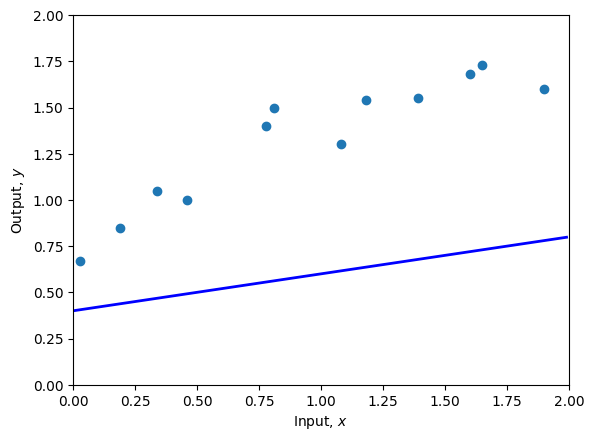

In [6]:
# Set the intercept and slope as in figure 2.2b
phi0 = 0.4 ; phi1 = 0.2
# Plot the data and the model
plot(x,y,phi0,phi1)

LOSS

In [7]:
# Function to calculate the loss
def compute_loss(x,y,phi0,phi1):
  loss = np.sum( (y - (phi0 + phi1 * x))**2 )

  return loss

In [8]:
# Compute the loss for our current model
loss = compute_loss(x,y,phi0,phi1)
print(f'Your Loss = {loss:3.2f}, Ground truth =7.07')

Your Loss = 7.07, Ground truth =7.07


TUNE PARAMETERS (A MANO)

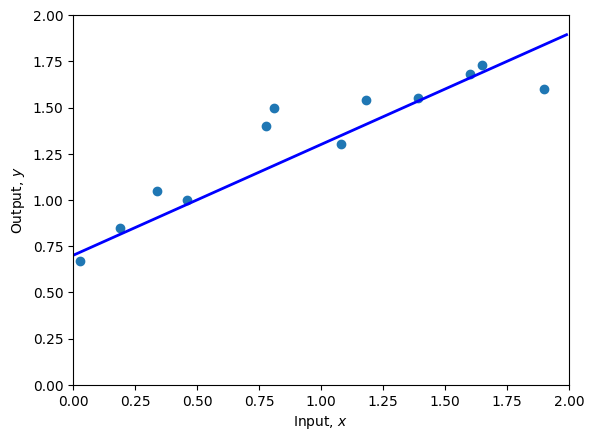

Your Loss = 0.26


In [9]:
phi0 = 0.7 ; phi1 =0.6

plot(x,y,phi0,phi1)
print(f'Your Loss = {compute_loss(x,y,phi0,phi1):3.2f}')

TUNE PARAMETERS (LOOP)

Best Loss = 0.23
Best phi0 = 0.80
Best phi1 = 0.50


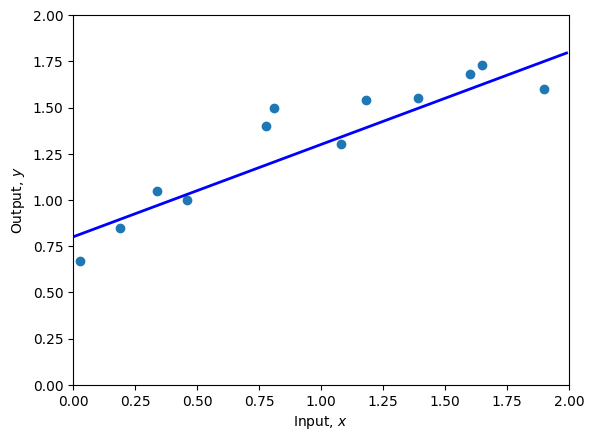

Your Loss = 0.23


In [10]:
# Iterate through phi0 and phi1 values from 0 to 1
best_loss = float('inf')
best_phi0 = 0
best_phi1 = 0

for phi0 in np.arange(0, 1.1, 0.1):
    for phi1 in np.arange(0, 1.1, 0.1):
        current_loss = compute_loss(x, y, phi0, phi1)
        if current_loss < best_loss:
            best_loss = current_loss
            best_phi0 = phi0
            best_phi1 = phi1

print(f'Best Loss = {best_loss:3.2f}')
print(f'Best phi0 = {best_phi0:3.2f}')
print(f'Best phi1 = {best_phi1:3.2f}')

plot(x,y,best_phi0,best_phi1)
print(f'Your Loss = {compute_loss(x,y,best_phi0,best_phi1):3.2f}')

VISUALIZE LOSS

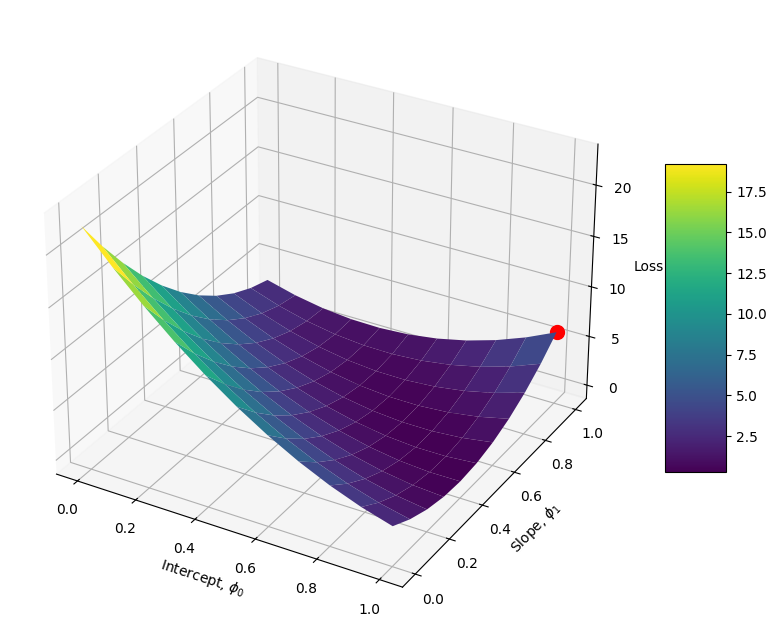

In [11]:
# para visualizar

# Create arrays to store all combinations and their losses
phi0_values = []
phi1_values = []
loss_values = []

# Iterate through phi0 and phi1 values from 0 to 1
for phi0 in np.arange(0, 1.1, 0.1):
    for phi1 in np.arange(0, 1.1, 0.1):
        current_loss = compute_loss(x, y, phi0, phi1)
        phi0_values.append(phi0)
        phi1_values.append(phi1)
        loss_values.append(current_loss)

# Convert lists to numpy arrays for easier plotting
phi0_values = np.array(phi0_values)
phi1_values = np.array(phi1_values)
loss_values = np.array(loss_values)

# Create meshgrid for surface plot
phi0_mesh, phi1_mesh = np.meshgrid(np.arange(0, 1.1, 0.1), np.arange(0, 1.1, 0.1))
all_losses = np.zeros_like(phi0_mesh)

# Compute losses for each point in the meshgrid
for i in range(len(phi0_mesh)):
    for j in range(len(phi0_mesh[0])):
        all_losses[i,j] = compute_loss(x, y, phi0_mesh[i,j], phi1_mesh[i,j])

# Create a 3D surface plot
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

# Create surface plot
surf = ax.plot_surface(phi0_mesh, phi1_mesh, all_losses, cmap='viridis', 
                      linewidth=0, antialiased=True)

# Add colorbar
fig.colorbar(surf, ax=ax, shrink=0.5, aspect=5)

# Set labels
ax.set_xlabel(r'Intercept, $\phi_0$')
ax.set_ylabel(r'Slope, $\phi_1$')
ax.set_zlabel('Loss')

# Plot the best point
ax.scatter(phi0, phi1, compute_loss(x, y, phi0, phi1), color='red', s=100)

plt.show()


# Perceptron

## Perceptron lineal (regresion)

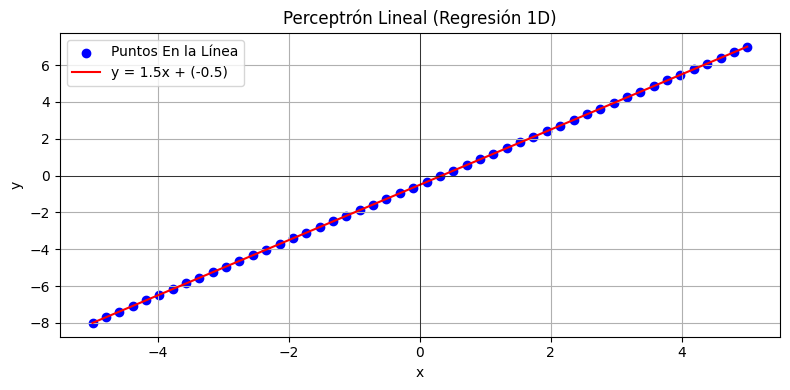

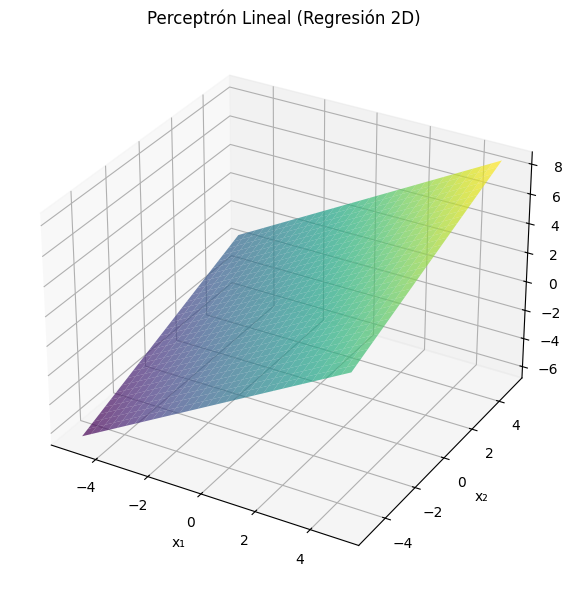

In [10]:
import numpy as np
import matplotlib.pyplot as plt

# ----------------------------------------
# 1) Perceptron Lineal para Regresión
# ----------------------------------------

# Parte A: 1D
# Datos de ejemplo en 1D
x1 = np.linspace(-5, 5, 50)
w1 = 1.5  # peso
b1 = -0.5  # sesgo (bias)
y1 = w1 * x1 + b1  # salida lineal

# Plot 1D
plt.figure(figsize=(8, 4))
plt.scatter(x1, y1, color='blue', label='Puntos En la Línea')
plt.plot(x1, w1 * x1 + b1, color='red', label=f'y = {w1}x + ({b1})')
plt.axhline(0, color='black', linewidth=0.5)
plt.axvline(0, color='black', linewidth=0.5)
plt.title('Perceptrón Lineal (Regresión 1D)')
plt.xlabel('x')
plt.ylabel('y')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

# Parte B: 2D
# Crear una malla de puntos (x, y)
xx = np.linspace(-5, 5, 30)
yy = np.linspace(-5, 5, 30)
X, Y = np.meshgrid(xx, yy)

# Pesos y sesgo para regresión 2D: z = w1*x + w2*y + b
w2 = np.array([1.0, 0.5])  # w1, w2
b2 = 1.0  # bias
Z = w2[0] * X + w2[1] * Y + b2

# Plot 2D
fig = plt.figure(figsize=(6, 6))
ax = fig.add_subplot(111, projection='3d')
ax.plot_surface(X, Y, Z, alpha=0.7, cmap='viridis')
ax.set_title('Perceptrón Lineal (Regresión 2D)')
ax.set_xlabel('x₁')
ax.set_ylabel('x₂')
ax.set_zlabel('z = w₁·x₁ + w₂·x₂ + b')
plt.tight_layout()
plt.show()




## Perceptron simple (clasificacion)

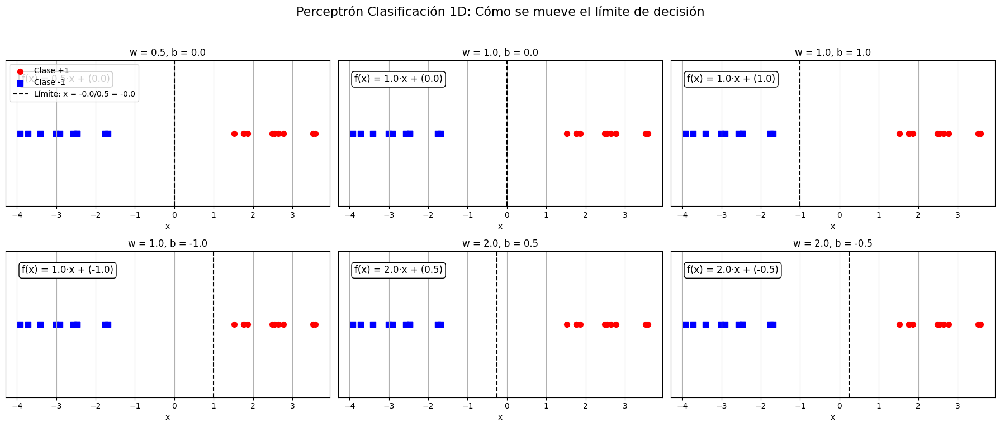

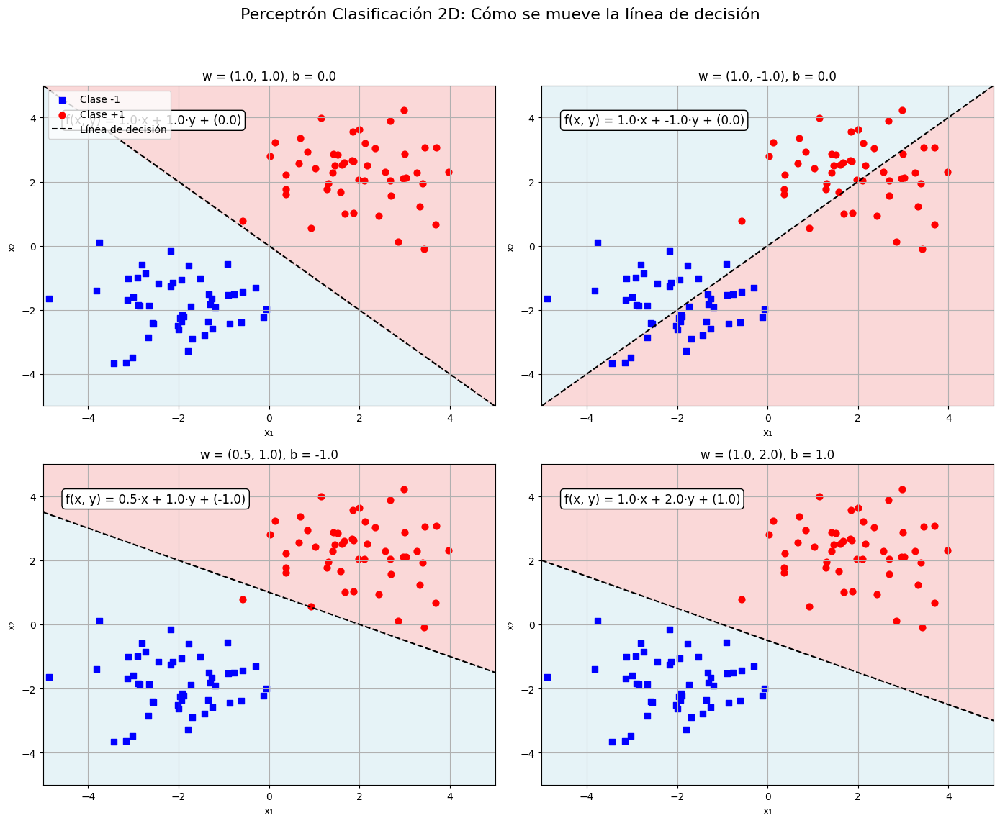

In [11]:
import numpy as np
import matplotlib.pyplot as plt

# ----------------------------------------
# 1) Perceptron Clasificación 1D - Visualización Intuitiva
# ----------------------------------------

# Generar datos 1D con dos clases y algo de ruido
np.random.seed(42)
n_samples = 20
x_pos = np.random.normal(loc=2.0, scale=1.0, size=n_samples // 2)
x_neg = np.random.normal(loc=-2.0, scale=1.0, size=n_samples // 2)
x_1d = np.concatenate([x_pos, x_neg])
y_1d = np.array([1] * (n_samples // 2) + [-1] * (n_samples // 2))

# Parámetros (w, b) a probar
params_1d = [
    (0.5, 0.0),
    (1.0, 0.0),
    (1.0, 1.0),
    (1.0, -1.0),
    (2.0, 0.5),
    (2.0, -0.5),
]

fig1d, axs1d = plt.subplots(2, 3, figsize=(18, 8), sharey=True)
fig1d.suptitle("Perceptrón Clasificación 1D: Cómo se mueve el límite de decisión", fontsize=16)

for idx, (w, b) in enumerate(params_1d):
    ax = axs1d[idx // 3, idx % 3]
    # Plotear puntos con colores según etiqueta
    ax.scatter(x_pos, np.zeros_like(x_pos), color='red', label='Clase +1', s=50, marker='o')
    ax.scatter(x_neg, np.zeros_like(x_neg), color='blue', label='Clase -1', s=50, marker='s')
    
    # Calcular límite (x0 = -b / w)
    if w != 0:
        x0 = -b / w
        ax.axvline(x0, color='black', linestyle='--', label=f'Límite: x = {-b:.1f}/{w:.1f} = {x0:.1f}')
    else:
        x0 = None
    
    # Mostrar fórmula en el plot
    ax.text(0.05, 0.85, f"f(x) = {w:.1f}·x + ({b:.1f})", transform=ax.transAxes,
            fontsize=12, bbox=dict(boxstyle="round", fc="w"))
    
    # Ajustes de visualización
    ax.set_ylim(-0.5, 0.5)
    ax.set_yticks([])
    ax.set_xlabel("x")
    ax.set_title(f"w = {w}, b = {b}")
    ax.grid(True)
    if idx == 0:
        ax.legend(loc='upper left')

plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.show()


# ----------------------------------------
# 2) Perceptrón Clasificación 2D - Visualización Intuitiva
# ----------------------------------------

# Generar datos 2D con dos clases y ruido
np.random.seed(24)
n_samples_2d = 50
pts_pos = np.random.normal(loc=[2, 2], scale=1.0, size=(n_samples_2d, 2))
pts_neg = np.random.normal(loc=[-2, -2], scale=1.0, size=(n_samples_2d, 2))

# Parámetros (w1, w2, b) a probar
params_2d = [
    (1.0, 1.0, 0.0),
    (1.0, -1.0, 0.0),
    (0.5, 1.0, -1.0),
    (1.0, 2.0, 1.0),
]

fig2d, axs2d = plt.subplots(2, 2, figsize=(14, 12))
fig2d.suptitle("Perceptrón Clasificación 2D: Cómo se mueve la línea de decisión", fontsize=16)

xx = np.linspace(-5, 5, 200)
yy = np.linspace(-5, 5, 200)
XX, YY = np.meshgrid(xx, yy)

for idx, (w1, w2, b) in enumerate(params_2d):
    ax = axs2d[idx // 2, idx % 2]
    # Colorear regiones según sign(w1*x + w2*y + b)
    scores = w1 * XX + w2 * YY + b
    labels_grid = np.sign(scores)
    ax.contourf(XX, YY, labels_grid, levels=[-1, 0, 1], colors=['lightblue', 'lightcoral'], alpha=0.3)
    
    # Dibujar puntos
    ax.scatter(pts_neg[:, 0], pts_neg[:, 1], color='blue', label='Clase -1', s=40, marker='s')
    ax.scatter(pts_pos[:, 0], pts_pos[:, 1], color='red', label='Clase +1', s=40, marker='o')
    
    # Dibujar línea de decisión: w1*x + w2*y + b = 0 => y = -(w1/w2)x - b/w2
    if w2 != 0:
        x_line = np.array([-5, 5])
        y_line = - (w1 * x_line + b) / w2
        ax.plot(x_line, y_line, color='black', linestyle='--', label='Línea de decisión')
    
    # Mostrar fórmula
    ax.text(0.05, 0.88, f"f(x, y) = {w1:.1f}·x + {w2:.1f}·y + ({b:.1f})", transform=ax.transAxes,
            fontsize=12, bbox=dict(boxstyle="round", fc="w"))
    
    ax.set_xlim(-5, 5)
    ax.set_ylim(-5, 5)
    ax.set_xlabel("x₁")
    ax.set_ylabel("x₂")
    ax.set_title(f"w = ({w1}, {w2}), b = {b}")
    ax.grid(True)
    if idx == 0:
        ax.legend(loc='upper left')

plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.show()


## Dot product como similaridad

El valor es mas positivo a medida que el dot product sea mas grande (mas alineados esten los vectores o mas importancia le den a las mismas caracteristicas)

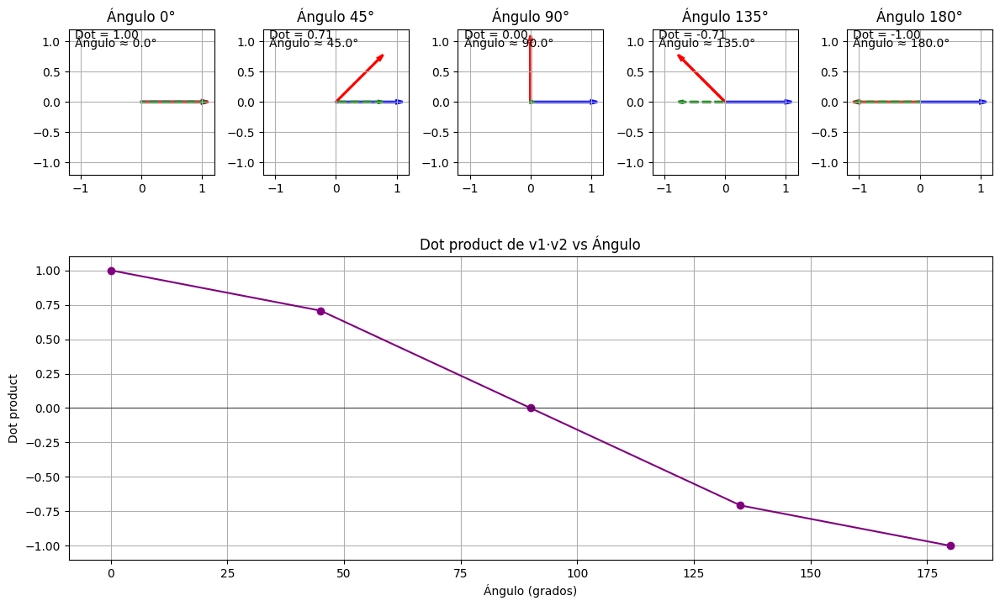

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# Función para dibujar dos vectores y mostrar su dot product
def plot_vectors_and_dot(ax, v1, v2, title):
    ax.set_xlim(-1.2, 1.2)
    ax.set_ylim(-1.2, 1.2)

    # Dibujar vectores v1 y v2
    ax.arrow(0, 0, v1[0], v1[1], head_width=0.05, head_length=0.1, fc='blue', ec='blue', linewidth=2, label='v1')
    ax.arrow(0, 0, v2[0], v2[1], head_width=0.05, head_length=0.1, fc='red', ec='red', linewidth=2, label='v2')

    # Calcular dot product
    dot = np.dot(v1, v2)
    angle = np.arccos(dot / (np.linalg.norm(v1) * np.linalg.norm(v2))) * 180 / np.pi

    # Proyección de v2 sobre v1
    proj_length = dot / np.linalg.norm(v1)
    proj = proj_length * (v1 / np.linalg.norm(v1))
    ax.arrow(0, 0, proj[0], proj[1], head_width=0.03, head_length=0.07, 
             fc='green', ec='green', linestyle='--', linewidth=2, label='Proyección')

    # Anotar el valor del dot product y el ángulo
    ax.text(-1.1, 1.05, f"Dot = {dot:.2f}", fontsize=10)
    ax.text(-1.1, 0.90, f"Ángulo ≈ {angle:.1f}°", fontsize=10)

    ax.set_aspect('equal')
    ax.grid(True)
    ax.set_title(title)

# Vectores base: uno fijo en dirección 0° (1, 0), otro rotando
v1 = np.array([1, 0])

# Elegimos varios ángulos para v2
angles_deg = np.array([0, 45, 90, 135, 180])
angles_rad = np.deg2rad(angles_deg)

# Generar v2 para cada ángulo (cada elemento es un vector 2D)
vectors_v2 = np.column_stack((np.cos(angles_rad), np.sin(angles_rad)))

# Configurar subplots: 2 filas (la segunda es el gráfico de dot vs ángulo)
fig = plt.figure(figsize=(12, 8))

# Primera fila: dibujar cada par v1, v2
for i, angle in enumerate(angles_deg):
    ax = fig.add_subplot(2, len(angles_deg), i + 1)
    plot_vectors_and_dot(ax, v1, vectors_v2[i], f"Ángulo {angle}°")

# Segunda fila: gráfico dot product vs ángulo
dots = [np.dot(v1, vectors_v2[i]) for i in range(len(angles_deg))]
ax2 = fig.add_subplot(2, 1, 2)
ax2.plot(angles_deg, dots, '-o', color='purple')
ax2.axhline(0, color='black', linewidth=0.5)
ax2.set_xlabel('Ángulo (grados)')
ax2.set_ylabel('Dot product')
ax2.set_title('Dot product de v1·v2 vs Ángulo')
ax2.grid(True)

plt.tight_layout()
plt.show()


## Frontera de decision - perceptron

Moviendo los parametros del modelo w, b cambiamos la frontera de decision.

---

**DOT PRODUCT**: Los inputs a y b estan bastante alineado a w, por lo tanto van a aprobar (el valor va a ser mas grande entonces > 0).

Los c y d tienen negativos en valores qeu para el modelo son importante (porque son positivos), entonces caen del otro lado y no van a aprobar.

No siempre que tengan un negativo van a desaprobar. Si por ej e=(-1,3), aprueba, porque esta del lado de aprobacion igual.

---

b mueve el hiperplano, siempre ortogonal a w.

b es como un empujon extra que te hace mas exigente

o menos exigente para aprobar (a todos por igual).

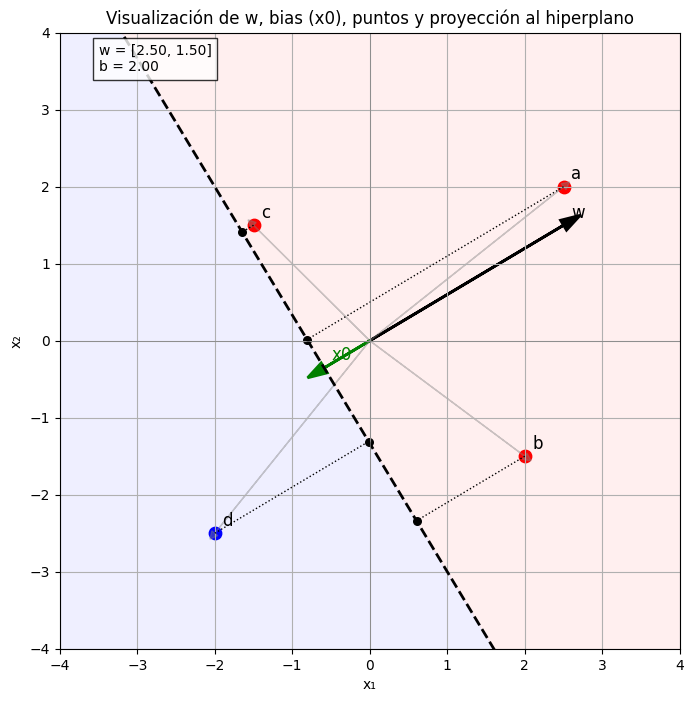

In [22]:
import numpy as np
import matplotlib.pyplot as plt

# Definimos w y b
w = np.array([2.5, 1.5])
b = 2

# Normalizamos w para dibujar el vector de dirección y la distancia al hiperplano
w_norm = w / np.linalg.norm(w)

# Calculamos el punto x0 (proyección de origen en el hiperplano): w·x + b = 0
# => x0 = -(b / (||w||^2)) * w
x0 = - (b / np.dot(w, w)) * w

# Conjuntos de ejemplo de puntos a, b, c, d
points = {
    'a': np.array([2.5,  2.0]),
    'b': np.array([2.0, -1.5]),
    'c': np.array([-1.5, 1.5]),
    'd': np.array([-2.0, -2.5])
}

# Función para proyectar un punto p sobre el hiperplano (proyección ortogonal)
def proj_to_hyperplane(p, w, b):
    # Proyección de p sobre la línea normal w: p_proj_line = p - ((w·p)/(||w||^2)) * w
    # Luego desplazamos con b: para la proyección exacta en la recta del hiperplano:
    # p_hyp = p - ((w·p + b)/(||w||^2)) * w
    return p - ((np.dot(w, p) + b) / np.dot(w, w)) * w

# Creamos la figura
plt.figure(figsize=(8, 8))

# Dibujamos región de clasificación en 2D
xx = np.linspace(-4, 4, 400)
yy = np.linspace(-4, 4, 400)
XX, YY = np.meshgrid(xx, yy)
ZZ = w[0] * XX + w[1] * YY + b
# Pintamos de color claro según signo de ZZ
plt.contourf(XX, YY, ZZ > 0, levels=[-0.5, 0.5, 1.5],
             colors=['#ccccff', '#ffcccc'], alpha=0.3)

# Dibujamos línea de decisión: w·x + b = 0 => y = -(w1/w2) x - b/w2
if w[1] != 0:
    x_line = np.array([-4, 4])
    y_line = - (w[0] * x_line + b) / w[1]
    plt.plot(x_line, y_line, 'k--', linewidth=2)

# Dibujamos vector w desde el origen
plt.arrow(0, 0, w[0], w[1], head_width=0.15, head_length=0.25,
          fc='black', ec='black', linewidth=2, label='w')

# Dibujamos el vector x0 (distancia al hiperplano) desde el origen
plt.arrow(0, 0, x0[0], x0[1], head_width=0.15, head_length=0.25,
          fc='green', ec='green', linewidth=2, label='x0 (bias)')

# Plot de los puntos a, b, c, d
for label, p in points.items():
    plt.scatter(p[0], p[1], s=80, color='red' if np.dot(w, p) + b > 0 else 'blue')
    plt.text(p[0] + 0.1, p[1] + 0.1, label, fontsize=12)

    # Dibujamos flecha desde el origen al punto
    plt.arrow(0, 0, p[0], p[1], linestyle='-', alpha=0.4,
              head_width=0.1, head_length=0.1, color='gray')

    # Calculamos la proyección de p sobre el hiperplano
    p_proj = proj_to_hyperplane(p, w, b)
    # Dibujamos línea punteada desde p hasta esa proyección
    plt.plot([p[0], p_proj[0]], [p[1], p_proj[1]], 'k:', linewidth=1)
    # Dibujamos el punto de proyección (en el hiperplano)
    plt.scatter(p_proj[0], p_proj[1], s=30, color='black')

# Etiquetas y ajustes
plt.text(w[0] + 0.1, w[1] + 0.1, 'w', fontsize=12, color='black')
plt.text(x0[0] + 0.1, x0[1] + 0.1, 'x0', fontsize=12, color='green')
plt.axhline(0, color='gray', linewidth=0.5)
plt.axvline(0, color='gray', linewidth=0.5)
plt.xlim(-4, 4)
plt.ylim(-4, 4)
plt.xlabel('x₁')
plt.text(-3.5, 3.5, f'w = [{w[0]:.2f}, {w[1]:.2f}]\nb = {b:.2f}', 
         bbox=dict(facecolor='white', alpha=0.8))
plt.ylabel('x₂')
plt.title('Visualización de w, bias (x0), puntos y proyección al hiperplano')
plt.grid(True)
plt.show()



## Problema XOR

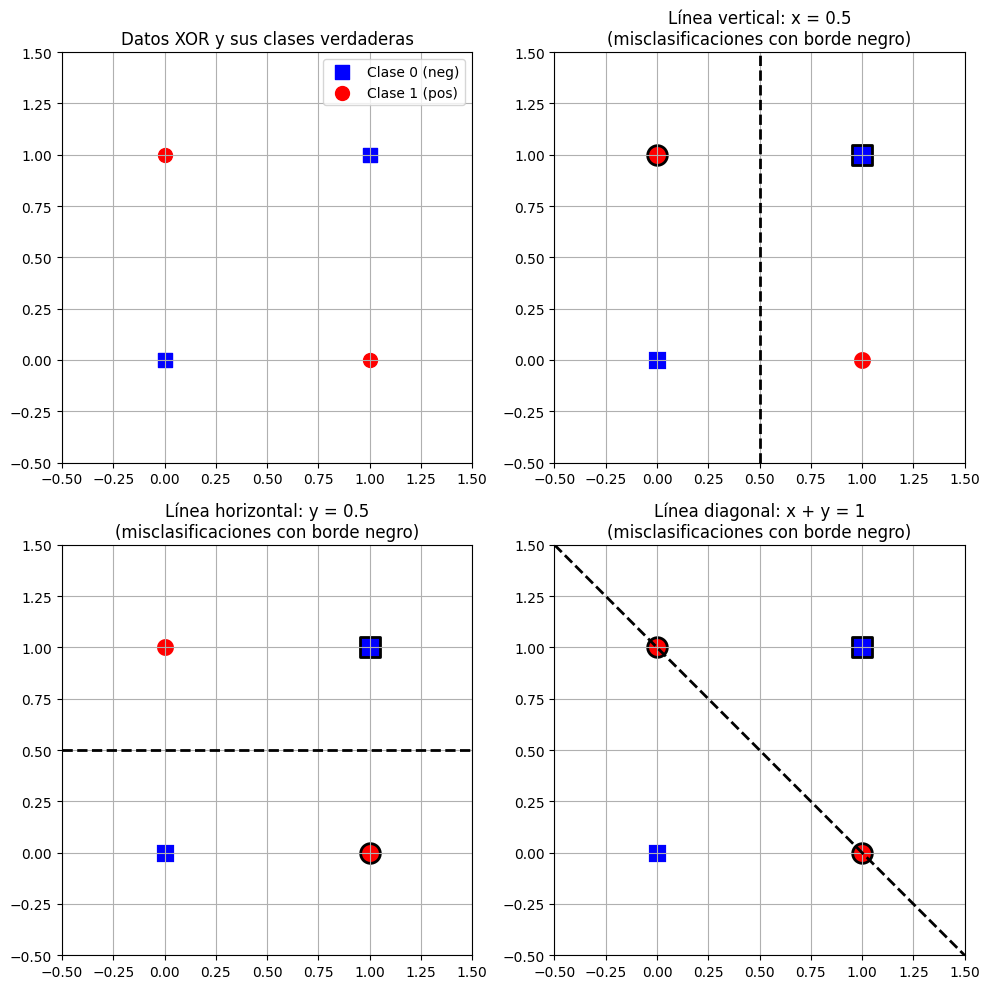

In [23]:
import numpy as np
import matplotlib.pyplot as plt

# Datos XOR
# Puntos (x, y) y su etiqueta True (0 o 1)
points = np.array([
    [0, 0],
    [0, 1],
    [1, 0],
    [1, 1]
])
labels = np.array([0, 1, 1, 0])  # XOR: (0,0)->0; (0,1)->1; (1,0)->1; (1,1)->0

# Función que evalúa un clasificador lineal w·x + b
def predict_line(p, w, b):
    return (np.dot(p, w) + b) > 0  # Devuelve True/False

# Definimos tres ejemplos de "líneas de decisión"
# Cada uno representado como (w, b)
classifiers = [
    (np.array([1.0, 0.0]), -0.5),   # x > 0.5
    (np.array([0.0, 1.0]), -0.5),   # y > 0.5
    (np.array([1.0, 1.0]), -1.0)    # x + y > 1
]

titles = [
    "Línea vertical: x = 0.5",
    "Línea horizontal: y = 0.5",
    "Línea diagonal: x + y = 1"
]

fig, axs = plt.subplots(2, 2, figsize=(10, 10))
axs = axs.flatten()

# Subplot 0: solo datos XOR y sus clases verdaderas
axs[0].scatter(points[labels == 0, 0], points[labels == 0, 1], 
               c='blue', marker='s', s=100, label='Clase 0 (neg)')
axs[0].scatter(points[labels == 1, 0], points[labels == 1, 1], 
               c='red', marker='o', s=100, label='Clase 1 (pos)')
axs[0].set_title("Datos XOR y sus clases verdaderas")
axs[0].set_xlim(-0.5, 1.5)
axs[0].set_ylim(-0.5, 1.5)
axs[0].legend()
axs[0].grid(True)

# Rango para dibujar líneas
x_vals = np.linspace(-0.5, 1.5, 100)

# Generar los tres subplots con ejemplos de líneas
for i, (w, b) in enumerate(classifiers, start=1):
    ax = axs[i]
    # Dibujar línea de decisión: w·x + b = 0
    # Distintas fórmulas según w
    if w[1] != 0:
        # y = -(w[0]/w[1]) x - b/w[1]
        y_vals = - (w[0] * x_vals + b) / w[1]
    else:
        # vertical: x = -b/w[0]
        x_const = -b / w[0]
        y_vals = np.array([ -0.5, 1.5 ])
        ax.plot([x_const, x_const], y_vals, 'k--', linewidth=2)
        y_vals = None
    
    if y_vals is not None:
        ax.plot(x_vals, y_vals, 'k--', linewidth=2)

    # Predecir etiqueta segun la línea
    preds = np.array([predict_line(p, w, b) for p in points]).astype(int)
    
    # Dibujar cada punto, coloreado según su etiqueta verdadera, pero con borde negro si fue mal clasificado
    for idx, p in enumerate(points):
        true = labels[idx]
        pred = preds[idx]
        color = 'red' if true == 1 else 'blue'
        marker = 'o' if true == 1 else 's'
        edgecolor = 'black' if pred != true else 'white'
        ax.scatter(p[0], p[1], c=color, marker=marker, s=200, 
                   edgecolors=edgecolor, linewidth=2)
    
    ax.set_title(titles[i-1] + "\n(misclasificaciones con borde negro)")
    ax.set_xlim(-0.5, 1.5)
    ax.set_ylim(-0.5, 1.5)
    ax.grid(True)

plt.tight_layout()
plt.show()


## Combinacion de perceptrones

Que pasa si combinamos varios perceptrones asi nomas? Combinacion de funciones lineales da funcion lineal

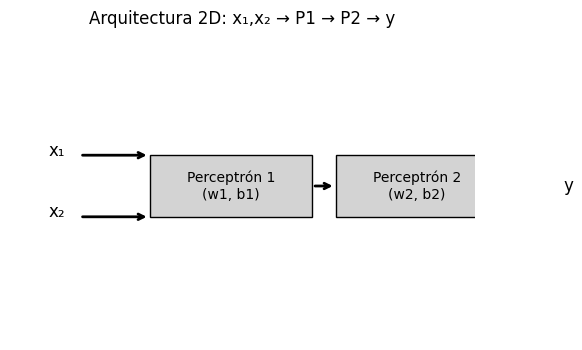

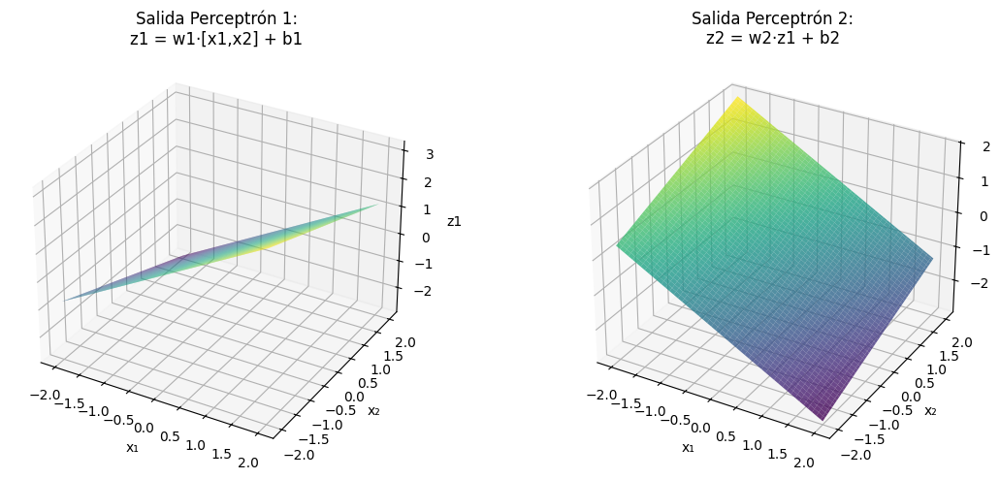

In [31]:
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# ====== 1. Arquitectura en 2D con x1, x2 ======
fig = plt.figure(figsize=(6, 4))
ax = fig.add_subplot(111)
ax.axis('off')

# Dibujar perceptrones como cajas
box1 = plt.Rectangle((0.3, 0.4), 0.35, 0.2, edgecolor='black', facecolor='lightgray')
box2 = plt.Rectangle((0.7, 0.4), 0.35, 0.2, edgecolor='black', facecolor='lightgray')
ax.add_patch(box1)
ax.add_patch(box2)

# Etiquetas
ax.text(0.475, 0.5, "Perceptrón 1\n(w1, b1)", ha='center', va='center', fontsize=10)
ax.text(0.875, 0.5, "Perceptrón 2\n(w2, b2)", ha='center', va='center', fontsize=10)

# Dibujar nodos de entrada x1, x2
ax.text(0.1, 0.6, "x₁", fontsize=12, ha='center')
ax.text(0.1, 0.4, "x₂", fontsize=12, ha='center')

# Flechas desde x1, x2 a Perceptrón 1
ax.annotate("", xy=(0.3, 0.6), xytext=(0.15, 0.6), arrowprops=dict(arrowstyle="->", lw=2))
ax.annotate("", xy=(0.3, 0.4), xytext=(0.15, 0.4), arrowprops=dict(arrowstyle="->", lw=2))

# Flecha de Perceptrón 1 a Perceptrón 2
ax.annotate("", xy=(0.65, 0.5), xytext=(0.65, 0.5), arrowprops=dict(arrowstyle="->", lw=2))
ax.annotate("", xy=(0.7, 0.5), xytext=(0.65, 0.5), arrowprops=dict(arrowstyle="->", lw=2))

# Flecha de Perceptrón 2 a y
ax.annotate("", xy=(1.05, 0.5), xytext=(1.05, 0.5), arrowprops=dict(arrowstyle="->", lw=2))
ax.annotate("", xy=(1.15, 0.5), xytext=(1.05, 0.5), arrowprops=dict(arrowstyle="->", lw=2))
ax.text(1.2, 0.5, "y", fontsize=12, ha='center', va='center')

ax.set_title("Arquitectura 2D: x₁,x₂ → P1 → P2 → y", fontsize=12)
plt.show()

import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# ====== Visualización Salidas de Perceptrones en 2D ======

# Definir pesos y sesgos
w1 = np.array([1.0, -0.5])   # vector 2D para Perceptrón 1
b1 = 0.2
w2 = -0.8                    # escalar para Perceptrón 2
b2 = -0.3

# Crear rejilla de puntos (x1, x2)
x1 = np.linspace(-2, 2, 100)
x2 = np.linspace(-2, 2, 100)
X1, X2 = np.meshgrid(x1, x2)

# Capa 1: salida z1 = w1·[x1,x2] + b1
Z1 = w1[0] * X1 + w1[1] * X2 + b1

# Capa 2: salida final z2 = w2 * z1 + b2
Z2 = w2 * Z1 + b2

# Dibujar las dos superficies una al lado de la otra
fig = plt.figure(figsize=(12, 5))

# Salida del Perceptrón 1
ax1 = fig.add_subplot(1, 2, 1, projection='3d')
ax1.plot_surface(X1, X2, Z1, cmap='viridis', alpha=0.8)
ax1.set_title("Salida Perceptrón 1:\nz1 = w1·[x1,x2] + b1")
ax1.set_xlabel("x₁")
ax1.set_ylabel("x₂")
ax1.set_zlabel("z1")

# Salida del Perceptrón 2 (recibiendo z1)
ax2 = fig.add_subplot(1, 2, 2, projection='3d')
ax2.plot_surface(X1, X2, Z2, cmap='viridis', alpha=0.8)
ax2.set_title("Salida Perceptrón 2:\nz2 = w2·z1 + b2")
ax2.set_xlabel("x₁")
ax2.set_ylabel("x₂")
ax2.set_zlabel("z2")

plt.tight_layout()
plt.show()


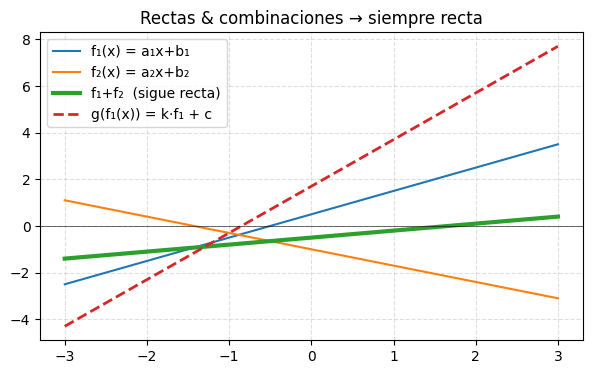

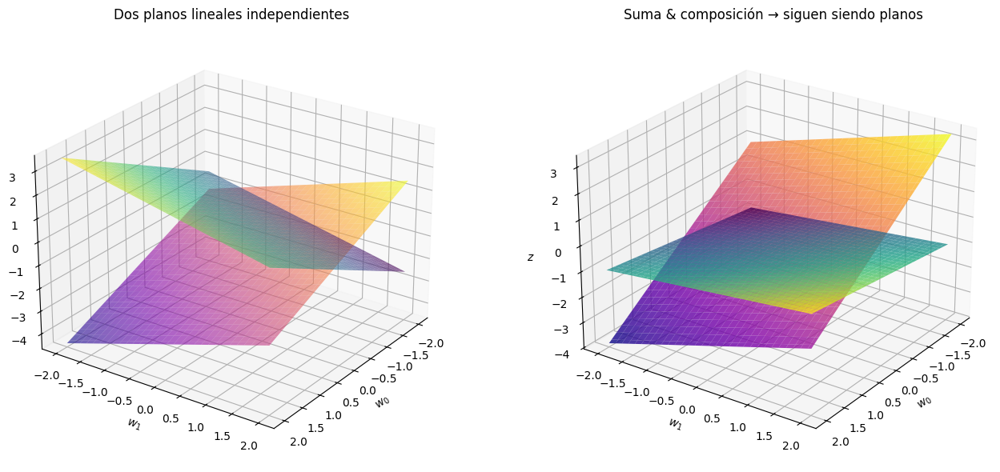

In [26]:
# COMBINACION DE FUNCIONES LINEALES

# %% [markdown]
# # FUNDACIÓN 1 – **Linealidad pura**  
# Queremos “ver” por qué:
# * Suma de lineales ⇒ lineal  
# * Composición de lineales ⇒ lineal  
# * En 2 D (planos) pasa lo mismo
#
# Cambia los parámetros `a,b,c,…` y ejecuta para confirmar que **nunca aparece curvatura**.

import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# ---------- 1-D: rectas y sus sumas ---------------------------------
x = np.linspace(-3, 3, 400)

# dos rectas
a1, b1 =  1.0,  0.5    # f1(x) = a1·x + b1
a2, b2 = -0.7, -1.0    # f2(x) = a2·x + b2
f1 = a1 * x + b1
f2 = a2 * x + b2
f_sum = f1 + f2                  # suma
g_comp = 2.0 * f1 + 0.7          # composición lineal: g(x)=k·f1(x)+c

plt.figure(figsize=(7,4))
plt.plot(x, f1,  label='f₁(x) = a₁x+b₁')
plt.plot(x, f2,  label='f₂(x) = a₂x+b₂')
plt.plot(x, f_sum,  lw=3, label='f₁+f₂  (sigue recta)')
plt.plot(x, g_comp, '--', lw=2, label='g(f₁(x)) = k·f₁ + c')
plt.axhline(0, color='black', lw=0.4)
plt.title('Rectas & combinaciones → siempre recta')
plt.legend(); plt.grid(ls='--', alpha=0.4); plt.show();

# ---------- 2-D: planos y sus combinaciones -------------------------
# plano 1:  z = p1*w0 + q1*w1 + r1
# plano 2:  z = p2*w0 + q2*w1 + r2
p1,q1,r1 =  1.0, -0.5,  0.5
p2,q2,r2 = -0.8,  0.7, -1.5

w0_vals = np.linspace(-2, 2, 60)
w1_vals = np.linspace(-2, 2, 60)
W0, W1   = np.meshgrid(w0_vals, w1_vals)
Z1 = p1*W0 + q1*W1 + r1
Z2 = p2*W0 + q2*W1 + r2
Z_sum = Z1 + Z2                # sigue plano
Z_comp = -1.2*Z1 + 0.3         # composición lineal → plano

fig = plt.figure(figsize=(14,6))
ax1 = fig.add_subplot(121, projection='3d')
ax1.plot_surface(W0, W1, Z1, cmap='viridis', alpha=0.6)
ax1.plot_surface(W0, W1, Z2, cmap='plasma', alpha=0.6)
ax1.set_title('Dos planos lineales independientes')

ax2 = fig.add_subplot(122, projection='3d')
ax2.plot_surface(W0, W1, Z_sum, cmap='viridis', alpha=0.8)
ax2.plot_surface(W0, W1, Z_comp, cmap='plasma', alpha=0.8)
ax2.set_title('Suma & composición → siguen siendo planos')

for ax in (ax1, ax2):
    ax.set_xlabel('$w_0$'); ax.set_ylabel('$w_1$'); ax.set_zlabel('$z$')
    ax.view_init(elev=25, azim=35)

plt.tight_layout();

## No linealidad (ReLU)

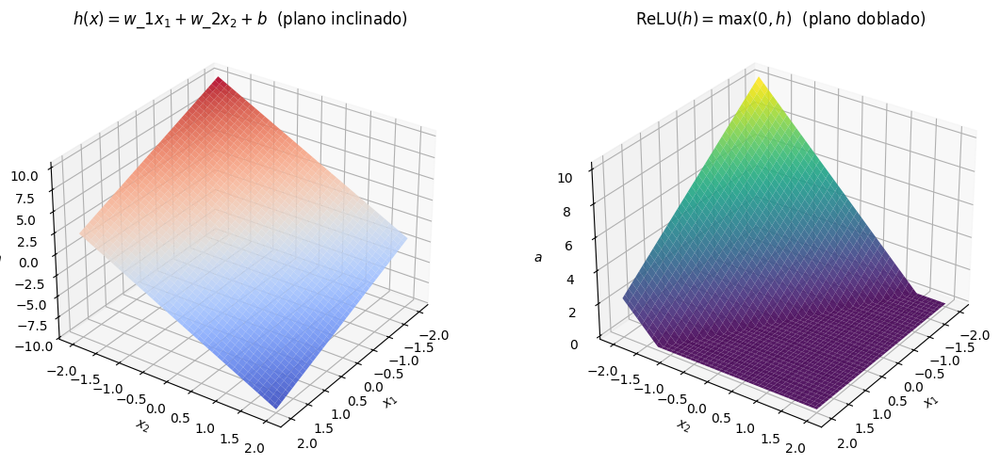

In [32]:
# %% [markdown]
# ## ReLU en 3-D: antes vs. después — vista limpia
#
# * Una sola neurona lineal `h = W·x + b` (doble entrada).  
# * Después le aplicamos **ReLU** \(a = \max(0,h)\).  
# * Dibujamos **dos** superficies en 3-D, lado a lado, con la misma perspectiva
#   para que el “doblez” se aprecie al instante.

import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# ---------- plano de entrada ----------
grid = np.linspace(-2, 2, 120)
X1, X2 = np.meshgrid(grid, grid)

# ---------- parámetros de la capa lineal ----------
W = np.array([-2.0, -3.0])   # pesos
b = 0.2                   # sesgo

H = W[0]*X1 + W[1]*X2 + b       # pre-activación
A = np.maximum(0, H)            # ReLU

# ---------- plotting ----------
fig = plt.figure(figsize=(12,5))

# (A) Superficie lineal h(x)
ax1 = fig.add_subplot(121, projection='3d')
surf1 = ax1.plot_surface(X1, X2, H,
                         cmap='coolwarm', alpha=0.9, linewidth=0)
ax1.set_title('$h(x)=w\\_1x_1 + w\\_2x_2 + b$  (plano inclinado)')
ax1.set_xlabel('$x_1$'); ax1.set_ylabel('$x_2$'); ax1.set_zlabel('$h$')
ax1.view_init(elev=30, azim=35)

# (B) Después de ReLU
ax2 = fig.add_subplot(122, projection='3d')
surf2 = ax2.plot_surface(X1, X2, A,
                         cmap='viridis', alpha=0.9, linewidth=0)
ax2.set_title('$\\text{ReLU}(h)=\\max(0,h)$  (plano doblado)')
ax2.set_xlabel('$x_1$'); ax2.set_ylabel('$x_2$'); ax2.set_zlabel('$a$')
ax2.view_init(elev=30, azim=35)

plt.tight_layout()

## Combinacion no-lineal secuencial

SIN RELU EN LA SALIDA DE LA SEGUNDA NEURONA

x₁ → [Perceptrón 1 (w₁,b₁)] → ReLU → [Perceptrón 2 (w₂,b₂)] → y 

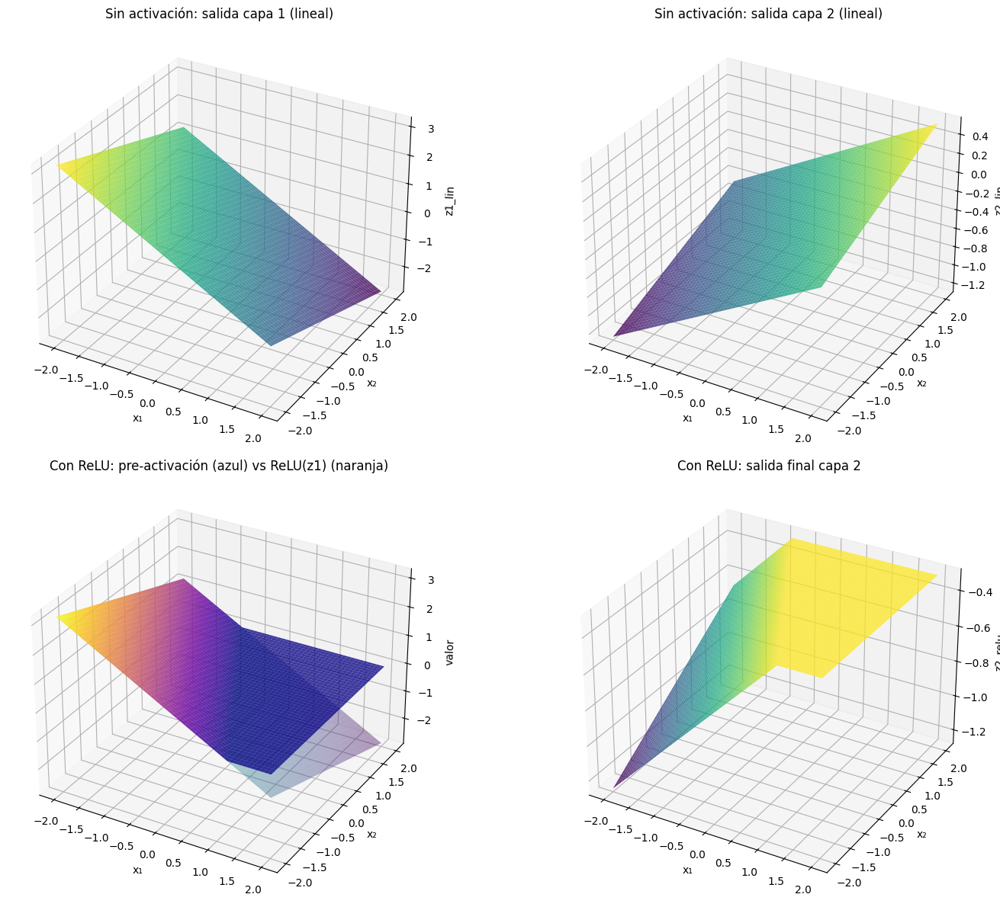

In [37]:
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# ===== Parámetros de los perceptrones =====
w1 = np.array([-1.0, -0.5])  # pesos capa 1
b1 = 0.2                    # bias capa 1
w2 = -0.3                    # peso capa 2 (escala de salida)
b2 = -0.3                   # bias capa 2

# ===== Rejilla de input (x1, x2) =====
x1 = np.linspace(-2, 2, 200)
x2 = np.linspace(-2, 2, 200)
X1, X2 = np.meshgrid(x1, x2)

# ===== 1) Sin no linealidad (solo lineal) =====
Z1_lin = w1[0]*X1 + w1[1]*X2 + b1               # salida capa 1 (lineal)
Z2_lin = w2 * Z1_lin + b2                       # salida capa 2 (lineal)

# ===== 2) Con no linealidad (ReLU) después del perceptrón 1 =====
Z1 = w1[0]*X1 + w1[1]*X2 + b1                   # salida capa 1 (pre-activación)
A1 = np.maximum(0, Z1)                          # ReLU(Z1)
Z2_relu = w2 * A1 + b2                          # salida capa 2 tras ReLU

# ===== Dibujar superficies 3D =====
fig = plt.figure(figsize=(16, 12))

# Sin activación: capa 1 y capa 2 lineal
ax0 = fig.add_subplot(2, 2, 1, projection='3d')
ax0.plot_surface(X1, X2, Z1_lin, cmap='viridis', alpha=0.8)
ax0.set_title("Sin activación: salida capa 1 (lineal)")
ax0.set_xlabel("x₁"); ax0.set_ylabel("x₂"); ax0.set_zlabel("z1_lin")

ax1 = fig.add_subplot(2, 2, 2, projection='3d')
ax1.plot_surface(X1, X2, Z2_lin, cmap='viridis', alpha=0.8)
ax1.set_title("Sin activación: salida capa 2 (lineal)")
ax1.set_xlabel("x₁"); ax1.set_ylabel("x₂"); ax1.set_zlabel("z2_lin")

# Con activación: ReLU en medio
ax2 = fig.add_subplot(2, 2, 3, projection='3d')
ax2.plot_surface(X1, X2, Z1, cmap='viridis', alpha=0.4)
ax2.plot_surface(X1, X2, A1, cmap='plasma', alpha=0.8)
ax2.set_title("Con ReLU: pre-activación (azul) vs ReLU(z1) (naranja)")
ax2.set_xlabel("x₁"); ax2.set_ylabel("x₂"); ax2.set_zlabel("valor")

ax3 = fig.add_subplot(2, 2, 4, projection='3d')
ax3.plot_surface(X1, X2, Z2_relu, cmap='viridis', alpha=0.8)
ax3.set_title("Con ReLU: salida final capa 2")
ax3.set_xlabel("x₁"); ax3.set_ylabel("x₂"); ax3.set_zlabel("z2_relu")

plt.tight_layout()
plt.show()


Con ReLU EN AMBAS SALIDAS


x₁ → [Perceptrón 1 (w₁,b₁)] → ReLU → [Perceptrón 2 (w₂,b₂)] → ReLU → y

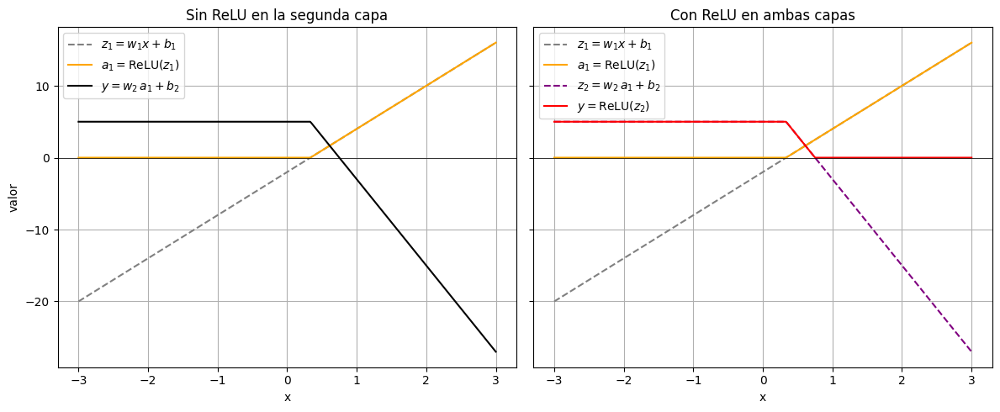

In [46]:
import numpy as np
import matplotlib.pyplot as plt

# Parámetros de ejemplo
w1, b1 = 6.0, -2
w2, b2 = -2.0,  5

# Rejilla de inputs
x = np.linspace(-3, 3, 300)

# --- Capa 1: Perceptrón 1 + ReLU ---
z1 = w1 * x + b1
a1 = np.maximum(0, z1)

# --- Capa 2 sin ReLU final ---
y_lin = w2 * a1 + b2

# --- Capa 2 con ReLU final ---
z2 = w2 * a1 + b2
y_relu = np.maximum(0, z2)

# Crear figura con 2 subplots lado a lado
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 5), sharey=True)

# --- Subplot 1: sin ReLU en capa 2 ---
ax1.plot(x, z1,  '--', color='gray', label=r'$z_1 = w_1 x + b_1$')
ax1.plot(x, a1,  '-',  color='orange', label=r'$a_1 = \mathrm{ReLU}(z_1)$')
ax1.plot(x, y_lin, '-k', label=r'$y = w_2\,a_1 + b_2$')
ax1.axhline(0, color='black', linewidth=0.5)
ax1.set_title("Sin ReLU en la segunda capa")
ax1.set_xlabel("x")
ax1.set_ylabel("valor")
ax1.legend()
ax1.grid(True)

# --- Subplot 2: con ReLU en ambas capas ---
ax2.plot(x, z1,  '--', color='gray', label=r'$z_1 = w_1 x + b_1$')
ax2.plot(x, a1,  '-',  color='orange', label=r'$a_1 = \mathrm{ReLU}(z_1)$')
ax2.plot(x, z2,  '--', color='purple', label=r'$z_2 = w_2\,a_1 + b_2$')
ax2.plot(x, y_relu, '-r', label=r'$y = \mathrm{ReLU}(z_2)$')
ax2.axhline(0, color='black', linewidth=0.5)
ax2.set_title("Con ReLU en ambas capas")
ax2.set_xlabel("x")
ax2.legend()
ax2.grid(True)

plt.tight_layout()
plt.show()


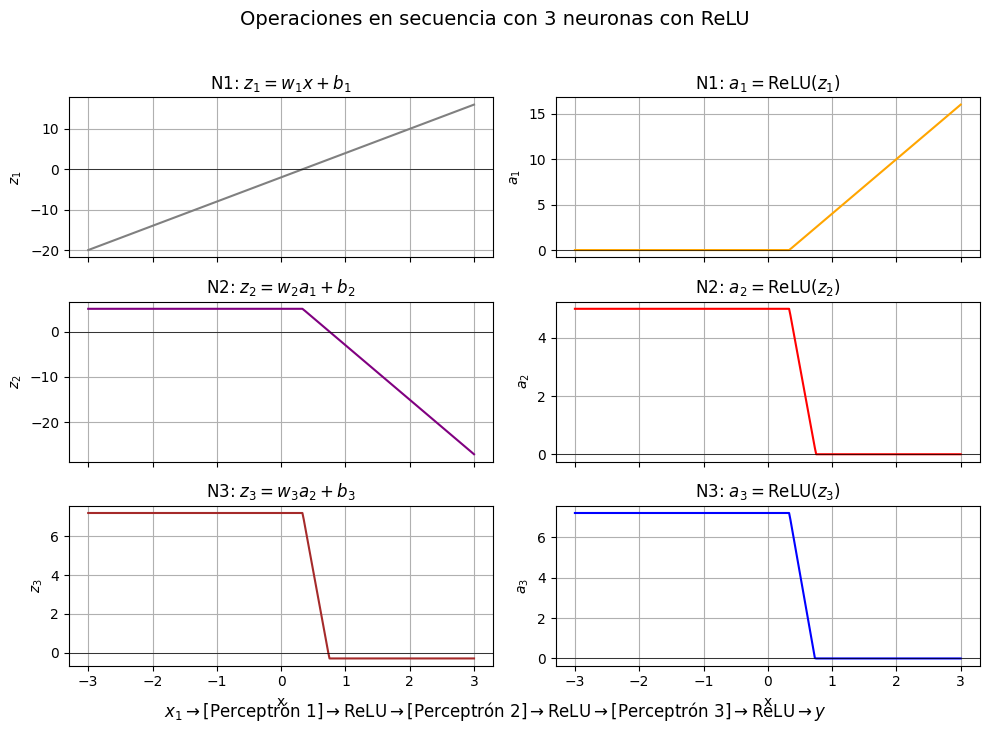

In [58]:
import numpy as np
import matplotlib.pyplot as plt

# Parámetros de las 3 neuronas
w1, b1 = 6.0, -2
w2, b2 = -2.0,  5
w3, b3 = 1.5, -0.3   # Perceptrón 3

# Rejilla de inputs (1D)
x = np.linspace(-3, 3, 300)

# 1) Neurona 1
z1 = w1 * x + b1
a1 = np.maximum(0, z1)  # ReLU en salida de N1

# 2) Neurona 2 (recibe a1)
z2 = w2 * a1 + b2
a2 = np.maximum(0, z2)  # ReLU en salida de N2

# 3) Neurona 3 (recibe a2)
z3 = w3 * a2 + b3
a3 = np.maximum(0, z3)  # ReLU en salida de N3

# Crear figura con 3 filas y 2 columnas
fig, axes = plt.subplots(3, 2, figsize=(10, 7), sharex=True)

# Neurona 1: pre-activación y activación en la misma fila
axes[0, 0].plot(x, z1, '-', color='gray')
axes[0, 0].axhline(0, color='black', linewidth=0.5)
axes[0, 0].set_ylabel(r'$z_1$')
axes[0, 0].set_title('N1: $z_1 = w_1 x + b_1$')
axes[0, 0].grid(True)

axes[0, 1].plot(x, a1, '-', color='orange')
axes[0, 1].axhline(0, color='black', linewidth=0.5)
axes[0, 1].set_ylabel(r'$a_1$')
axes[0, 1].set_title('N1: $a_1 = \mathrm{ReLU}(z_1)$')
axes[0, 1].grid(True)

# Neurona 2: pre-activación y activación en la misma fila
axes[1, 0].plot(x, z2, '-', color='purple')
axes[1, 0].axhline(0, color='black', linewidth=0.5)
axes[1, 0].set_ylabel(r'$z_2$')
axes[1, 0].set_title('N2: $z_2 = w_2 a_1 + b_2$')
axes[1, 0].grid(True)

axes[1, 1].plot(x, a2, '-', color='red')
axes[1, 1].axhline(0, color='black', linewidth=0.5)
axes[1, 1].set_ylabel(r'$a_2$')
axes[1, 1].set_title('N2: $a_2 = \mathrm{ReLU}(z_2)$')
axes[1, 1].grid(True)

# Neurona 3: pre-activación y activación en la misma fila
axes[2, 0].plot(x, z3, '-', color='brown')
axes[2, 0].axhline(0, color='black', linewidth=0.5)
axes[2, 0].set_ylabel(r'$z_3$')
axes[2, 0].set_title('N3: $z_3 = w_3 a_2 + b_3$')
axes[2, 0].grid(True)

axes[2, 1].plot(x, a3, '-', color='blue')
axes[2, 1].axhline(0, color='black', linewidth=0.5)
axes[2, 1].set_ylabel(r'$a_3$')
axes[2, 1].set_title('N3: $a_3 = \mathrm{ReLU}(z_3)$')
axes[2, 1].grid(True)

# Etiqueta del eje x
for ax in axes[-1, :]:
    ax.set_xlabel('x')

plt.suptitle('Operaciones en secuencia con 3 neuronas con ReLU', y=1.02, fontsize=14)
plt.figtext(0.5, 0.01, r'$x_1 \rightarrow [\mathrm{Perceptrón\ 1}] \rightarrow \mathrm{ReLU} \rightarrow [\mathrm{Perceptrón\ 2}] \rightarrow \mathrm{ReLU} \rightarrow [\mathrm{Perceptrón\ 3}] \rightarrow \mathrm{ReLU} \rightarrow y$', 
            ha='center', fontsize=12)

plt.tight_layout()
plt.show()



# Shallow network (1 hidden layer)

        x ──► [ w₁·x + b₁ ] ──► ReLU ──► h₁ ┐
           ──► [ w₂·x + b₂ ] ──► ReLU ──► h₂ ├─► (combinación lineal) ──► y
           ──► [ w₃·x + b₃ ] ──► ReLU ──► h₃ ┘

En vez de hacerlo secuencial:

x₁ → [Perceptrón 1 (w₁,b₁)] → ReLU → [Perceptrón 2 (w₂,b₂)] → ReLU → [Perceptrón 2 (w₂,b₂)] → ReLU → y

Porque en este caso secuencial se va delimitando el espacio JERARQUICAMENTE, por lo que va matando zonas y solo trabajamos para hacer particiones consecutivas solo en el rango que quedo vivo, no en todo el espacio.

---

Si queremos usar todo el espacio y cortarlo de distintas manera, no jerarquicamente, podemos hacer una CAPA de neuronas con ReLU (en paralelo) y despues simplemente combinarlas linealmente.

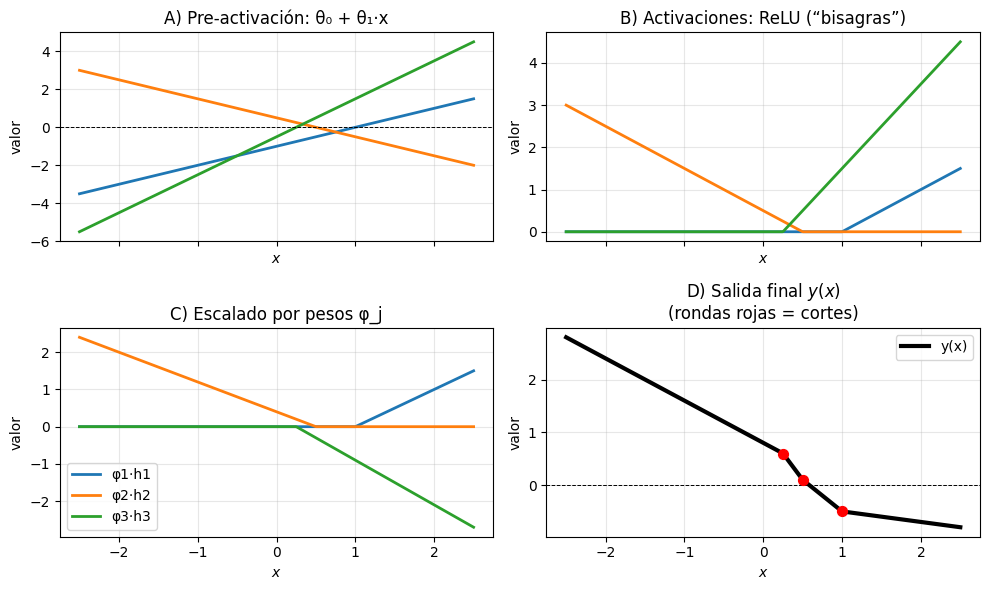

In [64]:
import numpy as np
import matplotlib.pyplot as plt

# ───────── Parámetros de la red ──────────
n_hidden = 3                                  # nº de unidades ocultas
theta    = np.array([[-1.0,  1.0],            # [θ10, θ11]
                     [ 0.5, -1.0],            # [θ20, θ21]
                     [-0.5,  2.0]])[:n_hidden]
phi      = np.array([0.4,  1.0,  0.8, -0.6])   # [φ0, φ1, φ2, φ3]

# ───────── Dominio de entrada ────────────
x = np.linspace(-2.5, 2.5, 400)

# ───────── Cálculos paso a paso ───────────
# (1) Pre‐activaciones z_j(x) = θ_j0 + θ_j1·x
h_lin   = theta[:,0,None] + theta[:,1,None] * x      # forma: (n_hidden, len(x))
# (2) Aplicar ReLU → h_relu[j] = max(0, z_j)
h_relu  = np.maximum(0, h_lin)
# (3) Escalar cada ReLU por φ_j y sumar sesgo φ0
h_scaled= phi[1:,None] * h_relu
y_final = phi[0] + h_scaled.sum(axis=0)

# ───────── Calcular los "breakpoints" x*_j donde θ_j0 + θ_j1·x = 0 ─────────
breaks = []
for j in range(n_hidden):
    θ0, θ1 = theta[j]
    if θ1 != 0:
        xj = -θ0/θ1
        # chequear que xj esté dentro del dominio mostrado (si quieres filtrar)
        if x.min() <= xj <= x.max():
            breaks.append(xj)

# ───────── Plotting con las cuatro ventanas A–D ─────────────────────
fig, axes = plt.subplots(2, 2, figsize=(10,6), sharex=True)
axes = axes.ravel()
colors = ['tab:blue','tab:orange','tab:green']

# Panel A – rectas originales (pre‐activación)
for j in range(n_hidden):
    axes[0].plot(x, h_lin[j], color=colors[j], lw=2)
axes[0].set_title('A) Pre-activación: θ₀ + θ₁·x')
axes[0].axhline(0, color='k', ls='--', lw=0.7)
axes[0].grid(alpha=0.3)

# Panel B – ReLU aplicada
for j in range(n_hidden):
    axes[1].plot(x, h_relu[j], color=colors[j], lw=2)
axes[1].set_title('B) Activaciones: ReLU (“bisagras”)')
axes[1].grid(alpha=0.3)

# Panel C – cada ReLU escalada por φ_j
for j in range(n_hidden):
    axes[2].plot(x, h_scaled[j], color=colors[j], lw=2,
                 label=fr'φ{j+1}·h{j+1}')
axes[2].set_title('C) Escalado por pesos φ_j')
axes[2].legend()
axes[2].grid(alpha=0.3)

# Panel D – suma final + sesgo φ0, marcando los cortes
axes[3].plot(x, y_final, color='k', lw=3, label='y(x)')
axes[3].axhline(0, color='k', ls='--', lw=0.7)

# Dibujar un punto rojo en cada xj para marcar el corte
for xj in breaks:
    # obtener el valor y(xj) interpolando directamente del arreglo
    yj = np.interp(xj, x, y_final)
    axes[3].scatter([xj], [yj], color='red', s=50, zorder=5)

axes[3].set_title('D) Salida final $y(x)$\n(rondas rojas = cortes)')
axes[3].grid(alpha=0.3)
axes[3].legend()

for ax in axes:
    ax.set_xlabel('$x$')
    ax.set_ylabel('valor')

plt.tight_layout()
plt.show()


## Regiones lineales (analisis)

**La idea es entender que estamos trabajando en un espacio y lo "llenamos" con regiones lineales**, entonces es importante saber cuantas regiones lineales pueden haber. Mientras mas, mas flexibilidad tiene el modelo, mas capacidad.

La cantidad de regiones lineales (en shallow network) esta dado por: **numero de hidden units** y **dimension de input**

---

PARA 1D INPUT y N NEURONAS EN HIDDEN LAYER:

Se generan **n+1 regiones lineales**, porque hay n  cortes (cada neurona aporta un corte) -> esto es como maximo (puede estar en el mismo lugar el corte)

---

Si hay mas dimensiones de input, En dimensiones más altas, cada neurona ReLU en paralelo “corta” el espacio con un hiperplano distinto, y el número máximo de regiones poligonales que se pueden formar crece combinatoriamente con n y d.

**Regiones lineales en 2D con $n$ unidades ocultas**

* Cada unidad oculta $j$ aporta un **hiperplano** (en 2D, una línea) $\{\,(x_{1},x_{2}):\;z_{j}=0\,\}$.
* Ese hiperplano separa el campo $(x_{1},x_{2})$ en dos semiplanos:

  * En uno $\,z_{j}<0$ y $h_{j}=0$.
  * En el otro $\,z_{j}\ge0$ y $h_{j}=z_{j}$.
* Con $n$ líneas independientes, el número máximo de **regiones poligonales** en que se puede partir el plano $(x_{1},x_{2})$ es

  $$
    1 \;+\; n \;+\; \frac{n(n-1)}{2} \;=\; \frac{n^{2} + n + 2}{2}.
  $$

  Dentro de cada región poligonal la función final $y(x_{1},x_{2})$ es **una sola lámina lineal** (sin más quiebres), porque en esa región cada ReLU está o apagada (0) o “abierta” (devolviendo exactamente su $z_{j}$).
* En el ejemplo con $n=3$ líneas, puedes llegar a tener hasta

  $$
    \frac{3^{2} + 3 + 2}{2} \;=\; \frac{14}{2} \;=\; 7 
  $$

  regiones distintas. Cada una de esas 7 regiones tendría su propia pendiente lineal para $y$. En el panel D verás el efecto de esas divisiones: la superficie final “se monta” en diferentes planos según la combinación de ReLU activas.


---

**Regla general**

Número de regiones lineales vs. dimensiones de entrada. 

1. Con una única dimensión de entrada, un modelo con una unidad oculta crea una unión, que divide el eje en dos regiones lineales.
2. Con dos dimensiones de entrada, un modelo con dos unidades ocultas puede dividir el espacio de entrada usando dos líneas (aquí alineadas con los ejes) para crear cuatro regiones.
3. Con tres dimensiones de entrada, un modelo con tres unidades ocultas puede dividir el espacio de entrada usando tres planos (nuevamente alineados con los ejes) para crear ocho regiones. 
4. Continuando este argumento, se deduce que un modelo con Di dimensiones de entrada y Di unidades ocultas puede dividir el espacio de entrada con Di hiperplanos para crear 2^Di regiones lineales.

![Linear Regions per Input Dimension](images/linear_regions_per_input_dim.PNG)

En una dimension de entrada se divide en 2, con 2 dimensiones, en 4, con tres, en 8...

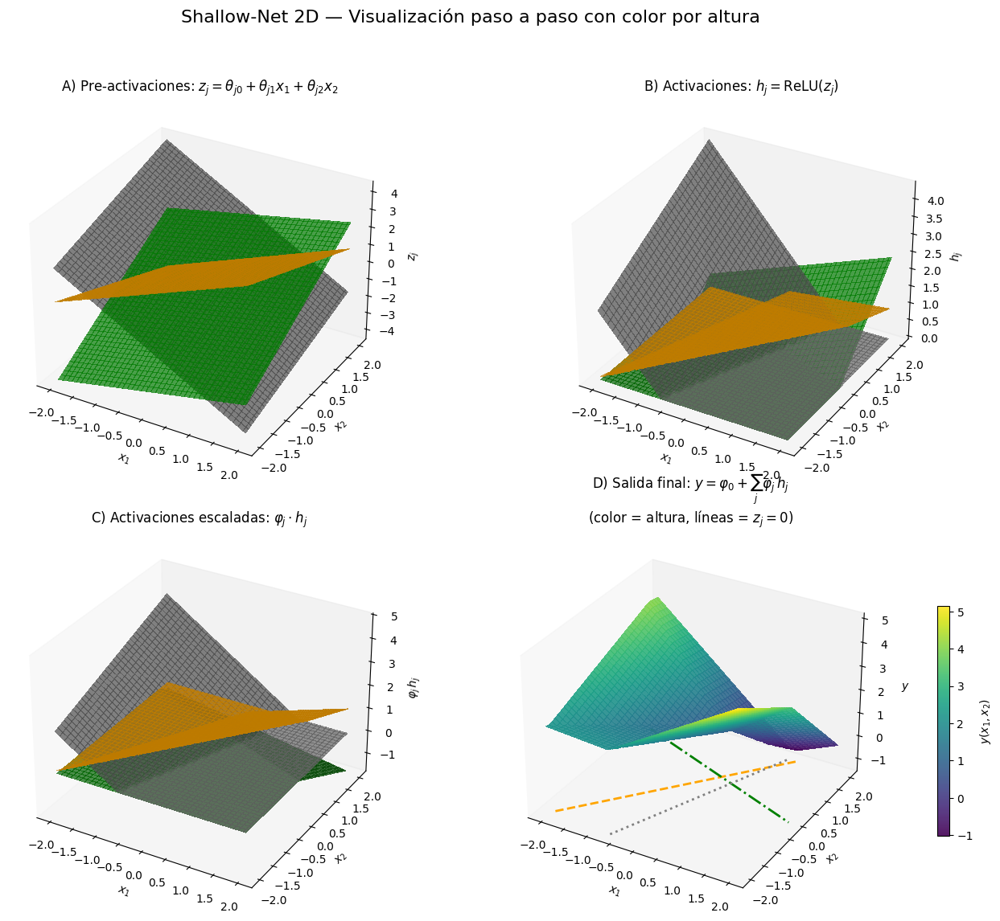

In [70]:
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D  # necesario para proyecciones 3D

# ───────── Parámetros de la red (3 unidades ocultas) ─────────
# Cada fila de theta = [θ_j0, θ_j1, θ_j2], de modo que
# z_j(x1,x2) = θ_j0 + θ_j1·x1 + θ_j2·x2
theta = np.array([
    [ 0.5,  1.0, -0.8],   # θ10, θ11, θ12  (unidad oculta 1)
    [-1.0,  0.5,  1.2],   # θ20, θ21, θ22  (unidad oculta 2)
    [ 0.2, -1.5,  0.6]    # θ30, θ31, θ32  (unidad oculta 3)
])
# Pesos de la capa de salida: [φ0, φ1, φ2, φ3]
phi = np.array([0.3,  1.2,  -0.7,  0.9])

# ───────── Dominio de entrada 2D ─────────
n = 80  # tamaño de la rejilla por eje
x1 = np.linspace(-2, 2, n)
x2 = np.linspace(-2, 2, n)
X1, X2 = np.meshgrid(x1, x2)

# ───────── Cálculos paso a paso ─────────
# 1) Pre‐activaciones: z_j(x1,x2) = θ_j0 + θ_j1·x1 + θ_j2·x2
Z = np.zeros((3, n, n))
for j in range(3):
    θ0, θ1, θ2 = theta[j]
    Z[j] = θ0 + θ1 * X1 + θ2 * X2

# 2) Activaciones ReLU: h_j = max(0, Z[j])
H = np.maximum(0, Z)

# 3) Activaciones escaladas: φ_j * h_j  (j=1,2,3)
H_scaled = np.zeros_like(H)
for j in range(3):
    H_scaled[j] = phi[j+1] * H[j]

# 4) Salida final: y(x1,x2) = φ0 + Σ φ_j * h_j
Y = phi[0] + np.sum(H_scaled, axis=0)

# ───────── Dibujo de las 4 visualizaciones (2×2) ─────────
fig = plt.figure(figsize=(14, 12))
fig.suptitle("Shallow‐Net 2D — Visualización paso a paso con color por altura", fontsize=16)

# Colores para las tres unidades ocultas
colors = ['orange','green','gray']

# — Panel A: planos de pre‐activación z₁, z₂, z₃ —
axA = fig.add_subplot(2, 2, 1, projection='3d')
for j, c in zip(range(3), colors):
    axA.plot_surface(
        X1, X2, Z[j],
        color=c, alpha=0.7, linewidth=0, antialiased=False
    )
axA.set_title("A) Pre‐activaciones: $z_j = θ_{j0} + θ_{j1}x_1 + θ_{j2}x_2$")
axA.set_xlabel("$x_1$")
axA.set_ylabel("$x_2$")
axA.set_zlabel("$z_j$")
axA.view_init(elev=30, azim=-60)
axA.grid(False)

# — Panel B: activaciones ReLU h₁, h₂, h₃ —
axB = fig.add_subplot(2, 2, 2, projection='3d')
for j, c in zip(range(3), colors):
    axB.plot_surface(
        X1, X2, H[j],
        color=c, alpha=0.7, linewidth=0, antialiased=False
    )
axB.set_title("B) Activaciones: $h_j = \\mathrm{ReLU}(z_j)$")
axB.set_xlabel("$x_1$")
axB.set_ylabel("$x_2$")
axB.set_zlabel("$h_j$")
axB.view_init(elev=30, azim=-60)
axB.grid(False)

# — Panel C: activaciones escaladas φ_j·h_j —
axC = fig.add_subplot(2, 2, 3, projection='3d')
for j, c in zip(range(3), colors):
    axC.plot_surface(
        X1, X2, H_scaled[j],
        color=c, alpha=0.7, linewidth=0, antialiased=False
    )
axC.set_title("C) Activaciones escaladas: $\\varphi_j \\cdot h_j$")
axC.set_xlabel("$x_1$")
axC.set_ylabel("$x_2$")
axC.set_zlabel("$\\varphi_j\,h_j$")
axC.view_init(elev=30, azim=-60)
axC.grid(False)

# — Panel D: suma final y = φ₀ + Σ φ_j·h_j, coloreada según altura, con contornos z_j = 0 —
axD = fig.add_subplot(2, 2, 4, projection='3d')
# 4a) Superficie final con colormap según altura
surf = axD.plot_surface(
    X1, X2, Y,
    cmap='viridis',         # usa un colormap que colorea según z = Y
    alpha=0.9, linewidth=0, antialiased=False
)
# Añadir barra de color para la altura
fig.colorbar(surf, ax=axD, pad=0.1, shrink=0.6, label='$y(x_1,x_2)$')

# 4b) Dibujar las líneas donde z_j(x1,x2) = 0 para marcar los cortes
z_min = float(np.min(Y)) - 0.5
for j, (c, ls) in enumerate(zip(colors, ['--','-.',':'])):
    axD.contour(
        X1, X2, Z[j],
        levels=[0],
        colors=[c],
        linestyles=[ls],
        linewidths=2,
        zdir='z',
        offset=z_min
    )

axD.set_zlim(z_min, np.max(Y))
axD.set_title("D) Salida final: $y=\\varphi_0 + \\sum_j \\varphi_j\,h_j$\n(color = altura, líneas = $z_j=0$)")
axD.set_xlabel("$x_1$")
axD.set_ylabel("$x_2$")
axD.set_zlabel("$y$")
axD.view_init(elev=30, azim=-60)
axD.grid(False)

plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.show()


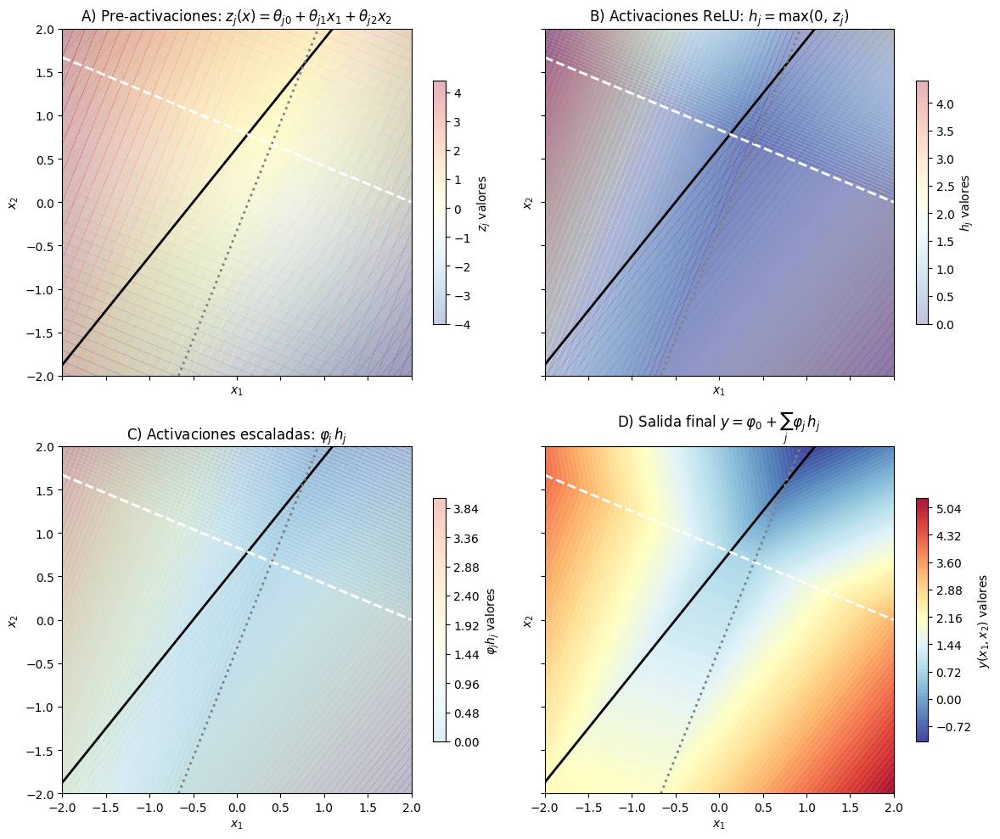

In [69]:
import numpy as np
import matplotlib.pyplot as plt

# ───────── Parámetros de la red (3 unidades ocultas) ─────────
# Cada fila de theta = [θ_j0, θ_j1, θ_j2], de modo que
# z_j(x1,x2) = θ_j0 + θ_j1·x1 + θ_j2·x2
theta = np.array([
    [ 0.5,  1.0, -0.8],   # θ10, θ11, θ12  (unidad oculta 1)
    [-1.0,  0.5,  1.2],   # θ20, θ21, θ22  (unidad oculta 2)
    [ 0.2, -1.5,  0.6]    # θ30, θ31, θ32  (unidad oculta 3)
])
# Pesos de la capa de salida: [φ0, φ1, φ2, φ3]
phi = np.array([0.3,  1.2,  -0.7,  0.9])

# ───────── Dominio de entrada 2D ─────────
n = 200  # resolución de la rejilla en cada eje
x1 = np.linspace(-2, 2, n)
x2 = np.linspace(-2, 2, n)
X1, X2 = np.meshgrid(x1, x2)

# ───────── Cálculos paso a paso ─────────
# 1) Pre‐activaciones: Z[j] = θ_j0 + θ_j1·X1 + θ_j2·X2
Z = np.zeros((3, n, n))
for j in range(3):
    θ0, θ1, θ2 = theta[j]
    Z[j] = θ0 + θ1*X1 + θ2*X2

# 2) Activaciones ReLU: H[j] = max(0, Z[j])
H = np.maximum(0, Z)

# 3) Activaciones escaladas: H_scaled[j] = φ_{j+1} * H[j]
H_scaled = np.zeros_like(H)
for j in range(3):
    H_scaled[j] = phi[j+1] * H[j]

# 4) Salida final: Y = φ0 + Σ_{j=1..3} φ_j * H[j]
Y = phi[0] + H_scaled.sum(axis=0)

# ───────── Dibujo de las 4 visualizaciones (2×2) en 2D ─────────
fig, axes = plt.subplots(2, 2, figsize=(12, 10), sharex=True, sharey=True)
axes = axes.ravel()
cmap = 'RdYlBu_r'

# Colores para las líneas z_j=0 (cada unidad oculta)
line_colors = ['black', 'white', 'gray']
line_styles = ['-', '--', ':']

# Panel A: Pre‐activaciones Z[j]
ax = axes[0]
for j in range(3):
    # pintamos cada Z[j] en semitransparencia
    cf = ax.contourf(X1, X2, Z[j],
                     levels=50,
                     cmap=cmap,
                     alpha=0.3,
                     vmin=Z.min(), vmax=Z.max())
    # dibujamos línea donde Z[j]=0
    ax.contour(X1, X2, Z[j],
               levels=[0],
               colors=[line_colors[j]],
               linestyles=[line_styles[j]],
               linewidths=2)
ax.set_title("A) Pre‐activaciones: $z_j(x)=θ_{j0}+θ_{j1}x_1+θ_{j2}x_2$")
ax.set_xlabel("$x_1$")
ax.set_ylabel("$x_2$")
# opcional: añadir barra de color para Z (la misma para todos)
cbar = fig.colorbar(cf, ax=ax, orientation='vertical', shrink=0.7)
cbar.set_label('$z_j$ valores')

# Panel B: Activaciones ReLU H[j]
ax = axes[1]
for j in range(3):
    cf = ax.contourf(X1, X2, H[j],
                     levels=50,
                     cmap=cmap,
                     alpha=0.3,
                     vmin=0, vmax=H.max())
    # dibujar la misma línea Z[j]=0 para indicar dónde cambia
    ax.contour(X1, X2, Z[j],
               levels=[0],
               colors=[line_colors[j]],
               linestyles=[line_styles[j]],
               linewidths=2)
ax.set_title("B) Activaciones ReLU: $h_j = \\max(0,\,z_j)$")
ax.set_xlabel("$x_1$")
ax.set_ylabel("$x_2$")
cbar = fig.colorbar(cf, ax=ax, orientation='vertical', shrink=0.7)
cbar.set_label('$h_j$ valores')

# Panel C: Activaciones escaladas φ_j·H[j]
ax = axes[2]
for j in range(3):
    cf = ax.contourf(X1, X2, H_scaled[j],
                     levels=50,
                     cmap=cmap,
                     alpha=0.3,
                     vmin=H_scaled.min(), vmax=H_scaled.max())
    ax.contour(X1, X2, Z[j],
               levels=[0],
               colors=[line_colors[j]],
               linestyles=[line_styles[j]],
               linewidths=2)
ax.set_title("C) Activaciones escaladas: $\\varphi_j\\,h_j$")
ax.set_xlabel("$x_1$")
ax.set_ylabel("$x_2$")
cbar = fig.colorbar(cf, ax=ax, orientation='vertical', shrink=0.7)
cbar.set_label('$\\varphi_j h_j$ valores')

# Panel D: Salida final Y, coloreada con líneas de bisagra z_j=0
ax = axes[3]
cf = ax.contourf(X1, X2, Y,
                 levels=100,
                 cmap=cmap,
                 alpha=0.9,
                 vmin=Y.min(), vmax=Y.max())
# Dibujar las líneas donde z_j=0 para marcar regiones
for j in range(3):
    ax.contour(X1, X2, Z[j],
               levels=[0],
               colors=[line_colors[j]],
               linestyles=[line_styles[j]],
               linewidths=2)
ax.set_title(r"D) Salida final $y = \varphi_0 + \sum_j \varphi_j\,h_j$")
ax.set_xlabel("$x_1$")
ax.set_ylabel("$x_2$")
cbar = fig.colorbar(cf, ax=ax, orientation='vertical', shrink=0.7)
cbar.set_label('$y(x_1, x_2)$ valores')

plt.tight_layout()
plt.show()


REGIONES LINEALES CON OTRAS ACTIVACIONES

- threshold
- ReLU
- sigmoid

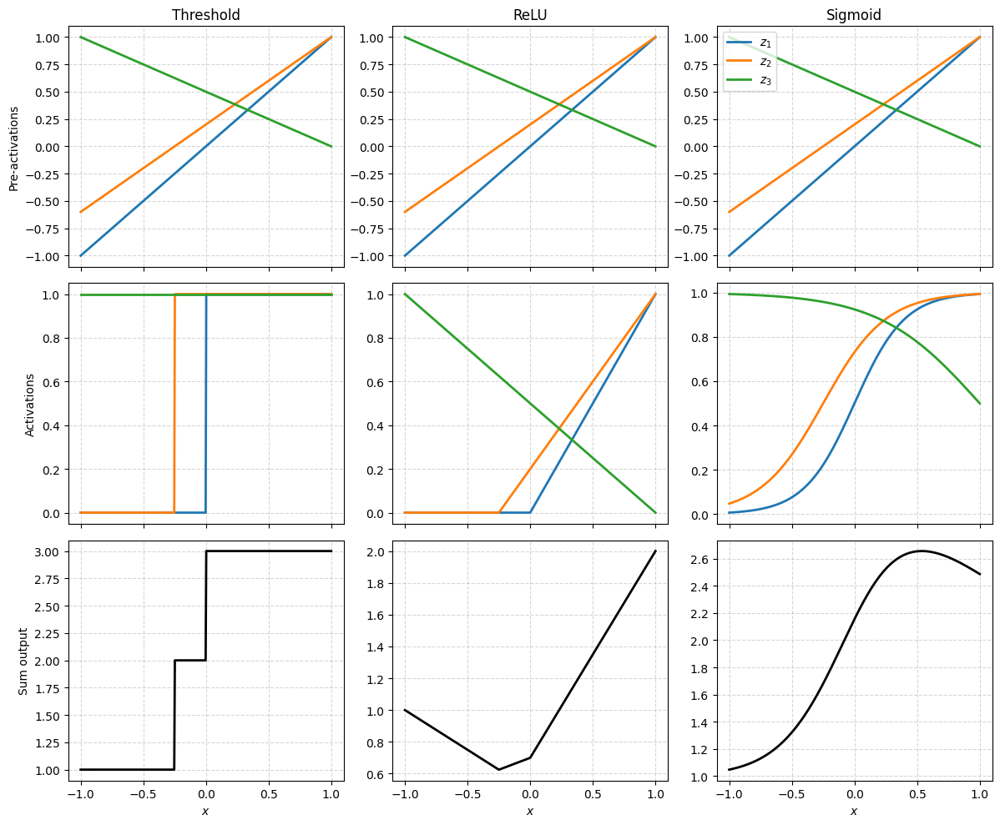

In [15]:
import numpy as np
import matplotlib.pyplot as plt

# ───────── Dominio de entrada 1D ─────────
x = np.linspace(-1, 1, 400)

# ───────── Pre‐activaciones (mismas tres funciones lineales) ─────────
z1 = x
z2 = 0.8 * x + 0.2
z3 = -0.5 * x + 0.5

# Definir activaciones
def step(x):
    return (x >= 0).astype(float)

def relu(x):
    return np.maximum(0, x)

def sigmoid(x):
    return 1 / (1 + np.exp(-5 * x))  # pendiente aguda

# Calcular activaciones
h_step = np.vstack([step(z1), step(z2), step(z3)])
h_relu = np.vstack([relu(z1), relu(z2), relu(z3)])
h_sig  = np.vstack([sigmoid(z1), sigmoid(z2), sigmoid(z3)])

# Sumar contribuciones
sum_step = np.sum(h_step, axis=0)
sum_relu = np.sum(h_relu, axis=0)
sum_sig  = np.sum(h_sig,  axis=0)

# ───────── Plot 3x3 paneles ─────────
fig, axes = plt.subplots(3, 3, figsize=(12, 10), sharex=True)
activations = ['Threshold', 'ReLU', 'Sigmoid']
# Row 1: preactivations
for col, ax in enumerate(axes[0]):
    ax.plot(x, z1, 'C0', lw=2, label='$z_1$')
    ax.plot(x, z2, 'C1', lw=2, label='$z_2$')
    ax.plot(x, z3, 'C2', lw=2, label='$z_3$')
    ax.set_title(activations[col])
    if col == 0:
        ax.set_ylabel('Pre-activations')
    ax.grid(ls='--', alpha=0.5)
    if col == 2:
        ax.legend(loc='upper left')

# Row 2: activations
for col, (h, ax) in enumerate(zip([h_step, h_relu, h_sig], axes[1])):
    ax.plot(x, h[0], 'C0', lw=2)
    ax.plot(x, h[1], 'C1', lw=2)
    ax.plot(x, h[2], 'C2', lw=2)
    if col == 0:
        ax.set_ylabel('Activations')
    ax.grid(ls='--', alpha=0.5)

# Row 3: sum of activations
for col, (s, ax) in enumerate(zip([sum_step, sum_relu, sum_sig], axes[2])):
    ax.plot(x, s, 'k', lw=2)
    ax.set_xlabel('$x$')
    if col == 0:
        ax.set_ylabel('Sum output')
    ax.grid(ls='--', alpha=0.5)

plt.tight_layout()
plt.show()


## XOR con shallow network

Si no usamos activacion en la output neuron, podemos hacer que >0 sea de una clase y <=0 sea de la otra.

Podriamos usarla igual...

Entonces con dos inputs, dos hidden units y una output neuron se puede resolver XOR. Se crean 3 (n+1) regiones lineales

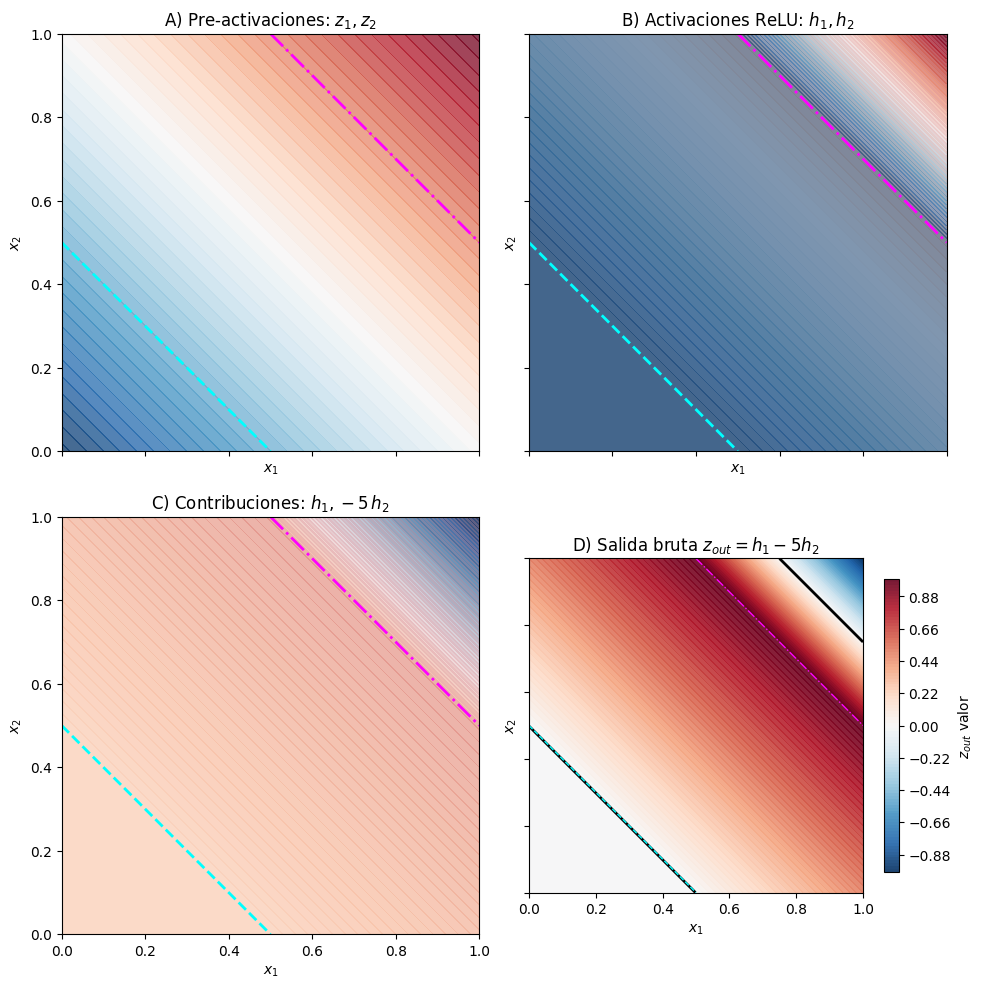

In [79]:
import numpy as np
import matplotlib.pyplot as plt

# ───────── Definir la red XOR con 2 ReLU ocultas y salida lineal ─────────
def compute_maps(n=300):
    x = np.linspace(0, 1, n)
    X1, X2 = np.meshgrid(x, x)
    # Pre-activaciones
    Z1 = X1 + X2 - 0.5       # bisagra 1 en x1+x2 = 0.5
    Z2 = X1 + X2 - 1.5       # bisagra 2 en x1+x2 = 1.5
    # Activaciones ReLU
    H1 = np.maximum(0, Z1)
    H2 = np.maximum(0, Z2)
    # Contribuciones escaladas
    C1 = H1               # φ1 = +1
    C2 = -5 * H2          # φ2 = -5
    # Salida bruta
    Z_out = C1 + C2       # φ0 = 0
    return X1, X2, Z1, Z2, H1, H2, C1, C2, Z_out

# ───────── Crear mapas ─────────
X1, X2, Z1, Z2, H1, H2, C1, C2, Z_out = compute_maps()

# ───────── Dibujo 4 paneles ─────────
fig, axes = plt.subplots(2, 2, figsize=(10, 10), sharex=True, sharey=True)
axes = axes.ravel()
cmap = 'RdBu_r'

# Colores y estilos para las bisagras
contour_colors = ['cyan', 'magenta']
contour_styles = ['--', '-.']

# Panel A: pre-activaciones Z1, Z2
ax = axes[0]
ax.contourf(X1, X2, Z1, levels=50, cmap=cmap, alpha=0.5, vmin=Z1.min(), vmax=Z1.max())
ax.contourf(X1, X2, Z2, levels=50, cmap=cmap, alpha=0.5, vmin=Z2.min(), vmax=Z2.max())
# Líneas de bisagra
ax.contour(X1, X2, Z1, levels=[0], colors=[contour_colors[0]], linestyles=[contour_styles[0]], linewidths=2)
ax.contour(X1, X2, Z2, levels=[0], colors=[contour_colors[1]], linestyles=[contour_styles[1]], linewidths=2)
ax.set_title("A) Pre-activaciones: $z_1,z_2$")
ax.set_xlabel("$x_1$")
ax.set_ylabel("$x_2$")
ax.set_aspect('equal')

# Panel B: activaciones ReLU H1, H2
ax = axes[1]
ax.contourf(X1, X2, H1, levels=50, cmap=cmap, alpha=0.5, vmin=0, vmax=H1.max())
ax.contourf(X1, X2, H2, levels=50, cmap=cmap, alpha=0.5, vmin=0, vmax=H2.max())
# Líneas de bisagra de Z1, Z2
ax.contour(X1, X2, Z1, levels=[0], colors=[contour_colors[0]], linestyles=[contour_styles[0]], linewidths=2)
ax.contour(X1, X2, Z2, levels=[0], colors=[contour_colors[1]], linestyles=[contour_styles[1]], linewidths=2)
ax.set_title("B) Activaciones ReLU: $h_1,h_2$")
ax.set_xlabel("$x_1$")
ax.set_ylabel("$x_2$")
ax.set_aspect('equal')

# Panel C: contribuciones C1, C2
ax = axes[2]
ax.contourf(X1, X2, C1, levels=50, cmap=cmap, alpha=0.5, vmin=min(C1.min(), C2.min()), vmax=max(C1.max(), C2.max()))
ax.contourf(X1, X2, C2, levels=50, cmap=cmap, alpha=0.5, vmin=min(C1.min(), C2.min()), vmax=max(C1.max(), C2.max()))
# Líneas de bisagra
ax.contour(X1, X2, Z1, levels=[0], colors=[contour_colors[0]], linestyles=[contour_styles[0]], linewidths=2)
ax.contour(X1, X2, Z2, levels=[0], colors=[contour_colors[1]], linestyles=[contour_styles[1]], linewidths=2)
ax.set_title("C) Contribuciones: $h_1, -5\,h_2$")
ax.set_xlabel("$x_1$")
ax.set_ylabel("$x_2$")
ax.set_aspect('equal')

# Panel D: salida bruta Z_out y frontera Z_out = 0
ax = axes[3]
cf = ax.contourf(X1, X2, Z_out, levels=100, cmap=cmap, alpha=0.9, vmin=Z_out.min(), vmax=Z_out.max())
ax.contour(X1, X2, Z_out, levels=[0], colors='k', linewidths=2)
# Bisagras
ax.contour(X1, X2, Z1, levels=[0], colors=[contour_colors[0]], linestyles=[contour_styles[0]], linewidths=1)
ax.contour(X1, X2, Z2, levels=[0], colors=[contour_colors[1]], linestyles=[contour_styles[1]], linewidths=1)
ax.set_title("D) Salida bruta $z_{out}=h_1 - 5h_2$")
ax.set_xlabel("$x_1$")
ax.set_ylabel("$x_2$")
ax.set_aspect('equal')

# Barra de color para panel D
cbar = fig.colorbar(cf, ax=axes[3], orientation='vertical', shrink=0.7)
cbar.set_label('$z_{out}$ valor')

plt.tight_layout()
plt.show()


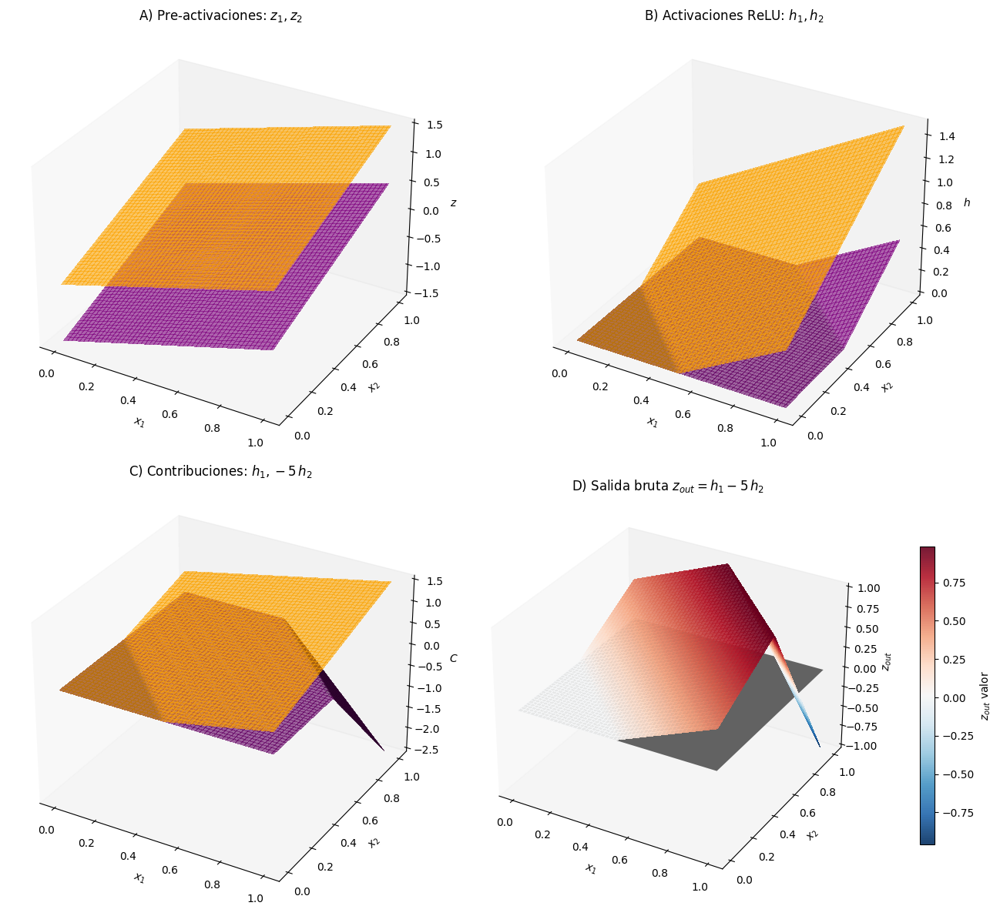

In [82]:
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# ───────── Definir la red XOR con 2 ReLU ocultas y salida lineal ─────────
def compute_maps(n=100):
    x = np.linspace(0, 1, n)
    X1, X2 = np.meshgrid(x, x)
    # Pre-activaciones
    Z1 = X1 + X2 - 0.5       # bisagra 1 en x1+x2 = 0.5
    Z2 = X1 + X2 - 1.5       # bisagra 2 en x1+x2 = 1.5
    # Activaciones ReLU
    H1 = np.maximum(0, Z1)
    H2 = np.maximum(0, Z2)
    # Contribuciones escaladas
    C1 = H1               # φ1 = +1
    C2 = -5 * H2          # φ2 = -5
    # Salida bruta
    Z_out = C1 + C2       # φ0 = 0
    return X1, X2, Z1, Z2, H1, H2, C1, C2, Z_out

# ───────── Crear mapas ─────────
X1, X2, Z1, Z2, H1, H2, C1, C2, Z_out = compute_maps(n=100)

# ───────── Dibujo 4 paneles 3D ─────────
fig = plt.figure(figsize=(14, 12))

# Panel A: Pre-activaciones Z1, Z2
axA = fig.add_subplot(2, 2, 1, projection='3d')
axA.plot_surface(X1, X2, Z1, color='orange', alpha=0.6, linewidth=0, antialiased=False)
axA.plot_surface(X1, X2, Z2, color='purple', alpha=0.6, linewidth=0, antialiased=False)
axA.set_title("A) Pre-activaciones: $z_1, z_2$")
axA.set_xlabel("$x_1$")
axA.set_ylabel("$x_2$")
axA.set_zlabel("$z$")
axA.view_init(elev=30, azim=-60)
axA.grid(False)

# Panel B: Activaciones ReLU H1, H2
axB = fig.add_subplot(2, 2, 2, projection='3d')
axB.plot_surface(X1, X2, H1, color='orange', alpha=0.6, linewidth=0, antialiased=False)
axB.plot_surface(X1, X2, H2, color='purple', alpha=0.6, linewidth=0, antialiased=False)
axB.set_title("B) Activaciones ReLU: $h_1, h_2$")
axB.set_xlabel("$x_1$")
axB.set_ylabel("$x_2$")
axB.set_zlabel("$h$")
axB.view_init(elev=30, azim=-60)
axB.grid(False)

# Panel C: Contribuciones C1, C2
axC = fig.add_subplot(2, 2, 3, projection='3d')
axC.plot_surface(X1, X2, C1, color='orange', alpha=0.6, linewidth=0, antialiased=False)
axC.plot_surface(X1, X2, C2, color='purple', alpha=0.6, linewidth=0, antialiased=False)
axC.set_title("C) Contribuciones: $h_1, -5\,h_2$")
axC.set_xlabel("$x_1$")
axC.set_ylabel("$x_2$")
axC.set_zlabel("$C$")
axC.view_init(elev=30, azim=-60)
axC.grid(False)

# Panel D: Salida bruta Z_out con contorno de frontera z=0
axD = fig.add_subplot(2, 2, 4, projection='3d')
surf = axD.plot_surface(
    X1, X2, Z_out,
    cmap='RdBu_r', alpha=0.9, linewidth=0, antialiased=False
)
# Dibujar plano z=0
xx = np.linspace(0, 1, 2)
yy = np.linspace(0, 1, 2)
PX, PY = np.meshgrid(xx, yy)
PZ = np.zeros_like(PX)
axD.plot_surface(PX, PY, PZ, color='gray', alpha=1.0)
axD.set_title("D) Salida bruta $z_{out} = h_1 - 5\,h_2$")
axD.set_xlabel("$x_1$")
axD.set_ylabel("$x_2$")
axD.set_zlabel("$z_{out}$")
axD.view_init(elev=30, azim=-60)
axD.grid(False)

# Barra de color para panel D
fig.colorbar(surf, ax=axD, pad=0.1, shrink=0.7, label='$z_{out}$ valor')

plt.tight_layout()
plt.show()


CON SIGMOID FUNCTION

Se nota mucho mejor. En vez de hacer <0 o >=0, aca ya tenemos todo entre 0 y 1 por lo que mientras mas alto sea, mas prob de una clase y menos de la otra. Se puede interpretar como una probabilidad.

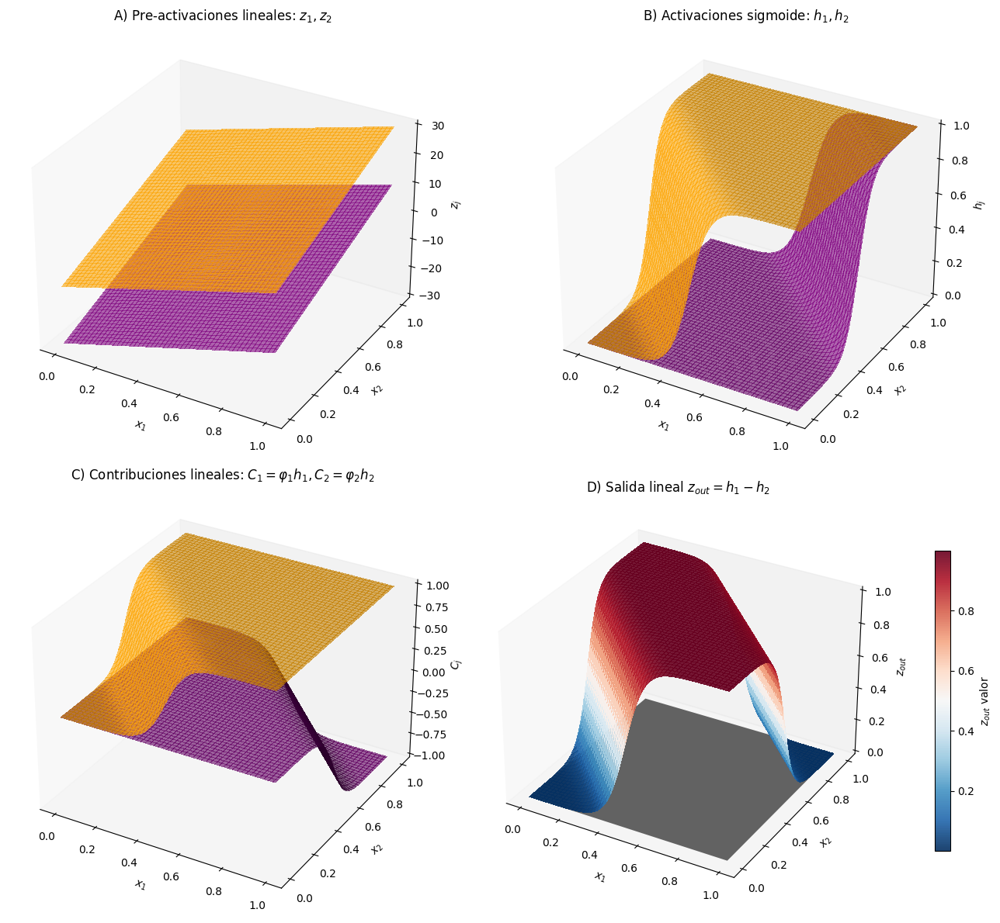

In [83]:
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# ───────── Parámetros y definiciones para XOR con sigmoid en ocultas ─────────
k = 20.0  # pendiente de las sigmoides para aproximar step
phi1, phi2 = 1.0, -1.0  # pesos de salida para las dos sigmoides

def sigmoid(x):
    return 1 / (1 + np.exp(-x))

def compute_maps_sigmoid(n=100):
    x = np.linspace(0, 1, n)
    X1, X2 = np.meshgrid(x, x)
    # Pre-activaciones lineales (planos) para cada unidad oculta
    Z1 = k * (X1 + X2 - 0.5)  # activa cerca de x1+x2=0.5
    Z2 = k * (X1 + X2 - 1.5)  # activa cerca de x1+x2=1.5
    # Activaciones sigmoide
    H1 = sigmoid(Z1)
    H2 = sigmoid(Z2)
    # Contribuciones escaladas
    C1 = phi1 * H1
    C2 = phi2 * H2
    # Salida lineal sin activación final
    Z_out = C1 + C2
    return X1, X2, Z1, Z2, H1, H2, C1, C2, Z_out

# ───────── Crear mapas ─────────
X1, X2, Z1, Z2, H1, H2, C1, C2, Z_out = compute_maps_sigmoid(n=100)

# ───────── Dibujo de los 4 paneles en 3D ─────────
fig = plt.figure(figsize=(14, 12))
colors = ['orange', 'purple']

# Panel A: Pre-activaciones Z1 y Z2
axA = fig.add_subplot(2, 2, 1, projection='3d')
axA.plot_surface(X1, X2, Z1, color=colors[0], alpha=0.6, linewidth=0, antialiased=False)
axA.plot_surface(X1, X2, Z2, color=colors[1], alpha=0.6, linewidth=0, antialiased=False)
axA.set_title("A) Pre-activaciones lineales: $z_1, z_2$")
axA.set_xlabel("$x_1$")
axA.set_ylabel("$x_2$")
axA.set_zlabel("$z_j$")
axA.view_init(elev=30, azim=-60)
axA.grid(False)

# Panel B: Activaciones sigmoide H1 y H2
axB = fig.add_subplot(2, 2, 2, projection='3d')
axB.plot_surface(X1, X2, H1, color=colors[0], alpha=0.6, linewidth=0, antialiased=False)
axB.plot_surface(X1, X2, H2, color=colors[1], alpha=0.6, linewidth=0, antialiased=False)
axB.set_title("B) Activaciones sigmoide: $h_1, h_2$")
axB.set_xlabel("$x_1$")
axB.set_ylabel("$x_2$")
axB.set_zlabel("$h_j$")
axB.view_init(elev=30, azim=-60)
axB.grid(False)

# Panel C: Contribuciones C1=φ1*h1, C2=φ2*h2
axC = fig.add_subplot(2, 2, 3, projection='3d')
axC.plot_surface(X1, X2, C1, color=colors[0], alpha=0.6, linewidth=0, antialiased=False)
axC.plot_surface(X1, X2, C2, color=colors[1], alpha=0.6, linewidth=0, antialiased=False)
axC.set_title("C) Contribuciones lineales: $C_1=φ_1 h_1, C_2=φ_2 h_2$")
axC.set_xlabel("$x_1$")
axC.set_ylabel("$x_2$")
axC.set_zlabel("$C_j$")
axC.view_init(elev=30, azim=-60)
axC.grid(False)

# Panel D: Salida bruta Z_out = C1 + C2 con plano z=0
axD = fig.add_subplot(2, 2, 4, projection='3d')
surf = axD.plot_surface(
    X1, X2, Z_out,
    cmap='RdBu_r', alpha=0.9, linewidth=0, antialiased=False
)
# Plano z=0 para marcar frontera
xx = np.linspace(0, 1, 2)
yy = np.linspace(0, 1, 2)
PX, PY = np.meshgrid(xx, yy)
PZ = np.zeros_like(PX)
axD.plot_surface(PX, PY, PZ, color='gray', alpha=1.0)

axD.set_title("D) Salida lineal $z_{out} = h_1 - h_2$")
axD.set_xlabel("$x_1$")
axD.set_ylabel("$x_2$")
axD.set_zlabel("$z_{out}$")
axD.view_init(elev=30, azim=-60)
axD.grid(False)

# Barra de color en Panel D
fig.colorbar(surf, ax=axD, pad=0.1, shrink=0.7, label='$z_{out}$ valor')

plt.tight_layout()
plt.show()


**Shallow con threshold (no ReLU)**

Tambien se puede hacer con threshold, que es la funcion de activacion mas basica... 

Y con esto tambien se puede resolver XOR

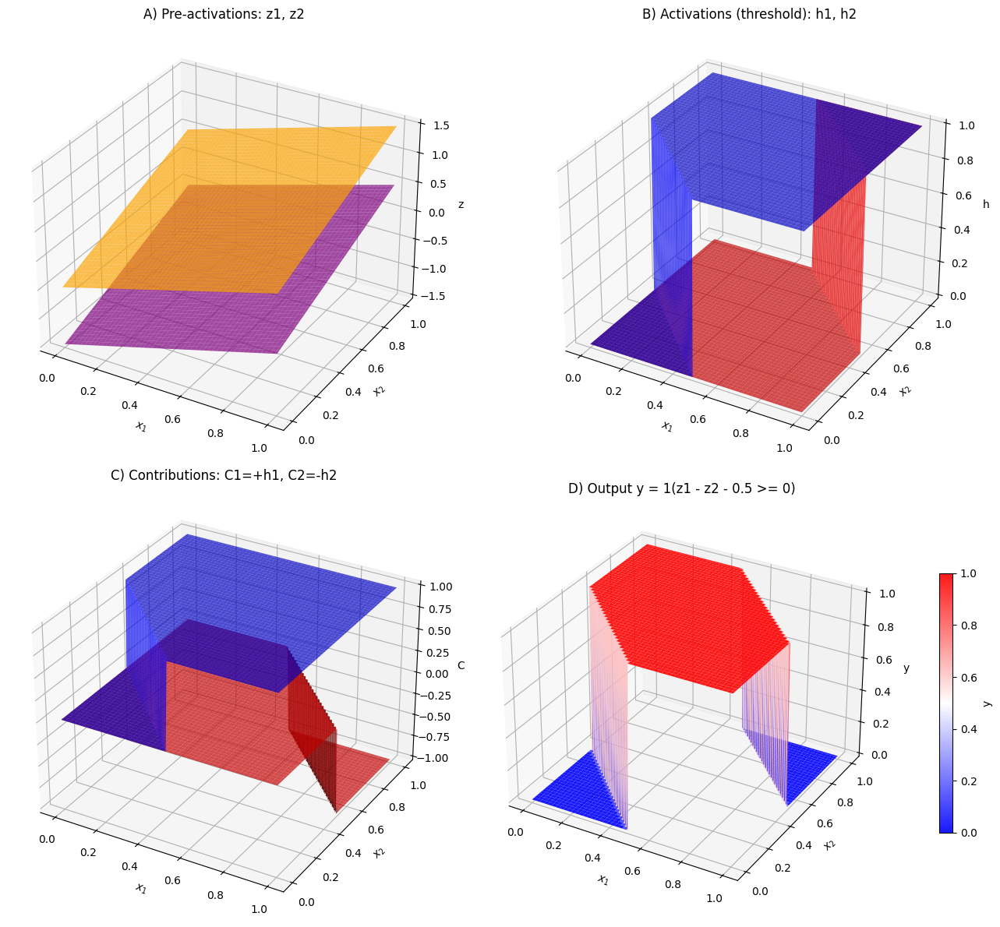

In [10]:
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# ───────── Dominio de entrada 2D ─────────
n = 100
x = np.linspace(0, 1, n)
X1, X2 = np.meshgrid(x, x)

# ───────── Parámetros de la red threshold para XOR ─────────
# Hidden unit 1: OR
w1 = np.array([1.0, 1.0])
theta1 = 0.5  # threshold
# Hidden unit 2: AND
w2 = np.array([1.0, 1.0])
theta2 = 1.5  # threshold
# Output unit
v = np.array([1.0, -1.0])
theta_out = 0.5

# ───────── 1) Pre‐activations ocultas z1, z2 ─────────
Z1 = w1[0]*X1 + w1[1]*X2 - theta1
Z2 = w2[0]*X1 + w2[1]*X2 - theta2

# ───────── 2) Activations threshold h1, h2 ─────────
H1 = (Z1 >= 0).astype(float)
H2 = (Z2 >= 0).astype(float)

# ───────── 3) Contributions C1, C2 ─────────
C1 = v[0] * H1   # +1 * h1
C2 = v[1] * H2   # -1 * h2

# ───────── 4) Pre‐activation de salida z_out y activación final Y ─────────
Z_out = C1 + C2 - theta_out
Y = (Z_out >= 0).astype(float)

# ───────── Graficar 4 paneles 3D ─────────
fig = plt.figure(figsize=(14, 12))

# Panel A: pre‐activations Z1, Z2
axA = fig.add_subplot(2, 2, 1, projection='3d')
axA.plot_surface(X1, X2, Z1, color='orange', alpha=0.7, linewidth=0)
axA.plot_surface(X1, X2, Z2, color='purple', alpha=0.7, linewidth=0)
axA.set_title("A) Pre-activations: z1, z2")
axA.set_xlabel("$x_1$"); axA.set_ylabel("$x_2$"); axA.set_zlabel("z")
axA.view_init(elev=30, azim=-60)

# Panel B: activations H1, H2
axB = fig.add_subplot(2, 2, 2, projection='3d')
axB.plot_surface(X1, X2, H1, color='blue', alpha=0.7, linewidth=0)
axB.plot_surface(X1, X2, H2, color='red', alpha=0.7, linewidth=0)
axB.set_title("B) Activations (threshold): h1, h2")
axB.set_xlabel("$x_1$"); axB.set_ylabel("$x_2$"); axB.set_zlabel("h")
axB.view_init(elev=30, azim=-60)

# Panel C: contributions C1, C2
axC = fig.add_subplot(2, 2, 3, projection='3d')
axC.plot_surface(X1, X2, C1, color='blue', alpha=0.7, linewidth=0)
axC.plot_surface(X1, X2, C2, color='red', alpha=0.7, linewidth=0)
axC.set_title("C) Contributions: C1=+h1, C2=-h2")
axC.set_xlabel("$x_1$"); axC.set_ylabel("$x_2$"); axC.set_zlabel("C")
axC.view_init(elev=30, azim=-60)

# Panel D: final output Y
axD = fig.add_subplot(2, 2, 4, projection='3d')
surf = axD.plot_surface(X1, X2, Y, cmap='bwr', alpha=0.9, linewidth=0)
axD.set_title("D) Output y = 1(z1 - z2 - 0.5 >= 0)")
axD.set_xlabel("$x_1$"); axD.set_ylabel("$x_2$"); axD.set_zlabel("y")
axD.view_init(elev=30, azim=-60)
fig.colorbar(surf, ax=axD, pad=0.1, shrink=0.6, label='y')

plt.tight_layout()
plt.show()


Que se use el threshold como activacion no implica que la salida final del modelo siempre sea binaria. Al combinarlos, puede dar otros valores...

El problema es que no es diferenciable y aparte que perdes informacion al ser binaria en cada neurona, no capta ciertas cosas porque es menos expresiva, por eso por lo general usamos otra como ReLU o sigmoid

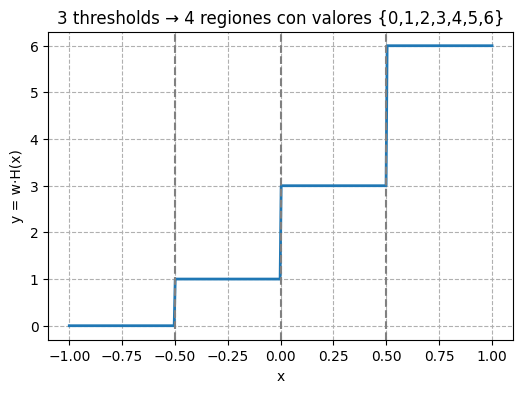

In [11]:
import numpy as np
import matplotlib.pyplot as plt

# 3 neuronas ocultas threshold en x = -0.5, 0.0, +0.5
thresholds = [-0.5, 0.0, 0.5]
x = np.linspace(-1,1,400)

# H[j](x) = 1_{x >= thresholds[j]}
H = np.array([ (x >= t).astype(int) for t in thresholds ])

# pesos de salida (sin threshold)
w_out = np.array([1, 2, 3])

# salida lineal y(x) = sum_j w_out[j] * H[j](x)
y = w_out.dot(H)

# dibujar
plt.figure(figsize=(6,4))
plt.plot(x, y, lw=2)
for t in thresholds:
    plt.axvline(t, ls='--', color='gray')
plt.title("3 thresholds → 4 regiones con valores {0,1,2,3,4,5,6}")
plt.xlabel("x")
plt.ylabel("y = w·H(x)")
plt.grid(ls='--')
plt.show()


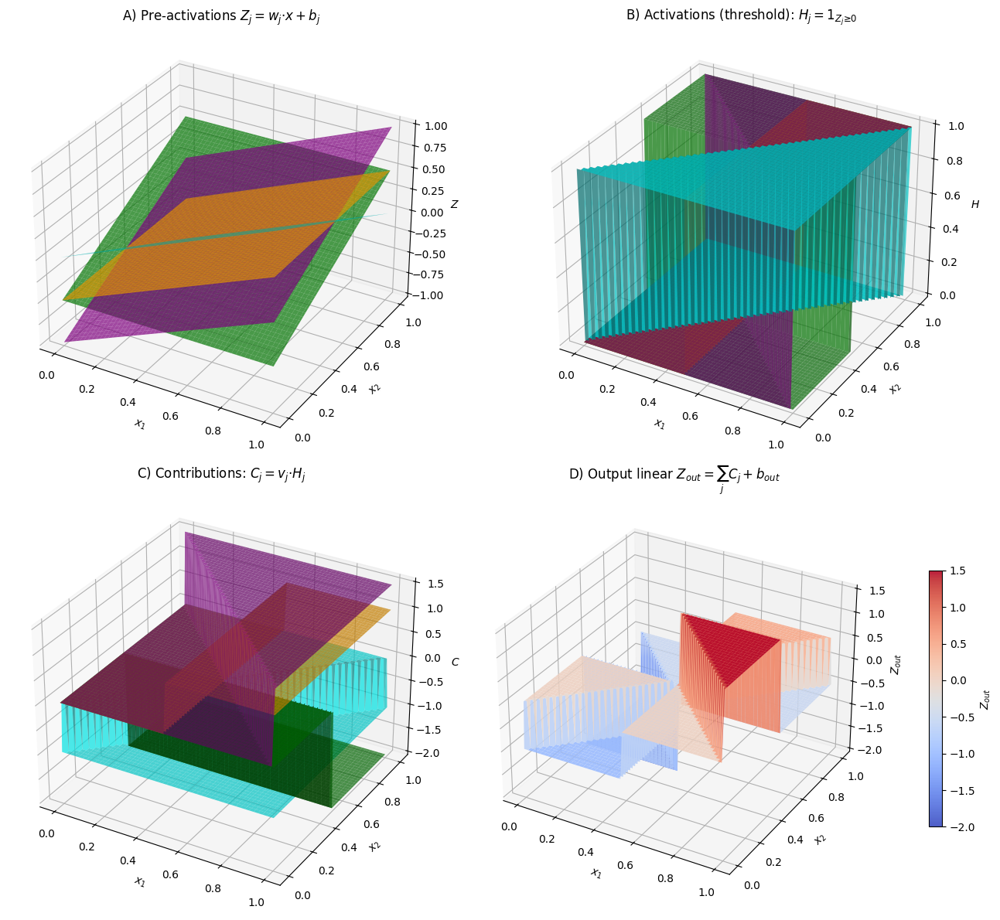

In [13]:
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# ───────── Dominio de entrada 2D ─────────
n = 100
x = np.linspace(0, 1, n)
X1, X2 = np.meshgrid(x, x)

# ───────── Parámetros de la red threshold con 4 unidades ocultas ─────────
# Definimos 4 planos de corte (umbral)
# Z_j = w_j · x + b_j
W = np.array([
    [1.0,  0.0],   # z1 = x1 - 0.5
    [0.0,  1.0],   # z2 = x2 - 0.5
    [1.0,  1.0],   # z3 = x1 + x2 - 1.0
    [1.0, -1.0]    # z4 = x1 - x2 - 0.0
])
b = np.array([-0.5, -0.5, -1.0, 0.0])

# Pesos de salida para cada unidad oculta (sin activación final)
v = np.array([1.0, -2.0, 1.5, -1.0])
b_out = 0.0

# ───────── 1) Pre‐activaciones Z_h[j] ─────────
Z = np.zeros((4, n, n))
for j in range(4):
    Z[j] = W[j,0]*X1 + W[j,1]*X2 + b[j]

# ───────── 2) Activations threshold H[j] ─────────
H = (Z >= 0).astype(float)

# ───────── 3) Contributions C[j] = v[j]*H[j] ─────────
C = H * v[:, None, None]

# ───────── 4) Salida lineal Z_out ─────────
Z_out = np.sum(C, axis=0) + b_out

# ───────── Graficar 4 paneles 3D ─────────
fig = plt.figure(figsize=(14, 12))

# Panel A: Pre‐activaciones Z_j
axA = fig.add_subplot(2, 2, 1, projection='3d')
colors = ['orange','green','purple','cyan']
for j, color in enumerate(colors):
    axA.plot_surface(X1, X2, Z[j], color=color, alpha=0.7, linewidth=0)
axA.set_title("A) Pre‐activations $Z_j = w_j·x + b_j$")
axA.set_xlabel("$x_1$"); axA.set_ylabel("$x_2$"); axA.set_zlabel("$Z$")
axA.view_init(elev=30, azim=-60)

# Panel B: Activaciones threshold H[j]
axB = fig.add_subplot(2, 2, 2, projection='3d')
for j, color in enumerate(colors):
    axB.plot_surface(X1, X2, H[j], color=color, alpha=0.7, linewidth=0)
axB.set_title("B) Activations (threshold): $H_j = 1_{Z_j≥0}$")
axB.set_xlabel("$x_1$"); axB.set_ylabel("$x_2$"); axB.set_zlabel("$H$")
axB.view_init(elev=30, azim=-60)

# Panel C: Contributions C[j]
axC = fig.add_subplot(2, 2, 3, projection='3d')
for j, color in enumerate(colors):
    axC.plot_surface(X1, X2, C[j], color=color, alpha=0.7, linewidth=0)
axC.set_title("C) Contributions: $C_j = v_j·H_j$")
axC.set_xlabel("$x_1$"); axC.set_ylabel("$x_2$"); axC.set_zlabel("$C$")
axC.view_init(elev=30, azim=-60)

# Panel D: Salida lineal Z_out
axD = fig.add_subplot(2, 2, 4, projection='3d')
surf = axD.plot_surface(X1, X2, Z_out, cmap='coolwarm', alpha=0.9, linewidth=0)
axD.set_title("D) Output linear $Z_{out}=\\sum_j C_j + b_{out}$")
axD.set_xlabel("$x_1$"); axD.set_ylabel("$x_2$"); axD.set_zlabel("$Z_{out}$")
axD.view_init(elev=30, azim=-60)
fig.colorbar(surf, ax=axD, pad=0.1, shrink=0.6, label='$Z_{out}$')

plt.tight_layout()
plt.show()


## Aproximador Universal (shallow network)

Podemos aproximar cualquier funcion con muchas hidden units en la hidden layer

SOLO CON 4 HIDDEN UNITS Y SIGMOID ACTIVATION (TAMBIEN EN OUTPUT NEURON)

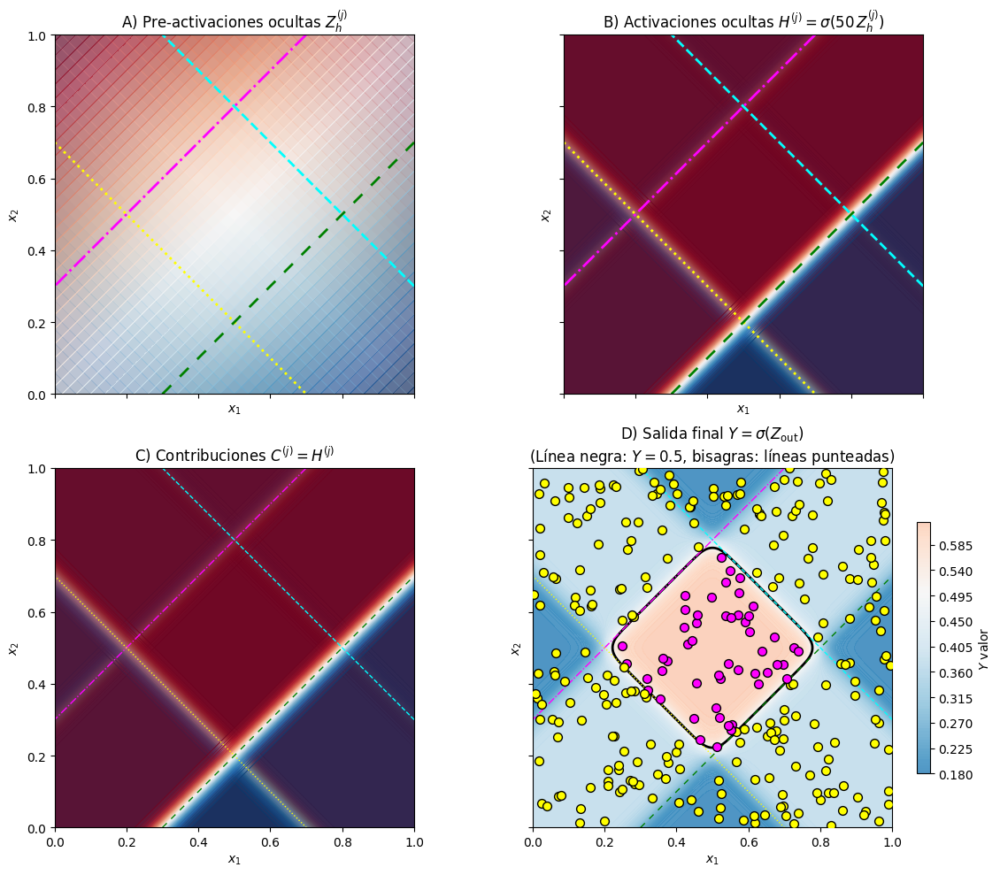

In [10]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.interpolate import RegularGridInterpolator

# ───────── Definir el dataset: puntos dentro vs fuera de un diamante ─────────
r = 0.3
def is_inside_diamond(x, y, center=(0.5, 0.5), r=0.3):
    return (abs(x - center[0]) + abs(y - center[1])) <= r

np.random.seed(0)
n_samples = 300
data_points = np.random.rand(n_samples, 2)
true_labels = np.array([is_inside_diamond(x, y) for x, y in data_points], dtype=int)

# ───────── Definir la red manualmente (4 sigmoides + sigmoide de salida) ─────────
W_h = np.array([
    [-1.0, -1.0],   # Z_h1 = 1.3 - x - y
    [ 1.0, -1.0],   # Z_h2 = 0.3 + x - y
    [ 1.0,  1.0],   # Z_h3 = -0.7 + x + y
    [-1.0,  1.0],   # Z_h4 = 0.3 - x + y
])
b_h = np.array([1.3, 0.3, -0.7, 0.3])
k_hidden = 50.0

W_out = np.ones(4)
b_out = -3.5
k_output = 1.0

# ───────── Crear la malla 2D para visualizar ─────────
n_grid = 200
x_vals = np.linspace(0, 1, n_grid)
X1, X2 = np.meshgrid(x_vals, x_vals)

# ───────── Cálculos de la red sobre la malla ─────────
Z_h = np.zeros((4, n_grid, n_grid))
for j in range(4):
    Z_h[j] = W_h[j,0] * X1 + W_h[j,1] * X2 + b_h[j]

H = 1.0 / (1.0 + np.exp(-k_hidden * Z_h))

C = np.zeros_like(H)
for j in range(4):
    C[j] = W_out[j] * H[j]

Z_out = np.sum(C, axis=0) + b_out
Y_out = 1.0 / (1.0 + np.exp(-k_output * Z_out))

interp_sig = RegularGridInterpolator((x_vals, x_vals), Y_out)
predicted_vals = interp_sig(data_points)
pred_labels = (predicted_vals > 0.5).astype(int)

# ───────── Dibujar los 4 paneles en 2D ─────────
fig, axes = plt.subplots(2, 2, figsize=(12, 10), sharex=True, sharey=True)
axes = axes.ravel()
cmap = 'RdBu_r'

line_colors = ['cyan', 'magenta', 'yellow', 'green']
line_styles = ['--', '-.', ':', (0, (5, 5))]

# Panel A: Pre-activaciones ocultas Z_h[j]
ax = axes[0]
for j in range(4):
    ax.contourf(
        X1, X2, Z_h[j],
        levels=50,
        cmap=cmap,
        alpha=0.6,
        vmin=Z_h.min(), vmax=Z_h.max()
    )
    ax.contour(
        X1, X2, Z_h[j],
        levels=[0],
        colors=[line_colors[j]],
        linestyles=[line_styles[j]],
        linewidths=2
    )
ax.set_title("A) Pre-activaciones ocultas $Z_h^{(j)}$")
ax.set_xlabel("$x_1$")
ax.set_ylabel("$x_2$")

# Panel B: Activaciones ocultas H[j]
ax = axes[1]
for j in range(4):
    ax.contourf(
        X1, X2, H[j],
        levels=50,
        cmap=cmap,
        alpha=0.6,
        vmin=0, vmax=1
    )
    ax.contour(
        X1, X2, Z_h[j],
        levels=[0],
        colors=[line_colors[j]],
        linestyles=[line_styles[j]],
        linewidths=2
    )
ax.set_title("B) Activaciones ocultas $H^{(j)} = σ(50\,Z_h^{(j)})$")
ax.set_xlabel("$x_1$")
ax.set_ylabel("$x_2$")

# Panel C: Contribuciones C[j] = H[j]
ax = axes[2]
for j in range(4):
    ax.contourf(
        X1, X2, H[j],
        levels=50,
        cmap=cmap,
        alpha=0.6,
        vmin=0, vmax=1
    )
    ax.contour(
        X1, X2, Z_h[j],
        levels=[0],
        colors=[line_colors[j]],
        linestyles=[line_styles[j]],
        linewidths=1
    )
ax.set_title("C) Contribuciones $C^{(j)} = H^{(j)}$")
ax.set_xlabel("$x_1$")
ax.set_ylabel("$x_2$")

# Panel D: Salida final Y_out con puntos de prueba
ax = axes[3]
cf = ax.contourf(
    X1, X2, Y_out,
    levels=100,
    cmap=cmap,
    alpha=0.9,
    vmin=0, vmax=1
)
ax.contour(
    X1, X2, Y_out,
    levels=[0.5],
    colors='k',
    linewidths=2
)
for j in range(4):
    ax.contour(
        X1, X2, Z_h[j],
        levels=[0],
        colors=[line_colors[j]],
        linestyles=[line_styles[j]],
        linewidths=1
    )

for i in range(n_samples):
    x_pt, y_pt = data_points[i]
    if true_labels[i] == 1:
        edge_color = 'red' if pred_labels[i] == 0 else 'k'
        ax.scatter(x_pt, y_pt, color='magenta', edgecolor=edge_color, s=50, zorder=5)
    else:
        edge_color = 'red' if pred_labels[i] == 1 else 'k'
        ax.scatter(x_pt, y_pt, color='yellow', edgecolor=edge_color, s=50, zorder=5)

ax.set_title(
    "D) Salida final $Y = σ(Z_{\mathrm{out}})$\n"
    "(Línea negra: $Y=0.5$, bisagras: líneas punteadas)"
)
ax.set_xlabel("$x_1$")
ax.set_ylabel("$x_2$")

for a in axes:
    a.set_aspect('equal')
    a.set_xlim(0,1)
    a.set_ylim(0,1)

cbar = fig.colorbar(cf, ax=axes[3], orientation='vertical', shrink=0.7)
cbar.set_label('$Y$ valor')

plt.tight_layout()
plt.show()


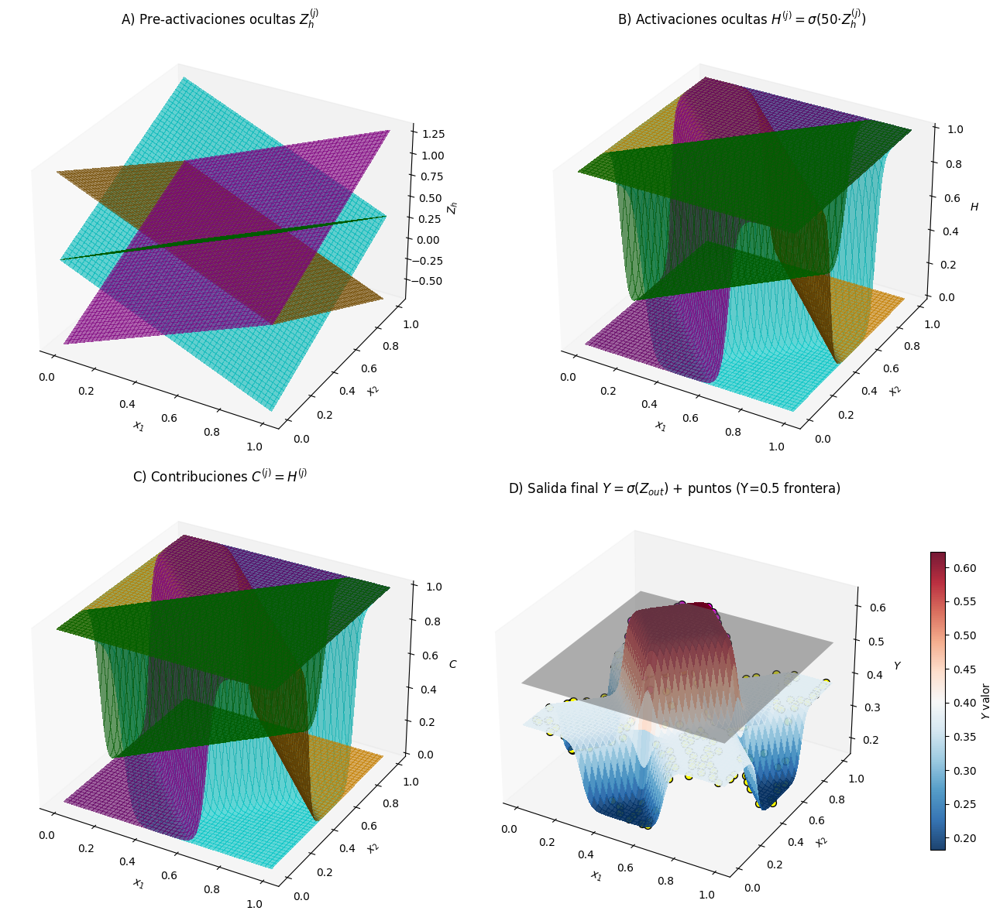

In [11]:
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from scipy.interpolate import RegularGridInterpolator

# ───────── Definir el dataset: puntos dentro vs fuera de un diamante ─────────
r = 0.3
def is_inside_diamond(x, y, center=(0.5, 0.5), r=0.3):
    return (abs(x - center[0]) + abs(y - center[1])) <= r

np.random.seed(0)
n_samples = 300
data_points = np.random.rand(n_samples, 2)
true_labels = np.array([is_inside_diamond(x, y) for x, y in data_points], dtype=int)

# ───────── Parámetros de la red (4 sigmoides ocultas + sigmoide salida) ─────────
W_h = np.array([
    [-1.0, -1.0],   # Z_h1 = 1.3 - x - y
    [ 1.0, -1.0],   # Z_h2 = 0.3 + x - y
    [ 1.0,  1.0],   # Z_h3 = -0.7 + x + y
    [-1.0,  1.0],   # Z_h4 = 0.3 - x + y
])
b_h = np.array([1.3, 0.3, -0.7, 0.3])
k_hidden = 50.0

W_out = np.ones(4)
b_out = -3.5
k_output = 1.0

# ───────── Crear malla 2D para visualizar ─────────
n_grid = 100
x_vals = np.linspace(0, 1, n_grid)
X1, X2 = np.meshgrid(x_vals, x_vals)

# ───────── Cálculos de la red sobre la malla ─────────
# 1) Pre-activaciones ocultas Z_h[j]
Z_h = np.zeros((4, n_grid, n_grid))
for j in range(4):
    Z_h[j] = W_h[j,0] * X1 + W_h[j,1] * X2 + b_h[j]

# 2) Activaciones ocultas H[j]
H = 1.0 / (1.0 + np.exp(-k_hidden * Z_h))

# 3) Contribuciones C[j] = W_out[j]*H[j]
C = np.zeros_like(H)
for j in range(4):
    C[j] = W_out[j] * H[j]

# 4) Pre-activación de salida Z_out = Σ_j C[j] + b_out
Z_out = np.sum(C, axis=0) + b_out

# 5) Salida final Y_out = σ(k_output * Z_out)
Y_out = 1.0 / (1.0 + np.exp(-k_output * Z_out))

# ───────── Interpolador para etiquetar puntos de prueba ─────────
interp_sig = RegularGridInterpolator((x_vals, x_vals), Y_out)
predicted_vals = interp_sig(data_points)
pred_labels = (predicted_vals > 0.5).astype(int)

# ───────── Crear figura con 4 paneles 3D ─────────
fig = plt.figure(figsize=(14, 12))

# Colormap para las superficies
cmap = 'RdBu_r'

# Panel A: Pre-activaciones ocultas Z_h[j]
axA = fig.add_subplot(2, 2, 1, projection='3d')
for j, color in zip(range(4), ['orange', 'green', 'purple', 'cyan']):
    axA.plot_surface(
        X1, X2, Z_h[j],
        color=color, alpha=0.6, linewidth=0, antialiased=False
    )
axA.set_title("A) Pre-activaciones ocultas $Z_h^{(j)}$")
axA.set_xlabel("$x_1$")
axA.set_ylabel("$x_2$")
axA.set_zlabel("$Z_h$")
axA.view_init(elev=30, azim=-60)
axA.grid(False)

# Panel B: Activaciones ocultas H[j]
axB = fig.add_subplot(2, 2, 2, projection='3d')
for j, color in zip(range(4), ['orange', 'green', 'purple', 'cyan']):
    axB.plot_surface(
        X1, X2, H[j],
        color=color, alpha=0.6, linewidth=0, antialiased=False
    )
axB.set_title("B) Activaciones ocultas $H^{(j)} = σ(50·Z_h^{(j)})$")
axB.set_xlabel("$x_1$")
axB.set_ylabel("$x_2$")
axB.set_zlabel("$H$")
axB.view_init(elev=30, azim=-60)
axB.grid(False)

# Panel C: Contribuciones de cada unidad oculta C[j]
axC = fig.add_subplot(2, 2, 3, projection='3d')
for j, color in zip(range(4), ['orange', 'green', 'purple', 'cyan']):
    axC.plot_surface(
        X1, X2, C[j],
        color=color, alpha=0.6, linewidth=0, antialiased=False
    )
axC.set_title("C) Contribuciones $C^{(j)} = H^{(j)}$")
axC.set_xlabel("$x_1$")
axC.set_ylabel("$x_2$")
axC.set_zlabel("$C$")
axC.view_init(elev=30, azim=-60)
axC.grid(False)

# Panel D: Salida final Y_out con puntos de prueba
axD = fig.add_subplot(2, 2, 4, projection='3d')
# Superficie de probabilidad Y_out
surfD = axD.plot_surface(
    X1, X2, Y_out,
    cmap=cmap, alpha=0.9, linewidth=0, antialiased=False
)
# Plano Y_out = 0.5 para frontera de decisión
xx = np.linspace(0, 1, 2)
yy = np.linspace(0, 1, 2)
PX, PY = np.meshgrid(xx, yy)
PZ = 0.5 * np.ones_like(PX)
axD.plot_surface(PX, PY, PZ, color='gray', alpha=0.5)

# Dibujar puntos de ejemplo en 3D a altura Y_out(data)
for (x_pt, y_pt), true_lbl, pred_lbl in zip(data_points, true_labels, pred_labels):
    z_pt = interp_sig((x_pt, y_pt))
    color = 'magenta' if true_lbl == 1 else 'yellow'
    edgecol = 'red' if (pred_lbl != true_lbl) else 'k'
    axD.scatter(x_pt, y_pt, z_pt, color=color, edgecolor=edgecol, s=50, depthshade=True)

axD.set_title("D) Salida final $Y = σ(Z_{out})$ + puntos (Y=0.5 frontera)")
axD.set_xlabel("$x_1$")
axD.set_ylabel("$x_2$")
axD.set_zlabel("$Y$")
axD.view_init(elev=30, azim=-60)
axD.grid(False)

# Barra de color para panel D
fig.colorbar(surfD, ax=axD, pad=0.1, shrink=0.7, label='$Y$ valor')

plt.tight_layout()
plt.show()


CON 8 HIDDEN UNITS

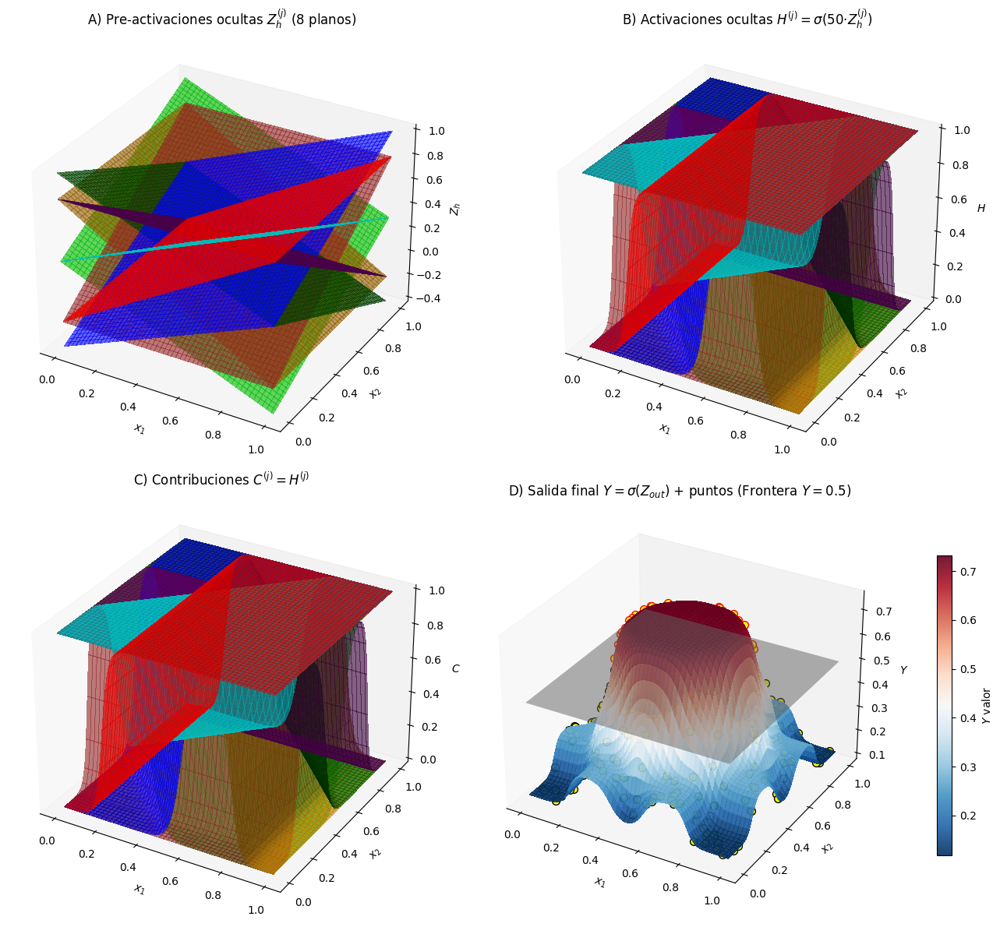

In [12]:
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from scipy.interpolate import RegularGridInterpolator

# ───────── Definir el dataset: puntos dentro vs fuera de un círculo aproximado por un octágono ─────────
r = 0.3
def is_inside_octagon(x, y, center=(0.5, 0.5), r=0.3):
    return (abs(x - center[0]) + abs(y - center[1]) / np.tan(np.pi/8) <= r) and \
           (abs(y - center[1]) + abs(x - center[0]) / np.tan(np.pi/8) <= r)

np.random.seed(0)
n_samples = 300
data_points = np.random.rand(n_samples, 2)
true_labels = np.array([is_inside_octagon(x, y) for x, y in data_points], dtype=int)

# ───────── Parámetros de la red (8 sigmoides ocultas + sigmoide de salida) ─────────
# Normales para 8 planos (ángulos cada 45°)
angles = np.deg2rad(np.arange(0, 360, 45))
normals = [(np.cos(a), np.sin(a)) for a in angles]
center = (0.5, 0.5)
biases = [nx*center[0] + ny*center[1] + r for (nx, ny) in normals]

W_h = np.zeros((8, 2))
b_h = np.zeros(8)
for j, (nx, ny) in enumerate(normals):
    W_h[j] = np.array([-nx, -ny])
    b_h[j] = biases[j]

k_hidden = 50.0
W_out = np.ones(8)
b_out = -7.0   # Umbral: cuando las 8 H_j ≈ 1, ΣH ≈8 → Z_out ≈ 1 (dentro). Fuera, falta al menos 1 → Z_out ≤ 0
k_output = 1.0

# ───────── Crear malla 2D para visualizar ─────────
n_grid = 100
x_vals = np.linspace(0, 1, n_grid)
X1, X2 = np.meshgrid(x_vals, x_vals)

# ───────── Cálculos de la red sobre la malla ─────────
# 1) Pre-activaciones ocultas Z_h[j]
Z_h = np.zeros((8, n_grid, n_grid))
for j in range(8):
    Z_h[j] = W_h[j,0]*X1 + W_h[j,1]*X2 + b_h[j]

# 2) Activaciones ocultas H[j] = σ(50 * Z_h[j])
H = 1.0 / (1.0 + np.exp(-k_hidden * Z_h))

# 3) Contribuciones C[j] = W_out[j] * H[j]
C = np.zeros_like(H)
for j in range(8):
    C[j] = W_out[j] * H[j]

# 4) Pre-activación de salida Z_out = Σ_j C[j] + b_out
Z_out = np.sum(C, axis=0) + b_out

# 5) Salida final Y_out = σ(1 * Z_out)
Y_out = 1.0 / (1.0 + np.exp(-k_output * Z_out))

# ───────── Interpolador para etiquetar puntos de prueba ─────────
interp_sig = RegularGridInterpolator((x_vals, x_vals), Y_out)
predicted_vals = interp_sig(data_points)
pred_labels = (predicted_vals > 0.5).astype(int)

# ───────── Crear figura con 4 paneles en 3D ─────────
fig = plt.figure(figsize=(14, 12))
cmap = 'RdBu_r'
colors = ['orange','green','purple','cyan','red','blue','brown','lime']

# Panel A: Pre-activaciones ocultas Z_h[j]
axA = fig.add_subplot(2, 2, 1, projection='3d')
for j, color in enumerate(colors):
    axA.plot_surface(
        X1, X2, Z_h[j],
        color=color, alpha=0.6, linewidth=0, antialiased=False
    )
axA.set_title("A) Pre-activaciones ocultas $Z_h^{(j)}$ (8 planos)")
axA.set_xlabel("$x_1$")
axA.set_ylabel("$x_2$")
axA.set_zlabel("$Z_h$")
axA.view_init(elev=30, azim=-60)
axA.grid(False)

# Panel B: Activaciones ocultas H[j]
axB = fig.add_subplot(2, 2, 2, projection='3d')
for j, color in enumerate(colors):
    axB.plot_surface(
        X1, X2, H[j],
        color=color, alpha=0.6, linewidth=0, antialiased=False
    )
axB.set_title("B) Activaciones ocultas $H^{(j)} = σ(50·Z_h^{(j)})$")
axB.set_xlabel("$x_1$")
axB.set_ylabel("$x_2$")
axB.set_zlabel("$H$")
axB.view_init(elev=30, azim=-60)
axB.grid(False)

# Panel C: Contribuciones de cada unidad oculta C[j]
axC = fig.add_subplot(2, 2, 3, projection='3d')
for j, color in enumerate(colors):
    axC.plot_surface(
        X1, X2, C[j],
        color=color, alpha=0.6, linewidth=0, antialiased=False
    )
axC.set_title("C) Contribuciones $C^{(j)} = H^{(j)}$")
axC.set_xlabel("$x_1$")
axC.set_ylabel("$x_2$")
axC.set_zlabel("$C$")
axC.view_init(elev=30, azim=-60)
axC.grid(False)

# Panel D: Salida final Y_out con puntos de prueba
axD = fig.add_subplot(2, 2, 4, projection='3d')
surfD = axD.plot_surface(
    X1, X2, Y_out,
    cmap=cmap, alpha=0.9, linewidth=0, antialiased=False
)
# Plano Y_out = 0.5 para frontera de decisión
xx = np.linspace(0, 1, 2)
yy = np.linspace(0, 1, 2)
PX, PY = np.meshgrid(xx, yy)
PZ = 0.5 * np.ones_like(PX)
axD.plot_surface(PX, PY, PZ, color='gray', alpha=0.5)

# Dibujar puntos de ejemplo en 3D a altura Y_out(data)
for (x_pt, y_pt), true_lbl, pred_lbl in zip(data_points, true_labels, pred_labels):
    z_pt = interp_sig((x_pt, y_pt))
    color = 'magenta' if true_lbl == 1 else 'yellow'
    edgecol = 'red' if (pred_lbl != true_lbl) else 'k'
    axD.scatter(x_pt, y_pt, z_pt, color=color, edgecolor=edgecol, s=50, depthshade=True)

axD.set_title("D) Salida final $Y = σ(Z_{out})$ + puntos (Frontera $Y=0.5$)")
axD.set_xlabel("$x_1$")
axD.set_ylabel("$x_2$")
axD.set_zlabel("$Y$")
axD.view_init(elev=30, azim=-60)
axD.grid(False)

# Barra de color para panel D
fig.colorbar(surfD, ax=axD, pad=0.1, shrink=0.7, label='$Y$ valor')

plt.tight_layout()
plt.show()


MULTIPLES INPUTS Y OUTPUTS

![Arquitectura de red neuronal somera](images/shallow_network_architecture.png)

SI SALEN ASI, LOS DOS OUTPUTS SON COMO DOS FUNCIONES SEPARADAS.

SIN EMBARGO, SE SUELE USAR **SOFTMAX** PARA COMBINARLOS Y QUE TE DE UNA DISTRIBUCION DE PROBABILIDAD (CLASIFICACION)

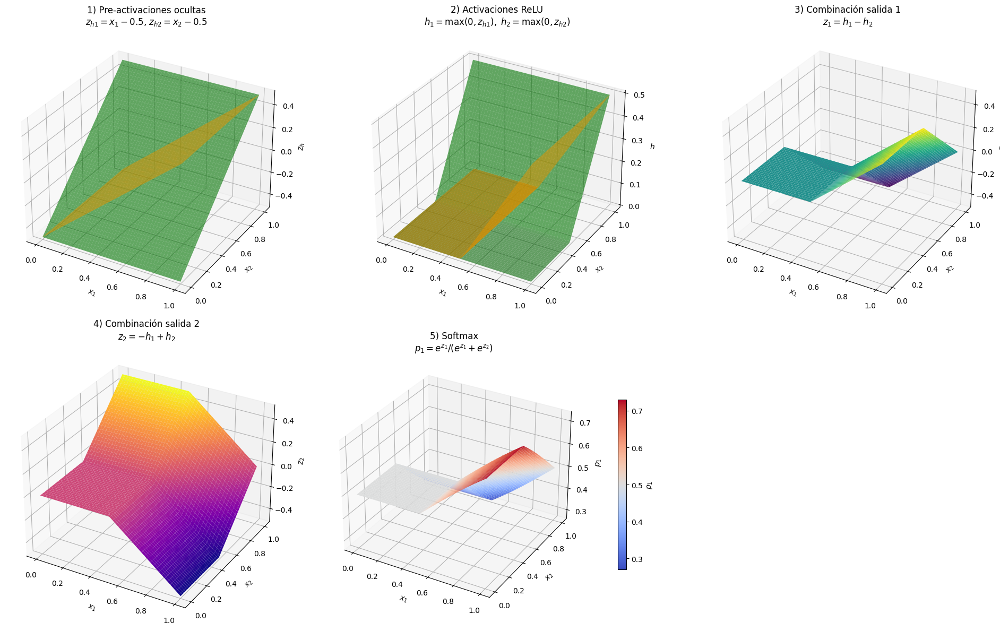

In [2]:
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# ───────── Dominio de entrada ─────────
n = 100
x = np.linspace(0, 1, n)
X1, X2 = np.meshgrid(x, x)

# ───────── 1) Pre‐activaciones ocultas Z_h1, Z_h2 ─────────
Z_h1 = X1 - 0.5
Z_h2 = X2 - 0.5

# ───────── 2) Activaciones ReLU H1, H2 ─────────
H1 = np.maximum(0, Z_h1)
H2 = np.maximum(0, Z_h2)

# ───────── 3) Pre‐activaciones de salida z_out1, z_out2 ─────────
z_out1 = H1 - H2
z_out2 = -H1 + H2

# ───────── 4) Softmax p1 ─────────
exp1 = np.exp(z_out1)
exp2 = np.exp(z_out2)
den = exp1 + exp2
p1 = exp1 / den  # softmax class 1

# ───────── Visualización 3D en 5 paneles ─────────
fig = plt.figure(figsize=(20, 12))

# Panel 1: Pre‐activaciones ocultas
ax1 = fig.add_subplot(2, 3, 1, projection='3d')
ax1.plot_surface(X1, X2, Z_h1, color='orange', alpha=0.6, linewidth=0)
ax1.plot_surface(X1, X2, Z_h2, color='green', alpha=0.6, linewidth=0)
ax1.set_title("1) Pre‐activaciones ocultas\n$z_{h1}=x_1-0.5$, $z_{h2}=x_2-0.5$")
ax1.set_xlabel("$x_1$"); ax1.set_ylabel("$x_2$"); ax1.set_zlabel("$z_h$")
ax1.view_init(elev=30, azim=-60)

# Panel 2: Activaciones ReLU
ax2 = fig.add_subplot(2, 3, 2, projection='3d')
ax2.plot_surface(X1, X2, H1, color='orange', alpha=0.6, linewidth=0)
ax2.plot_surface(X1, X2, H2, color='green', alpha=0.6, linewidth=0)
ax2.set_title("2) Activaciones ReLU\n$h_1=\\max(0,z_{h1}),\\;h_2=\\max(0,z_{h2})$")
ax2.set_xlabel("$x_1$"); ax2.set_ylabel("$x_2$"); ax2.set_zlabel("$h$")
ax2.view_init(elev=30, azim=-60)

# Panel 3: z_out1
ax3 = fig.add_subplot(2, 3, 3, projection='3d')
ax3.plot_surface(X1, X2, z_out1, cmap='viridis', edgecolor='none')
ax3.set_title("3) Combinación salida 1\n$z_{1}=h_1 - h_2$")
ax3.set_xlabel("$x_1$"); ax3.set_ylabel("$x_2$"); ax3.set_zlabel("$z_1$")
ax3.view_init(elev=30, azim=-60)

# Panel 4: z_out2
ax4 = fig.add_subplot(2, 3, 4, projection='3d')
ax4.plot_surface(X1, X2, z_out2, cmap='plasma', edgecolor='none')
ax4.set_title("4) Combinación salida 2\n$z_{2}=-h_1 + h_2$")
ax4.set_xlabel("$x_1$"); ax4.set_ylabel("$x_2$"); ax4.set_zlabel("$z_2$")
ax4.view_init(elev=30, azim=-60)

# Panel 5: Softmax p1
ax5 = fig.add_subplot(2, 3, 5, projection='3d')
surf = ax5.plot_surface(X1, X2, p1, cmap='coolwarm', edgecolor='none')
ax5.set_title("5) Softmax\n$p_1 = e^{z_1}/(e^{z_1}+e^{z_2})$")
ax5.set_xlabel("$x_1$"); ax5.set_ylabel("$x_2$"); ax5.set_zlabel("$p_1$")
ax5.view_init(elev=30, azim=-60)
fig.colorbar(surf, ax=ax5, pad=0.1, shrink=0.6, label='$p_1$')

# Ocultar el sexto panel
fig.delaxes(fig.add_subplot(2,3,6))

plt.tight_layout()
plt.show()


## Implementacion

In [1]:
import numpy as np
import matplotlib.pyplot as plt

# Define the Rectified Linear Unit (ReLU) function
def ReLU(preactivation):
  """ 
  if preactivation > 0:
    return preactivation
  else:
    return 0
  """
  activation = np.clip(preactivation, 0, None)
  return activation

In [2]:
"""
INPUTS: 1, OUTPUTS: 1, HIDDEN UNITS: 3
"""

# Define a shallow neural network with, one input, one output, and three hidden units
def shallow_1_1_3(x, activation_fn, phi_0,phi_1,phi_2,phi_3, theta_10, theta_11, theta_20, theta_21, theta_30, theta_31):

  # pre-activations
  pre_1 = theta_10 + theta_11 * x
  pre_2 = theta_20 + theta_21 * x
  pre_3 = theta_30 + theta_31 * x

  # activations (ReLU)
  act_1 = activation_fn(pre_1)
  act_2 = activation_fn(pre_2)
  act_3 = activation_fn(pre_3)

  # Weight the activations using phi1, phi2 and phi3
  w_act_1 = phi_1 * act_1
  w_act_2 = phi_2 * act_2
  w_act_3 = phi_3 * act_3

  # combining the weighted activations and add phi_0 to create the output
  y = w_act_1 + w_act_2 + w_act_3 + phi_0

  return y, pre_1, pre_2, pre_3, act_1, act_2, act_3, w_act_1, w_act_2, w_act_3

In [6]:
# Now lets define some parameters and run the neural network
theta_10 =  0.3 ; theta_11 = -1.0
theta_20 = -1.0  ; theta_21 = 2.0
theta_30 = -0.5  ; theta_31 = 0.65
phi_0 = -0.3; phi_1 = 2.0; phi_2 = -1.0; phi_3 = 7.0

# Define a range of input values
x = np.arange(0,1,0.01)

# We run the neural network for each of these input values
y, pre_1, pre_2, pre_3, act_1, act_2, act_3, w_act_1, w_act_2, w_act_3 = \
    shallow_1_1_3(x, ReLU, phi_0,phi_1,phi_2,phi_3, theta_10, theta_11, theta_20, theta_21, theta_30, theta_31)
print(f'Pre-activations: \n{pre_1}\n{pre_2}\n{pre_3}')
print(f'Activations: \n{act_1}\n{act_2}\n{act_3}')
print(f'Output: \n{y}')

Pre-activations: 
[ 0.3   0.29  0.28  0.27  0.26  0.25  0.24  0.23  0.22  0.21  0.2   0.19
  0.18  0.17  0.16  0.15  0.14  0.13  0.12  0.11  0.1   0.09  0.08  0.07
  0.06  0.05  0.04  0.03  0.02  0.01  0.   -0.01 -0.02 -0.03 -0.04 -0.05
 -0.06 -0.07 -0.08 -0.09 -0.1  -0.11 -0.12 -0.13 -0.14 -0.15 -0.16 -0.17
 -0.18 -0.19 -0.2  -0.21 -0.22 -0.23 -0.24 -0.25 -0.26 -0.27 -0.28 -0.29
 -0.3  -0.31 -0.32 -0.33 -0.34 -0.35 -0.36 -0.37 -0.38 -0.39 -0.4  -0.41
 -0.42 -0.43 -0.44 -0.45 -0.46 -0.47 -0.48 -0.49 -0.5  -0.51 -0.52 -0.53
 -0.54 -0.55 -0.56 -0.57 -0.58 -0.59 -0.6  -0.61 -0.62 -0.63 -0.64 -0.65
 -0.66 -0.67 -0.68 -0.69]
[-1.   -0.98 -0.96 -0.94 -0.92 -0.9  -0.88 -0.86 -0.84 -0.82 -0.8  -0.78
 -0.76 -0.74 -0.72 -0.7  -0.68 -0.66 -0.64 -0.62 -0.6  -0.58 -0.56 -0.54
 -0.52 -0.5  -0.48 -0.46 -0.44 -0.42 -0.4  -0.38 -0.36 -0.34 -0.32 -0.3
 -0.28 -0.26 -0.24 -0.22 -0.2  -0.18 -0.16 -0.14 -0.12 -0.1  -0.08 -0.06
 -0.04 -0.02  0.    0.02  0.04  0.06  0.08  0.1   0.12  0.14  0.16  0.18
  0.2   

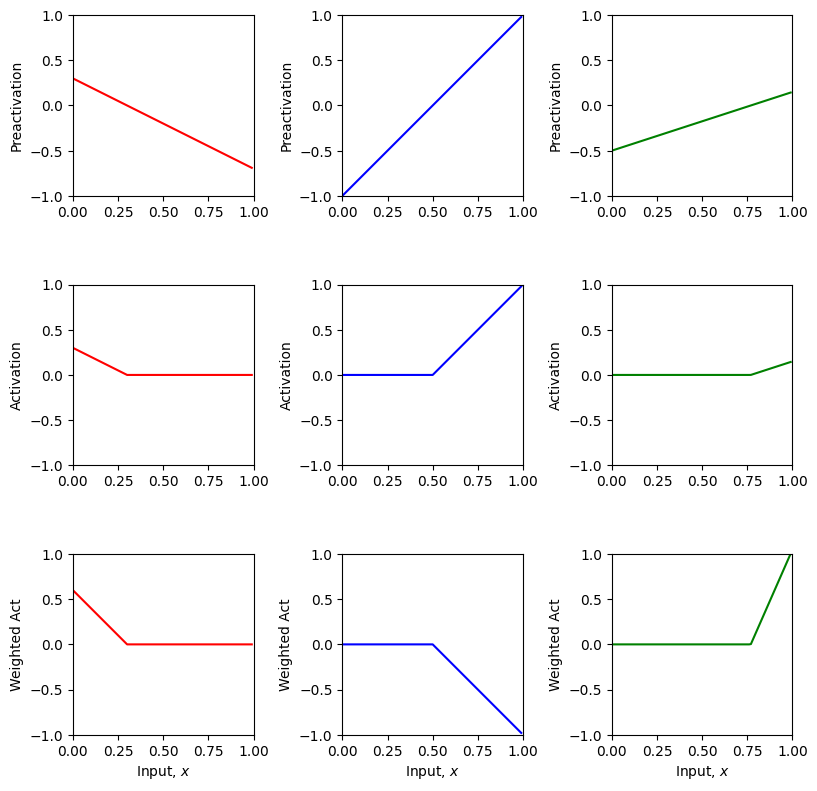

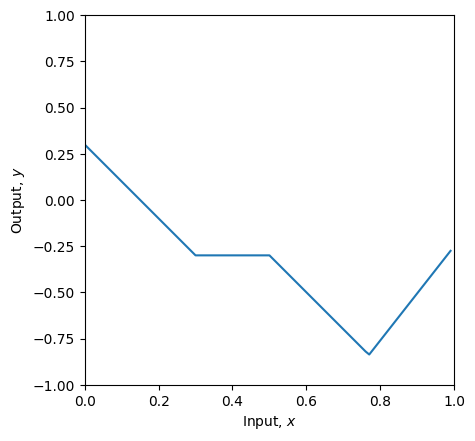

In [8]:
# Plot the shallow neural network.  We'll assume input in is range [0,1] and output [-1,1]
# If the plot_all flag is set to true, then we'll plot all the intermediate stages as in Figure 3.3
def plot_neural(x, y, pre_1, pre_2, pre_3, act_1, act_2, act_3, w_act_1, w_act_2, w_act_3, plot_all=False, x_data=None, y_data=None):

  # Plot intermediate plots if flag set
  if plot_all:
    fig, ax = plt.subplots(3,3)
    fig.set_size_inches(8.5, 8.5)
    fig.tight_layout(pad=3.0)
    ax[0,0].plot(x,pre_1,'r-'); ax[0,0].set_ylabel('Preactivation')
    ax[0,1].plot(x,pre_2,'b-'); ax[0,1].set_ylabel('Preactivation')
    ax[0,2].plot(x,pre_3,'g-'); ax[0,2].set_ylabel('Preactivation')
    ax[1,0].plot(x,act_1,'r-'); ax[1,0].set_ylabel('Activation')
    ax[1,1].plot(x,act_2,'b-'); ax[1,1].set_ylabel('Activation')
    ax[1,2].plot(x,act_3,'g-'); ax[1,2].set_ylabel('Activation')
    ax[2,0].plot(x,w_act_1,'r-'); ax[2,0].set_ylabel('Weighted Act')
    ax[2,1].plot(x,w_act_2,'b-'); ax[2,1].set_ylabel('Weighted Act')
    ax[2,2].plot(x,w_act_3,'g-'); ax[2,2].set_ylabel('Weighted Act')

    for plot_y in range(3):
      for plot_x in range(3):
        ax[plot_y,plot_x].set_xlim([0,1]);ax[plot_x,plot_y].set_ylim([-1,1])
        ax[plot_y,plot_x].set_aspect(0.5)
      ax[2,plot_y].set_xlabel('Input, $x$');
    plt.show()

  fig, ax = plt.subplots()
  # Ensure y is the same shape as x before plotting
  y = np.array(y).flatten()  # Convert to 1D array
  ax.plot(x,y)
  ax.set_xlabel('Input, $x$'); ax.set_ylabel('Output, $y$')
  ax.set_xlim([0,1]);ax.set_ylim([-1,1])
  ax.set_aspect(0.5)
  if x_data is not None:
    ax.plot(x_data, y_data, 'mo')
    for i in range(len(x_data)):
      ax.plot(x_data[i], y_data[i],)
  plt.show()


plot_neural(x, y, pre_1, pre_2, pre_3, act_1, act_2, act_3, w_act_1, w_act_2, w_act_3, plot_all=True)

LEAST SQUARES LOSS

\begin{equation}
L[\boldsymbol\phi] = \sum_{i=1}^{I}(y_{i}-\text{f}[x_{i},\boldsymbol\phi])^2
\end{equation}

In [9]:
# Least squares function
def least_squares_loss(y_train, y_predict):
  loss = np.sum((y_train - y_predict)**2)
  return loss

Jugar con los parametros del modelo para tratar de minimizar el error (con datos de juguete)

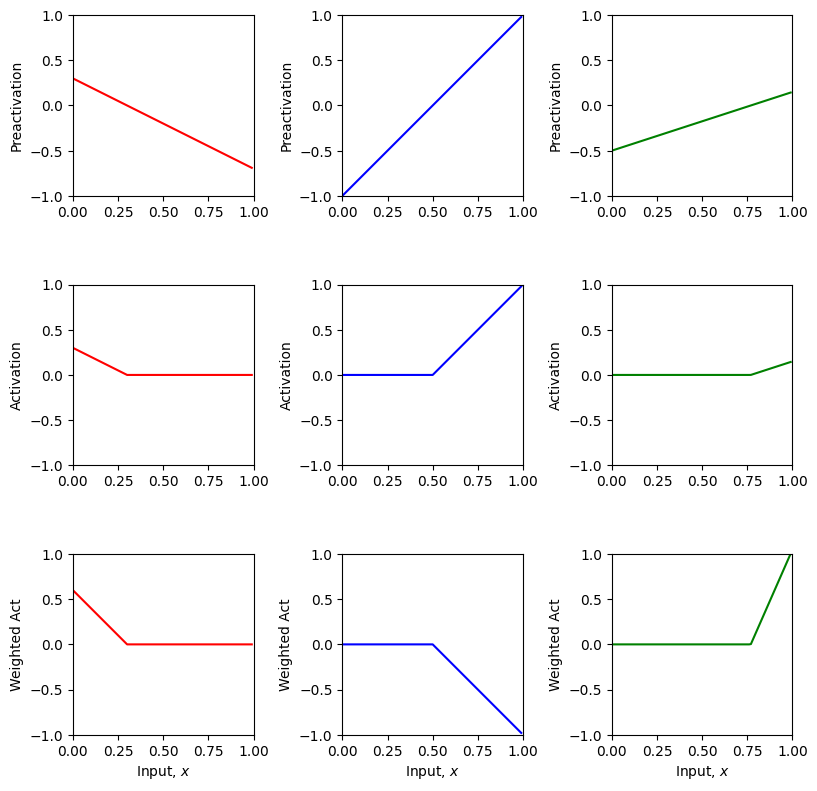

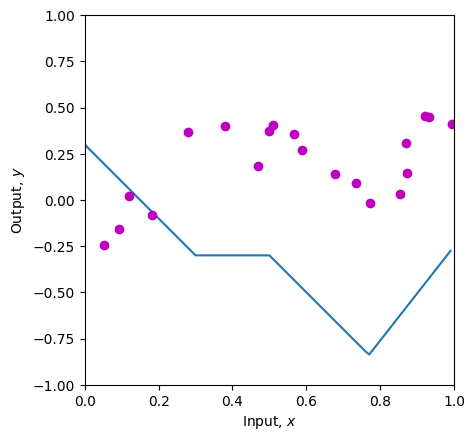

Your Loss = 9.385, Original loss (baseline) = 9.385


In [10]:
# Now lets define some parameters, run the neural network, and compute the loss
theta_10 =  0.3 ; theta_11 = -1.0
theta_20 = -1.0  ; theta_21 = 2.0
theta_30 = -0.5  ; theta_31 = 0.65
phi_0 = -0.3; phi_1 = 2.0; phi_2 = -1.0; phi_3 = 7.0

# Define a range of input values
x = np.arange(0,1,0.01)

x_train = np.array([0.09291784,0.46809093,0.93089486,0.67612654,0.73441752,0.86847339,\
                   0.49873225,0.51083168,0.18343972,0.99380898,0.27840809,0.38028817,\
                   0.12055708,0.56715537,0.92005746,0.77072270,0.85278176,0.05315950,\
                   0.87168699,0.58858043])
y_train = np.array([-0.15934537,0.18195445,0.451270150,0.13921448,0.09366691,0.30567674,\
                    0.372291170,0.40716968,-0.08131792,0.41187806,0.36943738,0.3994327,\
                    0.019062570,0.35820410,0.452564960,-0.0183121,0.02957665,-0.24354444, \
                    0.148038840,0.26824970])

# We run the neural network for each of these input values
y, pre_1, pre_2, pre_3, act_1, act_2, act_3, w_act_1, w_act_2, w_act_3 = \
    shallow_1_1_3(x, ReLU, phi_0,phi_1,phi_2,phi_3, theta_10, theta_11, theta_20, theta_21, theta_30, theta_31)
# And then plot it
plot_neural(x, y, pre_1, pre_2, pre_3, act_1, act_2, act_3, w_act_1, w_act_2, w_act_3, plot_all=True, x_data = x_train, y_data = y_train)

# Run the neural network on the training data
y_predict, *_ = shallow_1_1_3(x_train, ReLU, phi_0,phi_1,phi_2,phi_3, theta_10, theta_11, theta_20, theta_21, theta_30, theta_31)

# Compute the least squares loss and print it out
loss = least_squares_loss(y_train,y_predict)
print('Your Loss = %3.3f, Original loss (baseline) = 9.385'%(loss))


In [11]:
"""
INPUTS: 2, OUTPUTS: 1, HIDDEN UNITS: 3
"""

# Define a shallow neural network with, two input, one output, and three hidden units
def shallow_2_1_3(x1,x2, activation_fn, phi_0,phi_1,phi_2,phi_3, theta_10, theta_11,\
                  theta_12, theta_20, theta_21, theta_22, theta_30, theta_31, theta_32):
  
  # pre-activations
  pre_1 = theta_10 + theta_11 * x1 + theta_12 * x2
  pre_2 = theta_20 + theta_21 * x1 + theta_22 * x2
  pre_3 = theta_30 + theta_31 * x1 + theta_32 * x2

  # activations (ReLU)
  act_1 = activation_fn(pre_1)
  act_2 = activation_fn(pre_2)
  act_3 = activation_fn(pre_3)

  # Weight the activations using phi1, phi2 and phi3
  w_act_1 = phi_1 * act_1
  w_act_2 = phi_2 * act_2
  w_act_3 = phi_3 * act_3

  # combining the weighted activations and add phi_0 to create the output
  y = w_act_1 + w_act_2 + w_act_3 + phi_0

  return y, pre_1, pre_2, pre_3, act_1, act_2, act_3, w_act_1, w_act_2, w_act_3

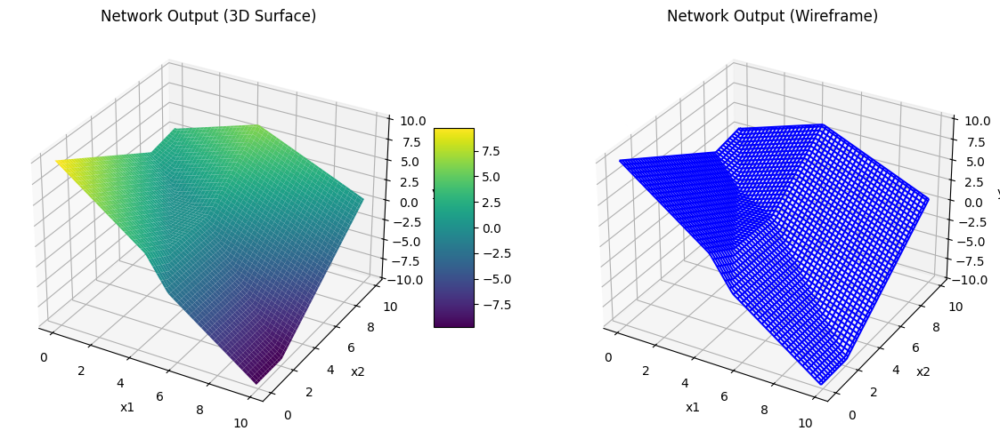

In [12]:
# Now lets define some parameters and run the neural network
theta_10 =  -4.0 ;  theta_11 = 0.9; theta_12 = 0.0
theta_20 =  5.0  ; theta_21 = -0.9 ; theta_22 = -0.5
theta_30 =  -7  ; theta_31 = 0.5; theta_32 = 0.9
phi_0 = 0.0; phi_1 = -2.0; phi_2 = 2.0; phi_3 = 1.5

x1 = np.arange(0.0, 10.0, 0.1)
x2 = np.arange(0.0, 10.0, 0.1)
x1,x2 = np.meshgrid(x1,x2)  # https://www.geeksforgeeks.org/numpy-meshgrid-function/

# We run the neural network for each of these input values
y, pre_1, pre_2, pre_3, act_1, act_2, act_3, w_act_1, w_act_2, w_act_3 = \
    shallow_2_1_3(x1,x2, ReLU, phi_0,phi_1,phi_2,phi_3, theta_10, theta_11, theta_12, theta_20, theta_21, theta_22, theta_30, theta_31, theta_32)


# Create a 3D visualization of the network output
fig = plt.figure(figsize=(12, 5))

# First subplot - 3D surface plot
ax1 = fig.add_subplot(121, projection='3d')
surf = ax1.plot_surface(x1, x2, y, cmap='viridis')
ax1.set_xlabel('x1')
ax1.set_ylabel('x2')
ax1.set_zlabel('y')
ax1.set_title('Network Output (3D Surface)')
fig.colorbar(surf, ax=ax1, shrink=0.5, aspect=5)

# Second subplot - 3D wireframe plot
ax2 = fig.add_subplot(122, projection='3d')
wire = ax2.plot_wireframe(x1, x2, y, color='blue')
ax2.set_xlabel('x1')
ax2.set_ylabel('x2')
ax2.set_zlabel('y')
ax2.set_title('Network Output (Wireframe)')

plt.tight_layout()
plt.show()


In [13]:
"""
INPUTS: 2, OUTPUTS: 2, HIDDEN UNITS: 3
"""

# Define a shallow neural network with, two inputs, two outputs, and three hidden units
def shallow_2_2_3(x1,x2, activation_fn, phi_10,phi_11,phi_12,phi_13, phi_20,phi_21,phi_22,phi_23, theta_10, theta_11,\
                  theta_12, theta_20, theta_21, theta_22, theta_30, theta_31, theta_32):
  
  # pre-activations
  pre_1 = theta_10 + theta_11 * x1 + theta_12 * x2
  pre_2 = theta_20 + theta_21 * x1 + theta_22 * x2
  pre_3 = theta_30 + theta_31 * x1 + theta_32 * x2

  # activations (ReLU)
  act_1 = activation_fn(pre_1)
  act_2 = activation_fn(pre_2)
  act_3 = activation_fn(pre_3)

  # Weight the activations using phi1, phi2 and phi3
  w_act_11 = phi_11 * act_1 + phi_12 * act_2 + phi_13 * act_3
  w_act_12 = phi_11 * act_1 + phi_12 * act_2 + phi_13 * act_3
  w_act_13 = phi_11 * act_1 + phi_12 * act_2 + phi_13 * act_3
  w_act_21 = phi_21 * act_1 + phi_22 * act_2 + phi_23 * act_3
  w_act_22 = phi_21 * act_1 + phi_22 * act_2 + phi_23 * act_3
  w_act_23 = phi_21 * act_1 + phi_22 * act_2 + phi_23 * act_3

  # combining the weighted activations and add phi_0 to create the output
  y1 = phi_10 + w_act_11 + w_act_12 + w_act_13
  y2 = phi_20 + w_act_21 + w_act_22 + w_act_23

  return y1,y2, pre_1, pre_2, pre_3, act_1, act_2, act_3, w_act_11, w_act_12, w_act_13, w_act_21, w_act_22, w_act_23


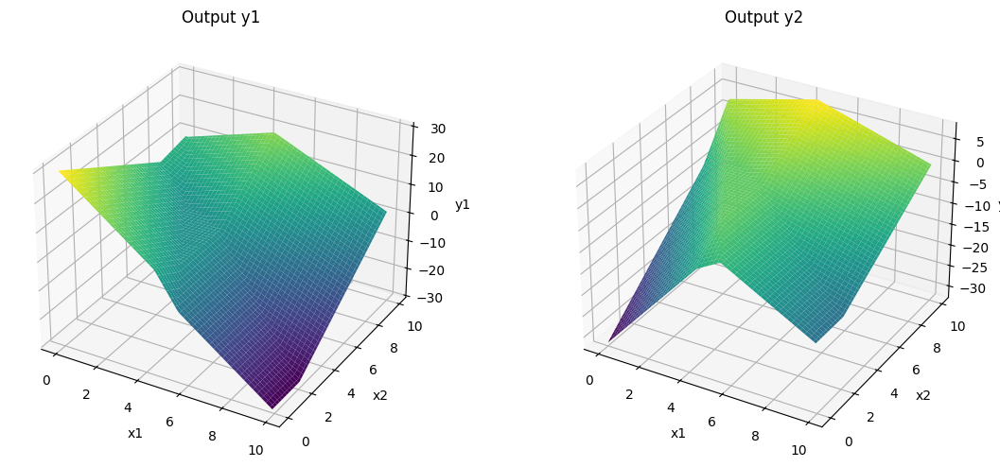

In [14]:
# Now lets define some parameters and run the neural network
theta_10 =  -4.0 ;  theta_11 = 0.9; theta_12 = 0.0
theta_20 =  5.0  ; theta_21 = -0.9 ; theta_22 = -0.5
theta_30 =  -7  ; theta_31 = 0.5; theta_32 = 0.9
phi_10 = 0.0; phi_11 = -2.0; phi_12 = 2.0; phi_13 = 1.5
phi_20 = -2.0; phi_21 = -1.0; phi_22 = -2.0; phi_23 = 0.8

x1 = np.arange(0.0, 10.0, 0.1)
x2 = np.arange(0.0, 10.0, 0.1)
x1,x2 = np.meshgrid(x1,x2)  # https://www.geeksforgeeks.org/numpy-meshgrid-function/

# We run the neural network for each of these input values
y1, y2, pre_1, pre_2, pre_3, act_1, act_2, act_3, w_act_11, w_act_12, w_act_13, w_act_21, w_act_22, w_act_23 = \
    shallow_2_2_3(x1,x2, ReLU, phi_10,phi_11,phi_12,phi_13, phi_20,phi_21,phi_22,phi_23, theta_10, theta_11, theta_12, theta_20, theta_21, theta_22, theta_30, theta_31, theta_32)

# Create a 3D visualization of the network outputs
fig = plt.figure(figsize=(12, 5))

# Plot y1 in 3D
ax1 = fig.add_subplot(121, projection='3d')
surf1 = ax1.plot_surface(x1, x2, y1, cmap='viridis')
ax1.set_xlabel('x1')
ax1.set_ylabel('x2')
ax1.set_zlabel('y1')
ax1.set_title('Output y1')

# Plot y2 in 3D
ax2 = fig.add_subplot(122, projection='3d')
surf2 = ax2.plot_surface(x1, x2, y2, cmap='viridis')
ax2.set_xlabel('x1')
ax2.set_ylabel('x2')
ax2.set_zlabel('y2')
ax2.set_title('Output y2')

plt.tight_layout()
plt.show()


# Deep neural network

La clave siempre es crear muchas linear regions para poder aproximar funciones mas complejas. Con una sola capa a veces hay que crear MUCHAS neuronas.

Con DEEP NETWORKS, o sea, composiciones de muchas capas, **se pueden crear muchas mas regiones con menos parametros**.

## Composicion de shallow networks

Si agarramos el output de una shallow y lo pasamos a otra shallow:

![shallow_network_composition](images/shallow_compositions.png)

https://udlbook.github.io/udlfigures/

EL EFECTO ES QUE SE MULTIPLICA TRES VECES! SI TENEMOS 3 REGIONES CON UNA SHALLOW, AHORA TENEMOS 9 COMPONIENDO DOS SHALLOWS

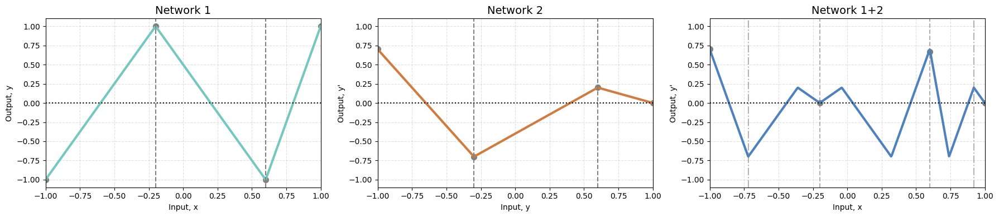

In [5]:
import numpy as np
import matplotlib.pyplot as plt

# ───────── 1) Definir la primera red f(x) con 3 regiones lineales ─────────
pivot1, pivot2 = -0.2, 0.6
# pendientes e interceptos para cada tramo
m1, b1 = 2.5, 1.5
m2, b2 = -2.5, 0.5
m3, b3 = 5.0, -4.0

def f(x):
    return np.where(x <= pivot1,
                    m1*x + b1,
                    np.where(x <= pivot2,
                             m2*x + b2,
                             m3*x + b3))

# ───────── 2) Definir la segunda red g(y) con 3 regiones lineales ─────────
cut1, cut2 = -0.3, 0.6
n1, c1 = -2.0, -1.3
n2, c2 =  1.0, -0.4
n3, c3 = -0.5,  0.5

def g(y):
    return np.where(y <= cut1,
                    n1*y + c1,
                    np.where(y <= cut2,
                             n2*y + c2,
                             n3*y + c3))

# ───────── 3) Crear el dominio y calcular las salidas ─────────
x = np.linspace(-1, 1, 500)
y = f(x)
y_dom = np.linspace(-1, 1, 500)
gy_dom = g(y_dom)
h = g(y)

# ───────── 4) Dibujar los paneles b), c) y d) ─────────
fig, axes = plt.subplots(1, 3, figsize=(18, 4), sharey=False)

# Panel b) Network 1: f(x)
ax = axes[0]
ax.plot(x, y, color='#76c7c0', lw=3)
# cortes en x
for xp in [pivot1, pivot2]:
    ax.axvline(xp, color='gray', ls='--')
# eje y=0
ax.axhline(0, color='k', ls=':')
ax.scatter([-1, pivot1, pivot2, 1], f(np.array([-1, pivot1, pivot2, 1])),
           color='gray', s=50)
ax.set_title('Network 1', fontsize=14)
ax.set_xlabel('Input, x')
ax.set_ylabel('Output, y')
ax.set_xlim(-1,1); ax.set_ylim(-1.1,1.1)
ax.grid(ls='--', alpha=0.4)

# Panel c) Network 2: g(y)
ax = axes[1]
ax.plot(y_dom, gy_dom, color='#d07b3f', lw=3)
# cortes en y
for yc in [cut1, cut2]:
    ax.axvline(yc, color='gray', ls='--')
# eje y'=0
ax.axhline(0, color='k', ls=':')
# marcar puntos de ejemplo
ax.scatter([y_dom[0], cut1, cut2, y_dom[-1]],
           [gy_dom[0], g(cut1), g(cut2), gy_dom[-1]],
           color='gray', s=50)
ax.set_title('Network 2', fontsize=14)
ax.set_xlabel('Input, y')
ax.set_ylabel("Output, y'")
ax.set_xlim(-1,1); ax.set_ylim(-1.1,1.1)
ax.grid(ls='--', alpha=0.4)

# Panel d) Composición h(x)
ax = axes[2]
ax.plot(x, h, color='#4f81bd', lw=3)
# cortes de f (tramos de x)
for xp in [pivot1, pivot2]:
    ax.axvline(xp, color='gray', ls='--', alpha=0.6)
# cortes de g en x: donde f cruza cut1 y cut2
for yc in [cut1, cut2]:
    xi = x[np.argmin(np.abs(y - yc))]
    ax.axvline(xi, color='gray', ls='-.', alpha=0.6)
ax.axhline(0, color='k', ls=':')
# marcar puntos de ejemplo
pts_x = [-1, pivot1, pivot2, 1]
ax.scatter(pts_x, h[np.searchsorted(x, pts_x)], color='gray', s=50)
ax.set_title('Network 1+2', fontsize=14)
ax.set_xlabel('Input, x')
ax.set_ylabel("Output, y'")
ax.set_xlim(-1,1); ax.set_ylim(-1.1,1.1)
ax.grid(ls='--', alpha=0.4)

plt.tight_layout()
plt.show()


## Deep networks

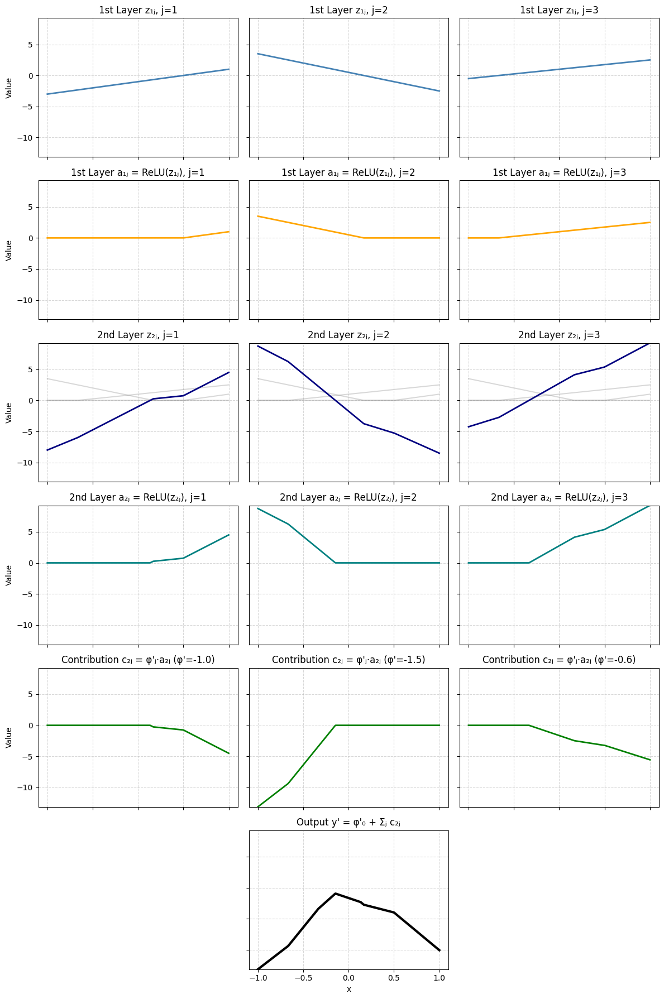

In [32]:
import numpy as np
import matplotlib.pyplot as plt

# ───────── Dominio de entrada 1D ─────────
x = np.linspace(-1, 1, 400)

# ───────── Primera capa (3 unidades) ─────────
# Pesos θ_{j1} y sesgos θ_{j0}
theta_w = np.array([2.0, -3.0, 1.5])
theta_b = np.array([-1.0, 0.5, 1.0])

# Pre-activaciones z1_j(x) y activaciones a1_j = ReLU(z1_j)
Z1 = [theta_w[j] * x + theta_b[j] for j in range(3)]
A1 = [np.maximum(0, Z1[j]) for j in range(3)]

# ───────── Segunda capa (3 unidades) ─────────
# Pesos ψ_{jk} y sesgos ψ_{j0} elegidos para mayor variación
psi_W = np.array([
    [ 3.0, -2.0,  1.0],
    [-1.0,  2.5, -3.0],
    [ 2.0, -1.5,  2.5]
])
psi_b = np.array([-1.0, 0.0, 1.0])

# Pre-activaciones z2_j = ψ_j·a1 + ψ_{j0}; activaciones a2_j = ReLU(z2_j)
Z2 = [psi_W[j,0]*A1[0] + psi_W[j,1]*A1[1] + psi_W[j,2]*A1[2] + psi_b[j]
      for j in range(3)]
A2 = [np.maximum(0, Z2[j]) for j in range(3)]

# ───────── Capa de salida ─────────
# Pesos φ'_j y sesgo φ'_0
phi = np.array([-1.0, -1.5, -0.6])
phi0 = 0.0

# Contribuciones c2_j = φ'_j * a2_j
C2 = [phi[j] * A2[j] for j in range(3)]
# Salida final y'
Y = phi0 + sum(C2)

# ───────── Determinar límites comunes para el eje Y ─────────
all_curves = Z1 + A1 + Z2 + A2 + C2 + [Y]
ymin = min(map(np.min, all_curves))
ymax = max(map(np.max, all_curves))

# ───────── Visualización en 6 filas × 3 columnas ─────────
fig, axes = plt.subplots(6, 3, figsize=(12, 18), sharex=True, sharey=True)
axes = axes.flatten()

# Row 1: pre-activaciones de la primera capa
for j in range(3):
    ax = axes[j]
    ax.plot(x, Z1[j], lw=2, color='steelblue')
    ax.set_title(f"1st Layer z₁ⱼ, j={j+1}")
    ax.set_ylim(ymin, ymax)
    ax.grid(ls='--', alpha=0.5)

# Row 2: activaciones ReLU de la primera capa
for j in range(3):
    ax = axes[3 + j]
    ax.plot(x, A1[j], lw=2, color='orange')
    ax.set_title(f"1st Layer a₁ⱼ = ReLU(z₁ⱼ), j={j+1}")
    ax.set_ylim(ymin, ymax)
    ax.grid(ls='--', alpha=0.5)

# Row 3: pre-activaciones de la segunda capa sobre fondo de A1
for j in range(3):
    ax = axes[6 + j]
    # fondo de activaciones primera capa
    for k in range(3):
        ax.plot(x, A1[k], color='gray', alpha=0.3)
    ax.plot(x, Z2[j], lw=2, color='navy')
    ax.set_title(f"2nd Layer z₂ⱼ, j={j+1}")
    ax.set_ylim(ymin, ymax)
    ax.grid(ls='--', alpha=0.5)

# Row 4: activaciones ReLU de la segunda capa
for j in range(3):
    ax = axes[9 + j]
    ax.plot(x, A2[j], lw=2, color='teal')
    ax.set_title(f"2nd Layer a₂ⱼ = ReLU(z₂ⱼ), j={j+1}")
    ax.set_ylim(ymin, ymax)
    ax.grid(ls='--', alpha=0.5)

# Row 5: contribuciones al output
for j in range(3):
    ax = axes[12 + j]
    ax.plot(x, C2[j], lw=2, color='green')
    ax.set_title(f"Contribution c₂ⱼ = φ'ⱼ·a₂ⱼ (φ'={phi[j]:.1f})")
    ax.set_ylim(ymin, ymax)
    ax.grid(ls='--', alpha=0.5)

# Row 6: salida final sólo en el panel central
for j in [15, 17]:
    axes[j].axis('off')
ax = axes[16]
ax.plot(x, Y, lw=3, color='black')
ax.set_title("Output y' = φ'₀ + Σⱼ c₂ⱼ")
ax.set_ylim(ymin, ymax)
ax.grid(ls='--', alpha=0.5)

# Etiquetas comunes
for idx, ax in enumerate(axes):
    if idx % 3 == 0:
        ax.set_ylabel("Value")
    if idx // 3 == 5:
        ax.set_xlabel("x")

plt.tight_layout()
plt.show()


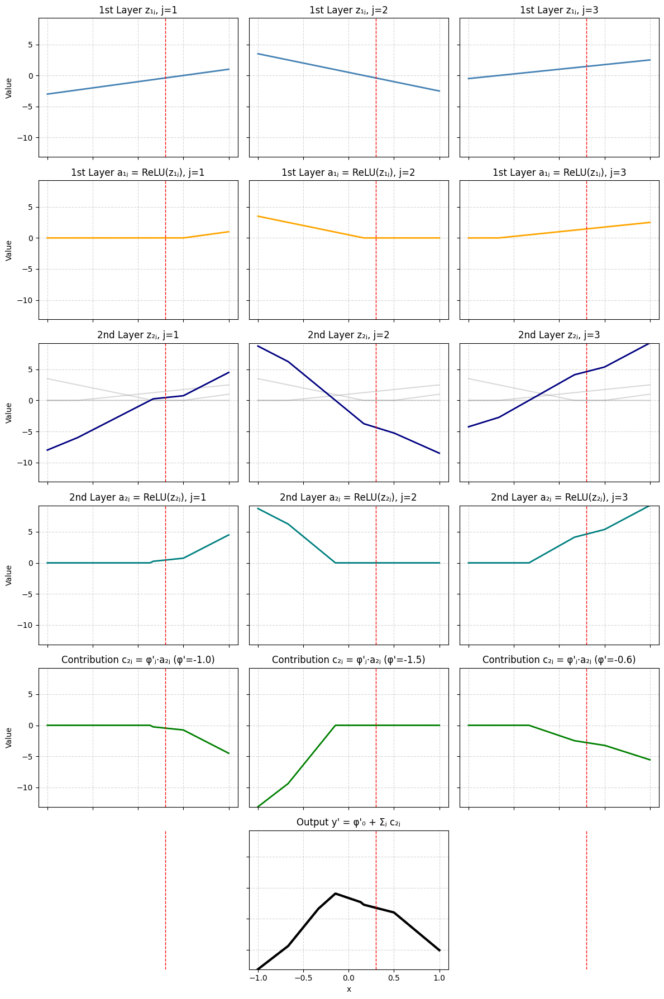

In [33]:
import numpy as np
import matplotlib.pyplot as plt

# ───────── Parámetro a resaltar ─────────
# Cambia este valor para dibujar la línea vertical en la posición deseada
input_to_mark = 0.3

# ───────── Dominio de entrada 1D ─────────
x = np.linspace(-1, 1, 400)

# ───────── Primera capa (3 unidades) ─────────
# Pesos θ_{j1} y sesgos θ_{j0}
theta_w = np.array([2.0, -3.0, 1.5])
theta_b = np.array([-1.0, 0.5, 1.0])

# Pre-activaciones z1_j(x) y activaciones a1_j = ReLU(z1_j)
Z1 = [theta_w[j] * x + theta_b[j] for j in range(3)]
A1 = [np.maximum(0, Z1[j]) for j in range(3)]

# ───────── Segunda capa (3 unidades) ─────────
# Pesos ψ_{jk} y sesgos ψ_{j0}
psi_W = np.array([
    [ 3.0, -2.0,  1.0],
    [-1.0,  2.5, -3.0],
    [ 2.0, -1.5,  2.5]
])
psi_b = np.array([-1.0, 0.0, 1.0])

# Pre-activaciones z2_j = ψ_j·a1 + ψ_{j0}; activaciones a2_j = ReLU(z2_j)
Z2 = [
    psi_W[j,0]*A1[0] + psi_W[j,1]*A1[1] + psi_W[j,2]*A1[2] + psi_b[j]
    for j in range(3)
]
A2 = [np.maximum(0, Z2[j]) for j in range(3)]

# ───────── Capa de salida ─────────
# Pesos φ'_j y sesgo φ'_0
phi  = np.array([-1.0, -1.5, -0.6])
phi0 = 0.0

# Contribuciones c2_j = φ'_j * a2_j
C2 = [phi[j] * A2[j] for j in range(3)]
# Salida final y'
Y = phi0 + sum(C2)

# ───────── Límites comunes para el eje Y ─────────
all_curves = Z1 + A1 + Z2 + A2 + C2 + [Y]
ymin = min(map(np.min, all_curves))
ymax = max(map(np.max, all_curves))

# ───────── Visualización en 6 filas × 3 columnas ─────────
fig, axes = plt.subplots(6, 3, figsize=(12, 18), sharex=True, sharey=True)
axes = axes.flatten()

# Row 1: pre-activaciones de la primera capa
for j in range(3):
    ax = axes[j]
    ax.plot(x, Z1[j], lw=2, color='steelblue')
    ax.set_title(f"1st Layer z₁ⱼ, j={j+1}")
    ax.set_ylim(ymin, ymax)
    ax.grid(ls='--', alpha=0.5)

# Row 2: activaciones ReLU de la primera capa
for j in range(3):
    ax = axes[3 + j]
    ax.plot(x, A1[j], lw=2, color='orange')
    ax.set_title(f"1st Layer a₁ⱼ = ReLU(z₁ⱼ), j={j+1}")
    ax.set_ylim(ymin, ymax)
    ax.grid(ls='--', alpha=0.5)

# Row 3: pre-activaciones de la segunda capa sobre fondo de A1
for j in range(3):
    ax = axes[6 + j]
    # fondo de activaciones primera capa
    for k in range(3):
        ax.plot(x, A1[k], color='gray', alpha=0.3)
    ax.plot(x, Z2[j], lw=2, color='navy')
    ax.set_title(f"2nd Layer z₂ⱼ, j={j+1}")
    ax.set_ylim(ymin, ymax)
    ax.grid(ls='--', alpha=0.5)

# Row 4: activaciones ReLU de la segunda capa
for j in range(3):
    ax = axes[9 + j]
    ax.plot(x, A2[j], lw=2, color='teal')
    ax.set_title(f"2nd Layer a₂ⱼ = ReLU(z₂ⱼ), j={j+1}")
    ax.set_ylim(ymin, ymax)
    ax.grid(ls='--', alpha=0.5)

# Row 5: contribuciones al output
for j in range(3):
    ax = axes[12 + j]
    ax.plot(x, C2[j], lw=2, color='green')
    ax.set_title(f"Contribution c₂ⱼ = φ'ⱼ·a₂ⱼ (φ'={phi[j]:.1f})")
    ax.set_ylim(ymin, ymax)
    ax.grid(ls='--', alpha=0.5)

# Row 6: salida final solo en el panel central
# Desactivamos los dos paneles vacíos de la fila final
axes[15].axis('off')
axes[17].axis('off')
ax = axes[16]
ax.plot(x, Y, lw=3, color='black')
ax.set_title("Output y' = φ'₀ + Σⱼ c₂ⱼ")
ax.set_ylim(ymin, ymax)
ax.grid(ls='--', alpha=0.5)

# ───────── Dibujar línea vertical en todos los ejes ─────────
for ax in axes:
    # omitimos los ejes que están 'off'
    if not ax.get_visible():
        continue
    ax.axvline(input_to_mark, color='red', linestyle='--', linewidth=1)

# ───────── Etiquetas comunes ─────────
for idx, ax in enumerate(axes):
    if idx % 3 == 0:
        ax.set_ylabel("Value")
    if idx // 3 == 5:
        ax.set_xlabel("x")

plt.tight_layout()
plt.show()


## Implementacion

### Numpy

In [16]:
import numpy as np
import matplotlib.pyplot as plt

# Define the Rectified Linear Unit (ReLU) function
def ReLU(preactivation):
  activation = preactivation.clip(0.0)
  return activation

PARAMETERS (MATRIX FORM)

![deep network eqns](images/deep_network_eqns.PNG)



In [17]:
"""
INPUT: 1, OUTPUT: 1, HIDDEN LAYERS: 2, HIDDEN UNITS: 3

Parametros:

- theta (θ) = parametros del input a la primera capa ()
- psi (Ψ) = parametros de la primera capa a la segunda
- phi (Φ) = parametros de la segunda capa a la salida

Indices:
- Primer indice es la neurona de la capa a la que llega, 
- Segundo indice es la neurona de la capa que sale.

O sea, psi[2,3] es el peso de la conexion de la segunda neurona de la primera capa a la tercera neurona de la segunda capa.
Cuando son los y-offsets, el segundo indice es 0.

OJO, en python empieza por 0 pero lo dejamos en blanco para que sea como en la ecuacion.

--- 
Ejemplos de parametros:

Del input a la primera capa:

- theta[1,0] = y-offset de la primera neurona (θ₁₀)
- theta[2,0] = y-offset de la segunda neurona (θ₂₀)
- theta[1,1] = peso del input a la primera neurona (θ₁₁)
- theta[2,1] = peso del input a la segunda neurona (θ₂₁)
- theta[3,0] = y-offset de la tercera neurona (θ₃₀)
- theta[3,1] = peso del input a la tercera neurona (θ₃₁)

De la primera capa a la segunda capa:

- psi[1,0] = y-offset de la primera neurona (Ψ₁₀)
- psi[1,1] = peso de la primera neurona a la primera neurona de la segunda capa (Ψ₁₁)
- psi[1,2] = peso de la primera neurona a la segunda neurona de la segunda capa (Ψ₁₂)
- psi[1,3] = peso de la primera neurona a la tercera neurona de la segunda capa (Ψ₁₃)
- psi[2,0] = y-offset de la segunda neurona (Ψ₂₀)
- psi[2,1] = peso de la segunda neurona a la primera neurona de la segunda capa (Ψ₂₁)
- psi[2,2] = peso de la segunda neurona a la segunda neurona de la segunda capa (Ψ₂₂)
- psi[2,3] = peso de la segunda neurona a la tercera neurona de la segunda capa (Ψ₂₃)
- psi[3,0] = y-offset de la tercera neurona (Ψ₃₀)
- psi[3,1] = peso de la tercera neurona a la primera neurona de la segunda capa (Ψ₃₁)

De la segunda capa a la salida:

- phi[0] = y-offset de la salida (Φ₀)
- phi[1] = peso de la primera neurona de la segunda capa a la salida (Φ₁)
- phi[2] = peso de la segunda neurona de la segunda capa a la salida (Φ₂)
- phi[3] = peso de la tercera neurona de la segunda capa a la salida (Φ₃)

"""

theta = np.zeros([4,2])
psi = np.zeros([4,4])
phi = np.zeros([4,1])

theta[1,0] =  0.3 ; theta[1,1] = -1.0
theta[2,0]= -1.0  ; theta[2,1] = 2.0
theta[3,0] = -0.5  ; theta[3,1] = 0.65
psi[1,0] = 0.3;  psi[1,1] = 2.0; psi[1,2] = -1.0; psi[1,3]=7.0
psi[2,0] = -0.2;  psi[2,1] = 2.0; psi[2,2] = 1.2; psi[2,3]=-8.0
psi[3,0] = 0.3;  psi[3,1] = -2.3; psi[3,2] = -0.8; psi[3,3]=2.0
phi[0] = 0.0; phi[1] = 0.5; phi[2] = -1.5; phi [3] = 2.2

psi

array([[ 0. ,  0. ,  0. ,  0. ],
       [ 0.3,  2. , -1. ,  7. ],
       [-0.2,  2. ,  1.2, -8. ],
       [ 0.3, -2.3, -0.8,  2. ]])

In [18]:
"""
INPUT: 1, OUTPUT: 1, HIDDEN LAYERS: 2, HIDDEN UNITS: 3
"""

# Define a deep neural network with, one input, one output, two hidden layers and three hidden units (eqns 4.7-4.9)
def shallow_1_1_3_3(x, activation_fn, phi, psi, theta):

  # Preactivations at layer 1 (terms in brackets in equation 4.7)
  layer1_pre_1 = theta[1,0] + theta[1,1] * x
  layer1_pre_2 = theta[2,0] + theta[2,1] * x
  layer1_pre_3 = theta[3,0] + theta[3,1] * x

  # Activation functions (rest of equation 4.7)
  h1 = activation_fn(layer1_pre_1)
  h2 = activation_fn(layer1_pre_2)
  h3 = activation_fn(layer1_pre_3)

  # Preactivations at layer 2 (terms in brackets in equation 4.8)
  layer2_pre_1 = psi[1,0] + psi[1,1] * h1 + psi[1,2] * h2 + psi[1,3] * h3
  layer2_pre_2 = psi[2,0] + psi[2,1] * h1 + psi[2,2] * h2 + psi[2,3] * h3
  layer2_pre_3 = psi[3,0] + psi[3,1] * h1 + psi[3,2] * h2 + psi[3,3] * h3

  # Activation functions (rest of equation 4.8)
  h1_prime = activation_fn(layer2_pre_1)
  h2_prime = activation_fn(layer2_pre_2)
  h3_prime = activation_fn(layer2_pre_3)

  # Weighted outputs by phi (three last terms of equation 4.9)
  phi1_h1_prime = phi[1] * h1_prime
  phi2_h2_prime = phi[2] * h2_prime
  phi3_h3_prime = phi[3] * h3_prime

  # Combine weighted activation and add y offset (summing terms of equation 4.9)
  y = phi[0] + phi1_h1_prime + phi2_h2_prime + phi3_h3_prime


  # Return everything we have calculated
  return y, layer2_pre_1, layer2_pre_2, layer2_pre_3, h1_prime, h2_prime, h3_prime, phi1_h1_prime, phi2_h2_prime, phi3_h3_prime

In [19]:
# # Plot two layer neural network as in figure 4.5
def plot_neural_two_layers(x, y, layer2_pre_1, layer2_pre_2, layer2_pre_3, h1_prime, h2_prime, h3_prime, phi1_h1_prime, phi2_h2_prime, phi3_h3_prime):

    fig, ax = plt.subplots(3,3)
    fig.set_size_inches(8.5, 8.5)
    fig.tight_layout(pad=3.0)
    ax[0,0].plot(x,layer2_pre_1,'r-'); ax[0,0].set_ylabel(r'$\psi_{10}+\psi_{11}h_{1}+\psi_{12}h_{2}+\psi_{13}h_3$')
    ax[0,1].plot(x,layer2_pre_2,'b-'); ax[0,1].set_ylabel(r'$\psi_{20}+\psi_{21}h_{1}+\psi_{22}h_{2}+\psi_{23}h_3$')
    ax[0,2].plot(x,layer2_pre_3,'g-'); ax[0,2].set_ylabel(r'$\psi_{30}+\psi_{31}h_{1}+\psi_{32}h_{2}+\psi_{33}h_3$')
    ax[1,0].plot(x,h1_prime,'r-'); ax[1,0].set_ylabel(r"$h_{1}^{'}$")
    ax[1,1].plot(x,h2_prime,'b-'); ax[1,1].set_ylabel(r"$h_{2}^{'}$")
    ax[1,2].plot(x,h3_prime,'g-'); ax[1,2].set_ylabel(r"$h_{3}^{'}$")
    ax[2,0].plot(x,phi1_h1_prime,'r-'); ax[2,0].set_ylabel(r"$\phi_1 h_{1}^{'}$")
    ax[2,1].plot(x,phi2_h2_prime,'b-'); ax[2,1].set_ylabel(r"$\phi_2 h_{2}^{'}$")
    ax[2,2].plot(x,phi3_h3_prime,'g-'); ax[2,2].set_ylabel(r"$\phi_3 h_{3}^{'}$")

    for plot_y in range(3):
      for plot_x in range(3):
        ax[plot_y,plot_x].set_xlim([0,1]);ax[plot_x,plot_y].set_ylim([-1,1])
        ax[plot_y,plot_x].set_aspect(0.5)
      ax[2,plot_y].set_xlabel(r'Input, $x$');
    plt.show()

    fig, ax = plt.subplots()
    ax.plot(x,y)
    ax.set_xlabel(r'Input, $x$'); ax.set_ylabel(r'Output, $y$')
    ax.set_xlim([0,1]);ax.set_ylim([-1,1])
    ax.set_aspect(0.5)
    plt.show()

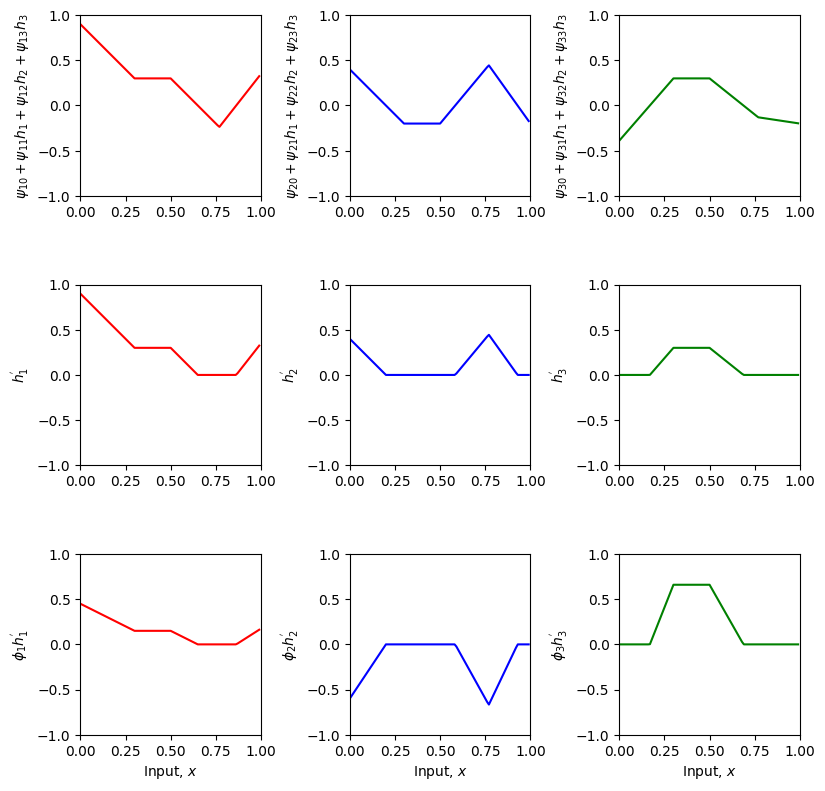

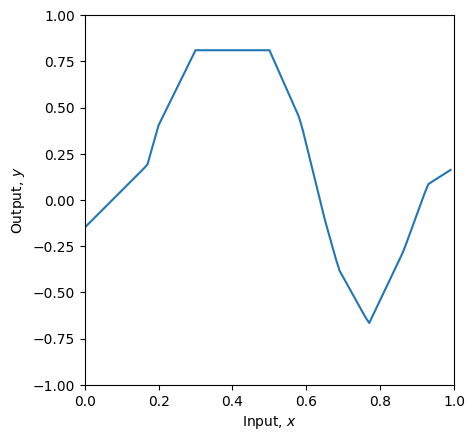

In [20]:
# Usamos los parametros definidos mas arriba

# Define a range of input values
x = np.arange(0,1,0.01)

# Run the neural network
y, layer2_pre_1, layer2_pre_2, layer2_pre_3, h1_prime, h2_prime, h3_prime, phi1_h1_prime, phi2_h2_prime, phi3_h3_prime \
    = shallow_1_1_3_3(x, ReLU, phi, psi, theta)

# And then plot it
plot_neural_two_layers(x, y, layer2_pre_1, layer2_pre_2, layer2_pre_3, h1_prime, h2_prime, h3_prime, phi1_h1_prime, phi2_h2_prime, phi3_h3_prime)

DEEP NETWORK CON MATMUL

In [21]:
"""
HYPERPARAMETERS:

INPUT: 4, OUTPUT: 1, HIDDEN LAYERS: 3

- HIDDEN LAYER 1: 5 UNITS (ReLU)
- HIDDEN LAYER 2: 2 UNITS (ReLU)
- HIDDEN LAYER 3: 4 UNITS (ReLU)
"""

# define sizes
D_i=4; D_1=5; D_2=2; D_3=4; D_o=1

# Definimos los parametros aleatoriamente con los tamaños adecuados
beta_0 = np.random.normal(size=(D_1,1))
Omega_0 = np.random.normal(size=(D_1,D_i))
beta_1 = np.random.normal(size=(D_2,1))
Omega_1 = np.random.normal(size=(D_2,D_1))
beta_2 = np.random.normal(size=(D_3,1))
Omega_2 = np.random.normal(size=(D_3,D_2))
beta_3 = np.random.normal(size=(D_o,1))
Omega_3 = np.random.normal(size=(D_o,D_3))

Omega_2

array([[ 1.57858915, -1.14339257],
       [ 0.6957732 , -0.13720118],
       [-0.27665705, -0.8797729 ],
       [-0.22637255, -0.2781813 ]])

In [22]:
# simulamos data de forma aleatoria

n_data = 4;
x = np.random.normal(size=(D_i, n_data))
x

array([[ 1.7014391 ,  0.43742761, -0.80297437,  0.23143274],
       [-0.56192721, -0.68955179,  1.04521968, -0.50336077],
       [-0.18921627, -0.69469979,  0.4007342 ,  0.18293346],
       [-0.44597735,  1.31922327,  2.68984858,  2.08039149]])

In [30]:
# Forward pass paso a paso

# entre x y la primera capa
print(f'Input: \n{x}')
print(f'Weights (Omega_0): \n{Omega_0}')
print(f'Bias (beta_0): \n{beta_0}')

h1 = ReLU(beta_0 + np.matmul(Omega_0,x))
print(f'Pre-activations hidden 1 (beta_0 + Omega_0 * x): \n{h1}')

Input: 
[[ 1.7014391   0.43742761 -0.80297437  0.23143274]
 [-0.56192721 -0.68955179  1.04521968 -0.50336077]
 [-0.18921627 -0.69469979  0.4007342   0.18293346]
 [-0.44597735  1.31922327  2.68984858  2.08039149]]
Weights (Omega_0): 
[[-1.58021045  1.49434702  1.38191051  1.56273799]
 [ 0.96581658  0.07873966  0.62849531  0.45528729]
 [ 0.02932449 -0.64027011  0.14609536 -0.3706362 ]
 [ 0.56635743  1.00499481 -0.45561602 -1.06310265]
 [-0.65824649 -0.65334961 -1.67506048  1.68996909]]
Bias (beta_0): 
[[-0.91303709]
 [ 0.30587158]
 [ 0.79228287]
 [ 1.99018131]
 [-2.86477892]]
Pre-activations hidden 1 (beta_0 + Omega_0 * x): 
[[0.         0.         6.67505967 1.47295929]
 [1.58293436 0.83806136 1.08915928 1.55190732]
 [1.33961364 0.6561653  0.         0.37701371]
 [2.94939973 0.45897232 0.         0.        ]
 [0.         0.690915   0.85538922 0.52112457]]


In [31]:
# entre la primera capa y la segunda capa
print()
print(f'Weights (Omega_1): \n{Omega_1}')
print(f'Bias (beta_1): \n{beta_1}')

h2 = ReLU(beta_1 + np.matmul(Omega_1,h1))
print(f'Pre-activations hidden 2 (beta_1 + Omega_1 * h1): \n{h2}')


Weights (Omega_1): 
[[ 0.15121749 -2.60226404 -0.64318209 -0.39676068  0.56173418]
 [-0.84004063 -0.5988879   1.97316332 -0.35730406 -1.57558666]]
Bias (beta_1): 
[[ 0.07082154]
 [-0.42491815]]
Pre-activations hidden 2 (beta_1 + Omega_1 * h1): 
[[0.         0.         0.         0.        ]
 [0.21652562 0.         0.         0.        ]]


In [32]:
# entre la segunda capa y la tercera capa
print()
print(f'Weights (Omega_2): \n{Omega_2}')
print(f'Bias (beta_2): \n{beta_2}')

h3 = ReLU(beta_2 + np.matmul(Omega_2,h2))
print(f'Pre-activations hidden 3 (beta_2 + Omega_2 * h2): \n{h3}')


Weights (Omega_2): 
[[ 1.57858915 -1.14339257]
 [ 0.6957732  -0.13720118]
 [-0.27665705 -0.8797729 ]
 [-0.22637255 -0.2781813 ]]
Bias (beta_2): 
[[-1.30668982]
 [ 0.14996598]
 [-0.86403272]
 [ 0.53335124]]
Pre-activations hidden 3 (beta_2 + Omega_2 * h2): 
[[0.         0.         0.         0.        ]
 [0.12025841 0.14996598 0.14996598 0.14996598]
 [0.         0.         0.         0.        ]
 [0.47311786 0.53335124 0.53335124 0.53335124]]


In [33]:
# entre la tercera capa y la salida
print()
print(f'Weights (Omega_3): \n{Omega_3}')
print(f'Bias (beta_3): \n{beta_3}')

y = beta_3 + np.matmul(Omega_3,h3)
print(f'Output (beta_3 + Omega_3 * h3): \n{y}')


Weights (Omega_3): 
[[ 0.70291664 -1.73223383 -0.52305772  0.11016791]]
Bias (beta_3): 
[[0.09165093]]
Output (beta_3 + Omega_3 * h3): 
[[-0.06454236 -0.10936703 -0.10936703 -0.10936703]]


In [34]:
# Forward pass (DE UNA)

h1 = ReLU(beta_0 + np.matmul(Omega_0,x));
h2 = ReLU(beta_1 + np.matmul(Omega_1,h1));
h3 = ReLU(beta_2 + np.matmul(Omega_2,h2));
y = beta_3 + np.matmul(Omega_3,h3)

y

array([[-0.06454236, -0.10936703, -0.10936703, -0.10936703]])

In [35]:
# Chequeo de shapes

if h1.shape[0] is not D_1 or h1.shape[1] is not n_data:
  print("h1 is wrong shape")
if h2.shape[0] is not D_2 or h1.shape[1] is not n_data:
  print("h2 is wrong shape")
if h3.shape[0] is not D_3 or h1.shape[1] is not n_data:
  print("h3 is wrong shape")
if y.shape[0] is not D_o or h1.shape[1] is not n_data:
  print("Output is wrong shape")

# Print the inputs and outputs
print("Input data points")
print(x)
print ("Output data points")
print(y)

Input data points
[[ 1.7014391   0.43742761 -0.80297437  0.23143274]
 [-0.56192721 -0.68955179  1.04521968 -0.50336077]
 [-0.18921627 -0.69469979  0.4007342   0.18293346]
 [-0.44597735  1.31922327  2.68984858  2.08039149]]
Output data points
[[-0.06454236 -0.10936703 -0.10936703 -0.10936703]]


### Pytorch basics

Pytorch tiene 3 modulos:

- Tensor library
- Deep learning library
- Automatic differentiation engine 

In [37]:
import torch

print(torch.__version__)
print(torch.cuda.is_available())

2.6.0+cu124
True


In [39]:
import torch
import numpy as np

# create a 0D tensor (scalar) from a Python integer
tensor0d = torch.tensor(1)

# create a 1D tensor (vector) from a Python list
tensor1d = torch.tensor([1, 2, 3])

# create a 2D tensor from a nested Python list
tensor2d = torch.tensor([[1, 2], 
                         [3, 4]])

# create a 3D tensor from a nested Python list
tensor3d_1 = torch.tensor([[[1, 2], [3, 4]], 
                           [[5, 6], [7, 8]]])

# create a 3D tensor from NumPy array
ary3d = np.array([[[1, 2], [3, 4]], 
                  [[5, 6], [7, 8]]])
tensor3d_2 = torch.tensor(ary3d)  # Copies NumPy array
tensor3d_3 = torch.from_numpy(ary3d)  # Shares memory with NumPy array

(tensor(1), torch.Size([]))

<img src="https://sebastianraschka.com/images/LLMs-from-scratch-images/appendix-a_compressed/7.webp" width="600px">

SIMPLE NEURAL NETWORK

In [56]:
# generamos data aleatoria x con 4 features y 10 ejemplos

g = torch.Generator().manual_seed(2147483647) # for reproducibility

n_data = 4;
x = torch.randn((4, 10), generator=g)
x, x.shape

(tensor([[ 1.5674, -0.2373, -0.0274, -1.1008,  0.2859, -0.0296, -1.5471,  0.6049,
           0.0791,  0.9046],
         [-0.4713,  0.7868, -0.3284, -0.4330,  1.3729,  2.9334,  1.5618, -1.6261,
           0.6772, -0.8404],
         [ 0.9849, -0.1484, -1.4795,  0.4483,  1.5204,  0.8786, -0.7159, -1.0549,
           0.8372, -0.4971],
         [-0.9398,  0.1343,  0.7277, -2.5268,  1.0736,  0.2222,  1.0656, -0.0115,
           0.4835, -0.3164]]),
 torch.Size([4, 10]))

In [62]:
"""
HYPERPARAMETERS:

INPUT dimension: 10, OUTPUT dimension: 2, HIDDEN LAYERS: 2

- HIDDEN LAYER 1: 30 UNITS (ReLU)
- HIDDEN LAYER 2: 20 UNITS (ReLU)
"""

g = torch.Generator().manual_seed(2147483647) # for reproducibility

# Hidden layer 1
W1 = torch.randn((10, 30), generator=g) # 10 inputs, 30 units
b1 = torch.randn(30, generator=g) # 30 units

# Hidden layer 2
W2 = torch.randn((30, 20), generator=g) # 30 units input, 20 units
b2 = torch.randn(20, generator=g) # 20 units

# Output layer
W3 = torch.randn((20, 2), generator=g) # 20 units input, 2 unit output
b3 = torch.randn(2, generator=g) # 2 units

# parameter list
parameters = [W1, b1, W2, b2, W3, b3]
print(sum(p.nelement() for p in parameters)) # number of parameters in total

# Setear los parametros con gradientes
for p in parameters:
  p.requires_grad = True

992


In [63]:
# forward pass layer 1

# pre activations layer 1
L1 = x @ W1 + b1

# activation function
h1 = torch.tanh(L1)

print(L1.shape)
print(h1.shape)
h1

torch.Size([4, 30])
torch.Size([4, 30])


tensor([[ 0.9547,  0.9198,  0.9556, -0.9995,  0.8781, -0.9490, -1.0000, -0.8613,
          0.6674,  0.9996,  0.1442,  0.1697,  0.1500, -0.9892,  0.9992,  0.9999,
          0.9989,  0.4556,  0.9956,  0.5614,  0.1308, -0.9997, -0.9920,  0.9634,
          0.9985,  0.9999,  1.0000,  0.0372, -0.9998,  0.2791],
        [ 0.9785, -0.0289, -1.0000,  1.0000,  0.2119,  0.9999, -0.9970,  0.9997,
         -0.9999, -0.9938, -1.0000,  0.9989,  0.9999,  0.7429,  1.0000, -0.9687,
          1.0000,  0.6554,  0.9184,  0.5096,  1.0000,  1.0000,  1.0000,  0.5424,
         -0.9579, -0.6349, -0.9680, -0.9999,  1.0000, -1.0000],
        [ 0.0736,  0.4942, -0.7664, -0.9042, -0.1028,  0.9999, -1.0000, -0.9923,
         -0.8118,  0.7596, -1.0000, -0.8136,  0.1881, -0.9996,  0.9999,  0.8458,
          0.9973, -0.9040,  0.9862,  0.9996,  1.0000, -0.9456,  0.5252, -0.5303,
         -0.5849,  0.9943, -0.9269, -0.9919,  0.9874, -0.9743],
        [ 0.9919, -0.3288, -0.9997,  0.9751,  0.9492, -0.9821,  0.9372,  0.9873

In [64]:
# forward pass layer 2

# pre activations layer 2
L2 = h1 @ W2 + b2

# activation function
h2 = torch.tanh(L2)

print(L2.shape)
print(h2.shape)
h2

torch.Size([4, 20])
torch.Size([4, 20])


tensor([[ 0.9988,  0.8852,  0.5379, -0.9998, -0.3941,  1.0000, -0.9991,  0.7446,
         -0.9994, -0.9997, -0.9999,  0.8868,  0.9937, -1.0000,  1.0000,  1.0000,
         -0.5804, -0.9997,  0.9867,  0.2703],
        [ 0.9787,  1.0000, -0.9994,  0.2038,  1.0000,  0.7257, -0.9995,  1.0000,
         -0.9995,  0.9573, -0.9576,  1.0000,  0.9981,  0.9834, -0.4990, -1.0000,
         -1.0000,  0.9938, -0.9991,  0.8088],
        [ 0.9295, -0.9982,  0.9294,  0.6359,  1.0000,  1.0000, -0.9999,  1.0000,
          0.8850,  0.2325, -0.9994, -0.9395, -0.9402, -1.0000,  0.9996, -0.9976,
         -0.9997, -0.9994, -0.9990,  0.9057],
        [ 0.9999,  1.0000, -0.9948, -1.0000,  0.9420,  1.0000, -1.0000,  0.0104,
         -1.0000, -0.9771,  0.9784,  1.0000,  1.0000,  0.9776, -0.8644, -1.0000,
         -1.0000,  0.9997, -0.8922, -0.8888]], grad_fn=<TanhBackward0>)

In [65]:
# forward pass output layer

logits = h2 @ W3 + b3 
print(logits.shape)
logits

torch.Size([4, 2])


tensor([[ 2.4789, -5.1540],
        [ 1.3260,  5.4996],
        [ 5.3788, -3.5523],
        [ 0.6224,  5.8002]], grad_fn=<AddBackward0>)

In [68]:
# USAMOS SOFTMAX PARA CONVERTIR LOS LOGITS A PROBABILIDADES

counts = logits.exp()
prob = counts / counts.sum(1, keepdims=True)
# prob = F.softmax(logits, dim=1)
prob.shape, prob

(torch.Size([4, 2]),
 tensor([[9.9952e-01, 4.8405e-04],
         [1.5164e-02, 9.8484e-01],
         [9.9987e-01, 1.3219e-04],
         [5.6088e-03, 9.9439e-01]], grad_fn=<DivBackward0>))

In [69]:
# To round and suppress scientific notation for the probabilities:
with np.printoptions(precision=4, suppress=True):
    print(prob.detach().numpy())

[[0.9995 0.0005]
 [0.0152 0.9848]
 [0.9999 0.0001]
 [0.0056 0.9944]]


### Pytorch classes basics

In [70]:
# Let's train a deeper network
# The classes we create here are the same API as nn.Module in PyTorch

class Linear:
  
  def __init__(self, fan_in, fan_out, bias=True):
    self.weight = torch.randn((fan_in, fan_out), generator=g)# / fan_in**0.5
    self.bias = torch.zeros(fan_out) if bias else None
  
  def __call__(self, x):
    self.out = x @ self.weight
    if self.bias is not None:
      self.out += self.bias
    return self.out
  
  def parameters(self):
    return [self.weight] + ([] if self.bias is None else [self.bias])
  

class Tanh:
  def __call__(self, x):
    self.out = torch.tanh(x)
    return self.out
  def parameters(self):
    return []


In [78]:
D_i = 10 # the dimensionality of the data (features)
n_hidden = 20 # the number of neurons in the hidden layers of the MLP
n_out = 2 # the number of neurons in the output layer of the MLP

# layers
layers = [
  Linear(D_i, n_hidden), Tanh(),
  Linear(n_hidden, n_hidden), Tanh(),
  Linear(n_hidden, n_hidden), Tanh(),
  Linear(n_hidden, n_hidden), Tanh(),
  Linear(n_hidden, n_out),
]

total_params = 0
for layer in layers:
    total_params += sum(p.numel() for p in layer.parameters())
print(total_params)

1522


In [80]:
# data
x = torch.randn((10, D_i)) # 10 examples, D_i features

for layer in layers:
    x = layer(x)

layers[-1].out

tensor([[-6.6484, -2.2820],
        [-5.7004,  0.4999],
        [ 2.7310, -2.2798],
        [ 4.9184,  5.8892],
        [ 6.7015, -1.8906],
        [ 0.1561, -2.6323],
        [-2.5496, -1.8367],
        [ 5.2041, -1.2073],
        [ 0.9309, -4.0393],
        [ 5.5727, -0.4324]])

### Pytorch classes

**nn.Linear**

Es una linear LAYER (sin activacion). Hace la operacion lineal: y = x @ WT + b. 

Si hacemos: layer = nn.Linear(in_features=2, out_features=3)

Internamente:
1. Crea una matriz de pesos W de tamaño (3, 2) (PyTorch usa Wᵗ)
2. Crea un bias b de tamaño (3,)
3. Ambos se crean como torch.nn.Parameter, es decir, tensores entrenables
4. Se inicializan automáticamente (por default: Kaiming Uniform si usás ReLU)

---

**nn.Module**

Es una clase base para todo tipo de modelo: redes, capas, bloques, etc.

Al hacer una clase basado en esta: class MyModel(nn.Module):

Lo que estás haciendo es crear un **componente que:
- puede tener subcomponentes
- guarda los parámetros
- sabe hacer .forward(x)
- interactúa con .cuda(), .eval(), .train(), .state_dict(), etc.

Despues cuando le definis capas a ese modelo: self.fc1 = nn.Linear(2, 3)
- Se agregan automáticamente como parte del modelo.
- Cuando hacés model.parameters(), incluye los pesos de fc1, etc.
- Si hacés model.to('cuda'), mueve todas las subcapas al GPU.

Con esto, despues podes pedir:

| Función                | Qué hace                              |
| ---------------------- | ------------------------------------- |
| `.parameters()`        | te da todos los pesos entrenables     |
| `.state_dict()`        | guarda los pesos para exportar        |
| `.to(device)`          | mueve todos los pesos automáticamente |
| `.eval()` y `.train()` | cambia comportamiento (dropout, BN)   |
| `.named_parameters()`  | pesos con nombre (para debugging)     |


In [86]:
# aca estamos hardcodeando el numero de neuronas en cada layer y la cantidad de layers

class NeuralNetwork(torch.nn.Module):
    def __init__(self, num_inputs, num_outputs):
        super().__init__()

        self.layers = torch.nn.Sequential(
                
            # 1st hidden layer
            torch.nn.Linear(num_inputs, 20),
            torch.nn.ReLU(),

            # 2nd hidden layer
            torch.nn.Linear(20, 20),
            torch.nn.ReLU(),

            # output layer
            torch.nn.Linear(20, num_outputs),
        )

    def forward(self, x):
        logits = self.layers(x)
        return logits

In [87]:
model = NeuralNetwork(10, 2)
print(model)

NeuralNetwork(
  (layers): Sequential(
    (0): Linear(in_features=10, out_features=20, bias=True)
    (1): ReLU()
    (2): Linear(in_features=20, out_features=20, bias=True)
    (3): ReLU()
    (4): Linear(in_features=20, out_features=2, bias=True)
  )
)


In [88]:
num_params = sum(p.numel() for p in model.parameters() if p.requires_grad)
print("Total number of trainable model parameters:", num_params)

Total number of trainable model parameters: 682


In [89]:
print(model.layers[0].weight)

Parameter containing:
tensor([[ 0.1122,  0.0687,  0.0746,  0.1222, -0.0409, -0.2939, -0.1956,  0.2699,
          0.0189, -0.2562],
        [ 0.0499,  0.2613, -0.2988, -0.2129, -0.1259,  0.0127, -0.0738, -0.0348,
         -0.3083,  0.1481],
        [ 0.2776,  0.1933, -0.2239, -0.2549,  0.1313,  0.0071,  0.1296, -0.3090,
         -0.0189,  0.2230],
        [ 0.1467,  0.0115,  0.0622, -0.0299, -0.1739, -0.1195, -0.1926,  0.2627,
          0.1740,  0.1106],
        [-0.2425,  0.2440,  0.0992,  0.2188, -0.1244,  0.0670,  0.3088,  0.2127,
          0.2536, -0.0664],
        [ 0.2409, -0.2477,  0.0274, -0.1781, -0.0737, -0.0810,  0.0237,  0.2878,
          0.1566, -0.0013],
        [ 0.2245, -0.1621,  0.1630, -0.0293, -0.0550,  0.0370, -0.2423,  0.0365,
          0.1063,  0.2704],
        [-0.0985,  0.1139,  0.3161, -0.1357,  0.3006, -0.1570,  0.1394,  0.1239,
          0.0883,  0.2501],
        [-0.1278,  0.0831,  0.0018, -0.2378, -0.0768, -0.2112,  0.1398,  0.0284,
          0.0310, -0.0959

In [92]:
torch.manual_seed(123)

X = torch.rand((5, 10)) # 5 examples, 10 features
out = model(X)
print(out)

tensor([[0.1436, 0.0796],
        [0.1348, 0.0859],
        [0.1260, 0.0761],
        [0.1174, 0.0777],
        [0.1442, 0.0526]], grad_fn=<AddmmBackward0>)


# Loss function (visualizar)

## MSE sin activacion

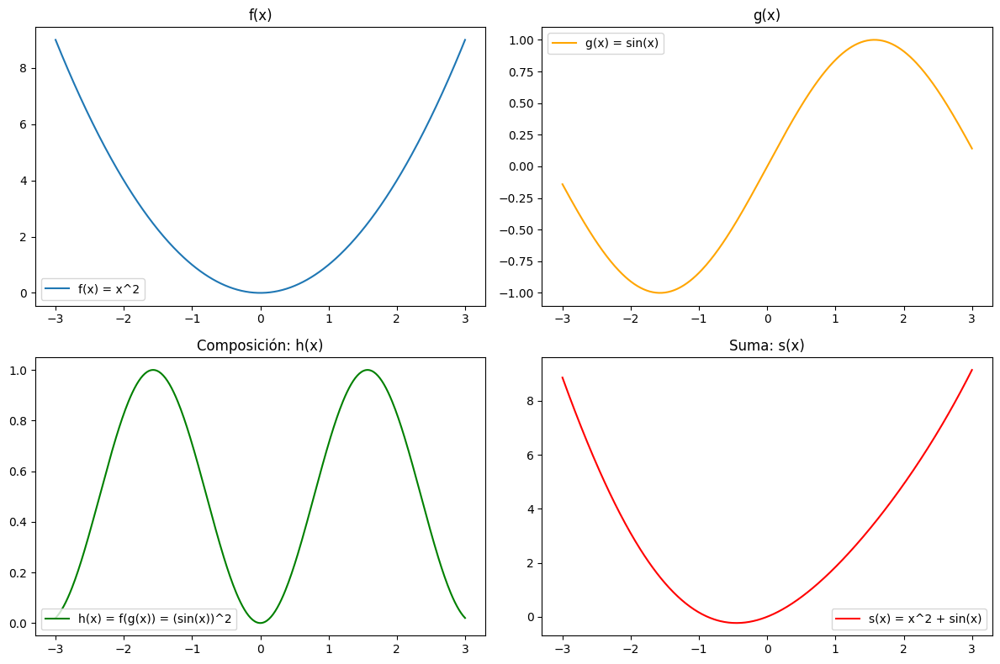

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# Definimos dos funciones diferenciables simples
def f(x):
    return x**2

def g(x):
    return np.sin(x)

# Composición: h(x) = f(g(x))
def h(x):
    return f(g(x))

# Suma: s(x) = f(x) + g(x)
def s(x):
    return f(x) + g(x)

# Dominio para graficar
x = np.linspace(-3, 3, 400)

plt.figure(figsize=(12, 8))

# Graficamos f(x)
plt.subplot(2, 2, 1)
plt.plot(x, f(x), label='f(x) = x^2')
plt.title('f(x)')
plt.legend()

# Graficamos g(x)
plt.subplot(2, 2, 2)
plt.plot(x, g(x), label='g(x) = sin(x)', color='orange')
plt.title('g(x)')
plt.legend()

# Graficamos h(x) = f(g(x))
plt.subplot(2, 2, 3)
plt.plot(x, h(x), label='h(x) = f(g(x)) = (sin(x))^2', color='green')
plt.title('Composición: h(x)')
plt.legend()

# Graficamos s(x) = f(x) + g(x)
plt.subplot(2, 2, 4)
plt.plot(x, s(x), label='s(x) = x^2 + sin(x)', color='red')
plt.title('Suma: s(x)')
plt.legend()

plt.tight_layout()
plt.show()

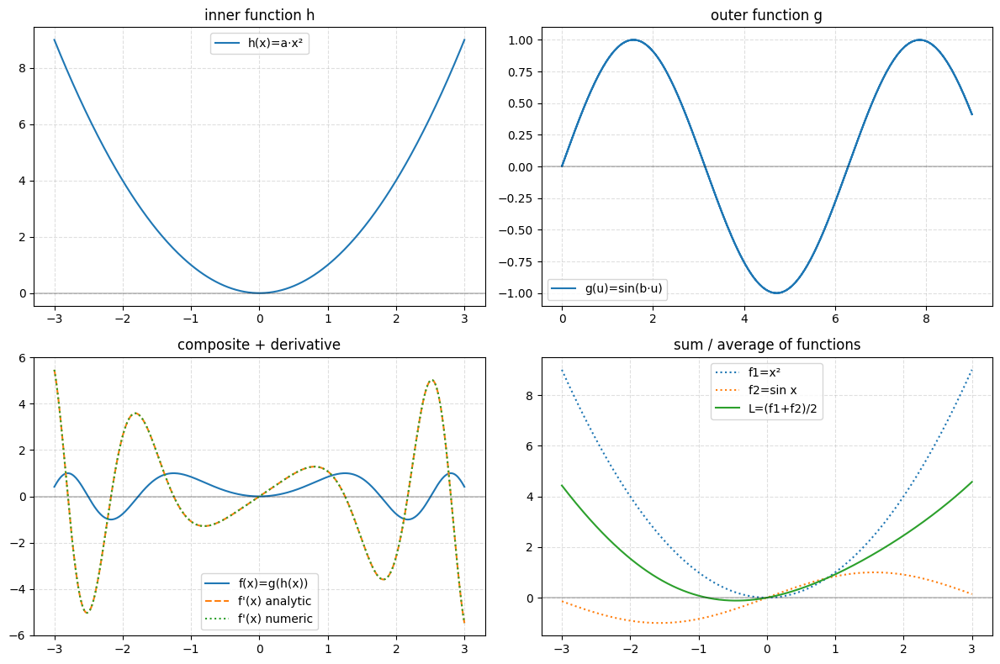

In [ ]:
# Foundations for back‑prop intuition: composition, sums and differentiability  
# You can run this cell as‑is, or tweak the parameters `a` and `b` below
# to see how everything changes.

import numpy as np
import matplotlib.pyplot as plt

# ---------- 1. pick parameters ----------
a = 1.0          # scales the inner (h) function
b = 1.0          # scales the outer (g) function
xmin, xmax = -3, 3
xs = np.linspace(xmin, xmax, 400)

# ---------- 2. define simple building‑block functions ----------
def h(x, a=a):
    """inner function (quadratic)"""
    return a * x**2                     # always differentiable

def g(u, b=b):
    """outer function (sine)"""
    return np.sin(b * u)                # always differentiable

def f(x, a=a, b=b):
    """composite f(x) = g(h(x))"""
    return g(h(x, a), b)

# analytic derivative via chain‑rule:  f'(x) = g'(h(x)) * h'(x)
def dh_dx(x, a=a):
    return 2 * a * x

def dg_du(u, b=b):
    return b * np.cos(b * u)

def df_dx_chain(x, a=a, b=b):
    return dg_du(h(x, a), b) * dh_dx(x, a)

# numeric derivative for sanity check
def df_dx_numeric(x, eps=1e-5):
    return (f(x + eps) - f(x - eps)) / (2 * eps)

# ---------- 3. another pair of functions for “sum / average” ----------
def f1(x):
    return x**2

def f2(x):
    return np.sin(x)

def L(x):
    return 0.5 * (f1(x) + f2(x))        # mean of two losses

# ---------- 4. plotting ----------
fig, axes = plt.subplots(2, 2, figsize=(12, 8))
ax = axes.ravel()

# (a) h(x) and g(u)
ax[0].plot(xs, h(xs), label='h(x)=a·x²')
ax[0].set_title("inner function h")
ax[0].legend()

u_vals = h(xs)
ax[1].plot(u_vals, g(u_vals), label='g(u)=sin(b·u)')
ax[1].set_title("outer function g")
ax[1].legend()

# (b) composite f and its derivative
ax[2].plot(xs, f(xs), label='f(x)=g(h(x))')
ax[2].plot(xs, df_dx_chain(xs), '--', label="f'(x) analytic")
ax[2].plot(xs, df_dx_numeric(xs), ':', label="f'(x) numeric")
ax[2].set_title("composite + derivative")
ax[2].legend()

# (c) sum / average loss
ax[3].plot(xs, f1(xs), ':', label='f1=x²')
ax[3].plot(xs, f2(xs), ':', label='f2=sin x')
ax[3].plot(xs, L(xs), label='L=(f1+f2)/2')
ax[3].set_title("sum / average of functions")
ax[3].legend()

for a in ax:
    a.axhline(0, color='black', linewidth=0.3)
    a.grid(ls='--', alpha=0.4)

plt.tight_layout()



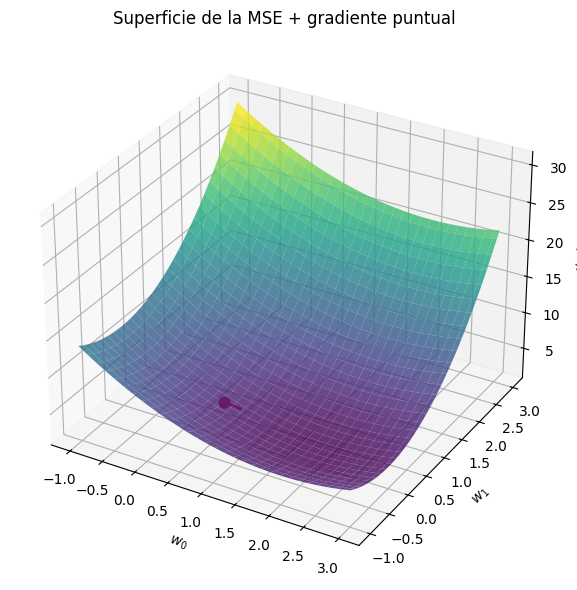

In [6]:
# %% [markdown]
# ## MSE “bowl” en 3‑D — juega cambiando `w0` y `w1`
#
# 1. **Ajusta** los valores en la sección “AJUSTA AQUÍ”.  
# 2. Ejecuta la celda:  
#    • Verás la superficie de pérdida \(J(w_0,w_1)\).  
#    • Un punto rojo marca tus pesos \((w_0,w_1)\).  
#    • Una flecha muestra la dirección de descenso ( − gradiente).

import numpy as np
import matplotlib.pyplot as plt

# ---------- 1. Datos de juguete ----------
x_data = np.array([-2, -1, 0, 1, 2], dtype=float)
y_data = np.array([ 4,  1, 0, 1, 4], dtype=float)   # y = x²

def mse(w0, w1, x=x_data, y=y_data):
    """
    Calcula J(w0,w1) para un array de w0 y w1 (broadcast seguro).
    """
    # w0, w1 pueden ser mallas 2‑D; agregamos eje nuevo para x
    y_hat = w0[..., None] + w1[..., None] * x
    return np.mean((y - y_hat)**2, axis=-1)

def grad_mse(w0, w1, x=x_data, y=y_data):
    """
    Gradiente analítico de la MSE para modelo lineal y datos 1‑D.
    """
    y_hat = w0 + w1 * x
    error  = y - y_hat
    g0 = -2 * np.mean(error)
    g1 = -2 * np.mean(error * x)
    return g0, g1

# ---------- 2. AJUSTA AQUÍ  ----------
w0 = 0.5   # intercepto
w1 = 0.1   # pendiente
# ------------------------------------

# ---------- malla para la superficie ----------
w0_vals = np.linspace(-1, 3, 60)
w1_vals = np.linspace(-1, 3, 60)
W0, W1   = np.meshgrid(w0_vals, w1_vals)
J        = mse(W0, W1)   # ahora funciona con broadcasting

# ---------- gráfico ----------
fig = plt.figure(figsize=(8, 6))
ax  = fig.add_subplot(111, projection='3d')
surf = ax.plot_surface(W0, W1, J, cmap='viridis', alpha=0.8, linewidth=0)

# punto actual y gradiente
j_val = mse(np.array(w0), np.array(w1))  # escalar
g0, g1 = grad_mse(w0, w1)
ax.scatter([w0], [w1], [j_val], color='crimson', s=60, depthshade=True)
ax.quiver(w0, w1, j_val,
          -g0, -g1, 0,
          length=0.3, normalize=True, color='crimson')

ax.set_xlabel('$w_0$')
ax.set_ylabel('$w_1$')
ax.set_zlabel('$J(w)$')
ax.set_title('Superficie de la MSE + gradiente puntual')

plt.tight_layout()



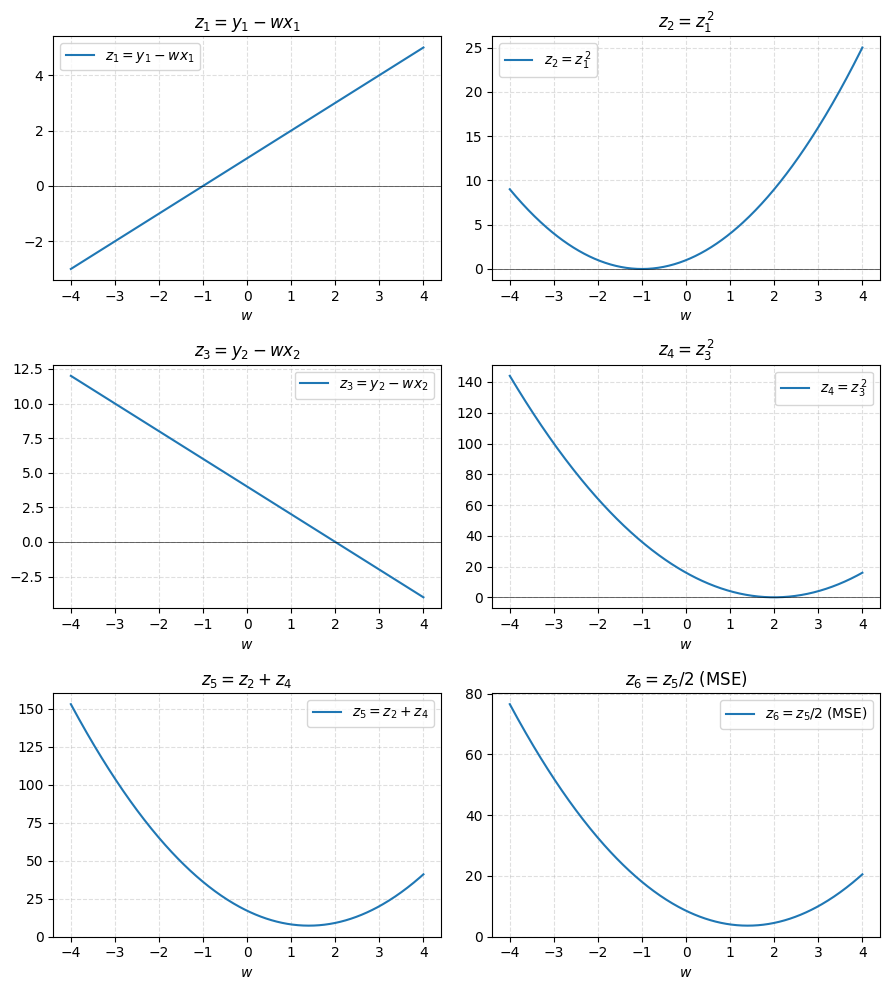

In [ ]:
# %% [markdown]
# # Paso a paso de una MSE con **n = 2** muestras
#
# Fijamos:
# - \(x_1 = -1,\; y_1 = 1\)
# - \(x_2 =  2,\; y_2 = 4\)
#
# Variables intermedias (cómputo hacia adelante):
#
# | Nombre | Expresión |
# |--------|-----------|
# | \(z_1\) | \(y_1 - w\,x_1\)               |
# | \(z_2\) | \(z_1^{\,2}\)                 |
# | \(z_3\) | \(y_2 - w\,x_2\)               |
# | \(z_4\) | \(z_3^{\,2}\)                 |
# | \(z_5\) | \(z_2 + z_4\)                  |
# | \(z_6\) | \(z_5 / n \quad (n=2)\)        |
#
# Veremos **6 gráficas** con cada función vs. `w`
# para tomar intuición de cómo la pérdida final (MSE) se va construyendo.

import numpy as np
import matplotlib.pyplot as plt

# ----- parámetros de los dos datos -----
x1, y1 = -1.0, 1.0
x2, y2 =  2.0, 4.0
n = 2

# rango de pesos
w = np.linspace(-4, 4, 400)

# variables intermedias
z1 = y1 - w * x1          # lineal
z2 = z1**2                # cuadrática
z3 = y2 - w * x2          # lineal
z4 = z3**2                # cuadrática
z5 = z2 + z4              # suma
z6 = z5 / n               # promedio → MSE

# ----- plotting -----
fig, axes = plt.subplots(3, 2, figsize=(9, 10))
ax = axes.ravel()  # flatten for easy indexing

titles = [
    r'$z_1 = y_1 - w x_1$',
    r'$z_2 = z_1^{\,2}$',
    r'$z_3 = y_2 - w x_2$',
    r'$z_4 = z_3^{\,2}$',
    r'$z_5 = z_2 + z_4$',
    r'$z_6 = z_5 / 2\;(\mathrm{MSE})$'
]
series = [z1, z2, z3, z4, z5, z6]

for a, title, s in zip(ax, titles, series):
    a.plot(w, s, label=title)
    a.set_title(title, fontsize=12)
    a.set_xlabel('$w$')
    a.grid(ls='--', alpha=0.4)
    # centre line for visual reference
    a.axhline(0, color='black', linewidth=0.4)
    a.legend()

plt.tight_layout()



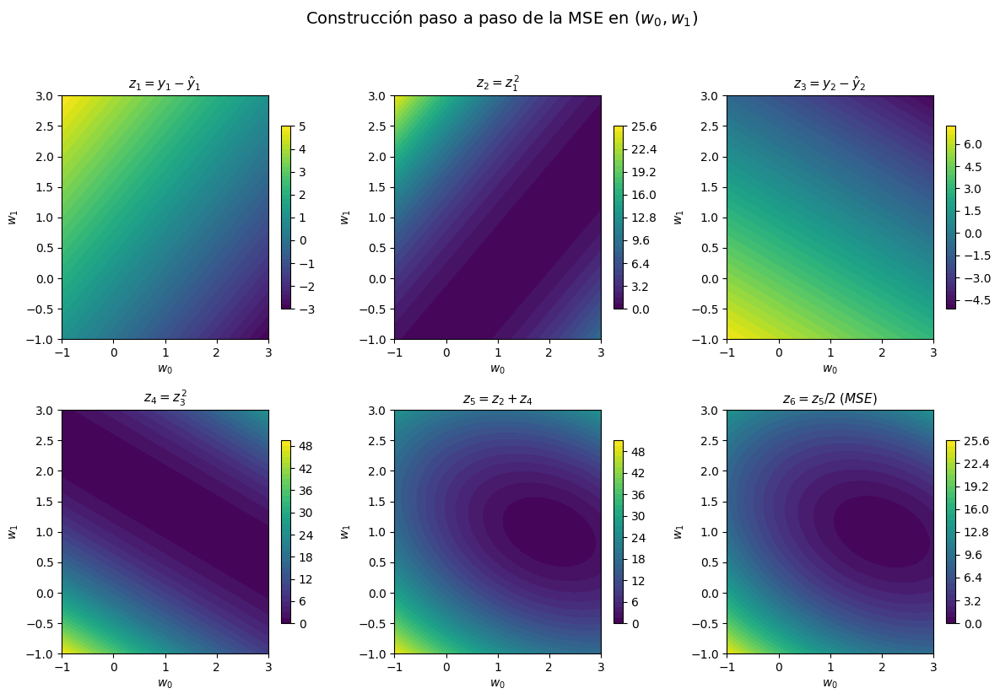

In [ ]:
# %% [markdown]
# # Cadena de funciones con **dos pesos** \(w_0,\;w_1\)  
# _(modelo lineal + MSE para n = 2 ejemplos)_
#
# Definimos
# \[
# \hat y_i = w_0 + w_1 x_i
# \]
# y reproducimos los pasos intermedios
# \[
# \begin{aligned}
# z_1 &= y_1-\hat y_1 &\qquad z_2 &= z_1^2 \\
# z_3 &= y_2-\hat y_2 &\qquad z_4 &= z_3^2 \\
# z_5 &= z_2+z_4 &\qquad z_6 &= \tfrac12 z_5
# \end{aligned}
# \]
# Visualizamos cada \(z_k(w_0,w_1)\) como un **mapa de colores** (contorno),
# para ver cómo se va formando la superficie “bowl” de la MSE.

import numpy as np
import matplotlib.pyplot as plt

# ---------- datos ----------
x1, y1 = -1.0, 1.0
x2, y2 =  2.0, 4.0
n = 2

# ---------- malla de pesos ----------
w0_vals = np.linspace(-1, 3, 200)
w1_vals = np.linspace(-1, 3, 200)
W0, W1  = np.meshgrid(w0_vals, w1_vals)

# ---------- variables intermedias ----------
Z1 = y1 - (W0 + W1 * x1)
Z2 = Z1**2
Z3 = y2 - (W0 + W1 * x2)
Z4 = Z3**2
Z5 = Z2 + Z4
Z6 = Z5 / n   # MSE

names = [
    r'$z_1 = y_1-\hat y_1$',
    r'$z_2 = z_1^{\,2}$',
    r'$z_3 = y_2-\hat y_2$',
    r'$z_4 = z_3^{\,2}$',
    r'$z_5 = z_2+z_4$',
    r'$z_6 = z_5/2\;(MSE)$'
]
fields = [Z1, Z2, Z3, Z4, Z5, Z6]

# ---------- plotting ----------
fig, axes = plt.subplots(2, 3, figsize=(12, 8))
axes = axes.ravel()

for ax, title, field in zip(axes, names, fields):
    c = ax.contourf(W0, W1, field, levels=40, cmap='viridis')
    fig.colorbar(c, ax=ax, shrink=0.75)
    ax.set_title(title, fontsize=11)
    ax.set_xlabel('$w_0$')
    ax.set_ylabel('$w_1$')

plt.suptitle('Construcción paso a paso de la MSE en $(w_0,w_1)$', fontsize=14, y=1.03)
plt.tight_layout()



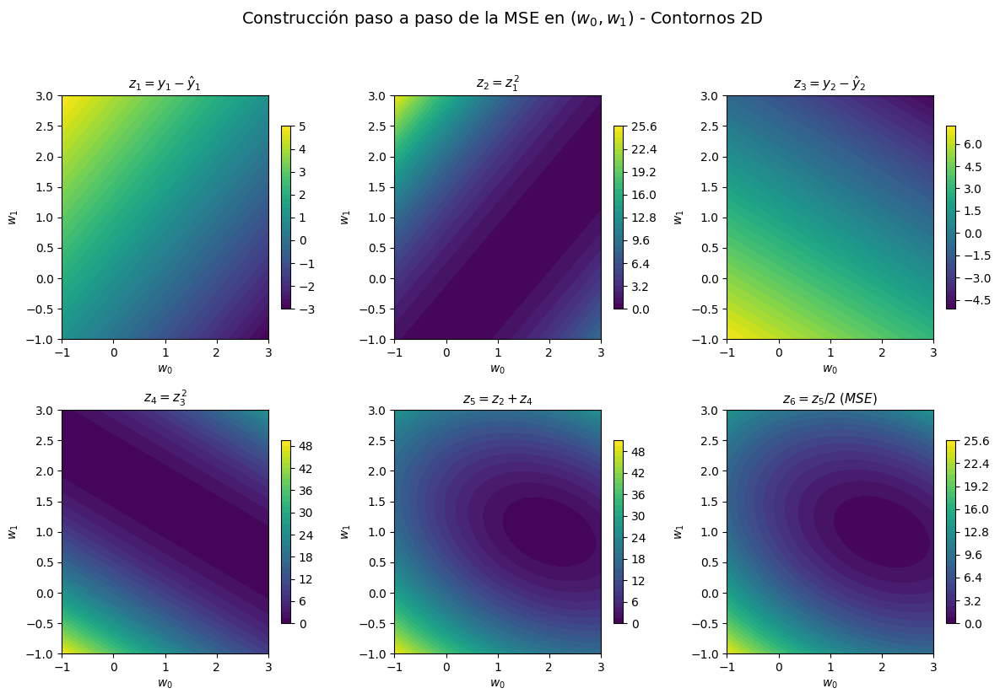

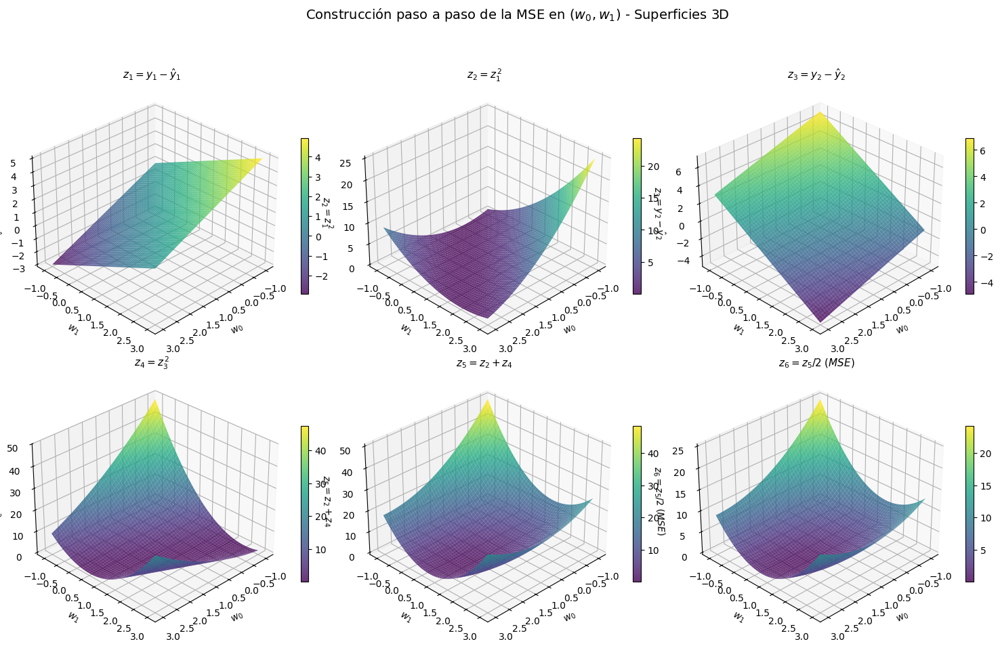

In [ ]:
# %% [markdown]
# # Cadena de funciones con **dos pesos** \(w_0,\;w_1\)  
# _(modelo lineal + MSE para n = 2 ejemplos)_
#
# Definimos
# \[
# \hat y_i = w_0 + w_1 x_i
# \]
# y reproducimos los pasos intermedios
# \[
# \begin{aligned}
# z_1 &= y_1-\hat y_1 &\qquad z_2 &= z_1^2 \\
# z_3 &= y_2-\hat y_2 &\qquad z_4 &= z_3^2 \\
# z_5 &= z_2+z_4 &\qquad z_6 &= \tfrac12 z_5
# \end{aligned}
# \]
# Visualizamos cada \(z_k(w_0,w_1)\) como un **mapa de colores** (contorno) y en 3D,
# para ver mejor cómo se va formando la superficie "bowl" de la MSE.

import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# ---------- datos ----------
x1, y1 = -1.0, 1.0
x2, y2 =  2.0, 4.0
n = 2

# ---------- malla de pesos ----------
w0_vals = np.linspace(-1, 3, 200)
w1_vals = np.linspace(-1, 3, 200)
W0, W1  = np.meshgrid(w0_vals, w1_vals)

# ---------- variables intermedias ----------
Z1 = y1 - (W0 + W1 * x1)
Z2 = Z1**2
Z3 = y2 - (W0 + W1 * x2)
Z4 = Z3**2
Z5 = Z2 + Z4
Z6 = Z5 / n   # MSE

names = [
    r'$z_1 = y_1-\hat y_1$',
    r'$z_2 = z_1^{\,2}$',
    r'$z_3 = y_2-\hat y_2$',
    r'$z_4 = z_3^{\,2}$',
    r'$z_5 = z_2+z_4$',
    r'$z_6 = z_5/2\;(MSE)$'
]
fields = [Z1, Z2, Z3, Z4, Z5, Z6]

# ---------- plotting 2D contours ----------
fig, axes = plt.subplots(2, 3, figsize=(12, 8))
axes = axes.ravel()

for ax, title, field in zip(axes, names, fields):
    c = ax.contourf(W0, W1, field, levels=40, cmap='viridis')
    fig.colorbar(c, ax=ax, shrink=0.75)
    ax.set_title(title, fontsize=11)
    ax.set_xlabel('$w_0$')
    ax.set_ylabel('$w_1$')

plt.suptitle('Construcción paso a paso de la MSE en $(w_0,w_1)$ - Contornos 2D', fontsize=14, y=1.03)
plt.tight_layout()

# ---------- plotting 3D surfaces ----------
fig = plt.figure(figsize=(15, 10))
fig.suptitle('Construcción paso a paso de la MSE en $(w_0,w_1)$ - Superficies 3D', fontsize=14, y=0.98)

for i, (title, field) in enumerate(zip(names, fields)):
    ax = fig.add_subplot(2, 3, i+1, projection='3d')
    surf = ax.plot_surface(W0, W1, field, cmap='viridis', alpha=0.8, 
                          linewidth=0, antialiased=True)
    fig.colorbar(surf, ax=ax, shrink=0.5)
    ax.set_title(title, fontsize=11)
    ax.set_xlabel('$w_0$')
    ax.set_ylabel('$w_1$')
    ax.set_zlabel(title)
    # Ajustar ángulo de vista para mejor visualización
    ax.view_init(elev=30, azim=45)

plt.tight_layout()
plt.subplots_adjust(top=0.9)


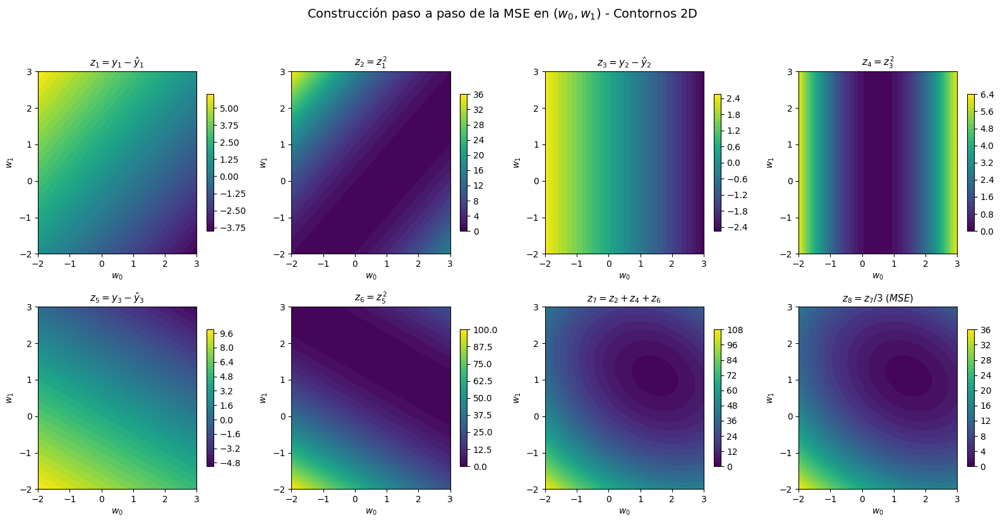

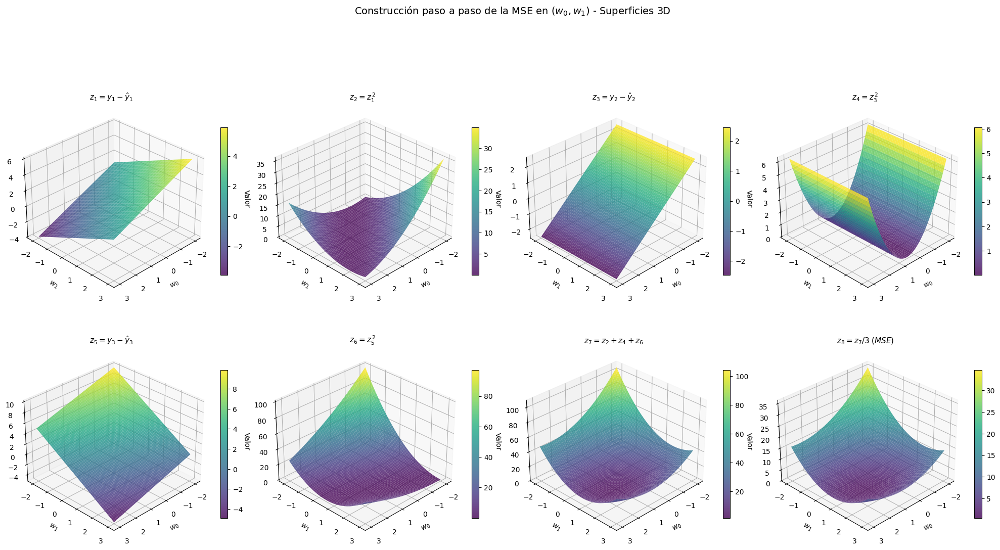

In [7]:
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Datos para 3 ejemplos (batch)
x_vals = np.array([-1.0, 0.0, 2.0])
y_vals = np.array([1.0, 0.5, 4.0])
n = len(x_vals)

# Malla de pesos w0 (bias) y w1 (peso)
w0_vals = np.linspace(-2, 3, 200)
w1_vals = np.linspace(-2, 3, 200)
W0, W1 = np.meshgrid(w0_vals, w1_vals)

# Variables intermedias para cada ejemplo
Z1 = y_vals[0] - (W0 + W1 * x_vals[0])  # error 1
Z2 = Z1**2                              # error^2 1
Z3 = y_vals[1] - (W0 + W1 * x_vals[1])  # error 2
Z4 = Z3**2                              # error^2 2
Z5 = y_vals[2] - (W0 + W1 * x_vals[2])  # error 3
Z6 = Z5**2                              # error^2 3

Z7 = Z2 + Z4 + Z6                       # suma de errores^2
Z8 = Z7 / n                             # MSE final

# Nombres y campos a graficar
names = [
    r'$z_1 = y_1-\hat y_1$', r'$z_2 = z_1^{\,2}$',
    r'$z_3 = y_2-\hat y_2$', r'$z_4 = z_3^{\,2}$',
    r'$z_5 = y_3-\hat y_3$', r'$z_6 = z_5^{\,2}$',
    r'$z_7 = z_2+z_4+z_6$', r'$z_8 = z_7/3\;(MSE)$'
]
fields = [Z1, Z2, Z3, Z4, Z5, Z6, Z7, Z8]

# Contornos 2D
fig, axes = plt.subplots(2, 4, figsize=(16, 8))
axes = axes.ravel()
for ax, title, field in zip(axes, names, fields):
    c = ax.contourf(W0, W1, field, levels=40, cmap='viridis')
    fig.colorbar(c, ax=ax, shrink=0.75)
    ax.set_title(title, fontsize=11)
    ax.set_xlabel('$w_0$')
    ax.set_ylabel('$w_1$')
plt.suptitle('Construcción paso a paso de la MSE en $(w_0,w_1)$ - Contornos 2D', fontsize=14, y=1.03)
plt.tight_layout()

# Superficies 3D
fig = plt.figure(figsize=(20, 12))
fig.suptitle('Construcción paso a paso de la MSE en $(w_0,w_1)$ - Superficies 3D', fontsize=14, y=0.98)
for i, (title, field) in enumerate(zip(names, fields)):
    ax = fig.add_subplot(2, 4, i+1, projection='3d')
    surf = ax.plot_surface(W0, W1, field, cmap='viridis', alpha=0.8, linewidth=0, antialiased=True)
    fig.colorbar(surf, ax=ax, shrink=0.5)
    ax.set_title(title, fontsize=11)
    ax.set_xlabel('$w_0$')
    ax.set_ylabel('$w_1$')
    ax.set_zlabel('Valor')
    ax.view_init(elev=30, azim=45)
plt.tight_layout()
plt.subplots_adjust(top=0.9)


## MSE con activacion (tanh)

Dataset:
x[0] = -3.000, y[0] = -0.500
x[1] = 4.000, y[1] = -0.000
x[2] = 1.000, y[2] = -2.000


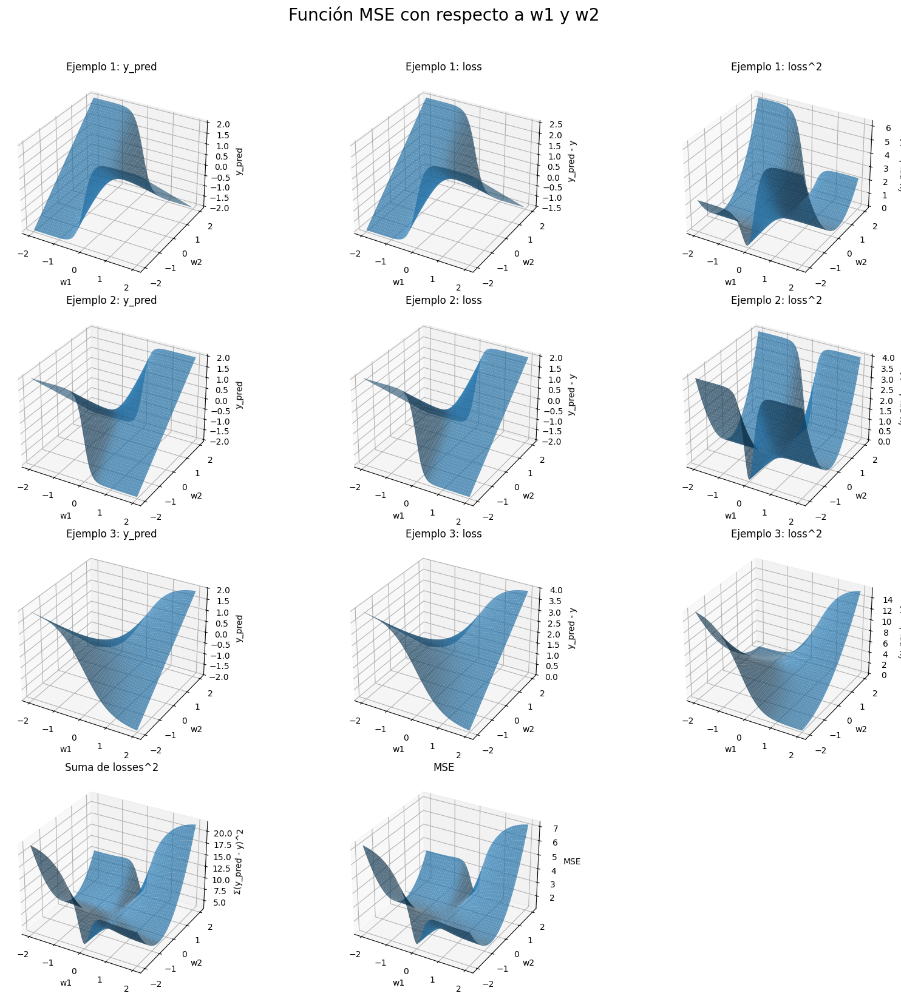

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Datos
x_data = np.array([-3.0, 4.0, 1.0])
y_data = np.array([-0.5, -0.0, -2])

# print the dataset
print("Dataset:")
for i in range(len(x_data)):
    print(f"x[{i}] = {x_data[i]:.3f}, y[{i}] = {y_data[i]:.3f}")

# Rejilla de pesos
w1 = np.linspace(-2, 2, 100)
w2 = np.linspace(-2, 2, 100)
W1, W2 = np.meshgrid(w1, w2)

# Cálculos
pred_list = [np.tanh(W1 * x) * W2 for x in x_data]
loss_list = [pred - y for pred, y in zip(pred_list, y_data)]
sq_loss_list = [loss**2 for loss in loss_list]
sum_sq = sum(sq_loss_list)
mse = sum_sq / len(x_data)

# Configuración de la grilla de plots
fig = plt.figure(figsize=(18, 16))
axs = [[fig.add_subplot(4, 3, i*3 + j + 1, projection='3d') for j in range(3)] for i in range(4)]
plt.suptitle('Función MSE con respecto a w1 y w2', fontsize=20, y=1.02)

# Tres primeras filas: cada ejemplo
for i in range(3):
    # Salida de la red
    axs[i][0].plot_surface(W1, W2, pred_list[i], alpha=0.7)
    axs[i][0].set_title(f'Ejemplo {i+1}: y_pred')
    axs[i][0].set_xlabel('w1'); axs[i][0].set_ylabel('w2'); axs[i][0].set_zlabel('y_pred')

    # Loss individual
    axs[i][1].plot_surface(W1, W2, loss_list[i], alpha=0.7)
    axs[i][1].set_title(f'Ejemplo {i+1}: loss')
    axs[i][1].set_xlabel('w1'); axs[i][1].set_ylabel('w2'); axs[i][1].set_zlabel('y_pred - y')

    # Loss al cuadrado
    axs[i][2].plot_surface(W1, W2, sq_loss_list[i], alpha=0.7)
    axs[i][2].set_title(f'Ejemplo {i+1}: loss^2')
    axs[i][2].set_xlabel('w1'); axs[i][2].set_ylabel('w2'); axs[i][2].set_zlabel('(y_pred - y)^2')

# Última fila: suma de losses cuadradas y MSE
# Suma de squared losses
axs[3][0].plot_surface(W1, W2, sum_sq, alpha=0.7)
axs[3][0].set_title('Suma de losses^2')
axs[3][0].set_xlabel('w1'); axs[3][0].set_ylabel('w2'); axs[3][0].set_zlabel('Σ(y_pred - y)^2')

# MSE
axs[3][1].plot_surface(W1, W2, mse, alpha=0.7)
axs[3][1].set_title('MSE')
axs[3][1].set_xlabel('w1'); axs[3][1].set_ylabel('w2'); axs[3][1].set_zlabel('MSE')

# Subplot vacío
axs[3][2].axis('off')

plt.tight_layout()
plt.show()



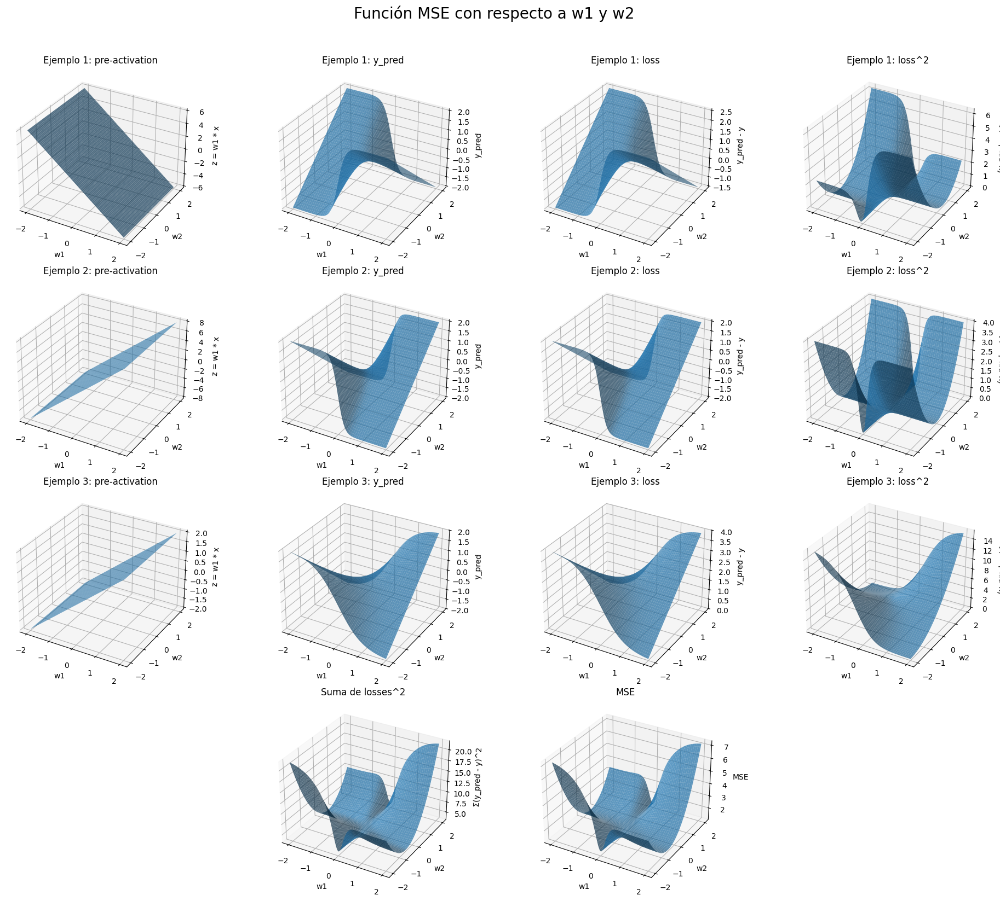

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Datos
x_data = np.array([-3.0, 4.0, 1.0])
y_data = np.array([-0.5, -0.0, -2])

# Rejilla de pesos
w1 = np.linspace(-2, 2, 100)
w2 = np.linspace(-2, 2, 100)
W1, W2 = np.meshgrid(w1, w2)

# Cálculos
pre_act_list = [W1 * x for x in x_data]                      # Pre-activación (antes de tanh)
pred_list = [np.tanh(pre) * W2 for pre in pre_act_list]     # Salida de la red
loss_list = [pred - y for pred, y in zip(pred_list, y_data)]
sq_loss_list = [loss**2 for loss in loss_list]
sum_sq = sum(sq_loss_list)
mse = sum_sq / len(x_data)

# Configuración de la grilla de plots 4x4
fig = plt.figure(figsize=(20, 16))
axs = [[fig.add_subplot(4, 4, i*4 + j + 1, projection='3d') for j in range(4)] for i in range(4)]
plt.suptitle('Función MSE con respecto a w1 y w2', fontsize=20, y=1.02)

# Filas 1-3: Ejemplos 1,2,3
for i in range(3):
    # Columna 0: pre-activación
    axs[i][0].plot_surface(W1, W2, pre_act_list[i], alpha=0.7)
    axs[i][0].set_title(f'Ejemplo {i+1}: pre-activation')
    axs[i][0].set_xlabel('w1'); axs[i][0].set_ylabel('w2'); axs[i][0].set_zlabel('z = w1 * x')

    # Columna 1: salida de la red
    axs[i][1].plot_surface(W1, W2, pred_list[i], alpha=0.7)
    axs[i][1].set_title(f'Ejemplo {i+1}: y_pred')
    axs[i][1].set_xlabel('w1'); axs[i][1].set_ylabel('w2'); axs[i][1].set_zlabel('y_pred')

    # Columna 2: loss individual
    axs[i][2].plot_surface(W1, W2, loss_list[i], alpha=0.7)
    axs[i][2].set_title(f'Ejemplo {i+1}: loss')
    axs[i][2].set_xlabel('w1'); axs[i][2].set_ylabel('w2'); axs[i][2].set_zlabel('y_pred - y')

    # Columna 3: loss al cuadrado
    axs[i][3].plot_surface(W1, W2, sq_loss_list[i], alpha=0.7)
    axs[i][3].set_title(f'Ejemplo {i+1}: loss^2')
    axs[i][3].set_xlabel('w1'); axs[i][3].set_ylabel('w2'); axs[i][3].set_zlabel('(y_pred - y)^2')

# Fila 4: Suma de losses^2 y MSE
# Columna 0 vacía
axs[3][0].axis('off')

# Columna 1: suma de losses^2
axs[3][1].plot_surface(W1, W2, sum_sq, alpha=0.7)
axs[3][1].set_title('Suma de losses^2')
axs[3][1].set_xlabel('w1'); axs[3][1].set_ylabel('w2'); axs[3][1].set_zlabel('Σ(y_pred - y)^2')

# Columna 2: MSE
axs[3][2].plot_surface(W1, W2, mse, alpha=0.7)
axs[3][2].set_title('MSE')
axs[3][2].set_xlabel('w1'); axs[3][2].set_ylabel('w2'); axs[3][2].set_zlabel('MSE')

# Columna 3 vacía
axs[3][3].axis('off')

plt.tight_layout()
plt.show()


### Los datos cambian la loss

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec




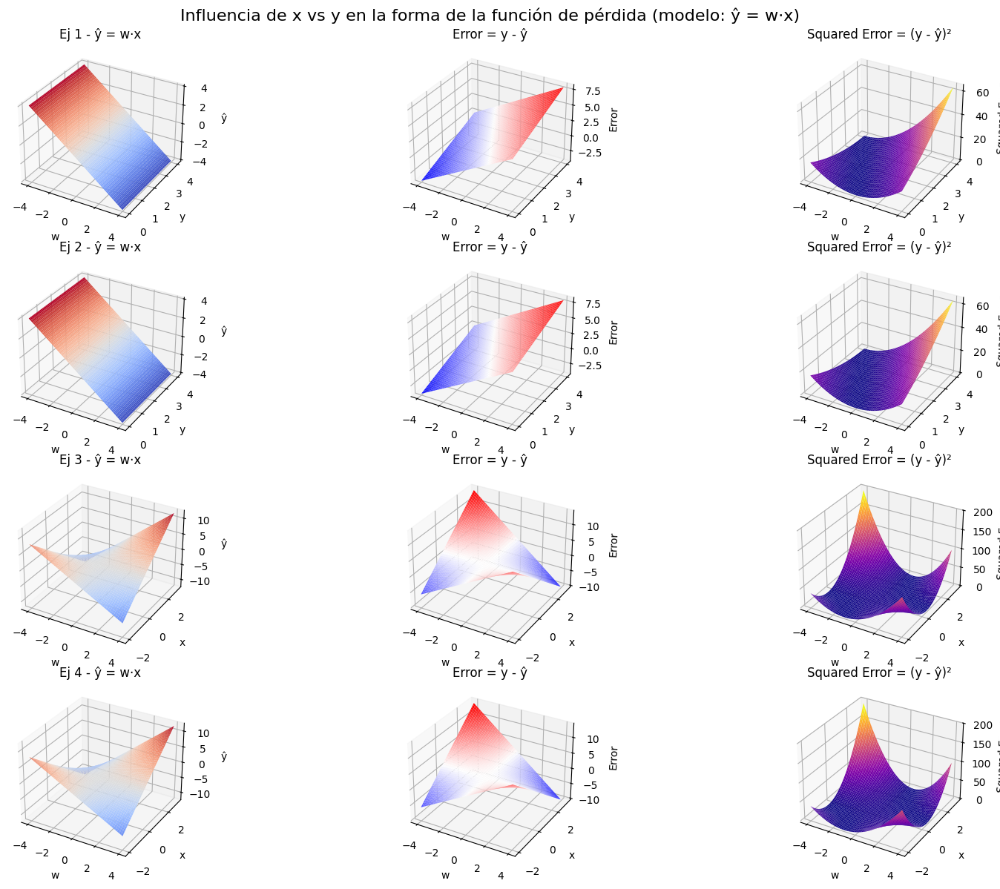

In [11]:
from mpl_toolkits.mplot3d import Axes3D

# Crear una figura con subplots 3D para cada paso, por ejemplo
fig = plt.figure(figsize=(18, 12))
gs = gridspec.GridSpec(4, 3)



# Repetimos cada paso pero en 3D: eje x = w, eje y = y o x, eje z = valor

for i, ex in enumerate(examples):
    x = ex["x"]
    y = ex["y"]
    
    # Creamos rejilla para visualizar 3D: eje horizontal es w, vertical será x o y dependiendo del caso
    W = np.tile(w_vals, (len(w_vals), 1))
    if i in [0, 1]:  # mismos x, variamos y
        Y = np.linspace(0, 4, len(w_vals)).reshape(-1, 1)
        X = np.full_like(W, x)
    else:  # mismos y, variamos x
        X = np.linspace(-2, 3, len(w_vals)).reshape(-1, 1)
        Y = np.full_like(W, y)

    Y_hat = W * X
    Error = Y - Y_hat
    Sq_Error = Error ** 2

    # Panel 1: y_hat
    ax1 = fig.add_subplot(gs[i, 0], projection='3d')
    ax1.plot_surface(W, Y if i < 2 else X, Y_hat, cmap='coolwarm', edgecolor='none')
    ax1.set_title(f"Ej {i+1} - ŷ = w·x")
    ax1.set_xlabel("w")
    ax1.set_ylabel("y" if i < 2 else "x")
    ax1.set_zlabel("ŷ")

    # Panel 2: error
    ax2 = fig.add_subplot(gs[i, 1], projection='3d')
    ax2.plot_surface(W, Y if i < 2 else X, Error, cmap='bwr', edgecolor='none')
    ax2.set_title("Error = y - ŷ")
    ax2.set_xlabel("w")
    ax2.set_ylabel("y" if i < 2 else "x")
    ax2.set_zlabel("Error")

    # Panel 3: squared error
    ax3 = fig.add_subplot(gs[i, 2], projection='3d')
    ax3.plot_surface(W, Y if i < 2 else X, Sq_Error, cmap='plasma', edgecolor='none')
    ax3.set_title("Squared Error = (y - ŷ)²")
    ax3.set_xlabel("w")
    ax3.set_ylabel("y" if i < 2 else "x")
    ax3.set_zlabel("Squared Error")

plt.suptitle("Influencia de x vs y en la forma de la función de pérdida (modelo: ŷ = w·x)", fontsize=16)
plt.tight_layout()
plt.show()


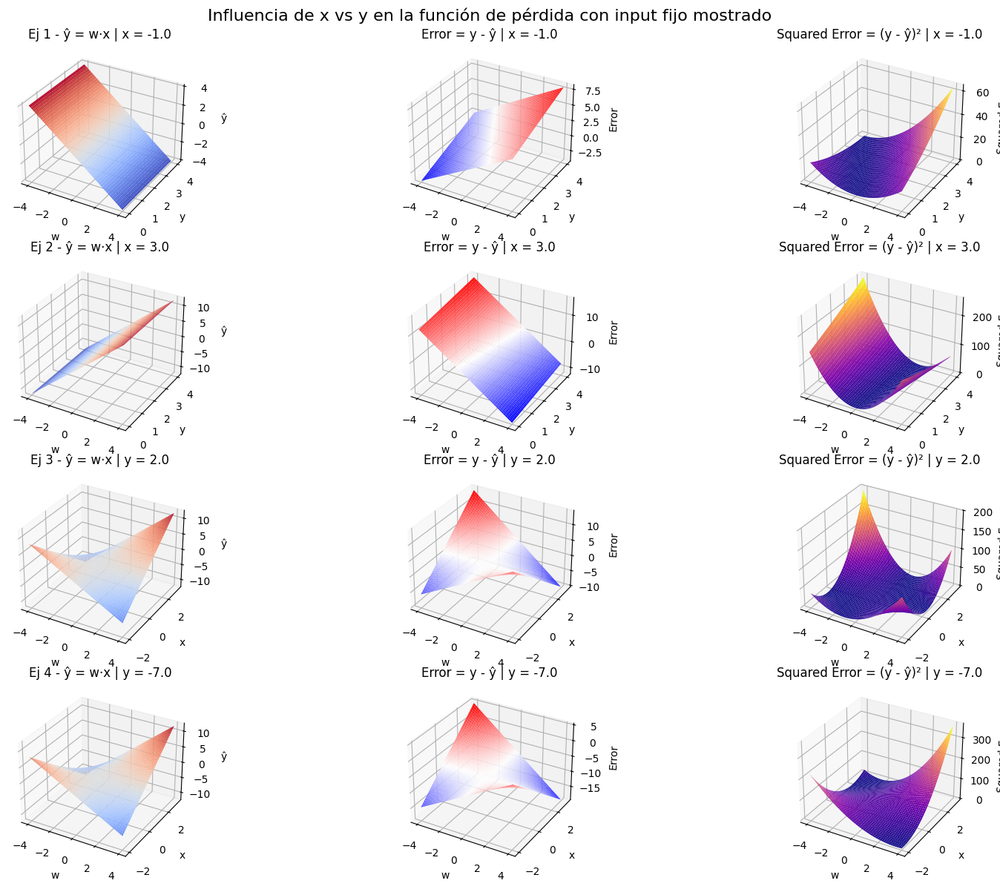

In [17]:
# Crear una figura con subplots 3D para cada paso, incluyendo el valor del otro input en el título
fig = plt.figure(figsize=(18, 12))
gs = gridspec.GridSpec(4, 3)

# Definir 4 ejemplos según tu criterio
examples = [
    {"x": -1.0, "y": 1.0},
    {"x": 3.0, "y": 2.5},  # mismo x que el ejemplo 1
    {"x": 0.5,  "y": 2.0},
    {"x": 2.5,  "y": -7.0},  # mismo y que el ejemplo 3
]

# Rango de valores para w
w_vals = np.linspace(-4, 4, 300)

for i, ex in enumerate(examples):
    x = ex["x"]
    y = ex["y"]
    
    # Crear rejilla para w y x/y según corresponda
    W = np.tile(w_vals, (len(w_vals), 1))
    if i in [0, 1]:  # mismos x, variamos y
        Y = np.linspace(0, 4, len(w_vals)).reshape(-1, 1)
        X = np.full_like(W, x)
        label_other = f"x = {x}"
    else:  # mismos y, variamos x
        X = np.linspace(-2, 3, len(w_vals)).reshape(-1, 1)
        Y = np.full_like(W, y)
        label_other = f"y = {y}"

    Y_hat = W * X
    Error = Y - Y_hat
    Sq_Error = Error ** 2

    # Panel 1: y_hat
    ax1 = fig.add_subplot(gs[i, 0], projection='3d')
    ax1.plot_surface(W, Y if i < 2 else X, Y_hat, cmap='coolwarm', edgecolor='none')
    ax1.set_title(f"Ej {i+1} - ŷ = w·x | {label_other}")
    ax1.set_xlabel("w")
    ax1.set_ylabel("y" if i < 2 else "x")
    ax1.set_zlabel("ŷ")

    # Panel 2: error
    ax2 = fig.add_subplot(gs[i, 1], projection='3d')
    ax2.plot_surface(W, Y if i < 2 else X, Error, cmap='bwr', edgecolor='none')
    ax2.set_title(f"Error = y - ŷ | {label_other}")
    ax2.set_xlabel("w")
    ax2.set_ylabel("y" if i < 2 else "x")
    ax2.set_zlabel("Error")

    # Panel 3: squared error
    ax3 = fig.add_subplot(gs[i, 2], projection='3d')
    ax3.plot_surface(W, Y if i < 2 else X, Sq_Error, cmap='plasma', edgecolor='none')
    ax3.set_title(f"Squared Error = (y - ŷ)² | {label_other}")
    ax3.set_xlabel("w")
    ax3.set_ylabel("y" if i < 2 else "x")
    ax3.set_zlabel("Squared Error")

plt.suptitle("Influencia de x vs y en la función de pérdida con input fijo mostrado", fontsize=16)
plt.tight_layout()
plt.show()


## Cross-entropy (log loss)

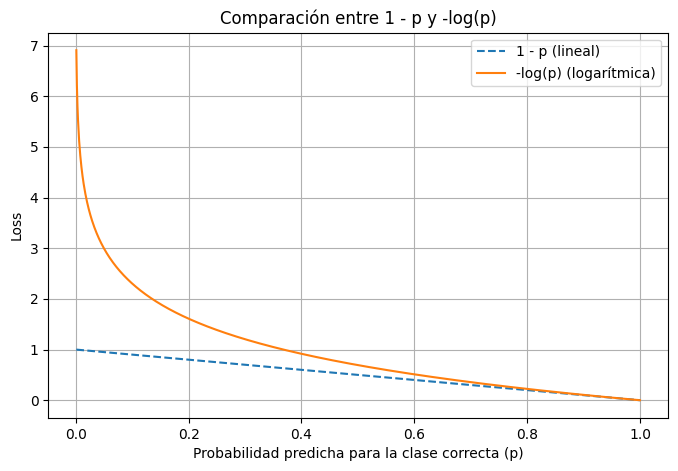

In [93]:
import numpy as np
import matplotlib.pyplot as plt

# Probabilidades de 0.001 a 1
p = np.linspace(0.001, 1, 1000)

# Dos funciones de pérdida
loss_1_minus_p = 1 - p
loss_log = -np.log(p)

plt.figure(figsize=(8, 5))
plt.plot(p, loss_1_minus_p, label="1 - p (lineal)", linestyle='--')
plt.plot(p, loss_log, label="-log(p) (logarítmica)")

plt.xlabel("Probabilidad predicha para la clase correcta (p)")
plt.ylabel("Loss")
plt.title("Comparación entre 1 - p y -log(p)")
plt.legend()
plt.grid(True)
plt.show()


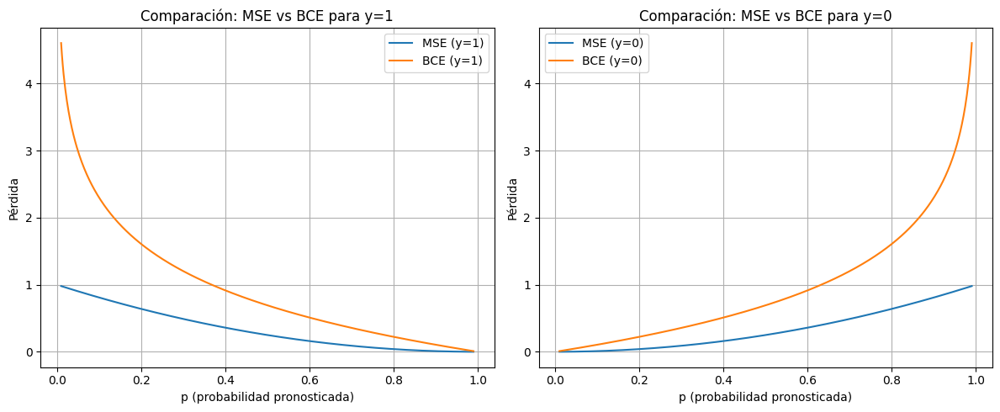

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# Definimos un rango de probabilidades predichas (p) entre 0.01 y 0.99
p = np.linspace(0.01, 0.99, 500)

# Etiquetas verdaderas para y=1 y y=0
y1 = np.ones_like(p)
y0 = np.zeros_like(p)

# Cálculo de MSE para y=1 y y=0
mse_y1 = (y1 - p) ** 2
mse_y0 = (y0 - p) ** 2

# Cálculo de Binary Cross-Entropy (BCE) para y=1 y y=0
bce_y1 = - (y1 * np.log(p) + (1 - y1) * np.log(1 - p))
bce_y0 = - (y0 * np.log(p) + (1 - y0) * np.log(1 - p))

# Creamos la figura con dos subplots: uno para el caso y=1 y otro para y=0
plt.figure(figsize=(12, 5))

# Subplot para y=1
plt.subplot(1, 2, 1)
plt.plot(p, mse_y1, label='MSE (y=1)')
plt.plot(p, bce_y1, label='BCE (y=1)')
plt.xlabel('p (probabilidad pronosticada)')
plt.ylabel('Pérdida')
plt.title('Comparación: MSE vs BCE para y=1')
plt.legend()
plt.grid(True)

# Subplot para y=0
plt.subplot(1, 2, 2)
plt.plot(p, mse_y0, label='MSE (y=0)')
plt.plot(p, bce_y0, label='BCE (y=0)')
plt.xlabel('p (probabilidad pronosticada)')
plt.ylabel('Pérdida')
plt.title('Comparación: MSE vs BCE para y=0')
plt.legend()
plt.grid(True)

plt.tight_layout()
plt.show()


CLASIFICACION -> a diferencia de usar MSE como en regresion

**1. Contexto general**
En estos gráficos comparamos dos maneras de medir “qué tan mal” lo está haciendo un modelo de clasificación binaria:

* **MSE (Mean Squared Error):** $\;(y - p)^2$.
* **BCE (Binary Cross-Entropy):**

  $$
    -\Bigl[y \log(p) + (1-y)\log(1-p)\Bigr].
  $$

Aquí, $p$ es la probabilidad que el modelo asigna a la etiqueta “1” (por ejemplo, “es un perro”). La variable $y$ es la etiqueta real:

* $y = 1$ si la muestra sí tiene perro.
* $y = 0$ si la muestra no tiene perro.

En el eje horizontal de ambos gráficos está $p$, que va de 0.01 a 0.99 (es decir, de “modelo casi seguro de que NO es perro” hasta “modelo casi seguro de que SÍ es perro”). En el eje vertical está la pérdida (o “qué tan castigado” sale el modelo) según MSE y según BCE. Cada curva nos dice: “si el modelo predice $p$, ¿cuánto le estoy penalizando?”

---

**2. Gráfico izquierdo: caso $y = 1$**
En este primer gráfico estamos “en realidad sí hay perro” ($y=1$) y variamos $p$ para ver cómo castigamos:

* **Cuando $p$ está cerca de 1** (izquierda del eje, p ≈ 0.9 o 0.99):

  * El modelo está prácticamente acertando y bastante seguro de que es perro.
  * **MSE:** $(1 - 0.99)^2 = 0.0001$ (casi cero).
  * **BCE:** $-\log(0.99) \approx 0.01$ (también muy pequeño).
  * Ambos castigan muy poco porque el modelo estuvo correcto y muy “confiado”.

* **Cuando $p$ baja hacia 0.5**:

  * El modelo se está volviendo incierto (confianza del 50%).
  * **MSE:** $(1 - 0.5)^2 = 0.25$.
  * **BCE:** $-\log(0.5) ≈ 0.69$.
  * Aquí BCE ya empieza a castigar un poco más, porque la probabilidad “0.5” equivale a “no sé si es perro o no”.
  * MSE crece de forma cuadrática, pero más suave que BCE en estos valores intermedios.

* **Cuando $p$ se acerca a 0** (el modelo piensa con casi total seguridad que NO es perro, pero en realidad sí lo es):

  * **MSE:** $(1 - 0.01)^2 = 0.9801$. Este valor es grande, sí, pero no llega a valores estratosféricos.
  * **BCE:** $-\log(0.01) ≈ 4.60$. ¡Esto es un castigo enorme!
  * **Interpretación:** Si el modelo está muy “equivocado con seguridad” (predice $p$ muy cercano a 0 cuando en realidad es 1), la entropía cruzada lo penaliza muchísimo más que MSE. Esto fuerza al modelo a corregir con fuerza sus parámetros y evitar quedarse en esa zona extrema donde está convencido y equivocado.

En el gráfico, verás que la curva naranja (BCE) se dispara hacia arriba de manera casi exponencial a medida que $p \to 0$, mientras que la curva amarilla (MSE) sube más lento y “apenas” toca valores alrededor de 1.

---

**3. Gráfico derecho: caso $y = 0$**
Ahora estamos “en realidad NO hay perro” ($y=0$), y volvemos a variar $p$ –la probabilidad que el modelo asigna a “sí hay perro”– para ver cuánto castigan las pérdidas:

* **Cuando $p$ está cerca de 0** (el modelo acierta, pues dice “casi 0% de probabilidad de perro”):

  * **MSE:** $(0 - 0.01)^2 = 0.0001$.
  * **BCE:** $-\log(1 - 0.01) = -\log(0.99) ≈ 0.01$.
  * Ambas pérdidas son muy pequeñas porque el modelo estuvo confiado y correcto.

* **Cuando $p$ sube hacia 0.5**:

  * El modelo está “indeciso” (50% de probabilidad de perro).
  * **MSE:** $(0 - 0.5)^2 = 0.25$.
  * **BCE:** $-\log(1 - 0.5) = -\log(0.5) ≈ 0.69$.
  * De nuevo, BCE castiga un poco más que MSE cuando el modelo está poco seguro.

* **Cuando $p$ se acerca a 1** (el modelo está muy convencido de que SÍ hay perro, pero en realidad NO lo hay):

  * **MSE:** $(0 - 0.99)^2 ≈ 0.98$.
  * **BCE:** $-\log(1 - 0.99) = -\log(0.01) ≈ 4.60$.
  * Igual que antes, BCE crece explosivamente, mientras que MSE permanece en un rango cercano a 1.

Por tanto, en este gráfico de $y=0$ la curva naranja (BCE) vuelve a dispararse cuando $p \to 1$, penalizando muchísimo las predicciones “muy confiadas pero erróneas”. La curva amarilla (MSE) sube también, pero de forma suave.

---

**4. ¿Qué aprendemos de estos gráficos?**

1. **Penalización suave vs. fuerte**

   * Cuando el modelo hace una predicción equivocada **pero moderadamente equivocada** (por ejemplo, $p=0.5$ cuando debería ser $y=1$ o cuando $y=0$), la diferencia entre BCE y MSE no es brutal: ambas pérdidas están en el rango de 0.25–0.7.
   * Sin embargo, **cuando la equivocación es “confiada y extrema”** (por ejemplo, el modelo cree que la probabilidad de perro es 0.01 en lugar de 1, o cree 0.99 cuando debería ser 0), la BCE va a valores alrededor de 4.6 (en estos ejemplos), mientras que la MSE apenas llega a \~0.98.

2. **Impacto en el aprendizaje (gradientes)**

   * A la hora de actualizar parámetros, el modelo ajusta sus pesos según la derivada de la función de pérdida.
   * **Con MSE y la capa sigmoide** (o softmax en multiclasificación), los gradientes en regiones donde $p$ es muy cercano a 0 o 1 son muy pequeños (efecto de saturación de la sigmoide). Esto significa que, si el modelo está muy seguro y equivocado (por ejemplo, produce $p = 0.01$ o $p = 0.99$ cuando no corresponde), la derivada $\frac{\partial (y - p)^2}{\partial p} = 2(p - y)$ puede ser grande, pero la derivada de la sigmoide $\sigma'(z) = p(1-p)$ es extremadamente pequeña en esos extremos; el producto final es un gradiente diminuto, por lo que el modelo “no aprende rápido” a corregir ese error.
   * **Con BCE y la capa sigmoide**, la derivada de la pérdida respecto a $z$ se simplifica en $(p - y)$. Es decir, la entropía cruzada “anula” el factor $p(1-p)$ de la derivada de la sigmoide (para clasificación binaria). Como resultado, **incluso cuando $p$ está muy cerca de 0 o 1, el gradiente sigue siendo grande si $y$ es distinto**, forzando un ajuste vigoroso de los pesos.

3. **Conclusión clara**

   * **MSE no incentiva el modelo a “salir rápido” de las regiones de confianza equivocada**, porque sus gradientes se vuelven muy pequeños cuando las predicciones $p$ están cerca de 0 o 1.
   * **BCE castiga de manera exponencial** a las predicciones muy seguras y equivocadas, y **mantiene gradientes significativos** para corregir con rapidez esos errores, incluso en los extremos.
   * Por esto, **en problemas de clasificación (binaria o multiclase), la entropía cruzada es la función de pérdida estándar**: guía el aprendizaje de forma más estable y eficiente, asegurando que el modelo “aprenda rápido” si está muy convencido y equivocado.


### El rol de log

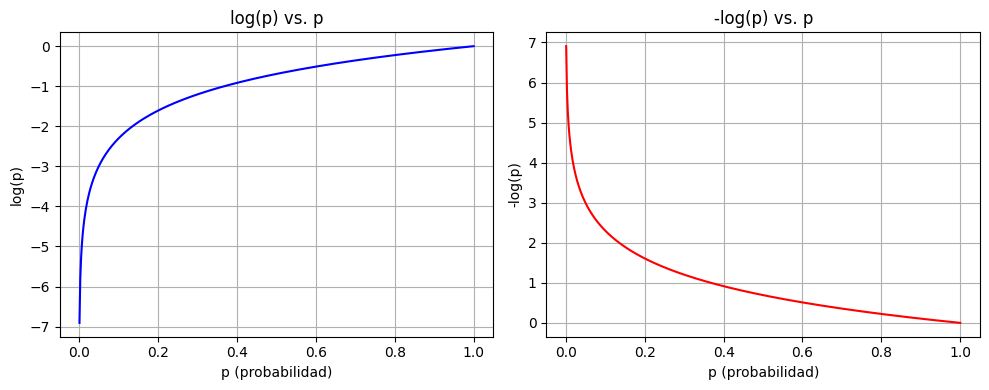

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# Definir rango de probabilidades de 0.001 a 1
p = np.linspace(0.001, 1, 500)

# Calcular log(p) y -log(p)
log_p = np.log(p)
neg_log_p = -np.log(p)

# Crear figura con dos subplots
plt.figure(figsize=(10, 4))

# Subplot 1: log(p) vs p
plt.subplot(1, 2, 1)
plt.plot(p, log_p, color='blue')
plt.xlabel('p (probabilidad)')
plt.ylabel('log(p)')
plt.title('log(p) vs. p')
plt.grid(True)

# Subplot 2: -log(p) vs p
plt.subplot(1, 2, 2)
plt.plot(p, neg_log_p, color='red')
plt.xlabel('p (probabilidad)')
plt.ylabel('-log(p)')
plt.title('-log(p) vs. p')
plt.grid(True)

plt.tight_layout()
plt.show()


**Explicación breve e intuitiva:**

1. **¿Qué hace log(p)?**

   * Cuando $p$ es cercano a 1, $\log(p)$ está cerca de 0 (baja “sorpresa”).
   * Cuando $p$ es pequeño ($p\ll1$), $\log(p)$ se hace muy negativo (gran “sorpresa”).
   * El gráfico azul muestra que al bajar $p$ de 1 a 0, $\log(p)$ pasa de 0 a $ -\infty$, pero lo hace de forma suave, primero cae rápido y luego tiende a $-\infty$ al final.

2. **¿Por qué usar $-\log(p)$?**

   * Si un evento de probabilidad $p$ sucede realmente, queremos convertir esa “probabilidad” en un “coste” o “pérdida”.
   * $-\log(p)$ (curva roja) asigna:

     * **Poco coste** cuando $p$ está cerca de 1, porque $-\log(0.9)\approx 0.105$.
     * **Coste enorme** cuando $p$ está muy cerca de 0, porque $-\log(0.01)\approx 4.6$.
   * Esto refleja “si algo improbabilísimo ocurre, castíguenlo fuerte”.

3. **Aplicación en pérdida de clasificación (BCE):**

   * Cuando la etiqueta es 1 y el modelo predice probabilidad $p$ de “1”, la pérdida es $-\log(p)$.
   * Cuando la etiqueta es 0 y el modelo predice $p$ de “1”, la pérdida es $-\log(1 - p)$.
   * Gracias a que el log expande el rango para $p$ pequeños, **un error muy confiado** (por ejemplo, $p=0.01$ cuando debería ser 1) recibe un castigo grande y produce gradientes fuertes que corrigen rápido al modelo.

4. **Resumen visual:**

   * En el gráfico derecho, nota cómo $-\log(p)$ (rojo) “explota” cuando $p\to0$, mientras que $\log(p)$ (azul) simplemente baja a valores muy negativos.
   * Esa “explosión” es la razón por la que, en clasificación, convertir $p$ a $-\log(p)$ nos da una pérdida que obliga a ajustar con urgencia cuando el modelo se equivoca con alta confianza.

Con estos dos gráficos queda claro que **el log cambia la escala de probabilidades** para hacer crecer mucho el castigo de eventos improbables, y por eso se usa en la función de pérdida (BCE) en lugar de “medir distancia” de otra forma.


POR QUE NO USAR CROSS ENTROPY EN REGRESION ENTONCES?

Aunque la predicción esté acotada a \[0, 1], **si el “target” es un valor continuo**, BCE (-log p) no captura bien el error de distancia numérica.

* **BCE asume que el target es la probabilidad de una etiqueta binaria** (0 o 1), o como “etiqueta difusa” en \[0, 1] interpretada como probabilidad.

  * Ejemplo: si el target fuese 0.7, BCE lo trataría como “70 % de probabilidad de etiqueta 1” en un Bernoulli, no como “el número 0.7 exacto” que queremos predecir.

* **Usar BCE con target continuo tiende a forzar la predicción a valores “extremos” (0 o 1)** en vez de acercarla linealmente a 0.7. Eso hace que:

  1. Si predices 0.5 y el target es 0.7, BCE = $-[0.7·\log(0.5)+0.3·\log(0.5)]\approx0.69$.
  2. Si predices 0.9 para ese mismo target 0.7, BCE = $-[0.7·\log(0.9)+0.3·\log(0.1)]\approx1.20$ (peor), aunque 0.9 está “numéricamente más cerca” de 0.7 que 0.5.

Con **MSE** en cambio:

* Si target=0.7 y tú predices 0.5, MSE=(0.7–0.5)²=0.04.
* Si predices 0.9, MSE=(0.7–0.9)²=0.04.
  Ambas predicciones equidistan de 0.7 y reciben el mismo castigo, reflejando la distancia real.

**Conclusión:**

* BCE (–log p) “mide sorpresa” de eventos binarios o probabilidades de etiquetas, no la cercanía de números continuos.
* Aunque la salida esté en \[0, 1], si el objetivo es un valor real, usa MSE (o MAE). Si quisiéramos forzar un modelo probabilístico con datos en \[0, 1], habría que usar una distribución continua apropiada (por ejemplo, Beta loss), pero no BCE.


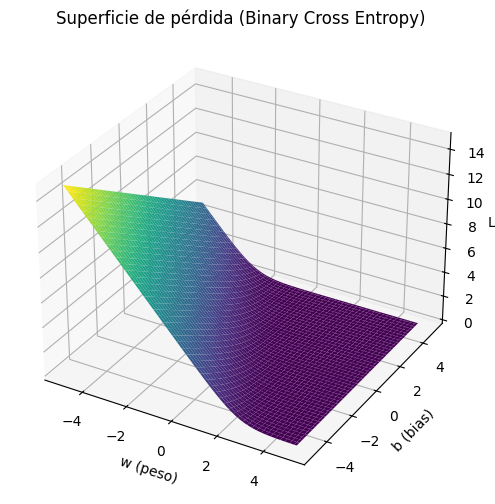

In [94]:
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Datos: un solo punto para simplificar la visualización
x = 2.0       # feature
y = 1.0       # etiqueta correcta (clase positiva)

# Sigmoid function
def sigmoid(z):
    return 1 / (1 + np.exp(-z))

# Binary Cross Entropy Loss
def binary_cross_entropy(y_hat, y_true):
    return - (y_true * np.log(y_hat) + (1 - y_true) * np.log(1 - y_hat))

# Grid de valores para w y b
w_vals = np.linspace(-5, 5, 100)
b_vals = np.linspace(-5, 5, 100)
W, B = np.meshgrid(w_vals, b_vals)

# Calcular loss para cada combinación
Z = np.zeros_like(W)
for i in range(W.shape[0]):
    for j in range(W.shape[1]):
        w = W[i, j]
        b = B[i, j]
        y_hat = sigmoid(w * x + b)
        Z[i, j] = binary_cross_entropy(y_hat, y)

# Graficar en 3D
fig = plt.figure(figsize=(10, 6))
ax = fig.add_subplot(111, projection='3d')
ax.plot_surface(W, B, Z, cmap='viridis', edgecolor='none')

ax.set_title("Superficie de pérdida (Binary Cross Entropy)")
ax.set_xlabel("w (peso)")
ax.set_ylabel("b (bias)")
ax.set_zlabel("Loss")

plt.show()


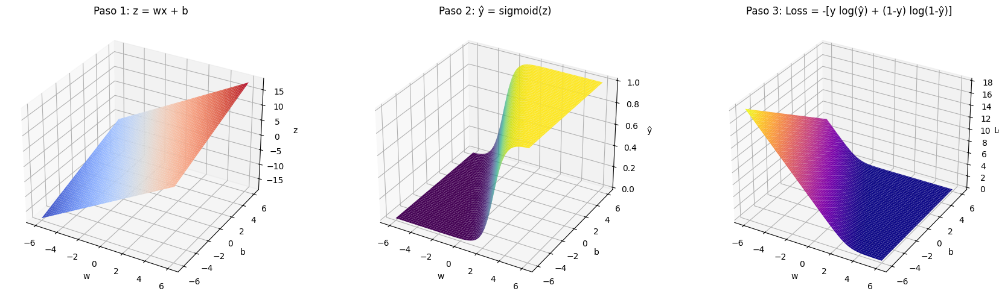

In [95]:
import numpy as np
import matplotlib.pyplot as plt

# Datos fijos: un solo ejemplo (x, y)
x = 2.0
y = 1.0

# Rango de pesos y bias para visualizar
w_vals = np.linspace(-6, 6, 100)
b_vals = np.linspace(-6, 6, 100)
W, B = np.meshgrid(w_vals, b_vals)

# Sigmoid function
def sigmoid(z):
    return 1 / (1 + np.exp(-z))

# Binary cross entropy
def binary_cross_entropy(y_hat, y_true):
    eps = 1e-12
    y_hat = np.clip(y_hat, eps, 1 - eps)  # para evitar log(0)
    return - (y_true * np.log(y_hat) + (1 - y_true) * np.log(1 - y_hat))

# Paso 1: cálculo de z = wx + b
Z_linear = W * x + B

# Paso 2: activación con sigmoide
Y_hat = sigmoid(Z_linear)

# Paso 3: cálculo de la pérdida
Loss = binary_cross_entropy(Y_hat, y)

# Devolver resultados para graficar en múltiples paneles
import matplotlib.gridspec as gridspec

fig = plt.figure(figsize=(18, 5))
gs = gridspec.GridSpec(1, 3, width_ratios=[1, 1, 1])

# Panel 1: z = wx + b
ax0 = fig.add_subplot(gs[0], projection='3d')
ax0.plot_surface(W, B, Z_linear, cmap='coolwarm', edgecolor='none')
ax0.set_title("Paso 1: z = wx + b")
ax0.set_xlabel("w")
ax0.set_ylabel("b")
ax0.set_zlabel("z")

# Panel 2: y_hat = sigmoid(z)
ax1 = fig.add_subplot(gs[1], projection='3d')
ax1.plot_surface(W, B, Y_hat, cmap='viridis', edgecolor='none')
ax1.set_title("Paso 2: ŷ = sigmoid(z)")
ax1.set_xlabel("w")
ax1.set_ylabel("b")
ax1.set_zlabel("ŷ")

# Panel 3: Loss = Binary Cross Entropy
ax2 = fig.add_subplot(gs[2], projection='3d')
ax2.plot_surface(W, B, Loss, cmap='plasma', edgecolor='none')
ax2.set_title("Paso 3: Loss = -[y log(ŷ) + (1-y) log(1-ŷ)]")
ax2.set_xlabel("w")
ax2.set_ylabel("b")
ax2.set_zlabel("Loss")

plt.tight_layout()
plt.show()


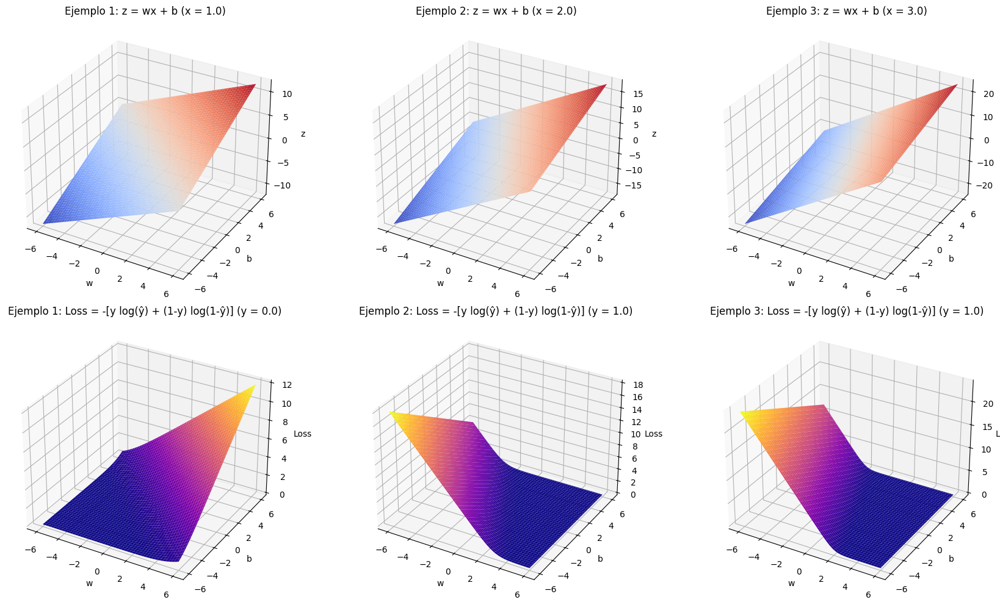

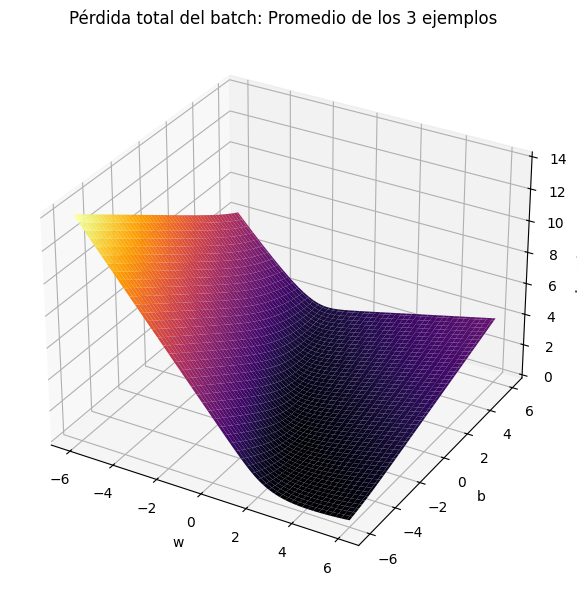

In [98]:
import matplotlib.gridspec as gridspec

# Paso 1: cálculo z = wx + b para cada ejemplo del batch
Z_batch = np.array([W * x_i + B for x_i in X_batch])  # shape: (3, grid_x, grid_y)

# Paso 2: aplicar sigmoide a cada z
Y_hat_batch = sigmoid(Z_batch)

# Paso 3: calcular la pérdida individual por ejemplo
Losses_batch = binary_cross_entropy(Y_hat_batch, Y_batch[:, np.newaxis, np.newaxis])

# Paso 4: pérdida promedio del batch (ya se calculó antes como Loss_batch)

# Crear gráfico con múltiples paneles
fig = plt.figure(figsize=(18, 10))
gs = gridspec.GridSpec(2, 3)

# Panel 1: z para cada ejemplo
for idx in range(3):
    ax = fig.add_subplot(gs[0, idx], projection='3d')
    ax.plot_surface(W, B, Z_batch[idx], cmap='coolwarm', edgecolor='none')
    ax.set_title(f"Ejemplo {idx+1}: z = wx + b (x = {X_batch[idx]})")
    ax.set_xlabel("w")
    ax.set_ylabel("b")
    ax.set_zlabel("z")

# Panel 2: y_hat = sigmoid(z) para cada ejemplo
for idx in range(3):
    ax = fig.add_subplot(gs[1, idx], projection='3d')
    ax.plot_surface(W, B, Losses_batch[idx], cmap='plasma', edgecolor='none')
    ax.set_title(f"Ejemplo {idx+1}: Loss = -[y log(ŷ) + (1-y) log(1-ŷ)] (y = {Y_batch[idx]})")
    ax.set_xlabel("w")
    ax.set_ylabel("b")
    ax.set_zlabel("Loss")

plt.tight_layout()
plt.show()


# Visualización de la función de pérdida total del batch como un solo panel (Loss promedio)

fig = plt.figure(figsize=(8, 6))
ax = fig.add_subplot(111, projection='3d')
ax.plot_surface(W, B, Loss_batch, cmap='inferno', edgecolor='none')

ax.set_title("Pérdida total del batch: Promedio de los 3 ejemplos")
ax.set_xlabel("w")
ax.set_ylabel("b")
ax.set_zlabel("Loss total")

plt.tight_layout()
plt.show()


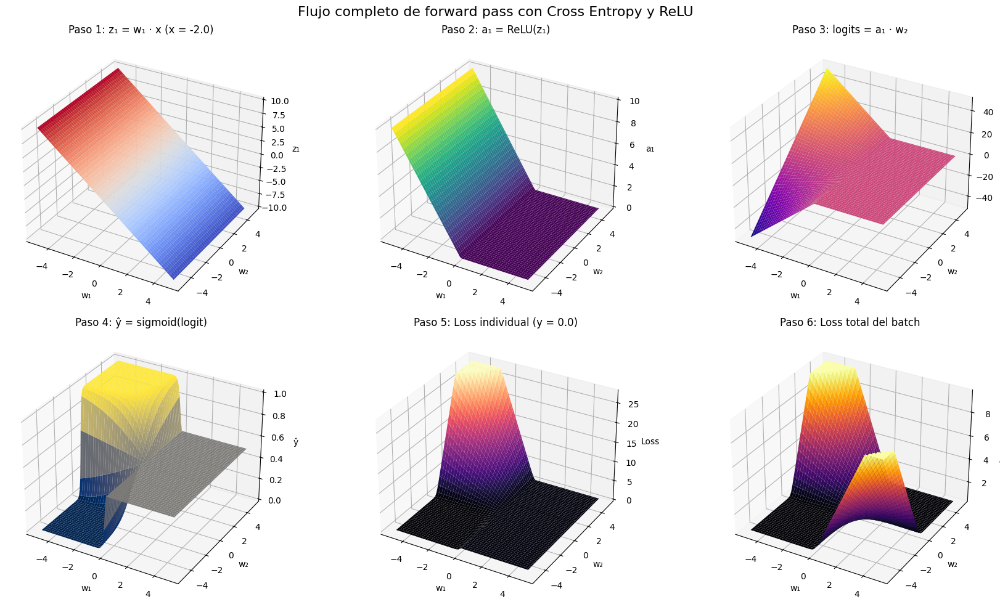

In [5]:
# Redefinir todo correctamente asegurándonos de que no haya tensores con gradientes activos

import numpy as np
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
from mpl_toolkits.mplot3d import Axes3D

# Datos de entrada y etiquetas (batch)
X_data = np.array([-2.0, 0.0, 1.5])
Y_data = np.array([0.0, 1.0, 1.0])

# Rango de pesos
w1_vals = np.linspace(-5, 5, 100)
w2_vals = np.linspace(-5, 5, 100)
W1, W2 = np.meshgrid(w1_vals, w2_vals)

# Activaciones y funciones de pérdida
def sigmoid(z):
    return 1 / (1 + np.exp(-z))

def binary_cross_entropy(y_hat, y_true):
    eps = 1e-12
    y_hat = np.clip(y_hat, eps, 1 - eps)
    return - (y_true * np.log(y_hat) + (1 - y_true) * np.log(1 - y_hat))

# Paso 1: z1 = w1 * x (producto lineal)
Z1 = np.array([W1 * x_i for x_i in X_data])

# Paso 2: a1 = relu(z1)
A1 = np.maximum(0, Z1)

# Paso 3: logits = a1 * w2
Logits = A1 * W2

# Paso 4: y_hat = sigmoid(logits)
Y_hat = sigmoid(Logits)

# Paso 5: binary cross entropy por ejemplo
Losses = binary_cross_entropy(Y_hat, Y_data[:, np.newaxis, np.newaxis])

# Paso 6: promedio final de loss (loss total de batch)
Loss_total = np.mean(Losses, axis=0)

# Crear figura con varios paneles
fig = plt.figure(figsize=(18, 10))
gs = gridspec.GridSpec(2, 3)

# Paneles: mostrar uno de los ejemplos como referencia clara
idx = 0
x_ref = X_data[idx]
y_ref = Y_data[idx]

# z1 = w1 * x
ax1 = fig.add_subplot(gs[0, 0], projection='3d')
ax1.plot_surface(W1, W2, Z1[idx], cmap='coolwarm', edgecolor='none')
ax1.set_title(f"Paso 1: z₁ = w₁ · x (x = {x_ref})")
ax1.set_xlabel("w₁"); ax1.set_ylabel("w₂"); ax1.set_zlabel("z₁")

# a1 = tanh(z1)
ax2 = fig.add_subplot(gs[0, 1], projection='3d')
ax2.plot_surface(W1, W2, A1[idx], cmap='viridis', edgecolor='none')
ax2.set_title("Paso 2: a₁ = ReLU(z₁)")
ax2.set_xlabel("w₁"); ax2.set_ylabel("w₂"); ax2.set_zlabel("a₁")

# logits = a1 * w2
ax3 = fig.add_subplot(gs[0, 2], projection='3d')
ax3.plot_surface(W1, W2, Logits[idx], cmap='plasma', edgecolor='none')
ax3.set_title("Paso 3: logits = a₁ · w₂")
ax3.set_xlabel("w₁"); ax3.set_ylabel("w₂"); ax3.set_zlabel("logit")

# y_hat = sigmoid(logit)
ax4 = fig.add_subplot(gs[1, 0], projection='3d')
ax4.plot_surface(W1, W2, Y_hat[idx], cmap='cividis', edgecolor='none')
ax4.set_title("Paso 4: ŷ = sigmoid(logit)")
ax4.set_xlabel("w₁"); ax4.set_ylabel("w₂"); ax4.set_zlabel("ŷ")

# loss individual para ejemplo
ax5 = fig.add_subplot(gs[1, 1], projection='3d')
ax5.plot_surface(W1, W2, Losses[idx], cmap='magma', edgecolor='none')
ax5.set_title(f"Paso 5: Loss individual (y = {y_ref})")
ax5.set_xlabel("w₁"); ax5.set_ylabel("w₂"); ax5.set_zlabel("Loss")

# loss total del batch
ax6 = fig.add_subplot(gs[1, 2], projection='3d')
ax6.plot_surface(W1, W2, Loss_total, cmap='inferno', edgecolor='none')
ax6.set_title("Paso 6: Loss total del batch")
ax6.set_xlabel("w₁"); ax6.set_ylabel("w₂"); ax6.set_zlabel("Loss total")

plt.suptitle("Flujo completo de forward pass con Cross Entropy y ReLU", fontsize=16)
plt.tight_layout()
plt.show()


# Backprop

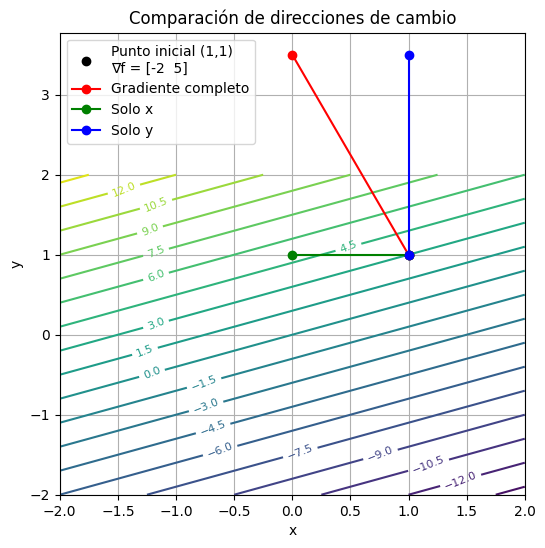

In [5]:
# Nueva función: más sensibilidad en y, pendiente negativa en x
def f(x, y):
    return -2 * x + 5 * y

# Gradiente de la función
def grad_f(x, y):
    return np.array([-2, 5])

# Grilla de valores
x = np.linspace(-2, 2, 30)
y = np.linspace(-2, 2, 30)
X, Y = np.meshgrid(x, y)
Z = f(X, Y)

# Punto inicial
x0, y0 = 1, 1
grad = grad_f(x0, y0)
step_size = 0.5

# Movimiento completo en dirección del gradiente
x1, y1 = x0 + step_size * grad[0], y0 + step_size * grad[1]

# Movimiento solo en x
x2, y2 = x0 + step_size * grad[0], y0

# Movimiento solo en y
x3, y3 = x0, y0 + step_size * grad[1]

# Graficamos solo el panel comparativo
fig, ax = plt.subplots(figsize=(6, 6))

contour = ax.contour(X, Y, Z, levels=20, cmap='viridis')
ax.clabel(contour, inline=True, fontsize=8)
ax.plot(x0, y0, 'ko', label=f'Punto inicial (1,1)\n∇f = {grad}')
ax.plot([x0, x1], [y0, y1], 'r-o', label='Gradiente completo')
ax.plot([x0, x2], [y0, y2], 'g-o', label='Solo x')
ax.plot([x0, x3], [y0, y3], 'b-o', label='Solo y')

ax.set_title("Comparación de direcciones de cambio")
ax.set_xlabel("x")
ax.set_ylabel("y")
ax.legend(loc='upper left')
ax.grid(True)
plt.show()


## Auto-grad (micrograd)

In [1]:
import os
# os.environ["PATH"] += os.pathsep + "C:\\Program Files\\Graphviz\\bin"

# import shutil
# print(shutil.which("dot"))

import math
import random
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

In [2]:
from graphviz import Digraph

def trace(root):
  # builds a set of all nodes and edges in a graph
  nodes, edges = set(), set()
  def build(v):
    if v not in nodes:
      nodes.add(v)
      for child in v._prev:
        edges.add((child, v))
        build(child)
  build(root)
  return nodes, edges

def draw_dot(root):
  dot = Digraph(format='svg', graph_attr={'rankdir': 'LR'}) # LR = left to right
  
  nodes, edges = trace(root)
  for n in nodes:
    uid = str(id(n))
    # for any value in the graph, create a rectangular ('record') node for it
    dot.node(name = uid, label = "{ %s | data %.4f | grad %.4f }" % (n.label, n.data, n.grad), shape='record')
    if n._op:
      # if this value is a result of some operation, create an op node for it
      dot.node(name = uid + n._op, label = n._op)
      # and connect this node to it
      dot.edge(uid + n._op, uid)

  for n1, n2 in edges:
    # connect n1 to the op node of n2
    dot.edge(str(id(n1)), str(id(n2)) + n2._op)

  dot.attr(size='15')
  return dot

In [3]:
# ENGINE
# Esta clase implementa un sistema de autograd (diferenciación automática) muy simple.
# Permite construir un grafo computacional de operaciones y calcular gradientes automáticamente.
# Es la base para construir redes neuronales y entrenarlas con backpropagation.

class Value:
    """ 
    Almacena un valor escalar y su gradiente.
    Además, mantiene información para construir el grafo de operaciones y calcular gradientes.
    """

    def __init__(self, data, _children=(), _op='', label=''):
        self.data = data  # El valor escalar real (float, int, etc)
        self.grad = 0     # El gradiente de este valor respecto a algún valor escalar final (por ejemplo, la pérdida)
        # Variables internas para construir el grafo de autograd
        self._backward = lambda: None  # Función que implementa el paso hacia atrás (backward) para esta operación
        self._prev = set(_children)    # Conjunto de nodos padres (inputs directos de esta operación)
        self._op = _op                 # Nombre de la operación que produjo este nodo (para depuración/visualización)
        self.label = label

    def __add__(self, other):
        # Suma de dos valores (soporta suma con escalares también)
        other = other if isinstance(other, Value) else Value(other)
        out = Value(self.data + other.data, (self, other), '+')

        # Define cómo propagar el gradiente hacia los operandos de la suma
        def _backward():
            self.grad += out.grad      # d(out)/d(self) = 1
            other.grad += out.grad     # d(out)/d(other) = 1
        out._backward = _backward

        return out

    def __mul__(self, other):
        # Multiplicación de dos valores (soporta multiplicación con escalares también)
        other = other if isinstance(other, Value) else Value(other)
        out = Value(self.data * other.data, (self, other), '*')

        # Define cómo propagar el gradiente hacia los operandos de la multiplicación
        def _backward():
            self.grad += other.data * out.grad   # d(out)/d(self) = other.data
            other.grad += self.data * out.grad   # d(out)/d(other) = self.data
        out._backward = _backward

        return out

    def __pow__(self, other):
        # Potencia: eleva el valor a una potencia escalar (solo soporta int/float)
        assert isinstance(other, (int, float)), "solo se soportan potencias int/float por ahora"
        out = Value(self.data**other, (self,), f'**{other}')

        # Propagación del gradiente para la potencia
        def _backward():
            self.grad += (other * self.data**(other-1)) * out.grad
        out._backward = _backward

        return out

    def relu(self):
        # Función de activación ReLU: max(0, x)
        out = Value(0 if self.data < 0 else self.data, (self,), 'ReLU')

        # Propagación del gradiente para ReLU (solo pasa el gradiente si la salida fue > 0)
        def _backward():
            self.grad += (out.data > 0) * out.grad
        out._backward = _backward

        return out
    
    def exp(self):
        x = self.data
        out = Value(math.exp(x), (self, ), 'exp')
        
        def _backward():
            self.grad += out.data * out.grad
        out._backward = _backward
        
        return out

    def log(self):
        out = Value(math.log(self.data), (self,), 'log')

        def _backward():
            self.grad += (1 / self.data) * out.grad
        out._backward = _backward
        return out

    def backward(self):
        """
        Calcula todos los gradientes de los nodos en el grafo que llevan a este nodo.
        Se debe llamar en el nodo final (por ejemplo, la pérdida).
        """

        # Ordena topológicamente todos los nodos del grafo que llevan a este nodo
        topo = []
        visited = set()
        def build_topo(v):
            if v not in visited:
                visited.add(v)
                for child in v._prev:
                    build_topo(child)
                topo.append(v)
        build_topo(self)

        # Inicializa el gradiente del nodo final como 1 (dself/dself = 1)
        self.grad = 1
        # Propaga hacia atrás en orden inverso (backpropagation)
        for v in reversed(topo):
            # print(f"-> {v.label}._backward()")
            v._backward()

    # Operadores adicionales para soportar sintaxis de Python
    def __neg__(self): # -self
        return self * -1

    def __radd__(self, other): # other + self
        return self + other

    def __sub__(self, other): # self - other
        return self + (-other)

    def __rsub__(self, other): # other - self
        return other + (-self)

    def __rmul__(self, other): # other * self
        return self * other

    def __truediv__(self, other): # self / other
        return self * other**-1

    def __rtruediv__(self, other): # other / self
        return other * self**-1

    def __repr__(self):
        # Representación legible del objeto para depuración
        return f"(label={self.label}, data={self.data}, grad={self.grad})"


## Ejemplos simples

Para ejemplificar el grafo de operaciones



| paso | nodo        | regla local | entrada(s) | cálculo                                     | gradiente que se **acumula**            |
| ---- | ----------- | ----------- | ---------- | ------------------------------------------- | --------------------------------------- |
| 0    | **L**       | final       | —          | ∂L/∂L = 1                                   | L.grad = 1                              |
| 1    | `sum` (L)   | L = y₁ + y₂ | y₁, y₂     | ∂L/∂y₁ = 1 · 1<br>∂L/∂y₂ = 1 · 1            | y₁.grad = 1<br>y₂.grad = 1              |
| 2    | `add1` (y₁) | y₁ = a₁ + b | a₁, b      | ∂L/∂a₁ = 1 · 1 = 1<br>∂L/∂b  = 1 · 1 = 1    | a₁.grad = 1<br>b.grad = **1**           |
| 3    | `add2` (y₂) | y₂ = a₂ + b | a₂, b      | ∂L/∂a₂ = 1 · 1 = 1<br>∂L/∂b  = 1 · 1 = 1    | a₂.grad = 1<br>b.grad = **2** (se suma) |
| 4    | `mul1` (a₁) | a₁ = w·x₁   | w, x₁      | ∂L/∂w  = 1 · x₁ = 3<br>(∂L/∂x₁ = 1 · w = 2) | w\.grad = **3**                         |
| 5    | `mul2` (a₂) | a₂ = w·x₂   | w, x₂      | ∂L/∂w  = 1 · x₂ = 4<br>(∂L/∂x₂ = 1 · w = 2) | w\.grad = **7** (3 + 4)                 |

### Operaciones simples

In [5]:
a = Value(2.0, label='a')
b = Value(-3.0, label='b')
c = Value(10.0, label='c')
e = a*b; e.label = 'e'
d = e + c; d.label = 'd'
f = Value(-2.0, label='f')
L = d * f; L.label = 'L'

print(f'a: {a} -> prev: {a._prev} -> op: {a._op}')
print(f'b: {b} -> prev: {b._prev} -> op: {b._op}')
print(f'c: {c} -> prev: {c._prev} -> op: {c._op}')
print(f'e: {e} -> prev: {e._prev} -> op: {e._op}')
print(f'd: {d} -> prev: {d._prev} -> op: {d._op}')
print(f'f: {f} -> prev: {f._prev} -> op: {f._op}')
print(f'L: {L} -> prev: {L._prev} -> op: {L._op}')

a: (label=a, data=2.0, grad=0) -> prev: set() -> op: 
b: (label=b, data=-3.0, grad=0) -> prev: set() -> op: 
c: (label=c, data=10.0, grad=0) -> prev: set() -> op: 
e: (label=e, data=-6.0, grad=0) -> prev: {(label=a, data=2.0, grad=0), (label=b, data=-3.0, grad=0)} -> op: *
d: (label=d, data=4.0, grad=0) -> prev: {(label=e, data=-6.0, grad=0), (label=c, data=10.0, grad=0)} -> op: +
f: (label=f, data=-2.0, grad=0) -> prev: set() -> op: 
L: (label=L, data=-8.0, grad=0) -> prev: {(label=f, data=-2.0, grad=0), (label=d, data=4.0, grad=0)} -> op: *


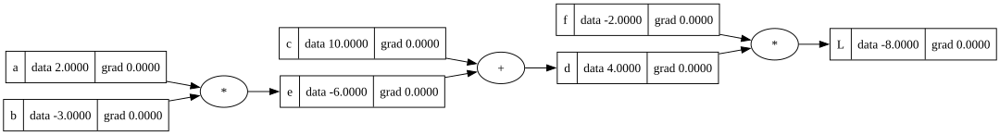

In [6]:
draw_dot(L)

In [7]:
# CHEQUEAR LA DERIVADA NUMERICAMENTE (con respecto a L)
# aumentando el value del nodo por h y fijandose la diferencia con el original

def lol(node='a'):
  
  h = 0.001
  
  a = Value(2.0, label='a')
  b = Value(-3.0, label='b')
  c = Value(10.0, label='c')
  e = a*b; e.label = 'e'
  d = e + c; d.label = 'd'
  f = Value(-2.0, label='f')
  L = d * f; L.label = 'L'
  L1 = L.data # L1 is the original value of L (before the change)
  
  # changing the value of the node we're interested in (by adding h)
  a = Value(2.0, label='a')
  if node == 'a':
    a.data += h 
  b = Value(-3.0, label='b')
  if node == 'b':
    b.data += h
  c = Value(10.0, label='c')
  if node == 'c':
    c.data += h
  e = a*b; e.label = 'e'
  if node == 'e':
    e.data += h
  d = e + c; d.label = 'd'
  if node == 'd':
    d.data += h
  f = Value(-2.0, label='f')
  if node == 'f':
    f.data += h
  
  # L is the result of the operation after the change
  L = d * f; L.label = 'L'
  L2 = L.data
  
  # dL/dc = (L2 - L1)/h
  return round((L2 - L1)/h, 3)
  
lol(node='b')

for node in ['a', 'b', 'c', 'd', 'e', 'f']:
  print(f'dL/d{node} = {lol(node=node)}')

dL/da = 6.0
dL/db = -4.0
dL/dc = -2.0
dL/dd = -2.0
dL/de = -2.0
dL/df = 4.0


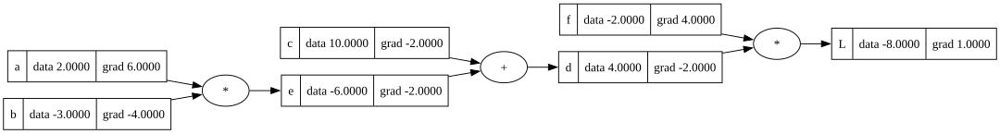

In [8]:
# visualize the gradient of L with respect to each node

L.grad = 1.0 # is 1 because L is the last node
a.grad = 6.0
b.grad = -4.0
c.grad = -2.0
d.grad = -2.0
e.grad = -2.0
f.grad = 4.0

draw_dot(L)


Given `L = d * f` as our final output, we compute ∂L/∂x for each node x using the chain rule to backpropagate gradients.

Starting from output L
- ∂L/∂L = L.grad = 1.0 (by convention for final output)

**Direct inputs to L (d and f)**
- ∂L/∂d = 1.0 * f = 1.0 * (-2.0) = -2.0
- ∂L/∂f = 1.0 * d = 1.0 * 4.0 = 4.0

**Inputs to d (e and c)**
Since d = e + c, the derivative flows directly:
- ∂L/∂e = ∂L/∂d * ∂d/∂e = -2.0 * 1 = -2.0  
- ∂L/∂c = ∂L/∂d * ∂d/∂c = -2.0 * 1 = -2.0

**Inputs to e (a and b)**
Given e = a * b, we apply the product rule:
- ∂L/∂a = ∂L/∂e * ∂e/∂a = -2.0 * b = -2.0 * (-3.0) = 6.0
- ∂L/∂b = ∂L/∂e * ∂e/∂b = -2.0 * a = -2.0 * 2.0 = -4.0

This demonstrates backpropagation through the computation graph, where each operation applies its local derivative and the chain rule combines them to compute the total gradient ∂L/∂x for each node x.

The computation graph forms a directed acyclic graph (DAG) where:


**Optimization step** 

(increasing gradient)

El **gradiente** siempre siempre apunta a la direccion del steepest ascent de una funcion.
- **Direccion** del gradiente: te dice para que lado debes ir para incrementar el valor de la funcion
- **Magnitud** del gradiente: te dice el rate de como se incrementa esa funcion si te moves en esa fdireccion

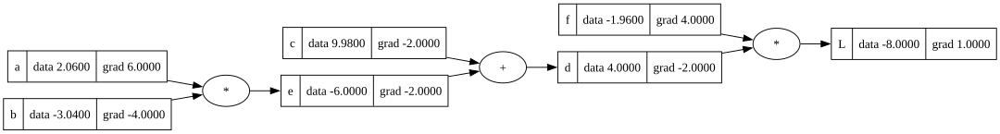

In [9]:
# si queremos aumentar el valor de L con respecto a todos, haciendo pasos chiquitos (0.01) podemos hacer:

step_size = 0.01

# estos son los nodos que podemos modificar (no resultados de operaciones)
a.data += step_size * a.grad
b.data += step_size * b.grad
c.data += step_size * c.grad
f.data += step_size * f.grad

draw_dot(L)

### Perceptron

OPERATIONS GRAPH

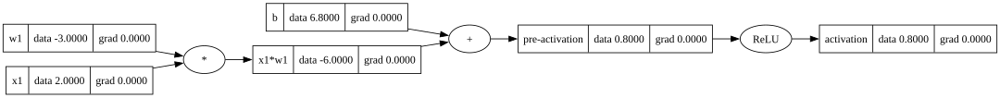

In [29]:
x1 = Value(2.0, label='x1')

w1 = Value(-3.0, label='w1')

b = Value(6.8, label='b')

x1w1 = x1*w1; x1w1.label = 'x1*w1'

n = x1w1 + b; n.label = 'pre-activation'

o = n.relu(); o.label = 'activation'

draw_dot(o)

GRADIENT CALCULATION

Cambia el grad de lo anterior (n: relu) n.grad: 1.0


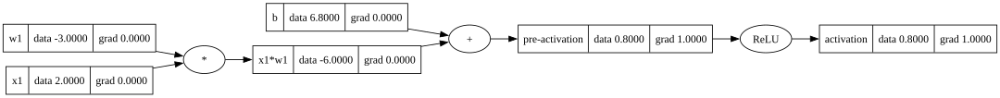

In [30]:
# inicializo a 1 porque es el ultimo nodo (todo lo demas queda en 0)
o.grad = 1.0 

o._backward()

print(f"Cambia el grad de lo anterior (n: relu) n.grad: {n.grad}")
draw_dot(o)

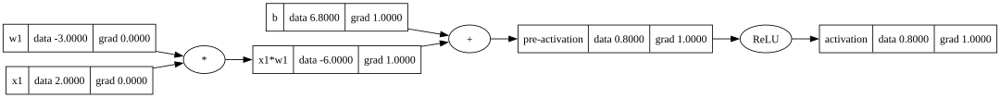

In [31]:
# with this I calculate the grad of o wrt b and w1*w1+x2*w2
n._backward()
b._backward()

draw_dot(o)

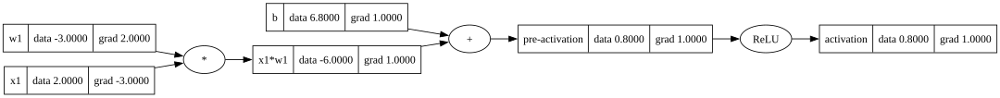

In [32]:
x1w1._backward()

draw_dot(o)

PARAMETER UPDATE

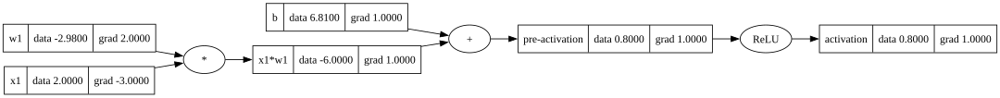

In [33]:
step_size = 0.01

w1.data += step_size * w1.grad
b.data += step_size * b.grad

draw_dot(o)

NUEVO FORWARD PASS

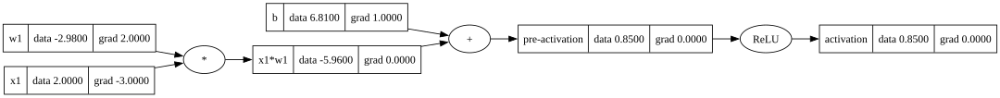

In [34]:
# forward pass
x1w1 = x1*w1; x1w1.label = 'x1*w1'
n = x1w1 + b; n.label = 'pre-activation'
o = n.relu(); o.label = 'activation'

draw_dot(o)

### Shallow network

OPERATIONS GRAPH

target: 1.0, pred: 2.4, loss (2.4 - 1.0)**2 = 1.96


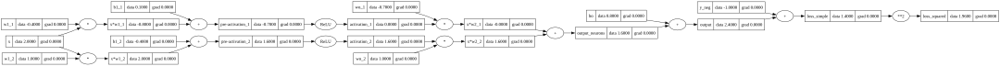

In [8]:
# shallow network con 1 layer de 2 neuronas, 1 input dim y 1 output dim (1 ejemplo)

x = Value(2.0, label='x')
y = Value(1.0, label='y')

# pesos de la primera layer
w1_1 = Value(-0.4, label='w1_1')
w1_2 = Value(1.0, label='w1_2')
# bias de la primera layer
b1_1 = Value(0.1, label='b1_1')
b1_2 = Value(-0.4, label='b1_2')

# pesos de la output layer
wo_1 = Value(-0.7, label='wo_1')
wo_2 = Value(1.0, label='wo_2')
# bias de la output layer
bo = Value(0.8, label='bo')


# primera layer
xw1_1 = x*w1_1; xw1_1.label = 'x*w1_1'
xw1_2 = x*w1_2; xw1_2.label = 'x*w1_2'

n1 = xw1_1 + b1_1; n1.label = 'pre-activation_1'
n2 = xw1_2 + b1_2; n2.label = 'pre-activation_2'

a1 = n1.relu(); a1.label = 'activation_1'
a2 = n2.relu(); a2.label = 'activation_2'

# output layer
xw2_1 = a1*wo_1; xw2_1.label = 'x*w2_1'
xw2_2 = a2*wo_2; xw2_2.label = 'x*w2_2'

o_neurons = xw2_1 + xw2_2; o_neurons.label = 'output_neurons'
o = o_neurons + bo; o.label = 'output'

y_neg = Value(-y.data, label='y_neg')

loss_simple = o + y_neg; loss_simple.label = 'loss_simple'

loss = loss_simple**2; loss.label = 'loss_squared'
print(f'target: {y.data}, pred: {round(o.data, 3)}, loss ({round(o.data, 3)} - {y.data})**2 = {round(loss.data, 3)}')

draw_dot(loss)

GRADIENT CALCULATION (automatico)

target: 1.0, pred: 2.167, loss (2.167 - 1.0)**2 = 1.361
target: 1.0, pred: 1.329, loss (1.329 - 1.0)**2 = 0.109
target: 1.0, pred: 1.125, loss (1.125 - 1.0)**2 = 0.016
target: 1.0, pred: 1.051, loss (1.051 - 1.0)**2 = 0.003
target: 1.0, pred: 1.021, loss (1.021 - 1.0)**2 = 0.0
target: 1.0, pred: 1.009, loss (1.009 - 1.0)**2 = 0.0
target: 1.0, pred: 1.004, loss (1.004 - 1.0)**2 = 0.0
target: 1.0, pred: 1.002, loss (1.002 - 1.0)**2 = 0.0
target: 1.0, pred: 1.001, loss (1.001 - 1.0)**2 = 0.0
target: 1.0, pred: 1.0, loss (1.0 - 1.0)**2 = 0.0


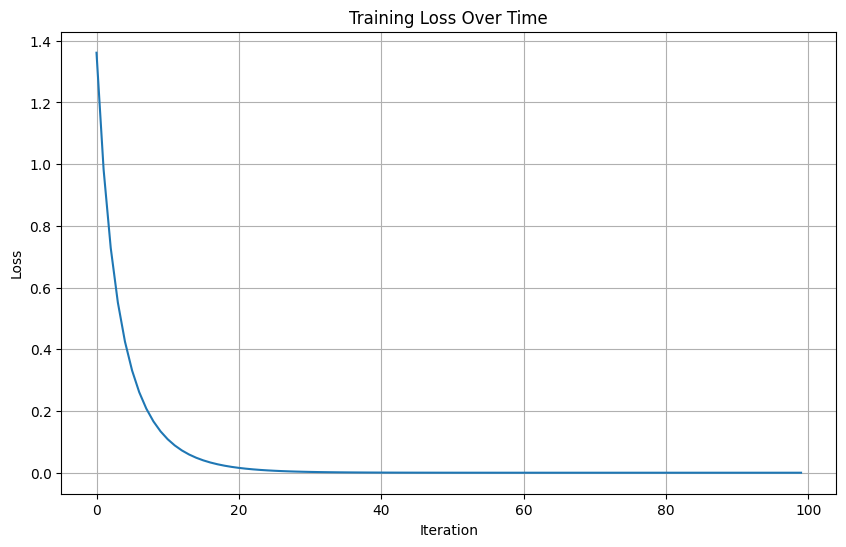

In [9]:
step_size = -0.01
losses = []  # Store losses for plotting

for i in range(100):
    # change step size each 10 iterations
    # if i % 10 == 0:
    #     step_size = step_size * 0.9
    #     print(f"step_size: {step_size}")

    # backward pass
    w1_1.grad = 0.0
    w1_2.grad = 0.0
    b1_1.grad = 0.0
    b1_2.grad = 0.0
    wo_1.grad = 0.0
    wo_2.grad = 0.0
    bo.grad = 0.0
    loss.grad = 1.0

    loss.backward()

    # print(f"w1_1 grad: {w1_1.grad}")
    # print(f"w1_2 grad: {w1_2.grad}")
    # print(f"b1_1 grad: {b1_1.grad}")
    # print(f"b1_2 grad: {b1_2.grad}")
    # print(f"wo_1 grad: {wo_1.grad}")
    # print(f"wo_2 grad: {wo_2.grad}")
    # print(f"n1 grad: {n1.grad}")
    # print(f"n2 grad: {n2.grad}")
    # print(f"bo grad: {bo.grad}")
    # print(f"a1 grad: {a1.grad}")
    # print(f"a2 grad: {a2.grad}")
    # print(f"xw2_1 grad: {xw2_1.grad}")
    # print(f"xw2_2 grad: {xw2_2.grad}")
    # print(f"o neurons grad: {o_neurons.grad}")
    # print(f"o grad: {o.grad}")
    # print(f"y neg grad: {y_neg.grad}")
    # print(f"loss simple grad: {loss_simple.grad}")
    # print(f"loss grad: {loss.grad}")

    # update
    w1_1.data += step_size * w1_1.grad
    w1_2.data += step_size * w1_2.grad
    b1_1.data += step_size * b1_1.grad
    b1_2.data += step_size * b1_2.grad
    wo_1.data += step_size * wo_1.grad
    wo_2.data += step_size * wo_2.grad
    bo.data += step_size * bo.grad

    # forward pass
    xw1_1 = x*w1_1; xw1_1.label = 'x*w1_1'
    xw1_2 = x*w1_2; xw1_2.label = 'x*w1_2'
    n1 = xw1_1 + b1_1; n1.label = 'pre-activation_1'
    n2 = xw1_2 + b1_2; n2.label = 'pre-activation_2'
    a1 = n1.relu(); a1.label = 'activation_1'
    a2 = n2.relu(); a2.label = 'activation_2'
    xw2_1 = a1*wo_1; xw2_1.label = 'x*w2_1'
    xw2_2 = a2*wo_2; xw2_2.label = 'x*w2_2'
    o_neurons = xw2_1 + xw2_2; o_neurons.label = 'output_neurons'
    o = o_neurons + bo; o.label = 'output'
    y_neg = Value(-y.data, label='y_neg')
    loss_simple = o + y_neg; loss_simple.label = 'loss_simple'
    loss = loss_simple**2; loss.label = 'loss_squared'

    if i % 10 == 0:
        print(f'target: {y.data}, pred: {round(o.data, 3)}, loss ({round(o.data, 3)} - {y.data})**2 = {round(loss.data, 3)}')
    
    losses.append(loss.data)

    # break

# Plot the loss curve
plt.figure(figsize=(10, 6))
plt.plot(losses)
plt.title('Training Loss Over Time')
plt.xlabel('Iteration')
plt.ylabel('Loss')
plt.grid(True)
plt.show()

# draw_dot(loss)

GRADIENT CALCULATION (a mano)

-> loss._backwards() pasa grads a:
{(label=loss_simple, data=0.00013697541190405005, grad=0.0002739508238081001)}
-> loss_simple._backwards() pasa grads a:
{(label=output, data=1.000136975411904, grad=0.0002739508238081001), (label=y_neg, data=-1.0, grad=0.0002739508238081001)}
-> y_neg._backwards() pasa grads a:
set()
-> o._backwards() pasa grads a:
{(label=output_neurons, data=0.43599552713063866, grad=0.0002739508238081001), (label=bo, data=0.5641414482812653, grad=0.0005723347238806298)}
-> bo._backwards() pasa grads a:
set()
-> o_neurons._backwards() pasa grads a:
{(label=x*w2_2, data=0.43599552713063866, grad=0.0002739508238081001), (label=x*w2_1, data=-0.0, grad=0.0002739508238081001)}


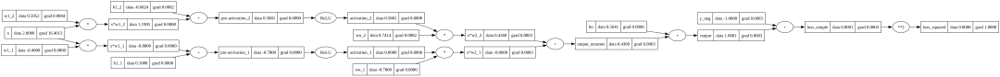

In [10]:
# inicializo a 1 porque es el ultimo nodo (todo lo demas queda en 0)
loss.grad = 1.0 

loss._backward()
print(f"-> loss._backwards() pasa grads a:\n{loss._prev}")

loss_simple._backward()
print(f"-> loss_simple._backwards() pasa grads a:\n{loss_simple._prev}")

y_neg._backward()
print(f"-> y_neg._backwards() pasa grads a:\n{y_neg._prev}")

o._backward()
print(f"-> o._backwards() pasa grads a:\n{o._prev}")

bo._backward()
print(f"-> bo._backwards() pasa grads a:\n{bo._prev}")

o_neurons._backward()
print(f"-> o_neurons._backwards() pasa grads a:\n{o_neurons._prev}")

draw_dot(loss)

-> xw2_1._backwards() pasa grads a:
{(label=activation_1, data=0, grad=-0.00019176557666567007), (label=wo_1, data=-0.7, grad=0.0)}
-> xw2_2._backwards() pasa grads a:
{(label=wo_2, data=0.7414028853666476, grad=0.00033657520295418957), (label=activation_2, data=0.588068290178052, grad=0.0002031079312198955)}
-> a1._backwards() pasa grads a:
{(label=pre-activation_1, data=-0.7000000000000001, grad=0.0)}
-> a2._backwards() pasa grads a:
{(label=pre-activation_2, data=0.588068290178052, grad=0.0002031079312198955)}
-> n1._backwards() pasa grads a:
{(label=x*w1_1, data=-0.8, grad=0.0), (label=b1_1, data=0.1, grad=0.0)}
-> n2._backwards() pasa grads a:
{(label=x*w1_2, data=1.1904546321424416, grad=0.0002031079312198955), (label=b1_2, data=-0.6023863419643897, grad=0.000424331139265028)}
-> xw1_1._backwards() pasa grads a:
{(label=w1_1, data=-0.4, grad=0.0), (label=x, data=2.0, grad=16.40132812575024)}
-> xw1_2._backwards() pasa grads a:
{(label=w1_2, data=0.5952273160712208, grad=0.0008486

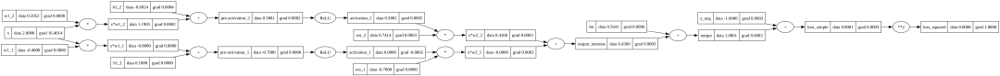

In [11]:
xw2_1._backward()
print(f"-> xw2_1._backwards() pasa grads a:\n{xw2_1._prev}")

xw2_2._backward()
print(f"-> xw2_2._backwards() pasa grads a:\n{xw2_2._prev}")

a1._backward()
print(f"-> a1._backwards() pasa grads a:\n{a1._prev}")

a2._backward()
print(f"-> a2._backwards() pasa grads a:\n{a2._prev}")

n1._backward()
print(f"-> n1._backwards() pasa grads a:\n{n1._prev}")

n2._backward()
print(f"-> n2._backwards() pasa grads a:\n{n2._prev}")

xw1_1._backward()
print(f"-> xw1_1._backwards() pasa grads a:\n{xw1_1._prev}")

xw1_2._backward()
print(f"-> xw1_2._backwards() pasa grads a:\n{xw1_2._prev}")

w1_1._backward()
print(f"-> w1_1._backwards() pasa grads a:\n{w1_1._prev}")

w1_2._backward()
print(f"-> w1_2._backwards() pasa grads a:\n{w1_2._prev}")

b1_1._backward()
print(f"-> b1_1._backwards() pasa grads a:\n{b1_1._prev}")

b1_2._backward()
draw_dot(loss)

PARAMETER UPDATE

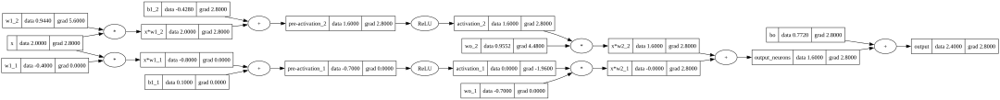

In [13]:
step_size = -0.01

w1_1.data += step_size * w1_1.grad
w1_2.data += step_size * w1_2.grad
b1_1.data += step_size * b1_1.grad
b1_2.data += step_size * b1_2.grad
wo_1.data += step_size * wo_1.grad
wo_2.data += step_size * wo_2.grad
bo.data += step_size * bo.grad

draw_dot(o)

NUEVO FORWARD PASS

loss: 1.3609368944639992


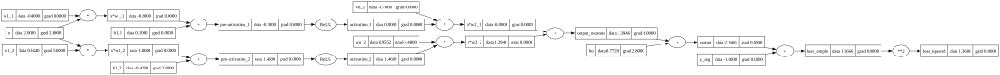

In [14]:
# primera layer
xw1_1 = x*w1_1; xw1_1.label = 'x*w1_1'
xw1_2 = x*w1_2; xw1_2.label = 'x*w1_2'

n1 = xw1_1 + b1_1; n1.label = 'pre-activation_1'
n2 = xw1_2 + b1_2; n2.label = 'pre-activation_2'

a1 = n1.relu(); a1.label = 'activation_1'
a2 = n2.relu(); a2.label = 'activation_2'

# output layer
xw2_1 = a1*wo_1; xw2_1.label = 'x*w2_1'
xw2_2 = a2*wo_2; xw2_2.label = 'x*w2_2'

o_neurons = xw2_1 + xw2_2; o_neurons.label = 'output_neurons'
o = o_neurons + bo; o.label = 'output'

y_neg = Value(-y.data, label='y_neg')

loss_simple = o + y_neg; loss_simple.label = 'loss_simple'

loss = loss_simple**2; loss.label = 'loss_squared'
print(f"loss: {loss.data}")

draw_dot(loss)

### Deep network

target: 1.0, pred: 0.66, loss (0.66 - 1.0)**2 = 0.116


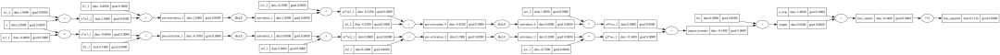

In [23]:
# DEEP NETWORK, INPUT DIM 1, OUTPUT DIM 1, 2 HIDDEN LAYERS, 2 NEURONS EACH

x = Value(2.0, label='x')
y = Value(1.0, label='y')

# First hidden layer weights and biases
w1_1 = Value(-0.4, label='w1_1')
w1_2 = Value(1.0, label='w1_2')
b1_1 = Value(0.1, label='b1_1')
b1_2 = Value(-0.4, label='b1_2')

# Second hidden layer weights and biases
w2_1 = Value(0.3, label='w2_1')
w2_2 = Value(-0.2, label='w2_2')
b2_1 = Value(0.2, label='b2_1')
b2_2 = Value(-0.1, label='b2_2')

# Output layer weights and bias
wo_1 = Value(-0.7, label='wo_1')
wo_2 = Value(1.0, label='wo_2')
bo = Value(0.8, label='bo')

# First hidden layer
xw1_1 = x*w1_1; xw1_1.label = 'x*w1_1'
xw1_2 = x*w1_2; xw1_2.label = 'x*w1_2'

n1 = xw1_1 + b1_1; n1.label = 'pre-activation_1'
n2 = xw1_2 + b1_2; n2.label = 'pre-activation_2'

a1 = n1.relu(); a1.label = 'activation_1'
a2 = n2.relu(); a2.label = 'activation_2'

# Second hidden layer
xw2_1 = a1*w2_1; xw2_1.label = 'a1*w2_1'
xw2_2 = a2*w2_2; xw2_2.label = 'a2*w2_2'

n3 = xw2_1 + b2_1; n3.label = 'pre-activation_3'
n4 = xw2_2 + b2_2; n4.label = 'pre-activation_4'

a3 = n3.relu(); a3.label = 'activation_3'
a4 = n4.relu(); a4.label = 'activation_4'

# Output layer
xw3_1 = a3*wo_1; xw3_1.label = 'a3*wo_1'
xw3_2 = a4*wo_2; xw3_2.label = 'a4*wo_2'

o_neurons = xw3_1 + xw3_2; o_neurons.label = 'output_neurons'
o = o_neurons + bo; o.label = 'output'

y_neg = Value(-y.data, label='y_neg')

loss_simple = o + y_neg; loss_simple.label = 'loss_simple'

loss = loss_simple**2; loss.label = 'loss_squared'
print(f'target: {y.data}, pred: {round(o.data, 3)}, loss ({round(o.data, 3)} - {y.data})**2 = {round(loss.data, 3)}')

draw_dot(loss)


GRADIENT CALCULATION

-> loss._backwards() pasa grads a:
    {(label=loss_simple, data=-0.33999999999999997, grad=-0.6799999999999999)}
-> loss_simple._backwards() pasa grads a:
    {(label=y_neg, data=-1.0, grad=-0.6799999999999999), (label=output, data=0.66, grad=-0.6799999999999999)}
-> y_neg._backwards() pasa grads a:
    set()
-> o._backwards() pasa grads a:
    {(label=output_neurons, data=-0.13999999999999999, grad=-0.6799999999999999), (label=bo, data=0.8, grad=-0.6799999999999999)}
-> o_neurons._backwards() pasa grads a:
    {(label=a3*wo_1, data=-0.13999999999999999, grad=-0.6799999999999999), (label=a4*wo_2, data=0.0, grad=-0.6799999999999999)}
-> xw3_1._backwards() pasa grads a:
    {(label=wo_1, data=-0.7, grad=-0.13599999999999998), (label=activation_3, data=0.2, grad=0.4759999999999999)}
-> xw3_2._backwards() pasa grads a:
    {(label=activation_4, data=0, grad=-0.6799999999999999), (label=wo_2, data=1.0, grad=0.0)}
-> a3._backwards() pasa grads a:
    {(label=pre-activation_3, data=0.2, grad

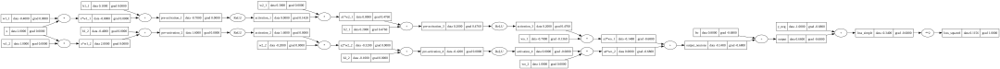

In [19]:
# inicializo a 1 porque es el ultimo nodo (todo lo demas queda en 0)
loss.grad = 1.0 

loss._backward()
print(f"-> loss._backwards() pasa grads a:\n    {loss._prev}")

loss_simple._backward()
print(f"-> loss_simple._backwards() pasa grads a:\n    {loss_simple._prev}")

y_neg._backward()
print(f"-> y_neg._backwards() pasa grads a:\n    {y_neg._prev}")

o._backward()
print(f"-> o._backwards() pasa grads a:\n    {o._prev}")

o_neurons._backward()
print(f"-> o_neurons._backwards() pasa grads a:\n    {o_neurons._prev}")

xw3_1._backward()
print(f"-> xw3_1._backwards() pasa grads a:\n    {xw3_1._prev}")

xw3_2._backward()
print(f"-> xw3_2._backwards() pasa grads a:\n    {xw3_2._prev}")

a3._backward()
print(f"-> a3._backwards() pasa grads a:\n    {a3._prev}")

a4._backward()
print(f"-> a4._backwards() pasa grads a:\n    {a4._prev}")

n3._backward()
print(f"-> n3._backwards() pasa grads a:\n    {n3._prev}")

n4._backward()
print(f"-> n4._backwards() pasa grads a:\n    {n4._prev}")

xw2_1._backward()
print(f"-> xw2_1._backwards() pasa grads a:\n    {xw2_1._prev}")

xw2_2._backward()
print(f"-> xw2_2._backwards() pasa grads a:\n    {xw2_2._prev}")

a1._backward()
print(f"-> a1._backwards() pasa grads a:\n  {a1._prev}")

a2._backward()
print(f"-> a2._backwards() pasa grads a:\n    {a2._prev}")

n1._backward()
print(f"-> n1._backwards() pasa grads a:\n    {n1._prev}")

n2._backward()
print(f"-> n2._backwards() pasa grads a:\n  {n2._prev}")

xw1_1._backward()
print(f"-> xw1_1._backwards() pasa grads a:\n    {xw1_1._prev}")

xw1_2._backward()
print(f"-> xw1_2._backwards() pasa grads a:\n    {xw1_2._prev}")

draw_dot(loss)

PARAMETER UPDATE

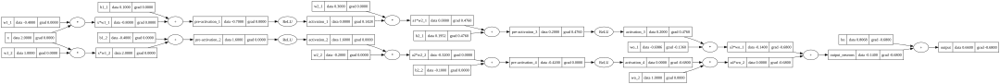

In [20]:
step_size = -0.01

w1_1.data += step_size * w1_1.grad
w1_2.data += step_size * w1_2.grad
b1_1.data += step_size * b1_1.grad
b1_2.data += step_size * b1_2.grad
w2_1.data += step_size * w2_1.grad
w2_2.data += step_size * w2_2.grad
b2_1.data += step_size * b2_1.grad
b2_2.data += step_size * b2_2.grad
wo_1.data += step_size * wo_1.grad
wo_2.data += step_size * wo_2.grad
bo.data += step_size * bo.grad

draw_dot(o)

NUEVO FORWARD PASS

target: 1.0, pred: 0.67, loss (0.67 - 1.0)**2 = 0.109


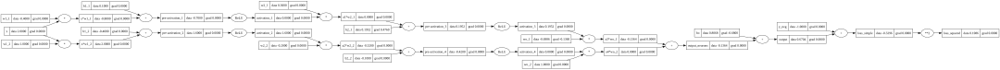

In [21]:
# First hidden layer
xw1_1 = x*w1_1; xw1_1.label = 'x*w1_1'
xw1_2 = x*w1_2; xw1_2.label = 'x*w1_2'

n1 = xw1_1 + b1_1; n1.label = 'pre-activation_1'
n2 = xw1_2 + b1_2; n2.label = 'pre-activation_2'

a1 = n1.relu(); a1.label = 'activation_1'
a2 = n2.relu(); a2.label = 'activation_2'

# Second hidden layer
xw2_1 = a1*w2_1; xw2_1.label = 'a1*w2_1'
xw2_2 = a2*w2_2; xw2_2.label = 'a2*w2_2'

n3 = xw2_1 + b2_1; n3.label = 'pre-activation_3'
n4 = xw2_2 + b2_2; n4.label = 'pre-activation_4'

a3 = n3.relu(); a3.label = 'activation_3'
a4 = n4.relu(); a4.label = 'activation_4'

# Output layer
xw3_1 = a3*wo_1; xw3_1.label = 'a3*wo_1'
xw3_2 = a4*wo_2; xw3_2.label = 'a4*wo_2'

o_neurons = xw3_1 + xw3_2; o_neurons.label = 'output_neurons'
o = o_neurons + bo; o.label = 'output'

y_neg = Value(-y.data, label='y_neg')

loss_simple = o + y_neg; loss_simple.label = 'loss_simple'

loss = loss_simple**2; loss.label = 'loss_squared'
print(f'target: {y.data}, pred: {round(o.data, 3)}, loss ({round(o.data, 3)} - {y.data})**2 = {round(loss.data, 3)}')

draw_dot(loss)

AUTOMATICO

step_size: -0.009000000000000001
target: 1.0, pred: 0.669, loss (0.669 - 1.0)**2 = 0.109
step_size: -0.008100000000000001
target: 1.0, pred: 0.748, loss (0.748 - 1.0)**2 = 0.063
step_size: -0.007290000000000001
target: 1.0, pred: 0.803, loss (0.803 - 1.0)**2 = 0.039
step_size: -0.006561000000000002
target: 1.0, pred: 0.841, loss (0.841 - 1.0)**2 = 0.025
step_size: -0.005904900000000002
target: 1.0, pred: 0.869, loss (0.869 - 1.0)**2 = 0.017
step_size: -0.005314410000000002
target: 1.0, pred: 0.89, loss (0.89 - 1.0)**2 = 0.012
step_size: -0.004782969000000002
target: 1.0, pred: 0.906, loss (0.906 - 1.0)**2 = 0.009
step_size: -0.004304672100000002
target: 1.0, pred: 0.918, loss (0.918 - 1.0)**2 = 0.007
step_size: -0.003874204890000002
target: 1.0, pred: 0.928, loss (0.928 - 1.0)**2 = 0.005
step_size: -0.003486784401000002
target: 1.0, pred: 0.935, loss (0.935 - 1.0)**2 = 0.004
step_size: -0.003138105960900002
target: 1.0, pred: 0.942, loss (0.942 - 1.0)**2 = 0.003
step_size: -0.002824295

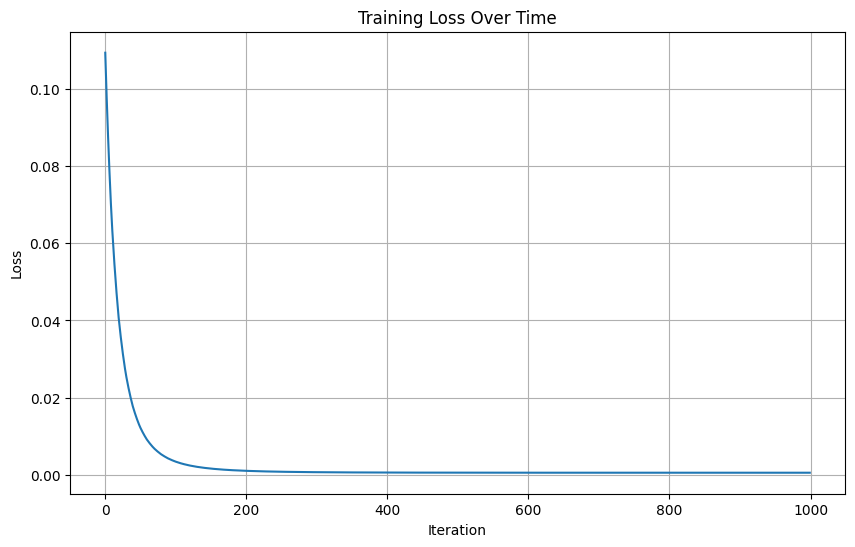

In [24]:
step_size = -0.01
losses = []  # Store losses for plotting

for i in range(1000):
    # change step size each 10 iterations
    if i % 10 == 0:
        step_size = step_size * 0.9
        print(f"step_size: {step_size}")

    # backward pass
    w1_1.grad = 0.0
    w1_2.grad = 0.0
    b1_1.grad = 0.0
    b1_2.grad = 0.0
    w2_1.grad = 0.0
    w2_2.grad = 0.0
    b2_1.grad = 0.0
    b2_2.grad = 0.0
    wo_1.grad = 0.0
    wo_2.grad = 0.0
    bo.grad = 0.0
    loss.grad = 1.0

    loss.backward()

    # update
    w1_1.data += step_size * w1_1.grad
    w1_2.data += step_size * w1_2.grad
    b1_1.data += step_size * b1_1.grad
    b1_2.data += step_size * b1_2.grad
    w2_1.data += step_size * w2_1.grad
    w2_2.data += step_size * w2_2.grad
    b2_1.data += step_size * b2_1.grad
    b2_2.data += step_size * b2_2.grad
    wo_1.data += step_size * wo_1.grad
    wo_2.data += step_size * wo_2.grad
    bo.data += step_size * bo.grad

    # forward pass
    xw1_1 = x*w1_1; xw1_1.label = 'x*w1_1'
    xw1_2 = x*w1_2; xw1_2.label = 'x*w1_2'
    n1 = xw1_1 + b1_1; n1.label = 'pre-activation_1'
    n2 = xw1_2 + b1_2; n2.label = 'pre-activation_2'
    a1 = n1.relu(); a1.label = 'activation_1'
    a2 = n2.relu(); a2.label = 'activation_2'
    xw2_1 = a1*w2_1; xw2_1.label = 'a1*w2_1'
    xw2_2 = a2*w2_2; xw2_2.label = 'a2*w2_2'
    n3 = xw2_1 + b2_1; n3.label = 'pre-activation_3'
    n4 = xw2_2 + b2_2; n4.label = 'pre-activation_4'
    a3 = n3.relu(); a3.label = 'activation_3'
    a4 = n4.relu(); a4.label = 'activation_4'
    xw3_1 = a3*wo_1; xw3_1.label = 'a3*wo_1'
    xw3_2 = a4*wo_2; xw3_2.label = 'a4*wo_2'
    o_neurons = xw3_1 + xw3_2; o_neurons.label = 'output_neurons'
    o = o_neurons + bo; o.label = 'output'
    y_neg = Value(-y.data, label='y_neg')
    loss_simple = o + y_neg; loss_simple.label = 'loss_simple'
    loss = loss_simple**2; loss.label = 'loss_squared'

    if i % 10 == 0:
        print(f'target: {y.data}, pred: {round(o.data, 3)}, loss ({round(o.data, 3)} - {y.data})**2 = {round(loss.data, 3)}')
    
    losses.append(loss.data)

# Plot the loss curve
plt.figure(figsize=(10, 6))
plt.plot(losses)
plt.title('Training Loss Over Time')
plt.xlabel('Iteration')
plt.ylabel('Loss')
plt.grid(True)
plt.show()

# draw_dot(loss)

## Complejizando

CADA OPERACION DE LA RED, cada cosa que se hace, esta en el grafo y como va para adelante tambien va para atras en el backprop y tiene su grad. Despues algunos no se usan para seguir hacia atras y quizas algunos no se actualizan ni sirven pero siempre que se usa un elemento en el grafo, puede tener su grad, incluso la data input del modelo.

### Output dim 2 (shallow)

target1: 1.0, pred1: 2.4
target2: 0.5, pred2: -1.9
total loss = 7.72


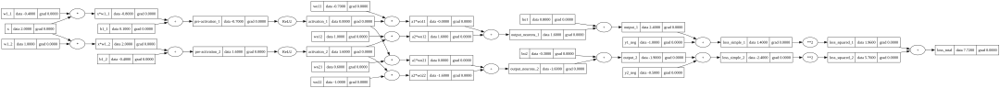

In [27]:
# input
x = Value(2.0, label='x')
y1 = Value(1.0, label='y1')  # target para salida 1
y2 = Value(0.5, label='y2')  # target para salida 2

# hidden layer
w1_1 = Value(-0.4, label='w1_1')
w1_2 = Value(1.0, label='w1_2')
b1_1 = Value(0.1, label='b1_1')
b1_2 = Value(-0.4, label='b1_2')

# primera layer
xw1_1 = x*w1_1; xw1_1.label = 'x*w1_1'
xw1_2 = x*w1_2; xw1_2.label = 'x*w1_2'
n1 = xw1_1 + b1_1; n1.label = 'pre-activation_1'
n2 = xw1_2 + b1_2; n2.label = 'pre-activation_2'
a1 = n1.relu(); a1.label = 'activation_1'
a2 = n2.relu(); a2.label = 'activation_2'

# output layer weights y biases
wo11 = Value(-0.7, label='wo11')  # a1 → o1
wo12 = Value(1.0, label='wo12')   # a2 → o1
bo1 = Value(0.8, label='bo1')     # bias o1

wo21 = Value(0.6, label='wo21')   # a1 → o2
wo22 = Value(-1.0, label='wo22')  # a2 → o2
bo2 = Value(-0.3, label='bo2')    # bias o2

# output neuron 1
xw2_1_1 = a1 * wo11; xw2_1_1.label = 'a1*wo11'
xw2_1_2 = a2 * wo12; xw2_1_2.label = 'a2*wo12'
output_neurons1 = xw2_1_1 + xw2_1_2; output_neurons1.label = 'output_neurons_1'
output1 = output_neurons1 + bo1; output1.label = 'output_1'

# output neuron 2
xw2_2_1 = a1 * wo21; xw2_2_1.label = 'a1*wo21'
xw2_2_2 = a2 * wo22; xw2_2_2.label = 'a2*wo22'
output_neurons2 = xw2_2_1 + xw2_2_2; output_neurons2.label = 'output_neurons_2'
output2 = output_neurons2 + bo2; output2.label = 'output_2'

# targets negativos
y1_neg = Value(-y1.data, label='y1_neg')
y2_neg = Value(-y2.data, label='y2_neg')

# loss simple y final
loss_simple1 = output1 + y1_neg; loss_simple1.label = 'loss_simple_1'
loss1 = loss_simple1**2; loss1.label = 'loss_squared_1'

loss_simple2 = output2 + y2_neg; loss_simple2.label = 'loss_simple_2'
loss2 = loss_simple2**2; loss2.label = 'loss_squared_2'

# total loss
loss = loss1 + loss2; loss.label = 'loss_total'

# reporte
print(f"target1: {y1.data}, pred1: {round(output1.data, 3)}")
print(f"target2: {y2.data}, pred2: {round(output2.data, 3)}")
print(f"total loss = {round(loss.data, 4)}")

draw_dot(loss)



[000] loss = 4.4066 | pred1 = 1.937 | pred2 = -1.378
[010] loss = 0.4096 | pred1 = 0.819 | pred2 = -0.114
[020] loss = 0.2397 | pred1 = 0.774 | pred2 = 0.066
[030] loss = 0.1600 | pred1 = 0.815 | pred2 = 0.145
[040] loss = 0.1068 | pred1 = 0.849 | pred2 = 0.210
[050] loss = 0.0713 | pred1 = 0.877 | pred2 = 0.263
[060] loss = 0.0476 | pred1 = 0.899 | pred2 = 0.306
[070] loss = 0.0318 | pred1 = 0.918 | pred2 = 0.342
[080] loss = 0.0212 | pred1 = 0.933 | pred2 = 0.371
[090] loss = 0.0142 | pred1 = 0.945 | pred2 = 0.394


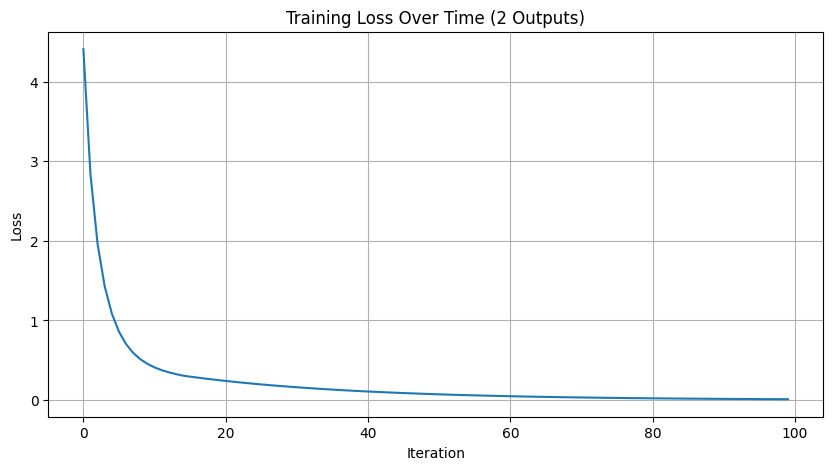

In [28]:
# learning rate
step_size = -0.01
losses = []

for i in range(100):

    # 1. RESET GRADS
    for p in [w1_1, w1_2, b1_1, b1_2, wo11, wo12, bo1, wo21, wo22, bo2]:
        p.grad = 0.0

    # 2. BACKWARD PASS
    loss.grad = 1.0
    loss.backward()

    # 3. PARAMETER UPDATE
    for p in [w1_1, w1_2, b1_1, b1_2, wo11, wo12, bo1, wo21, wo22, bo2]:
        p.data += step_size * p.grad

    # 4. NEW FORWARD PASS
    xw1_1 = x * w1_1; xw1_1.label = 'x*w1_1'
    xw1_2 = x * w1_2; xw1_2.label = 'x*w1_2'
    n1 = xw1_1 + b1_1; n1.label = 'pre-activation_1'
    n2 = xw1_2 + b1_2; n2.label = 'pre-activation_2'
    a1 = n1.relu(); a1.label = 'activation_1'
    a2 = n2.relu(); a2.label = 'activation_2'

    xw2_1_1 = a1 * wo11; xw2_1_1.label = 'a1*wo11'
    xw2_1_2 = a2 * wo12; xw2_1_2.label = 'a2*wo12'
    output_neurons1 = xw2_1_1 + xw2_1_2; output_neurons1.label = 'output_neurons_1'
    output1 = output_neurons1 + bo1; output1.label = 'output_1'

    xw2_2_1 = a1 * wo21; xw2_2_1.label = 'a1*wo21'
    xw2_2_2 = a2 * wo22; xw2_2_2.label = 'a2*wo22'
    output_neurons2 = xw2_2_1 + xw2_2_2; output_neurons2.label = 'output_neurons_2'
    output2 = output_neurons2 + bo2; output2.label = 'output_2'

    y1_neg = Value(-y1.data, label='y1_neg')
    y2_neg = Value(-y2.data, label='y2_neg')

    loss_simple1 = output1 + y1_neg; loss_simple1.label = 'loss_simple_1'
    loss1 = loss_simple1**2; loss1.label = 'loss_squared_1'

    loss_simple2 = output2 + y2_neg; loss_simple2.label = 'loss_simple_2'
    loss2 = loss_simple2**2; loss2.label = 'loss_squared_2'

    loss = loss1 + loss2; loss.label = 'loss_total'

    # 5. LOGGING
    if i % 10 == 0:
        print(f"[{i:03d}] loss = {loss.data:.4f} | pred1 = {output1.data:.3f} | pred2 = {output2.data:.3f}")

    losses.append(loss.data)

# Plot
plt.figure(figsize=(10, 5))
plt.plot(losses)
plt.xlabel("Iteration")
plt.ylabel("Loss")
plt.title("Training Loss Over Time (2 Outputs)")
plt.grid(True)
plt.show()

### Data batch 2 (shallow)

Aca se da algo particular. Como tenemos dos ejemplos, el grafo es como que se duplica, entonces: **Hay parametros que reciben desde dos lados**, por ej w1_1 se usa dos veces, manda dos flechas y por lo tanto, recibe dos flows de gradientes cuando se hace backprop. Estos se SUMAN porque son las contribuciones de ambos ejemplos.

pred1: 1.7700, target1: 1.0
pred2: 1.1940, target2: 0.0
total loss = 2.0185


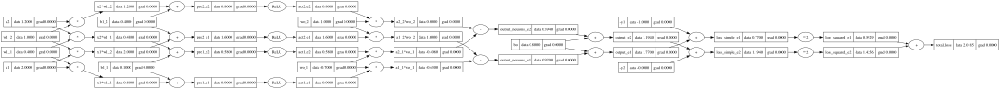

In [4]:
# ejemplo 1
x1 = Value(2.0, label='x1')
y1 = Value(1.0, label='y1')

# ejemplo 2
x2 = Value(1.2, label='x2')
y2 = Value(0.0, label='y2')

# pesos compartidos
w1_1 = Value(0.4, label='w1_1')
w1_2 = Value(1.0, label='w1_2')
b1_1 = Value(0.1, label='b1_1')
b1_2 = Value(-0.4, label='b1_2')

wo_1 = Value(-0.7, label='wo_1')
wo_2 = Value(1.0, label='wo_2')
bo = Value(0.8, label='bo')

# === FORWARD EJEMPLO 1 ===
x1w1_1 = x1 * w1_1; x1w1_1.label = 'x1*w1_1'
x1w1_2 = x1 * w1_2; x1w1_2.label = 'x1*w1_2'

n1_1 = x1w1_1 + b1_1; n1_1.label = 'pre1_e1'
n1_2 = x1w1_2 + b1_2; n1_2.label = 'pre2_e1'

a1_1 = n1_1.relu(); a1_1.label = 'act1_e1'
a1_2 = n1_2.relu(); a1_2.label = 'act2_e1'

x1w2_1 = a1_1 * wo_1; x1w2_1.label = 'a1_1*wo_1'
x1w2_2 = a1_2 * wo_2; x1w2_2.label = 'a1_2*wo_2'

output_neurons1 = x1w2_1 + x1w2_2; output_neurons1.label = 'output_neurons_e1'
output1 = output_neurons1 + bo; output1.label = 'output_e1'

y1_neg = Value(-y1.data, label='-y1')
loss_simple1 = output1 + y1_neg; loss_simple1.label = 'loss_simple_e1'
loss1 = loss_simple1**2; loss1.label = 'loss_squared_e1'

# === FORWARD EJEMPLO 2 ===
x2w1_1 = x2 * w1_1; x2w1_1.label = 'x2*w1_1'
x2w1_2 = x2 * w1_2; x2w1_2.label = 'x2*w1_2'

n2_1 = x2w1_1 + b1_1; n2_1.label = 'pre1_e2'
n2_2 = x2w1_2 + b1_2; n2_2.label = 'pre2_e2'

a2_1 = n2_1.relu(); a2_1.label = 'act1_e2'
a2_2 = n2_2.relu(); a2_2.label = 'act2_e2'

x2w2_1 = a2_1 * wo_1; x2w2_1.label = 'a2_1*wo_1'
x2w2_2 = a2_2 * wo_2; x2w2_2.label = 'a2_2*wo_2'

output_neurons2 = x2w2_1 + x2w2_2; output_neurons2.label = 'output_neurons_e2'
output2 = output_neurons2 + bo; output2.label = 'output_e2'

y2_neg = Value(-y2.data, label='-y2')
loss_simple2 = output2 + y2_neg; loss_simple2.label = 'loss_simple_e2'
loss2 = loss_simple2**2; loss2.label = 'loss_squared_e2'

# === LOSS TOTAL ===
loss = loss1 + loss2; loss.label = 'total_loss'

print(f"pred1: {output1.data:.4f}, target1: {y1.data}")
print(f"pred2: {output2.data:.4f}, target2: {y2.data}")
print(f"total loss = {loss.data:.4f}")

draw_dot(loss)


PRUEBO QUE PARA UN WEIGHT (W1_1), EL TOTAL QUE LE LLEGA DE GRAD ES LA SUMA DE SI LE LLEGARA CADA EJEMPLO INDIVIDUALMENTE

In [5]:
# 1. grad1
for v in [w1_1, w1_2, b1_1, b1_2, wo_1, wo_2, bo,
          x1w1_1, x1w1_2, n1_1, n1_2, a1_1, a1_2,
          x1w2_1, x1w2_2, output_neurons1, output1,
          y1_neg, loss_simple1, loss1]:
    v.grad = 0.0
loss1.grad = 1.0
loss1.backward()
grad1 = w1_1.grad

# 2. grad2
for v in [w1_1, w1_2, b1_1, b1_2, wo_1, wo_2, bo,
          x2w1_1, x2w1_2, n2_1, n2_2, a2_1, a2_2,
          x2w2_1, x2w2_2, output_neurons2, output2,
          y2_neg, loss_simple2, loss2]:
    v.grad = 0.0
loss2.grad = 1.0
loss2.backward()
grad2 = w1_1.grad

# 3. grad total
for v in [w1_1, w1_2, b1_1, b1_2, wo_1, wo_2, bo,
          x1w1_1, x1w1_2, n1_1, n1_2, a1_1, a1_2,
          x1w2_1, x1w2_2, output_neurons1, output1,
          y1_neg, loss_simple1, loss1,
          x2w1_1, x2w1_2, n2_1, n2_2, a2_1, a2_2,
          x2w2_1, x2w2_2, output_neurons2, output2,
          y2_neg, loss_simple2, loss2,
          loss]:
    v.grad = 0.0
loss.grad = 1.0
loss.backward()
grad_total = w1_1.grad

# confirmación
print(f"grad1: {grad1:.6f}")
print(f"grad2: {grad2:.6f}")
print(f"grad_total: {grad_total:.6f}")
print(f"suma: {grad1 + grad2:.6f}")


grad1: -2.156000
grad2: -2.005920
grad_total: -4.161920
suma: -4.161920


In [6]:
# # 1. Reset gradientes
# for p in [w1_1, w1_2, b1_1, b1_2, wo_1, wo_2, bo]:
#     p.grad = 0.0

# # 2. Backward pass
# loss.grad = 1.0
# loss.backward()

# draw_dot(loss)

[000] loss = 3.4957 | pred1 = -0.817 | pred2 = -0.439
[010] loss = 0.3386 | pred1 = 0.598 | pred2 = 0.421
[020] loss = 0.3026 | pred1 = 0.679 | pred2 = 0.447
[030] loss = 0.2754 | pred1 = 0.698 | pred2 = 0.429
[040] loss = 0.2499 | pred1 = 0.712 | pred2 = 0.409
[050] loss = 0.2259 | pred1 = 0.726 | pred2 = 0.389
[060] loss = 0.2036 | pred1 = 0.740 | pred2 = 0.369
[070] loss = 0.1827 | pred1 = 0.754 | pred2 = 0.350
[080] loss = 0.1634 | pred1 = 0.768 | pred2 = 0.331
[090] loss = 0.1456 | pred1 = 0.781 | pred2 = 0.312


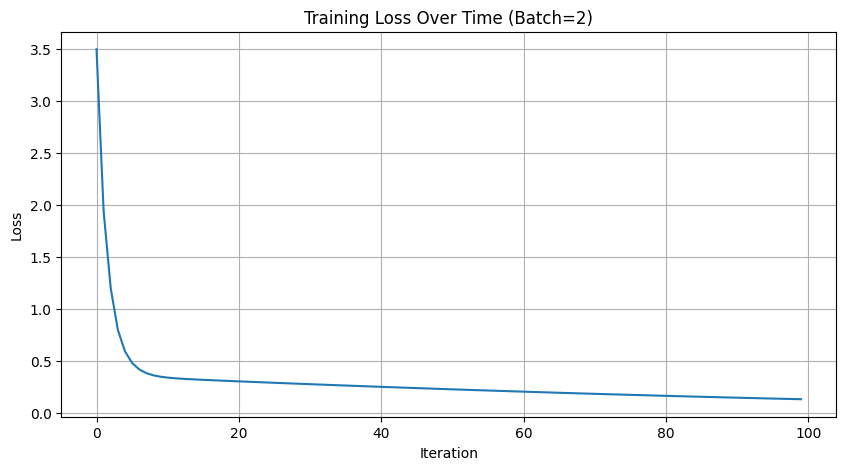

In [7]:
step_size = -0.01
losses = []

for i in range(100):

    # 1. Reset gradientes
    for p in [w1_1, w1_2, b1_1, b1_2, wo_1, wo_2, bo]:
        p.grad = 0.0

    # 2. Backward pass
    loss.grad = 1.0
    loss.backward()

    # 3. Update de parámetros
    for p in [w1_1, w1_2, b1_1, b1_2, wo_1, wo_2, bo]:
        p.data += step_size * p.grad

    # 4. Forward pass para ejemplo 1
    x1w1_1 = x1 * w1_1; x1w1_1.label = 'x1*w1_1'
    x1w1_2 = x1 * w1_2; x1w1_2.label = 'x1*w1_2'
    n1_1 = x1w1_1 + b1_1; n1_1.label = 'pre1_e1'
    n1_2 = x1w1_2 + b1_2; n1_2.label = 'pre2_e1'
    a1_1 = n1_1.relu(); a1_1.label = 'act1_e1'
    a1_2 = n1_2.relu(); a1_2.label = 'act2_e1'
    x1w2_1 = a1_1 * wo_1; x1w2_1.label = 'a1_1*wo_1'
    x1w2_2 = a1_2 * wo_2; x1w2_2.label = 'a1_2*wo_2'
    output_neurons1 = x1w2_1 + x1w2_2; output_neurons1.label = 'output_neurons_e1'
    output1 = output_neurons1 + bo; output1.label = 'output_e1'
    y1_neg = Value(-y1.data, label='-y1')
    loss_simple1 = output1 + y1_neg; loss_simple1.label = 'loss_simple_e1'
    loss1 = loss_simple1**2; loss1.label = 'loss_squared_e1'

    # 5. Forward pass para ejemplo 2
    x2w1_1 = x2 * w1_1; x2w1_1.label = 'x2*w1_1'
    x2w1_2 = x2 * w1_2; x2w1_2.label = 'x2*w1_2'
    n2_1 = x2w1_1 + b1_1; n2_1.label = 'pre1_e2'
    n2_2 = x2w1_2 + b1_2; n2_2.label = 'pre2_e2'
    a2_1 = n2_1.relu(); a2_1.label = 'act1_e2'
    a2_2 = n2_2.relu(); a2_2.label = 'act2_e2'
    x2w2_1 = a2_1 * wo_1; x2w2_1.label = 'a2_1*wo_1'
    x2w2_2 = a2_2 * wo_2; x2w2_2.label = 'a2_2*wo_2'
    output_neurons2 = x2w2_1 + x2w2_2; output_neurons2.label = 'output_neurons_e2'
    output2 = output_neurons2 + bo; output2.label = 'output_e2'
    y2_neg = Value(-y2.data, label='-y2')
    loss_simple2 = output2 + y2_neg; loss_simple2.label = 'loss_simple_e2'
    loss2 = loss_simple2**2; loss2.label = 'loss_squared_e2'

    # 6. Total loss
    loss = loss1 + loss2; loss.label = 'loss_total'

    # 7. Logging
    if i % 10 == 0:
        print(f"[{i:03d}] loss = {loss.data:.4f} | pred1 = {output1.data:.3f} | pred2 = {output2.data:.3f}")

    losses.append(loss.data)

    # break

# 8. Plot de la pérdida
plt.figure(figsize=(10, 5))
plt.plot(losses)
plt.xlabel("Iteration")
plt.ylabel("Loss")
plt.title("Training Loss Over Time (Batch=2)")
plt.grid(True)
plt.show()


### Cross-entropy loss (shallow)

Tuve que añadir log y exp como operaciones basicas

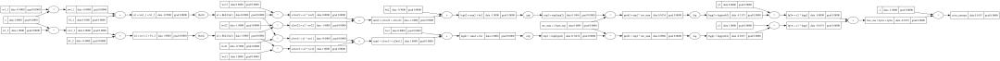

In [22]:
# Entradas y targets
x = Value(2.0, label='x')
y1 = Value(1.0, label='y1')
y2 = Value(0.0, label='y2')

# Pesos capa oculta
w1_1 = Value(-0.4, label='w1_1')
w1_2 = Value(1.0, label='w1_2')
b1_1 = Value(0.1, label='b1_1')
b1_2 = Value(-0.4, label='b1_2')

# Capa oculta
xw1_1 = x * w1_1; xw1_1.label = 'xw1_1'
xw1_2 = x * w1_2; xw1_2.label = 'xw1_2'
n1 = xw1_1 + b1_1; n1.label = 'n1 = xw1_1 + b1_1'
n2 = xw1_2 + b1_2; n2.label = 'n2 = xw1_2 + b1_2'
a1 = n1.relu(); a1.label = 'a1 = ReLU(n1)'
a2 = n2.relu(); a2.label = 'a2 = ReLU(n2)'

# Pesos capa output
wo11 = Value(-0.7, label='wo11')
wo12 = Value(1.0, label='wo12')
bo1 = Value(0.8, label='bo1')
wo21 = Value(0.6, label='wo21')
wo22 = Value(-1.0, label='wo22')
bo2 = Value(-0.3, label='bo2')

# Neurona output 1
a1wo11 = a1 * wo11; a1wo11.label = 'a1wo11 = a1 * wo11'
a2wo12 = a2 * wo12; a2wo12.label = 'a2wo12 = a2 * wo12'
sum1 = a1wo11 + a2wo12; sum1.label = 'sum1 = a1wo11 + a2wo12'
logit1 = sum1 + bo1; logit1.label = 'logit1 = sum1 + bo1'

# Neurona output 2
a1wo21 = a1 * wo21; a1wo21.label = 'a1wo21 = a1 * wo21'
a2wo22 = a2 * wo22; a2wo22.label = 'a2wo22 = a2 * wo22'
sum2 = a1wo21 + a2wo22; sum2.label = 'sum2 = a1wo21 + a2wo22'
logit2 = sum2 + bo2; logit2.label = 'logit2 = sum2 + bo2'

# Softmax
exp1 = logit1.exp(); exp1.label = 'exp1 = exp(logit1)'
exp2 = logit2.exp(); exp2.label = 'exp2 = exp(logit2)'
sum_exp = exp1 + exp2; sum_exp.label = 'sum_exp = exp1 + exp2'
inv_sum = Value(1.0 / sum_exp.data, label='inv_sum = 1/sum_exp') # No lo incluimos porque no queremos que se calcule el gradiente de sum_exp, por eso usamos sum_exp.data 
# inv_sum = Value(1.0, label='1.0') * (sum_exp ** -1); inv_sum.label = 'inv_sum = 1/sum_exp' # Si quisieramos incluirlo
prob1 = exp1 * inv_sum; prob1.label = 'prob1 = exp1 * inv_sum'
prob2 = exp2 * inv_sum; prob2.label = 'prob2 = exp2 * inv_sum'

# Cross-entropy
logp1 = prob1.log(); logp1.label = 'logp1 = log(prob1)'
logp2 = prob2.log(); logp2.label = 'logp2 = log(prob2)'
lp1w = logp1 * y1; lp1w.label = 'lp1w = y1 * logp1'
lp2w = logp2 * y2; lp2w.label = 'lp2w = y2 * logp2'
loss_raw = lp1w + lp2w; loss_raw.label = 'loss_raw = lp1w + lp2w'
neg1 = Value(-1.0, label='-1')
loss = neg1 * loss_raw; loss.label = 'cross_entropy'

draw_dot(loss)


[000] loss = 0.0118 | prob1 = 0.988 | prob2 = 0.012
[010] loss = 0.0114 | prob1 = 0.989 | prob2 = 0.011
[020] loss = 0.0110 | prob1 = 0.989 | prob2 = 0.011
[030] loss = 0.0107 | prob1 = 0.989 | prob2 = 0.011
[040] loss = 0.0104 | prob1 = 0.990 | prob2 = 0.010
[050] loss = 0.0101 | prob1 = 0.990 | prob2 = 0.010
[060] loss = 0.0098 | prob1 = 0.990 | prob2 = 0.010
[070] loss = 0.0096 | prob1 = 0.990 | prob2 = 0.010
[080] loss = 0.0093 | prob1 = 0.991 | prob2 = 0.009
[090] loss = 0.0091 | prob1 = 0.991 | prob2 = 0.009
[100] loss = 0.0088 | prob1 = 0.991 | prob2 = 0.009
[110] loss = 0.0086 | prob1 = 0.991 | prob2 = 0.009
[120] loss = 0.0084 | prob1 = 0.992 | prob2 = 0.008
[130] loss = 0.0082 | prob1 = 0.992 | prob2 = 0.008
[140] loss = 0.0080 | prob1 = 0.992 | prob2 = 0.008
[150] loss = 0.0078 | prob1 = 0.992 | prob2 = 0.008
[160] loss = 0.0076 | prob1 = 0.992 | prob2 = 0.008
[170] loss = 0.0075 | prob1 = 0.993 | prob2 = 0.007
[180] loss = 0.0073 | prob1 = 0.993 | prob2 = 0.007
[190] loss =

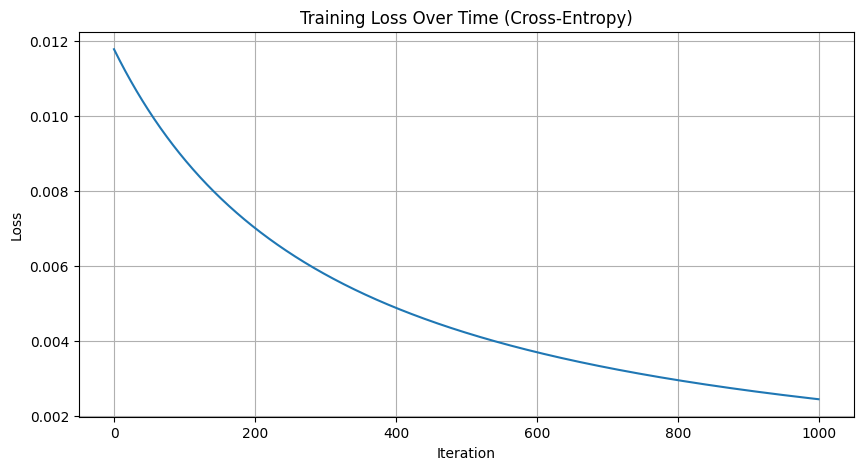

In [23]:
import matplotlib.pyplot as plt

step_size = -0.01
losses = []

# Entrenamiento
for i in range(1000):

    # Reset gradientes
    for p in [w1_1, w1_2, b1_1, b1_2, wo11, wo12, bo1, wo21, wo22, bo2]:
        p.grad = 0.0

    # Backward
    loss.grad = 1.0
    loss.backward()

    # Update
    for p in [w1_1, w1_2, b1_1, b1_2, wo11, wo12, bo1, wo21, wo22, bo2]:
        p.data += step_size * p.grad

    # Forward
    xw1_1 = x * w1_1; xw1_1.label = 'xw1_1'
    xw1_2 = x * w1_2; xw1_2.label = 'xw1_2'
    n1 = xw1_1 + b1_1; n1.label = 'n1'
    n2 = xw1_2 + b1_2; n2.label = 'n2'
    a1 = n1.relu(); a1.label = 'a1'
    a2 = n2.relu(); a2.label = 'a2'

    a1wo11 = a1 * wo11; a1wo11.label = 'a1wo11'
    a2wo12 = a2 * wo12; a2wo12.label = 'a2wo12'
    sum1 = a1wo11 + a2wo12; sum1.label = 'sum1'
    logit1 = sum1 + bo1; logit1.label = 'logit1'

    a1wo21 = a1 * wo21; a1wo21.label = 'a1wo21'
    a2wo22 = a2 * wo22; a2wo22.label = 'a2wo22'
    sum2 = a1wo21 + a2wo22; sum2.label = 'sum2'
    logit2 = sum2 + bo2; logit2.label = 'logit2'

    exp1 = logit1.exp(); exp1.label = 'exp1'
    exp2 = logit2.exp(); exp2.label = 'exp2'
    sum_exp = exp1 + exp2; sum_exp.label = 'sum_exp'
    inv_sum = Value(1.0) * (sum_exp ** -1); inv_sum.label = 'inv_sum'
    prob1 = exp1 * inv_sum; prob1.label = 'prob1'
    prob2 = exp2 * inv_sum; prob2.label = 'prob2'

    logp1 = prob1.log(); logp1.label = 'logp1'
    logp2 = prob2.log(); logp2.label = 'logp2'
    lp1w = logp1 * y1; lp1w.label = 'lp1w'
    lp2w = logp2 * y2; lp2w.label = 'lp2w'
    loss_raw = lp1w + lp2w; loss_raw.label = 'loss_raw'
    loss = Value(-1.0) * loss_raw; loss.label = 'cross_entropy'


    losses.append(loss.data)
    # Log
    if i % 10 == 0:
        print(f"[{i:03d}] loss = {loss.data:.4f} | prob1 = {prob1.data:.3f} | prob2 = {prob2.data:.3f}")

# Plot
plt.figure(figsize=(10, 5))
plt.plot(losses)
plt.xlabel("Iteration")
plt.ylabel("Loss")
plt.title("Training Loss Over Time (Cross-Entropy)")
plt.grid(True)
plt.show()


### Todo lo anterior

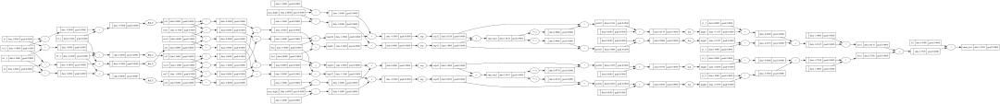

In [49]:
EPS = 1e-8  # Para evitar log(0)

# === INPUTS ===
x1 = Value(2.0, label='x1')
y1_1 = Value(1.0, label='y1_1')
y1_2 = Value(0.0, label='y1_2')

x2 = Value(1.2, label='x2')
y2_1 = Value(0.0, label='y2_1')
y2_2 = Value(1.0, label='y2_2')

# === PESOS COMPARTIDOS ===
w1_1 = Value(-0.4, label='w1_1')
w1_2 = Value(1.0, label='w1_2')
b1_1 = Value(0.1, label='b1_1')
b1_2 = Value(-0.4, label='b1_2')

wo11 = Value(-0.7, label='wo11')
wo12 = Value(1.0, label='wo12')
bo1 = Value(0.8, label='bo1')

wo21 = Value(0.6, label='wo21')
wo22 = Value(-1.0, label='wo22')
bo2 = Value(-0.3, label='bo2')

# === FORWARD EJEMPLO 1 ===
a11 = (x1 * w1_1 + b1_1).relu(); a11.label = 'a11'
a12 = (x1 * w1_2 + b1_2).relu(); a12.label = 'a12'
logit11 = a11 * wo11 + a12 * wo12 + bo1; logit11.label = 'logit11'
logit12 = a11 * wo21 + a12 * wo22 + bo2; logit12.label = 'logit12'

max_logit1 = Value(max(logit11.data, logit12.data), label='max_logit1')
exp11 = (logit11 + (-max_logit1)).exp(); exp11.label = 'exp11'
exp12 = (logit12 + (-max_logit1)).exp(); exp12.label = 'exp12'
sum_exp1 = exp11 + exp12; sum_exp1.label = 'sum_exp1'
prob11 = exp11 / sum_exp1; prob11.label = 'prob11'
prob12 = exp12 / sum_exp1; prob12.label = 'prob12'

logp11 = (prob11 + EPS).log(); logp11.label = 'logp11'
logp12 = (prob12 + EPS).log(); logp12.label = 'logp12'
loss1 = -(y1_1 * logp11 + y1_2 * logp12); loss1.label = 'loss1'

# === FORWARD EJEMPLO 2 ===
a21 = (x2 * w1_1 + b1_1).relu(); a21.label = 'a21'
a22 = (x2 * w1_2 + b1_2).relu(); a22.label = 'a22'
logit21 = a21 * wo11 + a22 * wo12 + bo1; logit21.label = 'logit21'
logit22 = a21 * wo21 + a22 * wo22 + bo2; logit22.label = 'logit22'

max_logit2 = Value(max(logit21.data, logit22.data), label='max_logit2')
exp21 = (logit21 + (-max_logit2)).exp(); exp21.label = 'exp21'
exp22 = (logit22 + (-max_logit2)).exp(); exp22.label = 'exp22'
sum_exp2 = exp21 + exp22; sum_exp2.label = 'sum_exp2'
prob21 = exp21 / sum_exp2; prob21.label = 'prob21'
prob22 = exp22 / sum_exp2; prob22.label = 'prob22'

logp21 = (prob21 + EPS).log(); logp21.label = 'logp21'
logp22 = (prob22 + EPS).log(); logp22.label = 'logp22'
loss2 = -(y2_1 * logp21 + y2_2 * logp22); loss2.label = 'loss2'

mean_factor = Value(0.5, label='1/2')
loss = (loss1 + loss2) * mean_factor; loss.label = 'mean_loss'

draw_dot(loss)


[000] loss = 1.1306
[010] loss = 0.5771
[020] loss = 0.4984
[030] loss = 0.4384
[040] loss = 0.3886
[050] loss = 0.3553
[060] loss = 0.3056
[070] loss = 0.2788
[080] loss = 0.2378
[090] loss = 0.2108
[100] loss = 0.1948
[110] loss = 0.1681
[120] loss = 0.1533
[130] loss = 0.1357
[140] loss = 0.1228
[150] loss = 0.1115
[160] loss = 0.1056
[170] loss = 0.0940
[180] loss = 0.0901
[190] loss = 0.0836
[200] loss = 0.0776
[210] loss = 0.0723
[220] loss = 0.0676
[230] loss = 0.0633
[240] loss = 0.0595
[250] loss = 0.0560
[260] loss = 0.0528
[270] loss = 0.0499
[280] loss = 0.0473
[290] loss = 0.0460


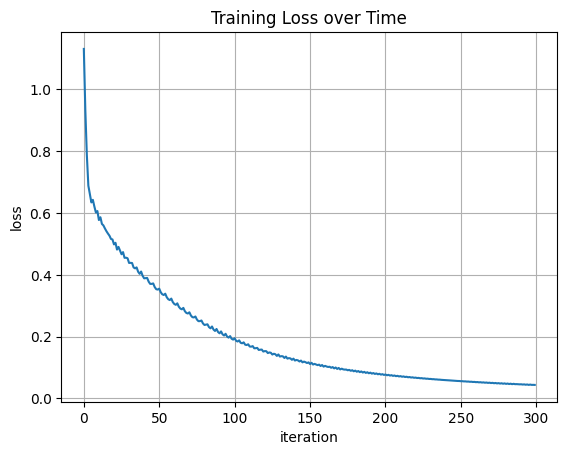

In [50]:
params = [w1_1, w1_2, b1_1, b1_2, wo11, wo12, bo1, wo21, wo22, bo2]
step_size = -0.1
losses = []

for i in range(300):
    for p in params:
        p.grad = 0.0
    loss.grad = 1.0
    loss.backward()
    for p in params:
        p.data += step_size * p.grad

    # === RECONSTRUIR FORWARD ===
    a11 = (x1 * w1_1 + b1_1).relu()
    a12 = (x1 * w1_2 + b1_2).relu()
    logit11 = a11 * wo11 + a12 * wo12 + bo1
    logit12 = a11 * wo21 + a12 * wo22 + bo2

    max_logit1 = Value(max(logit11.data, logit12.data))
    exp11 = (logit11 + (-max_logit1)).exp()
    exp12 = (logit12 + (-max_logit1)).exp()
    sum_exp1 = exp11 + exp12
    prob11 = exp11 / sum_exp1
    prob12 = exp12 / sum_exp1
    logp11 = (prob11 + EPS).log()
    logp12 = (prob12 + EPS).log()
    loss1 = -(y1_1 * logp11 + y1_2 * logp12)

    a21 = (x2 * w1_1 + b1_1).relu()
    a22 = (x2 * w1_2 + b1_2).relu()
    logit21 = a21 * wo11 + a22 * wo12 + bo1
    logit22 = a21 * wo21 + a22 * wo22 + bo2
    max_logit2 = Value(max(logit21.data, logit22.data))
    exp21 = (logit21 + (-max_logit2)).exp()
    exp22 = (logit22 + (-max_logit2)).exp()
    sum_exp2 = exp21 + exp22
    prob21 = exp21 / sum_exp2
    prob22 = exp22 / sum_exp2
    logp21 = (prob21 + EPS).log()
    logp22 = (prob22 + EPS).log()
    loss2 = -(y2_1 * logp21 + y2_2 * logp22)

    loss = (loss1 + loss2) * 0.5

    if i % 10 == 0:
        print(f"[{i:03d}] loss = {loss.data:.4f}")
    losses.append(loss.data)

plt.plot(losses)
plt.title("Training Loss over Time")
plt.xlabel("iteration")
plt.ylabel("loss")
plt.grid(True)
plt.show()


## Backprop con tensors

https://github.com/karpathy/nn-zero-to-hero/blob/master/lectures/makemore/makemore_part4_backprop.ipynb

In [3]:
import torch
import torch.nn.functional as F
import matplotlib.pyplot as plt # for making figures
%matplotlib inline

# read in all the words
words = open('data/names.txt', 'r').read().splitlines()
print(len(words))
print(max(len(w) for w in words))
print(words[:8])

# build the vocabulary of characters and mappings to/from integers
chars = sorted(list(set(''.join(words))))
stoi = {s:i+1 for i,s in enumerate(chars)}
stoi['.'] = 0
itos = {i:s for s,i in stoi.items()}
vocab_size = len(itos)
print(itos)
print(vocab_size)

# build the dataset
block_size = 3 # context length: how many characters do we take to predict the next one?

def build_dataset(words):  
  X, Y = [], []
  
  for w in words:
    context = [0] * block_size
    for ch in w + '.':
      ix = stoi[ch]
      X.append(context)
      Y.append(ix)
      context = context[1:] + [ix] # crop and append

  X = torch.tensor(X)
  Y = torch.tensor(Y)
  print(X.shape, Y.shape)
  return X, Y

import random
random.seed(42)
random.shuffle(words)
n1 = int(0.8*len(words))
n2 = int(0.9*len(words))

Xtr,  Ytr  = build_dataset(words[:n1])     # 80%
Xdev, Ydev = build_dataset(words[n1:n2])   # 10%
Xte,  Yte  = build_dataset(words[n2:])     # 10%

32033
15
['emma', 'olivia', 'ava', 'isabella', 'sophia', 'charlotte', 'mia', 'amelia']
{1: 'a', 2: 'b', 3: 'c', 4: 'd', 5: 'e', 6: 'f', 7: 'g', 8: 'h', 9: 'i', 10: 'j', 11: 'k', 12: 'l', 13: 'm', 14: 'n', 15: 'o', 16: 'p', 17: 'q', 18: 'r', 19: 's', 20: 't', 21: 'u', 22: 'v', 23: 'w', 24: 'x', 25: 'y', 26: 'z', 0: '.'}
27
torch.Size([182625, 3]) torch.Size([182625])
torch.Size([22655, 3]) torch.Size([22655])
torch.Size([22866, 3]) torch.Size([22866])


In [4]:
# utility function we will use later when comparing manual gradients to PyTorch gradients
def cmp(s, dt, t):
  ex = torch.all(dt == t.grad).item()
  app = torch.allclose(dt, t.grad)
  maxdiff = (dt - t.grad).abs().max().item()
  print(f'{s:15s} | exact: {str(ex):5s} | approximate: {str(app):5s} | maxdiff: {maxdiff}')

In [5]:
n_embd = 10 # the dimensionality of the character embedding vectors
n_hidden = 64 # the number of neurons in the hidden layer of the MLP

g = torch.Generator().manual_seed(2147483647) # for reproducibility
C  = torch.randn((vocab_size, n_embd),            generator=g)
# Layer 1
W1 = torch.randn((n_embd * block_size, n_hidden), generator=g) * (5/3)/((n_embd * block_size)**0.5)
b1 = torch.randn(n_hidden,                        generator=g) * 0.1 # using b1 just for fun, it's useless because of BN
# Layer 2
W2 = torch.randn((n_hidden, vocab_size),          generator=g) * 0.1
b2 = torch.randn(vocab_size,                      generator=g) * 0.1
# BatchNorm parameters
bngain = torch.randn((1, n_hidden))*0.1 + 1.0
bnbias = torch.randn((1, n_hidden))*0.1

# Note: I am initializating many of these parameters in non-standard ways
# because sometimes initializating with e.g. all zeros could mask an incorrect
# implementation of the backward pass.

parameters = [C, W1, b1, W2, b2, bngain, bnbias]
print(sum(p.nelement() for p in parameters)) # number of parameters in total
for p in parameters:
  p.requires_grad = True

4137


In [6]:
batch_size = 32
n = batch_size # a shorter variable also, for convenience
# construct a minibatch
ix = torch.randint(0, Xtr.shape[0], (batch_size,), generator=g)
Xb, Yb = Xtr[ix], Ytr[ix] # batch X,Y

# forward pass, "chunkated" into smaller steps that are possible to backward one at a time
emb = C[Xb] # embed the characters into vectors
embcat = emb.view(emb.shape[0], -1) # concatenate the vectors
# Linear layer 1
hprebn = embcat @ W1 + b1 # hidden layer pre-activation
# BatchNorm layer
bnmeani = 1/n*hprebn.sum(0, keepdim=True)
bndiff = hprebn - bnmeani
bndiff2 = bndiff**2
bnvar = 1/(n-1)*(bndiff2).sum(0, keepdim=True) # note: Bessel's correction (dividing by n-1, not n)
bnvar_inv = (bnvar + 1e-5)**-0.5
bnraw = bndiff * bnvar_inv
hpreact = bngain * bnraw + bnbias
# Non-linearity
h = torch.tanh(hpreact) # hidden layer
# Linear layer 2
logits = h @ W2 + b2 # output layer
# cross entropy loss (same as F.cross_entropy(logits, Yb))
logit_maxes = logits.max(1, keepdim=True).values
norm_logits = logits - logit_maxes # subtract max for numerical stability
counts = norm_logits.exp()
counts_sum = counts.sum(1, keepdims=True)
counts_sum_inv = counts_sum**-1 # if I use (1.0 / counts_sum) instead then I can't get backprop to be bit exact...
probs = counts * counts_sum_inv
logprobs = probs.log()
loss = -logprobs[range(n), Yb].mean()

# PyTorch backward pass
for p in parameters:
  p.grad = None
for t in [logprobs, probs, counts, counts_sum, counts_sum_inv, # afaik there is no cleaner way
          norm_logits, logit_maxes, logits, h, hpreact, bnraw,
         bnvar_inv, bnvar, bndiff2, bndiff, hprebn, bnmeani,
         embcat, emb]:
  t.retain_grad()
loss.backward()
loss

tensor(3.3479, grad_fn=<NegBackward0>)

In [10]:
logits.shape, logit_maxes.shape 

(torch.Size([32, 27]), torch.Size([32, 1]))

In [ ]:
# Exercise 1: backprop through the whole thing manually, 
# backpropagating through exactly all of the variables 
# as they are defined in the forward pass above, one by one

"""Lo primero es calcular el gradiente de la loss (loss) wrt logprobs. loss es la media de los logprobs que corresponden a los indices de Yb. 
Quiero que todos los valores de logprobs tengan su gradiente porque todos potencialmente pueden participar en la loss.
AUNQUE la mayoria no participa, solo los que corresponden a los indices de Yb. Asi que la mayoria de los valores de dlogprobs son 0.
Pero los que participan: Como es la derivada cuando hay mean? Como sumas y la division.
La loss es = (-1/n) * logprob1 + (-1/n) * logprob2 +...etc. Entonces para cada termino, como las sumas no hacen nada, solo hacemos la multiplicacion por (-1/n).
Llenamos todos los grads de ceros y los que participan de la loss (los del indice Yb) les ponemos -1/n"""
dlogprobs = torch.zeros_like(logprobs)
dlogprobs[range(n), Yb] = -1.0/n

"""Ahora la derivada de logprobs wrt probs. logprobs es el log de probs. La derivada de log(x) es 1/x. Entonces la derivada de log(probs) es 1/probs.
CADENA: a eso se le multiplica lo anterior"""
dprobs = (1.0 / probs) * dlogprobs

"""Ahora llegamos a probs. Es una operacion que involucra: counts y counts_sum_inv. Empezamos con counts_sum_inv.
probs -> (32,27), counts_sum_inv -> (32, 1). Queda un valor por ejemplo porque es la suma de los probs de cada ejemplo.
Viendolo en el grafo, tenemos:
          counts
           /  \
          /    \
         ↓      ↓
   counts_sum   \
         ↓       \
 counts_sum_inv   \
          \        \
           \        ↓
            \-->  probs
Entonces counts influye a probs desde dos caminos. 
PARA CADA EJEMPLO del batch:
Cada counts_sum_inv (uno para cada ejemplo) participa en los 27 (output size) operaciones resultantes, 
por lo que a cada counts_sum_inv le deberian llegar grads desde los 27 nodos y sumarse todo eso.
Entonces deberiamos expandir counts_sum_inv hasta (32,27) haciendo broadcast de los counts_sum_inv (copias hacia el costado), 
multiplicar eso element-wise con counts y sumar por fila, para quedarnos con (32,1)"""
dcounts_sum_inv = (counts * dprobs).sum(1, keepdim=True)

"""PRIMER CAMINO DE COUNTS (count1, count2, ..., count27) A PROBS: probs tambien tiene a counts como input. Vimos que counts influye en probs desde dos caminos.
 count1            count2
   │\               /│
   │ \             / │
   │  \           /  │
   │   \         /   │
   │    -->SUM<--    │
   │        │        │
   │        ↓        │
   │    inverse_sum  │
   │        │        │
   │        ↓        │
   -----> PROBS <-----
Entonces para tener la derivada de probs wrt counts, como multiplica por counts_sum_inv (haciendo broadcast implicito de counts_sum_inv),
simplemente dejamos counts_sum_inv. O sea para cada valor de counts, le corresponde como grad el valor de counts_sum_inv de ese ejemplo."""
dcounts = counts_sum_inv * dprobs

"""counts_sum_inv es simplemente el inverso de counts_sum == 1/x. 
Entonces la derivada de counts_sum_inv wrt counts_sum es -1/counts_sum**2 (por la regla de potencias: d/dx(x**n) = n*x**(n-1))."""
dcounts_sum = (-counts_sum**-2) * dcounts_sum_inv

"""Ahora el otro camino de counts a probs, por eso se lo SUMAMOS. Derivada de counts_sum wrt counts.
Esto simplemente es: para cada ejemplo, se suman los count... entonces es 1 para count y lo mismo para cada ejemplo."""
dcounts += torch.ones_like(counts) * dcounts_sum

"""counts es el exp de norm_logits. Entonces la derivada de counts wrt norm_logits es el exp de norm_logits."""
dnorm_logits = counts * dcounts

"""LOGITS tambien tiene dos caminos. Uno al max logits y otro al norm_logits. Este es el de norm_logits.
Como norm_logits es logits - logit_maxes, entonces es todo 1, asi que pasa de una, es como multiplicar 1 por dnorm_logits (por la cadena)."""
dlogits = dnorm_logits.clone()

"""Para la resta (para el factor que resta), la derivada es -1. Entonces dlogit_maxes es -dnorm_logits.
En una resta entre logits (32,27) y logit_maxes (32,1), cada logit_maxes (cada ejemplo) participa para los 27 logits del ejemplo,
asi que le tiene que llegar 27 grads. Se suman."""
dlogit_maxes = (-dnorm_logits).sum(1, keepdim=True)

"""LOGITS tambien tiene dos caminos. Uno al max logits y otro al norm_logits. Este es el de logit_maxes.
Gradiente para una funcion de max -> 1 para la posicion del max y 0 para todas las otras posiciones.
"""
dlogits += F.one_hot(logits.max(1).indices, num_classes=logits.shape[1]) * dlogit_maxes

dh = dlogits @ W2.T
dW2 = h.T @ dlogits
db2 = dlogits.sum(0)
dhpreact = (1.0 - h**2) * dh
dbngain = (bnraw * dhpreact).sum(0, keepdim=True)
dbnraw = bngain * dhpreact
dbnbias = dhpreact.sum(0, keepdim=True)
dbndiff = bnvar_inv * dbnraw
dbnvar_inv = (bndiff * dbnraw).sum(0, keepdim=True)
dbnvar = (-0.5*(bnvar + 1e-5)**-1.5) * dbnvar_inv
dbndiff2 = (1.0/(n-1))*torch.ones_like(bndiff2) * dbnvar
dbndiff += (2*bndiff) * dbndiff2
dhprebn = dbndiff.clone()
dbnmeani = (-dbndiff).sum(0)
dhprebn += 1.0/n * (torch.ones_like(hprebn) * dbnmeani)
dembcat = dhprebn @ W1.T
dW1 = embcat.T @ dhprebn
db1 = dhprebn.sum(0)
demb = dembcat.view(emb.shape)
dC = torch.zeros_like(C)
for k in range(Xb.shape[0]):
  for j in range(Xb.shape[1]):
    ix = Xb[k,j]
    dC[ix] += demb[k,j]
    
cmp('logprobs', dlogprobs, logprobs)
cmp('probs', dprobs, probs)
cmp('counts_sum_inv', dcounts_sum_inv, counts_sum_inv)
cmp('counts_sum', dcounts_sum, counts_sum)
cmp('counts', dcounts, counts)
cmp('norm_logits', dnorm_logits, norm_logits)
cmp('logit_maxes', dlogit_maxes, logit_maxes)
cmp('logits', dlogits, logits)
cmp('h', dh, h)
cmp('W2', dW2, W2)
cmp('b2', db2, b2)
cmp('hpreact', dhpreact, hpreact)
cmp('bngain', dbngain, bngain)
cmp('bnbias', dbnbias, bnbias)
cmp('bnraw', dbnraw, bnraw)
cmp('bnvar_inv', dbnvar_inv, bnvar_inv)
cmp('bnvar', dbnvar, bnvar)
cmp('bndiff2', dbndiff2, bndiff2)
cmp('bndiff', dbndiff, bndiff)
cmp('bnmeani', dbnmeani, bnmeani)
cmp('hprebn', dhprebn, hprebn)
cmp('embcat', dembcat, embcat)
cmp('W1', dW1, W1)
cmp('b1', db1, b1)
cmp('emb', demb, emb)
cmp('C', dC, C)

# Estabilizacion del entrenamiento

## Dataset (texto)

In [3]:
import torch
import torch.nn.functional as F
import matplotlib.pyplot as plt # for making figures
%matplotlib inline

# read in all the words
words = open('data/names.txt', 'r').read().splitlines()
words[:8]
print(len(words))

# build the vocabulary of characters and mappings to/from integers
chars = sorted(list(set(''.join(words))))
stoi = {s:i+1 for i,s in enumerate(chars)}
stoi['.'] = 0
itos = {i:s for s,i in stoi.items()}
vocab_size = len(itos)
print(itos)
print(vocab_size)

32033
{1: 'a', 2: 'b', 3: 'c', 4: 'd', 5: 'e', 6: 'f', 7: 'g', 8: 'h', 9: 'i', 10: 'j', 11: 'k', 12: 'l', 13: 'm', 14: 'n', 15: 'o', 16: 'p', 17: 'q', 18: 'r', 19: 's', 20: 't', 21: 'u', 22: 'v', 23: 'w', 24: 'x', 25: 'y', 26: 'z', 0: '.'}
27


In [4]:
# build the dataset
block_size = 3 # context length: how many characters do we take to predict the next one?

def build_dataset(words):  
  X, Y = [], []
  
  for w in words:
    context = [0] * block_size
    for ch in w + '.':
      ix = stoi[ch]
      X.append(context)
      Y.append(ix)
      context = context[1:] + [ix] # crop and append

  X = torch.tensor(X)
  Y = torch.tensor(Y)
  print(X.shape, Y.shape)
  return X, Y

import random
random.seed(42)
random.shuffle(words)
n1 = int(0.8*len(words))
n2 = int(0.9*len(words))

Xtr,  Ytr  = build_dataset(words[:n1])     # 80%
Xdev, Ydev = build_dataset(words[n1:n2])   # 10%
Xte,  Yte  = build_dataset(words[n2:])     # 10%


torch.Size([182625, 3]) torch.Size([182625])
torch.Size([22655, 3]) torch.Size([22655])
torch.Size([22866, 3]) torch.Size([22866])


In [5]:
words[:8]

['yuheng',
 'diondre',
 'xavien',
 'jori',
 'juanluis',
 'erandi',
 'phia',
 'samatha']

In [6]:
Xtr

tensor([[ 0,  0,  0],
        [ 0,  0, 25],
        [ 0, 25, 21],
        ...,
        [15, 12,  4],
        [12,  4,  1],
        [ 4,  1, 14]])

In [7]:
Ytr

tensor([25, 21,  8,  ...,  1, 14,  0])

In [8]:
itos

{1: 'a',
 2: 'b',
 3: 'c',
 4: 'd',
 5: 'e',
 6: 'f',
 7: 'g',
 8: 'h',
 9: 'i',
 10: 'j',
 11: 'k',
 12: 'l',
 13: 'm',
 14: 'n',
 15: 'o',
 16: 'p',
 17: 'q',
 18: 'r',
 19: 's',
 20: 't',
 21: 'u',
 22: 'v',
 23: 'w',
 24: 'x',
 25: 'y',
 26: 'z',
 0: '.'}

## Simple shallow network

In [11]:
# MLP revisited
n_embd = 10 # the dimensionality of the character embedding vectors
n_hidden = 200 # the number of neurons in the hidden layer of the MLP

print(f"Arquitectura de la red: input_dim = {n_embd * block_size}, 1 layer de {n_hidden} neuronas y output_dim = {vocab_size}")

g = torch.Generator().manual_seed(2147483647) # for reproducibility

# Matrix C (embeddings)
C  = torch.randn((vocab_size, n_embd),            generator=g)

# Hidden layer
W1 = torch.randn((n_embd * block_size, n_hidden), generator=g) # esto es como concatenar los embeddings de los caracteres del contexto (es el input del MLP)
b1 = torch.randn(n_hidden,                        generator=g)

# Output layer
W2 = torch.randn((n_hidden, vocab_size),          generator=g)
b2 = torch.randn(vocab_size,                      generator=g)

# parameters and initialization
parameters = [C, W1, b1, W2, b2]
print(f"Total de parametros: {sum(p.nelement() for p in parameters)}") # number of parameters in total
for p in parameters:
  p.requires_grad = True

Arquitectura de la red: input_dim = 30, 1 layer de 200 neuronas y output_dim = 27
Total de parametros: 11897


## Loss initialization

Queremos que la probabilidad para cada token sea cercana a uniforme para que no le cueste tanto a la red ubicarse bien.

Si dejamos que sea todo random, puede crear una prob distribution en initialization que sea muy loca y con eso que le cueste mas despues entrenar.

In [15]:
# Tenemos 27 posibles outputs. Si asumimos que empiezan con distribucion de prob uniforme,
# cada clase deberia tener una prob de 1/27.
# Como usamos cross entropy (que es el negative log de la prob de la clase correcta),
# para saber la loss inicial, debemos calcular el negative log de 1/27.

- torch.tensor(1/27.0).log()

tensor(3.2958)

In [25]:
# Nos fijamos solo el valor en inicializacion

# same optimization as last time
max_steps = 10
batch_size = 1 # cantidad de ejemplos que usamos en el batch de entrenamiento (la loss es la media de la loss de cada ejemplo)
# mientras mas chico sea el batch size, mas "noisy" sera la estimacion de la loss
lossi = []

for i in range(max_steps):
  
  # minibatch construct
  ix = torch.randint(0, Xtr.shape[0], (batch_size,), generator=g)
  Xb, Yb = Xtr[ix], Ytr[ix] # batch X,Y
  
  # forward pass
  emb = C[Xb] # embed the characters into vectors
  embcat = emb.view(emb.shape[0], -1) # concatenate the vectors # (batch_size, n_embd * block_size)
  hpreact = embcat @ W1 + b1 # hidden layer pre-activation
  h = torch.tanh(hpreact) # hidden layer
  logits = h @ W2 + b2 # output layer
  loss = F.cross_entropy(logits, Yb) # loss function

  print(f"Loss: {loss.item()}")
  break # para que no se ejecute el resto del codigo
  
  # backward pass
  for p in parameters:
    p.grad = None
  loss.backward()
  
  # update
  lr = 0.1 if i < 100000 else 0.01 # step learning rate decay
  for p in parameters:
    p.data += -lr * p.grad

  # track stats
#   if i % 10000 == 0: # print every once in a while
#     print(f'{i:7d}/{max_steps:7d}: {loss.item():.4f}')
  print(loss.item())
  lossi.append(loss.log10().item())

Loss: 29.09711456298828


In [26]:
logits.shape # (batch_size, vocab_size)

torch.Size([1, 27])

In [27]:
# vemos que es muy alto y eso es porque los logits son muy altos y variables
logits[0]

tensor([-11.3621,  -9.9362,   4.5519, -15.6196,  10.5440,  16.9396, -16.5619,
         -3.3665, -20.8121,  -4.5548,  12.9740,   8.2701,  14.2577, -11.9579,
          0.4203,  -4.0515,  -0.8627,  -2.3691,   2.1891,   2.1797,   6.6202,
         11.4677,   6.8901,  16.9992,  -6.8219,  14.1333,  -4.9042],
       grad_fn=<SelectBackward0>)

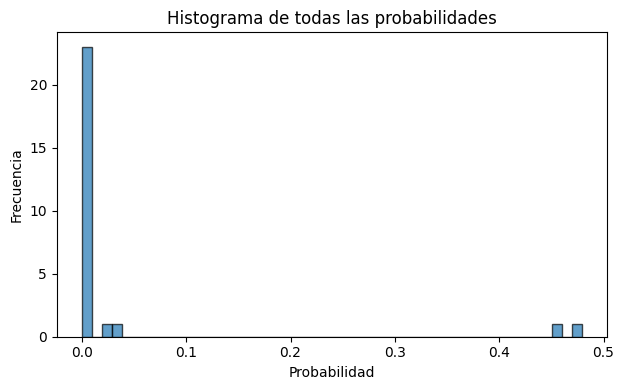

In [30]:
# entonces cuando los pasamos a prob, quedan muy poco uniformes

# para logits uso softmax:
probs = F.softmax(logits, dim=1)
# Visualizar la distribución de las probabilidades
plt.figure(figsize=(12, 4))

# Subplot 2: Histograma de todas las probabilidades del batch
plt.subplot(1, 2, 2)
all_probs = probs.flatten().detach().numpy()
plt.hist(all_probs, bins=50, alpha=0.7, edgecolor='black')
plt.title('Histograma de las probabilidades en inicializacion')
plt.xlabel('Probabilidad')
plt.ylabel('Frecuencia')

plt.tight_layout()
plt.show()

In [44]:
# Lo que queremos es que salgan logits mas cercanos a 0
# Para eso, FORZAMOS a la salida de los logits (output layer) a que se achiquen al principio
# En el output layer: 
# b2 = todos ceros. 
# W2 = casi todo cero (un poco de entropy le dejamos)


# MLP revisited
n_embd = 10 # the dimensionality of the character embedding vectors
n_hidden = 200 # the number of neurons in the hidden layer of the MLP

g = torch.Generator().manual_seed(2147483647) # for reproducibility

print(f"Arquitectura de la red: input_dim = {n_embd * block_size}, 1 layer de {n_hidden} neuronas y output_dim = {vocab_size}")

# Matrix C (embeddings)
C  = torch.randn((vocab_size, n_embd),            generator=g)

# Hidden layer
W1 = torch.randn((n_embd * block_size, n_hidden), generator=g)
b1 = torch.randn(n_hidden,                        generator=g)

# Output layer
W2 = torch.randn((n_hidden, vocab_size),          generator=g) * 0.01 # lo forzamos a casi todo 0 (dejamos un poco de entropia)
b2 = torch.randn(vocab_size,                      generator=g) * 0 # lo forzamos a todo 0 

# parameters and initialization
parameters = [C, W1, b1, W2, b2]
print(f"Total de parametros: {sum(p.nelement() for p in parameters)}")
for p in parameters:
  p.requires_grad = True

Arquitectura de la red: input_dim = 30, 1 layer de 200 neuronas y output_dim = 27
Total de parametros: 11897


In [45]:
# Nos fijamos solo el valor en inicializacion

# same optimization as last time
max_steps = 10
batch_size = 32 # cantidad de ejemplos que usamos en el batch de entrenamiento (la loss es la media de la loss de cada ejemplo)
# mientras mas chico sea el batch size, mas "noisy" sera la estimacion de la loss
lossi = []

for i in range(max_steps):
  
  # minibatch construct
  ix = torch.randint(0, Xtr.shape[0], (batch_size,), generator=g)
  Xb, Yb = Xtr[ix], Ytr[ix] # batch X,Y
  
  # forward pass
  emb = C[Xb] # embed the characters into vectors
  embcat = emb.view(emb.shape[0], -1) # concatenate the vectors
  hpreact = embcat @ W1 + b1 # hidden layer pre-activation
  h = torch.tanh(hpreact) # hidden layer
  logits = h @ W2 + b2 # output layer
  loss = F.cross_entropy(logits, Yb) # loss function
  print(loss.item())
  break # para que no se ejecute el resto del codigo
  
  # backward pass
  for p in parameters:
    p.grad = None
  loss.backward()
  
  # update
  lr = 0.1 if i < 100000 else 0.01 # step learning rate decay
  for p in parameters:
    p.data += -lr * p.grad

  # track stats
#   if i % 10000 == 0: # print every once in a while
#     print(f'{i:7d}/{max_steps:7d}: {loss.item():.4f}')
  print(loss.item())
  lossi.append(loss.log10().item())

print("Ahora si inicializamos bien, con esto nos ahorramos los primeros steps que aplastan los logits")

3.322058916091919
Ahora si inicializamos bien, con esto nos ahorramos los primeros steps que aplastan los logits


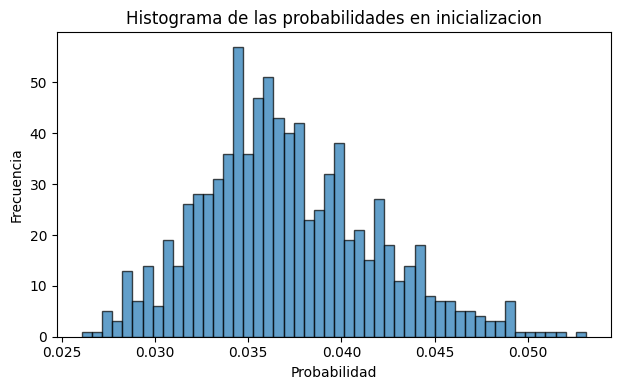

In [47]:
# entonces cuando los pasamos a prob, quedan muy poco uniformes

# para logits uso softmax:
probs = F.softmax(logits, dim=1)
# Visualizar la distribución de las probabilidades
plt.figure(figsize=(12, 4))

# Subplot 2: Histograma de todas las probabilidades del batch
plt.subplot(1, 2, 2)
all_probs = probs.flatten().detach().numpy()
plt.hist(all_probs, bins=50, alpha=0.7, edgecolor='black')
plt.title('Histograma de las probabilidades en inicializacion')
plt.xlabel('Probabilidad')
plt.ylabel('Frecuencia')

plt.tight_layout()
plt.show()

## Inicializacion de parametros

Ahora la inicializacion del loss parece bien pero hay otro problema mas oculto, las activaciones del hidden state tienen problemas.

---
**Tanh es una squashing function** que toma valores arbitrarios y los transforma en rango -1, 1.

Entonces si las pre activaciones (antes del tanh) son muy altos o bajos, muchos van a quedan en -1 o 1 cuando se pase por tanh.
Y el problema ahi es que despues **va a ser muy dificil sacar de ahi en el entrenamiento**


In [51]:
# como vemos, hay muchos valores en 1 o -1 en la salida del hidden layer
h

# VER LA DISTRIBUCION DE VALORES EN h

# Count unique values in h tensor
h_flat = h.view(-1)
# Round values to 3 decimal places
h_flat_rounded = torch.round(h_flat * 1000) / 1000
unique_values, counts = torch.unique(h_flat_rounded, return_counts=True)

# Sort by count in descending order and show top 5
sorted_indices = torch.argsort(counts, descending=True)
print("Top 5 most frequent values in h:")
for i in range(min(5, len(sorted_indices))):
    idx = sorted_indices[i]
    value = unique_values[idx]
    count = counts[idx]
    print(f"{value.item():.4f}: {count.item()}")


Top 5 most frequent values in h:
1.0000: 1493
-1.0000: 1235
-0.9990: 201
0.9990: 194
0.9980: 98


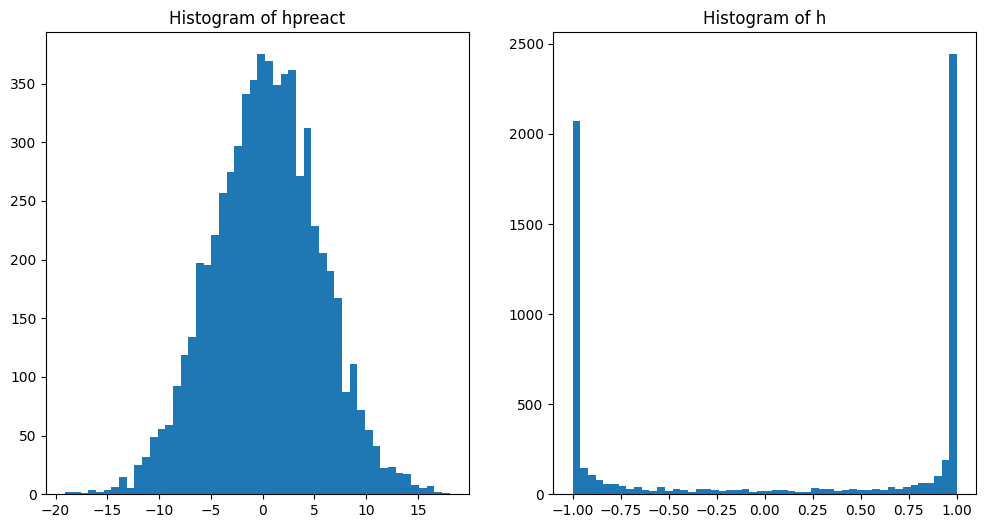

In [53]:
# visualizo las activaciones y pre activaciones y vemos 
# en las preactivaciones hay muchos valores altos o bajos (muy broad) 
# entonces cuando se hace el tanh quedan saturados

h_list = h.view(-1).tolist()
hpreact_list = hpreact.view(-1).tolist()
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 6))
ax1.hist(hpreact_list, 50)
ax1.set_title('Histogram of hpreact')
ax2.hist(h_list, 50)
ax2.set_title('Histogram of h')
plt.show()

### Saturacion de activaciones

**Por que tanh saturado es malo**

Tiene que ver con como se hace backprop.

Para tanh, el _backward() es:

```python
self.grad += (1 - t**2) * out.grad
```
t es el resultado del tanh.

 Por lo que:
- Si t = 1, tenemos 0. Matamos el gradient y no pasa nada por el backprop
- Si t = -1, tambien tenemos 0. Matamos el gradient y no pasa nada por el backprop

Esto es porque el tanh es como la sigmoid, si es -1 o 1, estamos en la cola que es casi flat, entonces la derivada es 0.

Estamos matando a muchas neuronas, haciendolas inactivas asi.

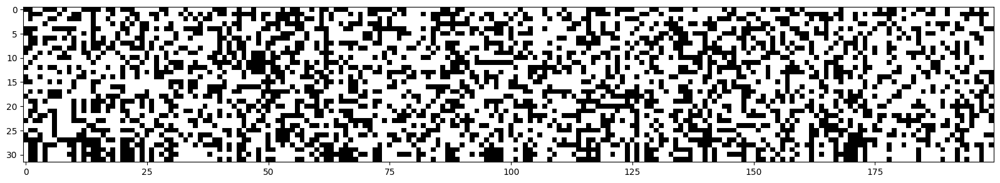

In [54]:
# si queremos ver cuantas veces cae en la region "flat" >0.99 o <-0.99, vemos asi
# filas son los ejemplos y columnas son las neuronas (activaciones)
# todas las que sean blancas son flat!

"""si toda una columna esta en blanco es lo que se llama "dead neuron", una que esta completamente inactiva y no puede reactivarse.
Cuando ningun ejemplo cae en los tails y entonces no aprende nunca """
# esto no solo puede pasar por inicializacion sino que tambien puede ser en el entrenamiento, si el learning rate es muy alto
# y el gradiente se va a la mierda, se puede morir la neurona porque queda en los tails.
"""Y esto no solo pasa con tanh sino que tambien con sigmoid, relu y muchas otras (las que tengan sectores flat)"""

plt.figure(figsize=(20,10))
plt.imshow(h.abs() > 0.99, cmap='gray', interpolation='nearest')

In [55]:
# Para solucionarlo, FORZAMOS a que sean mas cercanos a 0 tambien en h

# MLP revisited
n_embd = 10 # the dimensionality of the character embedding vectors
n_hidden = 200 # the number of neurons in the hidden layer of the MLP

g = torch.Generator().manual_seed(2147483647) # for reproducibility

# Matrix C (embeddings)
C  = torch.randn((vocab_size, n_embd),            generator=g)

# Hidden layer
W1 = torch.randn((n_embd * block_size, n_hidden), generator=g) * 0.2 # NUEVO: forzamos a que sean mas cercanos a 0
b1 = torch.randn(n_hidden,                        generator=g) * 0.01 # NUEVO: forzamos a que sean mas cercanos a 0

# Output layer
W2 = torch.randn((n_hidden, vocab_size),          generator=g) * 0.01 # lo forzamos a casi todo 0 (dejamos un poco de entropia)
b2 = torch.randn(vocab_size,                      generator=g) * 0 # lo forzamos a todo 0 

# parameters and initialization
parameters = [C, W1, b1, W2, b2]
print(sum(p.nelement() for p in parameters)) # number of parameters in total
for p in parameters:
  p.requires_grad = True

11897


In [56]:
# Nos fijamos solo el valor en inicializacion

# same optimization as last time
max_steps = 1
batch_size = 32
lossi = []

for i in range(max_steps):
  
  # minibatch construct
  ix = torch.randint(0, Xtr.shape[0], (batch_size,), generator=g)
  Xb, Yb = Xtr[ix], Ytr[ix] # batch X,Y
  
  # forward pass
  emb = C[Xb] # embed the characters into vectors
  embcat = emb.view(emb.shape[0], -1) # concatenate the vectors
  hpreact = embcat @ W1 + b1 # hidden layer pre-activation
  h = torch.tanh(hpreact) # hidden layer
  logits = h @ W2 + b2 # output layer
  loss = F.cross_entropy(logits, Yb) # loss function
  
  # backward pass
  for p in parameters:
    p.grad = None
  loss.backward()
  
  # update
  lr = 0.1 if i < 100000 else 0.01 # step learning rate decay
  for p in parameters:
    p.data += -lr * p.grad

  # track stats
#   if i % 10000 == 0: # print every once in a while
#     print(f'{i:7d}/{max_steps:7d}: {loss.item():.4f}')
  print(loss.item())
  lossi.append(loss.log10().item())

3.3134593963623047


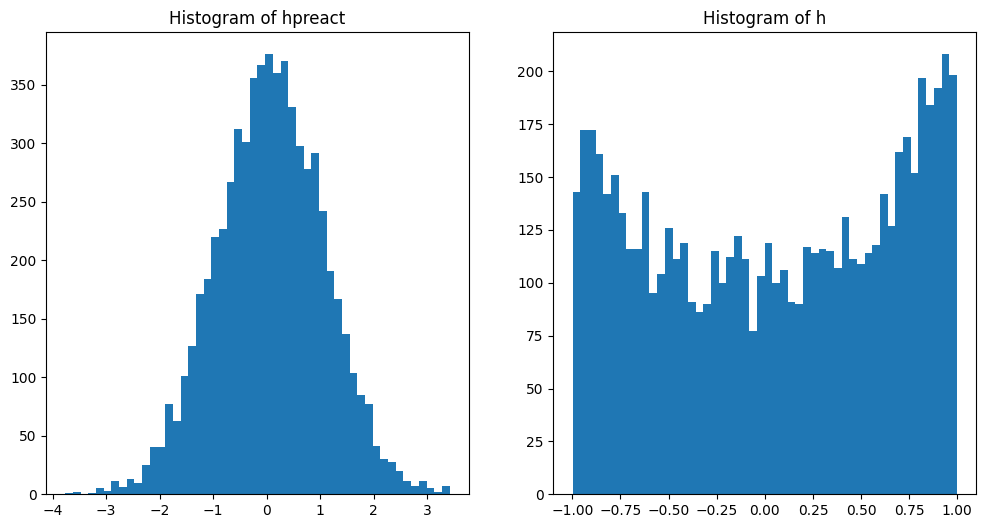

In [57]:
# AHORA SI queda bien

h_list = h.view(-1).tolist()
hpreact_list = hpreact.view(-1).tolist()
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 6))
ax1.hist(hpreact_list, 50)
ax1.set_title('Histogram of hpreact')
ax2.hist(h_list, 50)
ax2.set_title('Histogram of h')
plt.show()

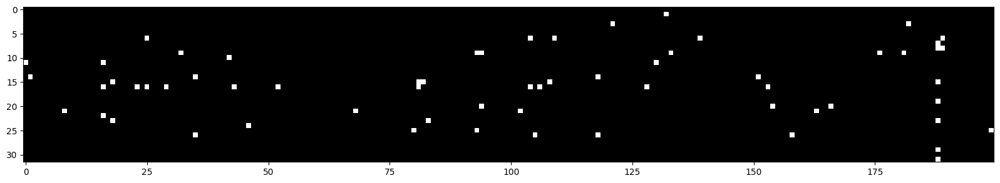

In [58]:
plt.figure(figsize=(20,10))
plt.imshow(h.abs() > 0.99, cmap='gray', interpolation='nearest')

### Varianza de los parametros en init

Cuando tenemos x que son standard normal distribution y tambie w que son standard normal dist, y **los multiplicamos, queda el mean en 0 pero aumenta el std**.
Entonces eso puede ser un problema. 

Para solucionarlo, hay que "achicar" los W para que la multiplicacion quede como un standard normal dist!

In [59]:
# si vemos esto, al multiplicar dos matrices de standard normal, 
# nos queda una con mean 0 pero std muy alto

x = torch.randn(1000, 100)
w = torch.randn(100, 1000)
y = x @ w 

print('x', x.mean(), x.std())
print('w', w.mean(), w.std())
print('y', y.mean(), y.std())

x tensor(-0.0002) tensor(0.9997)
w tensor(-0.0018) tensor(0.9964)
y tensor(-0.0033) tensor(9.9603)


In [60]:
# para solucionarlo, escalamos W por un factor

x = torch.randn(1000, 10)
w = torch.randn(10, 200) / 10**0.5 # 10 porque es el number of inputs
y = x @ w 

print('x', x.mean(), x.std())
print('w', w.mean(), w.std())
print('y', y.mean(), y.std())

x tensor(-0.0108) tensor(1.0018)
w tensor(0.0086) tensor(0.3173)
y tensor(0.0001) tensor(1.0027)


### Gain: Kaiming init (mejor forma de inicializar)

Depende de la activation function.

Usa un **gain**, que es un factor que multiplica, para compensar la propiedad de comprimir que tienen estas funciones.

Los pesos deberiamos iniciarlos como: 

$$
w_i \sim \mathcal{N}\left(0, \frac{\text{gain}^2}{\text{fan\_in}} \right)
$$

porque:

$$
std = \frac{gain}{\sqrt{FanMode}}
$$

Depende de la funcion de activacion.

Para **tanh**, el gain seria 5/3, entonces:

$$
w_i∼N(0,\frac{(5/3)^2}{fan_{in}})
$$

Para **ReLU**, el gain es √2: -> 2 porque ReLU elimina la mitad de los valores.

$$
w_i∼N(0,\frac{2}{fan_{in}})
$$

In [61]:
# Cambiamos los W1 por el kaiming init

# MLP revisited
n_embd = 10 # the dimensionality of the character embedding vectors
n_hidden = 200 # the number of neurons in the hidden layer of the MLP

g = torch.Generator().manual_seed(2147483647) # for reproducibility

# Matrix C (embeddings)
C  = torch.randn((vocab_size, n_embd),            generator=g)

# Hidden layer
W1 = torch.randn((n_embd * block_size, n_hidden), generator=g) * (5/3)/((n_embd * block_size)**0.5) # NUEVO (hacemos 5/3 y la raiz del fan_in porque es la std, no la varianza)
b1 = torch.randn(n_hidden,                        generator=g) * 0.01

# Output layer
W2 = torch.randn((n_hidden, vocab_size),          generator=g) * 0.01
b2 = torch.randn(vocab_size,                      generator=g) * 0

# parameters and initialization
parameters = [C, W1, b1, W2, b2]
print(sum(p.nelement() for p in parameters)) # number of parameters in total
for p in parameters:
  p.requires_grad = True

11897


## Normalizacion forzada

### BatchNorm

Lo que buscamos es lo mismo que siempre: **pre activaciones chiquitas (para que el tanh no sature) y similares a gaussian(0,1)**.

Si queremos hidden states que sean gaussian, por que no las transformamos en gaussian y listo? Eso es batch norm.

---
Para transformarlas en gaussian, se tiene que restar a algo y dividir a algo, y eso es a la mean y a la std de un grupo. Entonces **se usa el batch de ejemplos para estas estadisticas**.

$$
 Z = \frac{X - \mu}{\sigma} 
$$

Se puede hacer porque todo es perfectamente diferenciable.


Esto no esta bueno porque de alguna manera "acopla" multiples ejemplos que deberian ser independientes, pero tambien **acoplar los ejemplos del batch sirve para normalizar de alguna manera**. 

---
Asi que sirve appendear una batchnorm layer despues de una linear layer

-> LINEAR -> BATCHNORM -> ACTIVATION -> 

Original:
  Mean: 0.466
  Std:  2.873

Normalizado:
  Mean: 0.0
  Std:  1.0


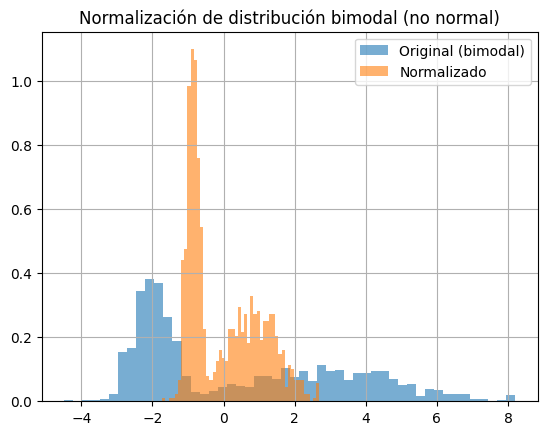

In [60]:
import numpy as np
import matplotlib.pyplot as plt

# Creamos una distribución rara y deformada
x1 = np.random.randn(500) * 0.5 - 2
x2 = np.random.randn(500) * 2 + 3
x = np.concatenate([x1, x2])

# Normalizamos
x_norm = (x - np.mean(x)) / (np.std(x) + 1e-5)

# Mostramos estadísticas
print("Original:")
print("  Mean:", round(np.mean(x), 3))
print("  Std: ", round(np.std(x), 3))

print("\nNormalizado:")
print("  Mean:", round(np.mean(x_norm), 3))
print("  Std: ", round(np.std(x_norm), 3))

# Graficamos
plt.hist(x, bins=50, alpha=0.6, label='Original (bimodal)', density=True)
plt.hist(x_norm, bins=50, alpha=0.6, label='Normalizado', density=True)
plt.legend()
plt.title("Normalización de distribución bimodal (no normal)")
plt.grid(True)
plt.show()


#### Intro

In [62]:
# MLP revisited
n_embd = 10 # the dimensionality of the character embedding vectors
n_hidden = 200 # the number of neurons in the hidden layer of the MLP

g = torch.Generator().manual_seed(2147483647) # for reproducibility

# Matrix C (embeddings)
C  = torch.randn((vocab_size, n_embd),            generator=g)

# Hidden layer
W1 = torch.randn((n_embd * block_size, n_hidden), generator=g) * (5/3)/((n_embd * block_size)**0.5) # init para tanh
b1 = torch.randn(n_hidden,                        generator=g) * 0.01

# Output layer
W2 = torch.randn((n_hidden, vocab_size),          generator=g) * 0.01
b2 = torch.randn(vocab_size,                      generator=g) * 0

# parameters and initialization
parameters = [C, W1, b1, W2, b2]
print(sum(p.nelement() for p in parameters)) # number of parameters in total
for p in parameters:
  p.requires_grad = True

11897


In [63]:
# same optimization as last time
max_steps = 1
batch_size = 32
lossi = []

for i in range(max_steps):
  
  # minibatch construct
  ix = torch.randint(0, Xtr.shape[0], (batch_size,), generator=g)
  Xb, Yb = Xtr[ix], Ytr[ix] # batch X,Y
  
  # forward pass
  emb = C[Xb] # embed the characters into vectors
  embcat = emb.view(emb.shape[0], -1) # concatenate the vectors
  hpreact = embcat @ W1 + b1 # hidden layer pre-activation
  h = torch.tanh(hpreact) # hidden layer
  logits = h @ W2 + b2 # output layer
  loss = F.cross_entropy(logits, Yb) # loss function
  
  # backward pass
  for p in parameters:
    p.grad = None
  loss.backward()
  
  # update
  lr = 0.1 if i < 100000 else 0.01 # step learning rate decay
  for p in parameters:
    p.data += -lr * p.grad

  # track stats
#   if i % 10000 == 0: # print every once in a while
#     print(f'{i:7d}/{max_steps:7d}: {loss.item():.4f}')
  print(loss.item())
  lossi.append(loss.log10().item())

3.3179006576538086


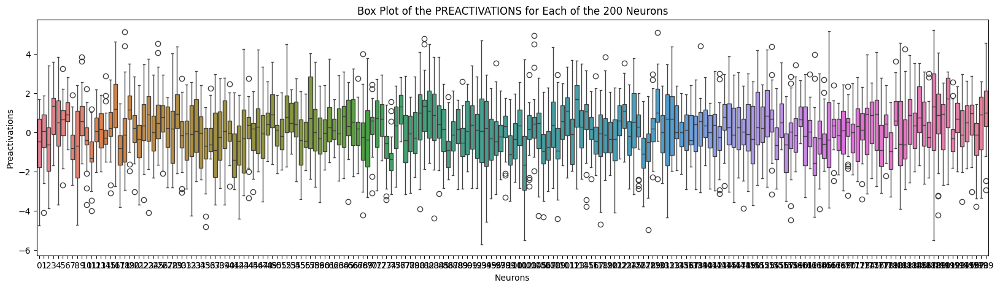

In [69]:
# Analizamos la distribucion (de las preactivaciones de los 32 ejemplos) para cada neurona 

import seaborn as sns

h_numpy = hpreact.detach().numpy()

plt.figure(figsize=(20, 5))
sns.boxplot(data=h_numpy)
plt.title("Box Plot of the PREACTIVATIONS for Each of the 200 Neurons")
plt.xlabel("Neurons")
plt.ylabel("Preactivations")
plt.show()


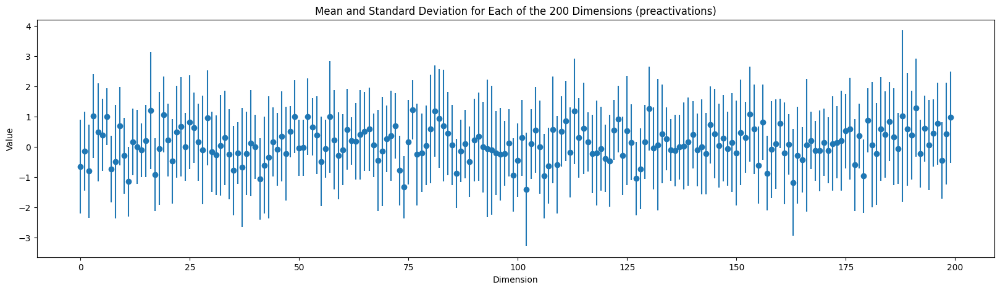

In [70]:
import numpy as np 
# Assuming 'h' is your PyTorch tensor of shape (32, 200)
h_numpy = hpreact.detach().numpy()

# Calculate mean and standard deviation for each dimension
means = np.mean(h_numpy, axis=0)
stds = np.std(h_numpy, axis=0)
dimensions = np.arange(200)  # 200 dimensions

# Create a plot
plt.figure(figsize=(20, 5))
plt.errorbar(dimensions, means, yerr=stds, fmt='o') # 'o' specifies the marker type

plt.title("Mean and Standard Deviation for Each of the 200 Dimensions (preactivations)")
plt.xlabel("Dimension")
plt.ylabel("Value")
plt.show()


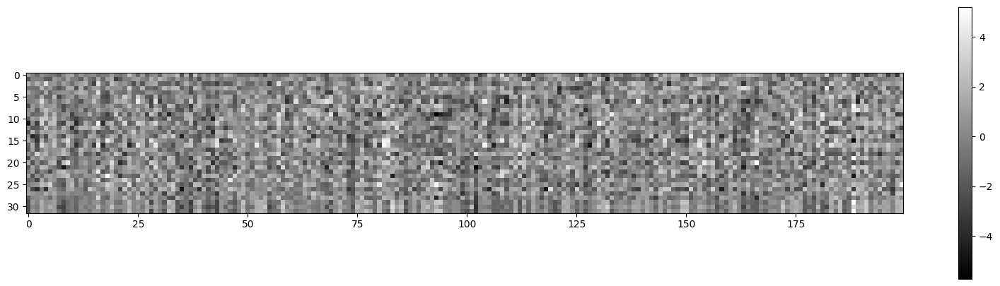

In [71]:
h_numpy = hpreact.detach().numpy()
plt.figure(figsize=(20,5))
plt.imshow(h_numpy, cmap='gray', interpolation='nearest')
plt.colorbar() 

# Show the plot
plt.show()

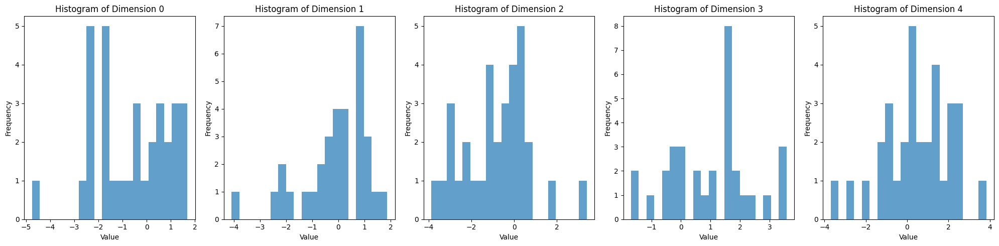

In [72]:
# vemos algunas neuronas a ver la distribucion que tienen

selected_dims = range(5)
plt.figure(figsize=(20, 5))

for i, dim in enumerate(selected_dims, 1):
    plt.subplot(1, len(selected_dims), i)
    plt.hist(h_numpy[:, dim], bins=20, alpha=0.7)
    plt.title(f'Histogram of Dimension {dim}')
    plt.xlabel('Value')
    plt.ylabel('Frequency')

plt.tight_layout()
plt.show()


#### Objetivo: Estandarizar por batch
Lo que queremos es, para cada columna (neurona en la hidden layer) estandarizar a traves de las filas para que queden con formato gaussian 0,1.

$$
 Z = \frac{X - \mu}{\sigma} 
$$

Vamos a tener un **MEAN y STD PARA CADA NEURONA**.

Cada neurona tiene su propia forma de estandarizarse, segun sus propios valores a traves de los ejemplos del batch.

In [73]:
# tenemos un mean y un std por neurona
print(hpreact.mean(0, keepdim=True).shape)
print(hpreact.std(0, keepdim=True).shape)

bnmeani = hpreact.mean(0, keepdim=True)
bnstdi = hpreact.std(0, keepdim=True)

# ACA hacemos la estandarizacion
hpreact_standard = (hpreact - bnmeani) / bnstdi
hpreact_standard.shape

torch.Size([1, 200])
torch.Size([1, 200])


torch.Size([32, 200])

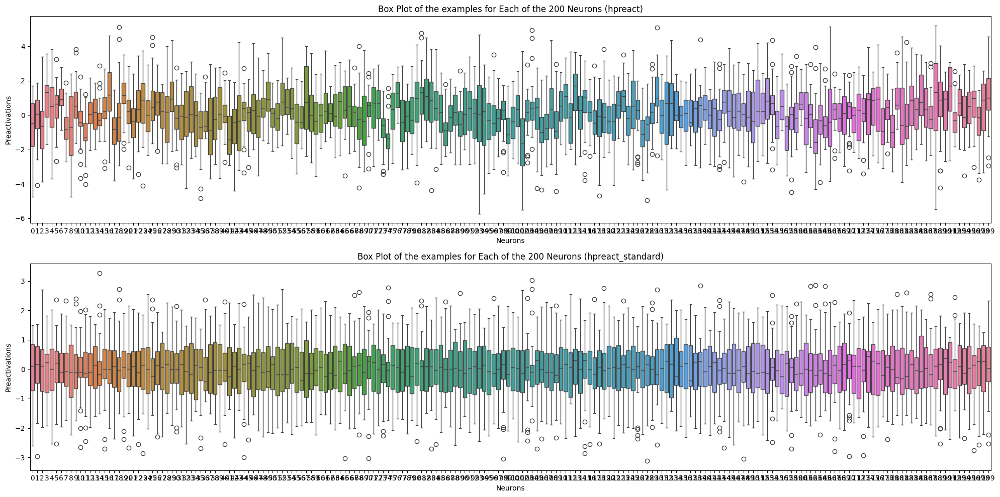

In [74]:
# Comparandolo con lo anterior

hpreact_numpy = hpreact.detach().numpy()
hpreact_standard_numpy = hpreact_standard.detach().numpy()

fig, axs = plt.subplots(2, 1, figsize=(20, 10))

# First subplot for 'hpreact'
sns.boxplot(data=hpreact_numpy, ax=axs[0])
axs[0].set_title("Box Plot of the examples for Each of the 200 Neurons (hpreact)")
axs[0].set_xlabel("Neurons")
axs[0].set_ylabel("Preactivations")

# Second subplot for 'hpreact_standard'
sns.boxplot(data=hpreact_standard_numpy, ax=axs[1])
axs[1].set_title("Box Plot of the examples for Each of the 200 Neurons (hpreact_standard)")
axs[1].set_xlabel("Neurons")
axs[1].set_ylabel("Preactivations")

plt.tight_layout()
plt.show()

#### Scale+Shift: Permitir aprender

Si forzamos siempre los hpreact para ser gaussian, le va a costar aprender porque no se va a poder mover nunca!

Entonces lo que queremos es: **Solo standard en inicializacion. Despues permitir mover**.

---
Le agregamos como parametros (APRENDIBLES) al modelo:
- Gain (scale): inicializado en 1 para que sea gaussian
- Bias (shift): inicializado en 0 para que sea gaussian


In [75]:
"""
Aca agregamos los BatchNorm parameters
"""

# MLP revisited
n_embd = 10 # the dimensionality of the character embedding vectors
n_hidden = 200 # the number of neurons in the hidden layer of the MLP

g = torch.Generator().manual_seed(2147483647) # for reproducibility

# Matrix C (embeddings)
C  = torch.randn((vocab_size, n_embd),            generator=g)

# Hidden layer
W1 = torch.randn((n_embd * block_size, n_hidden), generator=g) * (5/3)/((n_embd * block_size)**0.5) #* 0.2
#b1 = torch.randn(n_hidden,                        generator=g) * 0.01

# Output layer
W2 = torch.randn((n_hidden, vocab_size),          generator=g) * 0.01
b2 = torch.randn(vocab_size,                      generator=g) * 0

"""
Gain y bias son parametros que se inicializan en 0 y 1 para que:
- En inicializacion los hpreact sean gaussian
- Despues tengan forma de mover y escalar la distribucion para que pueda aprender
"""
# BatchNorm parameters
bngain = torch.ones((1, n_hidden))
bnbias = torch.zeros((1, n_hidden))

# parameters and initialization
parameters = [C, W1, W2, b2, bngain, bnbias]
print(sum(p.nelement() for p in parameters)) # number of parameters in total
for p in parameters:
  p.requires_grad = True

12097


In [ ]:
# same optimization as last time
max_steps = 100
batch_size = 32
lossi = []

for i in range(max_steps):
  
  # minibatch construct
  ix = torch.randint(0, Xtr.shape[0], (batch_size,), generator=g)
  Xb, Yb = Xtr[ix], Ytr[ix] # batch X,Y
  
  # forward pass
  emb = C[Xb] # embed the characters into vectors
  embcat = emb.view(emb.shape[0], -1) # concatenate the vectors
  
  # Linear layer
  hpreact = embcat @ W1 #+ b1 # hidden layer pre-activation
  
  # BatchNorm layer
  """Entre la linear layer y el tanh (non linearity) agregamos la batchnorm layer"""
  # -------------------------------------------------------------
  bnmeani = hpreact.mean(0, keepdim=True)
  bnstdi = hpreact.std(0, keepdim=True)
  hpreact = bngain * (hpreact - bnmeani) / bnstdi + bnbias
  # -------------------------------------------------------------
  
  # Non-linearity
  h = torch.tanh(hpreact) # hidden layer
  logits = h @ W2 + b2 # output layer
  loss = F.cross_entropy(logits, Yb) # loss function
  
  # backward pass
  for p in parameters:
    p.grad = None
  loss.backward()
  
  # update
  lr = 0.1 if i < 100000 else 0.01 # step learning rate decay
  for p in parameters:
    p.data += -lr * p.grad

  # track stats
  if i % 10000 == 0: # print every once in a while
    print(f'{i:7d}/{max_steps:7d}: {loss.item():.4f}')
  lossi.append(loss.log10().item())
  

      0/  20000: 2.3894
  10000/  20000: 2.2761


In [80]:
@torch.no_grad() # this decorator disables gradient tracking
def split_loss(split):
  x,y = {
    'train': (Xtr, Ytr),
    'val': (Xdev, Ydev),
    'test': (Xte, Yte),
  }[split]
  emb = C[x] # (N, block_size, n_embd)
  embcat = emb.view(emb.shape[0], -1) # concat into (N, block_size * n_embd)
  hpreact = embcat @ W1 # + b1
  hpreact = bngain * (hpreact - hpreact.mean(0, keepdim=True)) / hpreact.std(0, keepdim=True) + bnbias
  # hpreact = bngain * (hpreact - bnmean_running) / bnstd_running + bnbias
  h = torch.tanh(hpreact) # (N, n_hidden)
  logits = h @ W2 + b2 # (N, vocab_size)
  loss = F.cross_entropy(logits, y)
  print(split, loss.item())

split_loss('train')
split_loss('val')

train 2.193044662475586
val 2.2147631645202637


#### Inference: Running mean and std 

Si queremos hacer inferencia con un solo ejemplo, como lo hacemos si **necesitamos el mean y std del batch??? Ahora no tenemos batch**.

---
Tenemos que **calcular un mean y std general (de todo training set) de toda la red para despues usar para hacer inferencia**


Post entrenamiento

In [81]:
# Podemos calibrar el batch norm al final del entrenamiento asi
# y que ya queden. Pero es FEO esto. Queremos que se haga solo

with torch.no_grad():
  # pass the training set through
  emb = C[Xtr]
  embcat = emb.view(emb.shape[0], -1)
  hpreact = embcat @ W1 # + b1
  # measure the mean/std over the entire training set
  bnmean = hpreact.mean(0, keepdim=True)
  bnstd = hpreact.std(0, keepdim=True)

In [82]:
bnmean.shape

torch.Size([1, 200])

Running (durante entrenamiento)

In [83]:
"""
Añadimos bnmean_running y bnstd_running
para que se vayan calculando a medida que entrenamos la red y que ya queden
"""

# MLP revisited
n_embd = 10 # the dimensionality of the character embedding vectors
n_hidden = 200 # the number of neurons in the hidden layer of the MLP

g = torch.Generator().manual_seed(2147483647) # for reproducibility

# Matrix C (embeddings)
C  = torch.randn((vocab_size, n_embd),            generator=g)

# Hidden layer
W1 = torch.randn((n_embd * block_size, n_hidden), generator=g) * (5/3)/((n_embd * block_size)**0.5) #* 0.2

# Output layer
W2 = torch.randn((n_hidden, vocab_size),          generator=g) * 0.01
b2 = torch.randn(vocab_size,                      generator=g) * 0

# BatchNorm parameters
bngain = torch.ones((1, n_hidden))
bnbias = torch.zeros((1, n_hidden))
"""Inicializamos los running mean and std"""
bnmean_running = torch.zeros((1, n_hidden))
bnstd_running = torch.ones((1, n_hidden))

# parameters and initialization
parameters = [C, W1, W2, b2, bngain, bnbias]
print(sum(p.nelement() for p in parameters)) # number of parameters in total
for p in parameters:
  p.requires_grad = True

12097


In [84]:
# same optimization as last time
max_steps = 1000
batch_size = 32
lossi = []

for i in range(max_steps):
  
  # minibatch construct
  ix = torch.randint(0, Xtr.shape[0], (batch_size,), generator=g)
  Xb, Yb = Xtr[ix], Ytr[ix] # batch X,Y
  
  # forward pass
  emb = C[Xb] # embed the characters into vectors
  embcat = emb.view(emb.shape[0], -1) # concatenate the vectors
  
  # Linear layer
  hpreact = embcat @ W1 #+ b1 # hidden layer pre-activation
  """Ahora el b1 no hace nada porque tenemos batch norm y cuando se hace la resta
  se lleva a 0 entonces no hace nada, lo sacamos. Queda el bnbias que tiene el mismo efecto"""
  
  # BatchNorm layer
  # -------------------------------------------------------------
  """bnmeani y bnstdi es para cada i (cada iteracion)"""
  bnmeani = hpreact.mean(0, keepdim=True)
  bnstdi = hpreact.std(0, keepdim=True)
  hpreact = bngain * (hpreact - bnmeani) / bnstdi + bnbias
  """running son general (no hacen nada en el proceso sino que se van calculando on the side)"""
  with torch.no_grad(): # porque no van a ser parte del proceso!
    bnmean_running = 0.999 * bnmean_running + 0.001 * bnmeani # le agregamos un small update cada step
    bnstd_running = 0.999 * bnstd_running + 0.001 * bnstdi # le agregamos un small update cada step
  # -------------------------------------------------------------
  
  # Non-linearity
  h = torch.tanh(hpreact) # hidden layer
  logits = h @ W2 + b2 # output layer
  loss = F.cross_entropy(logits, Yb) # loss function
  
  # backward pass
  for p in parameters:
    p.grad = None
  loss.backward()
  
  # update
  lr = 0.1 if i < 100000 else 0.01 # step learning rate decay
  for p in parameters:
    p.data += -lr * p.grad

  # track stats
  if i % 10000 == 0: # print every once in a while
    print(f'{i:7d}/{max_steps:7d}: {loss.item():.4f}')
  lossi.append(loss.log10().item())
  

      0/   1000: 3.3239


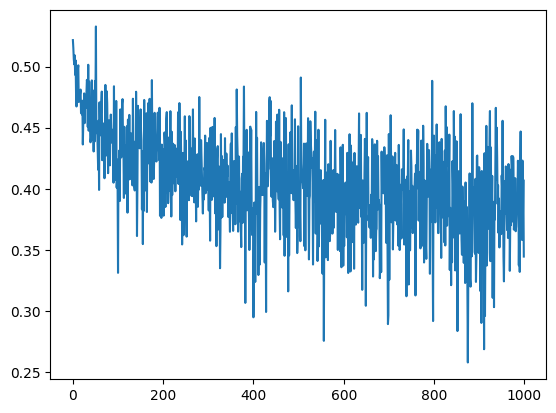

In [85]:
plt.plot(lossi)

In [86]:
print(bnmean_running.shape)
print(bnstd_running.shape)

torch.Size([1, 200])
torch.Size([1, 200])


In [ ]:
# PARA INFERENCE (ahora podemos pasarle un solo ejemplo)

@torch.no_grad() # this decorator disables gradient tracking
def split_loss(split):
  x,y = {
    'train': (Xtr, Ytr),
    'val': (Xdev, Ydev),
    'test': (Xte, Yte),
  }[split]
  emb = C[x] # (N, block_size, n_embd)
  embcat = emb.view(emb.shape[0], -1) # concat into (N, block_size * n_embd)
  hpreact = embcat @ W1 # + b1
  """Aca le añado los running parameters de batch norm"""
  hpreact = bngain * (hpreact - bnmean_running) / bnstd_running + bnbias # aca los usamos a los generales
  h = torch.tanh(hpreact) # (N, n_hidden)
  logits = h @ W2 + b2 # (N, vocab_size)
  loss = F.cross_entropy(logits, y)
  print(split, loss.item())

split_loss('train')
split_loss('val')

train 2.457094430923462
val 2.454827070236206


### LayerNorm

En **BatchNorm** usamos las estadísticas del **batch** (media y varianza por neurona), pero eso **no sirve siempre**.

Por ejemplo:

- Si tu batch size es chico (o batch size = 1)
- O en **modelos autoregresivos o transformers**, donde procesás **una muestra a la vez**

BatchNorm **rompe** porque no tenés suficientes ejemplos para calcular bien las estadísticas.

> En vez de normalizar por neurona a lo largo del batch...
> 
> 
> **normalizamos por toda la capa, pero dentro de un único ejemplo.**
> 

Para cada ejemplo (no batch):

1. Agarras las pre-activaciones de una layer z
2. Calculas la media dentro del ejemplo (usando las pre-activaciones de la layer)
3. Calculas la varianza de eso
4. Normalizas cada componente del vector 

Tambien le damos la libertad con gamma y beta para que se mueva la distribucion.

Tambien se aplica antes de la activacion, despues de la pre-activacion.


---

Ahora, va a haber **1 mean y 1 std compartido para todas las neuronas (para cada ejemplo)**. Para cada ejemplo, el mean y std con el que se normalizan las neuronas va a ser el mismo para todas las neurona.

O sea, el lnmean y el lnstd van a tener shape (batch_size, 1).


**LayerNorm normaliza cada ejemplo por separado**, usando las estadísticas dentro del propio ejemplo (no entre ejemplos). Es decir, para cada vector de 200 dimensiones, calcula su propia media y std, y lo normaliza.

---

**Pero… ¿qué ganamos con esto? Estabilidad interna del ejemplo**

Para cada ejemplo, todas las neuronas tienen valores comparables, sin importar si antes estaban desbalanceadas.
Esto ayuda a que el siguiente layer reciba señales más consistentes.


In [9]:
"""
Aca agregamos los LayerNorm parameters
"""

import torch 
import numpy as np

# MLP revisited
n_embd = 10 # the dimensionality of the character embedding vectors
n_hidden = 200 # the number of neurons in the hidden layer of the MLP

g = torch.Generator().manual_seed(2147483647) # for reproducibility

# Matrix C (embeddings)
C  = torch.randn((vocab_size, n_embd),            generator=g)

# Hidden layer
W1 = torch.randn((n_embd * block_size, n_hidden), generator=g) * (5/3)/((n_embd * block_size)**0.5) #* 0.2
#b1 = torch.randn(n_hidden,                        generator=g) * 0.01

# Output layer
W2 = torch.randn((n_hidden, vocab_size),          generator=g) * 0.01
b2 = torch.randn(vocab_size,                      generator=g) * 0

"""
Gain y bias son parametros que se inicializan en 0 y 1 para que:
- En inicializacion los hpreact sean gaussian
- Despues tengan forma de mover y escalar la distribucion para que pueda aprender
"""
# LayerNorm parameters
ln_gain = torch.ones((1, n_hidden))
ln_bias = torch.zeros((1, n_hidden))

# parameters and initialization
parameters = [C, W1, W2, b2, ln_gain, ln_bias]
print(sum(p.nelement() for p in parameters)) # number of parameters in total
for p in parameters:
  p.requires_grad = True

12097


In [20]:
# same optimization as last time
max_steps = 100
batch_size = 32
lossi = []

for i in range(max_steps):
  
  # minibatch construct
  ix = torch.randint(0, Xtr.shape[0], (batch_size,), generator=g)
  Xb, Yb = Xtr[ix], Ytr[ix] # batch X,Y
  
  # forward pass
  emb = C[Xb] # embed the characters into vectors
  embcat = emb.view(emb.shape[0], -1) # concatenate the vectors
  
  # Linear layer
  hpreact = embcat @ W1 #+ b1 # hidden layer pre-activation
  hpreact_prenorm = hpreact.clone() # para ver que no se modifica
  
  # LayerNorm layer
  """Entre la linear layer y el tanh (non linearity) agregamos la LAYER NORM layer
  Calculamos la mean y std de cada columna (neurona) PERO DE LA OTRA DIMENSION
  lnmeani y lnstdi son de shape (batch_size, 1) porque las neuronas ahora comparten el mean y std (en cada ejemplo)
  """
  # -------------------------------------------------------------
  lnmeani = hpreact.mean(1, keepdim=True) # aca la dimension es 1, en vez de 0
  lnstdi = hpreact.std(1, keepdim=True) # aca la dimension es 1, en vez de 0
  hpreact = ln_gain * (hpreact - lnmeani) / lnstdi + ln_bias
  # -------------------------------------------------------------
  
  # Non-linearity
  h = torch.tanh(hpreact) # hidden layer
  logits = h @ W2 + b2 # output layer
  loss = F.cross_entropy(logits, Yb) # loss function
  
  # backward pass
  for p in parameters:
    p.grad = None
  loss.backward()
  
  # update
  lr = 0.1 if i < 100000 else 0.01 # step learning rate decay
  for p in parameters:
    p.data += -lr * p.grad

  # track stats
  if i % 10000 == 0: # print every once in a while
    print(f'{i:7d}/{max_steps:7d}: {loss.item():.4f}')
  lossi.append(loss.log10().item())
  

      0/    100: 1.9953


In [14]:
hpreact.shape

torch.Size([32, 200])

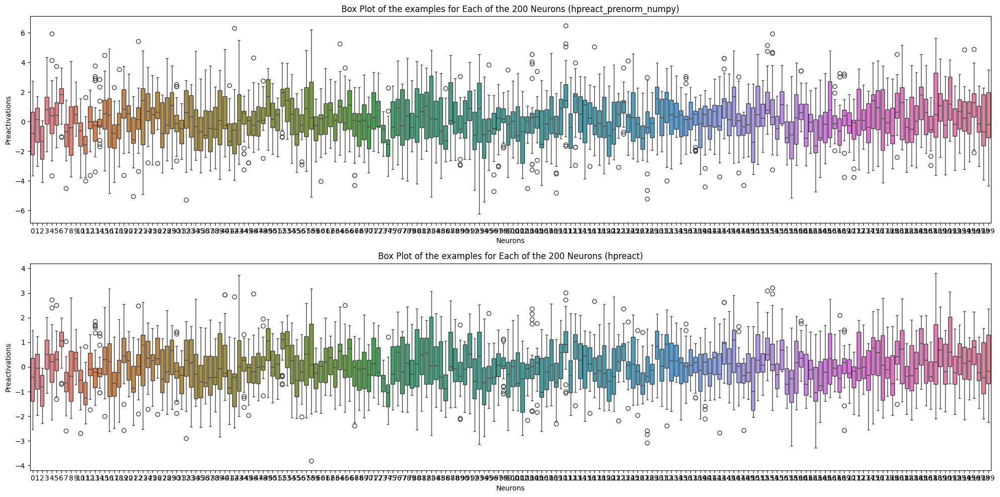

In [24]:
# Analizamos la distribucion (de las preactivaciones de los 32 ejemplos) para cada neurona
# -> ESTO NO SE NORMALIZA TANTO, PORQUE LAYERNORM LO HACE POR EJEMPLO, NO POR NEURONA

hpreact_numpy = hpreact.detach().numpy()
hpreact_prenorm_numpy = hpreact_prenorm.detach().numpy()

fig, axs = plt.subplots(2, 1, figsize=(20, 10))

# First subplot for 'hpreact_prenorm'
sns.boxplot(data=hpreact_prenorm_numpy, ax=axs[0])
axs[0].set_title("Box Plot of the examples for Each of the 200 Neurons (hpreact_prenorm)")
axs[0].set_xlabel("Neurons")
axs[0].set_ylabel("Preactivations")

# Second subplot for 'hpreact'
sns.boxplot(data=hpreact_numpy, ax=axs[1])
axs[1].set_title("Box Plot of the examples for Each of the 200 Neurons (hpreact)")
axs[1].set_xlabel("Neurons")
axs[1].set_ylabel("Preactivations")

plt.tight_layout()
plt.show()

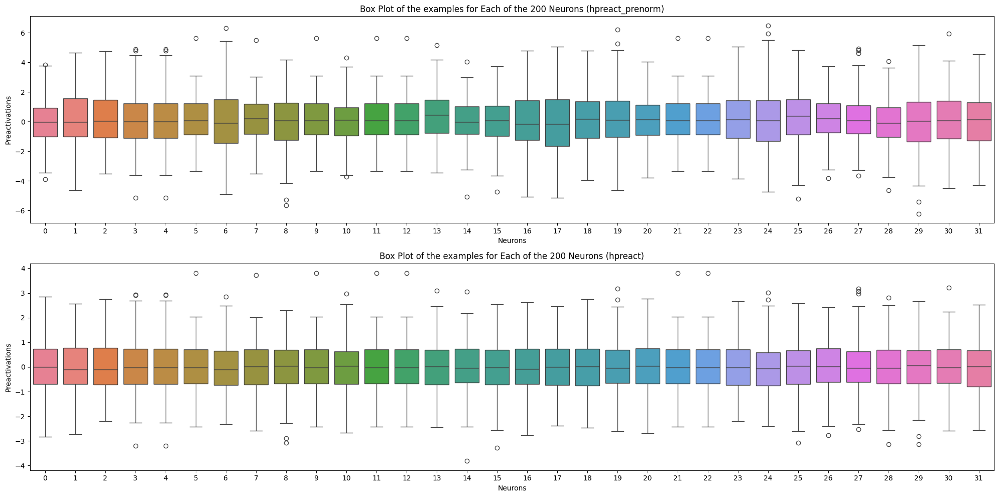

In [25]:
# ESTO SI SE NORMALIZA MAS, PORQUE LAYERNORM LO HACE POR EJEMPLO, NO POR NEURONA

hpreact_numpy = hpreact.detach().numpy().T
hpreact_prenorm_numpy = hpreact_prenorm.detach().numpy().T

fig, axs = plt.subplots(2, 1, figsize=(20, 10))

# First subplot for 'hpreact_prenorm'
sns.boxplot(data=hpreact_prenorm_numpy, ax=axs[0])
axs[0].set_title("Box Plot of the examples for Each of the 200 Neurons (hpreact_prenorm)")
axs[0].set_xlabel("Neurons")
axs[0].set_ylabel("Preactivations")

# Second subplot for 'hpreact'
sns.boxplot(data=hpreact_numpy, ax=axs[1])
axs[1].set_title("Box Plot of the examples for Each of the 200 Neurons (hpreact)")
axs[1].set_xlabel("Neurons")
axs[1].set_ylabel("Preactivations")

plt.tight_layout()
plt.show()

#### Comparacion con BatchNorm

Ambas hacen "normalización" para evitar inestabilidad en el entrenamiento. 

|                            | **BatchNorm**                                                             | **LayerNorm**                                                          |
| -------------------------- | ------------------------------------------------------------------------- | ---------------------------------------------------------------------- |
| **Qué normaliza**          | Cada **neurona**, a través del **batch**                                  | Cada **ejemplo**, a través de sus **neuronas**                         |
| **Qué intenta lograr**     | Que **cada neurona** tenga media 0 y varianza 1 (promedio entre ejemplos) | Que **cada ejemplo** tenga activaciones estables en todas sus neuronas |
| **Para qué sirve**         | Alinear distribución **de activaciones por neurona**                      | Estabilizar **la representación del ejemplo completo**                 |
| **Depende del batch size** | Sí ❗                                                                      | No ✅                                                                   |
| **Funciona bien en**       | CNNs, MLPs con batch grande                                               | Transformers, RNNs, test-time, batch pequeño                           |

---
**BatchNorm: “quiero que cada neurona trabaje bien”**

- En redes profundas, cada neurona puede terminar con una distribución loca: demasiado grande, demasiado chica, sesgada...
- BatchNorm dice: "Ajusto cada neurona para que se porte bien, en promedio, en este batch."
- Pero si tu batch es chico, ese promedio es ruidoso. Además, en inference suele romperse si no lo manejás bien.

**LayerNorm: “quiero que cada ejemplo tenga una representación sana”**

- Imaginá un ejemplo que pasa por una capa y termina con activaciones como: [200, -150, 50, 0.1, -0.01, ...]
- Eso está desbalanceado. La red no sabe qué hacer con eso.
- LayerNorm dice: "Para cada ejemplo, ajusto sus activaciones para que estén centradas y con varianza 1."
- No importa cuántos ejemplos tengas en el batch → lo normaliza individualmente.



---

- BatchNorm = "normalizo el comportamiento de las neuronas" -> como decir: "che neurona 7, estás re loquita, calmate un poco"
- LayerNorm = "normalizo el estado de cada ejemplo" -> como decir: "che este ejemplo quedó raro, lo enderezamos un poco para que siga bien"



# Entrenamiento con deep networks

## Deep network (pytorch simple)

Clases creadas por nosotros con el mismo API de pytorch (karpathy)

In [1]:
# Let's train a deeper network
# The classes we create here are the same API as nn.Module in PyTorch

class Linear:
  
  def __init__(self, fan_in, fan_out, bias=True):
    self.weight = torch.randn((fan_in, fan_out), generator=g) / fan_in**0.5 # kaiming init sin gain 
    self.bias = torch.zeros(fan_out) if bias else None
  
  def __call__(self, x):
    self.out = x @ self.weight
    if self.bias is not None:
      self.out += self.bias
    return self.out
  
  def parameters(self):
    return [self.weight] + ([] if self.bias is None else [self.bias])
  


class LinearNoKaiming:
  
  def __init__(self, fan_in, fan_out, bias=True):
    self.weight = torch.randn((fan_in, fan_out), generator=g) # SIN INICIALIZACION KAIMING
    self.bias = torch.zeros(fan_out) if bias else None
  
  def __call__(self, x):
    self.out = x @ self.weight
    if self.bias is not None:
      self.out += self.bias
    return self.out
  
  def parameters(self):
    return [self.weight] + ([] if self.bias is None else [self.bias])


In [2]:
class BatchNorm1d:
  
  def __init__(self, dim, eps=1e-5, momentum=0.1):
    self.eps = eps # para evitar division por 0
    self.momentum = momentum # que tan rapido se actualiza el running mean y var
    self.training = True 
    # parameters (trained with backprop)
    self.gamma = torch.ones(dim)
    self.beta = torch.zeros(dim)
    # buffers (trained with a running 'momentum update')
    self.running_mean = torch.zeros(dim)
    self.running_var = torch.ones(dim)
  
  def __call__(self, x):
    # calculate the forward pass
    if self.training:
      xmean = x.mean(0, keepdim=True) # batch mean
      xvar = x.var(0, keepdim=True) # batch variance
    else:
      xmean = self.running_mean
      xvar = self.running_var
    xhat = (x - xmean) / torch.sqrt(xvar + self.eps) # normalize to unit variance
    self.out = self.gamma * xhat + self.beta
    # update the buffers
    if self.training:
      with torch.no_grad():
        self.running_mean = (1 - self.momentum) * self.running_mean + self.momentum * xmean
        self.running_var = (1 - self.momentum) * self.running_var + self.momentum * xvar
    return self.out
  
  def parameters(self):
    return [self.gamma, self.beta]

In [3]:
class LayerNorm1d:
    def __init__(self, dim, eps=1e-5):
        self.eps = eps
        self.gamma = torch.ones(dim)
        self.beta = torch.zeros(dim)

    def __call__(self, x):
        # x: (batch_size, dim)
        xmean = x.mean(1, keepdim=True)  # media por ejemplo
        xvar = x.var(1, keepdim=True, unbiased=False)  # varianza por ejemplo
        xhat = (x - xmean) / torch.sqrt(xvar + self.eps)
        self.out = self.gamma * xhat + self.beta
        return self.out

    def parameters(self):
        return [self.gamma, self.beta]

In [4]:
import math 

class Tanh:
  def __call__(self, x):
    self.out = torch.tanh(x)
    return self.out
  def parameters(self):
    return []
  
class ReLU:
    def __call__(self, x):
        self.out = torch.relu(x)
        return self.out
    
    def parameters(self):
        return []


## Dataset (texto)

In [5]:
import torch
import torch.nn.functional as F
import matplotlib.pyplot as plt # for making figures
%matplotlib inline

# read in all the words
words = open('data/names.txt', 'r').read().splitlines()
words[:8]
print(len(words))

# build the vocabulary of characters and mappings to/from integers
chars = sorted(list(set(''.join(words))))
stoi = {s:i+1 for i,s in enumerate(chars)}
stoi['.'] = 0
itos = {i:s for s,i in stoi.items()}
vocab_size = len(itos)
print(itos)
print(vocab_size)

32033
{1: 'a', 2: 'b', 3: 'c', 4: 'd', 5: 'e', 6: 'f', 7: 'g', 8: 'h', 9: 'i', 10: 'j', 11: 'k', 12: 'l', 13: 'm', 14: 'n', 15: 'o', 16: 'p', 17: 'q', 18: 'r', 19: 's', 20: 't', 21: 'u', 22: 'v', 23: 'w', 24: 'x', 25: 'y', 26: 'z', 0: '.'}
27


In [6]:
# build the dataset
block_size = 3 # context length: how many characters do we take to predict the next one?

def build_dataset(words):  
  X, Y = [], []
  
  for w in words:
    context = [0] * block_size
    for ch in w + '.':
      ix = stoi[ch]
      X.append(context)
      Y.append(ix)
      context = context[1:] + [ix] # crop and append

  X = torch.tensor(X)
  Y = torch.tensor(Y)
  print(X.shape, Y.shape)
  return X, Y

import random
random.seed(42)
random.shuffle(words)
n1 = int(0.8*len(words))
n2 = int(0.9*len(words))

Xtr,  Ytr  = build_dataset(words[:n1])     # 80%
Xdev, Ydev = build_dataset(words[n1:n2])   # 10%
Xte,  Yte  = build_dataset(words[n2:])     # 10%


torch.Size([182625, 3]) torch.Size([182625])
torch.Size([22655, 3]) torch.Size([22655])
torch.Size([22866, 3]) torch.Size([22866])


## Visualizaciones

In [7]:
def plot_preactivations_and_activations(layers, preact_name, act_name, activation_type='tanh'):
    # Distribución de preactivaciones y activaciones

    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 4))
    # fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(20, 8))

    # Panel 1: Preactivaciones
    print('preactivations')
    for i, layer in enumerate(layers[:-1]):  # exclude output layer
        if isinstance(layer, preact_name):
            t = layer.out
            print('layer %d (%10s): mean %+.4f, std %.4f' %
                  (i, layer.__class__.__name__, t.mean(), t.std()))
            hy, hx = torch.histogram(t, density=True)
            ax1.plot(hx[:-1].detach(), hy.detach(), label=f'layer {i} ({layer.__class__.__name__})')
    ax1.legend()
    ax1.set_title('preactivation distribution')

    # Panel 2: Activaciones
    print('\nactivations')
    for i, layer in enumerate(layers[:-1]):  # exclude output layer
        if isinstance(layer, act_name):
            t = layer.out
            saturation_percent = compute_activation_saturation(t, activation_type)
            print('layer %d (%10s): mean %+.4f, std %.4f, saturated: %.4f%%' %
                  (i, layer.__class__.__name__, t.mean(), t.std(), saturation_percent))
            hy, hx = torch.histogram(t, density=True)
            ax2.plot(hx[:-1].detach(), hy.detach(), label=f'layer {i} ({layer.__class__.__name__})')
    ax2.legend()
    ax2.set_title(f'activation distribution (saturation: {activation_type})')

    plt.tight_layout()



def plot_gradient_distribution(layers, act_name, parameters):

    # Create figure with two subplots side by side
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 4))
    # fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(20, 8))


    # Panel 1: Layer gradient distribution
    legends1 = []
    print('\ngradients')
    for i, layer in enumerate(layers[:-1]): # note: exclude the output layer
        if isinstance(layer, act_name):
            t = layer.out.grad
            print('layer %d (%10s): mean %+.4f, std %.4f' % (i, layer.__class__.__name__, t.mean(), t.std()))
            hy, hx = torch.histogram(t, density=True)
            ax1.plot(hx[:-1].detach(), hy.detach())
            legends1.append(f'layer {i} ({layer.__class__.__name__}')
    ax1.legend(legends1)
    ax1.set_title('gradient distribution')

    """
    Solo estoy viendo los weights (no biases ni gammas ni betas of batchnorm)
    Aca estamos viendo el ratio de gradient to data (a ver si los gradient son muy chicos o grandes comparados con los values posta)
    """
    # Panel 2: Weights gradient distribution
    legends2 = []
    print('\nweights gradients')
    for i,p in enumerate(parameters):
        t = p.grad
        if p.ndim == 2:
            print('weight %10s | mean %+.4f | std %.4f | grad:data ratio %.4f' % (tuple(p.shape), t.mean(), t.std(), t.std() / p.std()))
            hy, hx = torch.histogram(t, density=True)
            ax2.plot(hx[:-1].detach(), hy.detach())
            legends2.append(f'{i} {tuple(p.shape)}')
    ax2.legend(legends2)
    ax2.set_title('ratio of gradient to data distribution')

    plt.tight_layout()


def plot_update_data(parameters, ud):
  print('\nupdate/data')
  plt.figure(figsize=(20, 4))
  legends = []
  for i,p in enumerate(parameters):
    if p.ndim == 2:
      plt.plot([ud[j][i] for j in range(len(ud))])
      legends.append('param %d' % i)
  plt.plot([0, len(ud)], [-3, -3], 'k') # these ratios should be ~1e-3, indicate on plot # PARA QUE NO SEAN TAN GRANDES
  plt.legend(legends)
  plt.title('update/data (ratio del tamaño del update y el tamaño del parámetro original)')


import torch
import matplotlib.pyplot as plt

def plot_activation_evolution(layers, preact_name, act_name):
    preact_means, preact_stds = [], []
    act_means, act_stds = [], []

    for i, layer in enumerate(layers[:-1]):  # exclude output layer
        if isinstance(layer, preact_name):
            t = layer.out
            preact_means.append(t.mean().item())
            preact_stds.append(t.std().item())
        if isinstance(layer, act_name):
            t = layer.out
            act_means.append(t.mean().item())
            act_stds.append(t.std().item())

    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 4))
    # fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(12, 6))

    # Preactivations
    ax1.plot(preact_means, label='mean')
    ax1.plot(preact_stds, label='std')
    ax1.set_title("Evolución de la media y std de preactivaciones por capa")
    ax1.set_xlabel("Layer")
    ax1.set_ylabel("Valor")
    ax1.legend()
    ax1.grid(True)

    # Activations
    ax2.plot(act_means, label='mean')
    ax2.plot(act_stds, label='std')
    ax2.set_title("Evolución de la media y std de activaciones por capa")
    ax2.set_xlabel("Layer")
    ax2.set_ylabel("Valor")
    ax2.legend()
    ax2.grid(True)

    plt.tight_layout()
    plt.show()


def compute_activation_saturation(t, activation_type):
    if activation_type == 'relu':
        return (t == 0).float().mean().item() * 100
    elif activation_type == 'leaky_relu':
        return (t < 0).float().mean().item() * 100  # opcional, no siempre útil
    elif activation_type == 'sigmoid':
        return ((t < 0.05) | (t > 0.95)).float().mean().item() * 100
    elif activation_type == 'tanh':
        return ((t < -0.97) | (t > 0.97)).float().mean().item() * 100
    elif activation_type == 'gelu':
        return ((t.abs() > 3)).float().mean().item() * 100  # valores extremos
    else:
        return 0  # desconocida o sin criterio claro


def plot_generalized_gradient_flow_and_activation_stats(
    layers, 
    linear_class, 
    activation_class, 
    activation_type='relu'  # puede ser 'relu', 'tanh', etc.
):
    grad_means, grad_stds = [], []
    act_saturation_percents = []

    for i, layer in enumerate(layers):
        if isinstance(layer, linear_class):
            t = layer.out.grad
            grad_means.append(t.mean().item())
            grad_stds.append(t.std().item())
        if isinstance(layer, activation_class):
            t = layer.out
            percent = compute_activation_saturation(t, activation_type)
            act_saturation_percents.append(percent)

    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 4))
    # fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(16, 8))

    # Gradient Flow
    ax1.plot(grad_means, label='grad mean')
    ax1.plot(grad_stds, label='grad std')
    ax1.set_title("Gradient flow por capa lineal")
    ax1.set_xlabel("Capa lineal")
    ax1.set_ylabel("Gradiente")
    ax1.legend()
    ax1.grid(True)

    # Saturación o "apagamiento"
    ax2.plot(act_saturation_percents, marker='o', color='orange', label=f'% saturación ({activation_type})')
    ax2.set_title("Saturación o apagamiento según activación")
    ax2.set_xlabel("Capa de activación")
    ax2.set_ylabel("% de neuronas afectadas")
    ax2.set_ylim(0, 100)
    ax2.legend()
    ax2.grid(True)

    plt.tight_layout()
    plt.show()


def plot_weight_distributions_summary(layers, linear_class, exclude_last=True):
    import matplotlib.pyplot as plt

    print("\nDistribución de pesos por capa (excluyendo última capa lineal):")

    # Filtramos capas lineales (y opcionalmente excluimos la última)
    linear_layers = [l for l in layers if isinstance(l, linear_class)]
    if exclude_last:
        linear_layers = linear_layers[:-1]

    weight_means = []
    weight_stds = []
    legends = []

    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 5))

    for i, layer in enumerate(linear_layers):
        w = layer.weight
        mean = w.mean().item()
        std = w.std().item()
        weight_means.append(mean)
        weight_stds.append(std)
        legends.append(f'Layer {i} ({w.shape[0]}x{w.shape[1]})')
        print(f"Layer {i}: mean = {mean:+.4f}, std = {std:.4f}")

        hy, hx = torch.histogram(w, density=True)
        ax1.plot(hx[:-1].detach(), hy.detach(), label=legends[-1])

    # Panel 1: Histogramas
    ax1.set_title("Distribuciones de pesos (capas ocultas)")
    ax1.set_xlabel("Valor del peso")
    ax1.set_ylabel("Densidad")
    ax1.grid(True)
    ax1.legend()

    # Panel 2: Media y std por capa
    ax2.plot(weight_means, label='mean')
    ax2.plot(weight_stds, label='std')
    ax2.set_title("Media y STD de pesos por capa oculta")
    ax2.set_xlabel("Índice de capa oculta")
    ax2.set_ylabel("Valor")
    ax2.grid(True)
    ax2.legend()

    plt.tight_layout()
    plt.show()


def plot_logit_distribution(layers, logits_layer_idx=-1):
    import matplotlib.pyplot as plt
    print("\nLogits:")

    layer = layers[logits_layer_idx]
    logits = layer.out

    print(f"logits: mean = {logits.mean():+.4f}, std = {logits.std():.4f}")
    hy, hx = torch.histogram(logits, density=True)

    plt.figure(figsize=(12, 4))
    plt.plot(hx[:-1].detach(), hy.detach())
    plt.title("Distribución de los logits (salida sin softmax)")
    plt.xlabel("Valor del logit")
    plt.ylabel("Densidad")
    plt.grid(True)
    plt.tight_layout()
    plt.show()


import torch
import matplotlib.pyplot as plt
import torch.nn.functional as F

def plot_logits_and_probs_by_class(logits, itos=None):
    """
    Visualiza los logits y las probabilidades promedio por clase.

    logits: tensor de shape (batch_size, vocab_size)
    itos: lista de strings que traduce índices a símbolos (opcional, si querés nombres)
    """
    with torch.no_grad():
        # Calculamos softmax
        probs = F.softmax(logits, dim=-1)  # shape: (batch_size, vocab_size)

        # Promedio por clase
        mean_logits = logits.mean(dim=0)  # shape: (vocab_size,)
        mean_probs = probs.mean(dim=0)    # shape: (vocab_size,)

        # Eje X
        vocab_size = logits.shape[1]
        x_labels = itos if itos is not None else [str(i) for i in range(vocab_size)]
        x = range(vocab_size)

        # Gráficos
        fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 5))

        # Panel 1: logits promedio por clase
        ax1.bar(x, mean_logits.tolist())
        ax1.set_xticks(x)
        ax1.set_xticklabels(x_labels, rotation=90)
        ax1.set_title("Logit promedio por clase")
        ax1.set_ylabel("Logit")
        ax1.grid(True)

        # Panel 2: probabilidades promedio por clase
        ax2.bar(x, mean_probs.tolist(), color='orange')
        ax2.set_xticks(x)
        ax2.set_xticklabels(x_labels, rotation=90)
        ax2.set_title("Probabilidad promedio por clase (softmax)")
        ax2.set_ylabel("Probabilidad")
        ax2.grid(True)

        plt.tight_layout()
        plt.show()


import warnings
warnings.filterwarnings('ignore')

def plot_training_monitoring(layers, preact_name, act_name, act_type, parameters, ud, Xtr, C, itos):
    plot_preactivations_and_activations(layers, preact_name, act_name, activation_type=act_type)
    plot_activation_evolution(layers, preact_name, act_name)
    plot_gradient_distribution(layers, act_name, parameters)
    
    plot_generalized_gradient_flow_and_activation_stats(
        layers, preact_name, act_name, activation_type=act_type
    )
    plot_update_data(parameters, ud)
    plot_weight_distributions_summary(layers, preact_name)

    # Forward con gradientes
    Xb = Xtr[0:32]
    Yb = Ytr[0:32]
    emb = C[Xb]
    x = emb.view(emb.shape[0], -1)
    for layer in layers:
        x = layer(x)
        layer.out = x
        if x.requires_grad:
            x.retain_grad()
    # Backward para llenar .grad
    loss = F.cross_entropy(x, Yb)
    for p in parameters:
        p.grad = None
    loss.backward()

    # Ahora visualizás por clase
    plot_logits_and_probs_by_class(x, itos=itos)



## Funcion de entrenamiento

In [8]:
def train_model(Xtr, Ytr, C, layers, parameters, g, max_steps=5000, batch_size=32, 
                initial_lr=0.1, decay_lr=0.01, decay_steps=150000, print_interval=1000):
    """
    Train a neural network model using gradient descent.
    
    Args:
        Xtr: Training input data
        Ytr: Training target data  
        C: Character embedding matrix
        layers: List of neural network layers
        parameters: List of model parameters to optimize
        g: Random number generator
        max_steps: Maximum number of training steps
        batch_size: Size of training batches
        initial_lr: Initial learning rate
        decay_lr: Learning rate after decay
        decay_steps: Step at which to decay learning rate
        print_interval: Interval for printing progress
    
    Returns:
        tuple: (lossi, ud) - loss history and update/data ratios
    """
    lossi = []
    ud = []  # update/data (para ver la escala del update comparado a la data)

    for i in range(max_steps):
        
        # minibatch construct
        ix = torch.randint(0, Xtr.shape[0], (batch_size,), generator=g)
        Xb, Yb = Xtr[ix], Ytr[ix] # batch X,Y
        
        # forward pass
        emb = C[Xb] # embed the characters into vectors
        x = emb.view(emb.shape[0], -1) # concatenate the vectors
        for layer in layers:
            x = layer(x)
        loss = F.cross_entropy(x, Yb) # loss function
        
        # backward pass
        """retain the gradient for a specific tensor. 
        Normally, PyTorch only keeps gradients for leaf nodes in the computation graph, which are typically the parameters of your model. 
        Non-leaf tensors are the results of operations in your network (like the output of a layer)."""
        for layer in layers:
            layer.out.retain_grad() # AFTER_DEBUG: would take out retain_graph
        for p in parameters:
            p.grad = None
        loss.backward()
        
        # update
        lr = initial_lr if i < decay_steps else decay_lr # step learning rate decay
        for p in parameters:
            p.data += -lr * p.grad

        # track stats
        if i % print_interval == 0: # print every once in a while
            print(f'{i:7d}/{max_steps:7d}: {loss.item():.4f}')
        lossi.append(loss.log10().item())
        with torch.no_grad():
            ud.append([((lr*p.grad).std() / p.data.std()).log10().item() for p in parameters]) # NUEVO: update/data (para ver la escala del update comparado a la data)
    
    return lossi, ud

## Experimentos generales


```bash
Inicialización incorrecta (weights muy grandes)
          |
          v
Exploding Activations
          |
          v
Neuronas Muertas (pesos se ajustan bruscamente a valores negativos)
          |
          v
Gradientes nulos para esas neuronas (porque están muertas)
```

---


```bash
Inicialización incorrecta (weights muy chicos o funciones limitantes)
          |
          v
Vanishing/Saturating Activations
          |
          v
Vanishing Gradients
          |
          v
La red no aprende correctamente en capas iniciales
```


### No init, no norm

- tanh
- no init
- no norm

In [10]:
n_embd = 10 # the dimensionality of the character embedding vectors
n_hidden = 100 # the number of neurons in the hidden layer of the MLP
g = torch.Generator().manual_seed(2147483647) # for reproducibility

C = torch.randn((vocab_size, n_embd),            generator=g)
layers = [
  LinearNoKaiming(n_embd * block_size, n_hidden), Tanh(),
  LinearNoKaiming(           n_hidden, n_hidden), Tanh(),
  LinearNoKaiming(           n_hidden, n_hidden), Tanh(),
  LinearNoKaiming(           n_hidden, n_hidden), Tanh(),
  LinearNoKaiming(           n_hidden, vocab_size),
]

with torch.no_grad():
  """
  Estabilizacion de la red:
  Se escalan los outputs de las layers para ir estabilizando la red.
  - output layer: se hace mas bajo para que sea menos confident
  - hidden layers: se aplica el gain para contrarrestar la propiedad del tanh que es de shrinking (compactar) : 5/3
  """
  layers[-1].weight *= 0.1 # ultima capa para iniciar bien los logits
  
  for layer in layers[:-1]:
    if isinstance(layer, LinearNoKaiming):
      layer.weight *= 1 #5/3 ACA NO APLICAMOS GAIN PARA VER QUE PASA

parameters = [C] + [p for layer in layers for p in layer.parameters()]
print(sum(p.nelement() for p in parameters)) # number of parameters in total
for p in parameters:
  p.requires_grad = True

36397


In [11]:
lossi, ud = train_model(Xtr, Ytr, C, layers, parameters, g, max_steps=1)

      0/      1: 3.8151


layer 0 (LinearNoKaiming): mean -0.38, std 5.35
layer 2 (LinearNoKaiming): mean +0.02, std 8.82
layer 4 (LinearNoKaiming): mean -0.08, std 9.62
layer 6 (LinearNoKaiming): mean -0.12, std 9.50
layer 1 (      Tanh): mean -0.06, std 0.92, saturated: 69.34%
layer 3 (      Tanh): mean +0.01, std 0.95, saturated: 80.12%
layer 5 (      Tanh): mean -0.00, std 0.96, saturated: 83.78%
layer 7 (      Tanh): mean -0.02, std 0.96, saturated: 83.22%
layer 1 (      Tanh): mean +0.001219, std 3.774930e-02
layer 3 (      Tanh): mean -0.000032, std 1.740221e-02
layer 5 (      Tanh): mean -0.000092, std 6.831736e-03
layer 7 (      Tanh): mean -0.000066, std 3.217562e-03
weight   (27, 10) | mean +0.010190 | std 2.471235e-01 | grad:data ratio 2.468894e-01
weight  (30, 100) | mean +0.001558 | std 6.992236e-02 | grad:data ratio 6.822292e-02
weight (100, 100) | mean -0.000074 | std 2.211358e-02 | grad:data ratio 2.218619e-02
weight (100, 100) | mean -0.000081 | std 1.107536e-02 | grad:data ratio 1.099503e-02


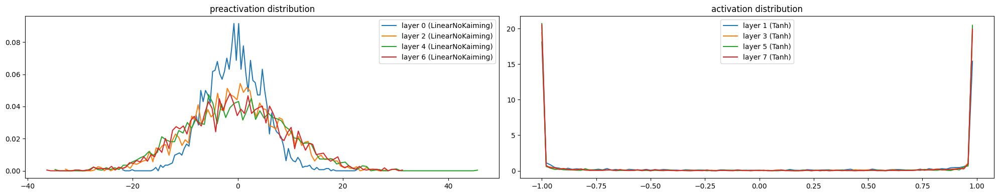

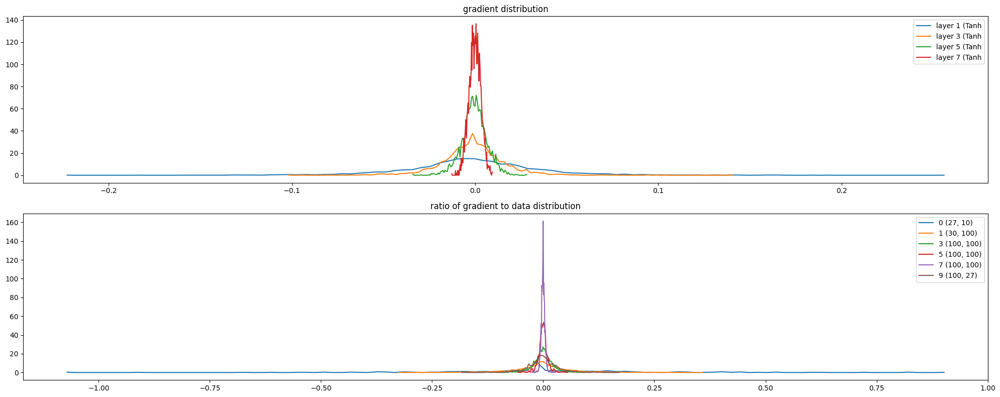

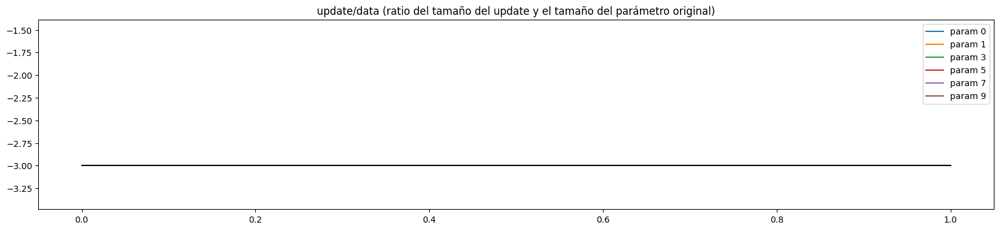

In [12]:
plot_preactivations_and_activations(layers, LinearNoKaiming, Tanh)

"""
Aca tambien sin el gain los gradientes estan mas dispersos entre las layers 
y se estan medio descontrolando. Lo que hay que hacer es que esten todos mas estables.
"""
plot_gradient_distribution(layers, Tanh, parameters)


"""
update/data (para ver la escala del update comparado a la data).
El ratio entre el tamaño del update y el tamaño del parámetro original para cada peso de la red, en cada paso de entrenamiento.
En otras palabras: ¿Qué tan grande es el cambio que le estás haciendo al parámetro comparado con su valor actual?

Tiene que estar encima de la linea pero no por tanto
"""

plot_update_data(parameters, ud)

### Despues de epochs

In [13]:
lossi, ud = train_model(Xtr, Ytr, C, layers, parameters, g, max_steps=5000)

      0/   5000: 3.5292
   1000/   5000: 2.7972
   2000/   5000: 2.8172
   3000/   5000: 2.5094
   4000/   5000: 2.5474


layer 0 (LinearNoKaiming): mean -0.15, std 8.92
layer 2 (LinearNoKaiming): mean +0.14, std 10.17
layer 4 (LinearNoKaiming): mean -0.12, std 10.86
layer 6 (LinearNoKaiming): mean -0.04, std 9.81
layer 1 (      Tanh): mean -0.03, std 0.96, saturated: 85.22%
layer 3 (      Tanh): mean +0.01, std 0.97, saturated: 85.94%
layer 5 (      Tanh): mean -0.01, std 0.97, saturated: 84.97%
layer 7 (      Tanh): mean -0.01, std 0.96, saturated: 82.69%
layer 1 (      Tanh): mean +0.000280, std 1.919096e-02
layer 3 (      Tanh): mean +0.000038, std 9.229885e-03
layer 5 (      Tanh): mean -0.000091, std 4.519204e-03
layer 7 (      Tanh): mean -0.000049, std 2.152770e-03
weight   (27, 10) | mean -0.002410 | std 8.757362e-02 | grad:data ratio 6.835873e-02
weight  (30, 100) | mean +0.000649 | std 3.878130e-02 | grad:data ratio 3.634334e-02
weight (100, 100) | mean -0.000015 | std 1.101472e-02 | grad:data ratio 1.100756e-02
weight (100, 100) | mean +0.000021 | std 5.125973e-03 | grad:data ratio 5.086696e-0

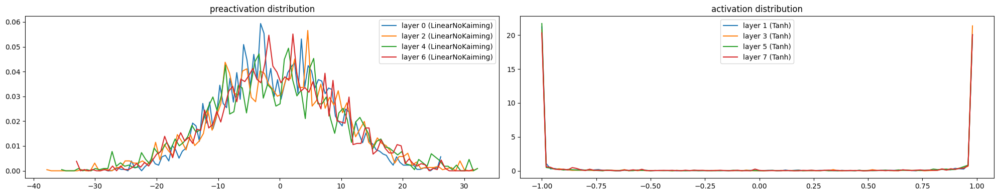

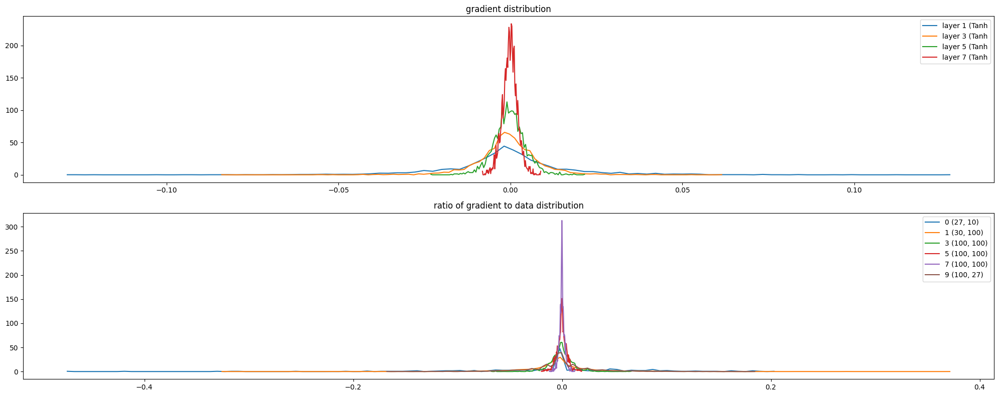

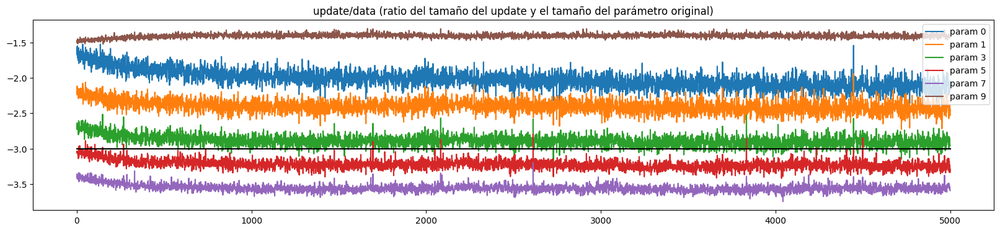

In [14]:
plot_preactivations_and_activations(layers, LinearNoKaiming, Tanh)

plot_gradient_distribution(layers, Tanh, parameters)

plot_update_data(parameters, ud)

### ReLU activation

In [42]:
n_embd = 10 # the dimensionality of the character embedding vectors
n_hidden = 100 # the number of neurons in the hidden layer of the MLP
g = torch.Generator().manual_seed(2147483647) # for reproducibility

C = torch.randn((vocab_size, n_embd),            generator=g)
layers = [
  LinearNoKaiming(n_embd * block_size, n_hidden), ReLU(),
  LinearNoKaiming(           n_hidden, n_hidden), ReLU(),
  LinearNoKaiming(           n_hidden, n_hidden), ReLU(),
  LinearNoKaiming(           n_hidden, n_hidden), ReLU(),
  LinearNoKaiming(           n_hidden, vocab_size),
]

with torch.no_grad():
  layers[-1].weight *= 0.1 # ultima capa para iniciar bien los logits
  
  for layer in layers[:-1]:
    if isinstance(layer, LinearNoKaiming):
      layer.weight *= 1 #5/3 ACA NO APLICAMOS GAIN PARA VER QUE PASA

parameters = [C] + [p for layer in layers for p in layer.parameters()]
print(sum(p.nelement() for p in parameters)) # number of parameters in total
for p in parameters:
  p.requires_grad = True

36397


In [43]:
lossi, ud = train_model(Xtr, Ytr, C, layers, parameters, g, max_steps=1)

      0/      1: 2860.9509


preactivations
layer 0 (LinearNoKaiming): mean -0.38, std 5.35
layer 2 (LinearNoKaiming): mean -0.83, std 35.49
layer 4 (LinearNoKaiming): mean -14.76, std 249.45
layer 6 (LinearNoKaiming): mean +189.69, std 1583.57

activations
layer 1 (      ReLU): mean +1.95, std 3.04, saturated: 39.47%
layer 3 (      ReLU): mean +13.26, std 21.39, saturated: 46.72%
layer 5 (      ReLU): mean +88.54, std 147.06, saturated: 47.06%
layer 7 (      ReLU): mean +709.74, std 1036.20, saturated: 54.22%

gradients
layer 1 (      ReLU): mean +0.089057, std 1.615248e+00
layer 3 (      ReLU): mean +0.030203, std 2.289645e-01
layer 5 (      ReLU): mean +0.004059, std 3.346116e-02
layer 7 (      ReLU): mean +0.000626, std 4.526102e-03

weights gradients
weight   (27, 10) | mean +0.397344 | std 3.015237e+01 | grad:data ratio 1.068423e+01
weight  (30, 100) | mean +0.003637 | std 7.389787e+00 | grad:data ratio 6.232818e+00
weight (100, 100) | mean +1.396120 | std 5.428162e+00 | grad:data ratio 4.895689e+00
weight (

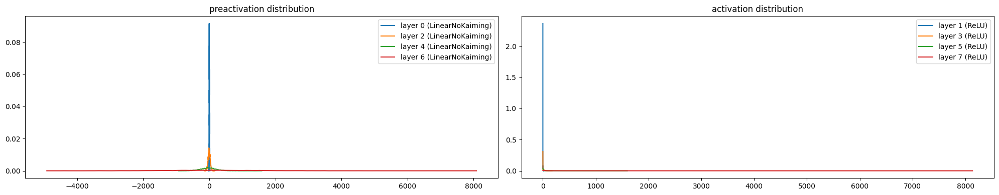

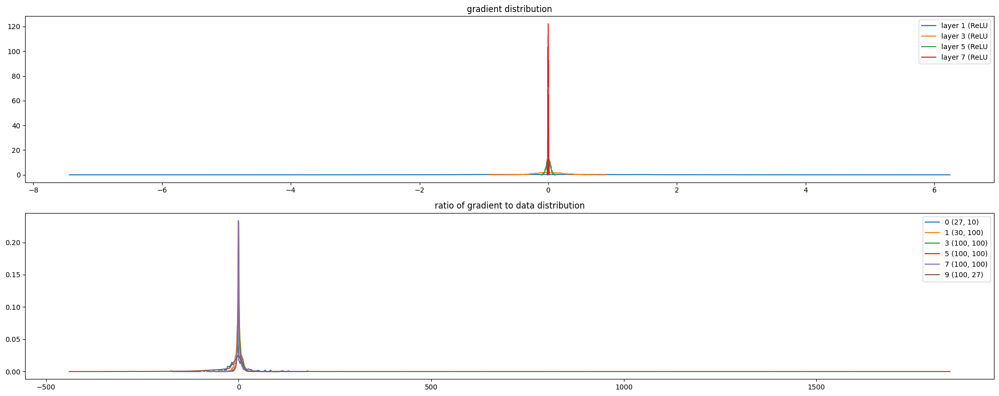

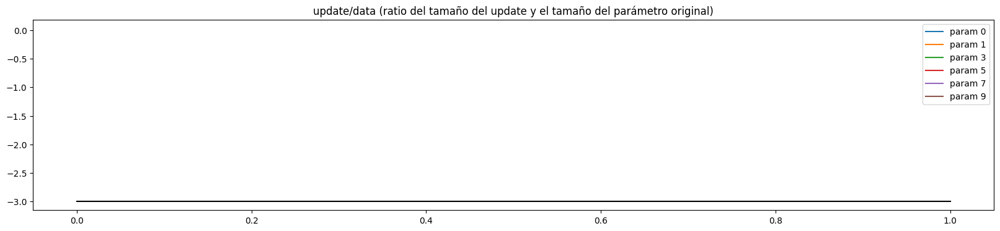

In [44]:
plot_preactivations_and_activations(layers, LinearNoKaiming, ReLU)
plot_gradient_distribution(layers, ReLU, parameters)
plot_update_data(parameters, ud)

### Kaiming init (no gain)

In [15]:
n_embd = 10 # the dimensionality of the character embedding vectors
n_hidden = 100 # the number of neurons in the hidden layer of the MLP
g = torch.Generator().manual_seed(2147483647) # for reproducibility

C = torch.randn((vocab_size, n_embd),            generator=g)
layers = [
  Linear(n_embd * block_size, n_hidden), Tanh(),
  Linear(           n_hidden, n_hidden), Tanh(),
  Linear(           n_hidden, n_hidden), Tanh(),
  Linear(           n_hidden, n_hidden), Tanh(),
  Linear(           n_hidden, vocab_size),
]

with torch.no_grad():
  layers[-1].weight *= 0.1 # ultima capa para iniciar bien los logits
  
  for layer in layers[:-1]:
    if isinstance(layer, Linear):
      layer.weight *= 1 #5/3 ACA NO APLICAMOS GAIN PARA VER QUE PASA

parameters = [C] + [p for layer in layers for p in layer.parameters()]
print(sum(p.nelement() for p in parameters)) # number of parameters in total
for p in parameters:
  p.requires_grad = True

36397


In [16]:
lossi, ud = train_model(Xtr, Ytr, C, layers, parameters, g, max_steps=5000)

      0/   5000: 3.2847
   1000/   5000: 2.3462
   2000/   5000: 2.5209
   3000/   5000: 2.1299
   4000/   5000: 2.3732


layer 0 (    Linear): mean -0.09, std 1.28
layer 2 (    Linear): mean +0.01, std 1.19
layer 4 (    Linear): mean +0.02, std 1.20
layer 6 (    Linear): mean +0.00, std 1.00
layer 1 (      Tanh): mean -0.05, std 0.70, saturated: 10.47%
layer 3 (      Tanh): mean +0.00, std 0.68, saturated: 6.84%
layer 5 (      Tanh): mean +0.01, std 0.69, saturated: 6.91%
layer 7 (      Tanh): mean +0.01, std 0.60, saturated: 4.69%
layer 1 (      Tanh): mean -0.000051, std 3.083673e-03
layer 3 (      Tanh): mean -0.000034, std 2.877116e-03
layer 5 (      Tanh): mean +0.000029, std 3.016889e-03
layer 7 (      Tanh): mean +0.000031, std 3.141276e-03
weight   (27, 10) | mean -0.000004 | std 1.276210e-02 | grad:data ratio 1.227911e-02
weight  (30, 100) | mean -0.000018 | std 1.156735e-02 | grad:data ratio 5.358463e-02
weight (100, 100) | mean +0.000086 | std 7.187758e-03 | grad:data ratio 6.044057e-02
weight (100, 100) | mean +0.000037 | std 7.035558e-03 | grad:data ratio 6.101515e-02
weight (100, 100) | mea

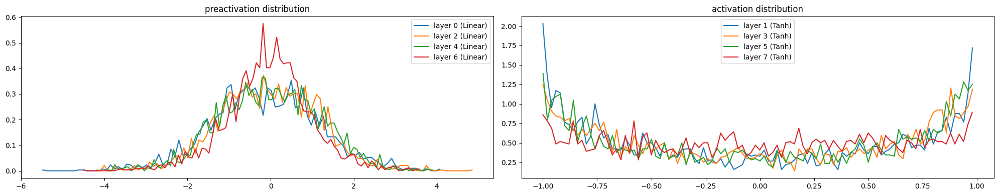

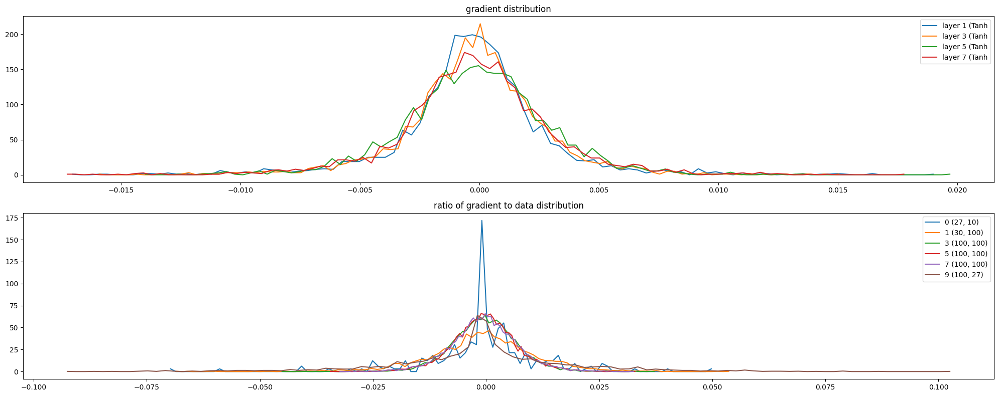

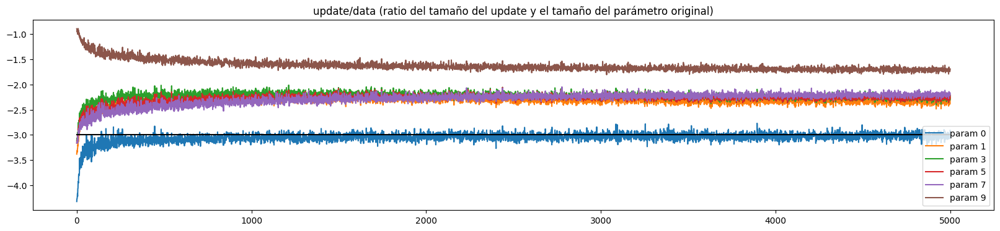

In [17]:
plot_preactivations_and_activations(layers, Linear, Tanh)
plot_gradient_distribution(layers, Tanh, parameters)
plot_update_data(parameters, ud)

### Kaiming init (con gain)

In [18]:
n_embd = 10 # the dimensionality of the character embedding vectors
n_hidden = 100 # the number of neurons in the hidden layer of the MLP
g = torch.Generator().manual_seed(2147483647) # for reproducibility

GAIN = 5/3  

C = torch.randn((vocab_size, n_embd),            generator=g)
layers = [
  Linear(n_embd * block_size, n_hidden), Tanh(),
  Linear(           n_hidden, n_hidden), Tanh(),
  Linear(           n_hidden, n_hidden), Tanh(),
  Linear(           n_hidden, n_hidden), Tanh(),
  Linear(           n_hidden, vocab_size),
]

with torch.no_grad():
  layers[-1].weight *= 0.1 # ultima capa para iniciar bien los logits
  
  for layer in layers[:-1]:
    if isinstance(layer, Linear):
      layer.weight *= GAIN #5/3 ACA APLICAMOS GAIN PARA VER QUE PASA

parameters = [C] + [p for layer in layers for p in layer.parameters()]
print(sum(p.nelement() for p in parameters)) # number of parameters in total
for p in parameters:
  p.requires_grad = True

36397


In [19]:
lossi, ud = train_model(Xtr, Ytr, C, layers, parameters, g)

      0/   5000: 3.2868
   1000/   5000: 2.2696
   2000/   5000: 2.5233
   3000/   5000: 2.0778
   4000/   5000: 2.3889


layer 0 (    Linear): mean -0.18, std 1.80
layer 2 (    Linear): mean +0.00, std 1.64
layer 4 (    Linear): mean +0.00, std 1.78
layer 6 (    Linear): mean -0.05, std 1.52
layer 1 (      Tanh): mean -0.07, std 0.78, saturated: 23.88%
layer 3 (      Tanh): mean +0.01, std 0.77, saturated: 19.56%
layer 5 (      Tanh): mean -0.01, std 0.80, saturated: 23.97%
layer 7 (      Tanh): mean -0.02, std 0.74, saturated: 15.59%
layer 1 (      Tanh): mean -0.000107, std 3.298423e-03
layer 3 (      Tanh): mean +0.000065, std 3.152464e-03
layer 5 (      Tanh): mean +0.000085, std 3.367099e-03
layer 7 (      Tanh): mean -0.000025, std 3.383995e-03
weight   (27, 10) | mean -0.000526 | std 1.204885e-02 | grad:data ratio 1.183432e-02
weight  (30, 100) | mean -0.000122 | std 9.356221e-03 | grad:data ratio 2.892964e-02
weight (100, 100) | mean -0.000038 | std 7.623643e-03 | grad:data ratio 4.285900e-02
weight (100, 100) | mean +0.000125 | std 7.643108e-03 | grad:data ratio 4.300309e-02
weight (100, 100) | 

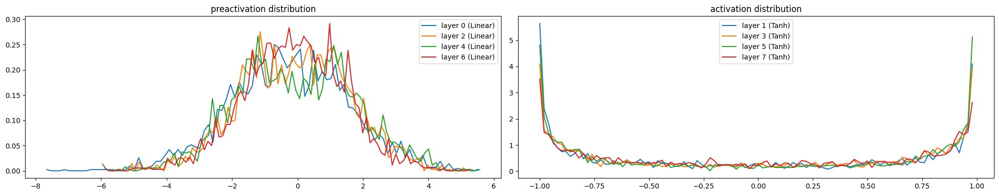

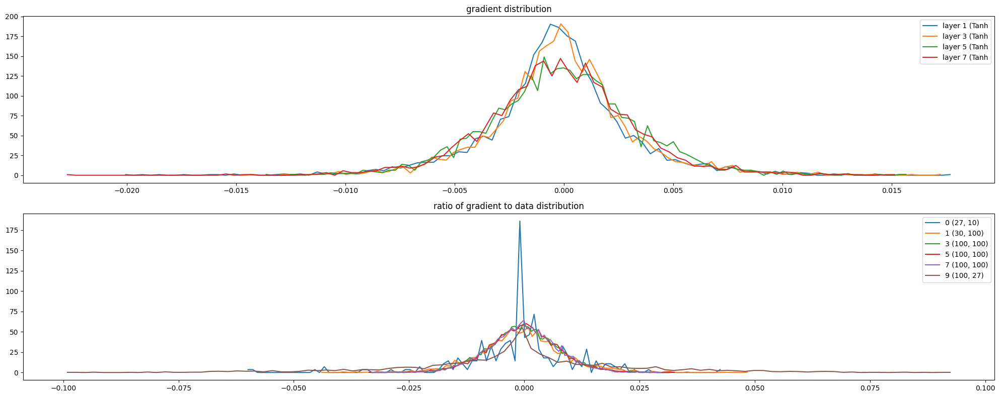

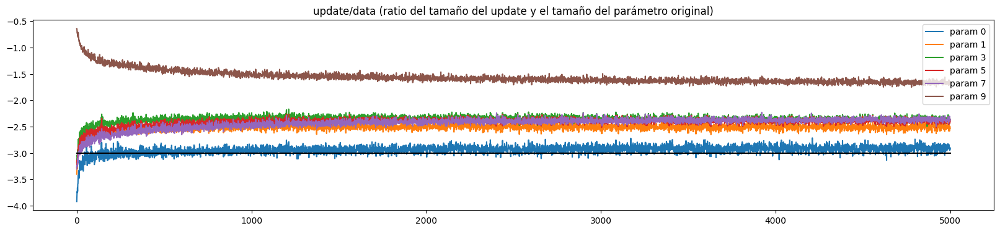

In [20]:
plot_preactivations_and_activations(layers, Linear, Tanh)
plot_gradient_distribution(layers, Tanh, parameters)
plot_update_data(parameters, ud)

### BatchNorm sin init

In [24]:
n_embd = 10 # the dimensionality of the character embedding vectors
n_hidden = 100 # the number of neurons in the hidden layer of the MLP
g = torch.Generator().manual_seed(2147483647) # for reproducibility


C = torch.randn((vocab_size, n_embd),            generator=g)
layers = [
  LinearNoKaiming(n_embd * block_size, n_hidden), BatchNorm1d(n_hidden), Tanh(),
  LinearNoKaiming(           n_hidden, n_hidden), BatchNorm1d(n_hidden), Tanh(),
  LinearNoKaiming(           n_hidden, n_hidden), BatchNorm1d(n_hidden), Tanh(),
  LinearNoKaiming(           n_hidden, n_hidden), BatchNorm1d(n_hidden), Tanh(),
  LinearNoKaiming(           n_hidden, vocab_size),
]

with torch.no_grad():
  layers[-1].weight *= 0.1 # ultima capa para iniciar bien los logits
  
  for layer in layers[:-1]:
    if isinstance(layer, LinearNoKaiming):
      layer.weight *= 1 # NO GAIN

parameters = [C] + [p for layer in layers for p in layer.parameters()]
print(sum(p.nelement() for p in parameters)) # number of parameters in total
for p in parameters:
  p.requires_grad = True

37197


In [25]:
lossi, ud = train_model(Xtr, Ytr, C, layers, parameters, g)

      0/   5000: 3.2533
   1000/   5000: 2.4436
   2000/   5000: 2.2928
   3000/   5000: 2.3550
   4000/   5000: 2.4452


layer 0 (LinearNoKaiming): mean -0.57, std 6.02
layer 3 (LinearNoKaiming): mean +0.02, std 6.02
layer 6 (LinearNoKaiming): mean +0.10, std 6.50
layer 9 (LinearNoKaiming): mean +0.02, std 6.14
layer 2 (      Tanh): mean +0.00, std 0.61, saturated: 2.75%
layer 5 (      Tanh): mean -0.01, std 0.63, saturated: 2.47%
layer 8 (      Tanh): mean -0.00, std 0.63, saturated: 2.62%
layer 11 (      Tanh): mean +0.00, std 0.63, saturated: 2.34%
layer 2 (      Tanh): mean -0.000000, std 6.452341e-03
layer 5 (      Tanh): mean +0.000000, std 5.507945e-03
layer 8 (      Tanh): mean +0.000000, std 5.157701e-03
layer 11 (      Tanh): mean +0.000050, std 4.814468e-03
weight   (27, 10) | mean -0.000000 | std 1.379753e-02 | grad:data ratio 1.373977e-02
weight  (30, 100) | mean -0.000020 | std 4.302386e-03 | grad:data ratio 4.196653e-03
weight (100, 100) | mean -0.000034 | std 2.044995e-03 | grad:data ratio 2.051535e-03
weight (100, 100) | mean -0.000004 | std 1.897423e-03 | grad:data ratio 1.883536e-03
we

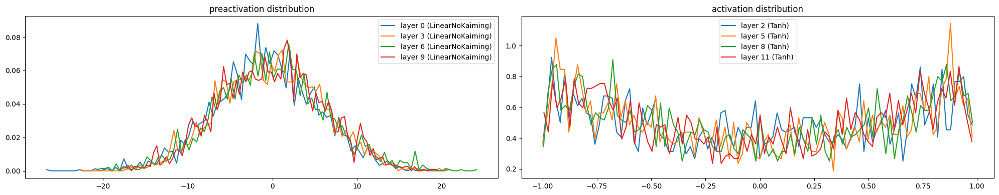

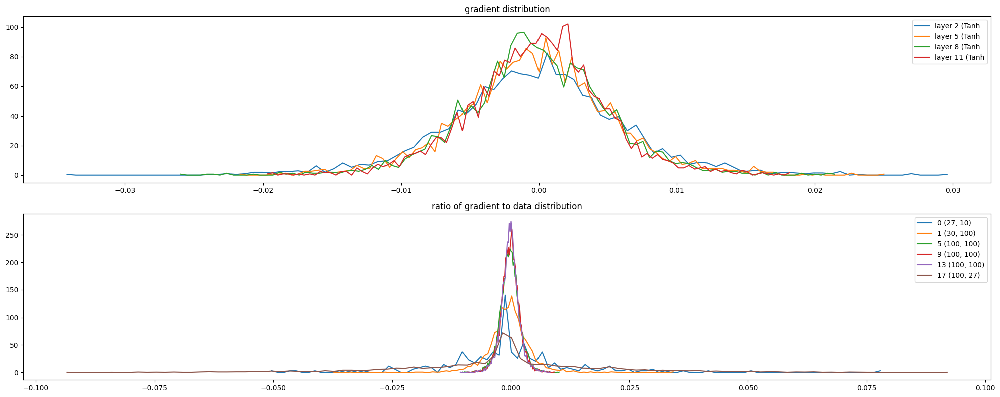

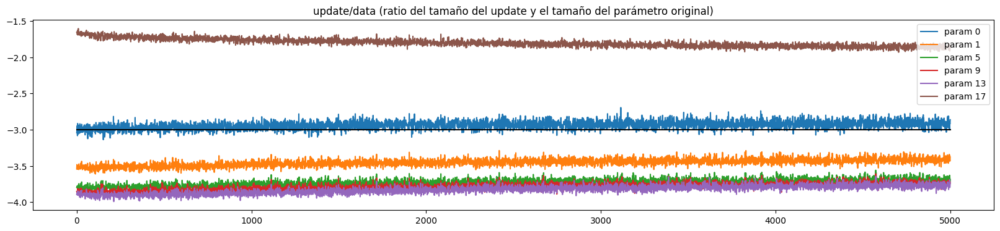

In [26]:
plot_preactivations_and_activations(layers, LinearNoKaiming, Tanh)
plot_gradient_distribution(layers, Tanh, parameters)
plot_update_data(parameters, ud)

### BatchNorm con init

In [21]:
n_embd = 10 # the dimensionality of the character embedding vectors
n_hidden = 100 # the number of neurons in the hidden layer of the MLP
g = torch.Generator().manual_seed(2147483647) # for reproducibility

GAIN = 5/3  

C = torch.randn((vocab_size, n_embd),            generator=g)
layers = [
  Linear(n_embd * block_size, n_hidden), BatchNorm1d(n_hidden), Tanh(),
  Linear(           n_hidden, n_hidden), BatchNorm1d(n_hidden), Tanh(),
  Linear(           n_hidden, n_hidden), BatchNorm1d(n_hidden), Tanh(),
  Linear(           n_hidden, n_hidden), BatchNorm1d(n_hidden), Tanh(),
  Linear(           n_hidden, vocab_size),
]

with torch.no_grad():
  layers[-1].weight *= 0.1 # ultima capa para iniciar bien los logits
  
  for layer in layers[:-1]:
    if isinstance(layer, Linear):
      layer.weight *= GAIN #5/3 ACA APLICAMOS GAIN PARA VER QUE PASA

parameters = [C] + [p for layer in layers for p in layer.parameters()]
print(sum(p.nelement() for p in parameters)) # number of parameters in total
for p in parameters:
  p.requires_grad = True

37197


In [22]:
lossi, ud = train_model(Xtr, Ytr, C, layers, parameters, g)

      0/   5000: 3.2739
   1000/   5000: 2.4115
   2000/   5000: 2.3353
   3000/   5000: 2.2035
   4000/   5000: 2.3912


layer 0 (    Linear): mean -0.17, std 1.72
layer 3 (    Linear): mean +0.00, std 1.22
layer 6 (    Linear): mean +0.02, std 1.32
layer 9 (    Linear): mean +0.01, std 1.24
layer 2 (      Tanh): mean +0.00, std 0.63, saturated: 3.81%
layer 5 (      Tanh): mean -0.00, std 0.65, saturated: 3.53%
layer 8 (      Tanh): mean -0.01, std 0.65, saturated: 3.50%
layer 11 (      Tanh): mean +0.00, std 0.65, saturated: 2.62%
layer 2 (      Tanh): mean +0.000000, std 4.114754e-03
layer 5 (      Tanh): mean -0.000000, std 3.794876e-03
layer 8 (      Tanh): mean +0.000000, std 3.642495e-03
layer 11 (      Tanh): mean +0.000009, std 3.468153e-03
weight   (27, 10) | mean +0.000000 | std 1.233890e-02 | grad:data ratio 1.229414e-02
weight  (30, 100) | mean -0.000340 | std 9.613246e-03 | grad:data ratio 3.020898e-02
weight (100, 100) | mean +0.000044 | std 7.285952e-03 | grad:data ratio 4.187287e-02
weight (100, 100) | mean +0.000054 | std 7.116941e-03 | grad:data ratio 4.093090e-02
weight (100, 100) | me

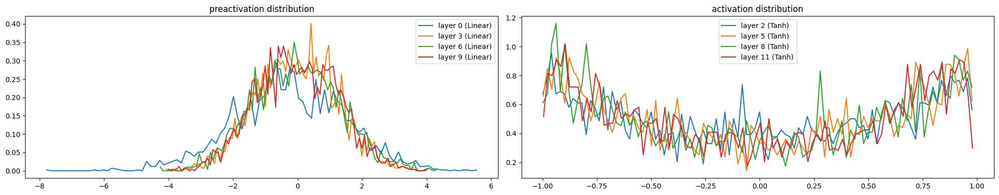

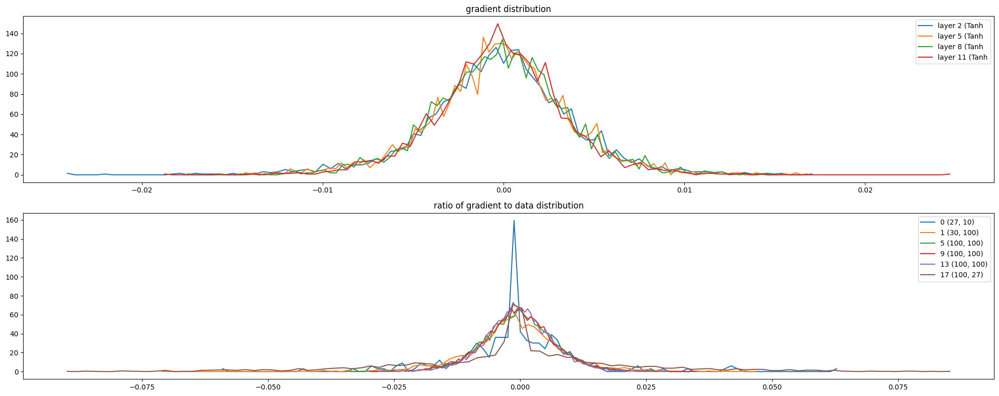

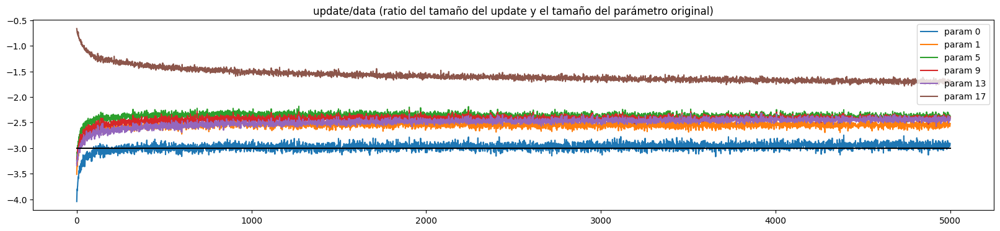

In [23]:
plot_preactivations_and_activations(layers, Linear, Tanh)
plot_gradient_distribution(layers, Tanh, parameters)
plot_update_data(parameters, ud)

### LayerNorm con init

In [27]:
n_embd = 10 # the dimensionality of the character embedding vectors
n_hidden = 100 # the number of neurons in the hidden layer of the MLP
g = torch.Generator().manual_seed(2147483647) # for reproducibility

GAIN = 5/3  

C = torch.randn((vocab_size, n_embd),            generator=g)
layers = [
  Linear(n_embd * block_size, n_hidden), LayerNorm1d(n_hidden), Tanh(),
  Linear(           n_hidden, n_hidden), LayerNorm1d(n_hidden), Tanh(),
  Linear(           n_hidden, n_hidden), LayerNorm1d(n_hidden), Tanh(),
  Linear(           n_hidden, n_hidden), LayerNorm1d(n_hidden), Tanh(),
  Linear(           n_hidden, vocab_size),
]

with torch.no_grad():
  layers[-1].weight *= 0.1 # ultima capa para iniciar bien los logits
  
  for layer in layers[:-1]:
    if isinstance(layer, Linear):
      layer.weight *= GAIN #5/3 ACA APLICAMOS GAIN PARA VER QUE PASA

parameters = [C] + [p for layer in layers for p in layer.parameters()]
print(sum(p.nelement() for p in parameters)) # number of parameters in total
for p in parameters:
  p.requires_grad = True

37197


In [28]:
lossi, ud = train_model(Xtr, Ytr, C, layers, parameters, g)

      0/   5000: 3.2777
   1000/   5000: 2.2611
   2000/   5000: 2.4912
   3000/   5000: 2.1373
   4000/   5000: 2.3832


layer 0 (    Linear): mean -0.16, std 1.68
layer 3 (    Linear): mean +0.00, std 1.24
layer 6 (    Linear): mean +0.02, std 1.39
layer 9 (    Linear): mean -0.04, std 1.34
layer 2 (      Tanh): mean +0.00, std 0.64, saturated: 4.25%
layer 5 (      Tanh): mean +0.01, std 0.67, saturated: 4.91%
layer 8 (      Tanh): mean -0.01, std 0.67, saturated: 5.94%
layer 11 (      Tanh): mean -0.00, std 0.64, saturated: 5.19%
layer 2 (      Tanh): mean -0.000073, std 3.703053e-03
layer 5 (      Tanh): mean +0.000073, std 3.482494e-03
layer 8 (      Tanh): mean -0.000026, std 3.711726e-03
layer 11 (      Tanh): mean -0.000100, std 3.557023e-03
weight   (27, 10) | mean -0.000233 | std 1.164815e-02 | grad:data ratio 1.160354e-02
weight  (30, 100) | mean -0.000000 | std 8.417727e-03 | grad:data ratio 2.649093e-02
weight (100, 100) | mean +0.000000 | std 6.714830e-03 | grad:data ratio 3.862165e-02
weight (100, 100) | mean +0.000000 | std 6.787885e-03 | grad:data ratio 3.897905e-02
weight (100, 100) | me

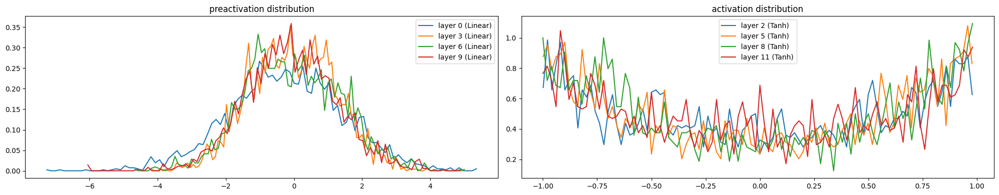

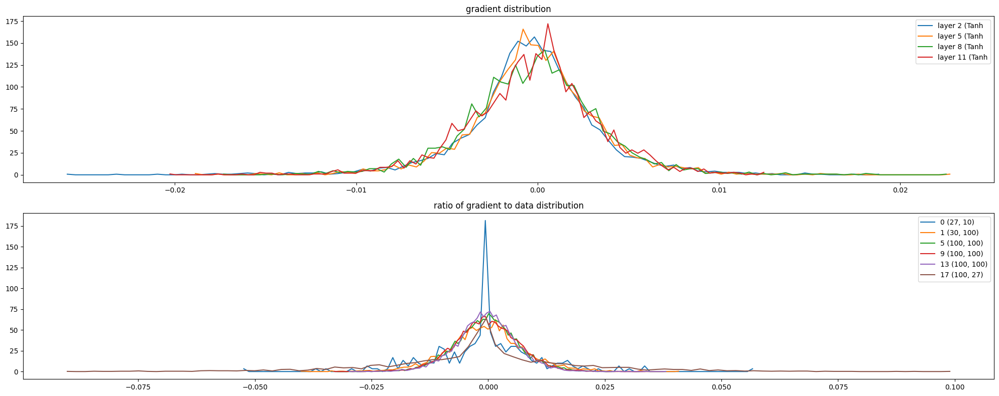

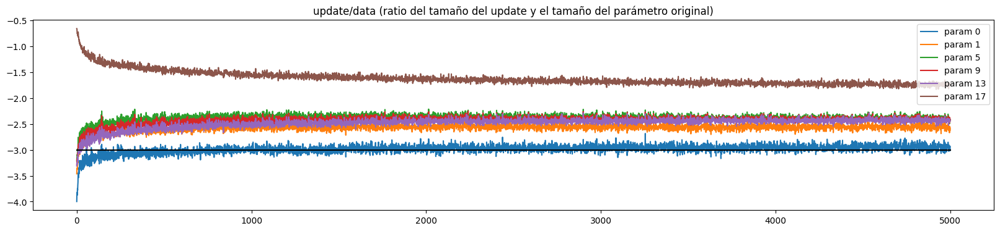

In [29]:
plot_preactivations_and_activations(layers, Linear, Tanh)
plot_gradient_distribution(layers, Tanh, parameters)
plot_update_data(parameters, ud)

## Problemas

**En una red profunda todo se reduce a cadenas multiplicativas que viajan:**
- Activaciones: forward
- Gradientes: backward

Cada vez que pasás por una capa, modificás estos valores multiplicándolos o transformándolos.

Entonces, si hacés eso muchas veces seguidas (en redes profundas), hay dos opciones:
- Las cosas se van inflando paso a paso → explota.
- Las cosas se van apagando paso a paso → se apaga.

Eso es lo que está pasando cuando hablás de "exploding" o "vanishing".

En una red neuronal profunda, algo así pasa con los números que se propagan por las capas: si cada vez multiplicás por algo un poco mayor que 1, se inflan; si es menor que 1, se apagan.


---
**Backprop: Multiplicaciones por weights o activations**:

Cuando haces backprop en una red profunda, lo que mas haces son multiplicaciones de: 
- Gradientes ya calculadas (en las capas mas adelante)
- Por weights o activaciones

Por que? Si queremos seguir el calculo de gradientes hacia atras, tenemos que calcular el grad de la loss con respecto a la ACTIVACION... entonces ahi multiplicamos el gradiente de las capas anteriores con el weight que multiplica la activacion! Para calcular el grad del weight, multiplicamos por la activacion.

---

**Ejemplo**

* **1 input escalar:** $x \in \mathbb{R}$
* **2 capas ocultas**, 1 neurona cada una.
* **1 output escalar**.
* Todas las capas usan ReLU como activación, excepto la última.

```text
x ──▶ (w1, b1) ──▶ ReLU ──▶ (w2, b2) ──▶ ReLU ──▶ (w3, b3) ──▶ y_pred
```

**Forward pass**

1. **Capa 1**

   $$
   z_1 = w_1 \cdot x + b_1 \\
   a_1 = \text{ReLU}(z_1)
   $$

2. **Capa 2**

   $$
   z_2 = w_2 \cdot a_1 + b_2 \\
   a_2 = \text{ReLU}(z_2)
   $$

3. **Output**

   $$
   y = z_3 = w_3 \cdot a_2 + b_3
   $$

4. **Loss**

   $$
   \mathcal{L} = \frac{1}{2}(y - y_{\text{true}})^2
   $$

---

**Backpropagation: ¿qué vamos a calcular?**

Queremos calcular **todos los gradientes**:

* $\frac{\partial \mathcal{L}}{\partial w_3}, \frac{\partial \mathcal{L}}{\partial b_3}$
* $\frac{\partial \mathcal{L}}{\partial w_2}, \frac{\partial \mathcal{L}}{\partial b_2}$
* $\frac{\partial \mathcal{L}}{\partial w_1}, \frac{\partial \mathcal{L}}{\partial b_1}$

---

Paso 1: gradiente de la loss respecto al output

$$
\frac{\partial \mathcal{L}}{\partial y} = y - y_{\text{true}}
$$

Este gradiente se propaga hacia los pesos de la última capa.

---

Paso 2: capa 3 (output)

$$
y = w_3 \cdot a_2 + b_3
\Rightarrow
\frac{\partial y}{\partial w_3} = a_2,\quad
\frac{\partial y}{\partial a_2} = w_3,\quad
\frac{\partial y}{\partial b_3} = 1
$$

Aplicamos regla de la cadena:

$$
\frac{\partial \mathcal{L}}{\partial w_3} = \frac{\partial \mathcal{L}}{\partial y} \cdot \frac{\partial y}{\partial w_3} = (y - y_{\text{true}}) \cdot a_2
$$

$$
\frac{\partial \mathcal{L}}{\partial b_3} = (y - y_{\text{true}}) \cdot 1 = (y - y_{\text{true}})
$$

**Y lo más importante:**

$$
\frac{\partial \mathcal{L}}{\partial a_2} = (y - y_{\text{true}}) \cdot w_3
$$

Este **gradiente intermedio** se propaga hacia la capa anterior.

---

Paso 3: capa 2 (ReLU + Linear)

Tenemos:

$$
z_2 = w_2 \cdot a_1 + b_2,\quad a_2 = \text{ReLU}(z_2)
$$

Para retropropagar a través de ReLU:

$$
\frac{\partial a_2}{\partial z_2} = \mathbb{1}_{z_2 > 0}
\Rightarrow
\frac{\partial \mathcal{L}}{\partial z_2} = \frac{\partial \mathcal{L}}{\partial a_2} \cdot \mathbb{1}_{z_2 > 0}
$$

Luego:

$$
\frac{\partial z_2}{\partial w_2} = a_1,\quad
\frac{\partial z_2}{\partial a_1} = w_2,\quad
\frac{\partial z_2}{\partial b_2} = 1
$$

Entonces:

$$
\frac{\partial \mathcal{L}}{\partial w_2} = \frac{\partial \mathcal{L}}{\partial z_2} \cdot a_1
$$

$$
\frac{\partial \mathcal{L}}{\partial b_2} = \frac{\partial \mathcal{L}}{\partial z_2} \cdot 1
$$

$$
\frac{\partial \mathcal{L}}{\partial a_1} = \frac{\partial \mathcal{L}}{\partial z_2} \cdot w_2
$$

---

Paso 4: capa 1

Idéntico procedimiento:

$$
z_1 = w_1 \cdot x + b_1,\quad a_1 = \text{ReLU}(z_1)
\Rightarrow \frac{\partial a_1}{\partial z_1} = \mathbb{1}_{z_1 > 0}
\Rightarrow \frac{\partial \mathcal{L}}{\partial z_1} = \frac{\partial \mathcal{L}}{\partial a_1} \cdot \mathbb{1}_{z_1 > 0}
$$

$$
\frac{\partial \mathcal{L}}{\partial w_1} = \frac{\partial \mathcal{L}}{\partial z_1} \cdot x
$$

$$
\frac{\partial \mathcal{L}}{\partial b_1} = \frac{\partial \mathcal{L}}{\partial z_1}
$$

---

* Para cada peso, la derivada final es:
$$
\frac{\partial \mathcal{L}}{\partial w_2} = \frac{\partial \mathcal{L}}{\partial z_2} \cdot a_1
$$
$$
\frac{\partial \mathcal{L}}{\partial w} = \text{gradiente que llegó desde arriba} \times \text{input(o activacion de la capa anterior que llegó a ese peso)} 
$$

* Para cada activacion (para seguir hacia atras), la derivada final es:
$$
\frac{\partial \mathcal{L}}{\partial a_1} = \frac{\partial \mathcal{L}}{\partial z_2} \cdot w_2
$$
$$
\frac{\partial \mathcal{L}}{\partial a} = \text{gradiente que llegó desde arriba} \times \text{peso con el que se multiplica esa activacion para el nuevo preact} 
$$


---

**PARA QUE UN GRADIENTE SE MANTENGA BIEN:**
- **Clave**: evitar funciones cuya derivada promedio sea mucho menor que 1 (saturación de tanh, sigmoid) o que anulen la señal en masa (ReLU pura en redes profundas sin cuidados).




### Exploding activations ->

### -> Saturacion de activaciones ->

### -> Vanishing gradients 


- No usar inicialización Kaiming:
- No usar ningún tipo de normalización:
- Usar varias capas profundas (mínimo 3 o 4 capas):
- Usar función de activación ReLU (recomendado) o tanh para ver distintos efectos.

---

- Inicializar pesos sin escalarlos hace que cada neurona reciba inputs que, al multiplicarse por pesos no controlados, tiendan a aumentar en promedio su magnitud.
- Cada capa multiplica estos valores grandes nuevamente por pesos no controlados, haciendo que las activaciones crezcan exponencialmente.
- Las funciones de activación juegan un rol clave:
    - Tanh: intenta comprimir valores grandes a 1 o -1, pero si la entrada ya es enorme, la salida será prácticamente 1 o -1, acumulándose estos valores saturados en la siguiente capa (aunque puede "limitar" en algo, igual los valores internos antes del tanh crecen mucho).
    - ReLU: no tiene techo superior, por lo tanto, permitiría claramente ver valores grandes positivos y podría mostrar más claramente cómo explotan las activaciones.

---

- Si usas Tanh: Vas a observar primero una saturación rápida (muchos valores cerca de 1 o -1), aunque si lográs pasar esa barrera inicial (multiplicando pesos), eventualmente vas a ver que las capas más profundas acumulan valores muy grandes antes del tanh.
- Si usas ReLU: Es más fácil de visualizar claramente la explosión. Vas a ver directamente cómo los valores crecen exponencialmente, ya que ReLU no limita superiormente.


#### ReLU solo (1 iteracion)

Vemos como con ReLU, ya se descontrola todo a la primera iteracion!

In [9]:
n_embd = 10 # the dimensionality of the character embedding vectors
n_hidden = 100 # the number of neurons in the hidden layer of the MLP
g = torch.Generator().manual_seed(2147483647) # for reproducibility

C = torch.randn((vocab_size, n_embd),            generator=g)
layers = [
  LinearNoKaiming(n_embd * block_size, n_hidden), ReLU(),
  LinearNoKaiming(           n_hidden, n_hidden), ReLU(),
  LinearNoKaiming(           n_hidden, n_hidden), ReLU(),
  LinearNoKaiming(           n_hidden, n_hidden), ReLU(),
  LinearNoKaiming(           n_hidden, vocab_size),
]

with torch.no_grad():
  layers[-1].weight *= 0.1 # ultima capa para iniciar bien los logits
  
  for layer in layers[:-1]:
    if isinstance(layer, LinearNoKaiming):
      layer.weight *= 1 #5/3 ACA NO APLICAMOS GAIN

parameters = [C] + [p for layer in layers for p in layer.parameters()]
print(sum(p.nelement() for p in parameters)) # number of parameters in total
for p in parameters:
  p.requires_grad = True

36397


In [10]:
lossi, ud = train_model(Xtr, Ytr, C, layers, parameters, g, max_steps=1)

      0/      1: 2860.9509


preactivations
layer 0 (LinearNoKaiming): mean -0.3847, std 5.3519
layer 2 (LinearNoKaiming): mean -0.8309, std 35.4949
layer 4 (LinearNoKaiming): mean -14.7558, std 249.4458
layer 6 (LinearNoKaiming): mean +189.6908, std 1583.5696

activations
layer 1 (      ReLU): mean +1.9485, std 3.0358, saturated: 53.0000%
layer 3 (      ReLU): mean +13.2627, std 21.3919, saturated: 52.1250%
layer 5 (      ReLU): mean +88.5397, std 147.0597, saturated: 52.9063%
layer 7 (      ReLU): mean +709.7377, std 1036.1997, saturated: 45.7500%


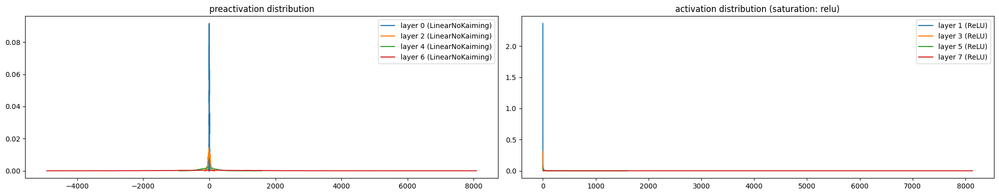

In [11]:
plot_preactivations_and_activations(layers, LinearNoKaiming, ReLU, activation_type='relu')

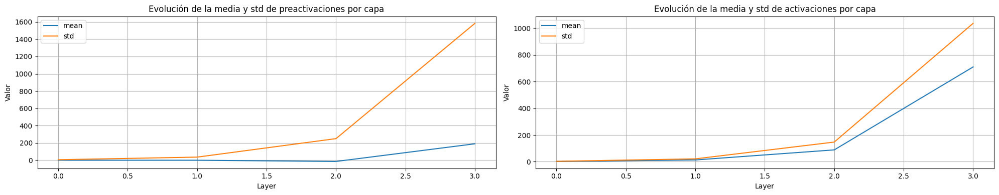

In [12]:
plot_activation_evolution(layers, LinearNoKaiming, ReLU)

Va explotando de a poco hacia adelante en el forward. 

La saturacion (0s constantes) es alto pero no tan alto porque ReLU no es squashing sino que mata la mitad maso...


gradients
layer 1 (      ReLU): mean +0.0891, std 1.6152
layer 3 (      ReLU): mean +0.0302, std 0.2290
layer 5 (      ReLU): mean +0.0041, std 0.0335
layer 7 (      ReLU): mean +0.0006, std 0.0045

weights gradients
weight   (27, 10) | mean +0.3973 | std 30.1524 | grad:data ratio 10.6842
weight  (30, 100) | mean +0.0036 | std 7.3898 | grad:data ratio 6.2328
weight (100, 100) | mean +1.3961 | std 5.4282 | grad:data ratio 4.8957
weight (100, 100) | mean +1.1595 | std 6.5200 | grad:data ratio 5.5431
weight (100, 100) | mean +1.2907 | std 7.9545 | grad:data ratio 6.3141
weight  (100, 27) | mean -0.0000 | std 154.2997 | grad:data ratio 10.0042


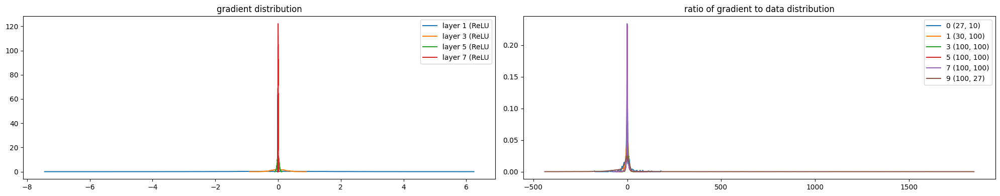

In [13]:
plot_gradient_distribution(layers, ReLU, parameters)

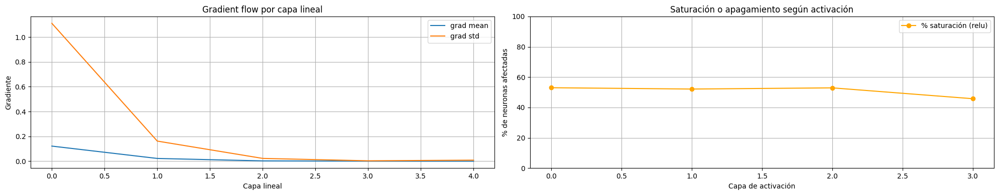

In [14]:
import warnings
warnings.filterwarnings('ignore')
plot_generalized_gradient_flow_and_activation_stats(
    layers, LinearNoKaiming, ReLU, activation_type='relu'
)

**Explicacion**

ReLU es muy simple, y la derivada tambien. La derivada de ReLU es 1 si x>0 y 0 si x>=0...

El backprop se hace asi:
1. Primero se hace el forward pass -> se van calculando las pre activaciones, activaciones, etc. hasta llegar a la loss
2. Toda esa informacion de valores de preact, act, etc QUEDA en el grafo cuando termina el forward pass
3. Empieza backprop que va a propagar gradientes siguiendo el grafo USANDO LOS VALORES DE LAS PREACT Y ACT, ETC CALCULADOS EN EL FORWARD.
4. Entonces si venimos de adelante (desde la loss hacia atras) y estamos en un nodo de activacion, que viene de una operacion ReLU:
    - Si el valor de la activacion == 0, entonces se corta el paso de gradientes, no llega el grad al nodo preact (antes del ReLU)
    - Si el valor de la activacion > 0, entonces pasa el mismo valor del gradiente desde la activacion a la preactivacion -> porque el grad = 1 y se multiplica por lo que ya viene (cadena)

Entonces:
- Cada neurona ReLU decide si deja pasar o no el gradiente hacia atrás según si estuvo activa o no en forward.
- Si una neurona está "apagada" (z ≤ 0), no contribuye a la salida y no aprende nada, porque no recibe gradiente.
- Si esto pasa muchas veces seguidas, la neurona queda siempre inactiva y nunca actualiza sus pesos: → neurona muerta.

---
Para nuestro caso ahora: **Vanishing gradients debido a acumulación de ReLU apagadas y falta de estabilización.**

Esto es una situación mixta, bastante común:
- Exploding Activations causan que las últimas capas reciban gradientes grandes inicialmente.
- Pero rápidamente aparecen muchas saturaciones (gradientes 0 en negativos), por lo que al retroceder hacia las primeras capas, los gradientes van desapareciendo.
- Por eso, la primera capa termina casi sin gradientes (esto parece contradictorio pero es habitual cuando combinas explosiones iniciales con saturaciones luego).

Conclusión clara de lo que pasó:
- La falta de inicialización controlada (como Kaiming) hizo que cada capa amplificara enormemente las activaciones, causando exploding activations.
- Estos valores grandes generaron exploding gradients inicialmente (sobre todo en últimas capas).
- Combinado con activación ReLU, también generó saturación que limita parcialmente los gradientes hacia atrás (mezcla rara de exploding + vanishing).
- Finalmente, las actualizaciones de pesos enormes hacen que la red colapse numéricamente.


Ahora, atención a la consecuencia clave:
- Cuanto más profunda sea la red, mayor es la probabilidad de que al menos en una capa tengas muchas neuronas en 0, bloqueando totalmente algunos caminos hacia atrás.

Así sucede que:
- La última capa (la más cerca del output) recibe aún buenos gradientes (porque está cerca del error final).
- Las capas anteriores (más cerca del input) reciben cada vez menos gradientes porque muchas neuronas quedaron bloqueadas por ceros en capas intermedias.
- Por eso, los gradientes van disminuyendo rápidamente al retroceder, algo que parece contraintuitivo con exploding activations, pero que ocurre justamente por este bloqueo en capas intermedias.




update/data


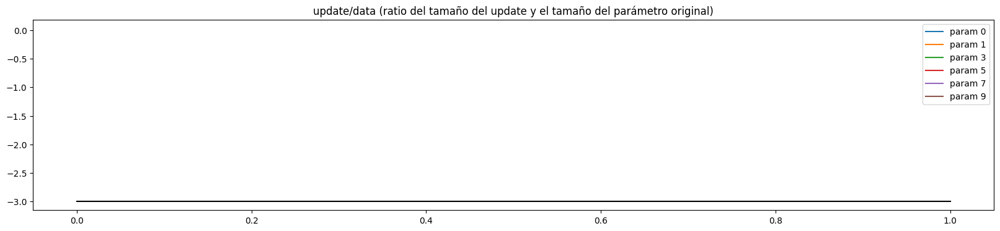

In [15]:
plot_update_data(parameters, ud)


Distribución de pesos por capa (excluyendo última capa lineal):
Layer 0: mean = +0.0212, std = 1.1856
Layer 1: mean = -0.1451, std = 1.1088
Layer 2: mean = -0.1116, std = 1.1762
Layer 3: mean = -0.1082, std = 1.2598


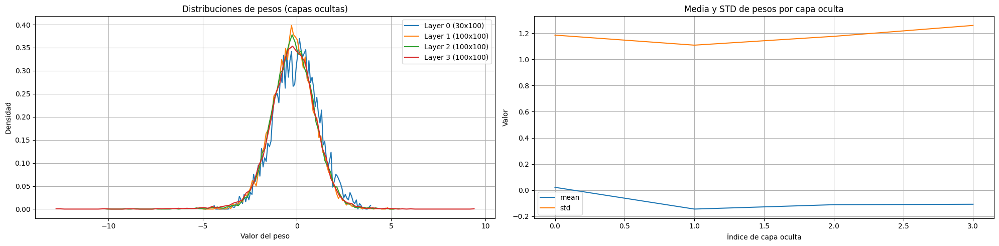

In [16]:
plot_weight_distributions_summary(layers, LinearNoKaiming)


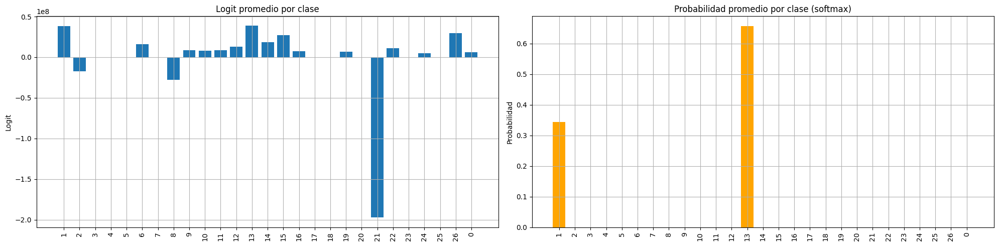

In [17]:
# Supongamos que ya tenés un batch
Xb = Xtr[0:32]

# Hacés el forward pass
with torch.no_grad():
    emb = C[Xb]
    x = emb.view(emb.shape[0], -1)
    for layer in layers:
        x = layer(x)  # logits

# Ahora visualizás por clase
plot_logits_and_probs_by_class(x, itos=itos)


#### Tanh solo (1 iteracion)


In [18]:
n_embd = 10 # the dimensionality of the character embedding vectors
n_hidden = 100 # the number of neurons in the hidden layer of the MLP
g = torch.Generator().manual_seed(2147483647) # for reproducibility

C = torch.randn((vocab_size, n_embd),            generator=g)
layers = [
  LinearNoKaiming(n_embd * block_size, n_hidden), Tanh(),
  LinearNoKaiming(           n_hidden, n_hidden), Tanh(),
  LinearNoKaiming(           n_hidden, n_hidden), Tanh(),
  LinearNoKaiming(           n_hidden, n_hidden), Tanh(),
  LinearNoKaiming(           n_hidden, vocab_size),
]

with torch.no_grad():
  layers[-1].weight *= 0.1 # ultima capa para iniciar bien los logits
  
  for layer in layers[:-1]:
    if isinstance(layer, LinearNoKaiming):
      layer.weight *= 1 #5/3 ACA NO APLICAMOS GAIN

parameters = [C] + [p for layer in layers for p in layer.parameters()]
print(sum(p.nelement() for p in parameters)) # number of parameters in total
for p in parameters:
  p.requires_grad = True

36397


In [19]:
lossi, ud = train_model(Xtr, Ytr, C, layers, parameters, g, max_steps=200)

      0/    200: 3.8151


preactivations
layer 0 (LinearNoKaiming): mean -0.0347, std 6.0479
layer 2 (LinearNoKaiming): mean +0.1712, std 9.2121
layer 4 (LinearNoKaiming): mean +0.4459, std 10.1464
layer 6 (LinearNoKaiming): mean +0.0195, std 9.2805

activations
layer 1 (      Tanh): mean -0.0144, std 0.9394, saturated: 75.1562%
layer 3 (      Tanh): mean +0.0071, std 0.9625, saturated: 84.2188%
layer 5 (      Tanh): mean +0.0247, std 0.9594, saturated: 82.9687%
layer 7 (      Tanh): mean +0.0093, std 0.9567, saturated: 81.7813%


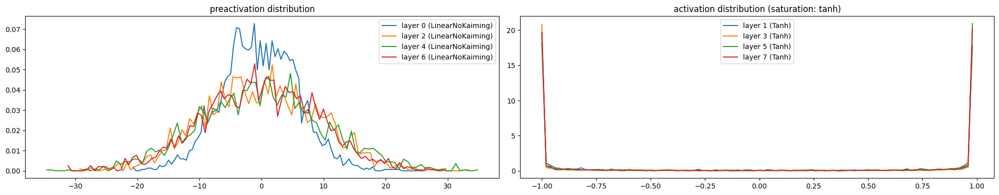

In [20]:
plot_preactivations_and_activations(layers, LinearNoKaiming, Tanh, activation_type='tanh')

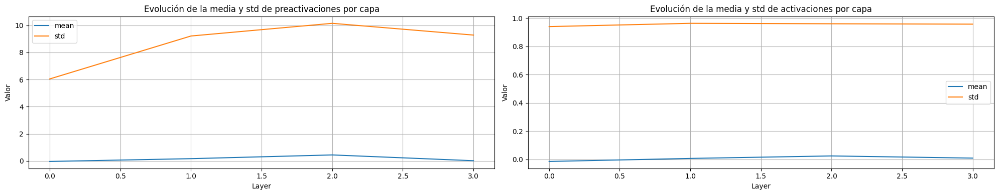

In [21]:
plot_activation_evolution(layers, LinearNoKaiming, Tanh)


gradients
layer 1 (      Tanh): mean +0.0011, std 0.0300
layer 3 (      Tanh): mean -0.0001, std 0.0130
layer 5 (      Tanh): mean -0.0001, std 0.0059
layer 7 (      Tanh): mean +0.0000, std 0.0026

weights gradients
weight   (27, 10) | mean +0.0005 | std 0.1728 | grad:data ratio 0.1669
weight  (30, 100) | mean +0.0012 | std 0.0594 | grad:data ratio 0.0578
weight (100, 100) | mean +0.0001 | std 0.0168 | grad:data ratio 0.0168
weight (100, 100) | mean +0.0000 | std 0.0070 | grad:data ratio 0.0069
weight (100, 100) | mean +0.0000 | std 0.0032 | grad:data ratio 0.0032
weight  (100, 27) | mean +0.0000 | std 0.0320 | grad:data ratio 0.3701


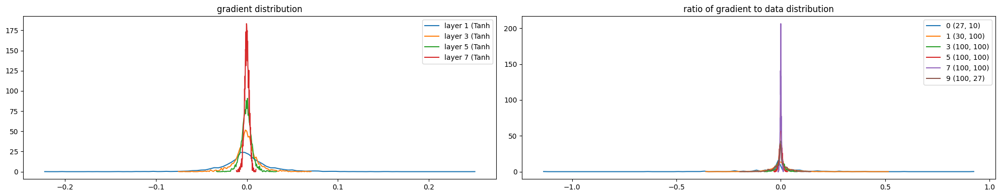

In [22]:
plot_gradient_distribution(layers, Tanh, parameters)

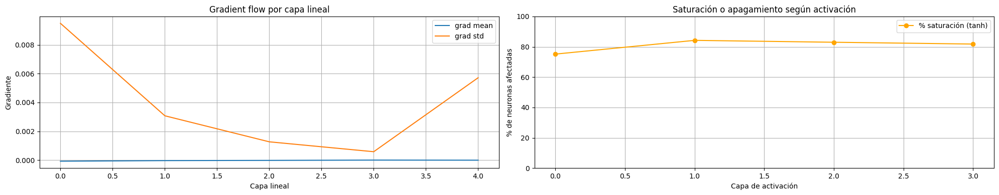

In [23]:
import warnings
warnings.filterwarnings('ignore')
plot_generalized_gradient_flow_and_activation_stats(
    layers, LinearNoKaiming, Tanh, activation_type='tanh'
)


update/data


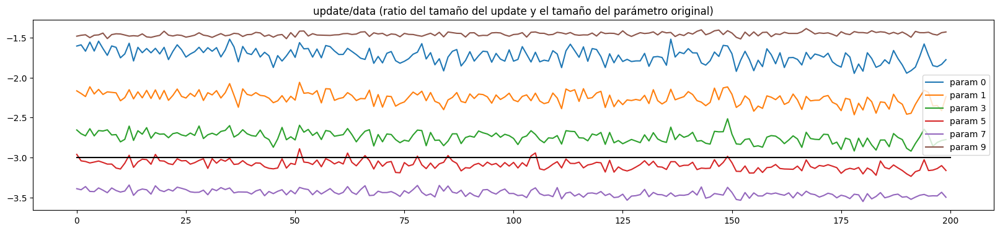

In [24]:
plot_update_data(parameters, ud)


Distribución de pesos por capa (excluyendo última capa lineal):
Layer 0: mean = +0.0218, std = 1.0279
Layer 1: mean = -0.0053, std = 0.9971
Layer 2: mean = +0.0044, std = 1.0073
Layer 3: mean = +0.0210, std = 1.0030


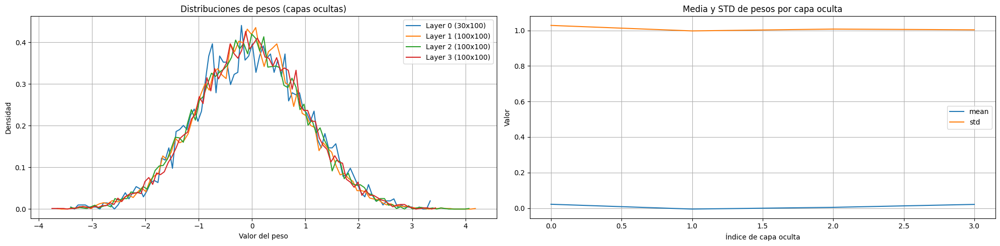

In [25]:
plot_weight_distributions_summary(layers, LinearNoKaiming)


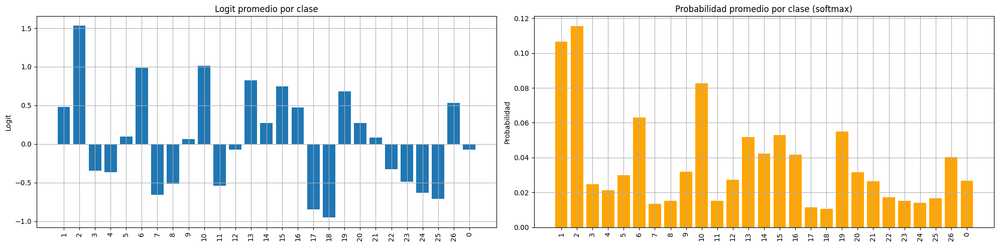

In [26]:
# Supongamos que ya tenés un batch
Xb = Xtr[0:32]

# Hacés el forward pass
with torch.no_grad():
    emb = C[Xb]
    x = emb.view(emb.shape[0], -1)
    for layer in layers:
        x = layer(x)  # logits

# Ahora visualizás por clase
plot_logits_and_probs_by_class(x, itos=itos)


🔥 **ReLU: el problema del descontrol**

**ReLU(x) = max(0, x)**

* Cuando los pesos están **mal inicializados (no con He/Kaiming)**, los valores que entran a la ReLU (las preactivaciones) pueden crecer mucho.
* ReLU **no tiene techo** → si la entrada es grande, la salida es grande.
* Entonces:

  * Las activaciones **crecen capa a capa** (lo ves en tu `mean` y `std` que se disparan).
  * Como no hay límite, después de pocas capas tenés números tipo `700`, `1000`... y eso vuelve loco a la red.
* Además, si las preactivaciones crecen mucho, **la mitad de las neuronas se apagan** (saturan en 0 porque reciben cosas negativas), y te empiezan a aparecer **neuronas muertas**, pero al mismo tiempo las otras tienen valores gigantes → **todo es inestable**.
* El gradiente **explota o muere según si la neurona se activó**.

🔁 **Resultado: explosión rápida, entrenamiento roto.**

---

🌊 **Tanh: el regulador natural**

**Tanh(x) ∈ \[-1, 1]**, suave y con saturación

* Aunque tenga el problema de saturarse (como lo ves en el 80% de activaciones con `|x| > 0.97`), la tanh **frena el crecimiento**.
* Al estar acotada, **las activaciones no pueden explotar**, entonces los valores no se descontrolan.
* Esto hace que el **flujo de forward y backward sea más estable**, aunque puede morir lentamente (vanishing gradients).

🔁 **Resultado: aguanta más pasos, más robusto en redes crudas.**

---

💡 Conclusión conceptual

* ReLU **necesita** inicialización inteligente (`He`), y muchas veces también normalización (BatchNorm, LayerNorm) para que su comportamiento sea estable.
* Tanh, aunque no sea óptimo y tenga el problema del "vanishing gradient", **es naturalmente más contenida**, y en redes profundas sin normalización, puede ser **más segura**.


#### relu + init (no gain)

In [27]:
n_embd = 10 # the dimensionality of the character embedding vectors
n_hidden = 100 # the number of neurons in the hidden layer of the MLP
g = torch.Generator().manual_seed(2147483647) # for reproducibility

C = torch.randn((vocab_size, n_embd),            generator=g)
layers = [
  Linear(n_embd * block_size, n_hidden), ReLU(),
  Linear(           n_hidden, n_hidden), ReLU(),
  Linear(           n_hidden, n_hidden), ReLU(),
  Linear(           n_hidden, n_hidden), ReLU(),
  Linear(           n_hidden, vocab_size),
]

with torch.no_grad():
  layers[-1].weight *= 0.1 # ultima capa para iniciar bien los logits
  
  for layer in layers[:-1]:
    if isinstance(layer, Linear):
      layer.weight *= 1 #5/3 ACA NO APLICAMOS GAIN

parameters = [C] + [p for layer in layers for p in layer.parameters()]
print(sum(p.nelement() for p in parameters)) # number of parameters in total
for p in parameters:
  p.requires_grad = True

36397


In [28]:
max_steps = 100
lossi, ud = train_model(Xtr, Ytr, C, layers, parameters, g, max_steps=max_steps)

      0/    100: 3.2915


preactivations
layer 0 (    Linear): mean -0.0415, std 1.0040
layer 2 (    Linear): mean +0.0470, std 0.7156
layer 4 (    Linear): mean +0.0695, std 0.6309
layer 6 (    Linear): mean +0.1810, std 0.6016

activations
layer 1 (      ReLU): mean +0.3773, std 0.5726, saturated: 52.5625%
layer 3 (      ReLU): mean +0.2989, std 0.4644, saturated: 49.3437%
layer 5 (      ReLU): mean +0.2729, std 0.4325, saturated: 48.0312%
layer 7 (      ReLU): mean +0.3308, std 0.4430, saturated: 41.9688%


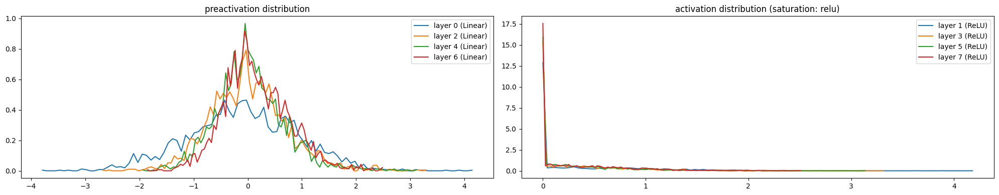

In [29]:
plot_preactivations_and_activations(layers, Linear, ReLU, activation_type='relu')

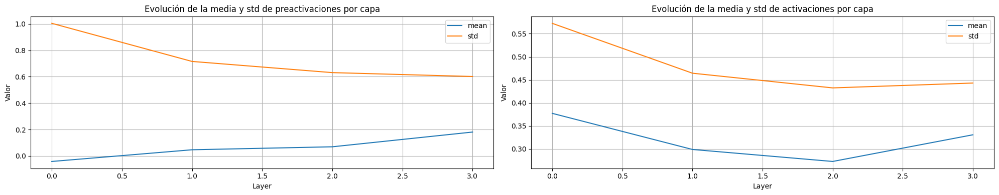

In [30]:
plot_activation_evolution(layers, Linear, ReLU)


gradients
layer 1 (      ReLU): mean -0.0000, std 0.0013
layer 3 (      ReLU): mean -0.0000, std 0.0014
layer 5 (      ReLU): mean -0.0000, std 0.0013
layer 7 (      ReLU): mean +0.0000, std 0.0010

weights gradients
weight   (27, 10) | mean +0.0002 | std 0.0036 | grad:data ratio 0.0036
weight  (30, 100) | mean +0.0000 | std 0.0049 | grad:data ratio 0.0258
weight (100, 100) | mean -0.0001 | std 0.0036 | grad:data ratio 0.0360
weight (100, 100) | mean -0.0000 | std 0.0024 | grad:data ratio 0.0236
weight (100, 100) | mean -0.0001 | std 0.0015 | grad:data ratio 0.0153
weight  (100, 27) | mean +0.0000 | std 0.0128 | grad:data ratio 0.4709


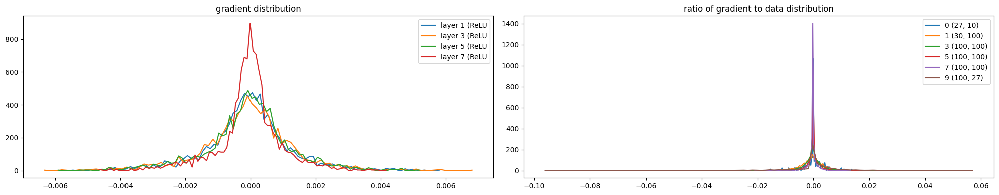

In [31]:
plot_gradient_distribution(layers, ReLU, parameters)

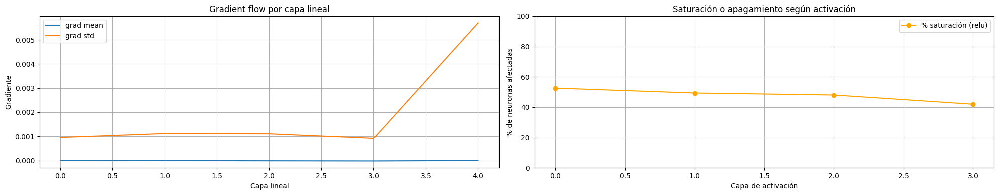

In [32]:
import warnings
warnings.filterwarnings('ignore')
plot_generalized_gradient_flow_and_activation_stats(
    layers, Linear, ReLU, activation_type='relu'
)


update/data


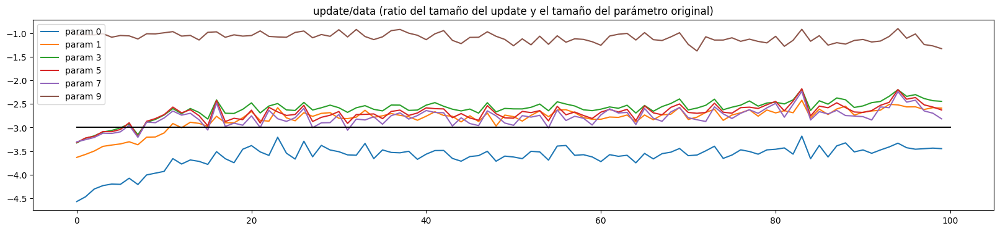

In [33]:
plot_update_data(parameters, ud)


Distribución de pesos por capa (excluyendo última capa lineal):
Layer 0: mean = +0.0028, std = 0.1879
Layer 1: mean = +0.0009, std = 0.1001
Layer 2: mean = +0.0019, std = 0.1012
Layer 3: mean = +0.0034, std = 0.1007


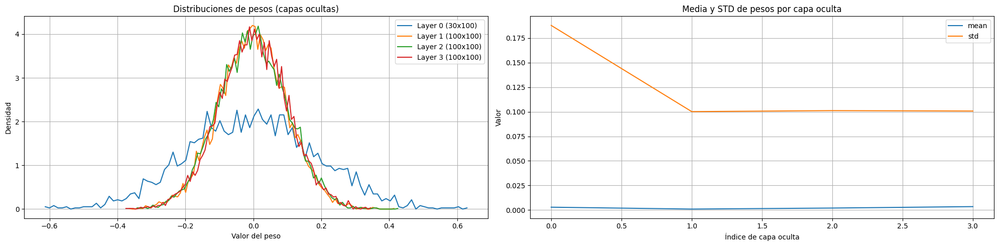

In [34]:
plot_weight_distributions_summary(layers, Linear)


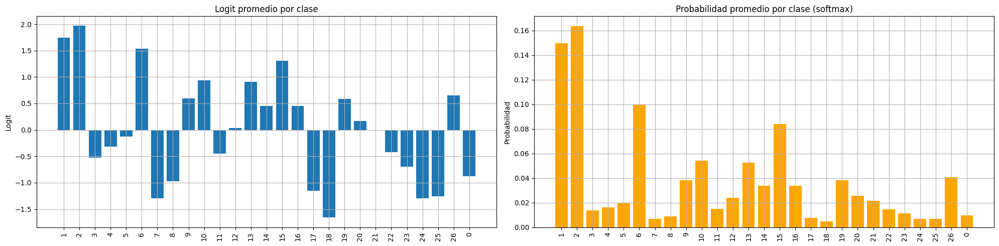

In [35]:
# Supongamos que ya tenés un batch
Xb = Xtr[0:32]

# Hacés el forward pass
with torch.no_grad():
    emb = C[Xb]
    x = emb.view(emb.shape[0], -1)
    for layer in layers:
        x = layer(x)  # logits

# Ahora visualizás por clase
plot_logits_and_probs_by_class(x, itos=itos)


#### relu + init + gain

In [36]:
n_embd = 10 # the dimensionality of the character embedding vectors
n_hidden = 100 # the number of neurons in the hidden layer of the MLP
g = torch.Generator().manual_seed(2147483647) # for reproducibility

C = torch.randn((vocab_size, n_embd),            generator=g)
layers = [
  Linear(n_embd * block_size, n_hidden), ReLU(),
  Linear(           n_hidden, n_hidden), ReLU(),
  Linear(           n_hidden, n_hidden), ReLU(),
  Linear(           n_hidden, n_hidden), ReLU(),
  Linear(           n_hidden, vocab_size),
]

with torch.no_grad():
  layers[-1].weight *= 0.1 # ultima capa para iniciar bien los logits
  
  for layer in layers[:-1]:
    if isinstance(layer, Linear):
      layer.weight *= math.sqrt(2.0) # math.sqrt(2.0) para relu

parameters = [C] + [p for layer in layers for p in layer.parameters()]
print(sum(p.nelement() for p in parameters)) # number of parameters in total
for p in parameters:
  p.requires_grad = True

36397


In [37]:
max_steps = 100
lossi, ud = train_model(Xtr, Ytr, C, layers, parameters, g, max_steps=max_steps)

      0/    100: 3.2821


preactivations
layer 0 (    Linear): mean -0.0654, std 1.4108
layer 2 (    Linear): mean -0.0445, std 1.3182
layer 4 (    Linear): mean -0.1614, std 1.2564
layer 6 (    Linear): mean +0.0232, std 1.0456

activations
layer 1 (      ReLU): mean +0.5285, std 0.7981, saturated: 52.5000%
layer 3 (      ReLU): mean +0.4927, std 0.7873, saturated: 52.0312%
layer 5 (      ReLU): mean +0.4068, std 0.7081, saturated: 56.9375%
layer 7 (      ReLU): mean +0.4160, std 0.6249, saturated: 49.2813%


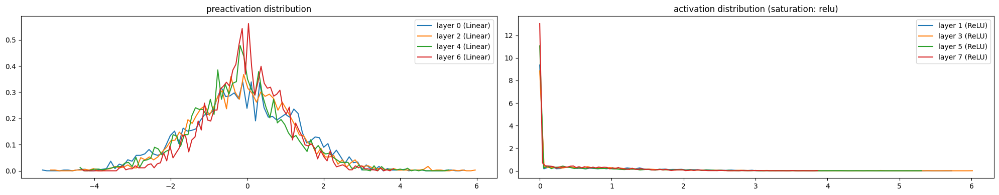

In [38]:
plot_preactivations_and_activations(layers, Linear, ReLU, activation_type='relu')

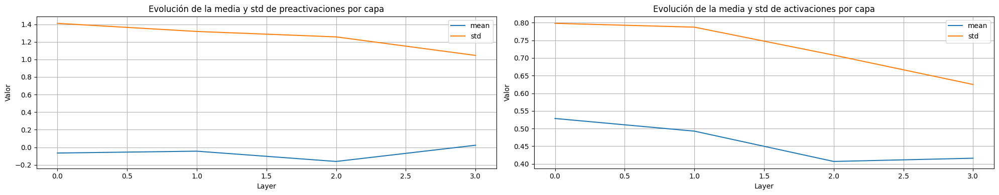

In [39]:
plot_activation_evolution(layers, Linear, ReLU)


gradients
layer 1 (      ReLU): mean -0.0000, std 0.0020
layer 3 (      ReLU): mean +0.0000, std 0.0018
layer 5 (      ReLU): mean +0.0000, std 0.0016
layer 7 (      ReLU): mean -0.0000, std 0.0011

weights gradients
weight   (27, 10) | mean +0.0002 | std 0.0082 | grad:data ratio 0.0082
weight  (30, 100) | mean -0.0000 | std 0.0077 | grad:data ratio 0.0291
weight (100, 100) | mean +0.0000 | std 0.0065 | grad:data ratio 0.0464
weight (100, 100) | mean +0.0002 | std 0.0052 | grad:data ratio 0.0365
weight (100, 100) | mean +0.0001 | std 0.0035 | grad:data ratio 0.0243
weight  (100, 27) | mean +0.0000 | std 0.0200 | grad:data ratio 0.6311


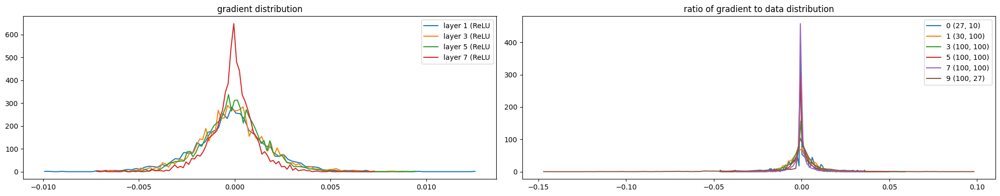

In [40]:
plot_gradient_distribution(layers, ReLU, parameters)

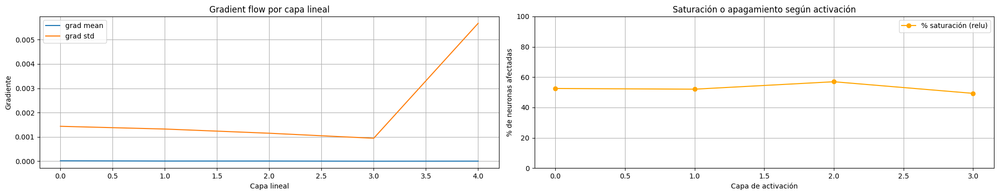

In [41]:
import warnings
warnings.filterwarnings('ignore')
plot_generalized_gradient_flow_and_activation_stats(
    layers, Linear, ReLU, activation_type='relu'
)


update/data


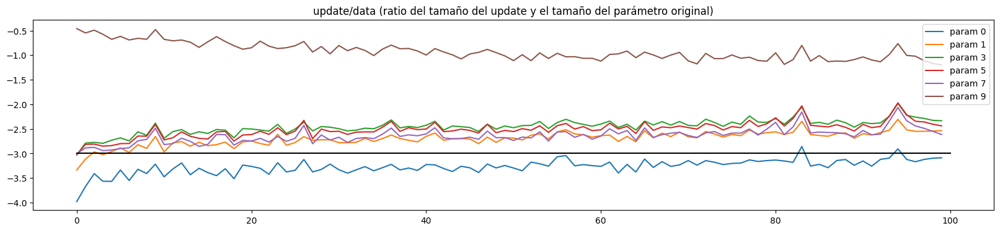

In [42]:
plot_update_data(parameters, ud)


Distribución de pesos por capa (excluyendo última capa lineal):
Layer 0: mean = +0.0049, std = 0.2648
Layer 1: mean = -0.0009, std = 0.1411
Layer 2: mean = +0.0003, std = 0.1426
Layer 3: mean = +0.0026, std = 0.1420


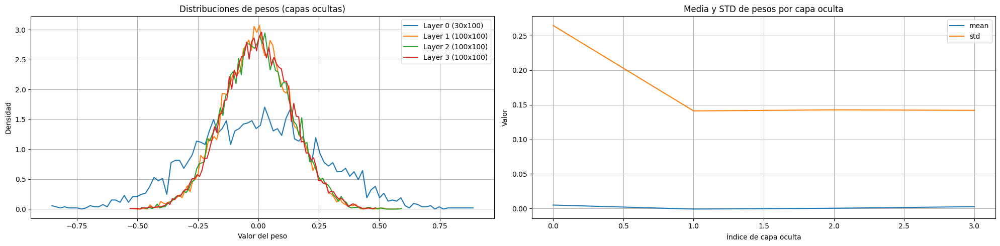

In [43]:
plot_weight_distributions_summary(layers, Linear)


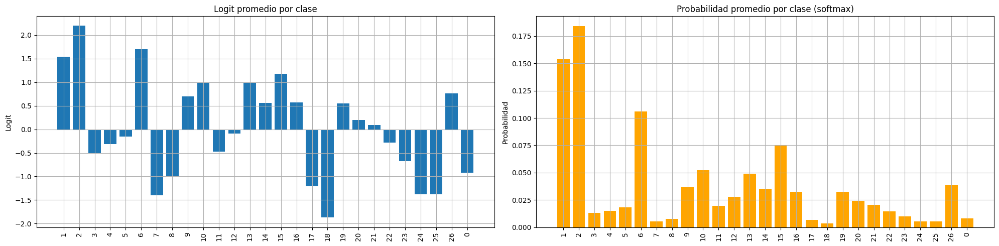

In [44]:
# Supongamos que ya tenés un batch
Xb = Xtr[0:32]

# Hacés el forward pass
with torch.no_grad():
    emb = C[Xb]
    x = emb.view(emb.shape[0], -1)
    for layer in layers:
        x = layer(x)  # logits

# Ahora visualizás por clase
plot_logits_and_probs_by_class(x, itos=itos)


#### relu + BatchNorm

In [45]:
n_embd = 10 # the dimensionality of the character embedding vectors
n_hidden = 100 # the number of neurons in the hidden layer of the MLP
g = torch.Generator().manual_seed(2147483647) # for reproducibility

C = torch.randn((vocab_size, n_embd),            generator=g)
layers = [
  LinearNoKaiming(n_embd * block_size, n_hidden), BatchNorm1d(n_hidden), ReLU(),
  LinearNoKaiming(           n_hidden, n_hidden), BatchNorm1d(n_hidden), ReLU(),
  LinearNoKaiming(           n_hidden, n_hidden), BatchNorm1d(n_hidden), ReLU(),
  LinearNoKaiming(           n_hidden, n_hidden), BatchNorm1d(n_hidden), ReLU(),
  LinearNoKaiming(           n_hidden, vocab_size),
]

with torch.no_grad():
  layers[-1].weight *= 0.1 # ultima capa para iniciar bien los logits
  
  for layer in layers[:-1]:
    if isinstance(layer, LinearNoKaiming):
      layer.weight *= 1 #5/3 ACA NO APLICAMOS GAIN

parameters = [C] + [p for layer in layers for p in layer.parameters()]
print(sum(p.nelement() for p in parameters)) # number of parameters in total
for p in parameters:
  p.requires_grad = True

37197


In [46]:
max_steps = 100
lossi, ud = train_model(Xtr, Ytr, C, layers, parameters, g, max_steps=max_steps)

      0/    100: 3.2970


preactivations
layer 0 (LinearNoKaiming): mean -0.2586, std 5.4935
layer 3 (LinearNoKaiming): mean -0.1984, std 6.7498
layer 6 (LinearNoKaiming): mean +0.1787, std 6.8869
layer 9 (LinearNoKaiming): mean +0.7403, std 6.8251

activations
layer 2 (      ReLU): mean +0.3986, std 0.5730, saturated: 49.5937%
layer 5 (      ReLU): mean +0.3935, std 0.5792, saturated: 49.2813%
layer 8 (      ReLU): mean +0.3861, std 0.5682, saturated: 49.6563%
layer 11 (      ReLU): mean +0.3846, std 0.5713, saturated: 50.1875%


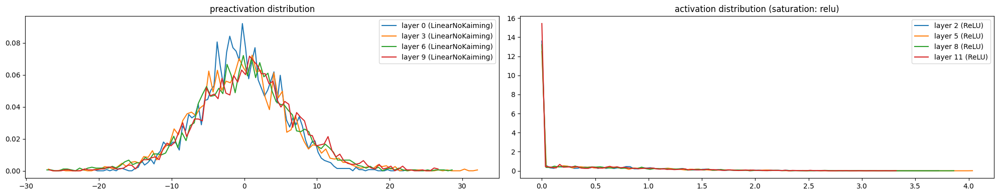

In [47]:
plot_preactivations_and_activations(layers, LinearNoKaiming, ReLU, activation_type='relu')

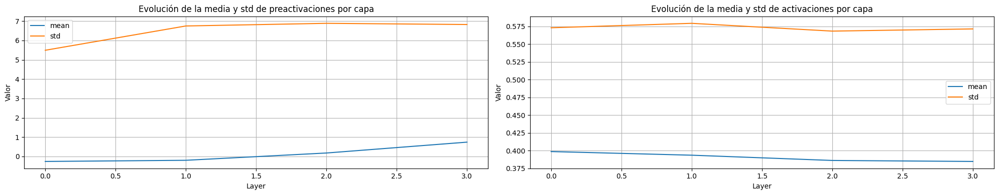

In [48]:
plot_activation_evolution(layers, LinearNoKaiming, ReLU)


gradients
layer 2 (      ReLU): mean -0.0000, std 0.0065
layer 5 (      ReLU): mean -0.0000, std 0.0049
layer 8 (      ReLU): mean +0.0000, std 0.0038
layer 11 (      ReLU): mean +0.0000, std 0.0030

weights gradients
weight   (27, 10) | mean +0.0000 | std 0.0162 | grad:data ratio 0.0162
weight  (30, 100) | mean -0.0000 | std 0.0045 | grad:data ratio 0.0044
weight (100, 100) | mean +0.0000 | std 0.0020 | grad:data ratio 0.0020
weight (100, 100) | mean -0.0000 | std 0.0016 | grad:data ratio 0.0015
weight (100, 100) | mean -0.0000 | std 0.0012 | grad:data ratio 0.0012
weight  (100, 27) | mean +0.0000 | std 0.0199 | grad:data ratio 0.1976


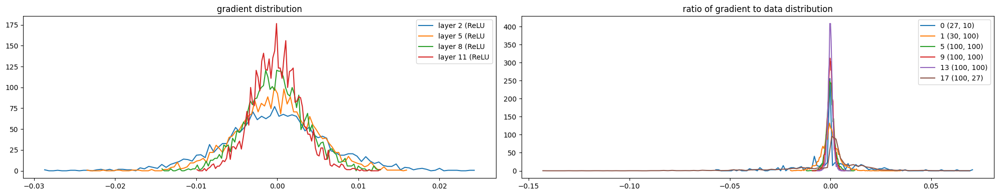

In [49]:
plot_gradient_distribution(layers, ReLU, parameters)

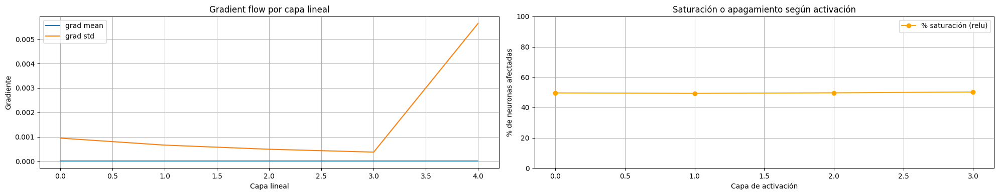

In [50]:
import warnings
warnings.filterwarnings('ignore')
plot_generalized_gradient_flow_and_activation_stats(
    layers, LinearNoKaiming, ReLU, activation_type='relu'
)


update/data


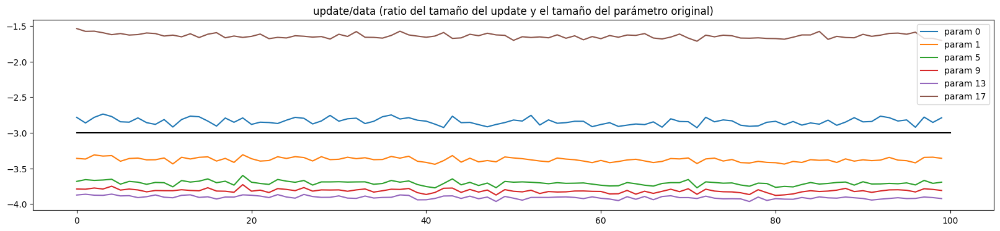

In [51]:
plot_update_data(parameters, ud)


Distribución de pesos por capa (excluyendo última capa lineal):
Layer 0: mean = +0.0217, std = 1.0249
Layer 1: mean = -0.0055, std = 0.9967
Layer 2: mean = +0.0043, std = 1.0073
Layer 3: mean = +0.0207, std = 1.0031


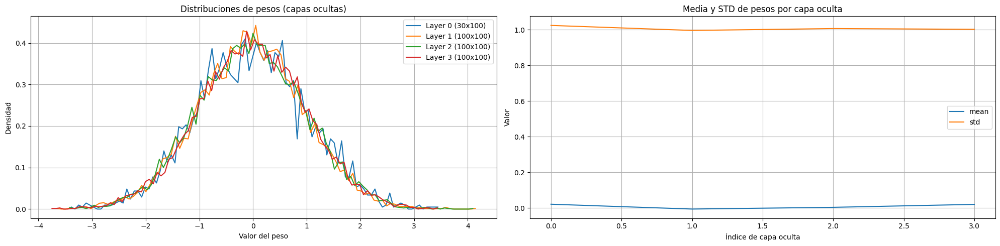

In [52]:
plot_weight_distributions_summary(layers, LinearNoKaiming)


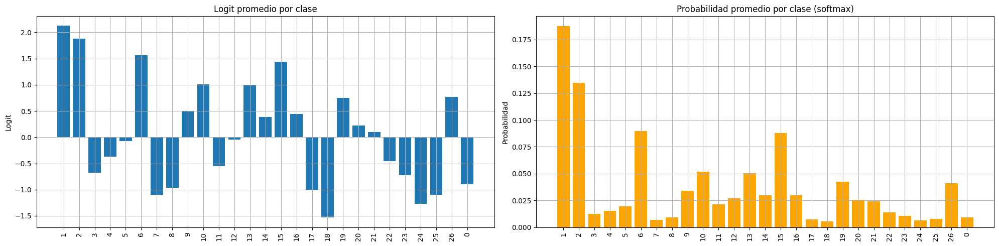

In [53]:
# Supongamos que ya tenés un batch
Xb = Xtr[0:32]

# Hacés el forward pass
with torch.no_grad():
    emb = C[Xb]
    x = emb.view(emb.shape[0], -1)
    for layer in layers:
        x = layer(x)  # logits

# Ahora visualizás por clase
plot_logits_and_probs_by_class(x, itos=itos)


#### relu + init+gain + BatchNorm

In [54]:
n_embd = 10 # the dimensionality of the character embedding vectors
n_hidden = 100 # the number of neurons in the hidden layer of the MLP
g = torch.Generator().manual_seed(2147483647) # for reproducibility

C = torch.randn((vocab_size, n_embd),            generator=g)
layers = [
  Linear(n_embd * block_size, n_hidden), BatchNorm1d(n_hidden), ReLU(),
  Linear(           n_hidden, n_hidden), BatchNorm1d(n_hidden),ReLU(),
  Linear(           n_hidden, n_hidden), BatchNorm1d(n_hidden),ReLU(),
  Linear(           n_hidden, n_hidden), BatchNorm1d(n_hidden),ReLU(),
  Linear(           n_hidden, vocab_size),
]

with torch.no_grad():
  layers[-1].weight *= 0.1 # ultima capa para iniciar bien los logits
  
  for layer in layers[:-1]:
    if isinstance(layer, Linear):
      layer.weight *= math.sqrt(2.0) # math.sqrt(2.0) para relu

parameters = [C] + [p for layer in layers for p in layer.parameters()]
print(sum(p.nelement() for p in parameters)) # number of parameters in total
for p in parameters:
  p.requires_grad = True

37197


In [55]:
max_steps = 1000
lossi, ud = train_model(Xtr, Ytr, C, layers, parameters, g, max_steps=max_steps)

      0/   1000: 3.2708


preactivations
layer 0 (    Linear): mean -0.0890, std 1.4379
layer 3 (    Linear): mean -0.0692, std 1.1000
layer 6 (    Linear): mean -0.0283, std 1.0837
layer 9 (    Linear): mean +0.0005, std 1.0647

activations
layer 2 (      ReLU): mean +0.4054, std 0.5870, saturated: 50.8750%
layer 5 (      ReLU): mean +0.3980, std 0.5832, saturated: 50.5000%
layer 8 (      ReLU): mean +0.3969, std 0.5859, saturated: 51.2812%
layer 11 (      ReLU): mean +0.3910, std 0.5887, saturated: 51.9375%


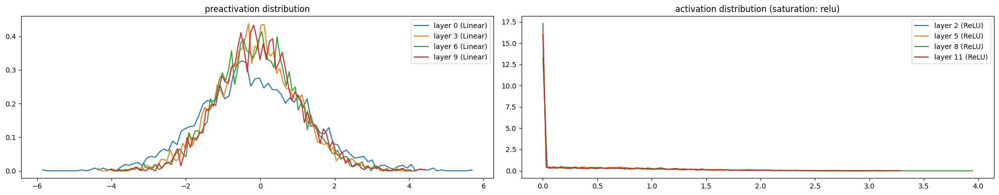

In [56]:
plot_preactivations_and_activations(layers, Linear, ReLU, activation_type='relu')

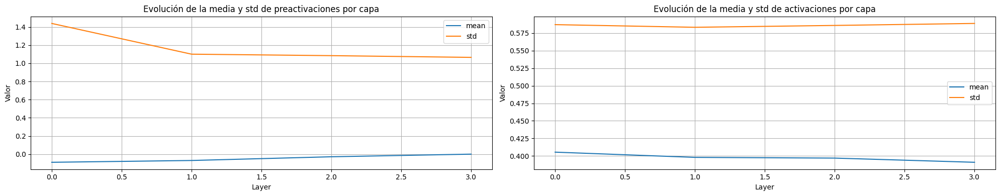

In [57]:
plot_activation_evolution(layers, Linear, ReLU)


gradients
layer 2 (      ReLU): mean -0.0000, std 0.0041
layer 5 (      ReLU): mean +0.0000, std 0.0036
layer 8 (      ReLU): mean +0.0000, std 0.0031
layer 11 (      ReLU): mean +0.0000, std 0.0025

weights gradients
weight   (27, 10) | mean -0.0000 | std 0.0118 | grad:data ratio 0.0118
weight  (30, 100) | mean +0.0001 | std 0.0116 | grad:data ratio 0.0433
weight (100, 100) | mean -0.0002 | std 0.0093 | grad:data ratio 0.0644
weight (100, 100) | mean -0.0001 | std 0.0079 | grad:data ratio 0.0550
weight (100, 100) | mean +0.0001 | std 0.0062 | grad:data ratio 0.0433
weight  (100, 27) | mean +0.0000 | std 0.0240 | grad:data ratio 0.3382


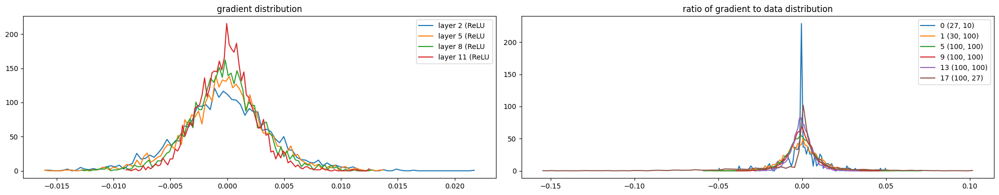

In [58]:
plot_gradient_distribution(layers, ReLU, parameters)

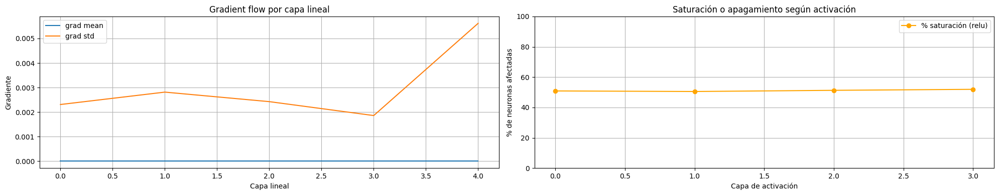

In [59]:
import warnings
warnings.filterwarnings('ignore')
plot_generalized_gradient_flow_and_activation_stats(
    layers, Linear, ReLU, activation_type='relu'
)


update/data


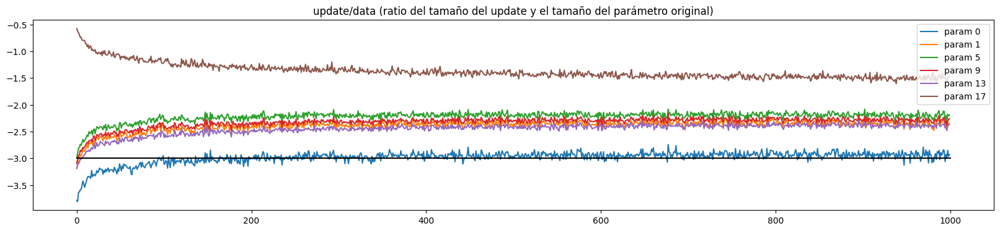

In [60]:
plot_update_data(parameters, ud)


Distribución de pesos por capa (excluyendo última capa lineal):
Layer 0: mean = +0.0057, std = 0.2670
Layer 1: mean = -0.0020, std = 0.1437
Layer 2: mean = -0.0008, std = 0.1442
Layer 3: mean = +0.0000, std = 0.1429


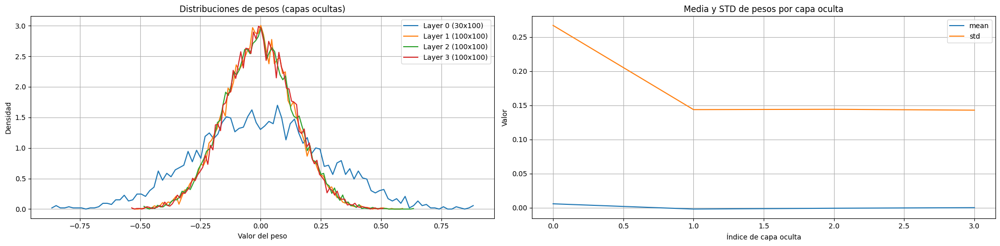

In [61]:
plot_weight_distributions_summary(layers, Linear)


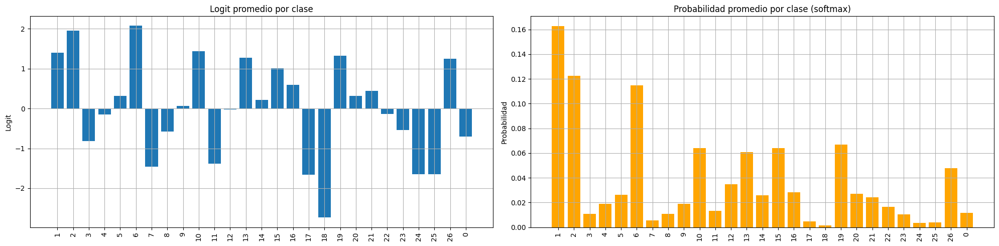

In [62]:
# Supongamos que ya tenés un batch
Xb = Xtr[0:32]

# Hacés el forward pass
with torch.no_grad():
    emb = C[Xb]
    x = emb.view(emb.shape[0], -1)
    for layer in layers:
        x = layer(x)  # logits

# Ahora visualizás por clase
plot_logits_and_probs_by_class(x, itos=itos)


#### tanh + init+gain + BatchNorm

In [63]:
n_embd = 10 # the dimensionality of the character embedding vectors
n_hidden = 100 # the number of neurons in the hidden layer of the MLP
g = torch.Generator().manual_seed(2147483647) # for reproducibility

C = torch.randn((vocab_size, n_embd),            generator=g)
layers = [
  Linear(n_embd * block_size, n_hidden), BatchNorm1d(n_hidden), Tanh(),
  Linear(           n_hidden, n_hidden), BatchNorm1d(n_hidden),Tanh(),
  Linear(           n_hidden, n_hidden), BatchNorm1d(n_hidden),Tanh(),
  Linear(           n_hidden, n_hidden), BatchNorm1d(n_hidden),Tanh(),
  Linear(           n_hidden, vocab_size),
]

with torch.no_grad():
  layers[-1].weight *= 0.1 # ultima capa para iniciar bien los logits
  
  for layer in layers[:-1]:
    if isinstance(layer, Linear):
      layer.weight *= 5/3 # 5/3 para tanh

parameters = [C] + [p for layer in layers for p in layer.parameters()]
print(sum(p.nelement() for p in parameters)) # number of parameters in total
for p in parameters:
  p.requires_grad = True

37197


In [64]:
max_steps = 1000
lossi, ud = train_model(Xtr, Ytr, C, layers, parameters, g, max_steps=max_steps)

      0/   1000: 3.2739


preactivations
layer 0 (    Linear): mean -0.1237, std 1.6924
layer 3 (    Linear): mean +0.0060, std 1.0729
layer 6 (    Linear): mean +0.0129, std 1.1542
layer 9 (    Linear): mean -0.0033, std 1.1023

activations
layer 2 (      Tanh): mean -0.0066, std 0.6288, saturated: 2.7500%
layer 5 (      Tanh): mean -0.0049, std 0.6386, saturated: 2.8750%
layer 8 (      Tanh): mean -0.0043, std 0.6397, saturated: 3.0000%
layer 11 (      Tanh): mean -0.0016, std 0.6420, saturated: 2.5313%


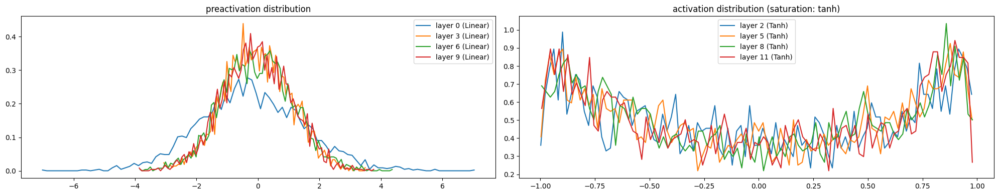

In [65]:
plot_preactivations_and_activations(layers, Linear, Tanh, activation_type='tanh')

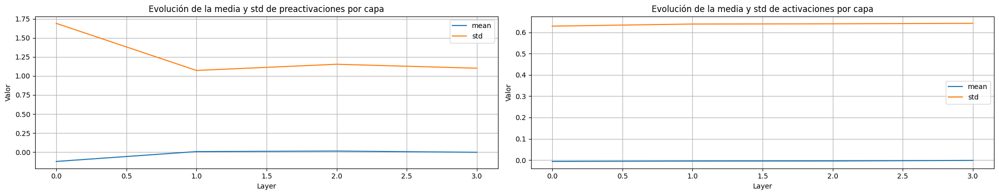

In [66]:
plot_activation_evolution(layers, Linear, Tanh)


gradients
layer 2 (      Tanh): mean +0.0000, std 0.0043
layer 5 (      Tanh): mean +0.0000, std 0.0036
layer 8 (      Tanh): mean +0.0000, std 0.0030
layer 11 (      Tanh): mean +0.0000, std 0.0024

weights gradients
weight   (27, 10) | mean +0.0000 | std 0.0117 | grad:data ratio 0.0117
weight  (30, 100) | mean +0.0002 | std 0.0103 | grad:data ratio 0.0328
weight (100, 100) | mean +0.0002 | std 0.0083 | grad:data ratio 0.0497
weight (100, 100) | mean +0.0001 | std 0.0067 | grad:data ratio 0.0396
weight (100, 100) | mean -0.0000 | std 0.0050 | grad:data ratio 0.0301
weight  (100, 27) | mean +0.0000 | std 0.0217 | grad:data ratio 0.3292


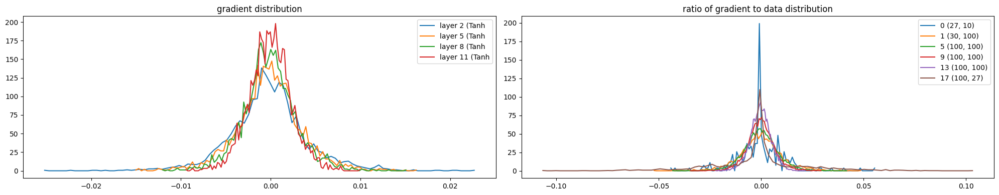

In [67]:
plot_gradient_distribution(layers, Tanh, parameters)

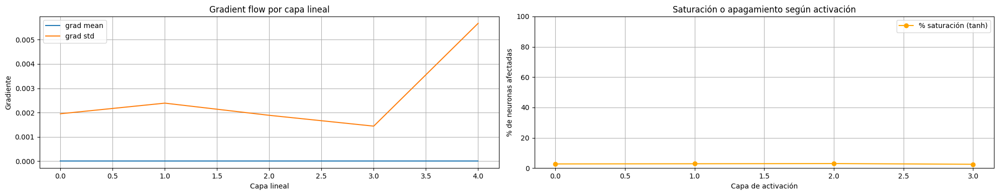

In [68]:
import warnings
warnings.filterwarnings('ignore')
plot_generalized_gradient_flow_and_activation_stats(
    layers, Linear, Tanh, activation_type='tanh'
)


update/data


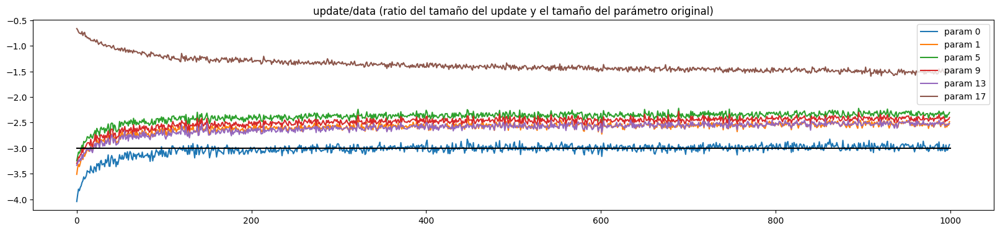

In [69]:
plot_update_data(parameters, ud)


Distribución de pesos por capa (excluyendo última capa lineal):
Layer 0: mean = +0.0070, std = 0.3130
Layer 1: mean = -0.0007, std = 0.1676
Layer 2: mean = +0.0005, std = 0.1688
Layer 3: mean = +0.0036, std = 0.1677


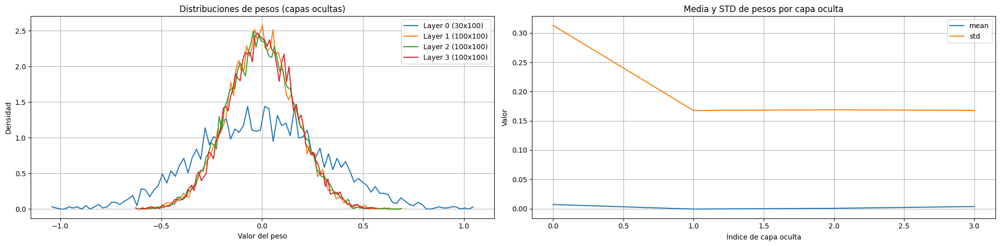

In [70]:
plot_weight_distributions_summary(layers, Linear)


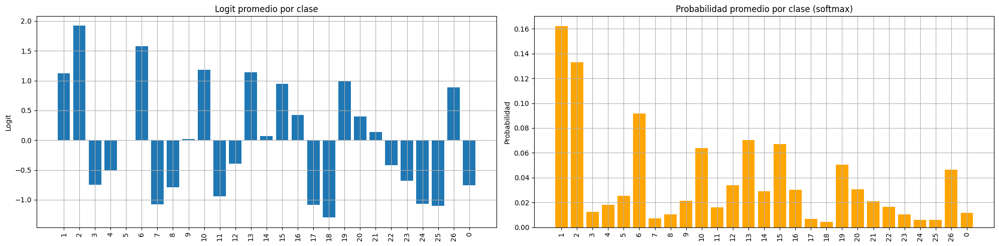

In [71]:
# Supongamos que ya tenés un batch
Xb = Xtr[0:32]

# Hacés el forward pass
with torch.no_grad():
    emb = C[Xb]
    x = emb.view(emb.shape[0], -1)
    for layer in layers:
        x = layer(x)  # logits

# Ahora visualizás por clase
plot_logits_and_probs_by_class(x, itos=itos)


#### relu + init+gain + LayerNorm

In [57]:
n_embd = 10 # the dimensionality of the character embedding vectors
n_hidden = 100 # the number of neurons in the hidden layer of the MLP
g = torch.Generator().manual_seed(2147483647) # for reproducibility

C = torch.randn((vocab_size, n_embd),            generator=g)
layers = [
  Linear(n_embd * block_size, n_hidden), LayerNorm1d(n_hidden), ReLU(),
  Linear(           n_hidden, n_hidden), LayerNorm1d(n_hidden),ReLU(),
  Linear(           n_hidden, n_hidden), LayerNorm1d(n_hidden),ReLU(),
  Linear(           n_hidden, n_hidden), LayerNorm1d(n_hidden),ReLU(),
  Linear(           n_hidden, vocab_size),
]

with torch.no_grad():
  layers[-1].weight *= 0.1 # ultima capa para iniciar bien los logits
  
  for layer in layers[:-1]:
    if isinstance(layer, Linear):
      layer.weight *= 2 # 2 para relu

parameters = [C] + [p for layer in layers for p in layer.parameters()]
print(sum(p.nelement() for p in parameters)) # number of parameters in total
for p in parameters:
  p.requires_grad = True

37197


In [58]:
max_steps = 100
lossi, ud = train_model(Xtr, Ytr, C, layers, parameters, g, max_steps=max_steps)

      0/    100: 3.2756


preactivations
layer 0 (    Linear): mean -0.1785, std 1.8962
layer 3 (    Linear): mean -0.0639, std 1.3978
layer 6 (    Linear): mean -0.1087, std 1.3729
layer 9 (    Linear): mean +0.1245, std 1.3047

activations
layer 2 (      ReLU): mean +0.3993, std 0.5885, saturated: 51.0938%
layer 5 (      ReLU): mean +0.3937, std 0.5951, saturated: 49.9687%
layer 8 (      ReLU): mean +0.3958, std 0.6007, saturated: 50.5000%
layer 11 (      ReLU): mean +0.3962, std 0.5998, saturated: 50.9687%


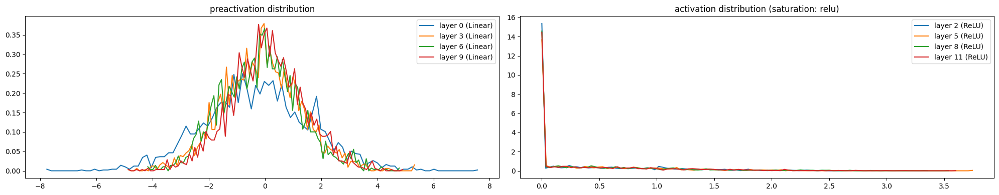

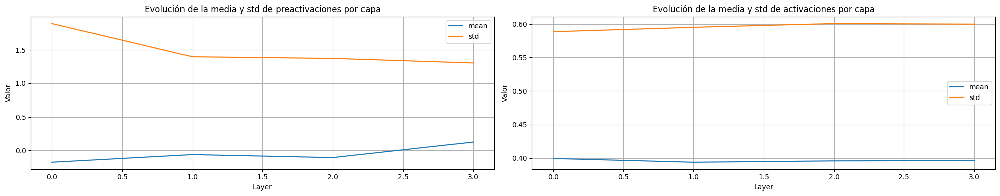


gradients
layer 2 (      ReLU): mean +0.0000, std 0.0017
layer 5 (      ReLU): mean +0.0000, std 0.0016
layer 8 (      ReLU): mean +0.0001, std 0.0014
layer 11 (      ReLU): mean +0.0001, std 0.0010

weights gradients
weight   (27, 10) | mean -0.0002 | std 0.0052 | grad:data ratio 0.0052
weight  (30, 100) | mean +0.0000 | std 0.0034 | grad:data ratio 0.0090
weight (100, 100) | mean -0.0000 | std 0.0031 | grad:data ratio 0.0158
weight (100, 100) | mean -0.0000 | std 0.0027 | grad:data ratio 0.0135
weight (100, 100) | mean -0.0000 | std 0.0025 | grad:data ratio 0.0124
weight  (100, 27) | mean -0.0000 | std 0.0240 | grad:data ratio 0.7520


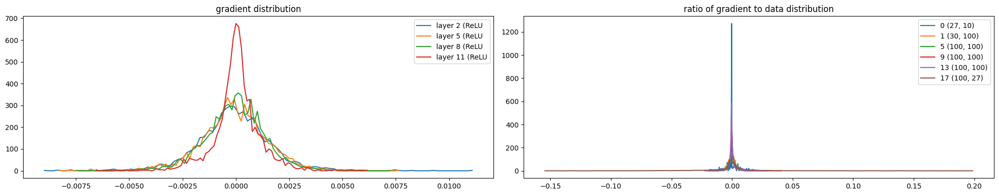

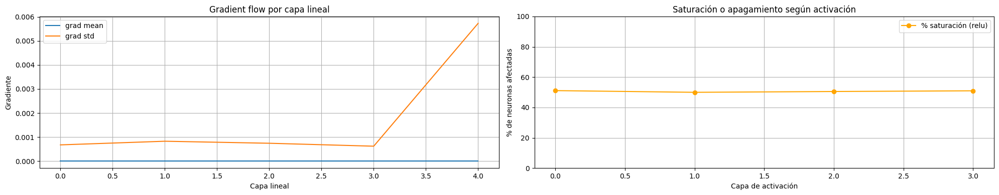


update/data

Distribución de pesos por capa (excluyendo última capa lineal):
Layer 0: mean = +0.0079, std = 0.3742
Layer 1: mean = -0.0011, std = 0.1994
Layer 2: mean = +0.0009, std = 0.2015
Layer 3: mean = +0.0042, std = 0.2006


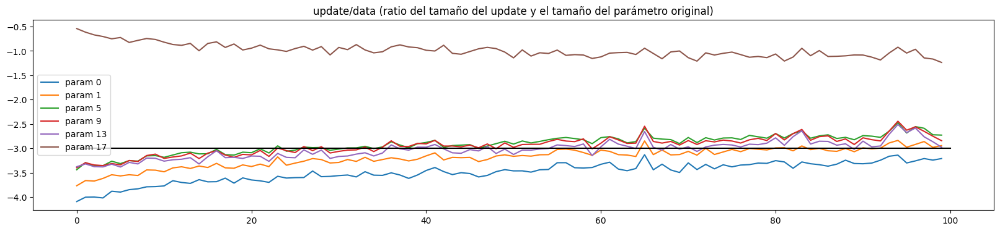

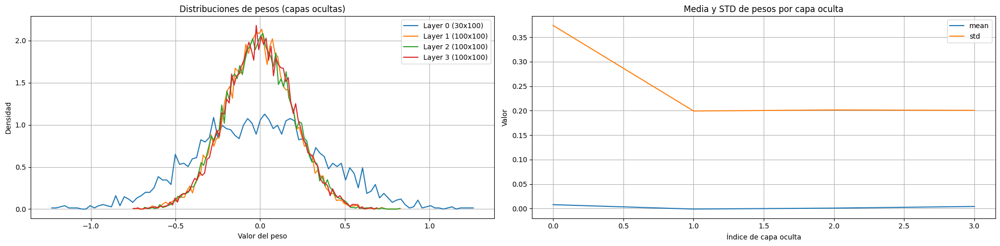

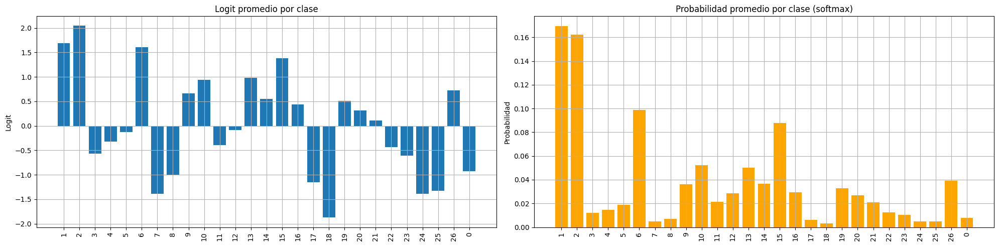

In [61]:
plot_training_monitoring(layers, Linear, ReLU, 'relu', parameters, ud, Xtr, C, itos)

### Exploding gradients

Suele suceder cuando:
- weights mayores a 1
- activation functions no limitadas, como la sigmoid (???)

Soluciones:
- Gradient Clipping: This technique involves setting a threshold value, and if the gradient exceeds this threshold, it is scaled down to keep it within a manageable range. This prevents any single update from being too large.
- Weight Initialization: Using a proper weight initialization strategy, such as Xavier or He initialization, can help prevent gradients from becoming too large at the start of training.
- Use of Batch Normalization: Batch normalization can help maintain the output of each layer within a certain range, reducing the risk of exploding gradients.
- Change of Network Architecture: Simplifying the network architecture or using architectures that are less prone to exploding gradients, such as those with skip connections like ResNet, can be effective.
- Proper Activation Functions: Using activation functions that are less likely to produce large gradients, such as the ReLU function and its variants, can help control the gradient's magnitude.



#### relu raw

In [ ]:
n_embd = 10 # the dimensionality of the character embedding vectors
n_hidden = 100 # the number of neurons in the hidden layer of the MLP
g = torch.Generator().manual_seed(2147483647) # for reproducibility

C = torch.randn((vocab_size, n_embd),            generator=g)
layers = [
  LinearNoKaiming(n_embd * block_size, n_hidden), ReLU(),
  LinearNoKaiming(           n_hidden, n_hidden), ReLU(),
  LinearNoKaiming(           n_hidden, n_hidden), ReLU(),
  LinearNoKaiming(           n_hidden, n_hidden), ReLU(),
  LinearNoKaiming(           n_hidden, vocab_size),
]

with torch.no_grad():
  layers[-1].weight *= 0.1 # ultima capa para iniciar bien los logits
  
  for layer in layers[:-1]:
    if isinstance(layer, LinearNoKaiming):
      layer.weight *= 1.5 # Los estiramos para causar la explosión      <-------- ACA para exploding todo

parameters = [C] + [p for layer in layers for p in layer.parameters()]
print(sum(p.nelement() for p in parameters)) # number of parameters in total
for p in parameters:
  p.requires_grad = True

36397


In [31]:
max_steps = 1
lossi, ud = train_model(Xtr, Ytr, C, layers, parameters, g, max_steps=max_steps)

      0/      1: 71164346368.0000


preactivations
layer 0 (LinearNoKaiming): mean +104.5544, std 671.4555
layer 2 (LinearNoKaiming): mean -12784.3525, std 47844.5586
layer 4 (LinearNoKaiming): mean -522255.1875, std 2181843.2500
layer 6 (LinearNoKaiming): mean -15596692.0000, std 73814352.0000

activations
layer 1 (      ReLU): mean +265.0238, std 462.3580, saturated: 41.5312%
layer 3 (      ReLU): mean +7945.6943, std 22464.7500, saturated: 64.6875%
layer 5 (      ReLU): mean +350269.1250, std 1027106.1250, saturated: 65.7188%
layer 7 (      ReLU): mean +13347918.0000, std 32199926.0000, saturated: 58.3438%


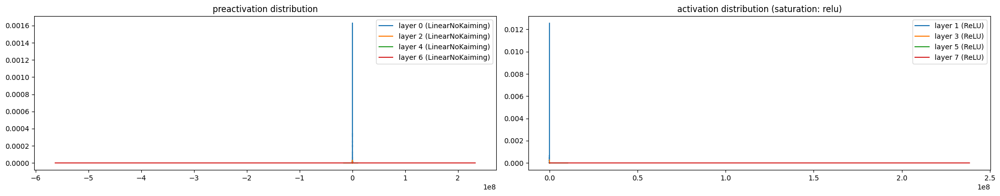

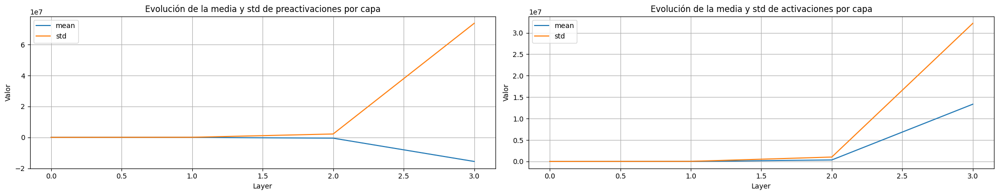


gradients
layer 1 (      ReLU): mean +80764.1484, std 111008.9766
layer 3 (      ReLU): mean +1865.9056, std 3592.9187
layer 5 (      ReLU): mean +66.5514, std 133.2082
layer 7 (      ReLU): mean +1.3773, std 2.8696

weights gradients
weight   (27, 10) | mean +903595.1250 | std 32923206.0000 | grad:data ratio 10.0000
weight  (30, 100) | mean -3154883.0000 | std 39885048.0000 | grad:data ratio 10.0000
weight (100, 100) | mean +6147075.5000 | std 20835326.0000 | grad:data ratio 10.0000
weight (100, 100) | mean +4330789.5000 | std 23397324.0000 | grad:data ratio 10.0000
weight (100, 100) | mean +6532754.5000 | std 37809148.0000 | grad:data ratio 10.0000
weight  (100, 27) | mean +0.0000 | std 5771536.5000 | grad:data ratio 10.0001


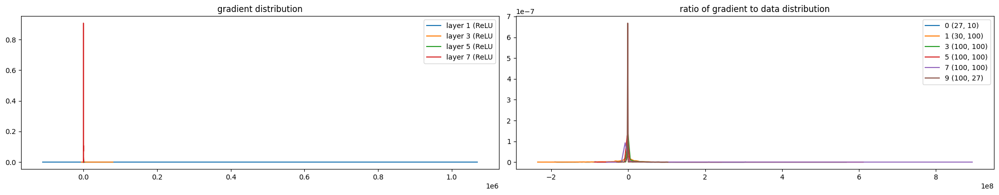

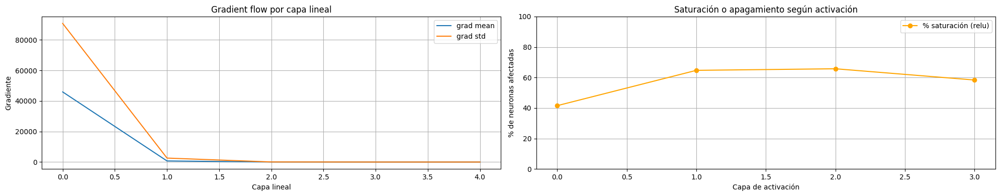


update/data

Distribución de pesos por capa (excluyendo última capa lineal):
Layer 0: mean = +315488.3438, std = 3988504.2500
Layer 1: mean = -614707.9375, std = 2083532.2500
Layer 2: mean = -433079.2812, std = 2339732.0000
Layer 3: mean = -653275.8750, std = 3780914.5000


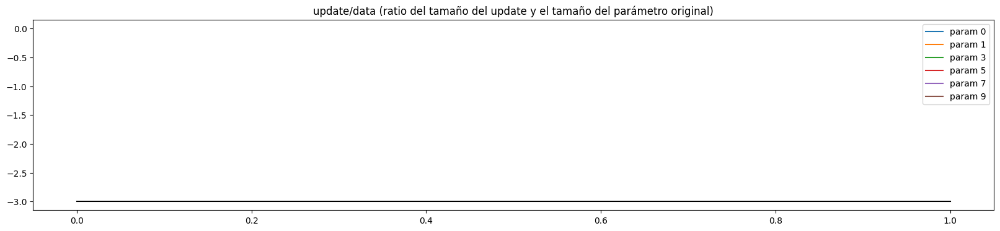

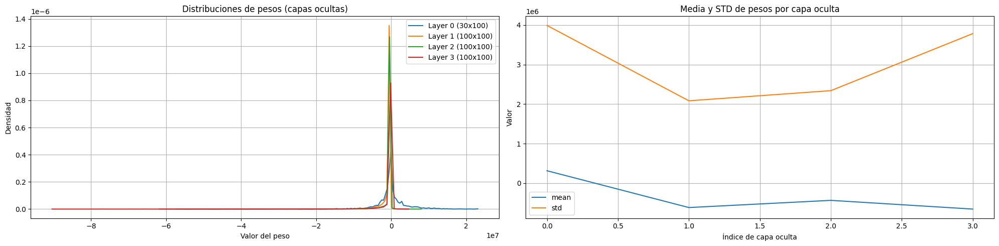

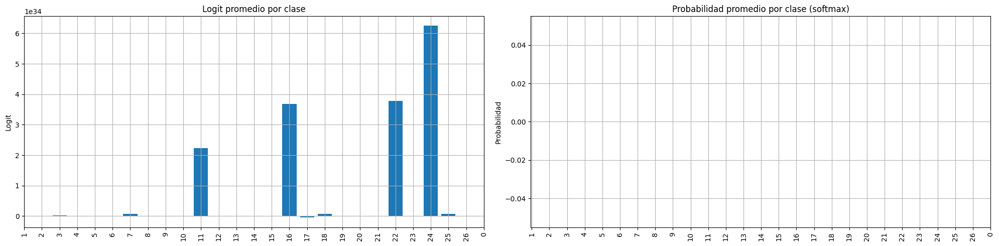

In [32]:
plot_training_monitoring(layers, LinearNoKaiming, ReLU, 'relu', parameters, ud, Xtr, C, itos)

Aca todo explota rapidamente, tanto activaciones como gradientes porque todo esta descontrolado


## Optimizers & schedulers

---
**Optimizers:**

Actualiza los parametros del modelo basado en los gradientes. Son los algoritmos que DETERMINAN EL GRADIENTE Y ACTUALIZAN.

- Gradient descent
- Stochastic Gradient descent
- SGD con momentum
- Adam (adaptive moment estimation)
- AdamW (weight decay): hace la regularizacion l2 (weight decay). Adam tambien aplica weight decay pero acoplado al update adaptativo. AdamW primero hace el update adaptativo solo basado en los gradientes de la loss y despues aplica el weight decay sobre el parametro.

Por lo general no manejan el learning rate pero en adam SI. Tiene un learning rate interno pero tambien se suele usar con scheduler.

---

**Scheduler**

Ajusta el learning rate dinamicamente durante el entrenamiento.

- Step decay: reduce el LR por un factor fijo cada tantos pasos.
- Exponential/Linear decay
- Cosine Annealing: sigue una curva coseno, bajando suavemente.
- **Linear Warm-up + Cosine/Linear Decay**: Warm up aumenta el LR linealmente desde 0 hasta el LR inicial (en los primeros 10% pasos, por ej). Evita inestabilidad en los primeros pasos. Despues empieza a bajarlo hasta 0 o un minimo.

---

**Adam**

Adam no tiene un scheduler temporal incorporado como tal (es decir, no ajusta el LR basado en epochs o pasos de manera automática). En cambio, tiene un **mecanismo de adaptación interna por parámetro**, que actúa como un "schedule implícito" a nivel local (por cada peso del modelo). Esto lo diferencia de optimizadores como SGD, que dependen más de schedulers externos para ajustes globales.

### Adam optimizer

Antes haciamos un pequeño learning rate decay (eso es un scheduling.) -> simple **step decay**

In [14]:
def train_model(Xtr, Ytr, C, layers, parameters, g, max_steps=5000, batch_size=32, 
                lr=0.001,  # LR típico para Adam es más pequeño que para SGD
                beta1=0.9, beta2=0.999, eps=1e-8,  # Hiperparámetros de Adam
                print_interval=1000):
    """
    Train a neural network model using Adam optimizer implemented from scratch.
    
    Args:
        ... (args iguales a antes)
        lr: Learning rate for Adam
        beta1: Exponential decay rate for first moment estimates
        beta2: Exponential decay rate for second moment estimates
        eps: Small value to prevent division by zero
    
    Returns:
        tuple: (lossi, ud) - loss history and update/data ratios
    """
    lossi = []
    ud = []  # update/data ratios

    # Inicializamos los momentos para cada parámetro (Adam requiere estado por parámetro)
    # m: first moment (media móvil del gradiente)
    # v: second moment (media móvil del gradiente al cuadrado)
    # t: timestep (para bias correction)
    m = [torch.zeros_like(p) for p in parameters]
    v = [torch.zeros_like(p) for p in parameters]
    t = 0  # Contador de pasos

    for i in range(max_steps):
        
        # Minibatch
        ix = torch.randint(0, Xtr.shape[0], (batch_size,), generator=g)
        Xb, Yb = Xtr[ix], Ytr[ix]
        
        # Forward pass
        emb = C[Xb]
        x = emb.view(emb.shape[0], -1)
        for layer in layers:
            x = layer(x)
        loss = F.cross_entropy(x, Yb)
        
        # Backward pass
        for layer in layers:
            layer.out.retain_grad()  # Para visualizaciones
        for p in parameters:
            p.grad = None
        loss.backward()
        
        # Update con Adam
        t += 1  # Incrementar timestep
        for j, p in enumerate(parameters):
            if p.grad is None:
                continue
            
            # Paso 1: Calcular first moment estimate (m)
            # m = beta1 * m_prev + (1 - beta1) * grad
            # Esto es una estimación sesgada de la media del gradiente
            m[j] = beta1 * m[j] + (1 - beta1) * p.grad
            
            # Paso 2: Calcular second moment estimate (v)
            # v = beta2 * v_prev + (1 - beta2) * grad^2
            # Esto es una estimación sesgada de la varianza del gradiente (segundo momento no centrado)
            v[j] = beta2 * v[j] + (1 - beta2) * (p.grad ** 2)
            
            # Paso 3: Bias correction (para compensar que m y v inician en 0, lo que sesga al inicio)
            # m_hat = m / (1 - beta1^t)
            # v_hat = v / (1 - beta2^t)
            # Esto hace que las estimaciones sean insesgadas, especialmente en los primeros pasos
            m_hat = m[j] / (1 - beta1 ** t)
            v_hat = v[j] / (1 - beta2 ** t)
            
            # Paso 4: Update del parámetro
            # update = -lr * m_hat / (sqrt(v_hat) + eps)
            # La división por sqrt(v_hat) normaliza el update por la "desviación estándar" del gradiente,
            # haciendo que el learning rate sea adaptativo por parámetro: pasos más grandes para gradientes con baja varianza, y viceversa.
            # eps evita división por cero.
            p.data += -lr * m_hat / (torch.sqrt(v_hat) + eps)

        # Track stats
        if i % print_interval == 0:
            print(f'{i:7d}/{max_steps:7d}: {loss.item():.4f}')
        lossi.append(loss.log10().item())
        with torch.no_grad():
            ud.append([(-lr * p.grad.std() / p.data.std()).log10().item() for p in parameters])  # Aprox para ud con Adam

    return lossi, ud

In [15]:
# Ejemplo de uso (mismo que antes)
n_embd = 10
n_hidden = 100
g = torch.Generator().manual_seed(2147483647)

GAIN = 5/3  

C = torch.randn((vocab_size, n_embd), generator=g)
layers = [
  Linear(n_embd * block_size, n_hidden), BatchNorm1d(n_hidden), Tanh(),
  Linear(           n_hidden, n_hidden), BatchNorm1d(n_hidden), Tanh(),
  Linear(           n_hidden, n_hidden), BatchNorm1d(n_hidden), Tanh(),
  Linear(           n_hidden, n_hidden), BatchNorm1d(n_hidden), Tanh(),
  Linear(           n_hidden, vocab_size),
]

with torch.no_grad():
  layers[-1].weight *= 0.1
  for layer in layers[:-1]:
    if isinstance(layer, Linear):
      layer.weight *= GAIN

parameters = [C] + [p for layer in layers for p in layer.parameters()]
print(sum(p.nelement() for p in parameters))
for p in parameters:
  p.requires_grad = True

37197


In [16]:
# Entrenamos con Adam
lossi, ud = train_model(Xtr, Ytr, C, layers, parameters, g, lr=0.001)

      0/   5000: 3.2739
   1000/   5000: 2.3587
   2000/   5000: 2.3001
   3000/   5000: 2.0638
   4000/   5000: 2.4099


preactivations
layer 0 (    Linear): mean -0.1626, std 1.6547
layer 3 (    Linear): mean -0.0115, std 1.4073
layer 6 (    Linear): mean +0.0011, std 1.6441
layer 9 (    Linear): mean -0.0137, std 1.7309

activations
layer 2 (      Tanh): mean +0.0108, std 0.6296, saturated: 4.3125%
layer 5 (      Tanh): mean -0.0091, std 0.6676, saturated: 5.7188%
layer 8 (      Tanh): mean -0.0041, std 0.6802, saturated: 5.5937%
layer 11 (      Tanh): mean -0.0089, std 0.7386, saturated: 7.7188%


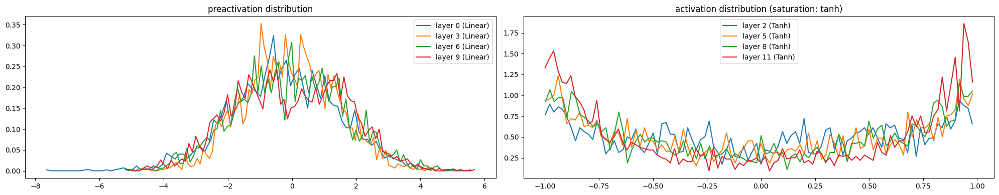

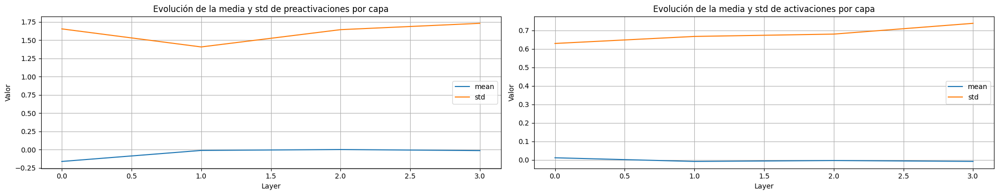


gradients
layer 2 (      Tanh): mean -0.0000, std 0.0033
layer 5 (      Tanh): mean -0.0000, std 0.0029
layer 8 (      Tanh): mean +0.0000, std 0.0027
layer 11 (      Tanh): mean +0.0000, std 0.0025

weights gradients
weight   (27, 10) | mean -0.0000 | std 0.0126 | grad:data ratio 0.0128
weight  (30, 100) | mean -0.0001 | std 0.0088 | grad:data ratio 0.0273
weight (100, 100) | mean +0.0001 | std 0.0057 | grad:data ratio 0.0311
weight (100, 100) | mean +0.0000 | std 0.0046 | grad:data ratio 0.0247
weight (100, 100) | mean +0.0000 | std 0.0039 | grad:data ratio 0.0211
weight  (100, 27) | mean -0.0000 | std 0.0234 | grad:data ratio 0.2563


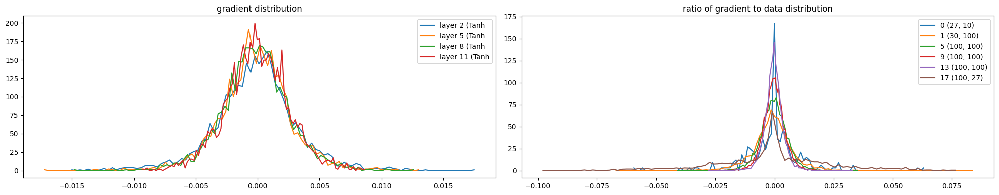

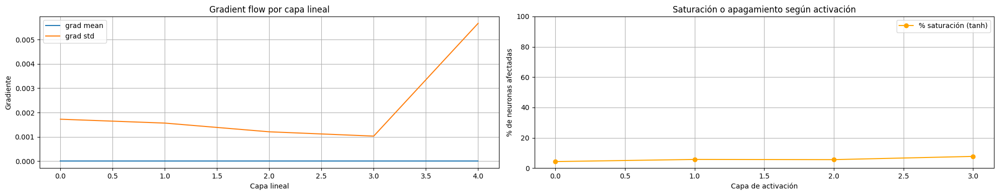


update/data

Distribución de pesos por capa (excluyendo última capa lineal):
Layer 0: mean = +0.0068, std = 0.3230
Layer 1: mean = -0.0012, std = 0.1823
Layer 2: mean = -0.0003, std = 0.1846
Layer 3: mean = +0.0038, std = 0.1845


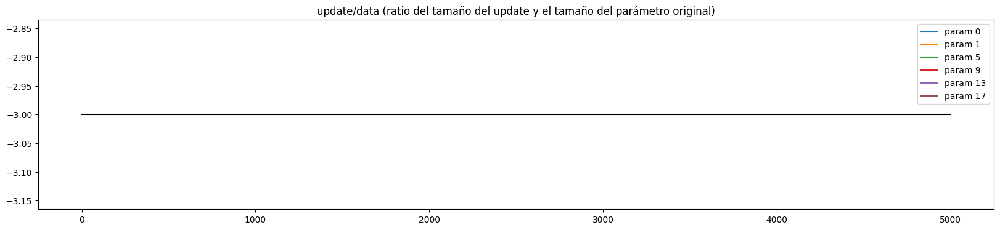

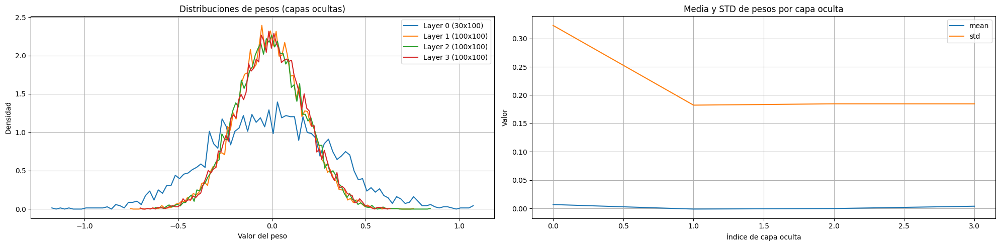

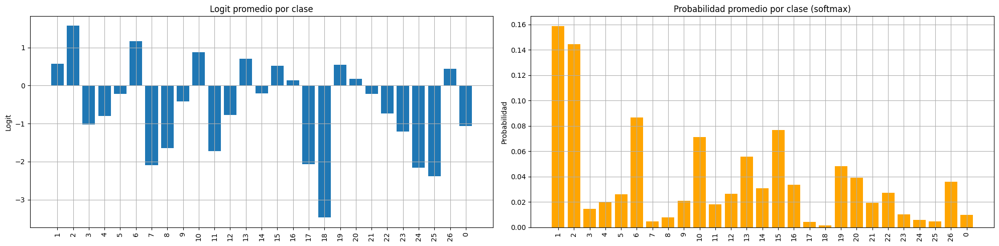

In [18]:
plot_training_monitoring(layers, Linear, Tanh, 'tanh', parameters, ud, Xtr, C, itos)

### Warm-up + linear decay scheduler

In [20]:
def train_model(Xtr, Ytr, C, layers, parameters, g, max_steps=5000, batch_size=32, 
                lr=0.001,  # LR inicial (máximo)
                beta1=0.9, beta2=0.999, eps=1e-8,  # Hiperparámetros de Adam
                warm_up_steps=1000,  # Número de pasos para warm-up (aumentar LR linealmente desde 0 hasta lr)
                min_lr=0.0,  # LR mínimo al final del decay (e.g., 0 o 1e-5)
                print_interval=1000):
    """
    Train a neural network model using Adam optimizer implemented from scratch,
    with added warm-up + linear decay learning rate schedule.
    
    Args:
        ... (args iguales a antes)
        warm_up_steps: Número de pasos iniciales para warm-up (LR aumenta linealmente de 0 a lr).
        min_lr: LR mínimo al que decae linealmente después del warm-up.
    
    Returns:
        tuple: (lossi, ud) - loss history and update/data ratios
    """
    lossi = []
    ud = []  # update/data ratios

    # Inicializamos los momentos para cada parámetro (Adam requiere estado por parámetro)
    m = [torch.zeros_like(p) for p in parameters]
    v = [torch.zeros_like(p) for p in parameters]
    t = 0  # Contador de pasos

    for i in range(max_steps):
        
        # Calcular el LR actual basado en el schedule
        if i < warm_up_steps:
            # Warm-up: Aumenta linealmente desde 0 hasta lr
            current_lr = lr * (i + 1) / warm_up_steps
        else:
            # Linear decay: Disminuye linealmente desde lr hasta min_lr
            decay_steps = max_steps - warm_up_steps
            progress = (i - warm_up_steps) / decay_steps
            current_lr = lr * (1 - progress) + min_lr * progress  # Interpolación lineal
        
        # Minibatch
        ix = torch.randint(0, Xtr.shape[0], (batch_size,), generator=g)
        Xb, Yb = Xtr[ix], Ytr[ix]
        
        # Forward pass
        emb = C[Xb]
        x = emb.view(emb.shape[0], -1)
        for layer in layers:
            x = layer(x)
        loss = F.cross_entropy(x, Yb)
        
        # Backward pass
        for layer in layers:
            layer.out.retain_grad()  # Para visualizaciones
        for p in parameters:
            p.grad = None
        loss.backward()
        
        # Update con Adam, usando current_lr
        t += 1  # Incrementar timestep
        for j, p in enumerate(parameters):
            if p.grad is None:
                continue
            
            # Paso 1: Calcular first moment estimate (m)
            m[j] = beta1 * m[j] + (1 - beta1) * p.grad
            
            # Paso 2: Calcular second moment estimate (v)
            v[j] = beta2 * v[j] + (1 - beta2) * (p.grad ** 2)
            
            # Paso 3: Bias correction
            m_hat = m[j] / (1 - beta1 ** t)
            v_hat = v[j] / (1 - beta2 ** t)
            
            # Paso 4: Update del parámetro con current_lr
            p.data += -current_lr * m_hat / (torch.sqrt(v_hat) + eps)

        # Track stats
        if i % print_interval == 0:
            print(f'{i:7d}/{max_steps:7d}: {loss.item():.4f} (lr: {current_lr:.6f})')
        lossi.append(loss.log10().item())
        with torch.no_grad():
            ud.append([(-current_lr * p.grad.std() / p.data.std()).log10().item() for p in parameters])  # Aprox para ud, con current_lr

    return lossi, ud

In [21]:
# Ejemplo de uso (mismo que antes, con nuevos args para schedule)
n_embd = 10
n_hidden = 100
g = torch.Generator().manual_seed(2147483647)

GAIN = 5/3  

C = torch.randn((vocab_size, n_embd), generator=g)
layers = [
  Linear(n_embd * block_size, n_hidden), BatchNorm1d(n_hidden), Tanh(),
  Linear(           n_hidden, n_hidden), BatchNorm1d(n_hidden), Tanh(),
  Linear(           n_hidden, n_hidden), BatchNorm1d(n_hidden), Tanh(),
  Linear(           n_hidden, n_hidden), BatchNorm1d(n_hidden), Tanh(),
  Linear(           n_hidden, vocab_size),
]

with torch.no_grad():
  layers[-1].weight *= 0.1
  for layer in layers[:-1]:
    if isinstance(layer, Linear):
      layer.weight *= GAIN

parameters = [C] + [p for layer in layers for p in layer.parameters()]
print(sum(p.nelement() for p in parameters))
for p in parameters:
  p.requires_grad = True

37197


In [22]:
# Entrenamos con Adam + warm-up + linear decay
lossi, ud = train_model(Xtr, Ytr, C, layers, parameters, g, lr=0.001, warm_up_steps=1000, min_lr=1e-5)

      0/   5000: 3.2739 (lr: 0.000001)
   1000/   5000: 2.3843 (lr: 0.001000)
   2000/   5000: 2.2797 (lr: 0.000753)
   3000/   5000: 2.2244 (lr: 0.000505)
   4000/   5000: 2.3682 (lr: 0.000258)


preactivations
layer 0 (    Linear): mean -0.1864, std 1.6731
layer 3 (    Linear): mean -0.0033, std 1.2011
layer 6 (    Linear): mean -0.0058, std 1.3302
layer 9 (    Linear): mean -0.0223, std 1.3660

activations
layer 2 (      Tanh): mean +0.0105, std 0.6262, saturated: 3.4688%
layer 5 (      Tanh): mean +0.0020, std 0.6521, saturated: 4.5938%
layer 8 (      Tanh): mean -0.0123, std 0.6539, saturated: 3.8125%
layer 11 (      Tanh): mean -0.0022, std 0.7264, saturated: 7.4688%


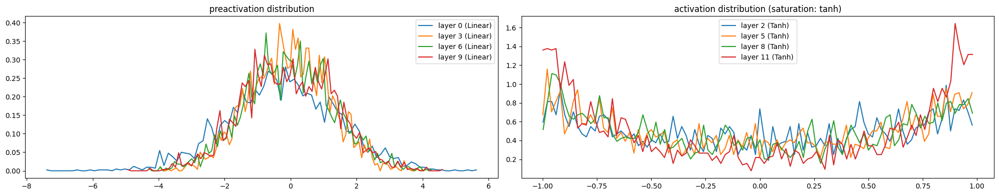

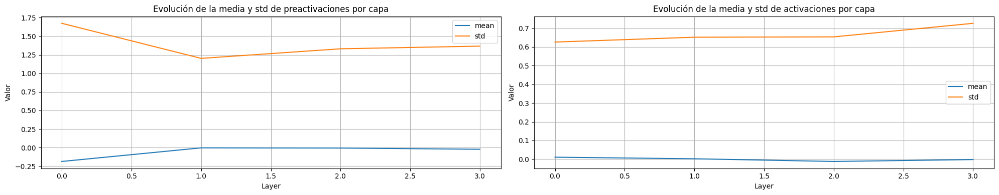


gradients
layer 2 (      Tanh): mean -0.0000, std 0.0042
layer 5 (      Tanh): mean +0.0000, std 0.0036
layer 8 (      Tanh): mean +0.0000, std 0.0029
layer 11 (      Tanh): mean +0.0000, std 0.0022

weights gradients
weight   (27, 10) | mean -0.0000 | std 0.0120 | grad:data ratio 0.0122
weight  (30, 100) | mean -0.0001 | std 0.0106 | grad:data ratio 0.0335
weight (100, 100) | mean -0.0000 | std 0.0079 | grad:data ratio 0.0457
weight (100, 100) | mean +0.0001 | std 0.0063 | grad:data ratio 0.0359
weight (100, 100) | mean +0.0000 | std 0.0042 | grad:data ratio 0.0242
weight  (100, 27) | mean -0.0000 | std 0.0236 | grad:data ratio 0.2992


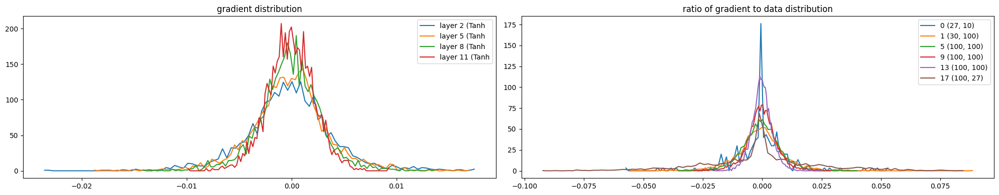

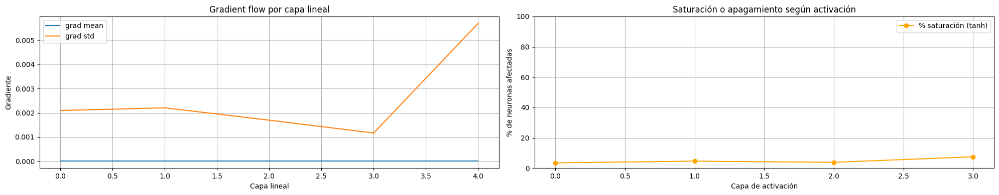


update/data

Distribución de pesos por capa (excluyendo última capa lineal):
Layer 0: mean = +0.0058, std = 0.3168
Layer 1: mean = -0.0010, std = 0.1732
Layer 2: mean = +0.0006, std = 0.1752
Layer 3: mean = +0.0040, std = 0.1747


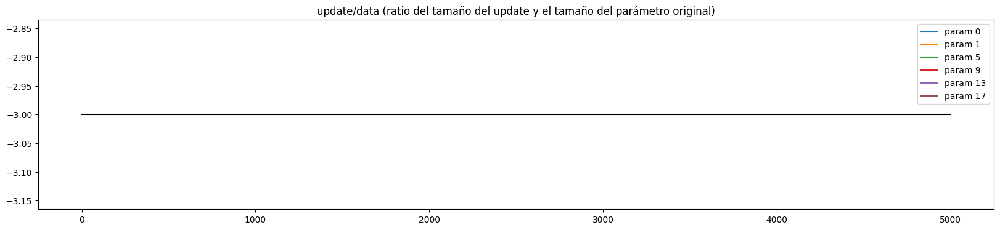

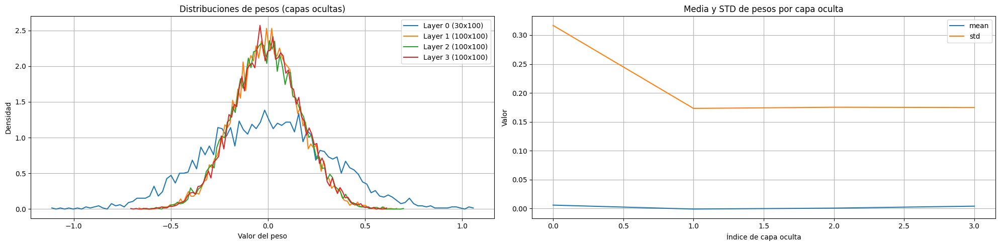

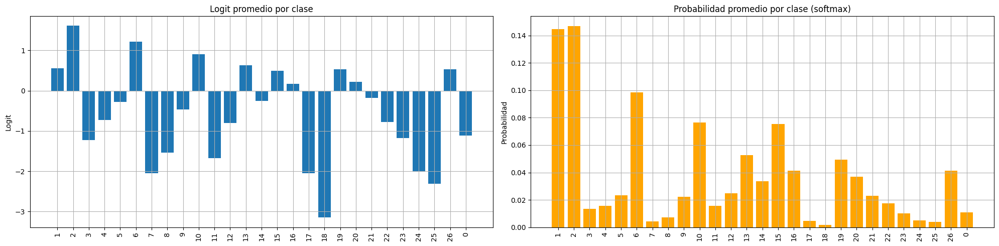

In [23]:
plot_training_monitoring(layers, Linear, Tanh, 'tanh', parameters, ud, Xtr, C, itos)

## Regularizacion

- weight decay / l2 / ridge regression
- dropout
- early stopping
- label smoothing
- gradient clipping

### Dropout

In [9]:
class Dropout:
    def __init__(self, p=0.5):
        self.p = p  # Probabilidad de dropout (probabilidad de que una neurona sea "apagada")
        self.training = True  # Modo entrenamiento por defecto

    def __call__(self, x):
        if self.training:
            # Durante entrenamiento: máscara binaria aleatoria (Bernoulli con prob 1-p)
            # Escalamos por 1/(1-p) para mantener la esperanza (inverted dropout)
            mask = (torch.rand_like(x) >= self.p).float() / (1.0 - self.p)
            self.out = x * mask
        else:
            # Durante inferencia: no dropout, solo salida original (ya que escalamos en training)
            self.out = x
        return self.out

    def parameters(self):
        return []  # Dropout no tiene parámetros entrenables

In [10]:
## Funcion de entrenamiento

### Adam optimizer

def train_model(Xtr, Ytr, C, layers, parameters, g, max_steps=5000, batch_size=32, 
                lr=0.001,  # LR típico para Adam es más pequeño que para SGD
                beta1=0.9, beta2=0.999, eps=1e-8,  # Hiperparámetros de Adam
                print_interval=1000):
    """
    Train a neural network model using Adam optimizer implemented from scratch.
    
    Args:
        ... (args iguales a antes)
        lr: Learning rate for Adam
        beta1: Exponential decay rate for first moment estimates
        beta2: Exponential decay rate for second moment estimates
        eps: Small value to prevent division by zero
    
    Returns:
        tuple: (lossi, ud) - loss history and update/data ratios
    """
    lossi = []
    ud = []  # update/data ratios

    # Inicializamos los momentos para cada parámetro (Adam requiere estado por parámetro)
    # m: first moment (media móvil del gradiente)
    # v: second moment (media móvil del gradiente al cuadrado)
    # t: timestep (para bias correction)
    m = [torch.zeros_like(p) for p in parameters]
    v = [torch.zeros_like(p) for p in parameters]
    t = 0  # Contador de pasos

    for i in range(max_steps):
        
        # Minibatch
        ix = torch.randint(0, Xtr.shape[0], (batch_size,), generator=g)
        Xb, Yb = Xtr[ix], Ytr[ix]
        
        # Forward pass
        emb = C[Xb]
        x = emb.view(emb.shape[0], -1)
        for layer in layers:
            x = layer(x)
        loss = F.cross_entropy(x, Yb)
        
        # Backward pass
        for layer in layers:
            layer.out.retain_grad()  # Para visualizaciones
        for p in parameters:
            p.grad = None
        loss.backward()
        
        # Update con Adam
        t += 1  # Incrementar timestep
        for j, p in enumerate(parameters):
            if p.grad is None:
                continue
            
            # Paso 1: Calcular first moment estimate (m)
            # m = beta1 * m_prev + (1 - beta1) * grad
            # Esto es una estimación sesgada de la media del gradiente
            m[j] = beta1 * m[j] + (1 - beta1) * p.grad
            
            # Paso 2: Calcular second moment estimate (v)
            # v = beta2 * v_prev + (1 - beta2) * grad^2
            # Esto es una estimación sesgada de la varianza del gradiente (segundo momento no centrado)
            v[j] = beta2 * v[j] + (1 - beta2) * (p.grad ** 2)
            
            # Paso 3: Bias correction (para compensar que m y v inician en 0, lo que sesga al inicio)
            # m_hat = m / (1 - beta1^t)
            # v_hat = v / (1 - beta2^t)
            # Esto hace que las estimaciones sean insesgadas, especialmente en los primeros pasos
            m_hat = m[j] / (1 - beta1 ** t)
            v_hat = v[j] / (1 - beta2 ** t)
            
            # Paso 4: Update del parámetro
            # update = -lr * m_hat / (sqrt(v_hat) + eps)
            # La división por sqrt(v_hat) normaliza el update por la "desviación estándar" del gradiente,
            # haciendo que el learning rate sea adaptativo por parámetro: pasos más grandes para gradientes con baja varianza, y viceversa.
            # eps evita división por cero.
            p.data += -lr * m_hat / (torch.sqrt(v_hat) + eps)

        # Track stats
        if i % print_interval == 0:
            print(f'{i:7d}/{max_steps:7d}: {loss.item():.4f}')
        lossi.append(loss.log10().item())
        with torch.no_grad():
            ud.append([(-lr * p.grad.std() / p.data.std()).log10().item() for p in parameters])  # Aprox para ud con Adam

    return lossi, ud

In [11]:
import math

# Ejemplo de uso (mismo que antes)
n_embd = 10
n_hidden = 100
g = torch.Generator().manual_seed(2147483647)

GAIN = math.sqrt(2)

C = torch.randn((vocab_size, n_embd), generator=g)
layers = [
  Linear(n_embd * block_size, n_hidden), BatchNorm1d(n_hidden), ReLU(),
  Linear(           n_hidden, n_hidden), BatchNorm1d(n_hidden), ReLU(),
  Linear(           n_hidden, n_hidden), BatchNorm1d(n_hidden), ReLU(),
  Linear(           n_hidden, n_hidden), BatchNorm1d(n_hidden), ReLU(),
  Linear(           n_hidden, vocab_size),
]

with torch.no_grad():
  layers[-1].weight *= 0.1
  for layer in layers[:-1]:
    if isinstance(layer, Linear):
      layer.weight *= GAIN

parameters = [C] + [p for layer in layers for p in layer.parameters()]
print(sum(p.nelement() for p in parameters))
for p in parameters:
  p.requires_grad = True

37197


In [12]:
max_steps = 5000
batch_size = 32
lr = 0.001

lossi, ud = train_model(Xtr, Ytr, C, layers, parameters, g, max_steps, batch_size, lr)


      0/   5000: 3.2708
   1000/   5000: 2.1783
   2000/   5000: 2.2416
   3000/   5000: 2.0658
   4000/   5000: 2.4397


preactivations
layer 0 (    Linear): mean -0.1297, std 1.4574
layer 3 (    Linear): mean -0.0052, std 1.2992
layer 6 (    Linear): mean -0.0689, std 1.3729
layer 9 (    Linear): mean -0.4110, std 1.4190

activations
layer 2 (      ReLU): mean +0.4074, std 0.5690, saturated: 48.1250%
layer 5 (      ReLU): mean +0.4031, std 0.5691, saturated: 49.1875%
layer 8 (      ReLU): mean +0.3994, std 0.5943, saturated: 51.2500%
layer 11 (      ReLU): mean +0.4594, std 0.6991, saturated: 52.6250%


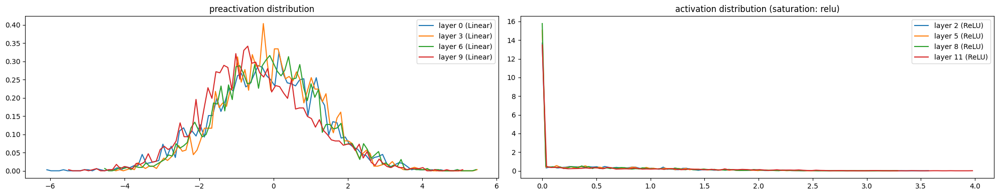

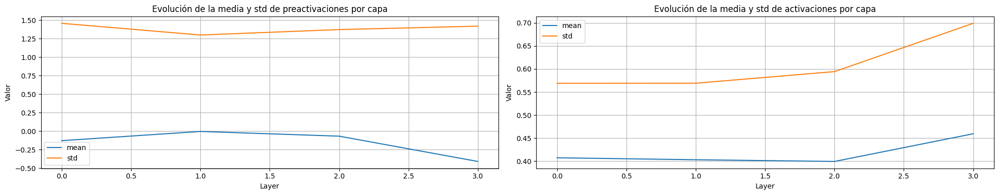


gradients
layer 2 (      ReLU): mean -0.0000, std 0.0038
layer 5 (      ReLU): mean +0.0000, std 0.0031
layer 8 (      ReLU): mean +0.0000, std 0.0028
layer 11 (      ReLU): mean +0.0000, std 0.0026

weights gradients
weight   (27, 10) | mean -0.0000 | std 0.0131 | grad:data ratio 0.0131
weight  (30, 100) | mean -0.0000 | std 0.0110 | grad:data ratio 0.0397
weight (100, 100) | mean +0.0000 | std 0.0062 | grad:data ratio 0.0388
weight (100, 100) | mean +0.0001 | std 0.0049 | grad:data ratio 0.0303
weight (100, 100) | mean +0.0000 | std 0.0043 | grad:data ratio 0.0264
weight  (100, 27) | mean +0.0000 | std 0.0255 | grad:data ratio 0.2850


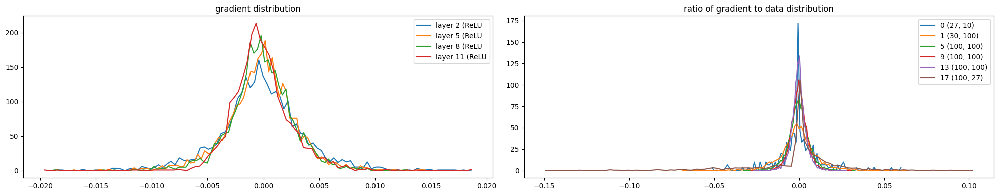

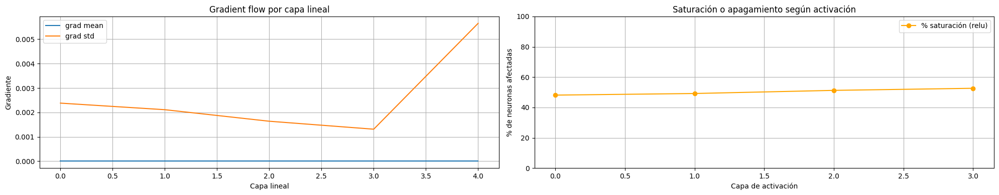


update/data

Distribución de pesos por capa (excluyendo última capa lineal):
Layer 0: mean = +0.0042, std = 0.2763
Layer 1: mean = -0.0003, std = 0.1596
Layer 2: mean = -0.0018, std = 0.1618
Layer 3: mean = -0.0094, std = 0.1620


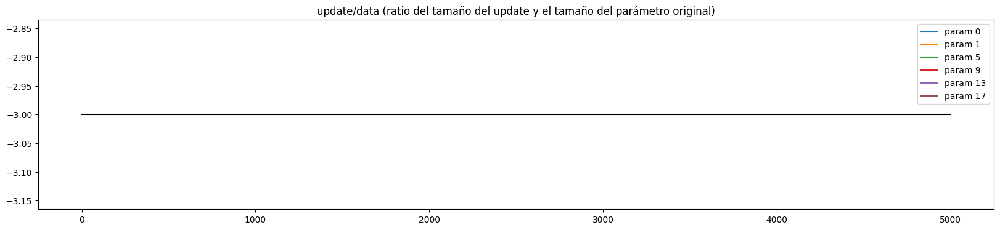

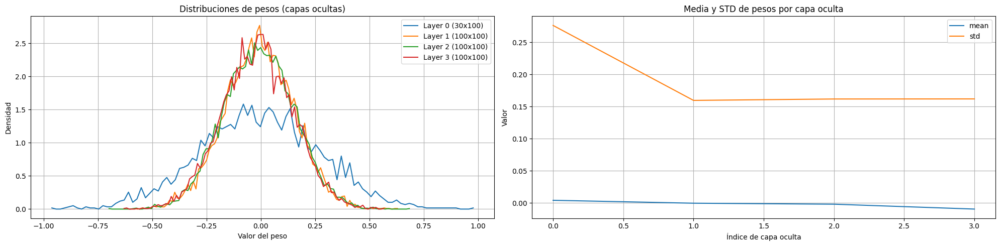

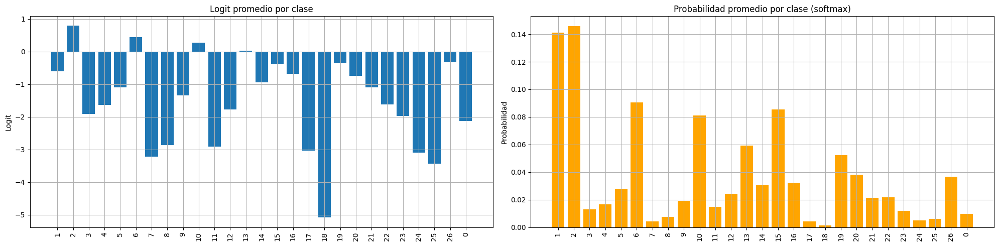

In [13]:
plot_training_monitoring(layers, Linear, ReLU, 'relu', parameters, ud, Xtr, C, itos)

## Residual connections

El problema principal es que, a medida que la red se vuelve mas deep, empiezan a haber fenomenos que hacen que no sean faciles de estabilizar y entrenar, por ejemplo que al cambiar apenas el valor de las primeras layers, termina cambiando un monton todo lo demas y los gradientes cambian tambien un monton… entonces al estar todo tan inestable y riesgoso, hace que la suerte te haga terminar en cualquier lado.

Hasta ahora siempre fue todo secuencial. Pero podemos agregar residual connections.

**Residual connections**

Son BRANCHES en el grafo computacional, donde el input a cada layer se vuelve a sumar al output de esa layer.

$$
\begin{align*}\mathbf{h}_1 &= \mathbf{x} + f_1[\mathbf{x}, \boldsymbol{\phi}_1] \\\mathbf{h}_2 &= \mathbf{h}_1 + f_2[\mathbf{h}_1, \boldsymbol{\phi}_2] \\\mathbf{h}_3 &= \mathbf{h}_2 + f_3[\mathbf{h}_2, \boldsymbol{\phi}_3] \\\mathbf{y}   &= \mathbf{h}_3 + f_4[\mathbf{h}_3, \boldsymbol{\phi}_4]\end{align*}
$$

Ahora las h participan como input a la siguiente layer pero tambien sumandose de una.

In [13]:
### Adam optimizer

def train_model(Xtr, Ytr, C, layers, parameters, g, max_steps=5000, batch_size=32, 
                lr=0.001,  # LR típico para Adam es más pequeño que para SGD
                beta1=0.9, beta2=0.999, eps=1e-8,  # Hiperparámetros de Adam
                print_interval=1000):
    """
    Train a neural network model using Adam optimizer implemented from scratch.
    
    Args:
        ... (args iguales a antes)
        lr: Learning rate for Adam
        beta1: Exponential decay rate for first moment estimates
        beta2: Exponential decay rate for second moment estimates
        eps: Small value to prevent division by zero
    
    Returns:
        tuple: (lossi, ud) - loss history and update/data ratios
    """
    lossi = []
    ud = []  # update/data ratios

    # Inicializamos los momentos para cada parámetro (Adam requiere estado por parámetro)
    # m: first moment (media móvil del gradiente)
    # v: second moment (media móvil del gradiente al cuadrado)
    # t: timestep (para bias correction)
    m = [torch.zeros_like(p) for p in parameters]
    v = [torch.zeros_like(p) for p in parameters]
    t = 0  # Contador de pasos

    for i in range(max_steps):
        
        # Minibatch
        ix = torch.randint(0, Xtr.shape[0], (batch_size,), generator=g)
        Xb, Yb = Xtr[ix], Ytr[ix]
        
        # Forward pass
        emb = C[Xb]
        x = emb.view(emb.shape[0], -1)
        
        # Initial projection: linear1 + BN1
        x = layers[0](x)
        x = layers[1](x)
        
        # Residual blocks
        index = 2
        num_residual_blocks = 3
        for _ in range(num_residual_blocks):
            residual = x
            x = layers[index](x)  # ReLU
            index += 1
            x = layers[index](x)  # Linear
            index += 1
            x = layers[index](x)  # BatchNorm1d
            index += 1
            x += residual
        
        # Final linear
        x = layers[index](x)
        
        loss = F.cross_entropy(x, Yb)
        
        # Backward pass
        for layer in layers:
            layer.out.retain_grad()  # Para visualizaciones
        for p in parameters:
            p.grad = None
        loss.backward()
        
        # Update con Adam
        t += 1  # Incrementar timestep
        for j, p in enumerate(parameters):
            if p.grad is None:
                continue
            
            # Paso 1: Calcular first moment estimate (m)
            # m = beta1 * m_prev + (1 - beta1) * grad
            # Esto es una estimación sesgada de la media del gradiente
            m[j] = beta1 * m[j] + (1 - beta1) * p.grad
            
            # Paso 2: Calcular second moment estimate (v)
            # v = beta2 * v_prev + (1 - beta2) * grad^2
            # Esto es una estimación sesgada de la varianza del gradiente (segundo momento no centrado)
            v[j] = beta2 * v[j] + (1 - beta2) * (p.grad ** 2)
            
            # Paso 3: Bias correction (para compensar que m y v inician en 0, lo que sesga al inicio)
            # m_hat = m / (1 - beta1^t)
            # v_hat = v / (1 - beta2^t)
            # Esto hace que las estimaciones sean insesgadas, especialmente en los primeros pasos
            m_hat = m[j] / (1 - beta1 ** t)
            v_hat = v[j] / (1 - beta2 ** t)
            
            # Paso 4: Update del parámetro
            # update = -lr * m_hat / (sqrt(v_hat) + eps)
            # La división por sqrt(v_hat) normaliza el update por la "desviación estándar" del gradiente,
            # haciendo que el learning rate sea adaptativo por parámetro: pasos más grandes para gradientes con baja varianza, y viceversa.
            # eps evita división por cero.
            p.data += -lr * m_hat / (torch.sqrt(v_hat) + eps)

        # Track stats
        if i % print_interval == 0:
            print(f'{i:7d}/{max_steps:7d}: {loss.item():.4f}')
        lossi.append(loss.log10().item())
        with torch.no_grad():
            ud.append([(-lr * p.grad.std() / p.data.std()).log10().item() for p in parameters])  # Aprox para ud con Adam

    return lossi, ud

37197
      0/   5000: 3.2999
   1000/   5000: 2.3762
   2000/   5000: 2.3599
   3000/   5000: 2.0737
   4000/   5000: 2.3039
preactivations
layer 0 (    Linear): mean -0.1381, std 1.4958
layer 3 (    Linear): mean -0.1554, std 1.2553
layer 6 (    Linear): mean -0.0962, std 1.5061
layer 9 (    Linear): mean +0.0893, std 1.8936

activations
layer 2 (      ReLU): mean +0.3612, std 0.5283, saturated: 51.2187%
layer 5 (      ReLU): mean +0.4538, std 0.6849, saturated: 51.3125%
layer 8 (      ReLU): mean +0.5362, std 0.8229, saturated: 52.2812%


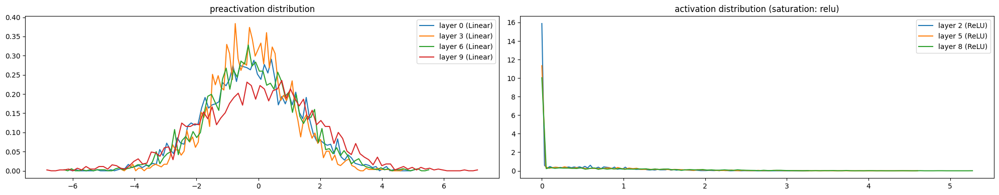

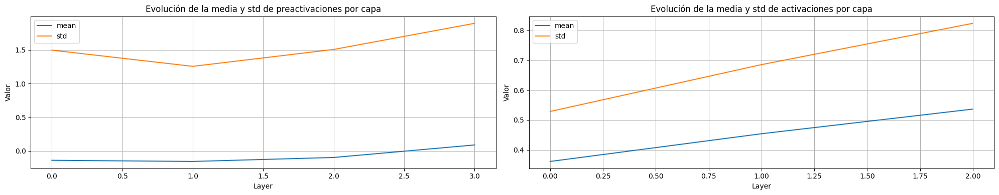


gradients
layer 2 (      ReLU): mean +0.0000, std 0.0040
layer 5 (      ReLU): mean +0.0000, std 0.0026
layer 8 (      ReLU): mean +0.0000, std 0.0018

weights gradients
weight   (27, 10) | mean -0.0000 | std 0.0136 | grad:data ratio 0.0137
weight  (30, 100) | mean -0.0000 | std 0.0125 | grad:data ratio 0.0454
weight (100, 100) | mean -0.0001 | std 0.0067 | grad:data ratio 0.0418
weight (100, 100) | mean +0.0001 | std 0.0044 | grad:data ratio 0.0274
weight (100, 100) | mean +0.0001 | std 0.0031 | grad:data ratio 0.0195
weight  (100, 27) | mean +0.0000 | std 0.0460 | grad:data ratio 0.8961


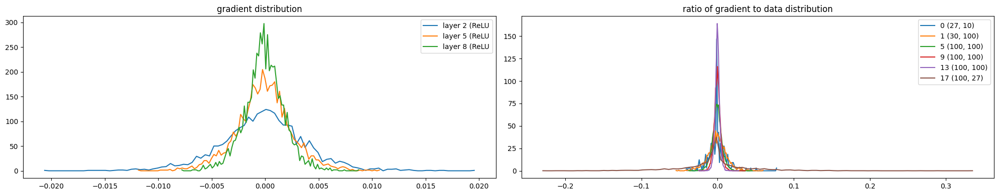

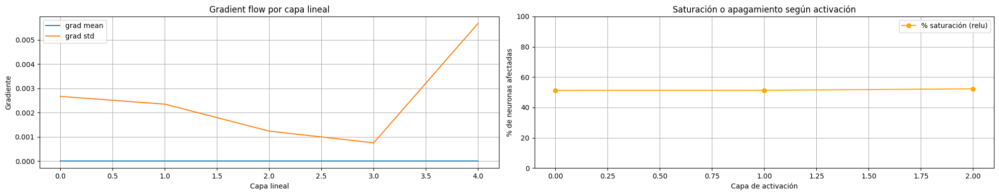


update/data

Distribución de pesos por capa (excluyendo última capa lineal):
Layer 0: mean = +0.0046, std = 0.2759
Layer 1: mean = -0.0043, std = 0.1594
Layer 2: mean = -0.0021, std = 0.1614
Layer 3: mean = +0.0027, std = 0.1608


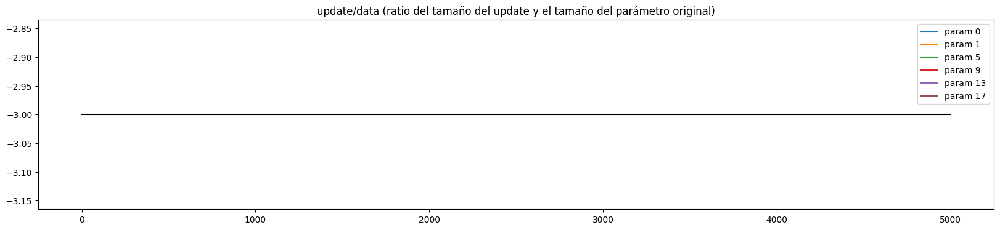

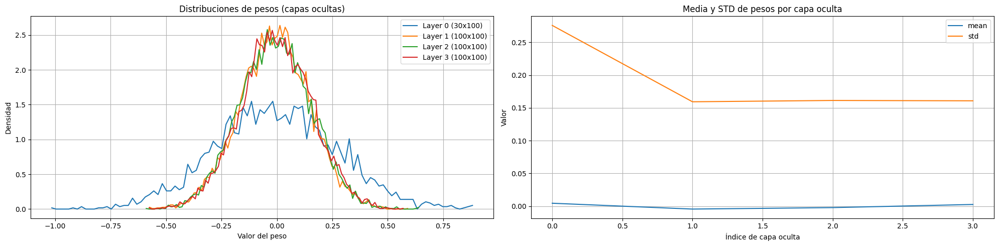

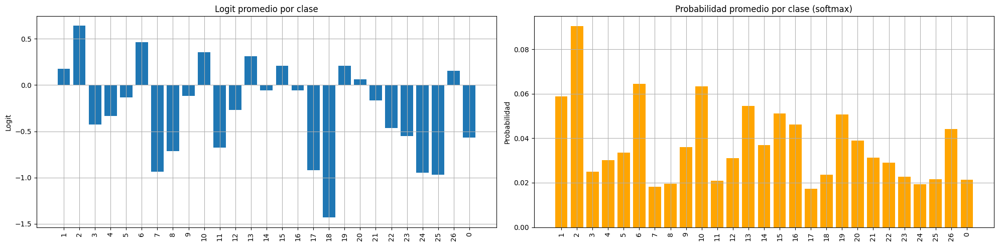

In [14]:
import math

# Ejemplo de uso (mismo que antes)
n_embd = 10
n_hidden = 100
g = torch.Generator().manual_seed(2147483647)

GAIN = math.sqrt(2)

C = torch.randn((vocab_size, n_embd), generator=g)
layers = [
  Linear(n_embd * block_size, n_hidden), BatchNorm1d(n_hidden),
  ReLU(), Linear(           n_hidden, n_hidden), BatchNorm1d(n_hidden),
  ReLU(), Linear(           n_hidden, n_hidden), BatchNorm1d(n_hidden),
  ReLU(), Linear(           n_hidden, n_hidden), BatchNorm1d(n_hidden),
  Linear(           n_hidden, vocab_size),
]

with torch.no_grad():
  layers[-1].weight *= 0.1
  for layer in layers[:-1]:
    if isinstance(layer, Linear):
      layer.weight *= GAIN

parameters = [C] + [p for layer in layers for p in layer.parameters()]
print(sum(p.nelement() for p in parameters))
for p in parameters:
  p.requires_grad = True



In [ ]:
max_steps = 5000
batch_size = 32
lr = 0.001

lossi, ud = train_model(Xtr, Ytr, C, layers, parameters, g, max_steps, batch_size, lr)

In [ ]:
plot_training_monitoring(layers, Linear, ReLU, 'relu', parameters, ud, Xtr, C, itos)

# Implementacion & monitoreo

## Dataset (texto)

In [1]:
import torch
import torch.nn.functional as F
import matplotlib.pyplot as plt # for making figures
%matplotlib inline

# read in all the words
words = open('data/names.txt', 'r').read().splitlines()
words[:8]
print(len(words))

# build the vocabulary of characters and mappings to/from integers
chars = sorted(list(set(''.join(words))))
stoi = {s:i+1 for i,s in enumerate(chars)}
stoi['.'] = 0
itos = {i:s for s,i in stoi.items()}
vocab_size = len(itos)
print(itos)
print(vocab_size)

32033
{1: 'a', 2: 'b', 3: 'c', 4: 'd', 5: 'e', 6: 'f', 7: 'g', 8: 'h', 9: 'i', 10: 'j', 11: 'k', 12: 'l', 13: 'm', 14: 'n', 15: 'o', 16: 'p', 17: 'q', 18: 'r', 19: 's', 20: 't', 21: 'u', 22: 'v', 23: 'w', 24: 'x', 25: 'y', 26: 'z', 0: '.'}
27


In [2]:
# build the dataset
block_size = 3 # context length: how many characters do we take to predict the next one?

def build_dataset(words):  
  X, Y = [], []
  
  for w in words:
    context = [0] * block_size
    for ch in w + '.':
      ix = stoi[ch]
      X.append(context)
      Y.append(ix)
      context = context[1:] + [ix] # crop and append

  X = torch.tensor(X)
  Y = torch.tensor(Y)
  print(X.shape, Y.shape)
  return X, Y

import random
random.seed(42)
random.shuffle(words)
n1 = int(0.8*len(words))
n2 = int(0.9*len(words))

Xtr,  Ytr  = build_dataset(words[:n1])     # 80%
Xdev, Ydev = build_dataset(words[n1:n2])   # 10%
Xte,  Yte  = build_dataset(words[n2:])     # 10%


torch.Size([182625, 3]) torch.Size([182625])
torch.Size([22655, 3]) torch.Size([22655])
torch.Size([22866, 3]) torch.Size([22866])


## PyTorch

In [3]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.optim.lr_scheduler import LambdaLR
import matplotlib.pyplot as plt
import random

# Hyperparameters
n_embd = 32  # Embedding dimension per token
hidden_size = 512  # Hidden size for MLP layers
num_layers = 8  # Number of residual blocks in the MLP
dropout_rate = 0.1  # Dropout rate
learning_rate = 3e-4  # Base LR for AdamW
weight_decay = 1e-2  # Weight decay for AdamW
max_epochs = 10  # Number of epochs (adjust as needed)
batch_size = 512  # Larger batch size for efficiency
warmup_steps = 1000  # Warmup steps for scheduler
total_steps = max_epochs * (len(Xtr) // batch_size)  # Approximate total steps

# device
if torch.cuda.is_available():
    device = torch.device('cuda')
    print("Usando GPU: CUDA")
elif hasattr(torch.backends, "mps") and torch.backends.mps.is_available():
    device = torch.device('mps')
    print("Usando GPU: Metal (Apple Silicon)")
else:
    device = torch.device('cpu')
    print("Usando CPU")

Usando GPU: CUDA


In [4]:
# Define Residual Block
class ResidualBlock(nn.Module):
    def __init__(self, in_features, out_features, dropout_rate):
        super().__init__()
        self.linear = nn.Linear(in_features, out_features)
        self.norm = nn.LayerNorm(out_features)
        self.relu = nn.ReLU()
        self.dropout = nn.Dropout(dropout_rate)
        
        # He (Kaiming) initialization for Linear layer
        nn.init.kaiming_normal_(self.linear.weight, mode='fan_out', nonlinearity='relu')

    def forward(self, x):
        residual = x
        x = self.linear(x)
        x = self.norm(x)
        x = self.relu(x)
        x = self.dropout(x)
        return x + residual  # Residual connection

# Define the Model
class CharPredictor(nn.Module):
    def __init__(self, vocab_size, block_size, n_embd, hidden_size, num_layers, dropout_rate):
        super().__init__()
        self.embedding = nn.Embedding(vocab_size, n_embd)
        self.flatten_dim = block_size * n_embd
        self.initial_linear = nn.Linear(self.flatten_dim, hidden_size)
        self.initial_norm = nn.LayerNorm(hidden_size)
        self.initial_relu = nn.ReLU()
        self.initial_dropout = nn.Dropout(dropout_rate)
        
        self.residual_blocks = nn.ModuleList([
            ResidualBlock(hidden_size, hidden_size, dropout_rate) for _ in range(num_layers)
        ])
        
        self.output_linear = nn.Linear(hidden_size, vocab_size)
        
        # Initialize weights
        nn.init.kaiming_normal_(self.initial_linear.weight, mode='fan_out', nonlinearity='relu')
        nn.init.kaiming_normal_(self.output_linear.weight, mode='fan_out', nonlinearity='relu')
        # For output, sometimes scaled down, but optional

    def forward(self, x):
        # x: (batch, block_size) indices
        emb = self.embedding(x)  # (batch, block_size, n_embd)
        x = emb.view(emb.size(0), -1)  # (batch, block_size * n_embd)
        
        x = self.initial_linear(x)
        x = self.initial_norm(x)
        x = self.initial_relu(x)
        x = self.initial_dropout(x)
        
        for block in self.residual_blocks:
            x = block(x)
        
        logits = self.output_linear(x)
        return logits



In [5]:
# Instantiate model
model = CharPredictor(vocab_size, block_size, n_embd, hidden_size, num_layers, dropout_rate)
model.to(device)
print(model)
print(f"Number of parameters: {sum(p.numel() for p in model.parameters())}")

# DataLoaders
train_ds = torch.utils.data.TensorDataset(Xtr, Ytr)
train_loader = torch.utils.data.DataLoader(train_ds, batch_size=batch_size, shuffle=True)

val_ds = torch.utils.data.TensorDataset(Xdev, Ydev)
val_loader = torch.utils.data.DataLoader(val_ds, batch_size=batch_size, shuffle=False)

# Optimizer: AdamW
optimizer = optim.AdamW(model.parameters(), lr=learning_rate, weight_decay=weight_decay)

# Learning rate scheduler: Warmup + Linear Decay
def get_lr_lambda(step):
    if step < warmup_steps:
        return step / max(1, warmup_steps)  # Linear warmup
    else:
        progress = (step - warmup_steps) / max(1, total_steps - warmup_steps)
        return max(0.0, 1.0 - progress)  # Linear decay to 0

scheduler = LambdaLR(optimizer, lr_lambda=get_lr_lambda)

CharPredictor(
  (embedding): Embedding(27, 32)
  (initial_linear): Linear(in_features=96, out_features=512, bias=True)
  (initial_norm): LayerNorm((512,), eps=1e-05, elementwise_affine=True)
  (initial_relu): ReLU()
  (initial_dropout): Dropout(p=0.1, inplace=False)
  (residual_blocks): ModuleList(
    (0-7): 8 x ResidualBlock(
      (linear): Linear(in_features=512, out_features=512, bias=True)
      (norm): LayerNorm((512,), eps=1e-05, elementwise_affine=True)
      (relu): ReLU()
      (dropout): Dropout(p=0.1, inplace=False)
    )
  )
  (output_linear): Linear(in_features=512, out_features=27, bias=True)
)
Number of parameters: 2174843


Epoch 1/10 - Train Loss: 16.7233 - Val Loss: 3.7806 - LR: 0.000107
Epoch 2/10 - Train Loss: 5.1649 - Val Loss: 2.8115 - LR: 0.000214
Epoch 3/10 - Train Loss: 3.7066 - Val Loss: 2.4588 - LR: 0.000292
Epoch 4/10 - Train Loss: 3.0702 - Val Loss: 2.3452 - LR: 0.000250
Epoch 5/10 - Train Loss: 2.7847 - Val Loss: 2.2447 - LR: 0.000208
Epoch 6/10 - Train Loss: 2.6321 - Val Loss: 2.2692 - LR: 0.000166
Epoch 7/10 - Train Loss: 2.5307 - Val Loss: 2.1813 - LR: 0.000124
Epoch 8/10 - Train Loss: 2.4751 - Val Loss: 2.1710 - LR: 0.000082
Epoch 9/10 - Train Loss: 2.4286 - Val Loss: 2.1518 - LR: 0.000041
Epoch 10/10 - Train Loss: 2.3994 - Val Loss: 2.1513 - LR: 0.000000


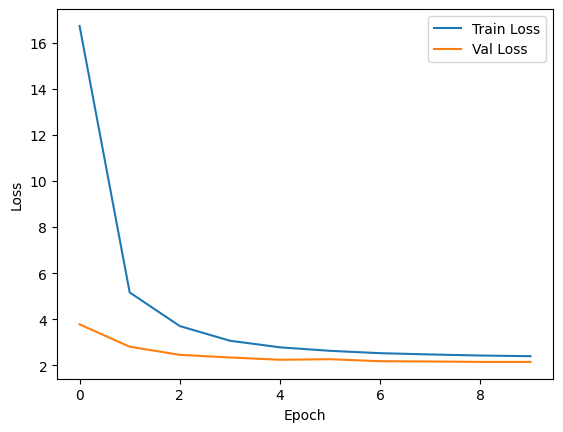

Test Loss: 2.1519


In [6]:
# Training loop
train_losses = []
val_losses = []

for epoch in range(max_epochs):
    model.train()
    train_loss = 0.0
    for batch_idx, (inputs, targets) in enumerate(train_loader):
        inputs, targets = inputs.to(device), targets.to(device)
        
        optimizer.zero_grad()
        logits = model(inputs)
        loss = F.cross_entropy(logits, targets)
        loss.backward()
        optimizer.step()
        scheduler.step()
        
        train_loss += loss.item()
    
    train_loss /= len(train_loader)
    train_losses.append(train_loss)
    
    # Validation
    model.eval()
    val_loss = 0.0
    with torch.no_grad():
        for inputs, targets in val_loader:
            inputs, targets = inputs.to(device), targets.to(device)
            logits = model(inputs)
            loss = F.cross_entropy(logits, targets)
            val_loss += loss.item()
    
    val_loss /= len(val_loader)
    val_losses.append(val_loss)
    
    print(f"Epoch {epoch+1}/{max_epochs} - Train Loss: {train_loss:.4f} - Val Loss: {val_loss:.4f} - LR: {scheduler.get_last_lr()[0]:.6f}")

# Plot losses
plt.plot(train_losses, label='Train Loss')
plt.plot(val_losses, label='Val Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.show()

# Evaluation on test set
model.eval()
test_loss = 0.0
with torch.no_grad():
    for i in range(0, len(Xte), batch_size):
        inputs = Xte[i:i+batch_size].to(device)
        targets = Yte[i:i+batch_size].to(device)
        logits = model(inputs)
        loss = F.cross_entropy(logits, targets)
        test_loss += loss.item() * len(inputs)
test_loss /= len(Xte)

print(f"Test Loss: {test_loss:.4f}")

In [7]:
# Sampling function (optional, to generate names)
@torch.no_grad()
def generate_names(model, num_names=10, max_length=20):
    model.eval()
    names = []
    for _ in range(num_names):
        context = [0] * block_size
        name = ''
        for _ in range(max_length):
            inputs = torch.tensor([context]).to(device)
            logits = model(inputs)
            probs = F.softmax(logits, dim=-1)
            next_ix = torch.multinomial(probs, num_samples=1).item()
            if next_ix == 0:
                break
            name += itos[next_ix]
            context = context[1:] + [next_ix]
        names.append(name)
    return names

print("Generated names:", generate_names(model))

Generated names: ['tayvio', 'atallah', 'robba', 'louonni', 'luca', 'daelivika', 'kahlis', 'jael', 'nily', 'kasia']


## Pytorch + Tensorboard

A la hora de entrenar ejecutar:
```
tensorboard --logdir=runs/char_predictor_experiment
```

Abrir:

```
http://localhost:6006/
```

In [6]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.optim.lr_scheduler import LambdaLR
import matplotlib.pyplot as plt
import random
from torch.utils.tensorboard import SummaryWriter
from torch.profiler import profile, record_function, ProfilerActivity
import os

# Hyperparameters
n_embd = 32  # Embedding dimension per token
hidden_size = 512  # Hidden size for MLP layers
num_layers = 8  # Number of residual blocks in the MLP
dropout_rate = 0.1  # Dropout rate
learning_rate = 3e-4  # Base LR for AdamW
weight_decay = 1e-2  # Weight decay for AdamW
max_epochs = 5  # Number of epochs (adjust as needed)
batch_size = 512  # Larger batch size for efficiency
warmup_steps = 1000  # Warmup steps for scheduler
total_steps = max_epochs * (len(Xtr) // batch_size)  # Approximate total steps
# device
if torch.cuda.is_available():
    device = torch.device('cuda')
    print("Usando GPU: CUDA")
elif hasattr(torch.backends, "mps") and torch.backends.mps.is_available():
    device = torch.device('mps')
    print("Usando GPU: Metal (Apple Silicon)")
else:
    device = torch.device('cpu')
    print("Usando CPU")
clip_grad_norm = 1.0  # Gradient clipping max norm
profile_every_n_epochs = 5  # Run profiler every N epochs to avoid overhead

Usando GPU: CUDA


In [7]:
# Define Residual Block
class ResidualBlock(nn.Module):
    def __init__(self, in_features, out_features, dropout_rate):
        super().__init__()
        self.linear = nn.Linear(in_features, out_features)
        self.norm = nn.LayerNorm(out_features)
        self.relu = nn.ReLU()
        self.dropout = nn.Dropout(dropout_rate)
        
        # He (Kaiming) initialization for Linear layer
        nn.init.kaiming_normal_(self.linear.weight, mode='fan_out', nonlinearity='relu')

    def forward(self, x):
        residual = x
        x = self.linear(x)
        x = self.norm(x)
        x = self.relu(x)
        x = self.dropout(x)
        return x + residual  # Residual connection

# Define the Model
class CharPredictor(nn.Module):
    def __init__(self, vocab_size, block_size, n_embd, hidden_size, num_layers, dropout_rate):
        super().__init__()
        self.embedding = nn.Embedding(vocab_size, n_embd)
        self.flatten_dim = block_size * n_embd
        self.initial_linear = nn.Linear(self.flatten_dim, hidden_size)
        self.initial_norm = nn.LayerNorm(hidden_size)
        self.initial_relu = nn.ReLU()
        self.initial_dropout = nn.Dropout(dropout_rate)
        
        self.residual_blocks = nn.ModuleList([
            ResidualBlock(hidden_size, hidden_size, dropout_rate) for _ in range(num_layers)
        ])
        
        self.output_linear = nn.Linear(hidden_size, vocab_size)
        
        # Initialize weights
        nn.init.kaiming_normal_(self.initial_linear.weight, mode='fan_out', nonlinearity='relu')
        nn.init.kaiming_normal_(self.output_linear.weight, mode='fan_out', nonlinearity='relu')
        # For output, sometimes scaled down, but optional

    def forward(self, x):
        # x: (batch, block_size) indices
        emb = self.embedding(x)  # (batch, block_size, n_embd)
        x = emb.view(emb.size(0), -1)  # (batch, block_size * n_embd)
        
        x = self.initial_linear(x)
        x = self.initial_norm(x)
        x = self.initial_relu(x)
        x = self.initial_dropout(x)
        
        for block in self.residual_blocks:
            x = block(x)
        
        logits = self.output_linear(x)
        return logits



In [8]:
# Instantiate model
model = CharPredictor(vocab_size, block_size, n_embd, hidden_size, num_layers, dropout_rate)
model.to(device)
print(model)
print(f"Number of parameters: {sum(p.numel() for p in model.parameters())}")

# DataLoaders
train_ds = torch.utils.data.TensorDataset(Xtr, Ytr)
train_loader = torch.utils.data.DataLoader(train_ds, batch_size=batch_size, shuffle=True)

val_ds = torch.utils.data.TensorDataset(Xdev, Ydev)
val_loader = torch.utils.data.DataLoader(val_ds, batch_size=batch_size, shuffle=False)

# Optimizer: AdamW
optimizer = optim.AdamW(model.parameters(), lr=learning_rate, weight_decay=weight_decay)

# Learning rate scheduler: Warmup + Linear Decay
def get_lr_lambda(step):
    if step < warmup_steps:
        return step / max(1, warmup_steps)  # Linear warmup
    else:
        progress = (step - warmup_steps) / max(1, total_steps - warmup_steps)
        return max(0.0, 1.0 - progress)  # Linear decay to 0

scheduler = LambdaLR(optimizer, lr_lambda=get_lr_lambda)

# TensorBoard writer
log_dir = 'runs/char_predictor_experiment'
if not os.path.exists(log_dir):
    os.makedirs(log_dir)
writer = SummaryWriter(log_dir=log_dir)

# Hooks for monitoring activations and gradients
activation_stats = {}
gradient_stats = {}

def get_activation_hook(name):
    def hook_fn(module, input, output):
        activation_stats[name] = {'mean': output.mean().item(), 'std': output.std().item(), 'data': output.detach()}
    return hook_fn

def get_gradient_hook(name):
    def hook_fn(grad):
        gradient_stats[name] = {'mean': grad.mean().item(), 'std': grad.std().item(), 'data': grad.detach()}
        return grad
    return hook_fn

# Register hooks on key modules
hook_handles = []
hook_handles.append(model.initial_relu.register_forward_hook(get_activation_hook('initial_relu')))
hook_handles.append(model.initial_linear.weight.register_hook(get_gradient_hook('initial_linear_weight')))
for i, block in enumerate(model.residual_blocks):
    hook_handles.append(block.relu.register_forward_hook(get_activation_hook(f'residual_{i}_relu')))
    hook_handles.append(block.linear.weight.register_hook(get_gradient_hook(f'residual_{i}_linear_weight')))

CharPredictor(
  (embedding): Embedding(27, 32)
  (initial_linear): Linear(in_features=96, out_features=512, bias=True)
  (initial_norm): LayerNorm((512,), eps=1e-05, elementwise_affine=True)
  (initial_relu): ReLU()
  (initial_dropout): Dropout(p=0.1, inplace=False)
  (residual_blocks): ModuleList(
    (0-7): 8 x ResidualBlock(
      (linear): Linear(in_features=512, out_features=512, bias=True)
      (norm): LayerNorm((512,), eps=1e-05, elementwise_affine=True)
      (relu): ReLU()
      (dropout): Dropout(p=0.1, inplace=False)
    )
  )
  (output_linear): Linear(in_features=512, out_features=27, bias=True)
)
Number of parameters: 2174843


In [10]:
# Training loop with monitoring
train_losses = []
val_losses = []
global_step = 0

for epoch in range(max_epochs):
    model.train()
    train_loss = 0.0
    for batch_idx, (inputs, targets) in enumerate(train_loader):
        inputs, targets = inputs.to(device), targets.to(device)
        
        # Optional profiling every N epochs
        if epoch % profile_every_n_epochs == 0 and batch_idx == 0:
            activities = [ProfilerActivity.CPU, ProfilerActivity.CUDA] if torch.cuda.is_available() else [ProfilerActivity.CPU]
            with profile(activities=activities, record_shapes=True, profile_memory=True, with_stack=True) as prof:
                with record_function("model_training"):
                    optimizer.zero_grad()
                    logits = model(inputs)
                    loss = F.cross_entropy(logits, targets)
                    loss.backward()
                    # Gradient clipping to prevent exploding gradients
                    nn.utils.clip_grad_norm_(model.parameters(), max_norm=clip_grad_norm)
                    optimizer.step()
                    scheduler.step()
            # Export profiler results
            prof.export_chrome_trace(f"trace_epoch_{epoch}.json")
            writer.add_text('Profiler', prof.key_averages().table(sort_by="cuda_time_total" if torch.cuda.is_available() else "cpu_time_total"), global_step)
        
        else:
            optimizer.zero_grad()
            logits = model(inputs)
            loss = F.cross_entropy(logits, targets)
            loss.backward()
            # Gradient clipping
            nn.utils.clip_grad_norm_(model.parameters(), max_norm=clip_grad_norm)
            optimizer.step()
            scheduler.step()
        
        train_loss += loss.item()
        global_step += 1
        
        # Log to TensorBoard every batch (or reduce frequency if needed)
        writer.add_scalar('Loss/train_batch', loss.item(), global_step)
        writer.add_scalar('Learning Rate', scheduler.get_last_lr()[0], global_step)
    
    train_loss /= len(train_loader)
    train_losses.append(train_loss)
    writer.add_scalar('Loss/train', train_loss, epoch)
    
    # Validation
    model.eval()
    val_loss = 0.0
    with torch.no_grad():
        for inputs, targets in val_loader:
            inputs, targets = inputs.to(device), targets.to(device)
            logits = model(inputs)
            loss = F.cross_entropy(logits, targets)
            val_loss += loss.item()
    
    val_loss /= len(val_loader)
    val_losses.append(val_loss)
    writer.add_scalar('Loss/val', val_loss, epoch)
    
    # Log histograms for weights, gradients, activations
    for name, param in model.named_parameters():
        writer.add_histogram(f'Weights/{name}', param.data, epoch)
        if param.grad is not None:
            writer.add_histogram(f'Gradients/{name}', param.grad, epoch)
    
    # Log activation and gradient stats from hooks
    for act_name, stats in activation_stats.items():
        writer.add_scalar(f'Activations/{act_name}/mean', stats['mean'], epoch)
        writer.add_scalar(f'Activations/{act_name}/std', stats['std'], epoch)
        writer.add_histogram(f'Activations/{act_name}', stats['data'], epoch)
    
    for grad_name, stats in gradient_stats.items():
        writer.add_scalar(f'Gradients/{grad_name}/mean', stats['mean'], epoch)
        writer.add_scalar(f'Gradients/{grad_name}/std', stats['std'], epoch)
        writer.add_histogram(f'Gradients/{grad_name}', stats['data'], epoch)
    
    # Print progress
    print(f"Epoch {epoch+1}/{max_epochs} - Train Loss: {train_loss:.4f} - Val Loss: {val_loss:.4f} - LR: {scheduler.get_last_lr()[0]:.6f}")
    
    # Clear stats for next epoch
    activation_stats.clear()
    gradient_stats.clear()

# Close TensorBoard writer
writer.close()

# Remove hooks
for handle in hook_handles:
    handle.remove()


Epoch 1/5 - Train Loss: 2.4540 - Val Loss: 2.1660 - LR: 0.000000
Epoch 2/5 - Train Loss: 2.4528 - Val Loss: 2.1660 - LR: 0.000000
Epoch 3/5 - Train Loss: 2.4559 - Val Loss: 2.1660 - LR: 0.000000
Epoch 4/5 - Train Loss: 2.4579 - Val Loss: 2.1660 - LR: 0.000000
Epoch 5/5 - Train Loss: 2.4574 - Val Loss: 2.1660 - LR: 0.000000


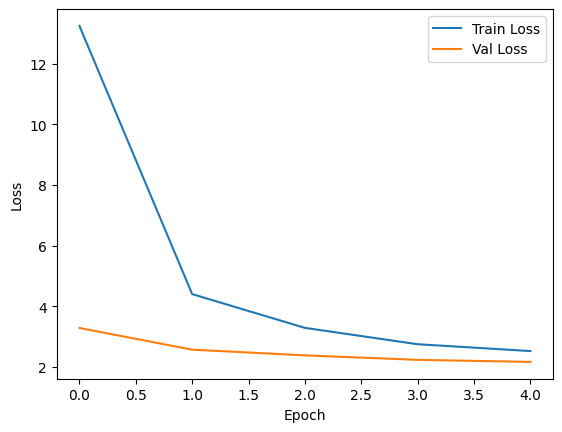

Test Loss: 2.1722


In [7]:
# Plot losses
plt.plot(train_losses, label='Train Loss')
plt.plot(val_losses, label='Val Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.show()

# Evaluation on test set
model.eval()
test_loss = 0.0
with torch.no_grad():
    for i in range(0, len(Xte), batch_size):
        inputs = Xte[i:i+batch_size].to(device)
        targets = Yte[i:i+batch_size].to(device)
        logits = model(inputs)
        loss = F.cross_entropy(logits, targets)
        test_loss += loss.item() * len(inputs)
test_loss /= len(Xte)
print(f"Test Loss: {test_loss:.4f}")

# Vision computacional

SEGUIR ACA:
- https://chatgpt.com/share/68719307-b060-8001-af4a-2be19ed7f28e
- https://grok.com/share/bGVnYWN5_41a0d95c-b6d4-438c-baf7-3594f7e4bcb5

## Intro

Cada operación que ejecuta tu red neuronal se reduce finalmente a dos grandes tipos de recursos:

1. **Computación** (operaciones matemáticas → FLOPs)
2. **Memoria** (guardar y mover datos)

**Computación (FLOPs)**

Casi todo en deep learning es multiplicar matrices (**matmul**):

* Multiplicar matrices es realizar miles o millones de pequeñas multiplicaciones y sumas.
* Cada multiplicación/suma individual cuenta como una operación flotante (FLOP).
* Al entrenar, hacemos **muchísimas operaciones** (millones o miles de millones).

Esto convierte a los matmuls en **la operación más costosa** a nivel computacional en redes neuronales.

**Memoria (Memory Usage)**

Cuando entrenás una red neuronal, debés almacenar principalmente estas cosas:

* **Parámetros** (pesos, bias, embeddings)
* **Datos de input**
* **Resultados intermedios** (activaciones para backward)
* **Gradientes** (para actualizar los parámetros)

La memoria se divide en dos categorías:

* **RAM** (CPU memory): es más grande (por ej., 32GB o 64GB), más lenta.
* **VRAM** (GPU memory): más rápida, pero más pequeña (por ej., 12GB, 16GB o 24GB en GPUs comerciales).

---

**Bottlenecks**

1. **Costo de computación (FLOPs) → Matmul**

* Es lo más costoso: Multiplicar matrices enormes muchas veces por segundo.
* Si el modelo es grande (muchas capas, muchas neuronas), el matmul consume casi todo el tiempo.

2. **Acceso y transferencia de memoria**

* Copiar datos desde RAM (CPU) hacia VRAM (GPU) cuesta tiempo.
* Transferencias constantes o muy frecuentes entre memoria principal y GPU ralentizan mucho el proceso.
* Acceso aleatorio a memoria (datos no ordenados) es lento.

3. **Memoria limitada de GPU (VRAM)**

* Si tu batch o modelo no cabe entero en VRAM, tenés que reducir tamaño de batch o modelo.
* Modelos muy grandes requieren técnicas complejas para no saturar memoria GPU.

---

**¿Qué partes del modelo suelen ser más costosas?**

Ordenadas desde la más costosa a menos:

1. **Matmul** (multiplicación de matrices): **Dominante absoluto**.
2. **Embedding lookups**: no cuestan mucho en FLOPs pero consumen mucha memoria (si embedding es muy grande).
3. **LayerNorm, ReLU, Dropout**: operaciones rápidas y simples. Muy poco costosas comparadas a matmul.
4. **Sumas residuales**: extremadamente rápidas (una simple suma).

La razón por la que las operaciones lineales (matmul) dominan es que son millones o miles de millones de multiplicaciones/sumas individuales para cada operación, mientras que ReLU o LayerNorm tienen solo un puñado de operaciones por elemento.

---

**CPU vs GPU:**

* **CPU** (Unidad de Procesamiento Central):

  * Tiene pocos núcleos (4–32 núcleos típicos).
  * Núcleos muy rápidos pero pocas operaciones simultáneas.
  * Excelente para tareas complejas, secuenciales, o irregulares.

* **GPU** (Unidad de Procesamiento Gráfico):

  * Tiene miles de núcleos simples, optimizados para operaciones simples repetitivas y masivas (como matmul).
  * Puede hacer muchísimas multiplicaciones simultáneamente (paralelismo extremo).
  * Acceso más rápido a memoria interna (VRAM), lo que es ideal para cálculos masivos repetitivos.

| CPU ideal para                    | GPU ideal para                             |
| --------------------------------- | ------------------------------------------ |
| Tareas variadas y complejas       | Operaciones repetitivas y paralelas        |
| Pocos datos, mucho control lógico | Grandes matrices, multiplicaciones masivas |
| Mucha memoria, menos velocidad    | Alta velocidad, memoria más limitada       |

Por eso las redes neuronales modernas se entrenan siempre en GPU, especialmente cuando hay matrices muy grandes y muchas operaciones similares en paralelo.



## Matmuls en deep networks

La razón por la que las **multiplicaciones de matrices** dominan en redes neuronales es sencilla:
**Porque literalmente están en todas partes y se repiten una y otra vez**.

---

**Forward**

Si tenemos esta red:

```python
x → Linear → activación → Linear → activación → … → Linear final → logits
```

**Cada capa `Linear` es un matmul:**

Por definición, una capa linear hace exactamente esto:

```python
y = x @ W.T + b
```

Aquí hay un matmul entre el input `x` y los pesos `W`.

Si tu red tiene, por ejemplo:

* **1 capa lineal inicial**
* **8 bloques residuales** (cada bloque tiene otra capa lineal adentro)
* **1 capa lineal final**

Entonces tenés, al menos, **10 matmuls** por cada forward pass (uno inicial + 8 bloques + uno final).

→ **Cada capa lineal añade un matmul completo**.

---

**Backward**

Cada vez que entrenás, hacés un forward pass **y también un backward pass**.

* **Forward pass**: hacés los 10 matmuls que vimos recién.
* **Backward pass**: al retroceder (backpropagation), tenés que hacer también matmuls para calcular los gradientes:

Cada capa lineal requiere **otros 2 matmuls adicionales**:

    1 para calcular gradiente de los pesos (∂L/∂W)
    1 para calcular gradiente del input (∂L/∂x)

Entonces, por cada una de esas **10 capas lineales**:

* **Forward:** 1 matmul
* **Backward:** 2 matmuls más

Total = **3 matmuls por capa lineal por cada paso entrenamiento**.

En nuestro ejemplo (10 capas lineales):

* Forward: 10 matmuls
* Backward: 20 matmuls
* Total: **30 matmuls por cada iteración (batch)**

---

**¿Qué otras operaciones hay que compitan con matmuls?**

Prácticamente ninguna. Las otras operaciones típicas son:

* **Activaciones** (ReLU, tanh, sigmoid):
  → simples operaciones puntuales (por elemento), rápidas.

* **Normalizaciones** (LayerNorm, BatchNorm):
  → pocos cálculos estadísticos simples por fila o columna, rápidos.

* **Dropout**:
  → solo pone ceros aleatorios, rápido y sin cálculos complejos.

Ninguna de estas operaciones implica multiplicaciones masivas entre matrices, por lo que no pueden competir en costo computacional con matmuls.

| Operación                             | Tipo          | Costo en FLOPs | ¿Se repite en backprop? | ¿Qué hace en backward?                                   |
| ------------------------------------- | ------------- | -------------- | ----------------------- | -------------------------------------------------------- |
| Matmul (`x @ W.T`)                    | 💥 Costosa    | Alta           | Sí (2 veces por capa)   | Matmul para ∂L/∂W y ∂L/∂x                                |
| Activaciones (`tanh`, `ReLU`)         | 🧼 Barata     | Baja           | Sí                      | Operación punto a punto (derivada)                       |
| Element-wise ops (`+`, `-`, `*`, `/`) | 🧮 Muy barata | Muy baja       | Sí                      | Se derivan directo (por ejemplo `y = a * b → dy/da = b`) |
| Reducciones (`sum`, `mean`, `max`)    | ⚠️ Cuidado    | Barata         | Sí                      | Se expanden y distribuyen los grads (broadcast inverso)  |


In [ ]:
# MATMULS EN BACKPROP
"""
Si tenemos una red de:
- batch_size = 2
- input_dim = 3
- output_dim = 2

Y hacemos:
y = x @ W.T + b
"""

X = [[1, 2, 3],      # Ejemplo 1
     [4, 5, 6]]      # Ejemplo 2

W = [[1, 0, -1],     # Neurona 1
     [2, 1,  0]]     # Neurona 2


"""Si tenemos dL/dY (que ya viene de adelante):"""
dY_T = [[10, 30],
        [20, 40]]  # [D_out, B]


# GRADIENTES DE LOS WEIGHTS ------------------------------------------------------------
# La red tiene 6 weights porque hay 3 inputs y 2 neuronas. 
# Entonces hay que colapsar los dos ejemplos del batch, sumando los gradientes de cada ejemplo.

"""Si hacemos dY.T @ X, obtenemos dL/dW:"""
dL_dW = [[0, 0, 0], [0, 0, 0]]

"""Gradiente del peso que conecta el input 0 con la neurona 0. Afectan los dos ejemplos del batch, porque ambos se multiplicaron por este peso.
10*1: 
- 10 es el gradiente del loss respecto a la neurona 0 (a la que se conecta este weight) del ejemplo 1
- 1 es el input 0 (a la que se conecta este weight)del ejemplo 1

30*4:
- 30 es el gradiente del loss respecto a la neurona 0 (a la que se conecta este weight) del ejemplo 2
- 4 es el input 0 (a la que se conecta este weight) del ejemplo 2

Se multiplican por la regla de la cadena y porque la derivada parcial de y=x*w respecto a w es x.
Se SUMAN porque son las dos contribuciones que le llega a ese weight.
"""
dL_dW[0][0] = 10*1 + 30*4 # = 10 + 120 = 130 -> 
dL_dW[0][1] = 10*2 + 30*5 # = 20 + 150 = 170
dL_dW[0][2] = 10*3 + 30*6 # = 30 + 180 = 210

dL_dW[1][0] = 20*1 + 40*4 # = 20 + 160 = 180
dL_dW[1][1] = 20*2 + 40*5 # = 40 + 200 = 240
dL_dW[1][2] = 20*3 + 40*6 # = 60 + 240 = 300


# GRADIENTES DE LOS INPUTS ------------------------------------------------------------
# Vamos a tener un gradiente por input (no se colapsan como los weights porque cada input es algo inividual en la red)
# Cada input de cada ejemplo tiene contribucion de las dos neuronas. 
# ACA NADA SE COLAPSA. Las sumas son por las dos neuronas en las que participa el input.

"""Si hacemos dY.T @ W, obtenemos dL/dX:"""
dL_dX = [[0, 0, 0], [0, 0, 0]]

"""Gradiente del input 0 del ejemplo 0. Afecta a las dos neuronas, porque se conecta a ambas.
10*1:
- 10 es el gradiente del loss respecto a la neurona 0
- 1 es el peso que conecta el input 0 con la neurona 0

20*2:
- 20 es el gradiente del loss respecto a la neurona 1
- 2 es el peso que conecta el input 0 con la neurona 1

Se multiplican por la regla de la cadena y porque la derivada parcial de y=x*w respecto a x es w.
Se SUMAN porque son las dos contribuciones (las dos neuronas en las que participa el input) que le llega a ese input.
"""
dL_dX[0][0] = 10*1 + 20*2 # = 10 + 40 = 50
dL_dX[0][1] = 10*0 + 20*1 # = 0 + 20 = 20
dL_dX[0][2] = 10*(-1) + 20*0 # = -10 + 0 = -10

dL_dX[1][0] = 30*1 + 40*2 # = 30 + 80 = 110
dL_dX[1][1] = 30*0 + 40*1 # = 0 + 40 = 40
dL_dX[1][2] = 30*(-1) + 40*0 # = -30 + 0 = -30


## Grafo completo

Red simple para entender los componentes:

- input_size = 2
- batch_size = 2
- layers = 2
- hidden_units = 2
- residual connections
- layernorm
- relu

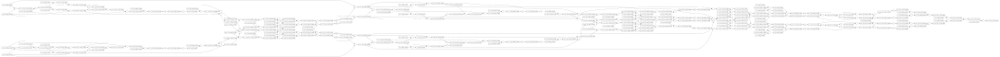

In [9]:
import math
from graphviz import Digraph

def trace(root):
  # builds a set of all nodes and edges in a graph
  nodes, edges = set(), set()
  def build(v):
    if v not in nodes:
      nodes.add(v)
      for child in v._prev:
        edges.add((child, v))
        build(child)
  build(root)
  return nodes, edges

def draw_dot(root):
  dot = Digraph(format='svg', graph_attr={'rankdir': 'LR'}) # LR = left to right
  
  nodes, edges = trace(root)
  for n in nodes:
    uid = str(id(n))
    # for any value in the graph, create a rectangular ('record') node for it
    dot.node(name = uid, label = "{ %s | data %.4f | grad %.4f }" % (n.label, n.data, n.grad), shape='record')
    if n._op:
      # if this value is a result of some operation, create an op node for it
      dot.node(name = uid + n._op, label = n._op)
      # and connect this node to it
      dot.edge(uid + n._op, uid)

  for n1, n2 in edges:
    # connect n1 to the op node of n2
    dot.edge(str(id(n1)), str(id(n2)) + n2._op)

  dot.attr(size='15')
  return dot

class Value:
    def __init__(self, data, _children=(), _op='', label=''):
        self.data = data
        self.grad = 0
        self._backward = lambda: None
        self._prev = set(_children)
        self._op = _op
        self.label = label

    def __add__(self, other):
        other = other if isinstance(other, Value) else Value(other)
        out = Value(self.data + other.data, (self, other), '+')
        def _backward():
            self.grad += out.grad
            other.grad += out.grad
        out._backward = _backward
        return out

    def __mul__(self, other):
        other = other if isinstance(other, Value) else Value(other)
        out = Value(self.data * other.data, (self, other), '*')
        def _backward():
            self.grad += other.data * out.grad
            other.grad += self.data * out.grad
        out._backward = _backward
        return out

    def __pow__(self, other):
        assert isinstance(other, (int, float)), "solo se soportan potencias int/float por ahora"
        out = Value(self.data**other, (self,), f'**{other}')
        def _backward():
            self.grad += (other * self.data**(other-1)) * out.grad
        out._backward = _backward
        return out

    def relu(self):
        out = Value(0 if self.data < 0 else self.data, (self,), 'ReLU')
        def _backward():
            self.grad += (out.data > 0) * out.grad
        out._backward = _backward
        return out
    
    def exp(self):
        x = self.data
        out = Value(math.exp(x), (self, ), 'exp')
        def _backward():
            self.grad += out.data * out.grad
        out._backward = _backward
        return out

    def log(self):
        out = Value(math.log(self.data), (self,), 'log')
        def _backward():
            self.grad += (1 / self.data) * out.grad
        out._backward = _backward
        return out

    def backward(self):
        topo = []
        visited = set()
        def build_topo(v):
            if v not in visited:
                visited.add(v)
                for child in v._prev:
                    build_topo(child)
                topo.append(v)
        build_topo(self)
        self.grad = 1
        for v in reversed(topo):
            v._backward()

    def __neg__(self): return self * -1
    def __radd__(self, other): return self + other
    def __sub__(self, other): return self + (-other)
    def __rsub__(self, other): return other + (-self)
    def __rmul__(self, other): return self * other
    def __truediv__(self, other): return self * other**-1
    def __rtruediv__(self, other): return other * self**-1
    def __repr__(self): return f"(label={self.label}, data={self.data}, grad={self.grad})"

# Función para LayerNorm (escalar, para vectores de tamaño 2)
def layer_norm(x1, x2, gamma1, gamma2, beta1, beta2, eps, prefix):
    # Suma de entradas
    sum_x = x1 + x2
    sum_x.label = prefix + 'sum_x'
    
    # Media
    half = Value(0.5, label=prefix + '0.5_mean')
    mean = sum_x * half
    mean.label = prefix + 'mean'
    
    # Diferencias
    diff1 = x1 - mean
    diff1.label = prefix + 'diff1'
    diff2 = x2 - mean
    diff2.label = prefix + 'diff2'
    
    # Cuadrados
    sq1 = diff1 ** 2
    sq1.label = prefix + 'sq1'
    sq2 = diff2 ** 2
    sq2.label = prefix + 'sq2'
    
    # Suma de cuadrados
    sum_sq = sq1 + sq2
    sum_sq.label = prefix + 'sum_sq'
    
    # Varianza
    var = sum_sq * half
    var.label = prefix + 'var'
    
    # Varianza + eps
    eps_v = Value(eps, label=prefix + 'eps')
    var_eps = var + eps_v
    var_eps.label = prefix + 'var_eps'
    
    # Std (sqrt)
    std = var_eps ** 0.5
    std.label = prefix + 'std'
    
    # 1 / std
    one = Value(1.0, label=prefix + '1.0')
    inv_std = one / std
    inv_std.label = prefix + 'inv_std'
    
    # Normalizados
    norm1 = diff1 * inv_std
    norm1.label = prefix + 'norm1'
    norm2 = diff2 * inv_std
    norm2.label = prefix + 'norm2'
    
    # Aplicar gamma y beta
    g_norm1 = norm1 * gamma1
    g_norm1.label = prefix + 'g_norm1'
    out1 = g_norm1 + beta1
    out1.label = prefix + 'out1'
    
    g_norm2 = norm2 * gamma2
    g_norm2.label = prefix + 'g_norm2'
    out2 = g_norm2 + beta2
    out2.label = prefix + 'out2'
    
    return out1, out2

# Constantes
EPS = 1e-8

# === INPUTS ===
# Batch 1
x1_1 = Value(2.0, label='x1_1')
x1_2 = Value(0.5, label='x1_2')
y1_1 = Value(1.0, label='y1_1')
y1_2 = Value(0.0, label='y1_2')

# Batch 2
x2_1 = Value(1.2, label='x2_1')
x2_2 = Value(-0.3, label='x2_2')
y2_1 = Value(0.0, label='y2_1')
y2_2 = Value(1.0, label='y2_2')

# === PESOS COMPARTIDOS ===
# Layer 1
w1_11 = Value(-0.4, label='w1_11')
w1_12 = Value(1.0, label='w1_12')
w1_21 = Value(0.2, label='w1_21')
w1_22 = Value(-0.5, label='w1_22')
b1_1 = Value(0.1, label='b1_1')
b1_2 = Value(-0.4, label='b1_2')
gamma1_1 = Value(1.0, label='gamma1_1')
gamma1_2 = Value(1.0, label='gamma1_2')
beta1_1 = Value(0.0, label='beta1_1')
beta1_2 = Value(0.0, label='beta1_2')

# Layer 2
w2_11 = Value(0.3, label='w2_11')
w2_12 = Value(-0.6, label='w2_12')
w2_21 = Value(0.7, label='w2_21')
w2_22 = Value(0.4, label='w2_22')
b2_1 = Value(0.2, label='b2_1')
b2_2 = Value(-0.1, label='b2_2')
gamma2_1 = Value(1.0, label='gamma2_1')
gamma2_2 = Value(1.0, label='gamma2_2')
beta2_1 = Value(0.0, label='beta2_1')
beta2_2 = Value(0.0, label='beta2_2')

# Output layer
wo_11 = Value(-0.7, label='wo_11')
wo_12 = Value(1.0, label='wo_12')
wo_21 = Value(0.6, label='wo_21')
wo_22 = Value(-1.0, label='wo_22')
bo_1 = Value(0.8, label='bo_1')
bo_2 = Value(-0.3, label='bo_2')

# === FORWARD BATCH 1 ===
# Input
in1_1 = x1_1
in1_2 = x1_2

# Layer 1: Layernorm
norm1_1_1, norm1_1_2 = layer_norm(in1_1, in1_2, gamma1_1, gamma1_2, beta1_1, beta1_2, EPS, 's1_l1_')

# Layer 1: Linear
mul1_11 = norm1_1_1 * w1_11
mul1_11.label = 's1_l1_mul11'
mul1_21 = norm1_1_2 * w1_21
mul1_21.label = 's1_l1_mul21'
add1_1 = mul1_11 + mul1_21
add1_1.label = 's1_l1_add1'
h1_1_pre = add1_1 + b1_1
h1_1_pre.label = 's1_h1_1_pre'

mul1_12 = norm1_1_1 * w1_12
mul1_12.label = 's1_l1_mul12'
mul1_22 = norm1_1_2 * w1_22
mul1_22.label = 's1_l1_mul22'
add1_2 = mul1_12 + mul1_22
add1_2.label = 's1_l1_add2'
h1_2_pre = add1_2 + b1_2
h1_2_pre.label = 's1_h1_2_pre'

# Layer 1: ReLU
act1_1 = h1_1_pre.relu()
act1_1.label = 's1_act1_1'
act1_2 = h1_2_pre.relu()
act1_2.label = 's1_act1_2'

# Layer 1: Residual
res1_1 = act1_1 + in1_1
res1_1.label = 's1_res1_1'
res1_2 = act1_2 + in1_2
res1_2.label = 's1_res1_2'

# Layer 2: Layernorm
norm2_1_1, norm2_1_2 = layer_norm(res1_1, res1_2, gamma2_1, gamma2_2, beta2_1, beta2_2, EPS, 's1_l2_')

# Layer 2: Linear
mul2_11 = norm2_1_1 * w2_11
mul2_11.label = 's1_l2_mul11'
mul2_21 = norm2_1_2 * w2_21
mul2_21.label = 's1_l2_mul21'
add2_1 = mul2_11 + mul2_21
add2_1.label = 's1_l2_add1'
h2_1_pre = add2_1 + b2_1
h2_1_pre.label = 's1_h2_1_pre'

mul2_12 = norm2_1_1 * w2_12
mul2_12.label = 's1_l2_mul12'
mul2_22 = norm2_1_2 * w2_22
mul2_22.label = 's1_l2_mul22'
add2_2 = mul2_12 + mul2_22
add2_2.label = 's1_l2_add2'
h2_2_pre = add2_2 + b2_2
h2_2_pre.label = 's1_h2_2_pre'

# Layer 2: ReLU
act2_1 = h2_1_pre.relu()
act2_1.label = 's1_act2_1'
act2_2 = h2_2_pre.relu()
act2_2.label = 's1_act2_2'

# Layer 2: Residual
res2_1 = act2_1 + res1_1
res2_1.label = 's1_res2_1'
res2_2 = act2_2 + res1_2
res2_2.label = 's1_res2_2'

# Output: Linear
omul_11 = res2_1 * wo_11
omul_11.label = 's1_o_mul11'
omul_21 = res2_2 * wo_21
omul_21.label = 's1_o_mul21'
oadd_1 = omul_11 + omul_21
oadd_1.label = 's1_o_add1'
logit1_1 = oadd_1 + bo_1
logit1_1.label = 'logit1_1'

omul_12 = res2_1 * wo_12
omul_12.label = 's1_o_mul12'
omul_22 = res2_2 * wo_22
omul_22.label = 's1_o_mul22'
oadd_2 = omul_12 + omul_22
oadd_2.label = 's1_o_add2'
logit1_2 = oadd_2 + bo_2
logit1_2.label = 'logit1_2'

# Softmax
max_logit1 = Value(max(logit1_1.data, logit1_2.data), label='max_logit1')
shift1_1 = logit1_1 - max_logit1
shift1_1.label = 'shift1_1'
shift1_2 = logit1_2 - max_logit1
shift1_2.label = 'shift1_2'
exp1_1 = shift1_1.exp()
exp1_1.label = 'exp1_1'
exp1_2 = shift1_2.exp()
exp1_2.label = 'exp1_2'
sum_exp1 = exp1_1 + exp1_2
sum_exp1.label = 'sum_exp1'
prob1_1 = exp1_1 / sum_exp1
prob1_1.label = 'prob1_1'
prob1_2 = exp1_2 / sum_exp1
prob1_2.label = 'prob1_2'

# Log probs + EPS
eps_v = Value(EPS, label='eps')
prob_eps1_1 = prob1_1 + eps_v
prob_eps1_1.label = 'prob_eps1_1'
prob_eps1_2 = prob1_2 + eps_v
prob_eps1_2.label = 'prob_eps1_2'
logp1_1 = prob_eps1_1.log()
logp1_1.label = 'logp1_1'
logp1_2 = prob_eps1_2.log()
logp1_2.label = 'logp1_2'

# Cross-entropy
ylog1_1 = y1_1 * logp1_1
ylog1_1.label = 'ylog1_1'
ylog1_2 = y1_2 * logp1_2
ylog1_2.label = 'ylog1_2'
sum_ylog1 = ylog1_1 + ylog1_2
sum_ylog1.label = 'sum_ylog1'
neg_sum1 = -sum_ylog1
neg_sum1.label = 'neg_sum1'
loss1 = neg_sum1  # alias
loss1.label = 'loss1'

# === FORWARD BATCH 2 ===
# Input
in2_1 = x2_1
in2_2 = x2_2

# Layer 1: Layernorm
norm1_2_1, norm1_2_2 = layer_norm(in2_1, in2_2, gamma1_1, gamma1_2, beta1_1, beta1_2, EPS, 's2_l1_')

# Layer 1: Linear
mul1_11_s2 = norm1_2_1 * w1_11
mul1_11_s2.label = 's2_l1_mul11'
mul1_21_s2 = norm1_2_2 * w1_21
mul1_21_s2.label = 's2_l1_mul21'
add1_1_s2 = mul1_11_s2 + mul1_21_s2
add1_1_s2.label = 's2_l1_add1'
h1_1_pre_s2 = add1_1_s2 + b1_1
h1_1_pre_s2.label = 's2_h1_1_pre'

mul1_12_s2 = norm1_2_1 * w1_12
mul1_12_s2.label = 's2_l1_mul12'
mul1_22_s2 = norm1_2_2 * w1_22
mul1_22_s2.label = 's2_l1_mul22'
add1_2_s2 = mul1_12_s2 + mul1_22_s2
add1_2_s2.label = 's2_l1_add2'
h1_2_pre_s2 = add1_2_s2 + b1_2
h1_2_pre_s2.label = 's2_h1_2_pre'

# Layer 1: ReLU
act1_1_s2 = h1_1_pre_s2.relu()
act1_1_s2.label = 's2_act1_1'
act1_2_s2 = h1_2_pre_s2.relu()
act1_2_s2.label = 's2_act1_2'

# Layer 1: Residual
res1_1_s2 = act1_1_s2 + in2_1
res1_1_s2.label = 's2_res1_1'
res1_2_s2 = act1_2_s2 + in2_2
res1_2_s2.label = 's2_res1_2'

# Layer 2: Layernorm
norm2_2_1, norm2_2_2 = layer_norm(res1_1_s2, res1_2_s2, gamma2_1, gamma2_2, beta2_1, beta2_2, EPS, 's2_l2_')

# Layer 2: Linear
mul2_11_s2 = norm2_2_1 * w2_11
mul2_11_s2.label = 's2_l2_mul11'
mul2_21_s2 = norm2_2_2 * w2_21
mul2_21_s2.label = 's2_l2_mul21'
add2_1_s2 = mul2_11_s2 + mul2_21_s2
add2_1_s2.label = 's2_l2_add1'
h2_1_pre_s2 = add2_1_s2 + b2_1
h2_1_pre_s2.label = 's2_h2_1_pre'

mul2_12_s2 = norm2_2_1 * w2_12
mul2_12_s2.label = 's2_l2_mul12'
mul2_22_s2 = norm2_2_2 * w2_22
mul2_22_s2.label = 's2_l2_mul22'
add2_2_s2 = mul2_12_s2 + mul2_22_s2
add2_2_s2.label = 's2_l2_add2'
h2_2_pre_s2 = add2_2_s2 + b2_2
h2_2_pre_s2.label = 's2_h2_2_pre'

# Layer 2: ReLU
act2_1_s2 = h2_1_pre_s2.relu()
act2_1_s2.label = 's2_act2_1'
act2_2_s2 = h2_2_pre_s2.relu()
act2_2_s2.label = 's2_act2_2'

# Layer 2: Residual
res2_1_s2 = act2_1_s2 + res1_1_s2
res2_1_s2.label = 's2_res2_1'
res2_2_s2 = act2_2_s2 + res1_2_s2
res2_2_s2.label = 's2_res2_2'

# Output: Linear
omul_11_s2 = res2_1_s2 * wo_11
omul_11_s2.label = 's2_o_mul11'
omul_21_s2 = res2_2_s2 * wo_21
omul_21_s2.label = 's2_o_mul21'
oadd_1_s2 = omul_11_s2 + omul_21_s2
oadd_1_s2.label = 's2_o_add1'
logit2_1 = oadd_1_s2 + bo_1
logit2_1.label = 'logit2_1'

omul_12_s2 = res2_1_s2 * wo_12
omul_12_s2.label = 's2_o_mul12'
omul_22_s2 = res2_2_s2 * wo_22
omul_22_s2.label = 's2_o_mul22'
oadd_2_s2 = omul_12_s2 + omul_22_s2
oadd_2_s2.label = 's2_o_add2'
logit2_2 = oadd_2_s2 + bo_2
logit2_2.label = 'logit2_2'

# Softmax
max_logit2 = Value(max(logit2_1.data, logit2_2.data), label='max_logit2')
shift2_1 = logit2_1 - max_logit2
shift2_1.label = 'shift2_1'
shift2_2 = logit2_2 - max_logit2
shift2_2.label = 'shift2_2'
exp2_1 = shift2_1.exp()
exp2_1.label = 'exp2_1'
exp2_2 = shift2_2.exp()
exp2_2.label = 'exp2_2'
sum_exp2 = exp2_1 + exp2_2
sum_exp2.label = 'sum_exp2'
prob2_1 = exp2_1 / sum_exp2
prob2_1.label = 'prob2_1'
prob2_2 = exp2_2 / sum_exp2
prob2_2.label = 'prob2_2'

# Log probs + EPS
prob_eps2_1 = prob2_1 + eps_v
prob_eps2_1.label = 'prob_eps2_1'
prob_eps2_2 = prob2_2 + eps_v
prob_eps2_2.label = 'prob_eps2_2'
logp2_1 = prob_eps2_1.log()
logp2_1.label = 'logp2_1'
logp2_2 = prob_eps2_2.log()
logp2_2.label = 'logp2_2'

# Cross-entropy
ylog2_1 = y2_1 * logp2_1
ylog2_1.label = 'ylog2_1'
ylog2_2 = y2_2 * logp2_2
ylog2_2.label = 'ylog2_2'
sum_ylog2 = ylog2_1 + ylog2_2
sum_ylog2.label = 'sum_ylog2'
neg_sum2 = -sum_ylog2
neg_sum2.label = 'neg_sum2'
loss2 = neg_sum2
loss2.label = 'loss2'

# Mean loss
sum_loss = loss1 + loss2
sum_loss.label = 'sum_loss'
mean_factor = Value(0.5, label='1/2')
mean_loss = sum_loss * mean_factor
mean_loss.label = 'mean_loss'

# Para visualizar el grafo
draw_dot(mean_loss)

## FLOP count en matmul

**¿Qué significa multiplicar dos matrices?**

Supongamos que tenés esto en PyTorch:

```python
y = x @ W.T
```

Y los tamaños son:

* `x`: `[32, 30]` → (32 ejemplos, cada uno con 30 features)
* `W`: `[64, 30]` → (64 neuronas, cada una espera 30 inputs)

Esto te da como salida:

* `y`: `[32, 64]` → cada uno de los 32 ejemplos tiene 64 salidas (logits o activaciones)

---

**¿Qué se hace para calcular **un solo número** del resultado?**

Ejemplo: para calcular el valor que está en la fila 3, columna 20 del resultado…

Lo que hacés es:

1. **Tomás la fila 3 del input** → es un vector de tamaño 30
2. **Tomás la fila 20 de los pesos (de W)** → también es un vector de 30
3. Multiplicás cada elemento entre sí:

   * `input[3][0] * weight[20][0]`
   * `input[3][1] * weight[20][1]`
   * ...
   * `input[3][29] * weight[20][29]`
4. Después sumás todos esos 30 productos

Eso es lo que se llama un **producto punto**: multiplicar y sumar.

> 🔸 Eso son **30 multiplicaciones** y **29 sumas** (en la práctica se cuentan como 60 FLOPs)

---

¿Y si quiero todo el output?

Bueno, el resultado tiene 32×64 posiciones = 2.048 valores a calcular
Y para cada uno se hace exactamente eso: multiplicar dos vectores de tamaño 30 y sumarlos.

Entonces:

* Hay 32×64 = 2.048 valores a calcular
* Y para cada uno hacés ≈ 60 operaciones

Entonces:
**FLOPs totales ≈ 2.048 × 60 ≈ 123 mil**

---

¿Por qué usamos esta fórmula?

Para no tener que hacer toda esta cuenta a mano, usamos esta fórmula rápida:

```
FLOPs = 2 × batch × input_dim × output_dim
```

* El 2 está porque por cada par de números hacés una multiplicación y una suma.
* El resto viene de los tamaños de las matrices. 


In [ ]:
2*32*30*64 # 2 * batch_size * input_dim * output_dim

122880

## Aritmetica de FLOPs y memoria

**Cálculo de FLOPs y Memoria en la Red Neuronal**

Tu red es un MLP simple con:
- input_size = 30
- dos capas ocultas (con BatchNorm, tanh, dropout)
- una conexión residual
- salida softmax. 

Usando los parámetros actuales (`vocab_size=27`, `block_size=3`, `n_embd=10`, `n_hidden=64`, `batch_size=32`), calculé los FLOPs (operaciones de punto flotante) y el uso de memoria basándome en las operaciones del forward y backward pass. Estos cálculos son aproximados, ya que ignoran overheads menores (como indexing o copias implícitas), pero capturan lo esencial. Asumí float32 (4 bytes por elemento) para la memoria.

---

**Cómo Llegar a los Cálculos (Metodología)**

Para FLOPs:
- **Matmul (A @ B)**: Si A es (m, k) y B es (k, n), FLOPs = 2 * m * k * n (una multiplicación y una suma por elemento del resultado).
- **Operaciones elementales (add, mul, sub, div, exp, log, tanh, etc.)**: 1 FLOP por elemento del tensor.
- **Reducciones (sum, mean, var, max)**: Aproximadamente igual al número de elementos (ignorando el -1 en adds exactos).
- **BatchNorm**: Desglosado en sub (N*H), sq (N*H), sum (N*H), div (H), sqrt (H), etc.
- **Softmax**: Desglosado en max (N*V), sub (N*V), exp (N*V), sum (N*V), inv (N), mul (N*V), log (N*V).
- **Dropout**: Rand (N*H), compare (N*H), mul (N*H), div (N*H) ≈ 4 * N*H.
- **Backward**: Similar, pero con regla de cadena (multiplicaciones elementales, matmuls transpuestos, sums).
- Total: Suma de todas las ops en forward + backward. Backward suele ser ~2x forward por las derivadas adicionales.

Para memoria:
La memoria se calcula sumando elementos (numel) de tensores y multiplicando por 4 bytes (float32). Ignoro ints (como Xb/Yb, negligible) y me enfoco en persistentes/retenidos; temporales (e.g., en BN var calc ~8 KB) se liberan rápidamente, pero pueden aumentar el pico. No incluyo overhead de PyTorch (e.g., metadatos).

- **Parámetros (pesos y biases)**: 8,425 elementos, ~33.7 KB.  
  (Cálculo: C (27*10=270) + W1 (30*64=1,920) + b1 (64) + W2 (64*64=4,096) + b2 (64) + W3 (64*27=1,728) + b3 (27) + bngain1/bnbias1/bngain2/bnbias2 (64 cada uno, total 256) = 8,425. Estos se cargan una vez y persisten.)

- **Activaciones (forward pass, tensores retenidos para backprop)**: ~27,072 elementos, ~108.3 KB.  
  (Basado en la lista de retain_grad: 5 tensores 32x27 (~4,320 elem), 3 de 32x1 (96), 10 de 32x64 (~20,480), 4 de 1x64 (256), 2 de 32x30 o equiv (~1,920). Estos son los principales; en pico, durante forward, ~ similar ya que muchos se sobreescriben.)

- **Gradientes (de parámetros, computados en backward)**: ~33.7 KB (mismo que parámetros, uno por param).

- **Gradientes intermedios y temporales en backward**: Similar a activaciones, ~108 KB adicionales (dlogits, dhres, dh2pre, etc., con shapes parecidos).  
  (Ej.: dlogits 32x27 ~3.5 KB, dhres 32x64 ~8 KB, etc. Pico durante backprop puede duplicar las activaciones.)

- **Total aproximado por batch**: ~200-250 KB (parámetros + grads + activaciones + algunos temporales).  
  (En práctica, PyTorch optimiza reutilizando memoria, así que pico real ~150-200 KB. Para batches más grandes o GPUs, escalaría lineal con batch_size. Cálculo: sumé numel de todos los tensores mencionados en comentarios, ajustando por retenidos; temporales agregan ~20-30% al pico pero no persisten.)


Resultados actuales:
- **Parámetros totales**: 8,425 (e.g., W2 es 64*64=4,096; W1 es 30*64=1,920; C es 27*10=270; etc.).
- **Memoria para parámetros**: 33,700 bytes.
- **Memoria para gradientes**: 33,700 bytes.
- **Memoria para activaciones (aprox., todos retenidos)**: 108,288 bytes (e.g., muchos tensores de (32,64)=2,048 elementos; logits (32,27)=864).
- **FLOPs forward**: 684,320 (dominado por matmuls: layer1 ~122k, layer2 ~262k, residual ~122k, output ~110k; el resto son elementales ~100k).
- **FLOPs backward**: 1,387,968 (más elementales, pero matmuls similares: e.g., dW3 ~110k, dhres ~110k, etc.).
- **FLOPs totales por batch (forward + backward)**: 2,072,288.

Estos números son por batch (32 ejemplos). Para training completo, multiplica por iteraciones/epocas. En hardware moderno (e.g., GPU), esto es trivial (~2M FLOPs es nada; una A100 hace ~10^15 FLOPs/seg), pero escala con tamaños mayores.


**Operaciones paso a paso**

De la misma red

In [1]:
import torch
import torch.nn.functional as F
import matplotlib.pyplot as plt # for making figures
%matplotlib inline

# read in all the words
words = open('data/names.txt', 'r').read().splitlines()
print(len(words))
print(max(len(w) for w in words))
print(words[:8])

# build the vocabulary of characters and mappings to/from integers
chars = sorted(list(set(''.join(words))))
stoi = {s:i+1 for i,s in enumerate(chars)}
stoi['.'] = 0
itos = {i:s for s,i in stoi.items()}
vocab_size = len(itos)
print(itos)
print(vocab_size)

# build the dataset
block_size = 3 # context length: how many characters do we take to predict the next one?

def build_dataset(words):  
  X, Y = [], []
  
  for w in words:
    context = [0] * block_size
    for ch in w + '.':
      ix = stoi[ch]
      X.append(context)
      Y.append(ix)
      context = context[1:] + [ix] # crop and append

  X = torch.tensor(X)
  Y = torch.tensor(Y)
  print(X.shape, Y.shape)
  return X, Y

import random
random.seed(42)
random.shuffle(words)
n1 = int(0.8*len(words))
n2 = int(0.9*len(words))

Xtr,  Ytr  = build_dataset(words[:n1])     # 80%
Xdev, Ydev = build_dataset(words[n1:n2])   # 10%
Xte,  Yte  = build_dataset(words[n2:])     # 10%

32033
15
['emma', 'olivia', 'ava', 'isabella', 'sophia', 'charlotte', 'mia', 'amelia']
{1: 'a', 2: 'b', 3: 'c', 4: 'd', 5: 'e', 6: 'f', 7: 'g', 8: 'h', 9: 'i', 10: 'j', 11: 'k', 12: 'l', 13: 'm', 14: 'n', 15: 'o', 16: 'p', 17: 'q', 18: 'r', 19: 's', 20: 't', 21: 'u', 22: 'v', 23: 'w', 24: 'x', 25: 'y', 26: 'z', 0: '.'}
27
torch.Size([182625, 3]) torch.Size([182625])
torch.Size([22655, 3]) torch.Size([22655])
torch.Size([22866, 3]) torch.Size([22866])


In [2]:
def cmp(s, dt, t):
  ex = torch.all(dt == t.grad).item()
  app = torch.allclose(dt, t.grad)
  maxdiff = (dt - t.grad).abs().max().item()
  print(f'{s:15s} | exact: {str(ex):5s} | approximate: {str(app):5s} | maxdiff: {maxdiff}')


In [7]:
n_embd = 10
n_hidden = 64

g = torch.Generator().manual_seed(2147483647)

# Embedding matrix: vocab_size x embedding_dim
C = torch.randn((vocab_size, n_embd), generator=g)

# Pesos capa 1: transforma input plano en hidden
W1 = torch.randn((n_embd * block_size, n_hidden), generator=g) * (5/3)/((n_embd * block_size)**0.5)
b1 = torch.randn(n_hidden, generator=g) * 0.1

# BatchNorm capa 1
bngain1 = torch.randn((1, n_hidden)) * 0.1 + 1.0
bnbias1 = torch.randn((1, n_hidden)) * 0.1

# Pesos capa 2: second hidden layer
W2 = torch.randn((n_hidden, n_hidden), generator=g) * (5/3)/(n_hidden**0.5)
b2 = torch.randn(n_hidden, generator=g) * 0.1

# BatchNorm capa 2
bngain2 = torch.randn((1, n_hidden)) * 0.1 + 1.0
bnbias2 = torch.randn((1, n_hidden)) * 0.1

# Output layer
W3 = torch.randn((n_hidden, vocab_size), generator=g) * 0.1
b3 = torch.randn(vocab_size, generator=g) * 0.1

parameters = [C, W1, b1, W2, b2, W3, b3, bngain1, bnbias1, bngain2, bnbias2]
for p in parameters:
  p.requires_grad = True

In [8]:
# forward pass
batch_size = 32
ix = torch.randint(0, Xtr.shape[0], (batch_size,), generator=g)
Xb, Yb = Xtr[ix], Ytr[ix]
n = batch_size

"""Empezamos el forward pass. Primero, tomamos los índices de los caracteres en el batch (Xb es como una matriz de batch_size x block_size, cada fila son 3 índices de chars, por ejemplo, si block_size=3).
C es nuestra tabla de embeddings, como un diccionario donde cada char tiene un vector de n_embd dimensiones (aquí n_embd=10, suponiendo).
Entonces emb es mirar en esa tabla para cada índice: resultado es batch x block_size x n_embd, como un tensor 3D de vectores, donde cada posición en el contexto tiene su embedding.
Esto es básicamente una búsqueda en una tabla, sin cálculos pesados, solo indexación.
Tipo de operación: Embedding lookup (búsqueda en tabla de embeddings). Es de tipo lookup porque no involucra multiplicaciones o sumas aritméticas reales, solo accede a memoria basada en índices.
FLOPs: Negligible (operación de indexación, sin aritmética). No contamos FLOPs aquí porque es puramente acceso a memoria, no hay multiplicaciones o adiciones flotantes.
Memoria: Tensor emb de shape (32, 3, 10), numel=32*3*10=960 elementos, bytes=3840 (asumiendo float32, que usa 4 bytes por elemento). Este tensor almacena los embeddings extraídos, y su tamaño viene directamente del batch_size (32), el block_size (3) y n_embd (10)."""
emb = C[Xb]

"""Ahora, para alimentar a la red, necesitamos aplanar los embeddings por ejemplo: juntar los 3 vectores en uno solo de tamaño block_size * n_embd (aquí 3*10=30).
Usamos view para reshapear sin copiar memoria: emb.shape[0] es batch_size, -1 significa 'infiera el resto' (calcula automáticamente 30).
Esto es útil porque no gasta memoria extra ni tiempo en copiar datos, solo cambia cómo se ve el tensor.
Tipo de operación: View/reshape (reorganización de la forma del tensor). Es de este tipo porque solo modifica los metadatos del tensor (como strides y shape), sin tocar los datos subyacentes.
FLOPs: 0 (no hay cómputo, solo cambio de metadatos). No involucra ninguna operación aritmética, por eso cero FLOPs.
Memoria: Tensor embcat de shape (32, 30), numel=32*30=960, bytes=3840 (mismo que emb, sin copia de datos). El numel es igual porque es el mismo tensor visto de otra forma, no se crea nuevo espacio en memoria."""
embcat = emb.view(emb.shape[0], -1)

# ------ Capa oculta 1 ------
"""Primera capa lineal: tomamos el input plano (embcat), lo multiplicamos por la matriz de pesos W1 (que proyecta de input_dim=30 a n_hidden=64),
y sumamos el bias b1 (un vector por neurona, de tamaño 64). Esto es como una transformación afín: h1pre es las activaciones pre-activación, listas para la no linealidad.
Piensa en esto como cada neurona calculando una suma ponderada de los inputs más un sesgo.
Tipo de operación: Matrix multiplication + bias addition (multiplicación matricial más adición de bias con broadcast). Es multiplicación matricial porque embcat (32x30) @ W1 (30x64) da 32x64, y bias se suma broadcastando a cada fila.
FLOPs: Matmul: 2 * 32 * 30 * 64 = 122880 (el 2 viene porque cada elemento de salida requiere una multiplicación y una adición por cada entrada, así que 2 ops por par mul-add; 32 filas batch, 30 dims input, 64 dims output); 
Add: 32 * 64 = 2048 (suma por cada elemento de salida). Total: 122880 + 2048 = 124928. Explicamos el 2 en matmul porque en hardware, mul-add cuenta como una, pero convencionalmente en FLOPs se cuenta como 2 operaciones flotantes.
Memoria: Tensor h1pre de shape (32, 64), numel=32*64=2048, bytes=8192 (float32, 4 bytes/elem). Este tamaño viene del batch y n_hidden; es el output de la capa."""
h1pre = embcat @ W1 + b1

"""BatchNorm: para estabilizar el training, normalizamos las activaciones. Primero calculamos la media de h1pre a lo largo del batch (dim=0),
por cada feature (cada columna, es decir cada neurona). keepdim=True para que quede (1, n_hidden) y se pueda broadcast fácilmente después.
Esto centra las activaciones alrededor de cero por feature.
Tipo de operación: Mean reduction (reducción de media a través de la dimensión batch). Es una reducción porque suma todos los valores por columna y divide por el número de elementos (batch_size=32).
FLOPs: Aprox 32 * 64 = 2048 (suma por columna) + 64 (división por N=32 por cada feature). Total: ~2112. El 32*64 es para sumar los elementos, y +64 para las divisiones finales.
Memoria: Tensor bnmean1 de shape (1, 64), numel=64, bytes=256. Pequeño porque es una media por feature, independiente del batch."""
bnmean1 = h1pre.mean(0, keepdim=True)

"""Similar para la varianza: medimos cuánto varían las activaciones por feature en el batch. unbiased=False porque en BN usamos la varianza de la muestra dividida por N (no N-1),
para que sea consistente con el training y evite sesgos en pequeños batches.
Esto mide la dispersión de los datos por columna.
Tipo de operación: Variance reduction (resta de media, cuadrado, suma, división). Es reducción porque involucra operaciones element-wise y luego suma por columna.
FLOPs: Sub: 32*64=2048 (resta media broadcast); Sq: 2048 (cuadrado element-wise); Sum: 2048 (suma por columna); Div: 64 (div por N por feature). 
  Total: ~6208. Los números vienen de operar en cada elemento (32x64) para sub, sq, sum, y luego div por feature (64).
Memoria: Tensor bnvar1 de shape (1, 64), numel=64, bytes=256. Temporales: ~8192 bytes (para tensores intermedios como sub y sq durante cálculo)."""
bnvar1 = h1pre.var(0, unbiased=False, keepdim=True)

"""Normalización: restamos la media (centramos en 0), dividimos por la std (sqrt(var + eps), eps para evitar división por 0 si var es muy chica).
Esto hace que las activaciones tengan media 0 y varianza 1, ayudando al gradiente flow.
Tipo de operación: Element-wise sub + div (con sqrt en var). Operaciones element-wise porque se aplican por elemento, con broadcast de mean y var.
FLOPs: Add eps: 64 (a cada feature); Sqrt: 64 (por feature); Sub: 32*64=2048; Div: 2048. Total: ~4224. Add y sqrt son por feature (64), sub y div por todo el tensor (2048).
Memoria: Tensor bn1 de shape (32, 64), numel=2048, bytes=8192. Temporales: ~256 bytes (para sqrt(var+eps))."""
bn1 = (h1pre - bnmean1) / torch.sqrt(bnvar1 + 1e-5)

"""Aplicamos los parámetros aprendibles de BN: gain (bngain1) escala la distribución normalizada (inicial cerca de 1), bias (bnbias1) la shiftea (inicial cerca de 0).
Esto permite que la red aprenda si quiere deshacer la normalización o ajustarla, dándole flexibilidad.
Tipo de operación: Element-wise mul + add. Element-wise porque multiplica y suma por elemento, con broadcast de gain y bias.
FLOPs: Mul: 32*64=2048; Add: 2048. Total: 4096. Cada operación en los 2048 elementos.
Memoria: Tensor h1 de shape (32, 64), numel=2048, bytes=8192. Mismo tamaño que input, ya que es transformación in-place like."""
h1 = bngain1 * bn1 + bnbias1

"""Activación: tanh es una función no lineal que aplasta los valores entre -1 y 1, introduciendo no linealidad para que la red pueda aprender funciones complejas.
Sin esto, todo sería lineal y la red no podría capturar patrones no lineales.
Tipo de operación: Element-wise tanh. Element-wise porque se aplica independientemente a cada elemento.
FLOPs: Aprox 32*64=2048 (implementación de tanh ~1-5 ops internas, pero contamos como 1 por elem para simplicidad). Basado en el número de elementos.
Memoria: Tensor h1act de shape (32, 64), numel=2048, bytes=8192. Mismo que input."""
h1act = torch.tanh(h1)

"""Dropout: para regularizar y evitar overfitting, durante training aleatoriamente 'apagamos' (ponemos a 0) algunas neuronas con prob 0.1 (aquí keep prob 0.9).
torch.rand_like genera uniform [0,1), >0.1 es True (keep), float() hace 1.0 o 0.0. Esto simula ensembles de sub-redes.
Tipo de operación: Random generation + comparison + float cast. Generación random por elemento, comparación y casteo.
FLOPs: Rand: 2048 (generar randoms); Compare: 2048; Float: 2048. Total: ~6144. Una op por tipo por elemento.
Memoria: Tensor drop1 de shape (32, 64), numel=2048, bytes=8192. Mismo tamaño para el mask."""
drop1 = (torch.rand_like(h1act) > 0.1).float()

"""Aplicamos el mask: multiplicamos, y dividimos por 0.9 (1/(1-0.1)) para que la expectativa de las activaciones sea la misma que sin dropout (escala up).
Esto mantiene la escala durante training, para no ajustar en inference.
Tipo de operación: Element-wise mul + div (división por escalar). Mul por mask, div por constante.
FLOPs: Mul: 2048; Div: 2048. Total: 4096. Por elemento.
Memoria: Tensor h1drop de shape (32, 64), numel=2048, bytes=8192."""
h1drop = h1act * drop1 / 0.9

# ------ Capa oculta 2 ------
"""Segunda capa lineal: similar a la primera, pero input es h1drop (output de la capa anterior), W2 proyecta de n_hidden=64 a n_hidden=64.
Es otra transformación afín para procesar más las features.
Tipo de operación: Matrix multiplication + bias addition. Igual que la primera capa, pero dims 64x64.
FLOPs: Matmul: 2*32*64*64=262144 (2 por mul-add, 32 batch, 64 in, 64 out); Add: 32*64=2048. Total: 264192.
Memoria: Tensor h2pre de shape (32, 64), numel=2048, bytes=8192."""
h2pre = h1drop @ W2 + b2

"""BatchNorm para la segunda capa: media por feature en el batch. Igual que antes, para normalizar.
Tipo de operación: Mean reduction.
FLOPs: ~2112 (mismo cálculo que bnmean1, 32*64 sum + 64 div).
Memoria: Tensor bnmean2 de shape (1, 64), numel=64, bytes=256."""
bnmean2 = h2pre.mean(0, keepdim=True)

"""Varianza, unbiased=False. Mide dispersión.
Tipo de operación: Variance reduction.
FLOPs: ~6208 (mismo que bnvar1).
Memoria: Tensor bnvar2 de shape (1, 64), numel=64, bytes=256."""
bnvar2 = h2pre.var(0, unbiased=False, keepdim=True)

"""Normalización. Centra y escala a var 1.
Tipo de operación: Element-wise sub + div (with sqrt).
FLOPs: ~4224 (mismo que bn1).
Memoria: Tensor bn2 de shape (32, 64), numel=2048, bytes=8192."""
bn2 = (h2pre - bnmean2) / torch.sqrt(bnvar2 + 1e-5)

"""Gain y bias para BN2. Ajusta la normalización.
Tipo de operación: Element-wise mul + add.
FLOPs: 4096 (mismo que h1).
Memoria: Tensor h2 de shape (32, 64), numel=2048, bytes=8192."""
h2 = bngain2 * bn2 + bnbias2

"""Tanh activación. Introduce no linealidad.
Tipo de operación: Element-wise tanh.
FLOPs: ~2048 (mismo que h1act).
Memoria: Tensor h2act de shape (32, 64), numel=2048, bytes=8192."""
h2act = torch.tanh(h2)

"""Mask de dropout para capa 2. Regularización.
Tipo de operación: Random generation + comparison + float cast.
FLOPs: ~6144 (mismo que drop1).
Memoria: Tensor drop2 de shape (32, 64), numel=2048, bytes=8192."""
drop2 = (torch.rand_like(h2act) > 0.1).float()

"""Aplicar dropout. Escala para mantener expectativa.
Tipo de operación: Element-wise mul + div.
FLOPs: 4096 (mismo que h1drop).
Memoria: Tensor h2drop de shape (32, 64), numel=2048, bytes=8192."""
h2drop = h2act * drop2 / 0.9

"""Conexión residual: para ayudar con el flujo de gradientes en redes profundas, sumamos una 'shortcut' desde el input original.
Aquí, proyectamos embcat con W1 (misma proyección que la primera capa, sin bias) y lo sumamos al output de la segunda capa.
Nota: shapes coinciden porque W1 va a n_hidden (30->64), y h2drop es 64.
Esto previene vanishing gradients al permitir un camino directo.
Tipo de operación: Matrix multiplication + element-wise add (sin bias). Matmul para proyectar residual, add element-wise.
FLOPs: Matmul: 2*32*30*64=122880 (mismo que matmul de capa 1); Add: 2048. Total: 124928.
Memoria: Tensor hres de shape (32, 64), numel=2048, bytes=8192."""
hres = h2drop + embcat @ W1 # mismo shape que h2drop

# ------ Output layer ------
"""Capa final: proyectamos hres a vocab_size (27), para tener logits por clase (próximo char).
Es la proyección a espacio de vocabulario.
Tipo de operación: Matrix multiplication + bias addition.
FLOPs: Matmul: 2*32*64*27=110592 (32 batch, 64 in, 27 out); Add: 32*27=864. Total: 111456.
Memoria: Tensor logits de shape (32, 27), numel=864, bytes=3456 (4*864)."""
logits = hres @ W3 + b3

"""Para softmax estable: encontramos el max por fila (por ejemplo), para restarlo y evitar overflow en exp.
Esto es un truco numérico para estabilidad.
Tipo de operación: Max reduction (per row).
FLOPs: Aprox 32*27=864 (comparaciones para encontrar max en 27 elems por 32 rows).
Memoria: Tensor logit_maxes de shape (32, 1), numel=32, bytes=128."""
logit_maxes = logits.max(1, keepdim=True).values

"""Restamos el max: no cambia las probabilidades, pero numéricamente mejor.
Tipo de operación: Element-wise sub (with broadcast).
FLOPs: 32*27=864 (sub por elem, broadcast desde (32,1) a (32,27)).
Memoria: Tensor norm_logits de shape (32, 27), numel=864, bytes=3456."""
norm_logits = logits - logit_maxes

"""Exp de los normalized logits: convierte a valores positivos.
Tipo de operación: Element-wise exp.
FLOPs: ~864 (exp por elem, aprox 1 op cada uno).
Memoria: Tensor counts de shape (32, 27), numel=864, bytes=3456."""
counts = norm_logits.exp()

"""Suma por fila: total 'counts' por ejemplo, para normalizar después.
Tipo de operación: Sum reduction (per row).
FLOPs: ~864 (sumar 27 elems por 32 rows).
Memoria: Tensor counts_sum de shape (32, 1), numel=32, bytes=128."""
counts_sum = counts.sum(1, keepdim=True)

"""Inverso de la suma: para normalizar multiplicando.
Tipo de operación: Element-wise reciprocal (1/x).
FLOPs: 32 (inv por elem de counts_sum).
Memoria: Tensor counts_sum_inv de shape (32, 1), numel=32, bytes=128."""
counts_sum_inv = counts_sum**-1

"""Softmax: cada count dividido por la suma (usando inverso para multiplicar, más eficiente).
Esto da probabilidades que suman a 1 por fila.
Tipo de operación: Element-wise mul (with broadcast).
FLOPs: 864 (mul por elem, broadcast inv a 27 cols).
Memoria: Tensor probs de shape (32, 27), numel=864, bytes=3456."""
probs = counts * counts_sum_inv

"""Log de probs: para la loss, ya que usamos negative log likelihood.
Tipo de operación: Element-wise log.
FLOPs: ~864 (log por elem).
Memoria: Tensor logprobs de shape (32, 27), numel=864, bytes=3456."""
logprobs = probs.log()

"""Loss: promedio de -logprob en las posiciones correctas (Yb indica el índice target por ejemplo).
Esto mide cuán lejos están las probs del target.
Tipo de operación: Indexing + negation + mean reduction.
FLOPs: Indexing: ~32 (seleccionar 32 valores); Neg: 32; Mean: ~32 (sum + div). Total ~96, aprox 64.
Memoria: Scalar loss, negligible (solo un float)."""
loss = -logprobs[range(n), Yb].mean()

# PyTorch backward
for p in parameters:
  p.grad = None

# Retener gradientes
for t in [logprobs, probs, counts, counts_sum, counts_sum_inv, norm_logits, logit_maxes, logits, h2drop, h2act, h2, bn2, bnvar2, bnmean2, h2pre,
          h1drop, h1act, h1, bn1, bnvar1, bnmean1, h1pre, embcat, emb]:
  t.retain_grad()

loss.backward()
loss


tensor(4.1653, grad_fn=<NegBackward0>)

In [9]:
# ================= BACKWARD MANUAL ======================

"""Lo primero es calcular el gradiente de la loss respecto a logprobs. Recordá que la loss es el promedio de los logprobs negativos en las posiciones correctas (según Yb).
Entonces derivamos cada logprob usado en la loss: el gradiente es -1/n solo en esas posiciones, y 0 en las demás. n=batch_size=32.
Esto inicia el backprop, enfocando el gradiente solo en los targets correctos.
Tipo de operación: Zeros creation + sparse assignment (creación de ceros más asignación dispersa con división escalar). Ceros para inicializar, asignación en posiciones específicas.
FLOPs: Zeros: negligible (no aritmética); Assign: 32 (set valores con -1/n). Total ~32. Solo ops en las 32 posiciones.
Memoria: Tensor dlogprobs de shape (32, 27), numel=864, bytes=3456. Mismo que logprobs."""
dlogprobs = torch.zeros_like(logprobs)
dlogprobs[range(n), Yb] = -1.0 / n

"""Ahora la derivada de logprobs wrt probs. logprobs es el log de probs. La derivada de log(x) es 1/x. Entonces la derivada de log(probs) es 1/probs.
Aplicamos la regla de la cadena: multiplicamos dlogprobs por esa derivada. Solo pasa grad donde dlogprobs no es cero.
Tipo de operación: Element-wise reciprocal + multiplication (recíproco más multiplicación).
FLOPs: Inv: 864 (1/probs por elem); Mul: 864. Total: 1728. Por elemento en 32x27=864.
Memoria: Tensor dprobs de shape (32, 27), numel=864, bytes=3456."""
dprobs = (1.0 / probs) * dlogprobs

"""Ahora llegamos a probs. Es una operacion que involucra: counts y counts_sum_inv. Empezamos con counts_sum_inv.
probs -> (32,27), counts_sum_inv -> (32, 1). Queda un valor por ejemplo porque es la suma de los probs de cada ejemplo.
Viendolo en el grafo, tenemos:
          counts
           /  \
          /    \
         ↓      ↓
   counts_sum   \
         ↓       \
 counts_sum_inv   \
          \        \
           \        ↓
            \-->  probs
Entonces counts influye a probs desde dos caminos. 
PARA CADA EJEMPLO del batch:
Cada counts_sum_inv (uno para cada ejemplo) participa en los 27 (output size) operaciones resultantes, 
por lo que a cada counts_sum_inv le deberian llegar grads desde los 27 nodos y sumarse todo eso.
Entonces deberíamos expandir counts_sum_inv hasta (32,27) haciendo broadcast de los counts_sum_inv (copias hacia el costado), 
multiplicar eso element-wise con counts y sumar por fila, para quedarnos con (32,1). No: realmente, como probs = counts * inv, deriv wrt inv es counts * dprobs, sum(1) porque broadcast multiplica por cada columna.
Tipo de operación: Element-wise mul + reduction sum (per row). Mul counts * dprobs, luego sum por row para acumular el efecto broadcast.
FLOPs: Mul: 864; Sum: 864 (reduce 27 a 1 por 32). Total: 1728.
Memoria: Tensor dcounts_sum_inv de shape (32,1), numel=32, bytes=128. Temporales: ~3456 bytes (para mul intermedio))."""
dcounts_sum_inv = (counts * dprobs).sum(1, keepdim=True)

"""PRIMER CAMINO DE COUNTS A PROBS: probs tambien tiene a counts como input. Vimos que counts influye en probs desde dos caminos.
 count1            count2...
   │\               /│
   │ \             / │
   │  \           /  │
   │   \         /   │
   │    -->SUM<--    │
   │        │        │
   │        ↓        │
   │    inverse_sum   │
   │        │        │
   │        ↓        │
   -----> PROBS <-----
Entonces para tener la derivada de probs wrt counts, como multiplica por counts_sum_inv (broadcast), 
simplemente es counts_sum_inv * dprobs (por cadena).
Tipo de operación: Element-wise mul (with broadcast).
FLOPs: 864 (mul por elem, broadcast inv a 27).
Memoria: Tensor dcounts de shape (32,27), numel=864, bytes=3456."""
dcounts = counts_sum_inv * dprobs

"""counts_sum_inv es simplemente el inverso de counts_sum == 1/x. 
Entonces la derivada de counts_sum_inv wrt counts_sum es -1/counts_sum**2 (por la regla de potencias: d/dx(x**-1) = -1*x**-2).
Multiplicamos por dcounts_sum_inv.
Tipo de operación: Element-wise pow + mul + negation (pow para **2, mul por -1/counts**2 * d).
FLOPs: Pow: 32 (counts_sum**2); Div: 32 (1/pow); Neg: 32; Mul: 32 (por dcounts_sum_inv). Total ~128, aprox 64.
Memoria: Tensor dcounts_sum de shape (32,1), numel=32, bytes=128."""
dcounts_sum = -1.0 / (counts_sum**2) * dcounts_sum_inv

"""Ahora el otro camino de counts a probs, por eso se lo SUMAMOS. Derivada de counts_sum wrt counts.
Esto simplemente es: para cada ejemplo, se suman los count... entonces es 1 para cada count en la fila.
Creamos un tensor de unos como counts, multiplicamos por dcounts_sum (que se broadcast a todas las columnas).
Tipo de operación: Ones creation + element-wise mul (broadcast) + add to existing.
FLOPs: Ones: ~864 (crear ones_like); Mul: 864 (por broadcast); Add: 864 (a dcounts existente). Total ~2592.
Memoria: Temporales ~3456 bytes (ones_like). No new persistent tensor."""
dcounts += torch.ones_like(counts) * dcounts_sum

"""counts es el exp de norm_logits. Entonces la derivada de counts wrt norm_logits es el exp de norm_logits, que es counts mismo.
Multiplicamos por dcounts (regla de la cadena).
Tipo de operación: Element-wise mul.
FLOPs: 864.
Memoria: Tensor dnorm_logits de shape (32,27), numel=864, bytes=3456."""
dnorm_logits = counts * dcounts

"""LOGITS tambien tiene dos caminos. Uno al max logits y otro al norm_logits. Este es el de norm_logits.
Como norm_logits es logits - logit_maxes, entonces deriv wrt logits es 1, asi que pasa dnorm_logits directamente. 
Clonamos para no modificar el original y preparar para sumar otro camino.
Tipo de operación: Clone (copy).
FLOPs: ~864 (copiar elem por elem).
Memoria: Tensor dlogits de shape (32,27), numel=864, bytes=3456."""
dlogits = dnorm_logits.clone()

"""Para la resta (para el factor que resta), la derivada wrt logit_maxes es -1. Entonces dlogit_maxes es -dnorm_logits sumado por fila, porque cada max se resta en 27 posiciones.
Tipo de operación: Element-wise negation + sum reduction (per row).
FLOPs: Neg: 864; Sum: 864 (reduce 27 a 1 por 32). Total ~1728.
Memoria: Tensor dlogit_maxes de shape (32,1), numel=32, bytes=128."""
dlogit_maxes = (-dnorm_logits).sum(1, keepdim=True)

"""LOGITS tambien tiene dos caminos. Uno al max logits y otro al norm_logits. Este es el de logit_maxes.
Gradiente para una funcion de max -> 1 para la posicion del max y 0 para todas las otras posiciones.
Usamos one_hot para crear un mask donde solo la posición del max por fila es 1, multiplicamos por dlogit_maxes (broadcast). 
Sumamos porque es otro camino a dlogits.
Tipo de operación: Max argmax reduction + one_hot + element-wise mul (broadcast) + add to existing.
FLOPs: Argmax ~864 (encontrar idx max por row); One-hot: ~864 (crear matrix con 1s en idx); Mul: 864; Add: 864. Total ~3456.
Memoria: Temporales one_hot (32,27) ~3456 bytes."""
dlogits += F.one_hot(logits.max(1).indices, num_classes=logits.shape[1]) * dlogit_maxes

"""Ahora backprop a través de la capa output: logits = hres @ W3 + b3.
Esto es una multiplicación matricial + bias. Para dhres: es dlogits @ W3.T (transpuesta porque revertimos la multiplicación, como en backprop lineal).
Tipo de operación: Matrix multiplication (for dhres).
FLOPs: 2*32*27*64 = 110592 (2 mul-add, dims revertidos: 32x27 @ 27x64 -> 32x64).
Memoria: Tensor dhres de shape (32,64), numel=2048, bytes=8192."""
dhres = dlogits @ W3.T

"""Para W3: es hres.T @ dlogits (outer product acumulado sobre batch).
Tipo de operación: Matrix multiplication (for dW3).
FLOPs: 2*64*32*27 = 110592 (64x32 @ 32x27 -> 64x27, transpone hres).
Memoria: Tensor dW3 de shape (64,27), numel=1728, bytes=6912."""
dW3 = hres.T @ dlogits

"""Para b3: suma de dlogits por columna (dim=0), porque bias se suma a cada fila, así que acumula grads de todo el batch.
Tipo de operación: Sum reduction (across batch).
FLOPs: ~864 (sum 32 por cada de 27 cols).
Memoria: Tensor db3 de shape (27,), numel=27, bytes=108."""
db3 = dlogits.sum(0)

"""hres = h2drop + (embcat @ W1), así que gradiente entra por dos caminos: uno directo a h2drop, otro a la proyección residual.
Clonamos dhres para ambos caminos, para separar.
Tipo de operación: Clone (x2).
FLOPs: ~2048 each, total ~4096 (copiar 2048 elems x2).
Memoria: Tensors dh2drop and dresidual de shape (32,64), numel=2048 each, bytes=8192 each."""
dh2drop = dhres.clone()
dresidual = dhres.clone()

"""Dropout backward: h2drop = h2act * drop2 / 0.9.
Derivada wrt h2act es drop2 / 0.9 (el mask escalado), multiplicamos por dh2drop.
Los dropped (donde drop2=0) no pasan gradiente, que es el punto de dropout.
Tipo de operación: Element-wise mul (con mask escalado).
FLOPs: Mul (drop2 * dh2drop): 2048; Pero como /0.9 es previo o combinado: total 4096.
Memoria: Tensor dh2act de shape (32,64), numel=2048, bytes=8192."""
dh2act = dh2drop * drop2 / 0.9

"""Tanh backward: derivada de tanh(x) es 1 - tanh(x)^2 = 1 - h2act**2.
Multiplicamos element-wise por dh2act. Esto escala el gradiente, y cerca de saturación (tanh~±1) el grad es ~0, previniendo exploding.
Tipo de operación: Element-wise sq + sub + mul.
FLOPs: Sq: 2048; Sub: 2048; Mul: 2048. Total: 6144.
Memoria: Tensor dh2 de shape (32,64), numel=2048, bytes=8192. Temporales: ~8192 bytes (1 - sq)."""
dh2 = (1 - h2act**2) * dh2act

"""BatchNorm backward: h2 = bngain2 * bn2 + bnbias2.
Primero, dbngain2: suma de (bn2 * dh2) por batch (dim=0), porque gain multiplica cada feature en todo el batch.
keepdim para shape (1, n_hidden).
Tipo de operación: Element-wise mul + sum reduction (per col).
FLOPs: Mul: 2048; Sum: 2048 (por col). Total: 4096.
Memoria: Tensor dbngain2 de shape (1,64), numel=64, bytes=256."""
dbngain2 = (bn2 * dh2).sum(0, keepdim=True)

"""dbn2: bngain2 * dh2, porque gain multiplica bn2, deriv= gain.
Tipo de operación: Element-wise mul (broadcast).
FLOPs: 2048 (mul por elem).
Memoria: Tensor dbn2 de shape (32,64), numel=2048, bytes=8192."""
dbn2 = bngain2 * dh2

"""dbnbias2: suma de dh2 por batch, porque bias se suma directamente a cada elem.
Tipo de operación: Sum reduction (per col).
FLOPs: ~2048 (sum 32 por 64 cols).
Memoria: Tensor dbnbias2 de shape (1,64), numel=64, bytes=256."""
dbnbias2 = dh2.sum(0, keepdim=True)

"""Ahora backprop a través de la normalización: bn2 = (h2pre - bnmean2) / sqrt(bnvar2 + eps).
Primero, el camino directo a la división: dh2pre = dbn2 / sqrt(var + eps). Esto pasa el grad a través del denominador.
Tipo de operación: Sqrt (add eps) + element-wise div.
FLOPs: Add+sqrt: 64 (por feature); Div: 2048. Total: ~2112.
Memoria: Tensor dh2pre de shape (32,64), numel=2048, bytes=8192."""
dh2pre = (1.0 / torch.sqrt(bnvar2 + 1e-5)) * dbn2

"""Ahora, derivada wrt var: es complicada. La derivada de 1/sqrt(x) es -0.5 * x^{-1.5}.
Pero como multiplicado por (h2pre - mean) * dbn2, y sumamos por batch porque var es compartido por feature.
Esto ajusta por cómo la var afecta la escala.
Tipo de operación: Element-wise (sub, mul, pow, mul, neg) + sum (per col).
FLOPs: Sub: 2048; Mul dbn2: 2048; Mul -0.5: 2048; Pow -1.5: 64; Mul: 2048; Sum: 2048. Total: ~12256, aprox 12544.
Memoria: Tensor dbnvar2 de shape (1,64), numel=64, bytes=256. Temporales: multiple ~8192 each."""
dbnvar2 = ((-0.5 * (h2pre - bnmean2) * dbn2) * (bnvar2 + 1e-5)**-1.5).sum(0, keepdim=True)

"""Derivada wrt mean: -1 / sqrt(var + eps) * suma de dbn2 por feature, porque mean se resta en cada elem.
Tipo de operación: Sum (per col) + element-wise div (neg, broadcast).
FLOPs: Sum: 2048; Sqrt: 64; Div: 64; Neg: 64; pero wait, div es -sum / sqrt, por feature. Total ~2304.
Memoria: Tensor dbnmean2 de shape (1,64), numel=64, bytes=256."""
dbnmean2 = (-1.0 / torch.sqrt(bnvar2 + 1e-5)) * dbn2.sum(0, keepdim=True)

"""Var también depende de mean, porque var = 1/n * sum((x - mean)^2), derivada wrt mean es -2/n * sum(x - mean).
Multiplicamos por dbnvar2, y sumamos a dbnmean2 porque otro camino.
Tipo de operación: Sum (per col) + scalar mul + element-wise mul + add to existing.
FLOPs: Sum (h2pre - mean): 2048; Scalar mul (-2/n * sum): 64; Mul dbnvar2: 64; Add: 64. Total ~2240.
Memoria: Temporales ~8192 bytes."""
dbnmean2 += (-2.0 / n) * dbnvar2 * (h2pre - bnmean2).sum(0, keepdim=True)

"""Ahora, sumamos los caminos de vuelta a h2pre: desde var, es (2/n) * (x - mean) * dbnvar2 (derivada de sum((x-mean)^2) wrt x = 2(x-mean)).
Tipo de operación: Element-wise sub + mul (scalar, broadcast) + add to existing.
FLOPs: Sub: 2048; Mul scalar (2/n): 2048; Mul dbnvar2 broadcast: 2048; Add: 2048. Total: 8192.
Memoria: Temporales ~8192 bytes."""
dh2pre += (2.0 / n) * (h2pre - bnmean2) * dbnvar2

"""Y desde mean: 1/n * dbnmean2 (porque mean = 1/n sum x, deriv wrt x = 1/n para cada x, broadcast).
Tipo de operación: Scalar mul + broadcast + add to existing.
FLOPs: Mul scalar (1/n * dbnmean2): 64; Broadcast mul implícito pero add: 2048; Add: 2048. Total: 4160.
Memoria: Temporales negligible."""
dh2pre += 1.0 / n * dbnmean2

"""Capa lineal 2 backward: h2pre = h1drop @ W2 + b2.
dW2 = h1drop.T @ dh2pre (outer products).
Tipo de operación: Matrix multiplication (for dW2).
FLOPs: 2*64*32*64 = 262144 (dims: 64x32 @ 32x64 -> 64x64).
Memoria: Tensor dW2 de shape (64,64), numel=4096, bytes=16384."""
dW2 = h1drop.T @ dh2pre

"""db2 = suma dh2pre por batch (per col).
Tipo de operación: Sum reduction (per col).
FLOPs: ~2048.
Memoria: Tensor db2 de shape (64,), numel=64, bytes=256."""
db2 = dh2pre.sum(0)

"""dh1drop = dh2pre @ W2.T (revertir matmul).
Tipo de operación: Matrix multiplication (for dh1drop).
FLOPs: 2*32*64*64 = 262144 (32x64 @ 64x64 -> 32x64).
Memoria: Tensor dh1drop de shape (32,64), numel=2048, bytes=8192."""
dh1drop = dh2pre @ W2.T

"""Dropout 1 backward: similar, multiplicar por mask escalado. No pasa grad a dropped.
Tipo de operación: Element-wise mul (con /0.9).
FLOPs: 4096 (mul 2048 + impl div).
Memoria: Tensor dh1act de shape (32,64), numel=2048, bytes=8192."""
dh1act = dh1drop * drop1 / 0.9

"""Tanh 1: 1 - h1act**2 * dh1act. Escala grad.
Tipo de operación: Element-wise sq + sub + mul.
FLOPs: 6144 (sq 2048, sub 2048, mul 2048).
Memoria: Tensor dh1 de shape (32,64), numel=2048, bytes=8192."""
dh1 = (1 - h1act**2) * dh1act

"""BN1 backward: similar a BN2.
Tipo de operación: Element-wise mul + sum (for dbngain1).
FLOPs: 4096 (mul 2048 + sum 2048).
Memoria: Tensor dbngain1 de shape (1,64), numel=64, bytes=256."""
dbngain1 = (bn1 * dh1).sum(0, keepdim=True)
"""Tipo de operación: Element-wise mul.
FLOPs: 2048.
Memoria: Tensor dbn1 de shape (32,64), numel=2048, bytes=8192."""
dbn1 = bngain1 * dh1
"""Tipo de operación: Sum.
FLOPs: ~2048.
Memoria: Tensor dbnbias1 de shape (1,64), numel=64, bytes=256."""
dbnbias1 = dh1.sum(0, keepdim=True)

"""Tipo de operación: Sqrt + div.
FLOPs: ~2112.
Memoria: Tensor dh1pre de shape (32,64), numel=2048, bytes=8192."""
dh1pre = (1.0 / torch.sqrt(bnvar1 + 1e-5)) * dbn1

"""Tipo de operación: Element-wise ops + sum.
FLOPs: ~12544.
Memoria: Tensor dbnvar1 de shape (1,64), numel=64, bytes=256."""
dbnvar1 = ((-0.5 * (h1pre - bnmean1) * dbn1) * (bnvar1 + 1e-5)**-1.5).sum(0, keepdim=True)
"""Tipo de operación: Sum + div + neg.
FLOPs: ~2304.
Memoria: Tensor dbnmean1 de shape (1,64), numel=64, bytes=256."""
dbnmean1 = (-1.0 / torch.sqrt(bnvar1 + 1e-5)) * dbn1.sum(0, keepdim=True)
"""Tipo de operación: Sum + mul + add.
FLOPs: ~2240.
Memoria: Temporales."""
dbnmean1 += (-2.0 / n) * dbnvar1 * (h1pre - bnmean1).sum(0, keepdim=True)

"""Tipo de operación: Element-wise mul + add.
FLOPs: 8192.
Memoria: Temporales."""
dh1pre += (2.0 / n) * (h1pre - bnmean1) * dbnvar1
"""Tipo de operación: Mul + add.
FLOPs: 4160.
Memoria: Temporales."""
dh1pre += 1.0 / n * dbnmean1

"""Ahora, el camino residual no va a dh1pre directamente; la residual es embcat @ W1 sumado después de layer2.
Pero wait, en forward es hres = h2drop + (embcat @ W1), así que el grad de residual va a embcat y W1, no a h1pre."""

"""Capa lineal 1: h1pre = embcat @ W1 + b1.
dW1 del main path: embcat.T @ dh1pre (outer).
Tipo de operación: Matrix multiplication.
FLOPs: 2*30*32*64 = 122880 (30x32 @ 32x64 -> 30x64).
Memoria: Tensor dW1 de shape (30,64), numel=1920, bytes=7680."""
dW1 = embcat.T @ dh1pre

"""db1 = dh1pre.sum(0)
Tipo de operación: Sum.
FLOPs: ~2048.
Memoria: Tensor db1 de shape (64,), numel=64, bytes=256."""
db1 = dh1pre.sum(0)

"""dembcat del main: dh1pre @ W1.T
Tipo de operación: Matrix multiplication.
FLOPs: 2*32*64*30 = 122880 (32x64 @ 64x30 -> 32x30).
Memoria: Tensor dembcat de shape (32,30), numel=960, bytes=3840."""
dembcat = dh1pre @ W1.T

"""Ahora añadir el camino residual: la residual contribuye a dW1 y dembcat.
dW1 += embcat.T @ dresidual (porque residual = embcat @ W1, similar a linear sin bias).
Tipo de operación: Matrix multiplication + add.
FLOPs: 122880 (matmul) + 1920 (add por elem de dW1). Total ~124800.
Memoria: Adds to existing dW1."""
dW1 += embcat.T @ dresidual

"""dembcat += dresidual @ W1.T
Tipo de operación: Matrix multiplication + add.
FLOPs: 122880 (matmul, 32x64 @ 64x30 -> 32x30) + 960 (add). Total ~123840.
Memoria: Adds to existing dembcat."""
dembcat += dresidual @ W1.T

"""De embcat a emb: embcat es view de emb, así que reshape back a (batch, block_size, n_embd).
No cambia grads, solo reshapes.
Tipo de operación: View/reshape.
FLOPs: 0 (solo metadatos).
Memoria: Tensor demb de shape (32,3,10), numel=960, bytes=3840."""
demb = dembcat.view(emb.shape)

"""Embedding backward: emb = C[Xb], así que para cada posición en emb, sumamos los grads a la fila correspondiente en C.
Usamos loop: para cada ejemplo k, cada posición j en contexto, ix = Xb[k,j], dC[ix] += demb[k,j] (acumula si mismo char aparece múltiple veces).
Esto es scatter add, acumulando grads en las filas de C usadas.
Tipo de operación: Loop with indexing + addition (scatter add).
FLOPs: Loop over 32*3=96 positions, each add ~1, total ~96 (negligible, ya que es index y add simple).
Memoria: Tensor dC de shape (27,10), numel=270, bytes=1080. Shape de C (vocab x embd)."""
dC = torch.zeros_like(C)
for k in range(Xb.shape[0]):
  for j in range(Xb.shape[1]):
    ix = Xb[k, j]
    dC[ix] += demb[k, j]

cmp('logprobs', dlogprobs, logprobs)
cmp('probs', dprobs, probs)
cmp('counts_sum_inv', dcounts_sum_inv, counts_sum_inv)
cmp('counts_sum', dcounts_sum, counts_sum)
cmp('counts', dcounts, counts)
cmp('norm_logits', dnorm_logits, norm_logits)
cmp('logit_maxes', dlogit_maxes, logit_maxes)
cmp('logits', dlogits, logits)
cmp('h2drop', dh2drop, h2drop)
cmp('h2act', dh2act, h2act)
cmp('h2', dh2, h2)
cmp('bn2', dbn2, bn2)
cmp('bnvar2', dbnvar2, bnvar2)
cmp('bnmean2', dbnmean2, bnmean2)
cmp('h2pre', dh2pre, h2pre)
cmp('h1drop', dh1drop, h1drop)
cmp('h1act', dh1act, h1act)
cmp('h1', dh1, h1)
cmp('bn1', dbn1, bn1)
cmp('bnvar1', dbnvar1, bnvar1)
cmp('bnmean1', dbnmean1, bnmean1)
cmp('h1pre', dh1pre, h1pre)
cmp('embcat', dembcat, embcat)
cmp('emb', demb, emb)
cmp("C", dC, C)
cmp("W1", dW1, W1)
cmp("b1", db1, b1)
cmp("W2", dW2, W2)
cmp("b2", db2, b2)
cmp("W3", dW3, W3)
cmp("b3", db3, b3)
cmp("bngain1", dbngain1, bngain1)
cmp("bnbias1", dbnbias1, bnbias1)
cmp("bngain2", dbngain2, bngain2)
cmp("bnbias2", dbnbias2, bnbias2)

logprobs        | exact: True  | approximate: True  | maxdiff: 0.0
probs           | exact: True  | approximate: True  | maxdiff: 0.0
counts_sum_inv  | exact: True  | approximate: True  | maxdiff: 0.0
counts_sum      | exact: True  | approximate: True  | maxdiff: 0.0
counts          | exact: True  | approximate: True  | maxdiff: 0.0
norm_logits     | exact: True  | approximate: True  | maxdiff: 0.0
logit_maxes     | exact: True  | approximate: True  | maxdiff: 0.0
logits          | exact: True  | approximate: True  | maxdiff: 0.0
h2drop          | exact: True  | approximate: True  | maxdiff: 0.0
h2act           | exact: True  | approximate: True  | maxdiff: 0.0
h2              | exact: True  | approximate: True  | maxdiff: 0.0
bn2             | exact: True  | approximate: True  | maxdiff: 0.0
bnvar2          | exact: False | approximate: True  | maxdiff: 1.862645149230957e-09
bnmean2         | exact: False | approximate: True  | maxdiff: 4.6566128730773926e-09
h2pre           | exact: 

## GPUs capacidad

**Estirando Recursos: Hasta Dónde Puedes Escalar el Modelo para Maximizar una GPU**
Para "sacarle el máximo provecho", escalamos tu MLP base (input=30, hidden=64, output=27, 2 capas ocultas + residual). El objetivo es aumentar params/capas hasta llenar la VRAM y saturar compute, manteniendo entrenamiento viable (e.g., batch_size razonable, <1 hora por epoch). Usamos trucos comunes: FP16 (halvea memoria), gradient checkpointing (reduce activaciones a ~1/3 intercambiando compute), ZeRO-offload (offload params a CPU, pero slower).

   - **Factores de Escalado**:
     - **Params**: Dominados por matmuls densas. Para MLP con hidden dim H, params ≈ (input*H) + (H*H * layers) + (H*output) + extras (BN ~2H per layer). Crece como O(H^2 * layers).
     - **Activaciones**: ~ batch * seq_len * H * layers * 2 (por tensor intermedio; seq=1 aquí, pero en seq models como RNNs sería block_size). Crece lineal con batch/H/layers.
     - **Memoria Total**: Params (1x) + grads (1x) + optims (2-3x para Adam) + activs (~2-5x params, dependiendo de depth). En FP16: ~2 bytes/param.
     - **FLOPs**: ~2 * batch * (input*H + H*H*layers + H*output) * 3 (forward + 2x backward). Crece como O(batch * H^2 * layers).
     - **Límites Prácticos**: VRAM dicta el tamaño max; compute dicta el tiempo. Asumimos 1 GPU, batch=512 (para saturar), 10 epochs en dataset de 1M muestras (~20k iteraciones). Tiempo viable: <1 día/entrenamiento.

   - **Escenarios de Escalado por GPU** (asumiendo FP16, optimizaciones básicas):
     | GPU Modelo | Memoria Max para Modelo (~70% VRAM usable; deja 30% para OS/buffers) | Params Max Aproximados | Hidden Dim Aproximado (para tu MLP con 2-10 layers) | FLOPs Totales por Epoch (para batch=512) | Tiempo Aprox. por Epoch (a full util.) | Contexto/Estiramiento |
     |------------|---------------------------------------------|-------------------------|---------------------------------------|-----------------------------------|-------------------------------|--------------------|
     | RTX 4090 (24 GB) | ~16 GB (en FP16) | ~4-8B params (16e9 bytes / 2 bytes/param) /4 (params+grads+optims+activs) | H=8k-16k (2 layers) o H=4k (10 layers) | ~10^15-10^17 FLOPs (e.g., 10T por batch *20k iter) | 1-60 min (satura compute en >80%; ideal para fine-tuning BERT-like). Puedes "estirar" añadiendo 5-10 layers, batch=1024, hasta models como GPT2-small (124M params) o fine-tune LLMs de 7B con LoRA (reduce grads a ~1%). Límite: Out-of-memory si >10 layers sin checkpointing. |
     | A100 (40 GB) | ~28 GB | ~10-20B params | H=16k-32k (2 layers) o H=8k (20 layers) | ~10^16-10^18 FLOPs | 1-30 min | Saturación alta; entrena GPT3-small (1.3B) fácilmente. Estira a 20 layers para "deep" tasks (e.g., vision MLPs), o batch=2048. Con ZeRO, hasta 50B params offloading. |
     | H100 (80 GB) | ~56 GB | ~20-50B params | H=32k-64k (5 layers) o H=16k (50 layers) | ~10^17-10^19 FLOPs | <10 min | Nivel pro para LLMs; entrena LLaMA-13B full. Estira a models "masivos" como GPT3-175B con sharding, pero en single: hidden=64k+100 layers (e.g., ultra-deep nets para research). FP8 reduce memoria ~2x más. |
     | B200 (192 GB) | ~130 GB | ~50-200B params | H=64k-128k (10 layers) o H=32k (200 layers) | ~10^18-10^20 FLOPs | <5 min | Tope actual; diseña "foundation models" como custom LLM. Estira extremo: MLP con 100+ layers (para estudiar scaling laws), o integra con transformers (e.g., embed dim=1k, seq=4k). Con clusters (e.g., DGX), exaescala. |

     - **Cómo Llegar a Estos Límites**:
       - **Cálculo Ejemplo para Escalado**: Para H=10k, 2 layers: ~ (30*10k + 10k*10k + 10k*27) ≈ 100M params. Memoria: 100M *2 (FP16) *4 ≈ 800 MB. FLOPs/batch: ~2*512* (30*10k +10k*10k +10k*27)*3 ≈ 300G FLOPs. En H100: ~0.3 segundos/batch.
       - **Estirar Más**: Baja batch a 1 (para models huge), usa FP8/INT8 (cuantización, ~1 byte/param, +2x capacidad), gradient accumulation (simula batches grandes sin memoria extra, pero +time), o model parallelism (divide layers entre GPUs). Para tu MLP, podrías llegar a H=100k (10B params) en B200, pero backward sería unstable sin técnicas como curriculum learning.
       - **Bottlenecks al Máximo**: VRAM overflow causa crashes; compute underutilizado si model pequeño (overhead > trabajo). En max, efficiencia ~70-90% (roofline model: si FLOPs/mem > GPU bandwidth, compute-bound; else, memory-bound).

## Profiling

Con https://github.com/Quentin-Anthony/torch-profiling-tutorial

# Secuencias

https://karpathy.github.io/2015/05/21/rnn-effectiveness/

## Dataset texto

In [41]:
import torch
import torch.nn.functional as F
import matplotlib.pyplot as plt # for making figures
%matplotlib inline

# read in all the words
words = open('data/names.txt', 'r').read().splitlines()
words[:8]
print(len(words))

# build the vocabulary of characters and mappings to/from integers
chars = sorted(list(set(''.join(words))))
stoi = {s:i+1 for i,s in enumerate(chars)}
stoi['.'] = 0
itos = {i:s for s,i in stoi.items()}
vocab_size = len(itos)
print(itos)
print(vocab_size)

32033
{1: 'a', 2: 'b', 3: 'c', 4: 'd', 5: 'e', 6: 'f', 7: 'g', 8: 'h', 9: 'i', 10: 'j', 11: 'k', 12: 'l', 13: 'm', 14: 'n', 15: 'o', 16: 'p', 17: 'q', 18: 'r', 19: 's', 20: 't', 21: 'u', 22: 'v', 23: 'w', 24: 'x', 25: 'y', 26: 'z', 0: '.'}
27


In [42]:
# build the dataset
block_size = 3 # context length: how many characters do we take to predict the next one?

def build_dataset(words):  
  X, Y = [], []
  
  for w in words:
    context = [0] * block_size
    for ch in w + '.':
      ix = stoi[ch]
      X.append(context)
      Y.append(ix)
      context = context[1:] + [ix] # crop and append

  X = torch.tensor(X)
  Y = torch.tensor(Y)
  print(X.shape, Y.shape)
  return X, Y

import random
random.seed(42)
random.shuffle(words)
n1 = int(0.8*len(words))
n2 = int(0.9*len(words))

Xtr,  Ytr  = build_dataset(words[:n1])     # 80%
Xdev, Ydev = build_dataset(words[n1:n2])   # 10%
Xte,  Yte  = build_dataset(words[n2:])     # 10%


torch.Size([182625, 3]) torch.Size([182625])
torch.Size([22655, 3]) torch.Size([22655])
torch.Size([22866, 3]) torch.Size([22866])


## Dataset secuencias largas

In [68]:
import torch
import random

# Leer el texto completo
with open('data/input.txt', 'r', encoding='utf-8') as f:
    text = f.read()

# Crear vocabulario
chars = sorted(list(set(text)))
vocab_size = len(chars)
stoi = {ch: i for i, ch in enumerate(chars)}
itos = {i: ch for ch, i in stoi.items()}

# Tokenizar todo el texto como un largo vector de enteros
encoded = torch.tensor([stoi[c] for c in text], dtype=torch.long)

# Parámetro de longitud de secuencia
block_size = 30

# Crear dataset de input-output: X = secuencia, Y = siguiente carácter
X, Y = [], []
for i in range(len(encoded) - block_size):
    X.append(encoded[i:i+block_size])
    Y.append(encoded[i+block_size])

X = torch.stack(X)
Y = torch.tensor(Y)

# Dividir en train / dev / test
random.seed(42)
ix = list(range(len(X)))
random.shuffle(ix)

n1 = int(0.9 * len(X))
n2 = int(0.95 * len(X))

Xtr = X[ix[:n1]]
Ytr = Y[ix[:n1]]
Xdev = X[ix[n1:n2]]
Ydev = Y[ix[n1:n2]]
Xte = X[ix[n2:]]

print(f"Train: {len(Xtr)} ejemplos | Dev: {len(Xdev)} | Test: {len(Xte)}")
print(f"Vocab size: {vocab_size} | block_size: {block_size}")


Train: 1003827 ejemplos | Dev: 55768 | Test: 55769
Vocab size: 65 | block_size: 30


## RNN

Hay una secuencia de tokens. La RNN procesa un token a la vez y lleva un hidden state que es la memoria.

Arquitectura:
- Weights x: matriz que multiplica al input para despues combinarlo con la memoria
- Weights h: matriz que multiplica al hidden state anterior para despues combinarlo con el input

---

INPUTS: embeddings (se aprenden en el entrenamiento tambien)

SIMPLE

In [29]:
import torch

# Hiperparámetros
input_size = 2   # dimensión de x_t
hidden_size = 2  # dimensión de h_t
seq_len = 3      # cantidad de pasos de tiempo

# Definimos los pesos como tensores de PyTorch
W_x = torch.tensor([[0.5, -0.2],
                    [0.3,  0.8]], dtype=torch.float32)  # shape (2, 2)

W_h = torch.tensor([[0.1,  0.4],
                    [-0.3, 0.2]], dtype=torch.float32)  # shape (2, 2)

b = torch.tensor([0.0, 0.0], dtype=torch.float32)  # shape (2,)

# Secuencia de entrada (lista de tensores)
x_seq = [
    torch.tensor([1.0, 0.0]),  # x_0
    torch.tensor([0.0, 1.0]),  # x_1
    torch.tensor([1.0, 1.0])   # x_2
]

# Estado oculto inicial
h_prev = torch.zeros(hidden_size)
h_prev

tensor([0., 0.])

In [31]:
# # Lista para guardar los estados ocultos
# h_seq = []

# # Propagación hacia adelante
# for t, x_t in enumerate(x_seq):
#     h_t = torch.tanh(x_t @ W_x + h_prev @ W_h + b)
#     h_seq.append(h_t)
#     h_prev = h_t  # avanzar al próximo paso
#     print(f"Paso {t} → h_t = {h_t}")


Esto es lo mismo que hacerlo por steps:

In [ ]:
# STEP 0

# Lista para guardar los estados ocultos
h_seq = []
t = 0

# Propagación hacia adelante
x_t = x_seq[t] # primer input
print(f"x_t{t} = {x_t}")

print(f"Forward pass:")
rnn_x_t = x_t @ W_x # input * weights_input
print(f"1. input * weights_input = x_t * W_x = {rnn_x_t}")
rnn_h_t = h_prev @ W_h # hidden state * weights_hidden 
print(f"2. hidden state * weights_hidden = h_prev * W_h = {rnn_h_t}")
h_t = rnn_x_t + rnn_h_t + b # sum of the two + bias
print(f"3. sum of the two + bias = {h_t}")
h_t = torch.tanh(h_t) # activation function
print(f"4. activation function = tanh(h_t) = {h_t}")

h_seq.append(h_t)
h_prev = h_t  # avanzar al próximo paso
print(f"\nPaso {t} → h_t = {h_t}")
t += 1
print(f"h_seq (list of hidden states) = {h_seq}")

x_t0 = tensor([1., 0.])
Forward pass:
1. input * weights_input = x_t * W_x = tensor([ 0.5000, -0.2000])
2. hidden state * weights_hidden = h_prev * W_h = tensor([0., 0.])
3. sum of the two + bias = tensor([ 0.5000, -0.2000])
4. activation function = tanh(h_t) = tensor([ 0.4621, -0.1974])

Paso 0 → h_t = tensor([ 0.4621, -0.1974])
h_seq (list of hidden states) = [tensor([ 0.4621, -0.1974])]


In [33]:
# STEP 1

# Propagación hacia adelante
x_t = x_seq[t] # primer input
print(f"x_t{t} = {x_t}")

print(f"Forward pass:")
rnn_x_t = x_t @ W_x # input * weights_input
print(f"1. input * weights_input = x_t * W_x = {rnn_x_t}")
rnn_h_t = h_prev @ W_h # hidden state * weights_hidden 
print(f"2. hidden state * weights_hidden = h_prev * W_h = {rnn_h_t}")
h_t = rnn_x_t + rnn_h_t + b # sum of the two + bias
print(f"3. sum of the two + bias = {h_t}")
h_t = torch.tanh(h_t) # activation function
print(f"4. activation function = tanh(h_t) = {h_t}")

h_seq.append(h_t)
h_prev = h_t  # avanzar al próximo paso
print(f"\nPaso {t} → h_t = {h_t}")
t += 1
print(f"h_seq (list of hidden states) = {h_seq}")

x_t1 = tensor([0., 1.])
Forward pass:
1. input * weights_input = x_t * W_x = tensor([0.3000, 0.8000])
2. hidden state * weights_hidden = h_prev * W_h = tensor([0.1054, 0.1454])
3. sum of the two + bias = tensor([0.4054, 0.9454])
4. activation function = tanh(h_t) = tensor([0.3846, 0.7377])

Paso 1 → h_t = tensor([0.3846, 0.7377])
h_seq (list of hidden states) = [tensor([ 0.4621, -0.1974]), tensor([0.3846, 0.7377])]


In [34]:
# STEP 2

# Propagación hacia adelante
x_t = x_seq[t] # primer input
print(f"x_t{t} = {x_t}")

print(f"Forward pass:")
rnn_x_t = x_t @ W_x # input * weights_input
print(f"1. input * weights_input = x_t * W_x = {rnn_x_t}")
rnn_h_t = h_prev @ W_h # hidden state * weights_hidden 
print(f"2. hidden state * weights_hidden = h_prev * W_h = {rnn_h_t}")
h_t = rnn_x_t + rnn_h_t + b # sum of the two + bias
print(f"3. sum of the two + bias = {h_t}")
h_t = torch.tanh(h_t) # activation function
print(f"4. activation function = tanh(h_t) = {h_t}")

h_seq.append(h_t)
h_prev = h_t  # avanzar al próximo paso
print(f"\nPaso {t} → h_t = {h_t}")
t += 1
print(f"h_seq (list of hidden states) = {h_seq}")

x_t2 = tensor([1., 1.])
Forward pass:
1. input * weights_input = x_t * W_x = tensor([0.8000, 0.6000])
2. hidden state * weights_hidden = h_prev * W_h = tensor([-0.1828,  0.3014])
3. sum of the two + bias = tensor([0.6172, 0.9014])
4. activation function = tanh(h_t) = tensor([0.5491, 0.7170])

Paso 2 → h_t = tensor([0.5491, 0.7170])
h_seq (list of hidden states) = [tensor([ 0.4621, -0.1974]), tensor([0.3846, 0.7377]), tensor([0.5491, 0.7170])]


DATASET + TRAINING

In [ ]:
import torch
import torch.nn.functional as F
import matplotlib.pyplot as plt
import numpy as np

# Hiperparámetros
n_embd = 16
hidden_size = 128
block_size = 30 # 256
batch_size = 32
lr = 0.05

# Inicialización
g = torch.Generator().manual_seed(2147483647)
C = torch.randn((vocab_size, n_embd), generator=g)
W_x = torch.randn((n_embd, hidden_size), generator=g) / n_embd**0.5
W_h = torch.randn((hidden_size, hidden_size), generator=g) / hidden_size**0.5
b = torch.zeros(hidden_size)
W_y = torch.randn((hidden_size, vocab_size), generator=g) / hidden_size**0.5
b_y = torch.zeros(vocab_size)

parameters = [C, W_x, W_h, b, W_y, b_y]
for p in parameters:
    p.requires_grad = True

step    0 | loss = 4.2909
step   20 | loss = 3.8466
step   40 | loss = 3.2650
step   60 | loss = 3.1619
step   80 | loss = 3.5100


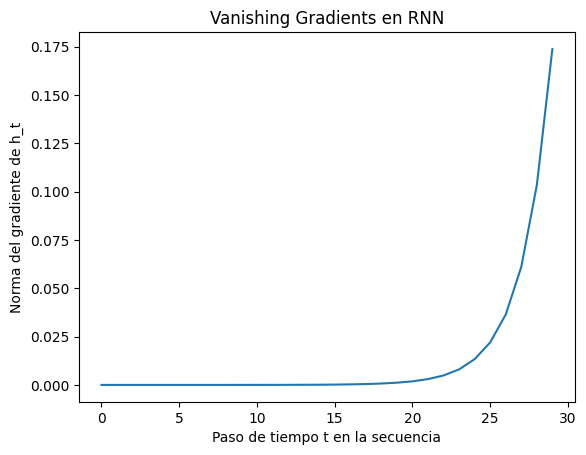

In [70]:
# Entrenamiento con tracking de gradientes
gradient_log = []

steps = 100

for step in range(steps):
    ix = torch.randint(0, Xtr.shape[0], (batch_size,))
    Xb = Xtr[ix]  # (B, T)
    Yb = Ytr[ix]  # (B,)

    x_emb = C[Xb]  # (B, T, n_embd)
    B, T, E = x_emb.shape
    H = hidden_size
    h = torch.zeros(B, H)

    h_list = []

    for t in range(T):
        x_t = x_emb[:, t, :]
        h = torch.tanh(x_t @ W_x + h @ W_h + b)
        h.retain_grad()
        h_list.append(h)

    logits = h @ W_y + b_y
    loss = F.cross_entropy(logits, Yb)

    for p in parameters:
        p.grad = None
    loss.backward()

    # Track gradientes por paso
    with torch.no_grad():
        grad_norms = [h_list[t].grad.norm().item() for t in range(T)]
        gradient_log.append(grad_norms)
        for p in parameters:
            p.data += -lr * p.grad

    if step % 20 == 0:
        print(f"step {step:4d} | loss = {loss.item():.4f}")

# Visualización (promedio de gradientes por paso)
avg_grads = np.mean(np.array(gradient_log), axis=0)
plt.plot(avg_grads)
plt.title("Vanishing Gradients en RNN")
plt.xlabel("Paso de tiempo t en la secuencia")
plt.ylabel("Norma del gradiente de h_t")
plt.show()


- En los pasos tempranos (t ≈ 0 a 200), los gradientes están prácticamente en cero.
- Solo los últimos pasos (t ≈ 250 a 255) tienen gradientes significativos.
**Esto significa que el modelo aprende solo del final de la secuencia, e ignora todo el contexto del pasado lejano.**

---

En una RNN clásica, el gradiente hacia el pasado se multiplica muchas veces por los mismos pesos (W_h).
- Si esos pesos tienen eigenvalores < 1, el gradiente se aplasta exponencialmente con cada paso temporal.
- Resultado: el pasado lejano no influye en el aprendizaje, aunque conceptualmente debería.

No es que la RNN no pueda mirar al pasado. Es que no puede aprender a usarlo porque no recibe señal de error de esos pasos.

**Por eso las LSTM (y GRU) fueron diseñadas: para mantener memoria y flujo de gradientes estables a largo plazo.**

In [ ]:
def generate_rnn(start_text, length=100):
    context = [stoi[c] for c in start_text]
    h = torch.zeros(hidden_size)

    out = start_text

    for _ in range(length):
        for t in range(len(context)):
            x_t = torch.tensor([context[t]])
            x_emb = C[x_t]  # (1, n_embd)
            h = torch.tanh(x_emb @ W_x + h @ W_h + b)

        logits = h @ W_y + b_y
        probs = F.softmax(logits, dim=-1)
        ix = torch.multinomial(probs, num_samples=1).item()

        out += itos[ix]
        context = context[1:] + [ix]  # shift

    return out

'Fir: fass coeesen that tand now me as: Rfawleng, leapt, reant is ling desmands novy neyd I In and thend i'

In [71]:
# Despues de 100 iteraciones con block_size = 30:

generate_rnn("Fir", 100)

'FirpeAy aan wuoTUEfldm\n\nndlmecty owhe\nwlolpl\nmhek wom rncIhaTYci he Ioi, uorhre aome on3  maen aoth mst'

In [61]:
# Despues de 3000 iteraciones:

generate_rnn("Fir", 100)

"Firsendes'd menly gaves feat us :ronm: reat wett teusgnofely yif;\nreum.\n\nWIO:\nThav\n-ng.ate owr mits oml"

In [63]:
# Despues de 5000 iteraciones:

generate_rnn("Fir", 100)


"Firving orcunts cult ral Kat: I frimy blise Clen.\n\nBOTICINI'SDle.\n\nONI:\nBfate\nBoO\nOr heen 'll gnou\nBe b"

## LSTM

Además de h_t (el estado oculto), la LSTM introduce otro vector: **el estado de celda c** , que es como una memoria a largo plazo.

Y para controlar el flujo de información, la LSTM tiene 4 compuertas:
- **Forget gate**: decide qué parte de c_{t-1} olvidar.
- **Input gate**: decide qué información nueva agregar.
- **Candidate cell**: qué nueva información se propone para ingresar.
- **Output gate**: decide qué parte de c_t se convierte en h_t.

O sea, para cada funcion (las 4 de arriba), tenemos un bias vector y dos weight matrices:
- Uno para hidden
- Otro para input

---

**OPERACIONES**

Y la clave es como estan combinadas las operaciones para que CADA WEIGHT CUMPLA SU FUNCION:

Hay dos operaciones ultimas que queremos actualizar en cada t:
- c_t (memoria largo plazo)
- h_t (memoria a usar en t)

**Memoria largo plazo**
```bash
c_t = f_t * c_t + i_t * g_t
```
Es una suma de dos cosas:
- Olvidar cosas del pasado: la memoria de largo plazo hasta ahora MULTIPLICADO (atenuado) por el forget (que es entre 0 y 1). Hace olvidar mas o menos.
- Agregar nueva info: la info candidata (g_t) se MULTIPLICA (atenua) por input (que es entre 0 y 1). Decide que agregar y cuanto (ponderado).

**Memoria a usar**
```bash
h_t = o_t * torch.tanh(c_t)
```
Es la memoria de largo plazo pero MULTIPLICADO (atenuado o ponderado) por el vector de output que elige que debemos mostrar.

---

**Como se arman los vectores funcionales (forget, input, candidate, output)?**

FORGET: 
```bash
f_t = torch.sigmoid(x_t @ W_xf + h_t @ W_hf + b_f)
```
Hace una transformacion lineal con matmuls de los weights con sus respectivos (input o hidden) y pasa sigmoid -> queda entre 0 y 1 (por eso sirve para ponderar).

---

**INPUTS**: embeddings (se aprenden en el entrenamiento tambien)

SIMPLE

In [38]:
import torch
import torch.nn.functional as F

# Hiperparámetros
input_size = 2   # Dimensión del input x_t
hidden_size = 2  # Dimensión del estado oculto h_t y de la celda c_t
seq_len = 3      # Largo de la secuencia temporal

# ====== PESOS Y BIAS DE CADA GATE ======
# Cada compuerta tiene su propio conjunto de pesos:
# - W_xX: pesos que se aplican al input x_t
# - W_hX: pesos que se aplican al hidden anterior h_t
# - b_X: bias

# Forget gate (decide cuánto de la memoria anterior c_t-1 se mantiene)
W_xf = torch.tensor([[0.5, -0.1], [0.3, 0.2]], dtype=torch.float32)
W_hf = torch.tensor([[0.1, 0.3], [-0.3, 0.4]], dtype=torch.float32)
b_f = torch.tensor([0.0, 0.0], dtype=torch.float32)

# Input gate (decide cuánto de la nueva info vamos a incorporar)
W_xi = torch.tensor([[0.4, -0.2], [-0.1, 0.1]], dtype=torch.float32)
W_hi = torch.tensor([[0.2, 0.0], [0.5, -0.3]], dtype=torch.float32)
b_i = torch.tensor([0.0, 0.0], dtype=torch.float32)

# Candidate cell (propuesta de nueva memoria para agregar)
W_xc = torch.tensor([[0.3, 0.6], [-0.2, 0.5]], dtype=torch.float32)
W_hc = torch.tensor([[0.4, -0.1], [0.1, 0.3]], dtype=torch.float32)
b_c = torch.tensor([0.0, 0.0], dtype=torch.float32)

# Output gate (decide qué parte de la memoria mostrar como h_t)
W_xo = torch.tensor([[0.2, -0.3], [0.6, 0.1]], dtype=torch.float32)
W_ho = torch.tensor([[0.1, 0.2], [-0.2, 0.4]], dtype=torch.float32)
b_o = torch.tensor([0.0, 0.0], dtype=torch.float32)

# ====== SECUENCIA DE ENTRADA ======
# Cada x_t es un vector de entrada para ese paso de tiempo
x_seq = [
    torch.tensor([1.0, 0.0]),
    torch.tensor([0.0, 1.0]),
    torch.tensor([1.0, 1.0])
]

# ====== ESTADOS INICIALES ======
# Inicialmente la memoria y el estado oculto están en cero
h_t = torch.zeros(hidden_size)
c_t = torch.zeros(hidden_size)

In [39]:
# ====== EJECUCIÓN PASO A PASO ======
for t, x_t in enumerate(x_seq):
    print(f"\n🔁 Paso {t} con entrada x_t = {x_t}")

    # === 1. FORGET GATE ===
    # Decide cuánto de la memoria c_{t-1} se conserva (0 = olvida, 1 = recuerda todo)
    # Se calcula combinando input actual y estado oculto anterior
    f_t = torch.sigmoid(x_t @ W_xf + h_t @ W_hf + b_f)
    print(f"1. Forget gate f_t = {f_t}")

    # === 2. INPUT GATE ===
    # Decide cuánto de la nueva información (la candidata) se agrega a la memoria
    i_t = torch.sigmoid(x_t @ W_xi + h_t @ W_hi + b_i)
    print(f"2. Input gate i_t = {i_t}")

    # === 3. CANDIDATE CELL ===
    # Es la propuesta de nueva información, aún no confirmada
    # Se genera con tanh para que esté entre -1 y 1 (contenido "rico")
    g_t = torch.tanh(x_t @ W_xc + h_t @ W_hc + b_c)
    print(f"3. Candidate cell g_t = {g_t}")

    # === 4. ACTUALIZAR MEMORIA DE LARGO PLAZO (c_t) ===
    # Combinamos lo viejo (c_t) atenuado por f_t, y lo nuevo (g_t) atenuado por i_t
    c_t = f_t * c_t + i_t * g_t
    print(f"4. New cell state c_t = {c_t}")

    # === 5. OUTPUT GATE ===
    # Decide qué parte de la memoria (c_t) mostrar al "exterior" como h_t
    o_t = torch.sigmoid(x_t @ W_xo + h_t @ W_ho + b_o)
    print(f"5. Output gate o_t = {o_t}")

    # === 6. ACTUALIZAR ESTADO OCULTO (h_t) ===
    # Se muestra una versión suavizada (tanh) de la memoria actual, ponderada por o_t
    h_t = o_t * torch.tanh(c_t)
    print(f"6. New hidden state h_t = {h_t}")



🔁 Paso 0 con entrada x_t = tensor([1., 0.])
1. Forget gate f_t = tensor([0.6225, 0.4750])
2. Input gate i_t = tensor([0.5987, 0.4502])
3. Candidate cell g_t = tensor([0.2913, 0.5370])
4. New cell state c_t = tensor([0.1744, 0.2418])
5. Output gate o_t = tensor([0.5498, 0.4256])
6. New hidden state h_t = tensor([0.0949, 0.1009])

🔁 Paso 1 con entrada x_t = tensor([0., 1.])
1. Forget gate f_t = tensor([0.5694, 0.5668])
2. Input gate i_t = tensor([0.4924, 0.5174])
3. Candidate cell g_t = tensor([-0.1508,  0.4783])
4. New cell state c_t = tensor([0.0251, 0.3845])
5. Output gate o_t = tensor([0.6432, 0.5398])
6. New hidden state h_t = tensor([0.0161, 0.1979])

🔁 Paso 2 con entrada x_t = tensor([1., 1.])
1. Forget gate f_t = tensor([0.6775, 0.5459])
2. Input gate i_t = tensor([0.5992, 0.4602])
3. Candidate cell g_t = tensor([0.1256, 0.8203])
4. New cell state c_t = tensor([0.0922, 0.5874])
5. Output gate o_t = tensor([0.6818, 0.4706])
6. New hidden state h_t = tensor([0.0627, 0.2485])


DATASET + TRAINING

In [72]:
import torch
import torch.nn.functional as F
import matplotlib.pyplot as plt
import numpy as np

# Hiperparámetros
n_embd = 16
hidden_size = 128
block_size = 30 # 256
batch_size = 32
lr = 0.05

# Inicialización
g = torch.Generator().manual_seed(2147483647)
C = torch.randn((vocab_size, n_embd), generator=g)

def init_gate(init_bias=0.0):
    return (
        torch.randn((n_embd, hidden_size), generator=g) / n_embd**0.5,
        torch.randn((hidden_size, hidden_size), generator=g) / hidden_size**0.5,
        torch.ones(hidden_size) * init_bias
    )

# Gates con mejor inicialización
W_xf, W_hf, b_f = init_gate(init_bias=1.0)  # forget gate con bias=1
W_xi, W_hi, b_i = init_gate()
W_xc, W_hc, b_c = init_gate()
W_xo, W_ho, b_o = init_gate()

W_y = torch.randn((hidden_size, vocab_size), generator=g) / hidden_size**0.5
b_y = torch.zeros(vocab_size)

# Lista de parámetros
parameters = [
    C, W_xf, W_hf, b_f, W_xi, W_hi, b_i,
    W_xc, W_hc, b_c, W_xo, W_ho, b_o, W_y, b_y
]
for p in parameters:
    p.requires_grad = True



[Improved LSTM] step    0 | loss = 3.6128
[Improved LSTM] step   20 | loss = 3.2660
[Improved LSTM] step   40 | loss = 3.3353
[Improved LSTM] step   60 | loss = 3.2144
[Improved LSTM] step   80 | loss = 3.4677
[Improved LSTM] step  100 | loss = 3.4504
[Improved LSTM] step  120 | loss = 3.0301
[Improved LSTM] step  140 | loss = 3.0565
[Improved LSTM] step  160 | loss = 2.9833
[Improved LSTM] step  180 | loss = 3.1715
[Improved LSTM] step  200 | loss = 3.3816
[Improved LSTM] step  220 | loss = 3.3029
[Improved LSTM] step  240 | loss = 2.8451
[Improved LSTM] step  260 | loss = 3.2394
[Improved LSTM] step  280 | loss = 3.0610
[Improved LSTM] step  300 | loss = 3.2176
[Improved LSTM] step  320 | loss = 3.2335
[Improved LSTM] step  340 | loss = 2.8935
[Improved LSTM] step  360 | loss = 2.9785
[Improved LSTM] step  380 | loss = 3.0874
[Improved LSTM] step  400 | loss = 2.8348
[Improved LSTM] step  420 | loss = 2.9595
[Improved LSTM] step  440 | loss = 3.0803
[Improved LSTM] step  460 | loss =

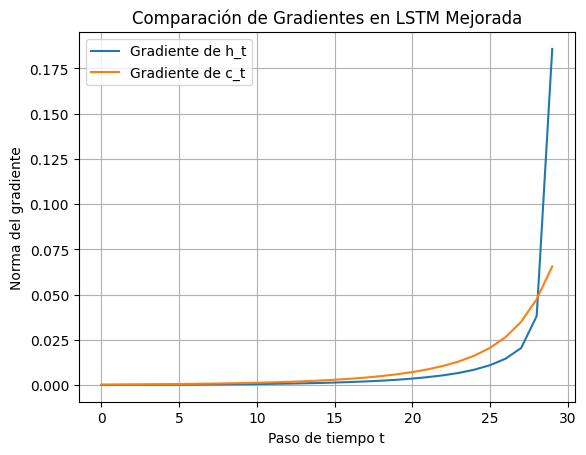

In [75]:
# Logs de gradientes
grad_h_log = []
grad_c_log = []

steps = 500


for step in range(steps):
    ix = torch.randint(0, Xtr.shape[0], (batch_size,))
    Xb = Xtr[ix]
    Yb = Ytr[ix]

    x_emb = C[Xb]
    B, T, E = x_emb.shape
    H = hidden_size
    h = torch.zeros(B, H)
    c = torch.zeros(B, H)

    h_list = []
    c_list = []

    for t in range(T):
        x_t = x_emb[:, t, :]

        f_t = torch.sigmoid(x_t @ W_xf + h @ W_hf + b_f)
        i_t = torch.sigmoid(x_t @ W_xi + h @ W_hi + b_i)
        g_t = torch.tanh(x_t @ W_xc + h @ W_hc + b_c)
        o_t = torch.sigmoid(x_t @ W_xo + h @ W_ho + b_o)

        c = f_t * c + i_t * g_t
        h = o_t * torch.tanh(c)

        h.retain_grad()
        c.retain_grad()
        h_list.append(h)
        c_list.append(c)

    logits = h @ W_y + b_y
    loss = F.cross_entropy(logits, Yb)

    for p in parameters:
        p.grad = None
    loss.backward()

    with torch.no_grad():
        grad_h = [h_list[t].grad.norm().item() for t in range(T)]
        grad_c = [c_list[t].grad.norm().item() for t in range(T)]
        grad_h_log.append(grad_h)
        grad_c_log.append(grad_c)
        for p in parameters:
            p.data += -lr * p.grad

    if step % 20 == 0:
        print(f"[Improved LSTM] step {step:4d} | loss = {loss.item():.4f}")

# Visualización
avg_grad_h = np.mean(np.array(grad_h_log), axis=0)
avg_grad_c = np.mean(np.array(grad_c_log), axis=0)

plt.plot(avg_grad_h, label="Gradiente de h_t")
plt.plot(avg_grad_c, label="Gradiente de c_t")
plt.title("Comparación de Gradientes en LSTM Mejorada")
plt.xlabel("Paso de tiempo t")
plt.ylabel("Norma del gradiente")
plt.legend()
plt.grid(True)
plt.show()


Mmmmm no se por que esto no mejora

---

**La LSTM no evita el vanishing gradient en el sentido técnico de gradientes muy chicos.**

**Pero habilita mecanismos estructurales (como la celda c_t) que permiten aprender a retener el pasado, cosa que la RNN no puede hacer tan fácilmente.**

Para que esto funcione, se necesita:
- Buen diseño de arquitectura (b_f = 1)
- Entrenamiento suficiente
- Buena forma de computar la pérdida (idealmente en cada t)



In [ ]:
def generate_lstm(start_text, length=100):
    context = [stoi[c] for c in start_text]
    h = torch.zeros(hidden_size)
    c = torch.zeros(hidden_size)

    out = start_text

    for _ in range(length):
        for t in range(len(context)):
            x_t = torch.tensor([context[t]])
            x_emb = C[x_t]  # (1, n_embd)

            f_t = torch.sigmoid(x_emb @ W_xf + h @ W_hf + b_f)
            i_t = torch.sigmoid(x_emb @ W_xi + h @ W_hi + b_i)
            g_t = torch.tanh(x_emb @ W_xc + h @ W_hc + b_c)
            o_t = torch.sigmoid(x_emb @ W_xo + h @ W_ho + b_o)

            c = f_t * c + i_t * g_t
            h = o_t * torch.tanh(c)

        logits = h @ W_y + b_y
        probs = F.softmax(logits, dim=-1)
        ix = torch.multinomial(probs, num_samples=1).item()

        out += itos[ix]
        context = context[1:] + [ix]

    return out

"Firc!CAWTE lin o' Bls.\n\nIr$A nrWe o ssits anor kot, ass she, b suten.\nOPRuNh a'e lat ous group, shd to "

In [76]:
# Despues de 500 iteraciones con block_size = 30:

generate_lstm("Fir", 100)

"Firn:TJeo lao a'nSNuVTy:nodn bion oQ mthr,e rhalaNhth i, thI hahe aevotie n a rnYt gtne Tros a qAWl ido"

In [67]:
# Despues de 3000 iteraciones:

generate_lstm("Fir", 100)

"Firggahnd, mvo sthes .aeng geere peld omk thef'e!ilg miss & heed it,\nWhe, til\n\nAIN.\n i?'st heeve cmieng"

## Deep RNN

Se pueden hacer profundos. Para eso tenemos que el output de una capa va como input a la otra.

EXPLICITO A MANO

In [ ]:
import torch
import torch.nn.functional as F
import matplotlib.pyplot as plt
import numpy as np

# -------------------------------
# Hiperparámetros
# -------------------------------
n_embd = 16           # dimensión del embedding por token
hidden_size = 128     # tamaño del estado oculto por capa
block_size = 30       # longitud de la secuencia (T)
batch_size = 32       # cantidad de ejemplos por batch
lr = 0.05             # tasa de aprendizaje
n_layers = 3          # número de capas (profundidad)

# -------------------------------
# Simulación de datos
# -------------------------------
vocab_size = 50
Xtr = torch.randint(0, vocab_size, (1000, block_size))  # entradas aleatorias (1000 ejemplos de longitud block_size)
Ytr = torch.randint(0, vocab_size, (1000,))              # un target por ejemplo (next token)

# -------------------------------
# Inicialización de parámetros
# -------------------------------
g = torch.Generator().manual_seed(2147483647)

# Tabla de embeddings (vocab_size x n_embd)
C = torch.randn((vocab_size, n_embd), generator=g)

# Inicialización de los pesos y sesgos para cada capa de la red RNN profunda

# W_x: lista de matrices de pesos para la entrada de cada capa (input/capa anterior -> hidden)
W_x = []
for i in range(n_layers):
    # La primera capa recibe como entrada el embedding, las siguientes reciben el hidden de la capa anterior
    if i == 0:
        input_dim = n_embd
    else:
        input_dim = hidden_size
    # Inicializamos los pesos con distribución normal escalada (mejor estabilidad)
    Wx_i = torch.randn((input_dim, hidden_size), generator=g) / input_dim**0.5
    W_x.append(Wx_i)

# W_h: lista de matrices de pesos recurrentes para cada capa (hidden anterior -> hidden nuevo)
W_h = []
for i in range(n_layers):
    # Inicializamos los pesos recurrentes con distribución normal escalada
    Wh_i = torch.randn((hidden_size, hidden_size), generator=g) / hidden_size**0.5
    W_h.append(Wh_i)

# b: lista de vectores de sesgo para cada capa
b = []
for i in range(n_layers):
    # Inicializamos los sesgos en cero para cada capa
    b_i = torch.zeros(hidden_size)
    b.append(b_i)

# Proyección final (último hidden a logits del vocabulario)
W_y = torch.randn((hidden_size, vocab_size), generator=g) / hidden_size**0.5
b_y = torch.zeros(vocab_size)

# Lista de parámetros a optimizar
parameters = [C, W_y, b_y] + W_x + W_h + b
for p in parameters:
    p.requires_grad = True



In [ ]:
# -------------------------------
# Entrenamiento
# -------------------------------
gradient_log = []  # para visualizar la magnitud de los gradientes
steps = 100

for step in range(steps):
    # Seleccionamos un batch de entrenamiento
    ix = torch.randint(0, Xtr.shape[0], (batch_size,))
    Xb = Xtr[ix]  # (B, T)
    Yb = Ytr[ix]  # (B,)

    # Obtenemos los embeddings (B, T, n_embd)
    x_emb = C[Xb]
    B, T, E = x_emb.shape
    H = hidden_size

    # Estado oculto inicial para cada capa (se reinicia por batch)
    h = [torch.zeros(B, H) for _ in range(n_layers)]
    h_list = []  # para guardar los estados de la última capa por paso

    # Procesamos secuencia temporalmente
    for t in range(T):
        x_t = x_emb[:, t, :]  # input en paso t: (B, n_embd)

        # Pasamos por cada capa secuencialmente
        for layer in range(n_layers):
            inp = x_t if layer == 0 else h[layer - 1]  # input de esta capa

            # RNN: h = tanh(Wx * inp + Wh * h_anterior + b)
            h[layer] = torch.tanh(inp @ W_x[layer] + h[layer] @ W_h[layer] + b[layer])

        # Solo trackeamos el gradiente de la última capa para cada paso
        h[-1].retain_grad()
        h_list.append(h[-1])

    # Proyección de la última capa del último paso → logits
    logits = h[-1] @ W_y + b_y  # (B, vocab_size)
    loss = F.cross_entropy(logits, Yb)  # pérdida por batch

    # Backprop
    for p in parameters:
        p.grad = None
    loss.backward()

    # Guardamos norma del gradiente para visualizar vanishing
    with torch.no_grad():
        grad_norms = [h_list[t].grad.norm().item() for t in range(T)]  # una por paso
        gradient_log.append(grad_norms)

        # Actualización de parámetros (SGD)
        for p in parameters:
            p.data += -lr * p.grad

    # Print cada 20 pasos
    if step % 20 == 0:
        print(f"step {step:4d} | loss = {loss.item():.4f}")

# -------------------------------
# Visualización de Gradientes
# -------------------------------

avg_grads = np.mean(np.array(gradient_log), axis=0)  # promedio por paso
plt.plot(avg_grads)
plt.title("Vanishing Gradients en RNN Profunda (3 capas)")
plt.xlabel("Paso de tiempo t en la secuencia")
plt.ylabel("Norma del gradiente de h_t (última capa)")
plt.grid(True)
plt.show()


CLASES DE PYTORCH

In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F

class DeepRNN(nn.Module):
    def __init__(self, input_size, hidden_size, num_layers=2, dropout=0.0):
        """
        DeepRNN es una red neuronal recurrente (RNN) con múltiples capas.

        Args:
            input_size (int): tamaño del vocabulario (para one-hot), o dimensión de entrada si ya se embebe.
            hidden_size (int): tamaño del estado oculto por capa.
            num_layers (int): cantidad de capas (profundidad de la red).
            dropout (float): proporción de dropout entre capas, si > 0.0.
        """
        super().__init__()
        self.input_size = input_size
        self.hidden_size = hidden_size
        self.num_layers = num_layers
        self.dropout = dropout

        # Capas lineales para cada capa de RNN
        self.input_linears = nn.ModuleList()
        self.hidden_linears = nn.ModuleList()

        for layer in range(num_layers):
            # La primera capa recibe el input directo, las siguientes reciben el hidden anterior
            layer_input_size = input_size if layer == 0 else hidden_size
            self.input_linears.append(nn.Linear(layer_input_size, hidden_size))
            self.hidden_linears.append(nn.Linear(hidden_size, hidden_size))

        # Proyección final del último hidden state a logits sobre vocabulario (para clasificación de siguiente token)
        self.decoder = nn.Linear(hidden_size, input_size)

    def forward(self, x_t, h_prev_list):
        """
        Ejecuta un paso temporal (t) de la RNN profunda.

        Args:
            x_t (tensor): tensor de input de forma (batch_size,) con índices enteros (tokens).
            h_prev_list (list of tensors): lista de estados ocultos por capa, cada uno de forma (batch_size, hidden_size)

        Returns:
            output_logits (tensor): logits del vocabulario (sin softmax), forma (batch_size, input_size)
            new_h_list (list of tensors): nuevos estados ocultos por capa
        """
        # Input x_t es un vector de índices. Lo convertimos en one-hot manualmente.
        x_onehot = F.one_hot(x_t, num_classes=self.input_size).float()

        x = x_onehot
        new_h_list = []

        # Pasamos secuencialmente por cada capa
        for layer in range(self.num_layers):
            prev_h = h_prev_list[layer]

            # Computamos la suma de entrada y recurrente
            i2h = self.input_linears[layer](x)
            h2h = self.hidden_linears[layer](prev_h)
            h_t = torch.tanh(i2h + h2h)  # Aplicamos no linealidad tanh como en RNN clásica

            # Agregamos dropout si está activado (solo entre capas, no en última capa)
            if self.dropout > 0.0 and layer < self.num_layers - 1:
                h_t = F.dropout(h_t, p=self.dropout, training=self.training)

            new_h_list.append(h_t)
            x = h_t  # El input de la siguiente capa es la salida actual (stacked RNN)

        # Proyectamos el último estado oculto a logits
        output_logits = self.decoder(x)
        return output_logits, new_h_list

    def init_hidden(self, batch_size):
        """
        Inicializa los estados ocultos de todas las capas con ceros.

        Args:
            batch_size (int): tamaño del batch actual

        Returns:
            list of tensors: lista de tensores h_0 para cada capa
        """
        return [torch.zeros(batch_size, self.hidden_size) for _ in range(self.num_layers)]


## Deep LSTM

SIMPLE

In [ ]:
import torch
import torch.nn.functional as F
import matplotlib.pyplot as plt
import numpy as np

# -----------------------------
# Hiperparámetros
# -----------------------------
n_embd = 16          # Tamaño del embedding (dimensión de cada vector de entrada)
hidden_size = 128    # Tamaño del estado oculto (por capa)
block_size = 30      # Longitud de la secuencia (cuántos pasos de tiempo)
batch_size = 32      # Tamaño del batch
lr = 0.05            # Tasa de aprendizaje
num_layers = 2       # Número de capas LSTM

# -----------------------------
# Inicialización
# -----------------------------
g = torch.Generator().manual_seed(2147483647)

# Matriz de embeddings para convertir índices de tokens a vectores
C = torch.randn((vocab_size, n_embd), generator=g)

# Función para inicializar los pesos de cada puerta
# Devuelve W_x, W_h, b para una puerta

def init_gate(in_dim):
    return (
        torch.randn((in_dim, hidden_size), generator=g) / in_dim**0.5,  # W_x
        torch.randn((hidden_size, hidden_size), generator=g) / hidden_size**0.5,  # W_h
        torch.zeros(hidden_size)  # bias (puede modificarse en caso de forget gate)
    )

# Listas para almacenar los pesos y biases de cada capa y cada gate
all_params = [C]
layer_params = []  # cada elemento representa los parámetros de una capa

for layer in range(num_layers):
    input_dim = n_embd if layer == 0 else hidden_size

    # Forget gate (con bias inicializado en 1.0)
    W_xf, W_hf, b_f = init_gate(input_dim)
    b_f += 1.0  # inicialización especial para forget gate

    # Input gate
    W_xi, W_hi, b_i = init_gate(input_dim)

    # Cell candidate (tanh input)
    W_xc, W_hc, b_c = init_gate(input_dim)

    # Output gate
    W_xo, W_ho, b_o = init_gate(input_dim)

    # Almacenar parámetros de esta capa
    layer_params.append([
        W_xf, W_hf, b_f,
        W_xi, W_hi, b_i,
        W_xc, W_hc, b_c,
        W_xo, W_ho, b_o
    ])

    all_params.extend(layer_params[-1])

# Decoder: proyección del último hidden state al vocabulario
W_y = torch.randn((hidden_size, vocab_size), generator=g) / hidden_size**0.5
b_y = torch.zeros(vocab_size)
all_params.extend([W_y, b_y])

# Hacer que todos los parámetros requieran gradiente
for p in all_params:
    p.requires_grad = True

In [ ]:
# -----------------------------
# Entrenamiento
# -----------------------------
grad_h_log = []
grad_c_log = []
steps = 500

for step in range(steps):
    # Mini-batch de datos
    ix = torch.randint(0, Xtr.shape[0], (batch_size,))
    Xb = Xtr[ix]  # (B, T)
    Yb = Ytr[ix]  # (B,)

    # Embeddeamos los tokens
    x_emb = C[Xb]  # (B, T, n_embd)
    B, T, E = x_emb.shape

    # Inicializamos hidden y cell states para cada capa
    hs = [torch.zeros(B, hidden_size) for _ in range(num_layers)]
    cs = [torch.zeros(B, hidden_size) for _ in range(num_layers)]

    h_track = []
    c_track = []

    for t in range(T):
        x_t = x_emb[:, t, :]  # input en paso t

        # Propagación a través de capas
        for l in range(num_layers):
            params = layer_params[l]
            (W_xf, W_hf, b_f,
             W_xi, W_hi, b_i,
             W_xc, W_hc, b_c,
             W_xo, W_ho, b_o) = params

            # El input a esta capa: embedding o hidden de capa anterior
            input_l = x_t if l == 0 else hs[l-1]

            # Computamos las gates
            f_t = torch.sigmoid(input_l @ W_xf + hs[l] @ W_hf + b_f)
            i_t = torch.sigmoid(input_l @ W_xi + hs[l] @ W_hi + b_i)
            g_t = torch.tanh(input_l @ W_xc + hs[l] @ W_hc + b_c)
            o_t = torch.sigmoid(input_l @ W_xo + hs[l] @ W_ho + b_o)

            # Actualización de memoria y estado
            cs[l] = f_t * cs[l] + i_t * g_t
            hs[l] = o_t * torch.tanh(cs[l])

        # Track de gradientes
        hs[-1].retain_grad()
        cs[-1].retain_grad()
        h_track.append(hs[-1])
        c_track.append(cs[-1])

    # Proyección final desde última capa
    logits = hs[-1] @ W_y + b_y
    loss = F.cross_entropy(logits, Yb)

    # Backprop
    for p in all_params:
        p.grad = None
    loss.backward()

    # Log de gradientes para visualizar vanishing
    with torch.no_grad():
        grad_h = [h_track[t].grad.norm().item() for t in range(T)]
        grad_c = [c_track[t].grad.norm().item() for t in range(T)]
        grad_h_log.append(grad_h)
        grad_c_log.append(grad_c)
        for p in all_params:
            p.data += -lr * p.grad

    if step % 20 == 0:
        print(f"[Deep LSTM] step {step:4d} | loss = {loss.item():.4f}")

# -----------------------------
# Visualización de Gradientes
# -----------------------------
avg_grad_h = np.mean(np.array(grad_h_log), axis=0)
avg_grad_c = np.mean(np.array(grad_c_log), axis=0)

plt.plot(avg_grad_h, label="Gradiente de h_t (hidden)")
plt.plot(avg_grad_c, label="Gradiente de c_t (cell)")
plt.title("Vanishing Gradients en Deep LSTM de 2 capas")
plt.xlabel("Paso de tiempo t")
plt.ylabel("Norma del gradiente")
plt.legend()
plt.grid(True)
plt.show()

CLASES PYTORCH

In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F

class DeepLSTM(nn.Module):
    def __init__(self, input_size, hidden_size, num_layers=2, dropout=0.0):
        """
        DeepLSTM es una red LSTM multicapa al estilo Karpathy (como su implementación en Lua/Torch).

        Args:
            input_size (int): dimensión del input (e.g. tamaño del vocabulario para one-hot o embedders).
            hidden_size (int): tamaño del estado oculto en cada capa.
            num_layers (int): cantidad de capas LSTM.
            dropout (float): proporción de dropout entre capas.
        """
        super().__init__()
        self.input_size = input_size
        self.hidden_size = hidden_size
        self.num_layers = num_layers
        self.dropout = dropout

        # Para cada capa, creamos una capa lineal que va de input -> 4*hidden y de h -> 4*hidden
        self.input_linears = nn.ModuleList()
        self.hidden_linears = nn.ModuleList()

        for layer in range(num_layers):
            layer_input_size = input_size if layer == 0 else hidden_size
            self.input_linears.append(nn.Linear(layer_input_size, 4 * hidden_size))
            self.hidden_linears.append(nn.Linear(hidden_size, 4 * hidden_size))

        # Proyección final desde el último hidden a logits
        self.decoder = nn.Linear(hidden_size, input_size)

    def forward(self, x_t, prev_states):
        """
        Ejecuta un paso de tiempo (t) de una LSTM profunda.

        Args:
            x_t (Tensor): input actual (batch_size,) de índices o (batch_size, input_size) si embebido.
            prev_states (list of tuples): lista de tuplas (c_{t-1}, h_{t-1}) para cada capa.

        Returns:
            logits (Tensor): logits del vocabulario (batch_size, input_size)
            new_states (list): nuevos estados [(c_t, h_t)] por capa
        """
        # x_t es un índice → convertimos a one-hot manual si es necesario
        if x_t.dim() == 1:
            x_t = F.one_hot(x_t, num_classes=self.input_size).float()

        x = x_t
        new_states = []

        for layer in range(self.num_layers):
            prev_c, prev_h = prev_states[layer]

            # Proyección input y recurrente
            i2h = self.input_linears[layer](x)
            h2h = self.hidden_linears[layer](prev_h)
            all_sums = i2h + h2h

            # Separar en 4 bloques: input gate, forget gate, output gate, candidate cell
            gates = all_sums.view(-1, 4, self.hidden_size)
            i_gate = torch.sigmoid(gates[:, 0, :])
            f_gate = torch.sigmoid(gates[:, 1, :])
            o_gate = torch.sigmoid(gates[:, 2, :])
            g_gate = torch.tanh(gates[:, 3, :])

            # LSTM update
            c_t = f_gate * prev_c + i_gate * g_gate
            h_t = o_gate * torch.tanh(c_t)

            # Dropout entre capas (excepto después de la última capa)
            if self.dropout > 0.0 and layer < self.num_layers - 1:
                h_t = F.dropout(h_t, p=self.dropout, training=self.training)

            # Guardar nuevo estado
            new_states.append((c_t, h_t))
            x = h_t  # el input a la próxima capa

        # Output final
        logits = self.decoder(x)
        return logits, new_states

    def init_states(self, batch_size):
        """Inicializa c y h en cero para cada capa."""
        return [(torch.zeros(batch_size, self.hidden_size),
                 torch.zeros(batch_size, self.hidden_size)) for _ in range(self.num_layers)]


## Encoder-decoder

Vamos de a poco, siguiendo el camino que venimos: hasta ahora, con RNNs y LSTMs, hemos visto cómo modelar secuencias donde procesamos paso a paso, manteniendo un "resumen" (hidden state) que acumula contexto. Tu código de LSTM es genial para eso –muestra cómo las gates controlan la memoria sin vanishing gradients graves, y el gráfico ilustra que los grads fluyen mejor en c_t (memoria larga) que en h_t simple.

Pero ¿y si queremos mapear una secuencia a otra secuencia, posiblemente de longitudes diferentes? Por ejemplo, traducir "The cat eats" (3 palabras) a "El gato come" (3 palabras, pero podría ser más o menos). O resumir texto, o generar respuestas en chat. Una LSTM simple no basta porque asume input/output fijos o predict next-token en la misma secuencia.

Aquí surge el "aha" obvio: Separemos en dos partes conectadas.

- Encoder: Procesa la secuencia input paso a paso (como tu LSTM), pero guarda todos los hidden states (no solo el final). El hidden final actúa como "resumen global" (context vector) de toda la input –resume la esencia en un vector fijo, manejando longitudes variables.
- Decoder: Otra LSTM que genera la output autoregresivamente (paso por paso), usando el context del encoder como hidden inicial. En cada paso, predice el siguiente token basado en lo generado hasta ahora + context.

¿Por qué tiene sentido evolutivamente?

- En RNNs puras, para seq2seq, forzabas todo en una red –pero perdías alineaciones (e.g., "cat" se alinea con "gato", no un resumen vago).
- Encoder-decoder (introducido ~2014 por Sutskever et al.) resuelve: Encoder "lee" input, decoder "escribe" output. Es como un humano: lees la oración completa (encoder), luego traduces palabra por palabra recordando el todo (decoder).
- Problema inicial: El context vector único (hidden final) es un bottleneck –comprime todo en un vector fijo, perdiendo detalles para inputs largos. (Esto motiva attention después, pero vamos paso a paso).
- Intuitivo: Es "obvio" porque divide el problema: uno resume, otro genera. Evoluciona de RNN simple (una cadena) a dos cadenas conectadas.

Encoder es como tu LSTM, produciendo una lista de hiddens (matriz B x T x H). Decoder usa el último hidden como starting point, y genera logits con matmuls similares.

In [ ]:
import torch

# Hiperparámetros simples para fines educativos
input_size = 2   # Dimensión de cada x_t (e.g., embedding size)
hidden_size = 2  # Dimensión de h_t
seq_len = 3      # Longitud de secuencia (input y output)

# Pesos para ENCODER (RNN simple: W_x_enc para input, W_h_enc para hidden prev)
W_x_enc = torch.tensor([[0.5, -0.2],
                        [0.3, 0.8]], dtype=torch.float32)  # Shape (hidden_size, input_size)
W_h_enc = torch.tensor([[0.1, 0.4],
                        [-0.3, 0.2]], dtype=torch.float32)  # Shape (hidden_size, hidden_size)
b_enc = torch.tensor([0.0, 0.0], dtype=torch.float32)  # Bias para encoder (hidden_size)

# Pesos para DECODER (RNN simple, separados: W_x_dec, W_h_dec)
W_x_dec = torch.tensor([[0.4, 0.1],
                        [-0.5, 0.6]], dtype=torch.float32)  # Shape (hidden_size, input_size)
W_h_dec = torch.tensor([[0.2, -0.3],
                        [0.7, 0.4]], dtype=torch.float32)  # Shape (hidden_size, hidden_size)
b_dec = torch.tensor([0.0, 0.0], dtype=torch.float32)  # Bias para decoder

# Para output en decoder: Proyecta h_t a "logits" (simula predicción, e.g., vocab_size=2 para dummy)
W_out = torch.tensor([[0.9, -0.1],
                      [0.2, 0.8]], dtype=torch.float32)  # Shape (vocab_size, hidden_size)
b_out = torch.tensor([0.0, 0.0], dtype=torch.float32)

# Secuencia de input para ENCODER (e.g., embeddings dummy para "The cat eats")
x_seq_enc = [
    torch.tensor([1.0, 0.0]),  # x_0 (e.g., "The")
    torch.tensor([0.0, 1.0]),  # x_1 (e.g., "cat")
    torch.tensor([1.0, 1.0])   # x_2 (e.g., "eats")
]

# Secuencia de input para DECODER (e.g., embeddings dummy para generar "El gato come", inicia con <SOS>)
x_seq_dec = [
    torch.tensor([0.5, 0.5]),  # x_0 dec: <SOS>
    torch.tensor([1.0, 0.5]),  # x_1 dec: "El" (simulado)
    torch.tensor([0.5, 1.0])   # x_2 dec: "gato" (simulado)
]

# Estado oculto inicial para encoder (zeros)
h_prev_enc = torch.zeros(hidden_size)

# Lista para guardar hiddens del encoder
h_seq_enc = []

In [ ]:
print("=== ENCODER: Procesa input secuencialmente, acumula contexto en h_t ===")

# ENCODER STEP 0
t = 0
x_t = x_seq_enc[t]
print(f"\nEncoder Paso {t} → x_t = {x_t}")

print("Forward pass:")
rnn_x_t = x_t @ W_x_enc.T  # x_t * W_x_enc (transpose para matmul: (input_size) @ (input_size, hidden_size) -> hidden_size)
print(f"1. input * weights_input = x_t * W_x_enc = {rnn_x_t}")

rnn_h_t = h_prev_enc @ W_h_enc.T  # h_prev * W_h_enc (similar)
print(f"2. hidden prev * weights_hidden = h_prev_enc * W_h_enc = {rnn_h_t}")

h_t = rnn_x_t + rnn_h_t + b_enc  # Suma + bias
print(f"3. sum of the two + bias = {h_t}")

h_t = torch.tanh(h_t)  # Activación
print(f"4. activation function = tanh(h_t) = {h_t}")

h_seq_enc.append(h_t)
h_prev_enc = h_t  # Avanza

In [ ]:
# ENCODER STEP 1
t = 1
x_t = x_seq_enc[t]
print(f"\nEncoder Paso {t} → x_t = {x_t}")

print("Forward pass:")
rnn_x_t = x_t @ W_x_enc.T
print(f"1. input * weights_input = x_t * W_x_enc = {rnn_x_t}")

rnn_h_t = h_prev_enc @ W_h_enc.T
print(f"2. hidden prev * weights_hidden = h_prev_enc * W_h_enc = {rnn_h_t}")

h_t = rnn_x_t + rnn_h_t + b_enc
print(f"3. sum of the two + bias = {h_t}")

h_t = torch.tanh(h_t)
print(f"4. activation function = tanh(h_t) = {h_t}")

h_seq_enc.append(h_t)
h_prev_enc = h_t

In [ ]:
# ENCODER STEP 2
t = 2
x_t = x_seq_enc[t]
print(f"\nEncoder Paso {t} → x_t = {x_t}")

print("Forward pass:")
rnn_x_t = x_t @ W_x_enc.T
print(f"1. input * weights_input = x_t * W_x_enc = {rnn_x_t}")

rnn_h_t = h_prev_enc @ W_h_enc.T
print(f"2. hidden prev * weights_hidden = h_prev_enc * W_h_enc = {rnn_h_t}")

h_t = rnn_x_t + rnn_h_t + b_enc
print(f"3. sum of the two + bias = {h_t}")

h_t = torch.tanh(h_t)
print(f"4. activation function = tanh(h_t) = {h_t}")

h_seq_enc.append(h_t)
h_prev_enc = h_t  # Último h_enc es el "context vector"

print(f"\nEncoder final: h_seq_enc = {h_seq_enc}")
print(f"Context vector (último h_enc) = {h_prev_enc}")

print("\n=== DECODER: Genera output usando context como h_prev inicial ===")

# Estado oculto inicial para decoder: Context del encoder
h_prev_dec = h_prev_enc.clone()

# Lista para guardar hiddens y "logits" del decoder
h_seq_dec = []
logits_seq = []

In [ ]:
# DECODER STEP 0 (inicia con <SOS> input)
t = 0
x_t = x_seq_dec[t]
print(f"\nDecoder Paso {t} → x_t = {x_t} (e.g., <SOS>)")

print("Forward pass:")
rnn_x_t = x_t @ W_x_dec.T  # x_t * W_x_dec
print(f"1. input * weights_input = x_t * W_x_dec = {rnn_x_t}")

rnn_h_t = h_prev_dec @ W_h_dec.T  # h_prev (context) * W_h_dec
print(f"2. hidden prev * weights_hidden = h_prev_dec * W_h_dec = {rnn_h_t}")

h_t = rnn_x_t + rnn_h_t + b_dec
print(f"3. sum of the two + bias = {h_t}")

h_t = torch.tanh(h_t)
print(f"4. activation function = tanh(h_t) = {h_t}")

# Predice "logits" (simula output prediction)
logits_t = h_t @ W_out.T + b_out  # h_t * W_out + bias_out
print(f"5. output projection = h_t * W_out + b_out = {logits_t}")

h_seq_dec.append(h_t)
logits_seq.append(logits_t)
h_prev_dec = h_t  # Avanza

In [ ]:
# DECODER STEP 1
t = 1
x_t = x_seq_dec[t]
print(f"\nDecoder Paso {t} → x_t = {x_t} (e.g., token previo generado)")

print("Forward pass:")
rnn_x_t = x_t @ W_x_dec.T
print(f"1. input * weights_input = x_t * W_x_dec = {rnn_x_t}")

rnn_h_t = h_prev_dec @ W_h_dec.T
print(f"2. hidden prev * weights_hidden = h_prev_dec * W_h_dec = {rnn_h_t}")

h_t = rnn_x_t + rnn_h_t + b_dec
print(f"3. sum of the two + bias = {h_t}")

h_t = torch.tanh(h_t)
print(f"4. activation function = tanh(h_t) = {h_t}")

logits_t = h_t @ W_out.T + b_out
print(f"5. output projection = h_t * W_out + b_out = {logits_t}")

h_seq_dec.append(h_t)
logits_seq.append(logits_t)
h_prev_dec = h_t

In [ ]:
# DECODER STEP 2
t = 2
x_t = x_seq_dec[t]
print(f"\nDecoder Paso {t} → x_t = {x_t} (e.g., token previo generado)")

print("Forward pass:")
rnn_x_t = x_t @ W_x_dec.T
print(f"1. input * weights_input = x_t * W_x_dec = {rnn_x_t}")

rnn_h_t = h_prev_dec @ W_h_dec.T
print(f"2. hidden prev * weights_hidden = h_prev_dec * W_h_dec = {rnn_h_t}")

h_t = rnn_x_t + rnn_h_t + b_dec
print(f"3. sum of the two + bias = {h_t}")

h_t = torch.tanh(h_t)
print(f"4. activation function = tanh(h_t) = {h_t}")

logits_t = h_t @ W_out.T + b_out
print(f"5. output projection = h_t * W_out + b_out = {logits_t}")

h_seq_dec.append(h_t)
logits_seq.append(logits_t)
h_prev_dec = h_t

print(f"\nDecoder final: h_seq_dec = {h_seq_dec}")
print(f"Logits seq (predicciones dummy) = {logits_seq}")

## Attention RNN

### Bahdanau 2014 (additive)

### Dot product attention (Luong)

# Attention basics

# Transformers

## Transformer Vaswani 2017

**ENCODER-DECODER**

https://github.com/greentfrapp/attention-primer/blob/master/1_counting-letters/README.md#model

---

PARTES DEL TRANSFORMER ORIGINAL

| Componente       | En el Encoder | En el Decoder              |
| ---------------- | ------------- | -------------------------- |
| Token Embeddings | ✅ Sí          | ✅ Sí                       |
| Positional Emb.  | ✅ Sí          | ✅ Sí                       |
| Self-Attention   | ✅ Sí          | ✅ Sí (con máscara causal)  |
| Cross-Attention  | ❌ No          | ✅ Sí (consulta al encoder) |
| Feedforward      | ✅ Sí          | ✅ Sí                       |
| Dropout          | ✅ Sí          | ✅ Sí                       |
| Normalization    | ✅ Sí          | ✅ Sí                       |


### Transformer block (encoder)

(la arquitectura va variando de acuerdo a la implementacion)

Arquitectura/Flujo EJEMPLO:

1. Multi-head attention block
2. Add (residual connection) & Norm
3. FeedForward
4. Add (residual connection) & Norm

Tambien se le puede agregar dropout, ponerle las normalizaciones antes de attention, etc.

---
Paso a paso, con batch_size = 1, para ver los shapes de todo.

Parametros:
- Tamaño de la secuencia: 
    - block_size
    - N
    - seq_length
- Dimension del embedding:
    - n_embd
    - d_model
- Numero de capas:
    - n_layer
- Numero de heads:
    - n_heads
- Dimension por cabeza:
    - head_dim = n_embd // n_head
- Tamaño vocabulario:
    - vocab_size
- Dimension feedforward (tamaño del hidden layer)
    - n_ff = 4 * n_embd


In [45]:
import torch
import math
import torch.nn.functional as F

block_size = 12
n_embd = 512
n_heads = 8
n_ff = 4 * n_embd

In [2]:
# INPUT EMBEDDING
X = torch.randn(block_size, n_embd)
X.shape

torch.Size([12, 512])

In [3]:
X

tensor([[-2.1097,  0.5870,  1.8541,  ...,  0.5197, -0.7594,  1.3782],
        [-0.3364, -0.2481,  0.5147,  ...,  0.0207, -0.8857,  0.9250],
        [ 0.8992, -1.6342,  0.4866,  ...,  0.3059,  0.6557,  0.7413],
        ...,
        [-1.3780, -0.0129, -1.3722,  ...,  0.2155,  0.2029,  0.4607],
        [-0.3903, -1.3613, -1.1348,  ...,  1.5545,  0.7182, -0.9259],
        [ 1.6038, -1.5400,  0.0074,  ..., -0.5354,  0.2017, -0.0593]])

Hay 12 tokens. Cada token tiene un vector de 512 dimensiones.

In [ ]:
# SE PUEDE AGREGAR DROPOUT ANTES DE ENTRAR A SELF-ATTENTION

# Esto simplemente toma attn_outputs y:
# 1. Convierte en 0 el 10% de los valores
# 2. Multiplica el resto por 1 / (1-0.1) para mantener la media
"""
El argumento `training=True` en F.dropout indica que estamos en modo entrenamiento:
  - Cuando `training=True`, Dropout está activo: apaga (pone en cero) aleatoriamente el 10% de los valores del tensor en cada pasada, y escala el resto para mantener la media.
  - Cuando `training=False`, Dropout NO se aplica: el tensor pasa sin cambios (no se apaga nada), como se hace durante la inferencia o evaluación.
Esto es importante porque Dropout solo se usa para regularizar durante el entrenamiento, pero no durante la evaluación o predicción."""

# X = F.dropout(X, p=0.1, training=False)
# X.shape

#### Multi-Head Self-Attention module

In [4]:
# INICIALIZACION WEIGHTS PARA Q, K, V

head_dim = n_embd // n_heads

W_Q = []
W_K = []
W_V = []

for _ in range(n_heads):
    # query weights
    W_Q_head = torch.randn(n_embd, head_dim) # 512, 64 (64 = 512/8)
    W_Q.append(W_Q_head)
    # key weights
    W_K_head = torch.randn(n_embd, head_dim)
    W_K.append(W_K_head)
    # value weights
    W_V_head = torch.randn(n_embd, head_dim)
    W_V.append(W_V_head)

print(f'W_Q, W_K, W_V es una lista de {len(W_Q)} matrices de {W_Q[0].shape}')

W_Q, W_K, W_V es una lista de 8 matrices de torch.Size([512, 64])


Entra cada token. Va directamente a proyectarse a todas estas matrices: 3*8 = 24 matmuls.

Quedan 24 vectores de 64 para cada token. 8 son para Q, 8 para K, 8 para V.

In [5]:
# PROYECCIONES A Q, K, V por head

Q = []
K = []
V = []

for i in range(n_heads):
    # query
    Q_head = X @ W_Q[i] # (12, 512) @ (512, 64) = (12, 64)
    Q.append(Q_head)
    # key
    K_head = X @ W_K[i] # (12, 512) @ (512, 64) = (12, 64)
    K.append(K_head)
    # value
    V_head = X @ W_V[i] # (12, 512) @ (512, 64) = (12, 64)
    V.append(V_head)

print(f'Q, K, V es una lista de {len(Q)} matrices de {Q[0].shape}')

Q, K, V es una lista de 8 matrices de torch.Size([12, 64])


Ahora para cada token (12) tenemos 24 vectores de 64 dimensiones.

Ahora hacemos attention para cada head.

softmax( (Q @ KT) @ V )

Nos va a quedar, para cada head, una matriz de 12x12. Donde estan las afinidades de los tokens (attention), despues las probabilidades y despues el 

In [6]:
# ATTENTION por head - parte 1 - matmul Q @ K

attn_scores = []

for i in range(n_heads):
    Q_h = Q[i]
    K_h = K[i]
    V_h = V[i]

    # matmul Q @ K 
    attn_score = Q_h @ K_h.T # (12, 64) @ (64, 12) = (12, 12)
    attn_scores.append(attn_score)

print(f'attn_scores es una lista de {len(attn_scores)} matrices de {attn_scores[0].shape}')

attn_scores es una lista de 8 matrices de torch.Size([12, 12])


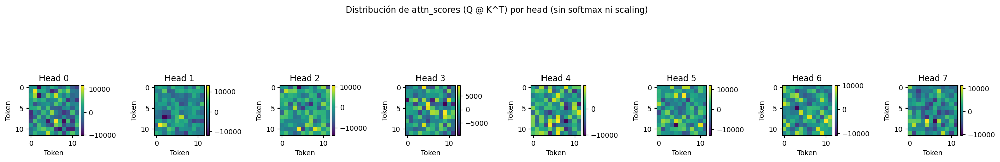

C:\Users\YT40432\AppData\Local\Temp\ipykernel_13544\2622845872.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(x='Token', y='Valor', data=df, inner='box', palette='viridis')


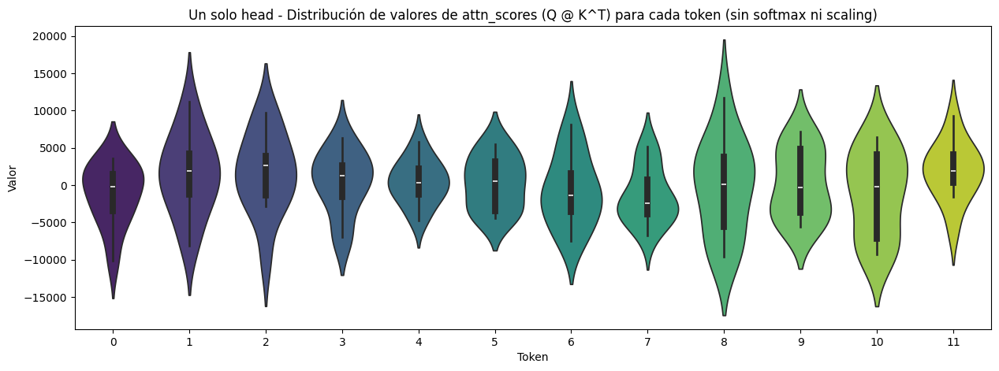

In [7]:
import matplotlib.pyplot as plt

# Visualizar la distribución de attn_scores (parte 1, antes de softmax y scaling)
fig, axes = plt.subplots(1, n_heads, figsize=(20, 4))
if n_heads == 1:
    axes = [axes]
for i, attn in enumerate(attn_scores):
    ax = axes[i]
    im = ax.imshow(attn.detach().cpu().numpy(), cmap='viridis')
    ax.set_title(f'Head {i}')
    ax.set_xlabel('Token')
    ax.set_ylabel('Token')
    fig.colorbar(im, ax=ax, fraction=0.046, pad=0.04)
plt.suptitle('Distribución de attn_scores (Q @ K^T) por head (sin softmax ni scaling)')
plt.tight_layout()
plt.show()

# Nueva visualización: violinplot de la distribución de valores de attn_scores para cada token de una head específica
import seaborn as sns
import numpy as np
import pandas as pd

# Elegimos la head que queremos visualizar (por ejemplo, la head 0)
head_idx = 0
attn = attn_scores[head_idx].detach().cpu().numpy()  # (12, 12)

# Preparamos los datos para violinplot: para cada token (fila), la distribución de valores sobre los otros tokens (columnas)
tokens = np.arange(attn.shape[0])
attn_flat = attn  # shape (n_tokens, n_tokens)

# Creamos un DataFrame para seaborn
df = pd.DataFrame({
    'Valor': attn_flat.flatten(),
    'Token': np.repeat(tokens, attn.shape[1])
})

plt.figure(figsize=(2.5*attn.shape[0]//2, 5))
sns.violinplot(x='Token', y='Valor', data=df, inner='box', palette='viridis')
plt.title(f'Un solo head - Distribución de valores de attn_scores (Q @ K^T) para cada token (sin softmax ni scaling)')
plt.xlabel('Token')
plt.ylabel('Valor')
plt.show()


In [8]:
# ATTENTION por head - parte 2 -> scale 

for i in range(n_heads):
    # scale
    attn_score = attn_scores[i] / head_dim**0.5
    attn_scores[i] = attn_score

print(f'attn_scores es una lista de {len(attn_scores)} matrices de {attn_scores[0].shape}')


attn_scores es una lista de 8 matrices de torch.Size([12, 12])


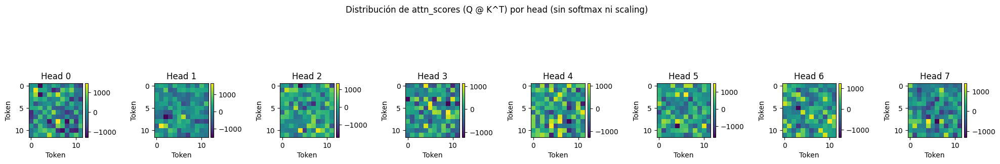

C:\Users\YT40432\AppData\Local\Temp\ipykernel_13544\2622845872.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(x='Token', y='Valor', data=df, inner='box', palette='viridis')


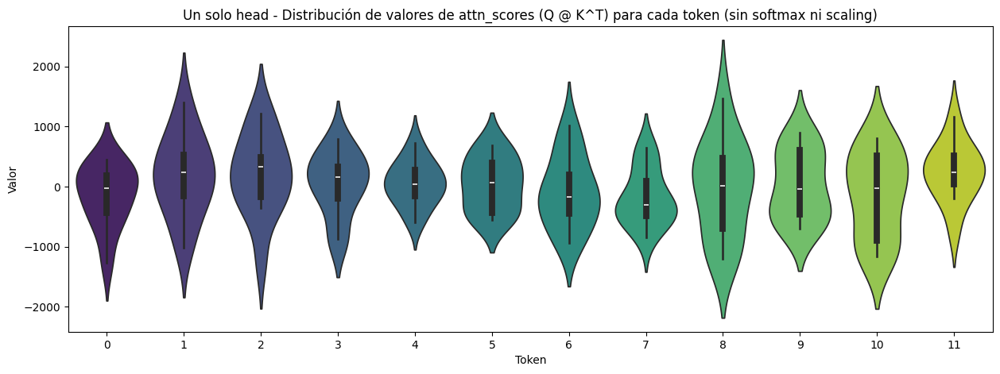

In [9]:
import matplotlib.pyplot as plt

# Visualizar la distribución de attn_scores (parte 1, antes de softmax y scaling)
fig, axes = plt.subplots(1, n_heads, figsize=(20, 4))
if n_heads == 1:
    axes = [axes]
for i, attn in enumerate(attn_scores):
    ax = axes[i]
    im = ax.imshow(attn.detach().cpu().numpy(), cmap='viridis')
    ax.set_title(f'Head {i}')
    ax.set_xlabel('Token')
    ax.set_ylabel('Token')
    fig.colorbar(im, ax=ax, fraction=0.046, pad=0.04)
plt.suptitle('Distribución de attn_scores (Q @ K^T) por head (sin softmax ni scaling)')
plt.tight_layout()
plt.show()

# Nueva visualización: violinplot de la distribución de valores de attn_scores para cada token de una head específica
import seaborn as sns
import numpy as np
import pandas as pd

# Elegimos la head que queremos visualizar (por ejemplo, la head 0)
head_idx = 0
attn = attn_scores[head_idx].detach().cpu().numpy()  # (12, 12)

# Preparamos los datos para violinplot: para cada token (fila), la distribución de valores sobre los otros tokens (columnas)
tokens = np.arange(attn.shape[0])
attn_flat = attn  # shape (n_tokens, n_tokens)

# Creamos un DataFrame para seaborn
df = pd.DataFrame({
    'Valor': attn_flat.flatten(),
    'Token': np.repeat(tokens, attn.shape[1])
})

plt.figure(figsize=(2.5*attn.shape[0]//2, 5))
sns.violinplot(x='Token', y='Valor', data=df, inner='box', palette='viridis')
plt.title(f'Un solo head - Distribución de valores de attn_scores (Q @ K^T) para cada token (sin softmax ni scaling)')
plt.xlabel('Token')
plt.ylabel('Valor')
plt.show()


In [10]:
# ATTENTION por head - parte 3 -> softmax

for i in range(n_heads):
    # softmax
    # Usamos dim=-1 para que softmax se aplique a lo largo de la última dimensión (por fila),
    # es decir, para cada token de la secuencia, obtenemos una distribución de atención sobre los demás tokens.
    attn_score = F.softmax(attn_scores[i], dim=-1)
    attn_scores[i] = attn_score

print(f'attn_scores es una lista de {len(attn_scores)} matrices de {attn_scores[0].shape}')


attn_scores es una lista de 8 matrices de torch.Size([12, 12])


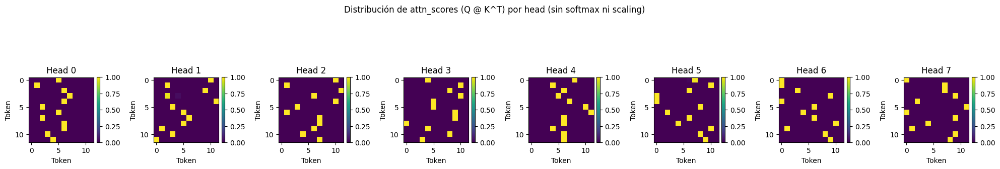

C:\Users\YT40432\AppData\Local\Temp\ipykernel_13544\2622845872.py:38: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(x='Token', y='Valor', data=df, inner='box', palette='viridis')


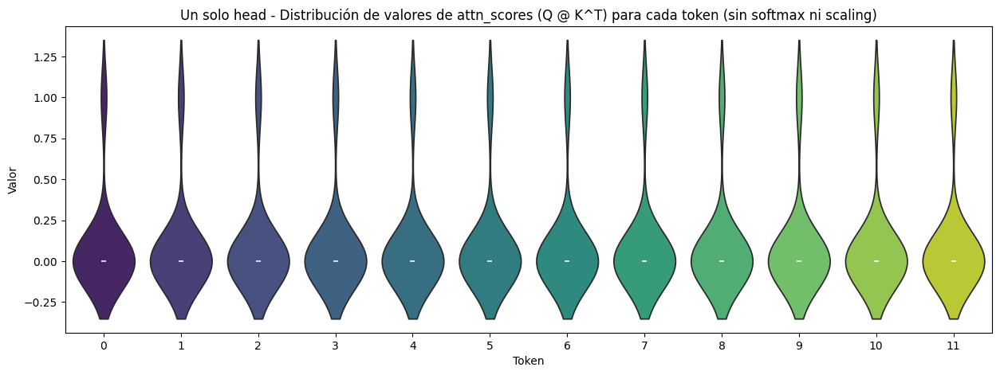

In [11]:
import matplotlib.pyplot as plt

# Visualizar la distribución de attn_scores (parte 1, antes de softmax y scaling)
fig, axes = plt.subplots(1, n_heads, figsize=(20, 4))
if n_heads == 1:
    axes = [axes]
for i, attn in enumerate(attn_scores):
    ax = axes[i]
    im = ax.imshow(attn.detach().cpu().numpy(), cmap='viridis')
    ax.set_title(f'Head {i}')
    ax.set_xlabel('Token')
    ax.set_ylabel('Token')
    fig.colorbar(im, ax=ax, fraction=0.046, pad=0.04)
plt.suptitle('Distribución de attn_scores (Q @ K^T) por head (sin softmax ni scaling)')
plt.tight_layout()
plt.show()

# Nueva visualización: violinplot de la distribución de valores de attn_scores para cada token de una head específica
import seaborn as sns
import numpy as np
import pandas as pd

# Elegimos la head que queremos visualizar (por ejemplo, la head 0)
head_idx = 0
attn = attn_scores[head_idx].detach().cpu().numpy()  # (12, 12)

# Preparamos los datos para violinplot: para cada token (fila), la distribución de valores sobre los otros tokens (columnas)
tokens = np.arange(attn.shape[0])
attn_flat = attn  # shape (n_tokens, n_tokens)

# Creamos un DataFrame para seaborn
df = pd.DataFrame({
    'Valor': attn_flat.flatten(),
    'Token': np.repeat(tokens, attn.shape[1])
})

plt.figure(figsize=(2.5*attn.shape[0]//2, 5))
sns.violinplot(x='Token', y='Valor', data=df, inner='box', palette='viridis')
plt.title(f'Un solo head - Distribución de valores de attn_scores (Q @ K^T) para cada token (sin softmax ni scaling)')
plt.xlabel('Token')
plt.ylabel('Valor')
plt.show()


Aca ya quedaron los AFFINITIES (attention score) para cada uno. Cuadraticamente.

Ahora eso se multiplica con Value para obtener las 64 features contextuales (una por head para 8 heads porque despues se concatena y queda 512=n_embd)

In [12]:
# ATTENTION por head - parte 4 -> matmul V

attn_outputs_heads = []

for i in range(n_heads):
    # matmul V
    attn_output = attn_scores[i] @ V[i] # (12, 12) @ (12, 64) = (12, 64)
    attn_outputs_heads.append(attn_output)

print(f'attn_outputs_heads es una lista de {len(attn_outputs_heads)} matrices de {attn_outputs_heads[0].shape}')

attn_outputs_heads es una lista de 8 matrices de torch.Size([12, 64])


In [13]:
# CONCATENAR HEADS

# Usamos dim=-1 porque cada head produce un vector de tamaño d_v para cada token, y queremos apilar esos vectores "horizontalmente" (por columnas) para cada token.
# Así, si tenemos N tokens y h heads, cada uno con d_v features, el resultado es un tensor de tamaño (N, h * d_v), que corresponde a (N, d_model).
concat = torch.cat(attn_outputs_heads, dim=-1)  # (N, h * d_v) = (N, d_model)
concat.shape

torch.Size([12, 512])

In [14]:
# LINEAR PROJECTION DESPUES DE CONCATENAR HEADS

# INICIALIZO WEIGHTS PARA PROYECCION DE ATTENTION 
W_O = torch.randn(n_embd, n_embd)

# PROYECCION DE ATTENTION
attn_outputs = concat @ W_O  # (N, n_embd) = (12, 512)
attn_outputs.shape

torch.Size([12, 512])

In [18]:
# Estadísticas de X por head
print("\nEstadísticas de X por token en secuencia:")
for i, x in enumerate(X):
    print(f"  Head {i}: mean={x.mean().item():.4f}, std={x.std().item():.4f}, min={x.min().item():.4f}, max={x.max().item():.4f}, shape={x.shape}")

# Estadísticas de los pesos W_Q, W_K por head
print("\nEstadísticas de W_Q por head:")
for i, wq in enumerate(W_Q):
    print(f"  Head {i}: mean={wq.mean().item():.4f}, std={wq.std().item():.4f}, min={wq.min().item():.4f}, max={wq.max().item():.4f}, shape={wq.shape}")


print("Estadísticas de Q por head:")
for i, q in enumerate(Q):
    print(f"  Head {i}: mean={q.mean().item():.4f}, std={q.std().item():.4f}, min={q.min().item():.4f}, max={q.max().item():.4f}, shape={q.shape}")

print("\nEstadísticas de W_K por head:")
for i, wk in enumerate(W_K):
    print(f"  Head {i}: mean={wk.mean().item():.4f}, std={wk.std().item():.4f}, min={wk.min().item():.4f}, max={wk.max().item():.4f}, shape={wk.shape}")

print("\nEstadísticas de K por head:")
for i, k in enumerate(K):
    print(f"  Head {i}: mean={k.mean().item():.4f}, std={k.std().item():.4f}, min={k.min().item():.4f}, max={k.max().item():.4f}, shape={k.shape}")

print("\nEstadísticas de attn_scores por head:")
for i, attn in enumerate(attn_scores):
    print(f"  Head {i}: mean={attn.mean().item():.4f}, std={attn.std().item():.4f}, min={attn.min().item():.4f}, max={attn.max().item():.4f}, shape={attn.shape}")

print("\nEstadísticas de W_V por head:")
for i, wv in enumerate(W_V):
    print(f"  Head {i}: mean={wv.mean().item():.4f}, std={wv.std().item():.4f}, min={wv.min().item():.4f}, max={wv.max().item():.4f}, shape={wv.shape}")

print("\nEstadísticas de V por head:")
for i, v in enumerate(V):
    print(f"  Head {i}: mean={v.mean().item():.4f}, std={v.std().item():.4f}, min={v.min().item():.4f}, max={v.max().item():.4f}, shape={v.shape}")

print("\nEstadísticas de attn_outputs_heads por head:")
for i, out in enumerate(attn_outputs_heads):
    print(f"  Head {i}: mean={out.mean().item():.4f}, std={out.std().item():.4f}, min={out.min().item():.4f}, max={out.max().item():.4f}, shape={out.shape}")

print("\nEstadísticas de concat:")
print(f"  mean: {concat.mean().item():.4f}, std: {concat.std().item():.4f}, min: {concat.min().item():.4f}, max: {concat.max().item():.4f}, shape: {concat.shape}")

print("\nEstadísticas de W_O:")
print(f"  mean: {W_O.mean().item():.4f}, std: {W_O.std().item():.4f}, min: {W_O.min().item():.4f}, max: {W_O.max().item():.4f}, shape: {W_O.shape}")

print("\nEstadísticas de attn_outputs:")
print(f"  mean: {attn_outputs.mean().item():.4f}, std: {attn_outputs.std().item():.4f}, min: {attn_outputs.min().item():.4f}, max: {attn_outputs.max().item():.4f}, shape: {attn_outputs.shape}")



Estadísticas de X por token en secuencia:
  Head 0: mean=-0.0042, std=1.0027, min=-2.8707, max=3.2785, shape=torch.Size([512])
  Head 1: mean=0.0826, std=1.0376, min=-2.7031, max=2.9552, shape=torch.Size([512])
  Head 2: mean=0.0320, std=0.9828, min=-3.1108, max=3.2595, shape=torch.Size([512])
  Head 3: mean=0.0357, std=1.0036, min=-2.8263, max=2.6667, shape=torch.Size([512])
  Head 4: mean=0.0088, std=0.9927, min=-3.7905, max=3.4690, shape=torch.Size([512])
  Head 5: mean=0.0288, std=0.9601, min=-3.0238, max=2.9241, shape=torch.Size([512])
  Head 6: mean=0.0248, std=0.9756, min=-2.7484, max=3.0896, shape=torch.Size([512])
  Head 7: mean=-0.0655, std=0.9941, min=-3.3558, max=2.5499, shape=torch.Size([512])
  Head 8: mean=0.0098, std=0.9973, min=-3.2636, max=3.4893, shape=torch.Size([512])
  Head 9: mean=0.0136, std=0.9962, min=-2.7520, max=2.7582, shape=torch.Size([512])
  Head 10: mean=0.0733, std=0.9837, min=-2.3127, max=3.7831, shape=torch.Size([512])
  Head 11: mean=0.0282, std=0.

- X y los weights de attention tienen media 0 y std 1. Bien
- Q, K, V: Si tenés un vector con std=1 y lo multiplicás por una matriz con std=1 y dimensión 512×64, el resultado tendrá varianza ≈ 512 (por la suma de 512 productos independientes), lo que da std ≈ √512 ≈ 22.6
- concat tiene std=22 y W_O tiene std=1, dimensión 512×512 → Cada valor final de attn_outputs es la suma de 512 valores de varianza ~22² = 484, total:
    - varianza final ≈ 512 × 484 ≈ 247,808
    - std final ≈ √247,808 ≈ 497 
    - ¡Y te da 507! Está perfecto, matemáticamente hablando.

Estadísticas de concat:
  mean: -0.4497, std: 22.2364, min: -75.9848, max: 79.6481
Estadísticas de attention_output:
  mean: -14.0203, std: 507.9650, min: -2382.8618, max: 1995.8788


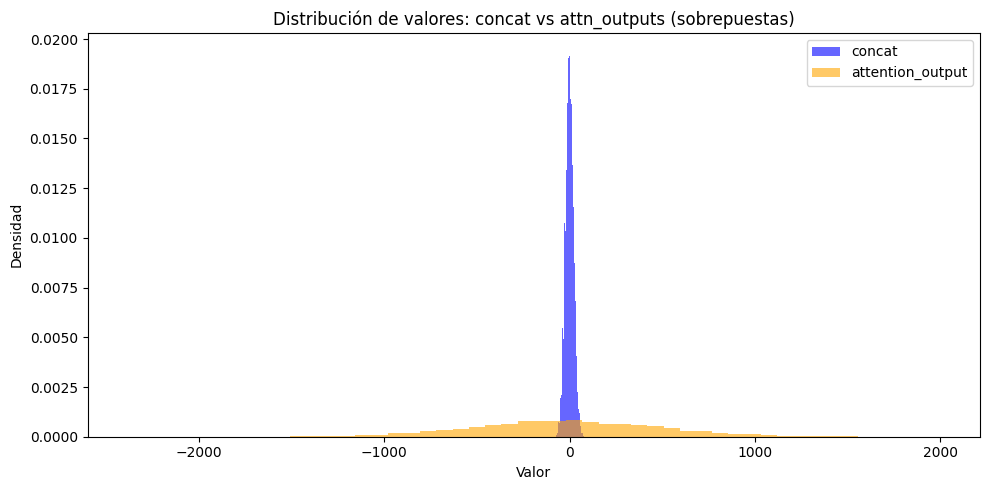

Diferencia absoluta promedio: 403.2821


In [19]:
# Puedes comparar los valores de `concat` y `attention_output` de varias formas.
# Por ejemplo, puedes ver estadísticas básicas, comparar visualmente, o ver la diferencia absoluta.

# 1. Estadísticas básicas
print("Estadísticas de concat:")
print(f"  mean: {concat.mean().item():.4f}, std: {concat.std().item():.4f}, min: {concat.min().item():.4f}, max: {concat.max().item():.4f}")

print("Estadísticas de attention_output:")
print(f"  mean: {attn_outputs.mean().item():.4f}, std: {attn_outputs.std().item():.4f}, min: {attn_outputs.min().item():.4f}, max: {attn_outputs.max().item():.4f}")

# 2. Visualización de distribuciones sobrepuestas
import matplotlib.pyplot as plt

plt.figure(figsize=(10,5))
plt.hist(concat.flatten().detach().cpu().numpy(), bins=50, alpha=0.6, label='concat', color='blue', density=True)
plt.hist(attn_outputs.flatten().detach().cpu().numpy(), bins=50, alpha=0.6, label='attention_output', color='orange', density=True)
plt.title('Distribución de valores: concat vs attn_outputs (sobrepuestas)')
plt.xlabel('Valor')
plt.ylabel('Densidad')
plt.legend()
plt.tight_layout()
plt.show()

# 3. Diferencia absoluta promedio
diff = (attn_outputs - concat).abs()
print(f"Diferencia absoluta promedio: {diff.mean().item():.4f}")


#### Varianza vector-matrix multiplication

* Tenemos un vector x ∈ ℝᵈ, con elementos independientes, cada uno con media 0 y varianza σ²
* Una matriz W ∈ ℝ^{d×k}, con elementos independientes, también con media 0 y varianza σ²

Queremos calcular:

```python
y = x @ W  # → resultado ∈ ℝᵏ
```

---

**¿Qué pasa con la varianza de cada componente de y?**

Cada componente y\_j del vector y se obtiene así:

$$
y_j = x_1 W_{1j} + x_2 W_{2j} + \ldots + x_d W_{dj} = \sum_{i=1}^{d} x_i W_{ij}
$$

Entonces:

* La varianza de un producto de dos variables independientes es:

  $$
  \text{Var}(xᵢ \cdot Wᵢⱼ) = \text{Var}(xᵢ) \cdot \text{Var}(Wᵢⱼ) = σ² \cdot σ² = σ⁴
  $$

* Y como sumamos d de estos productos, y todos son independientes:

  $$
  \text{Var}(y_j) = \sum_{i=1}^{d} \text{Var}(xᵢ \cdot Wᵢⱼ) = d \cdot σ⁴
  $$

Pero esto es varianza cuadrada (porque estamos multiplicando varianzas). Si querés mantener la varianza estable, necesitás:

* que los W estén escalados con varianza ≈ 1/d
* o que los x también estén escalados

---

**Ejemplo**

* x tiene shape \[12, 512]
* W tiene shape \[512, 64]
* Ambos tienen varianza ≈ 1 (std ≈ 1)

Entonces, para cada token (fila x), y ∈ ℝ⁶⁴ se calcula como:

$$
y_j = \sum_{i=1}^{512} x_i W_{ij}
$$

La varianza esperada de cada componente de y es:

$$
\text{Var}(y_j) = 512 \cdot (1^2 \cdot 1^2) = 512
$$

Y el desvío estándar (std):

$$
\text{Std}(y_j) = \sqrt{512} ≈ 22.6
$$

¡Tal cual lo que vos viste en tus `Q`, `K`, `V`!

---

**Si hacés otro paso lineal después…**

Ejemplo:

```python
z = y @ W2  # [64] @ [64, 512] → [512]
```

Ahora sumás 64 productos, cada uno de varianza ≈ 512 (de y):

$$
\text{Var}(z_j) = 64 \cdot 512 = 32,768
\Rightarrow \text{Std}(z_j) = \sqrt{32,768} ≈ 181
$$

¡Y así sigue creciendo! Cada paso suma contribuciones de alto valor.

#### Add&Norm (+ dropout)

**Residual**: sumo el input crudo con el output del attention

---


**LayerNorm** 

Es una técnica de normalización que toma **un solo vector** (por ejemplo, un token con 512 dimensiones) y normaliza sus valores:

$$
\text{LayerNorm}(x) = \frac{x - \mu}{\sigma + \epsilon} \cdot \gamma + \beta
$$

Donde:

* \$\mu\$ es la media de los valores del vector x
* \$\sigma\$ es el desvío estándar (std)
* \$\gamma\$ y \$\beta\$ son parámetros aprendibles del mismo tamaño que x (o sea, del tamaño de la dimensión embebida, típicamente 512 o 768 o lo que sea)

**¿Por qué se llama “Layer” Normalization?**: Históricamente, viene del contexto de redes neuronales clásicas (fully connected), donde cada capa producía una activación por ejemplo de 512 dimensiones. En ese caso se normalizaba "por capa de neuronas", o sea, por **vector de salida completo**.

En este caso:
* Solo toma el vector del token y le saca su media y lo divide por su std

In [ ]:
# SE PUEDE AGREGAR DROPOUT ANTES DE LA NORMALIZACION

# Esto simplemente toma attn_outputs y:
# 1. Convierte en 0 el 10% de los valores
# 2. Multiplica el resto por 1 / (1-0.1) para mantener la media
"""
El argumento `training=True` en F.dropout indica que estamos en modo entrenamiento:
  - Cuando `training=True`, Dropout está activo: apaga (pone en cero) aleatoriamente el 10% de los valores del tensor en cada pasada, y escala el resto para mantener la media.
  - Cuando `training=False`, Dropout NO se aplica: el tensor pasa sin cambios (no se apaga nada), como se hace durante la inferencia o evaluación.
Esto es importante porque Dropout solo se usa para regularizar durante el entrenamiento, pero no durante la evaluación o predicción."""

attn_outputs = F.dropout(attn_outputs, p=0.1, training=False)
attn_outputs.shape

In [21]:
# RESIDUAL CONNECTION 1 - Add

res1 = X + attn_outputs # (12, 512) + (12, 512) = (12, 512)
res1.shape

torch.Size([12, 512])

In [22]:
# LAYER NORM 1

# F.layer_norm toma como argumentos:
#   - el tensor a normalizar (res1, de tamaño [12, 512])
#   - la forma de las features a normalizar (en este caso, (512,), o sea, normaliza cada token sobre sus 512 features)
norm1 = F.layer_norm(res1, (512,)) # (12, 512)
norm1.shape

torch.Size([12, 512])

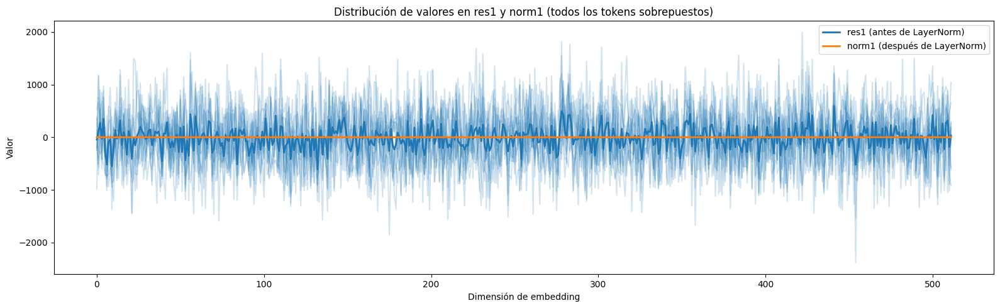

=== Estadísticas de res1 (antes de LayerNorm) ===
Media global: -13.9980
Desvío estándar global: 507.9258
Media por dimensión (primeras 5): [-45.021744 112.27231  273.36548  -32.12512  350.1007  ]
Std por dimensión (primeras 5): [377.691   637.9767  294.47397 439.48407 418.23065]

=== Estadísticas de norm1 (después de LayerNorm) ===
Media global: 0.0000
Desvío estándar global: 1.0000
Media por dimensión (primeras 5): [-0.0556673   0.2833328   0.57482177 -0.06317861  0.73821014]
Std por dimensión (primeras 5): [0.77681553 1.2747822  0.6344905  0.8174662  0.83772385]


In [34]:
import matplotlib.pyplot as plt
import numpy as np

# Visualizar las distribuciones de res1 y norm1 sobrepuestas para comparar
plt.figure(figsize=(16, 5))

for i in range(res1.shape[0]):
    plt.plot(res1[i].detach().cpu().numpy(), color='tab:blue', alpha=0.2)
for i in range(norm1.shape[0]):
    plt.plot(norm1[i].detach().cpu().numpy(), color='tab:orange', alpha=0.2)

# Agregar una línea promedio para cada uno para ver la tendencia general
plt.plot(res1.detach().cpu().numpy().mean(axis=0), color='tab:blue', lw=2, label='res1 (antes de LayerNorm)')
plt.plot(norm1.detach().cpu().numpy().mean(axis=0), color='tab:orange', lw=2, label='norm1 (después de LayerNorm)')

plt.title('Distribución de valores en res1 y norm1 (todos los tokens sobrepuestos)')
plt.xlabel('Dimensión de embedding')
plt.ylabel('Valor')
plt.legend()
plt.tight_layout()
plt.show()

# Imprimir estadísticas
res1_np = res1.detach().cpu().numpy()
norm1_np = norm1.detach().cpu().numpy()

print("=== Estadísticas de res1 (antes de LayerNorm) ===")
print(f"Media global: {res1_np.mean():.4f}")
print(f"Desvío estándar global: {res1_np.std():.4f}")
print(f"Media por dimensión (primeras 5): {np.mean(res1_np, axis=0)[:5]}")
print(f"Std por dimensión (primeras 5): {np.std(res1_np, axis=0)[:5]}")
print()

print("=== Estadísticas de norm1 (después de LayerNorm) ===")
print(f"Media global: {norm1_np.mean():.4f}")
print(f"Desvío estándar global: {norm1_np.std():.4f}")
print(f"Media por dimensión (primeras 5): {np.mean(norm1_np, axis=0)[:5]}")
print(f"Std por dimensión (primeras 5): {np.std(norm1_np, axis=0)[:5]}")


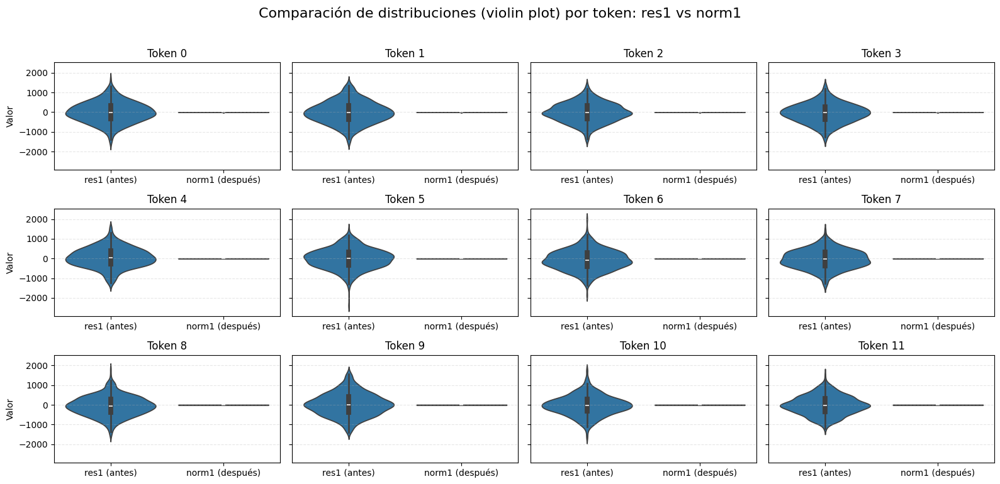

In [40]:
import seaborn as sns
import pandas as pd
import warnings

# Para cada token, comparar la distribución de valores de res1 y norm1 con violinplots
num_tokens = res1.shape[0]
nrows = 3
ncols = (num_tokens + nrows - 1) // nrows
fig, axes = plt.subplots(nrows, ncols, figsize=(4*ncols, 2.5*nrows), sharey=True)
axes = axes.flatten()

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    for i in range(num_tokens):
        # Preparamos un DataFrame para seaborn
        df = pd.DataFrame({
            'Valor': np.concatenate([res1_np[i], norm1_np[i]]),
            'Tipo': ['res1 (antes)']*res1_np.shape[1] + ['norm1 (después)']*norm1_np.shape[1]
        })
        ax = axes[i]
        sns.violinplot(x='Tipo', y='Valor', data=df, ax=ax, palette=['tab:blue', 'tab:orange'])
        ax.set_title(f'Token {i}')
        if i % ncols == 0:
            ax.set_ylabel('Valor')
        else:
            ax.set_ylabel('')
        ax.set_xlabel('')
        ax.grid(True, axis='y', linestyle='--', alpha=0.3)
    # Ocultar ejes vacíos si hay
    for j in range(num_tokens, len(axes)):
        axes[j].axis('off')

plt.suptitle('Comparación de distribuciones (violin plot) por token: res1 vs norm1', y=1.02, fontsize=16)
plt.tight_layout()
plt.show()


#### FeedForward

Este es el paso de COMPUTE. Es una red idéntica para todos los tokens, que se aplica por separado a cada uno (igual que LayerNorm).



Tiene solo 2 capas lineales (densas):
- Una capa lineal: W1: [d_model, d_ff] + ReLU
- Otra capa lineal: W2: [d_ff, d_model]

---

Esto se hace independientemente para cada token. CADA TOKEN SE PROCESA INDEPENDIENTEMENTE.


---

**¿Por qué solo 2 capas?**
- Simplicidad: se quiere que cada bloque sea ligero y fácil de apilar
- Bottleneck invertido: se ensancha para dar capacidad, luego se reduce
- Complemento al attention: attention se encarga de la interacción entre tokens, mientras que el FFN refina la representación de cada token de forma local
- Empíricamente suficiente: se ha demostrado que dos capas ya aportan una no linealidad y proyección suficiente para tareas complejas

Los weights no son compartidos en otras capas de transformer blocks sucesivos. Cada transformer block tiene sus propios weights particulares.

In [53]:
# === FeedForward token-wise ===

n_ff = 4 * n_embd
print(f"n_ff: {n_ff}")

# INICIALIZACION 
W1 = torch.randn(n_embd, n_ff) # (512, 2048)
b1 = torch.randn(n_ff) # (2048,)
W2 = torch.randn(n_ff, n_embd) # (2048, 512)
b2 = torch.randn(n_embd) # (512,)


# FEEDFORWARD
# hidden layer
ffn_hidden = F.relu(norm1 @ W1 + b1)  # (12, 2048)
# output layer
ffn_output = ffn_hidden @ W2 + b2 # (12, 512)

print(f'ffn_hidden: {ffn_hidden.shape}')
print(f'ffn_output: {ffn_output.shape}')

print(f"\nffn_output mean: {ffn_output.mean().item():.4f}")
print(f"ffn_output std: {ffn_output.std().item():.4f}")
print(f"ffn_output min: {ffn_output.min().item():.4f}")
print(f"ffn_output max: {ffn_output.max().item():.4f}")

n_ff: 2048
ffn_hidden: torch.Size([12, 2048])
ffn_output: torch.Size([12, 512])

ffn_output mean: 0.4750
ffn_output std: 729.8597
ffn_output min: -2485.0410
ffn_output max: 2666.1562


#### Add&Norm2

In [ ]:
# SE PUEDE AGREGAR DROPOUT ANTES DE LA NORMALIZACION

# Esto simplemente toma attn_outputs y:
# 1. Convierte en 0 el 10% de los valores
# 2. Multiplica el resto por 1 / (1-0.1) para mantener la media
"""
El argumento `training=True` en F.dropout indica que estamos en modo entrenamiento:
  - Cuando `training=True`, Dropout está activo: apaga (pone en cero) aleatoriamente el 10% de los valores del tensor en cada pasada, y escala el resto para mantener la media.
  - Cuando `training=False`, Dropout NO se aplica: el tensor pasa sin cambios (no se apaga nada), como se hace durante la inferencia o evaluación.
Esto es importante porque Dropout solo se usa para regularizar durante el entrenamiento, pero no durante la evaluación o predicción."""

# ffn_output = F.dropout(ffn_output, p=0.1, training=False)
# ffn_output.shape

In [ ]:
# RESIDUAL CONNECTION - Add

res2 = norm1 + ffn_output # (12, 512)
res2.shape

torch.Size([12, 512])

In [56]:
# LAYER NORM 2

norm2 = F.layer_norm(res2, (512,)) # (12, 512)
norm2.shape

torch.Size([12, 512])

In [57]:
print(f"\nnorm2 mean: {norm2.mean().item():.4f}")
print(f"norm2 std: {norm2.std().item():.4f}")
print(f"norm2 min: {norm2.min().item():.4f}")
print(f"norm2 max: {norm2.max().item():.4f}")


norm2 mean: 0.0000
norm2 std: 1.0001
norm2 min: -3.3975
norm2 max: 3.7551


C:\Users\YT40432\AppData\Local\Temp\ipykernel_13544\2137951038.py:15: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(x='Token', y='Valor', data=df_melt, inner='box', palette='viridis')


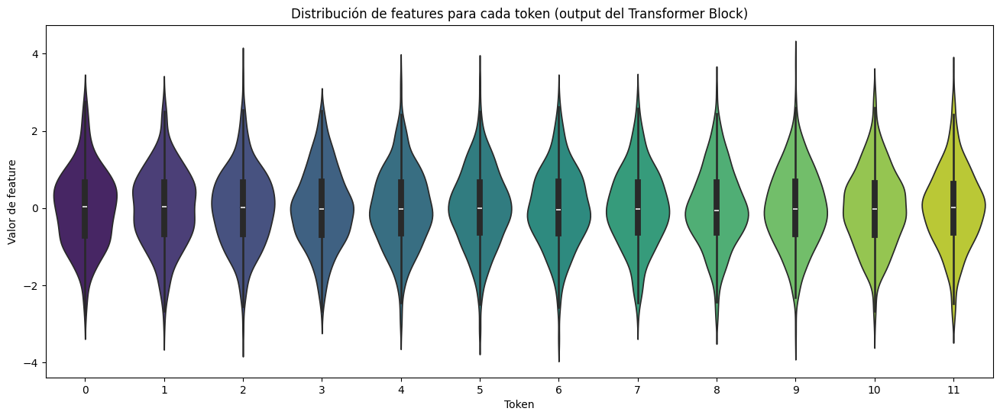

In [58]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

# norm2 tiene shape (12, 512): 12 tokens, 512 features cada uno

# Convertir a DataFrame para facilitar el plot
df = pd.DataFrame(norm2.detach().numpy())
df['Token'] = df.index

# Melt para tener columnas: Token, Feature, Valor
df_melt = df.melt(id_vars='Token', var_name='Feature', value_name='Valor')

plt.figure(figsize=(16, 6))
sns.violinplot(x='Token', y='Valor', data=df_melt, inner='box', palette='viridis')
plt.title('Distribución de features para cada token (output del Transformer Block)')
plt.xlabel('Token')
plt.ylabel('Valor de feature')
plt.show()


#### MULTIPLES CAPAS

Hay **multiples transformer blocks**.

El output **norm2** de la primera capa -> entra como **input embedding** a la segunda capa.

---

Aclaracion. Para la segunda capa, **TODOS LOS WEIGHTS CAMBIAN**:
- W_Q, W_K, W_V (para cada head)
- W_O (para cada head)
- FFN (W1, b1, W2, b2)

Todos estos son nuevos

In [59]:
# INICIALIZACION WEIGHTS PARA Q, K, V CAPA 2

head_dim = n_embd // n_heads

W_Q = []
W_K = []
W_V = []

for _ in range(n_heads):
    # query weights
    W_Q_head = torch.randn(n_embd, head_dim) # 512, 64 (64 = 512/8)
    W_Q.append(W_Q_head)
    # key weights
    W_K_head = torch.randn(n_embd, head_dim)
    W_K.append(W_K_head)
    # value weights
    W_V_head = torch.randn(n_embd, head_dim)
    W_V.append(W_V_head)

print(f'W_Q, W_K, W_V es una lista de {len(W_Q)} matrices de {W_Q[0].shape}')

W_Q, W_K, W_V es una lista de 8 matrices de torch.Size([512, 64])


In [60]:
# PROYECCIONES A Q, K, V por head

Q = []
K = []
V = []

for i in range(n_heads):
    # query
    Q_head = norm2 @ W_Q[i] # (12, 512) @ (512, 64) = (12, 64) -------------->> ACA CAMBIA PARA CAPA 2 DE TRANSFORMER BLOCK
    Q.append(Q_head)
    # key
    K_head = norm2 @ W_K[i] # (12, 512) @ (512, 64) = (12, 64) -------------->> ACA CAMBIA PARA CAPA 2 DE TRANSFORMER BLOCK
    K.append(K_head)
    # value
    V_head = norm2 @ W_V[i] # (12, 512) @ (512, 64) = (12, 64) -------------->> ACA CAMBIA PARA CAPA 2 DE TRANSFORMER BLOCK
    V.append(V_head)

print(f'Q, K, V es una lista de {len(Q)} matrices de {Q[0].shape}')

Q, K, V es una lista de 8 matrices de torch.Size([12, 64])


In [61]:
# ATTENTION por head - parte 1 - matmul Q @ K

attn_scores = []

for i in range(n_heads):
    Q_h = Q[i]
    K_h = K[i]
    V_h = V[i]

    # matmul Q @ K 
    attn_score = Q_h @ K_h.T # (12, 64) @ (64, 12) = (12, 12)
    attn_scores.append(attn_score)

print(f'attn_scores es una lista de {len(attn_scores)} matrices de {attn_scores[0].shape}')

attn_scores es una lista de 8 matrices de torch.Size([12, 12])


In [62]:
# ATTENTION por head - parte 2 -> scale 

for i in range(n_heads):
    # scale
    attn_score = attn_scores[i] / head_dim**0.5
    attn_scores[i] = attn_score

print(f'attn_scores es una lista de {len(attn_scores)} matrices de {attn_scores[0].shape}')


attn_scores es una lista de 8 matrices de torch.Size([12, 12])


In [63]:
# ATTENTION por head - parte 3 -> softmax

for i in range(n_heads):
    # softmax
    # Usamos dim=-1 para que softmax se aplique a lo largo de la última dimensión (por fila),
    # es decir, para cada token de la secuencia, obtenemos una distribución de atención sobre los demás tokens.
    attn_score = F.softmax(attn_scores[i], dim=-1)
    attn_scores[i] = attn_score

print(f'attn_scores es una lista de {len(attn_scores)} matrices de {attn_scores[0].shape}')


attn_scores es una lista de 8 matrices de torch.Size([12, 12])


In [64]:
# ATTENTION por head - parte 4 -> matmul V

attn_outputs_heads = []

for i in range(n_heads):
    # matmul V
    attn_output = attn_scores[i] @ V[i] # (12, 12) @ (12, 64) = (12, 64)
    attn_outputs_heads.append(attn_output)

print(f'attn_outputs_heads es una lista de {len(attn_outputs_heads)} matrices de {attn_outputs_heads[0].shape}')

attn_outputs_heads es una lista de 8 matrices de torch.Size([12, 64])


In [65]:
# CONCATENAR HEADS

# Usamos dim=-1 porque cada head produce un vector de tamaño d_v para cada token, y queremos apilar esos vectores "horizontalmente" (por columnas) para cada token.
# Así, si tenemos N tokens y h heads, cada uno con d_v features, el resultado es un tensor de tamaño (N, h * d_v), que corresponde a (N, d_model).
concat = torch.cat(attn_outputs_heads, dim=-1)  # (N, h * d_v) = (N, d_model)
concat.shape

torch.Size([12, 512])

In [66]:
# LINEAR PROJECTION DESPUES DE CONCATENAR HEADS

# INICIALIZO WEIGHTS PARA PROYECCION DE ATTENTION 
W_O = torch.randn(n_embd, n_embd)

# PROYECCION DE ATTENTION
attn_outputs = concat @ W_O  # (N, n_embd) = (12, 512)
attn_outputs.shape

torch.Size([12, 512])

In [ ]:
# SE PUEDE AGREGAR DROPOUT ANTES DE LA NORMALIZACION

# Esto simplemente toma attn_outputs y:
# 1. Convierte en 0 el 10% de los valores
# 2. Multiplica el resto por 1 / (1-0.1) para mantener la media
"""
El argumento `training=True` en F.dropout indica que estamos en modo entrenamiento:
  - Cuando `training=True`, Dropout está activo: apaga (pone en cero) aleatoriamente el 10% de los valores del tensor en cada pasada, y escala el resto para mantener la media.
  - Cuando `training=False`, Dropout NO se aplica: el tensor pasa sin cambios (no se apaga nada), como se hace durante la inferencia o evaluación.
Esto es importante porque Dropout solo se usa para regularizar durante el entrenamiento, pero no durante la evaluación o predicción."""

attn_outputs = F.dropout(attn_outputs, p=0.1, training=False)
attn_outputs.shape

In [67]:
# RESIDUAL CONNECTION 1 - Add

res1 = X + attn_outputs # (12, 512) + (12, 512) = (12, 512)
res1.shape

torch.Size([12, 512])

In [68]:
# LAYER NORM 1

# F.layer_norm toma como argumentos:
#   - el tensor a normalizar (res1, de tamaño [12, 512])
#   - la forma de las features a normalizar (en este caso, (512,), o sea, normaliza cada token sobre sus 512 features)
norm1 = F.layer_norm(res1, (512,)) # (12, 512)
norm1.shape

torch.Size([12, 512])

In [69]:
# === FeedForward token-wise ===

n_ff = 4 * n_embd
print(f"n_ff: {n_ff}")

# INICIALIZACION 
W1 = torch.randn(n_embd, n_ff) # (512, 2048)
b1 = torch.randn(n_ff) # (2048,)
W2 = torch.randn(n_ff, n_embd) # (2048, 512)
b2 = torch.randn(n_embd) # (512,)


# FEEDFORWARD
# hidden layer
ffn_hidden = F.relu(norm1 @ W1 + b1)  # (12, 2048)
# output layer
ffn_output = ffn_hidden @ W2 + b2 # (12, 512)

print(f'ffn_hidden: {ffn_hidden.shape}')
print(f'ffn_output: {ffn_output.shape}')

print(f"\nffn_output mean: {ffn_output.mean().item():.4f}")
print(f"ffn_output std: {ffn_output.std().item():.4f}")
print(f"ffn_output min: {ffn_output.min().item():.4f}")
print(f"ffn_output max: {ffn_output.max().item():.4f}")

n_ff: 2048
ffn_hidden: torch.Size([12, 2048])
ffn_output: torch.Size([12, 512])

ffn_output mean: 7.2189
ffn_output std: 703.3296
ffn_output min: -2898.2515
ffn_output max: 2484.0493


In [ ]:
# SE PUEDE AGREGAR DROPOUT ANTES DE LA NORMALIZACION

# Esto simplemente toma attn_outputs y:
# 1. Convierte en 0 el 10% de los valores
# 2. Multiplica el resto por 1 / (1-0.1) para mantener la media
"""
El argumento `training=True` en F.dropout indica que estamos en modo entrenamiento:
  - Cuando `training=True`, Dropout está activo: apaga (pone en cero) aleatoriamente el 10% de los valores del tensor en cada pasada, y escala el resto para mantener la media.
  - Cuando `training=False`, Dropout NO se aplica: el tensor pasa sin cambios (no se apaga nada), como se hace durante la inferencia o evaluación.
Esto es importante porque Dropout solo se usa para regularizar durante el entrenamiento, pero no durante la evaluación o predicción."""

# ffn_output = F.dropout(ffn_output, p=0.1, training=False)
# ffn_output.shape

In [70]:
# RESIDUAL CONNECTION 1 - Add

res2 = norm1 + ffn_output # (12, 512)
res2.shape

torch.Size([12, 512])

In [71]:
# LAYER NORM 2

norm2 = F.layer_norm(res2, (512,)) # (12, 512)
norm2.shape

torch.Size([12, 512])

In [72]:
print(f"\nnorm2 mean: {norm2.mean().item():.4f}")
print(f"norm2 std: {norm2.std().item():.4f}")
print(f"norm2 min: {norm2.min().item():.4f}")
print(f"norm2 max: {norm2.max().item():.4f}")


norm2 mean: 0.0000
norm2 std: 1.0001
norm2 min: -4.0791
norm2 max: 3.6468


### Embeddings

### Encoder

### Decoder

#### Masked attention (causal)

#### Cross-attention

## Decoder-only Transformer